<center><h1>1-cd: Convolutional Neural Networks (ConvNets)</h1></center>

<center><h2><a href="https://rdfia.github.io/">Course link</a></h2></center>

# Warning :
# Do "File -> Save a copy in Drive" before you start modifying the notebook, otherwise your modifications will not be saved.


In [1]:
#!git clone https://github.com/cdancette/deep-learning-polytech-tp6-7.git
! wget https://github.com/rdfia/rdfia.github.io/raw/master/code/2-cd/utils.py

--2025-11-10 14:22:48--  https://github.com/rdfia/rdfia.github.io/raw/master/code/2-cd/utils.py
Resolving github.com (github.com)... 20.27.177.113
Connecting to github.com (github.com)|20.27.177.113|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/rdfia/rdfia.github.io/master/code/2-cd/utils.py [following]
--2025-11-10 14:22:48--  https://raw.githubusercontent.com/rdfia/rdfia.github.io/master/code/2-cd/utils.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.109.133, 185.199.110.133, 185.199.111.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.109.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2627 (2.6K) [text/plain]
Saving to: ‘utils.py’

utils.py            100%[===================>]   2.57K  --.-KB/s    in 0s      

2025-11-10 14:22:49 (48.8 MB/s) - ‘utils.py’ saved [2627/2627]



In [2]:
%run 'utils.py'

In [3]:
import argparse
import os
import time

import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim
import torch.utils.data
import torchvision.transforms as transforms
import torchvision.datasets as datasets

from utils import *

PRINT_INTERVAL = 200
PATH="datasets"

In [4]:
class ConvNet(nn.Module):
    """
    This class defines the structure of the neural network
    """

    def __init__(self):
        super(ConvNet, self).__init__()
        # We first define the convolution and pooling layers as a features extractor
        self.features = nn.Sequential(
            nn.Conv2d(1, 6, (5, 5), stride=1, padding=2),
            nn.Tanh(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(6, 16, (5, 5), stride=1, padding=0),
            nn.Tanh(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
        )
        # We then define fully connected layers as a classifier
        self.classifier = nn.Sequential(
            nn.Linear(400, 120),
            nn.Tanh(),
            nn.Linear(120, 84),
            nn.Tanh(),
            nn.Linear(84, 10)
            # Reminder: The softmax is included in the loss, do not put it here
        )

    # Method called when we apply the network to an input batch
    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers
        return output



def get_dataset(batch_size, cuda=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """
    train_dataset = datasets.MNIST(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor()
        ]))
    val_dataset = datasets.MNIST(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor()
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader



def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Make a pass (called epoch in English) on the data `data` with the
     model `model`. Evaluates `criterion` as loss.
     If `optimizer` is given, perform a training epoch using
     the given optimizer, otherwise, perform an evaluation epoch (no backward)
     of the model.
    """

    # indicates whether the model is in eval or train mode (some layers behave differently in train and eval)
    model.eval() if optimizer is None else model.train()

    # objects to store metric averages
    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()
    global loss_plot

    # we iterate on the batches
    tic = time.time()
    for i, (input, target) in enumerate(data):

        if cuda: # only with GPU, and not with CPU
            input = input.cuda()
            target = target.cuda()

        # forward
        output = model(input)
        loss = criterion(output, target)

        # backward if we are training
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # compute metrics
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # update
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)
        if optimizer:
            loss_plot.update(avg_loss.val)
        # print info
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time, loss=avg_loss,
                   top1=avg_top1_acc, top5=avg_top5_acc))
            if optimizer:
                loss_plot.plot()

    # Print summary
    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss


def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)


100%|██████████| 9.91M/9.91M [00:00<00:00, 18.4MB/s]
100%|██████████| 28.9k/28.9k [00:00<00:00, 510kB/s]
100%|██████████| 1.65M/1.65M [00:00<00:00, 4.69MB/s]
100%|██████████| 4.54k/4.54k [00:00<00:00, 7.03MB/s]

=== EPOCH 1 =====



[TRAIN Batch 000/469]	Time 1.739s (1.739s)	Loss 2.3109 (2.3109)	Prec@1   9.4 (  9.4)	Prec@5  49.2 ( 49.2)


<Figure size 640x480 with 0 Axes>

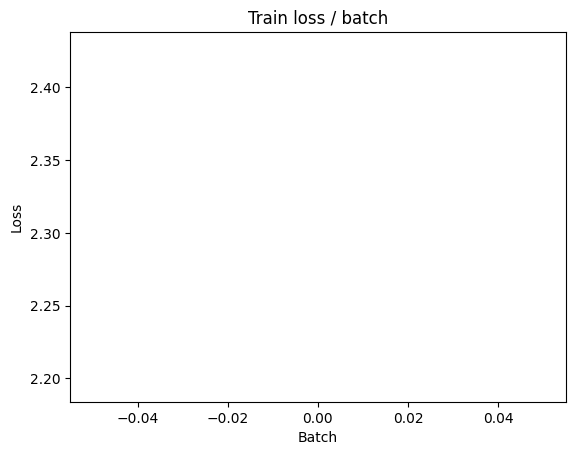

[TRAIN Batch 200/469]	Time 0.017s (0.028s)	Loss 0.4231 (1.2095)	Prec@1  89.1 ( 64.4)	Prec@5  97.7 ( 91.2)


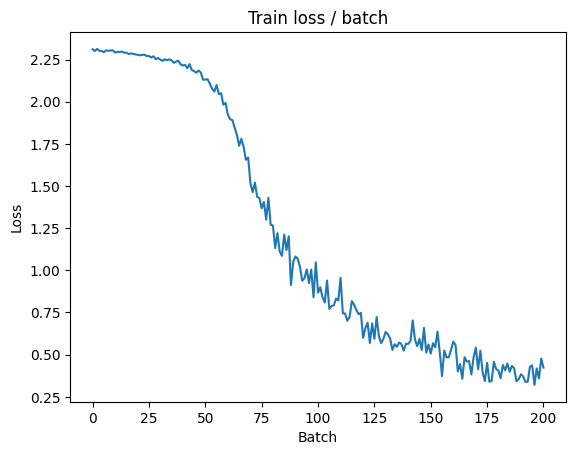

[TRAIN Batch 400/469]	Time 0.008s (0.022s)	Loss 0.1724 (0.7349)	Prec@1  94.5 ( 78.6)	Prec@5  99.2 ( 95.4)


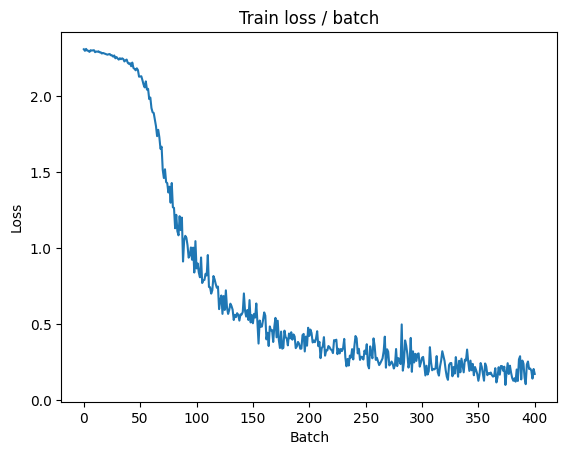


===============> Total time 9s	Avg loss 0.6528	Avg Prec@1 80.97 %	Avg Prec@5 96.05 %

[EVAL Batch 000/079]	Time 0.093s (0.093s)	Loss 0.0982 (0.0982)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.1441	Avg Prec@1 95.42 %	Avg Prec@5 99.96 %



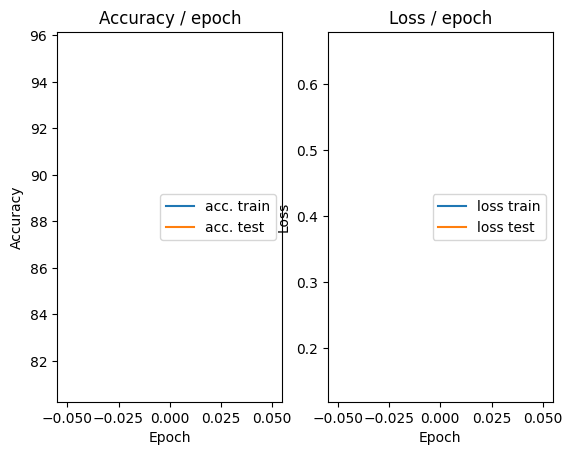

=== EPOCH 2 =====

[TRAIN Batch 000/469]	Time 0.109s (0.109s)	Loss 0.1807 (0.1807)	Prec@1  95.3 ( 95.3)	Prec@5  99.2 ( 99.2)


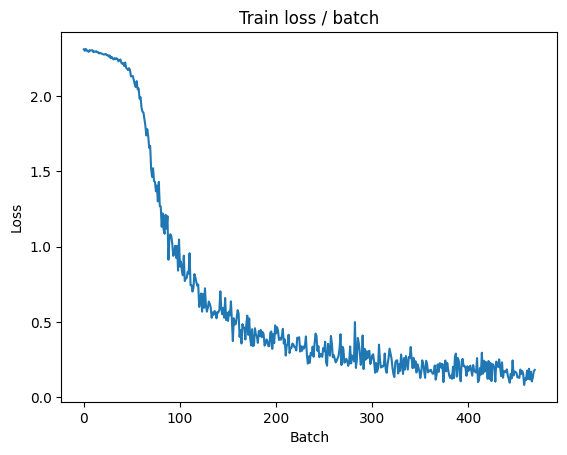

[TRAIN Batch 200/469]	Time 0.038s (0.018s)	Loss 0.1188 (0.1371)	Prec@1  97.7 ( 96.0)	Prec@5 100.0 ( 99.9)


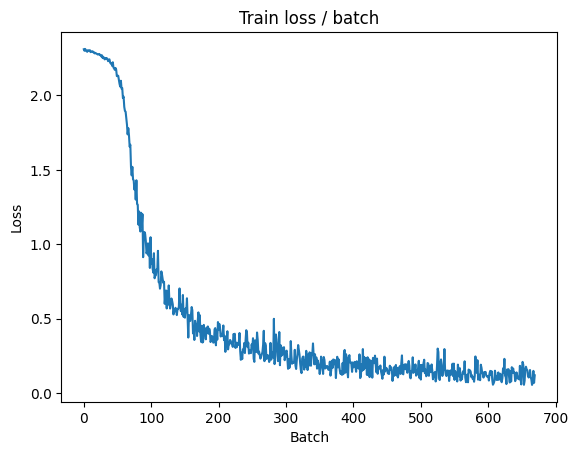

[TRAIN Batch 400/469]	Time 0.022s (0.018s)	Loss 0.0471 (0.1200)	Prec@1  99.2 ( 96.5)	Prec@5 100.0 ( 99.9)


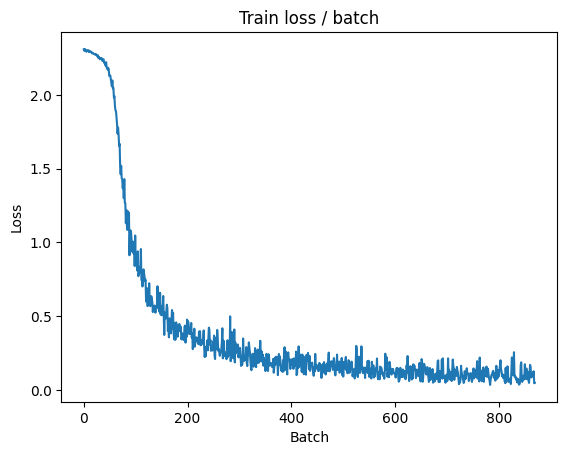


===============> Total time 8s	Avg loss 0.1159	Avg Prec@1 96.59 %	Avg Prec@5 99.89 %

[EVAL Batch 000/079]	Time 0.100s (0.100s)	Loss 0.0408 (0.0408)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0811	Avg Prec@1 97.60 %	Avg Prec@5 100.00 %



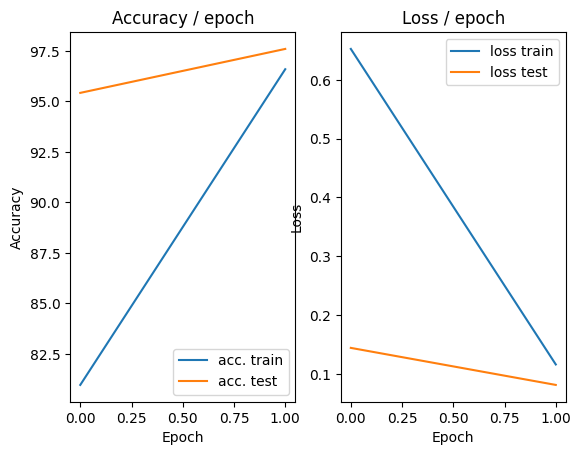

=== EPOCH 3 =====

[TRAIN Batch 000/469]	Time 0.123s (0.123s)	Loss 0.1163 (0.1163)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


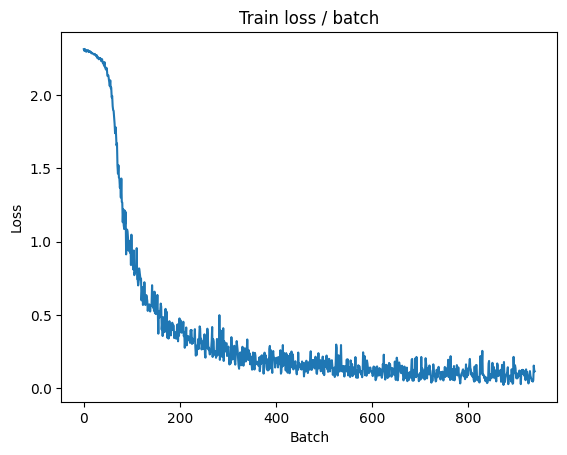

[TRAIN Batch 200/469]	Time 0.020s (0.017s)	Loss 0.0690 (0.0818)	Prec@1  98.4 ( 97.5)	Prec@5 100.0 ( 99.9)


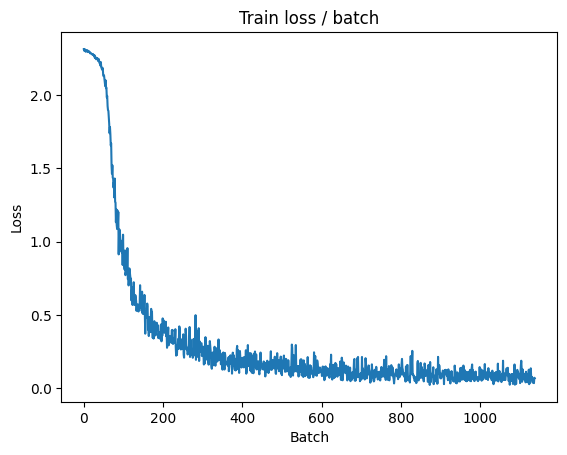

[TRAIN Batch 400/469]	Time 0.041s (0.018s)	Loss 0.1001 (0.0776)	Prec@1  96.1 ( 97.7)	Prec@5 100.0 ( 99.9)


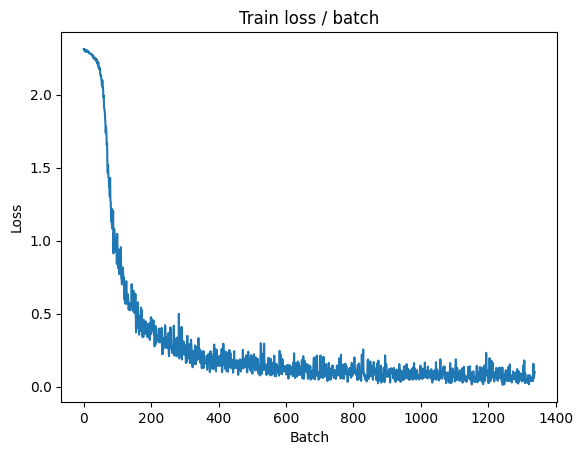


===============> Total time 8s	Avg loss 0.0767	Avg Prec@1 97.69 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.097s (0.097s)	Loss 0.0218 (0.0218)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0552	Avg Prec@1 98.40 %	Avg Prec@5 99.98 %



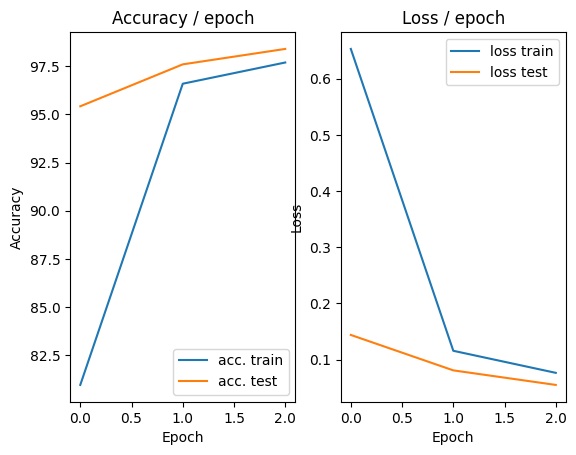

=== EPOCH 4 =====

[TRAIN Batch 000/469]	Time 0.119s (0.119s)	Loss 0.0375 (0.0375)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


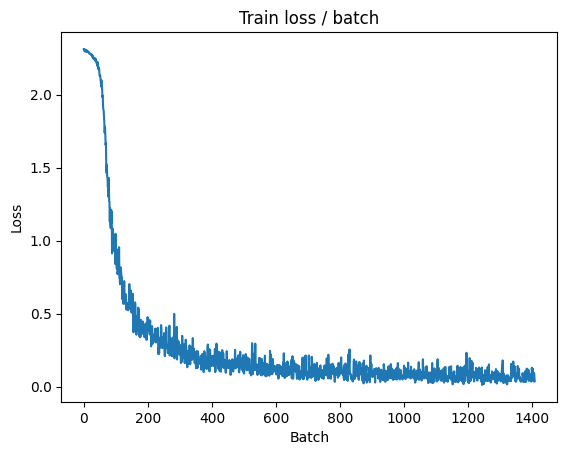

[TRAIN Batch 200/469]	Time 0.007s (0.016s)	Loss 0.1000 (0.0622)	Prec@1  97.7 ( 98.1)	Prec@5 100.0 (100.0)


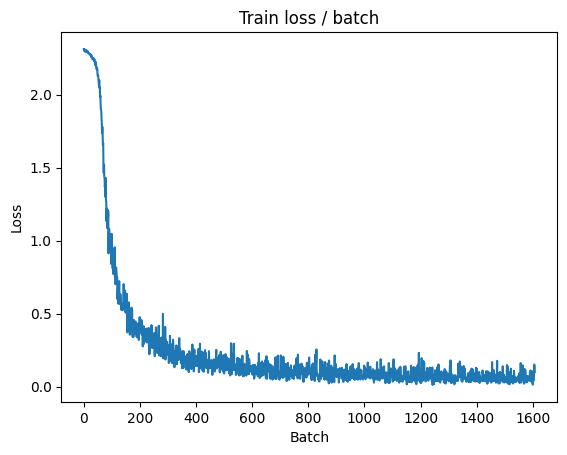

[TRAIN Batch 400/469]	Time 0.008s (0.016s)	Loss 0.0360 (0.0608)	Prec@1  99.2 ( 98.2)	Prec@5 100.0 (100.0)


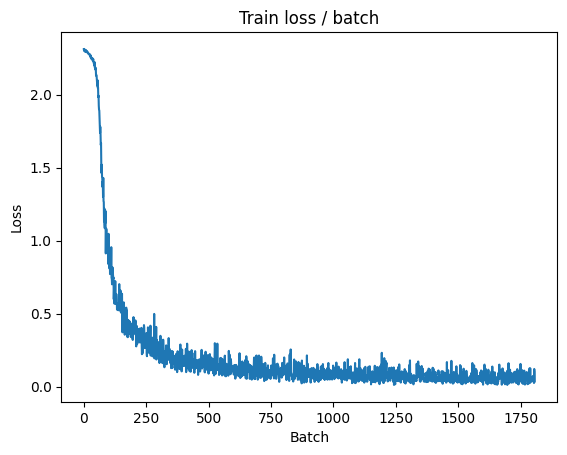


===============> Total time 7s	Avg loss 0.0603	Avg Prec@1 98.20 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.095s (0.095s)	Loss 0.0222 (0.0222)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0521	Avg Prec@1 98.29 %	Avg Prec@5 100.00 %



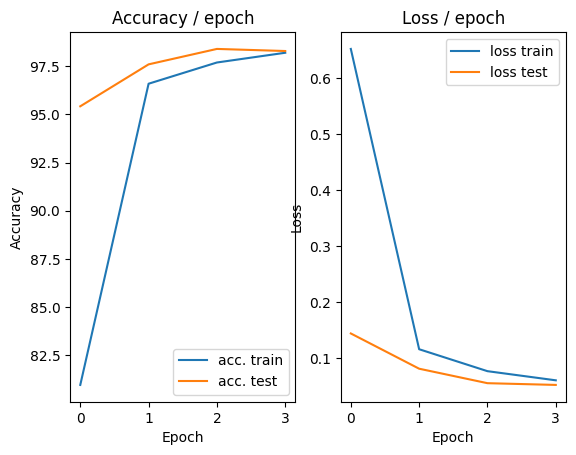

=== EPOCH 5 =====

[TRAIN Batch 000/469]	Time 0.172s (0.172s)	Loss 0.0946 (0.0946)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


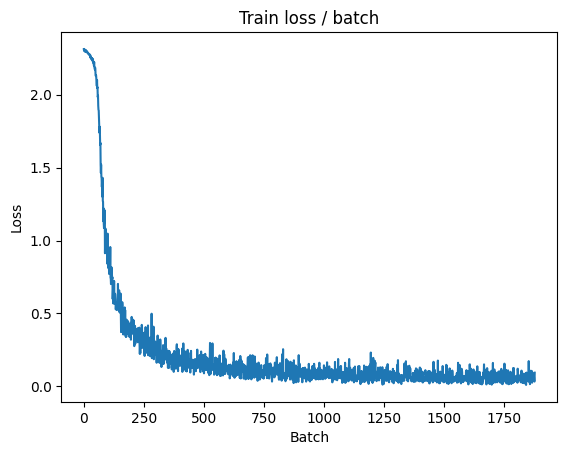

[TRAIN Batch 200/469]	Time 0.009s (0.017s)	Loss 0.0583 (0.0515)	Prec@1  98.4 ( 98.5)	Prec@5 100.0 (100.0)


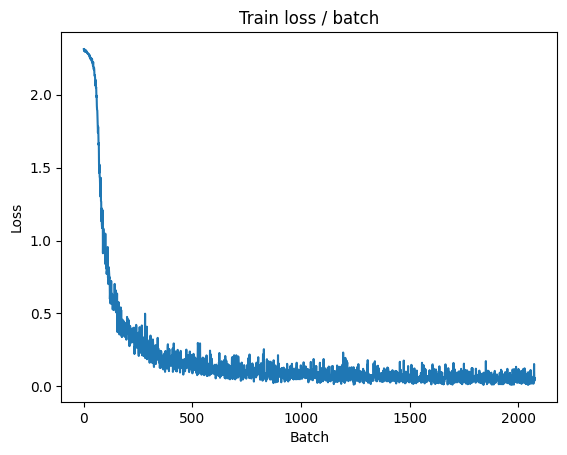

[TRAIN Batch 400/469]	Time 0.007s (0.016s)	Loss 0.0676 (0.0502)	Prec@1  98.4 ( 98.5)	Prec@5 100.0 (100.0)


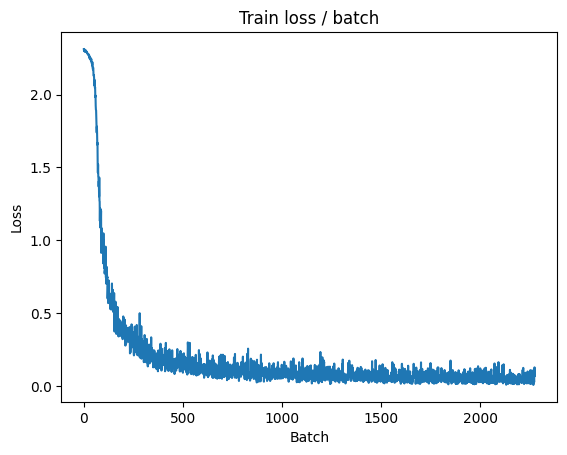


===============> Total time 7s	Avg loss 0.0500	Avg Prec@1 98.49 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.101s (0.101s)	Loss 0.0199 (0.0199)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0443	Avg Prec@1 98.59 %	Avg Prec@5 100.00 %



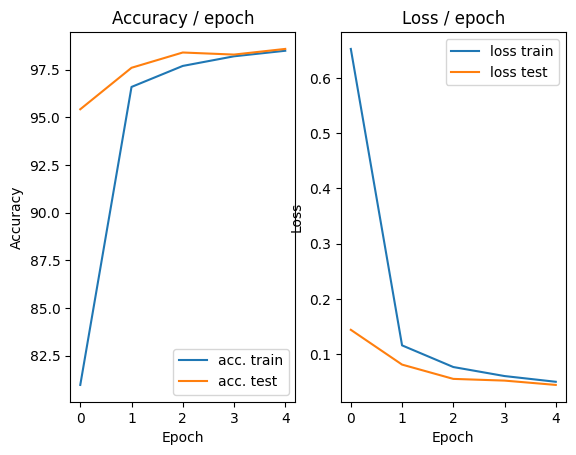

In [16]:
main(128, 0.1, cuda=True)

# CIFAR-10

In [5]:
class CifarConvNet(nn.Module):
    """
    This class defines the structure of the neural network
    """

    def __init__(self, dropout=False, batch_norm=False):
        super(CifarConvNet, self).__init__()
        # We first define the convolution and pooling layers as a features extractor
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),
            nn.BatchNorm2d(32) if batch_norm else nn.Identity(),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.BatchNorm2d(64) if batch_norm else nn.Identity(),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.BatchNorm2d(64) if batch_norm else nn.Identity(),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0, ceil_mode=True),
        )
        # We then define fully connected layers as a classifier
        self.classifier = nn.Sequential(
            nn.Linear(1024, 1000),
            nn.ReLU(),
            nn.Dropout(0.5) if dropout else nn.Identity(),
            nn.Linear(1000, 10)
            # Reminder: The softmax is included in the loss, do not put it here
        )

    # Method called when we apply the network to an input batch
    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers
        return output

In [7]:
def get_cifar_dataset(batch_size, cuda=False):
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor()
        ]))
    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor()
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader

In [8]:
def main_cifar(batch_size=128, lr=0.1, epochs=5, cuda=False, get_dataset=get_cifar_dataset):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = CifarConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)

=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.195s (0.195s)	Loss 2.3026 (2.3026)	Prec@1  10.2 ( 10.2)	Prec@5  45.3 ( 45.3)


<Figure size 640x480 with 0 Axes>

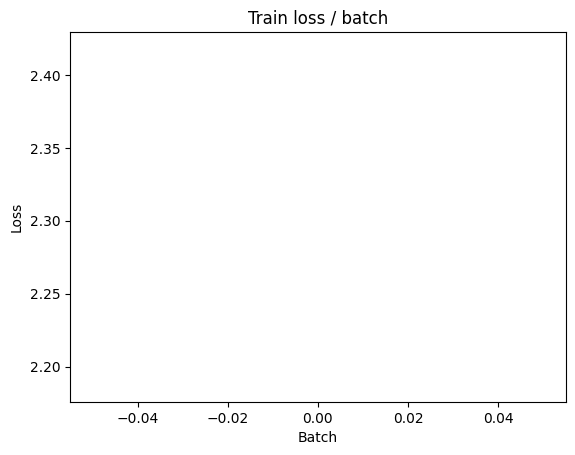

[TRAIN Batch 200/391]	Time 0.019s (0.022s)	Loss 2.0602 (2.2153)	Prec@1  27.3 ( 18.1)	Prec@5  73.4 ( 65.9)


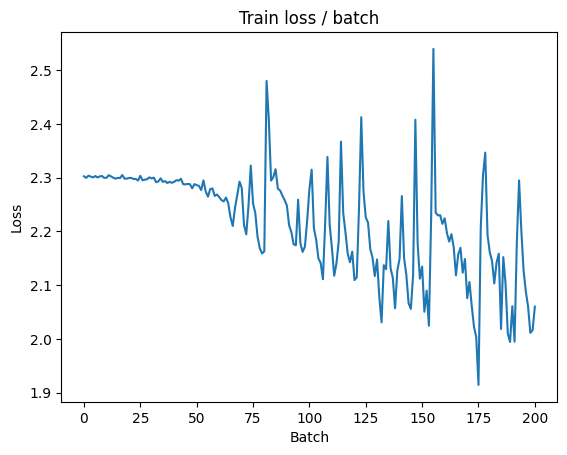


===============> Total time 8s	Avg loss 2.0964	Avg Prec@1 23.49 %	Avg Prec@5 72.74 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 1.7158 (1.7158)	Prec@1  43.8 ( 43.8)	Prec@5  87.5 ( 87.5)

===============> Total time 1s	Avg loss 1.7710	Avg Prec@1 36.51 %	Avg Prec@5 86.73 %



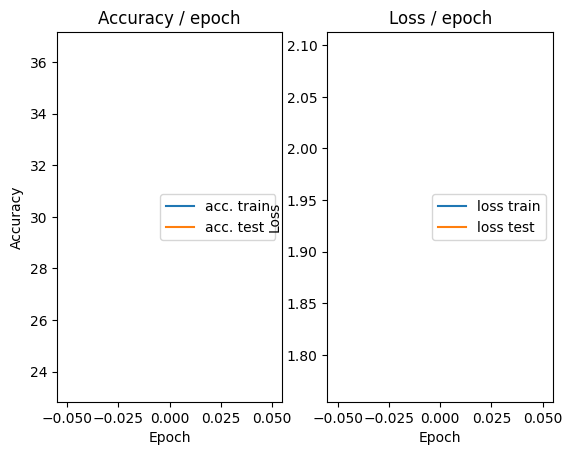

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.160s (0.160s)	Loss 1.7219 (1.7219)	Prec@1  33.6 ( 33.6)	Prec@5  87.5 ( 87.5)


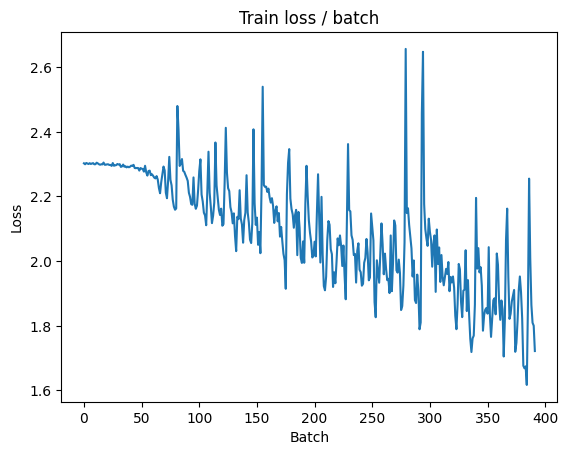

[TRAIN Batch 200/391]	Time 0.031s (0.030s)	Loss 1.4722 (1.7171)	Prec@1  47.7 ( 38.2)	Prec@5  90.6 ( 87.6)


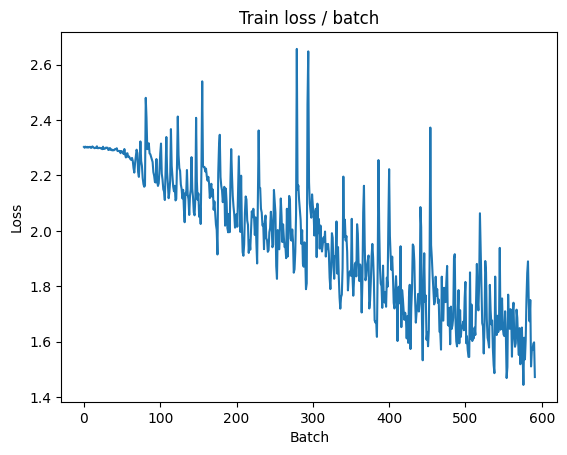


===============> Total time 10s	Avg loss 1.6361	Avg Prec@1 41.35 %	Avg Prec@5 89.12 %

[EVAL Batch 000/079]	Time 0.111s (0.111s)	Loss 1.3561 (1.3561)	Prec@1  53.1 ( 53.1)	Prec@5  93.8 ( 93.8)

===============> Total time 1s	Avg loss 1.4579	Avg Prec@1 46.26 %	Avg Prec@5 92.54 %



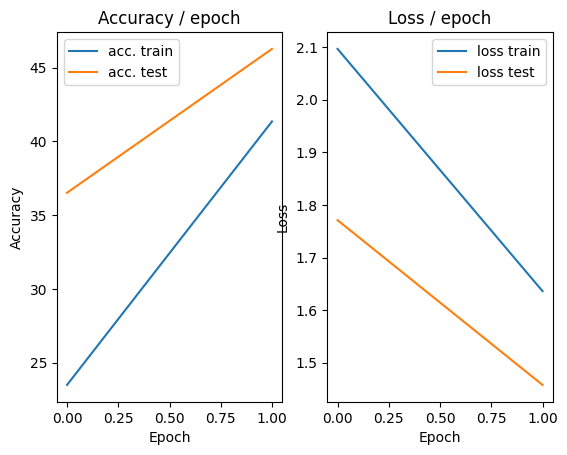

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.282s (0.282s)	Loss 1.4410 (1.4410)	Prec@1  50.8 ( 50.8)	Prec@5  92.2 ( 92.2)


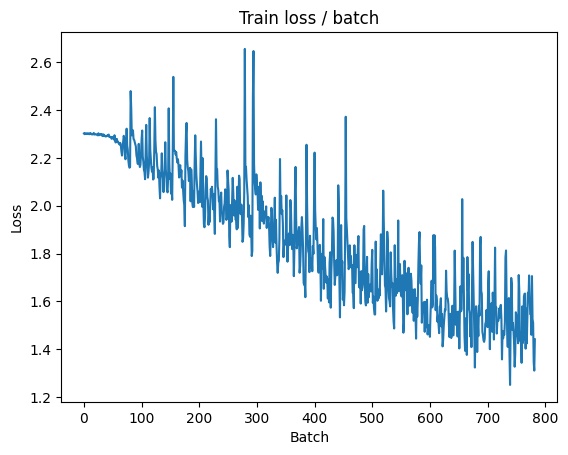

[TRAIN Batch 200/391]	Time 0.012s (0.031s)	Loss 1.5479 (1.4255)	Prec@1  43.0 ( 49.0)	Prec@5  96.1 ( 92.8)


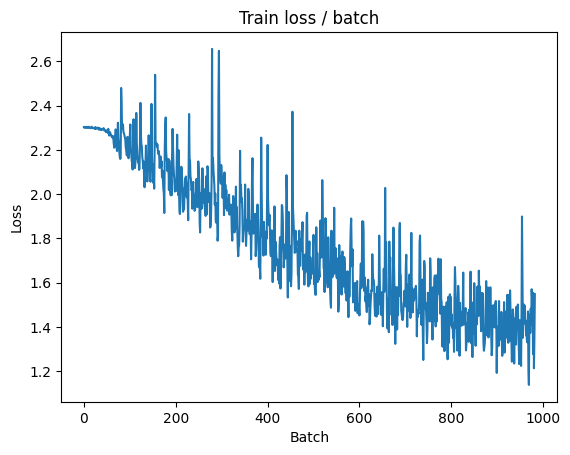


===============> Total time 10s	Avg loss 1.3944	Avg Prec@1 50.15 %	Avg Prec@5 93.11 %

[EVAL Batch 000/079]	Time 0.106s (0.106s)	Loss 1.1335 (1.1335)	Prec@1  68.0 ( 68.0)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.2751	Avg Prec@1 54.26 %	Avg Prec@5 94.55 %



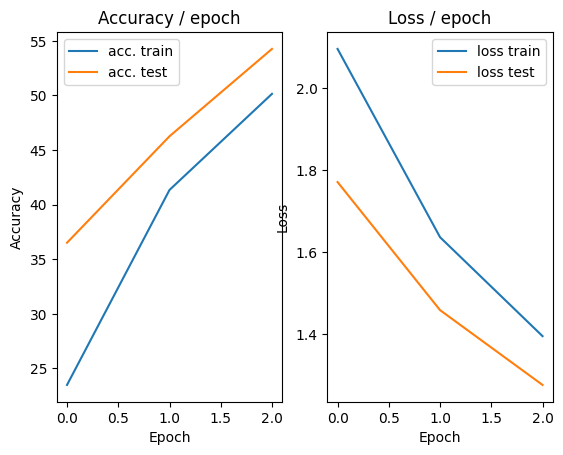

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.137s (0.137s)	Loss 1.2349 (1.2349)	Prec@1  50.8 ( 50.8)	Prec@5  96.9 ( 96.9)


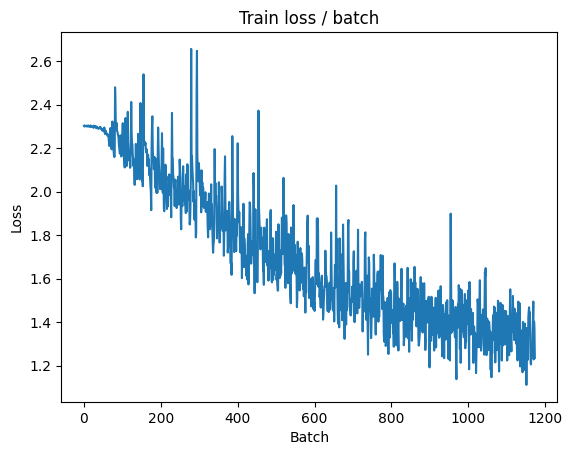

[TRAIN Batch 200/391]	Time 0.012s (0.024s)	Loss 1.2497 (1.2620)	Prec@1  55.5 ( 55.1)	Prec@5  91.4 ( 94.5)


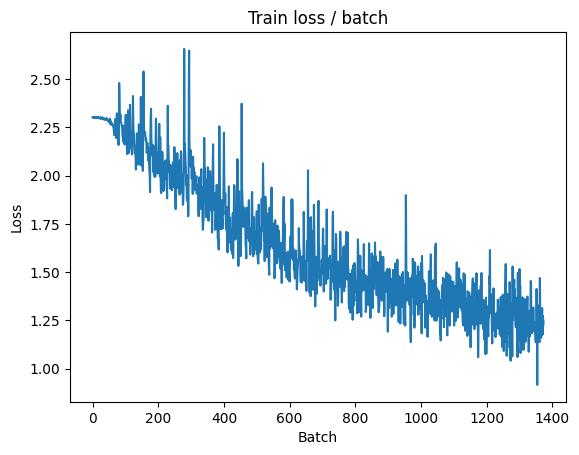


===============> Total time 8s	Avg loss 1.2353	Avg Prec@1 55.85 %	Avg Prec@5 94.81 %

[EVAL Batch 000/079]	Time 0.116s (0.116s)	Loss 1.1054 (1.1054)	Prec@1  66.4 ( 66.4)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.2569	Avg Prec@1 55.49 %	Avg Prec@5 94.46 %



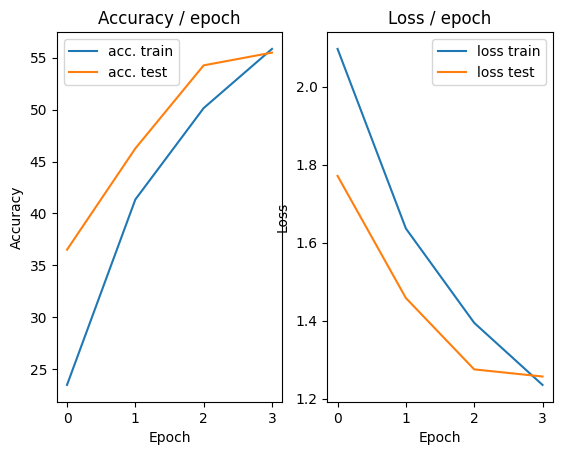

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.140s (0.140s)	Loss 1.2072 (1.2072)	Prec@1  58.6 ( 58.6)	Prec@5  94.5 ( 94.5)


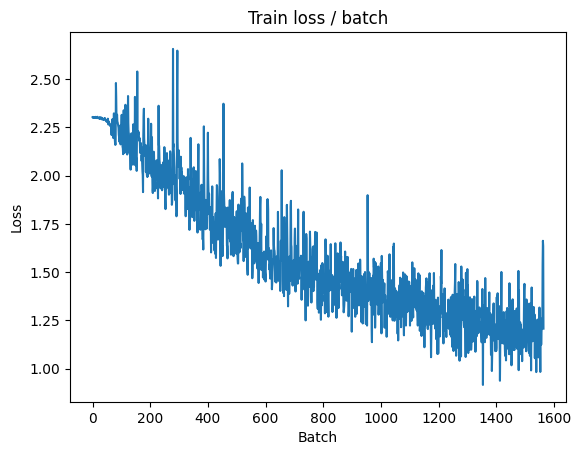

[TRAIN Batch 200/391]	Time 0.011s (0.020s)	Loss 1.1211 (1.1247)	Prec@1  61.7 ( 60.1)	Prec@5  95.3 ( 96.0)


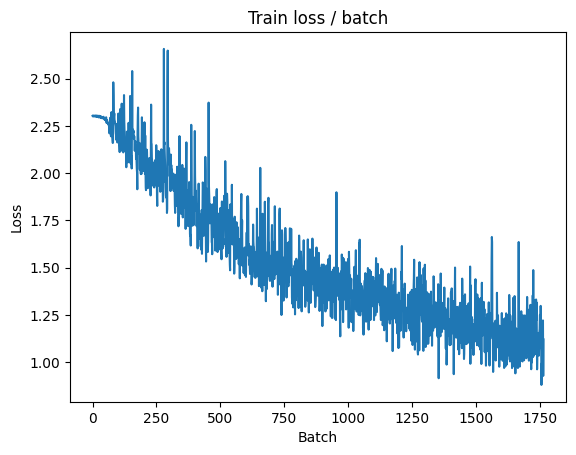


===============> Total time 8s	Avg loss 1.1034	Avg Prec@1 60.81 %	Avg Prec@5 96.06 %

[EVAL Batch 000/079]	Time 0.112s (0.112s)	Loss 1.0998 (1.0998)	Prec@1  60.2 ( 60.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.2168	Avg Prec@1 56.73 %	Avg Prec@5 95.38 %



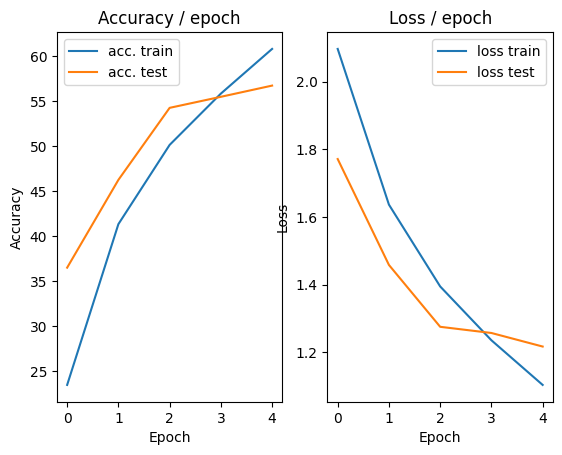

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.141s (0.141s)	Loss 0.9872 (0.9872)	Prec@1  69.5 ( 69.5)	Prec@5  96.9 ( 96.9)


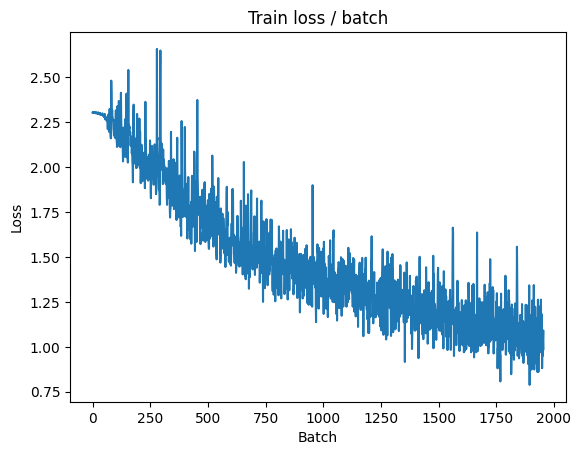

[TRAIN Batch 200/391]	Time 0.018s (0.020s)	Loss 1.1728 (0.9929)	Prec@1  52.3 ( 65.1)	Prec@5  96.1 ( 96.9)


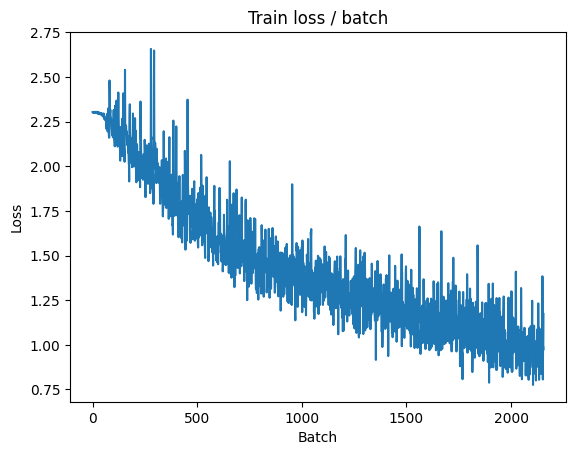


===============> Total time 8s	Avg loss 0.9838	Avg Prec@1 65.40 %	Avg Prec@5 96.90 %

[EVAL Batch 000/079]	Time 0.127s (0.127s)	Loss 0.9372 (0.9372)	Prec@1  70.3 ( 70.3)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.0278	Avg Prec@1 63.23 %	Avg Prec@5 96.75 %



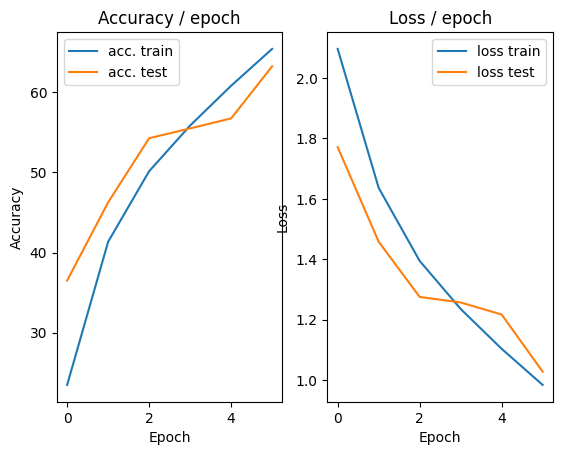

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.134s (0.134s)	Loss 1.0336 (1.0336)	Prec@1  68.0 ( 68.0)	Prec@5  98.4 ( 98.4)


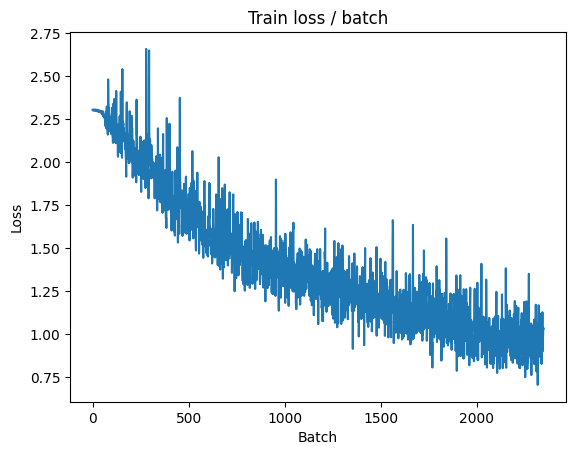

[TRAIN Batch 200/391]	Time 0.009s (0.021s)	Loss 0.9167 (0.8718)	Prec@1  64.8 ( 69.8)	Prec@5  96.9 ( 97.8)


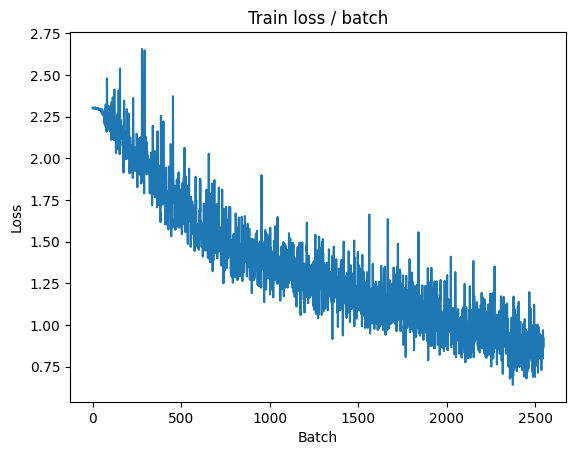


===============> Total time 7s	Avg loss 0.8717	Avg Prec@1 69.64 %	Avg Prec@5 97.74 %

[EVAL Batch 000/079]	Time 0.118s (0.118s)	Loss 0.9029 (0.9029)	Prec@1  66.4 ( 66.4)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.9836	Avg Prec@1 65.17 %	Avg Prec@5 96.86 %



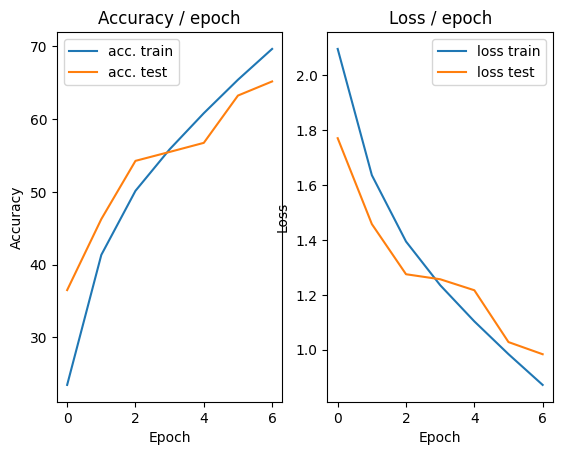

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.242s (0.242s)	Loss 0.8571 (0.8571)	Prec@1  71.1 ( 71.1)	Prec@5  97.7 ( 97.7)


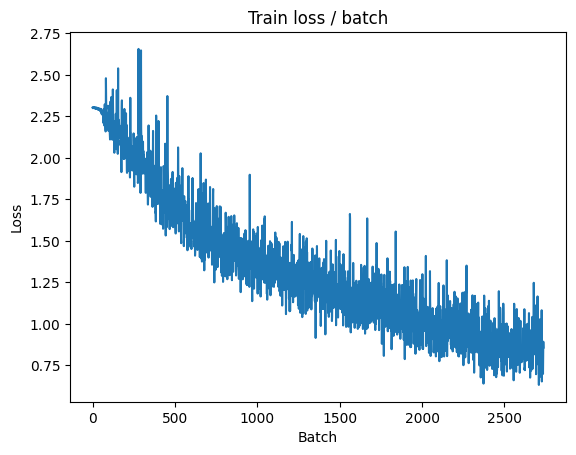

[TRAIN Batch 200/391]	Time 0.014s (0.023s)	Loss 0.9106 (0.7765)	Prec@1  68.8 ( 72.7)	Prec@5  98.4 ( 98.2)


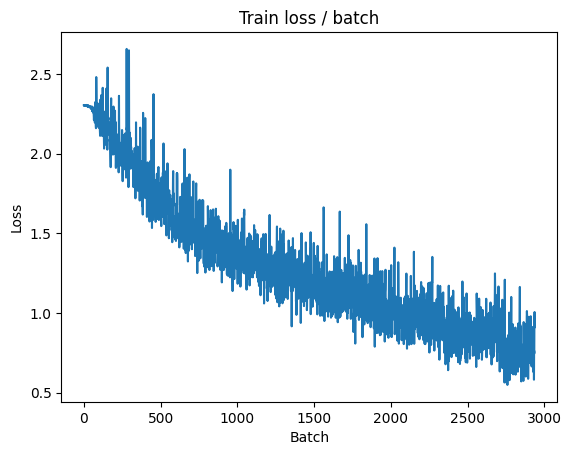


===============> Total time 8s	Avg loss 0.7740	Avg Prec@1 72.70 %	Avg Prec@5 98.25 %

[EVAL Batch 000/079]	Time 0.114s (0.114s)	Loss 0.8811 (0.8811)	Prec@1  74.2 ( 74.2)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.9187	Avg Prec@1 68.31 %	Avg Prec@5 97.08 %



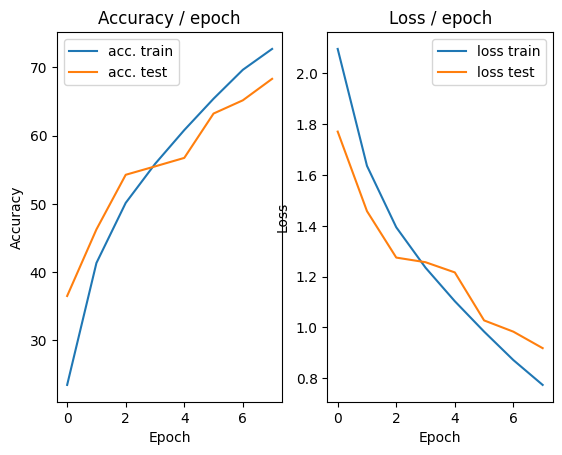

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.143s (0.143s)	Loss 0.6928 (0.6928)	Prec@1  78.9 ( 78.9)	Prec@5  96.9 ( 96.9)


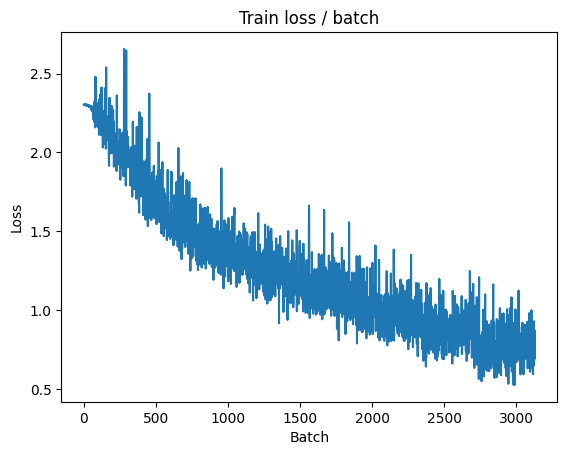

[TRAIN Batch 200/391]	Time 0.010s (0.024s)	Loss 0.5186 (0.6705)	Prec@1  83.6 ( 76.3)	Prec@5 100.0 ( 98.8)


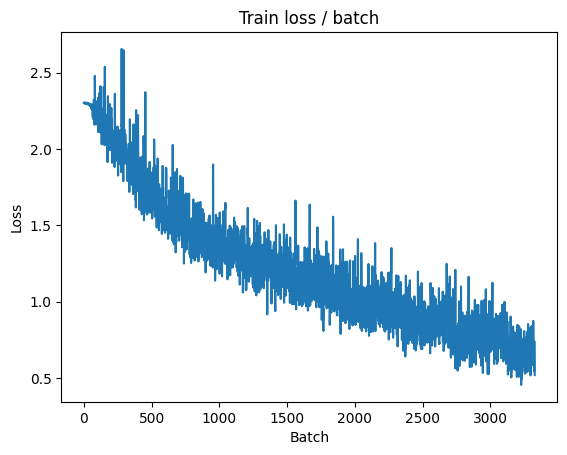


===============> Total time 8s	Avg loss 0.6741	Avg Prec@1 76.39 %	Avg Prec@5 98.81 %

[EVAL Batch 000/079]	Time 0.112s (0.112s)	Loss 0.8730 (0.8730)	Prec@1  71.9 ( 71.9)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 0.9036	Avg Prec@1 69.23 %	Avg Prec@5 97.25 %



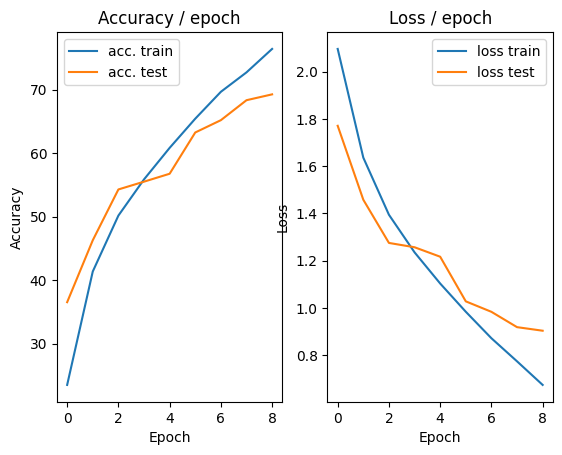

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.155s (0.155s)	Loss 0.5431 (0.5431)	Prec@1  81.2 ( 81.2)	Prec@5 100.0 (100.0)


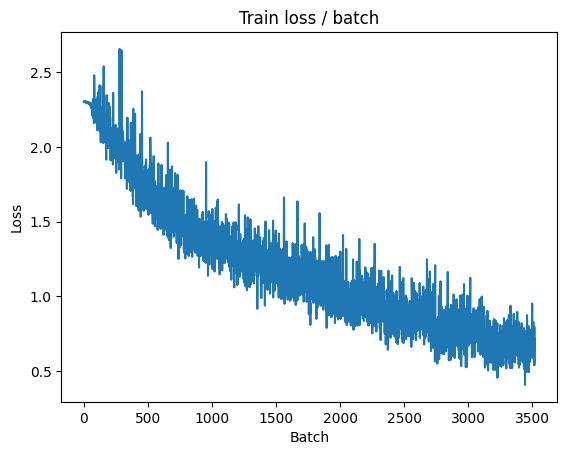

[TRAIN Batch 200/391]	Time 0.020s (0.020s)	Loss 0.6046 (0.5612)	Prec@1  76.6 ( 80.6)	Prec@5 100.0 ( 99.2)


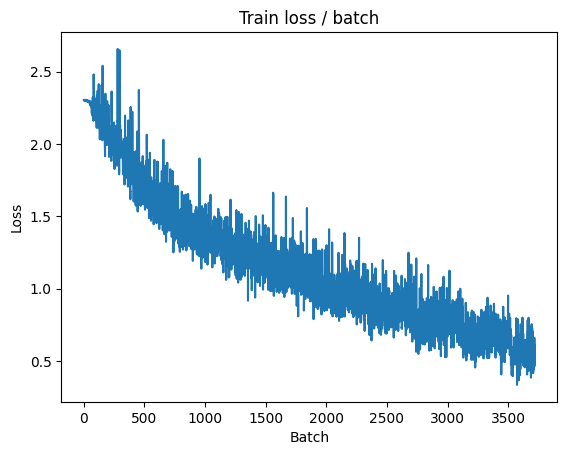


===============> Total time 8s	Avg loss 0.5771	Avg Prec@1 79.90 %	Avg Prec@5 99.08 %

[EVAL Batch 000/079]	Time 0.120s (0.120s)	Loss 0.8882 (0.8882)	Prec@1  68.0 ( 68.0)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 0.9266	Avg Prec@1 68.58 %	Avg Prec@5 97.18 %



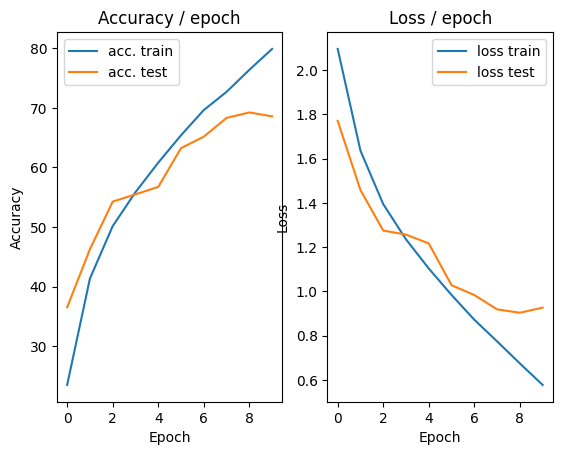

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.143s (0.143s)	Loss 0.4767 (0.4767)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)


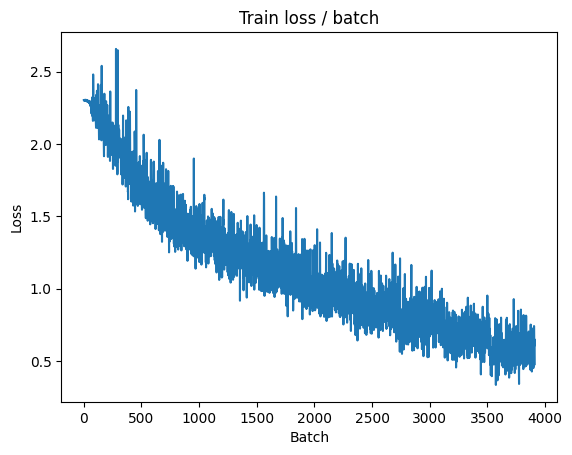

[TRAIN Batch 200/391]	Time 0.010s (0.020s)	Loss 0.4372 (0.4638)	Prec@1  84.4 ( 83.7)	Prec@5  99.2 ( 99.5)


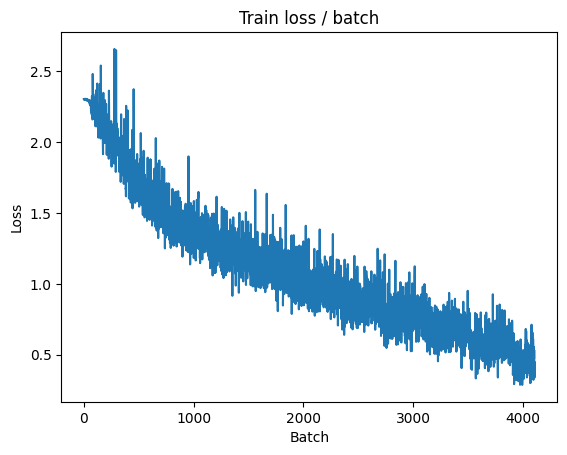


===============> Total time 8s	Avg loss 0.4845	Avg Prec@1 82.88 %	Avg Prec@5 99.44 %

[EVAL Batch 000/079]	Time 0.113s (0.113s)	Loss 1.1459 (1.1459)	Prec@1  64.1 ( 64.1)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.0150	Avg Prec@1 67.13 %	Avg Prec@5 97.01 %



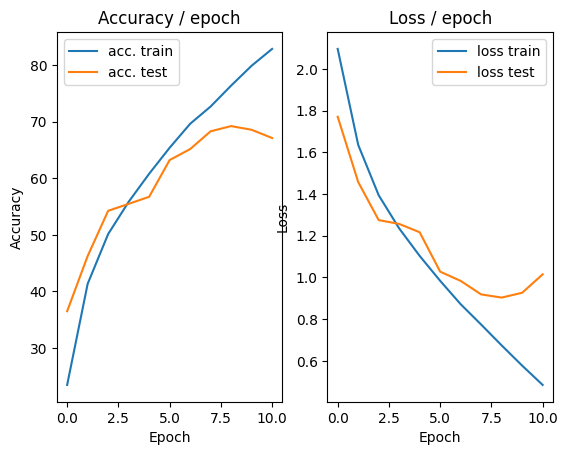

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.150s (0.150s)	Loss 0.4258 (0.4258)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)


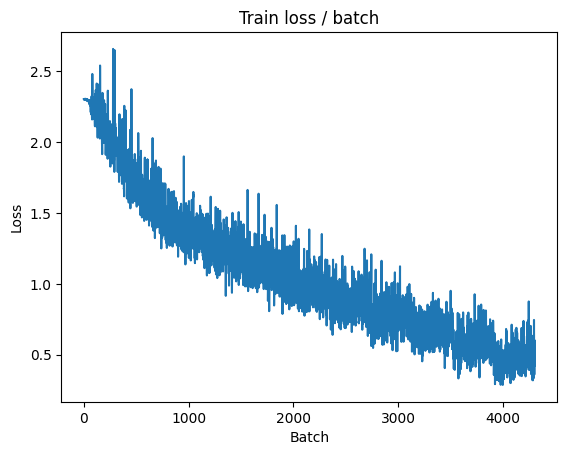

[TRAIN Batch 200/391]	Time 0.029s (0.020s)	Loss 0.3476 (0.3611)	Prec@1  89.1 ( 87.5)	Prec@5 100.0 ( 99.7)


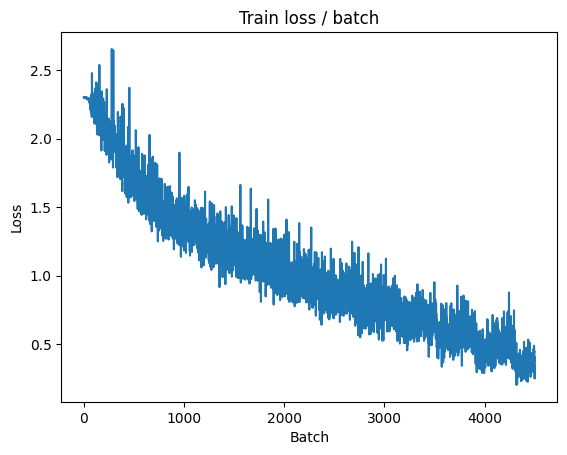


===============> Total time 7s	Avg loss 0.3912	Avg Prec@1 86.32 %	Avg Prec@5 99.71 %

[EVAL Batch 000/079]	Time 0.130s (0.130s)	Loss 1.2426 (1.2426)	Prec@1  66.4 ( 66.4)	Prec@5  94.5 ( 94.5)

===============> Total time 1s	Avg loss 1.1228	Avg Prec@1 66.42 %	Avg Prec@5 96.88 %



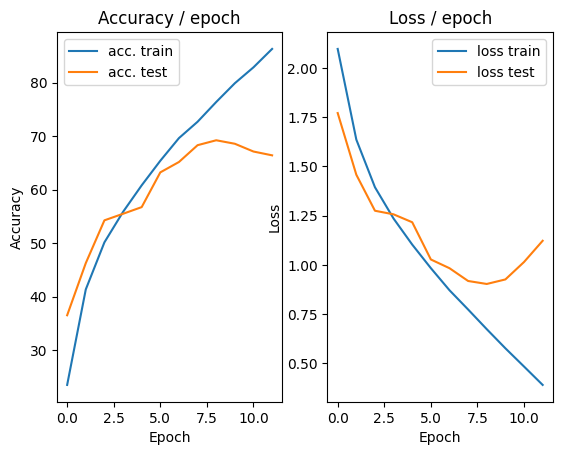

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.209s (0.209s)	Loss 0.3690 (0.3690)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)


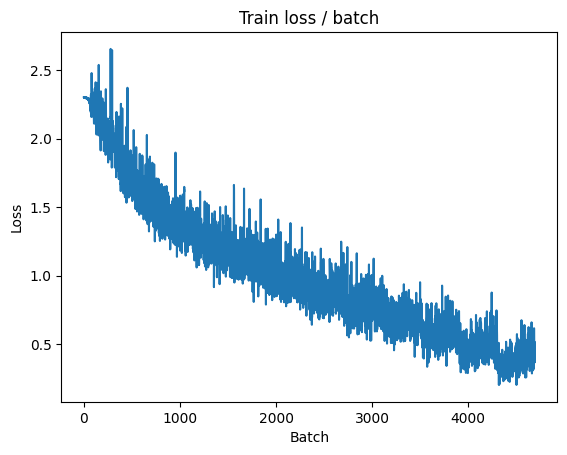

[TRAIN Batch 200/391]	Time 0.028s (0.021s)	Loss 0.3286 (0.2858)	Prec@1  87.5 ( 90.3)	Prec@5 100.0 ( 99.9)


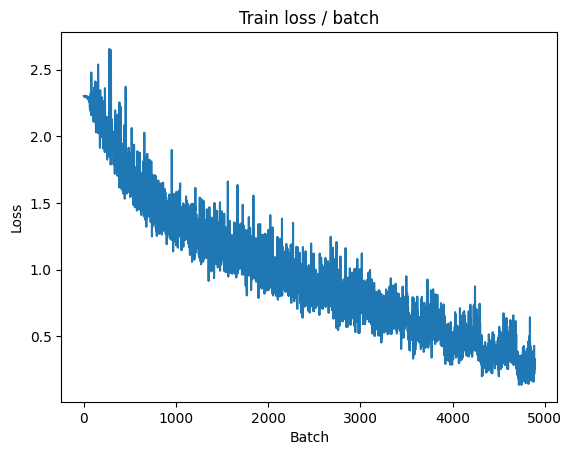


===============> Total time 8s	Avg loss 0.3056	Avg Prec@1 89.46 %	Avg Prec@5 99.84 %

[EVAL Batch 000/079]	Time 0.121s (0.121s)	Loss 1.3282 (1.3282)	Prec@1  62.5 ( 62.5)	Prec@5  92.2 ( 92.2)

===============> Total time 1s	Avg loss 1.2703	Avg Prec@1 65.50 %	Avg Prec@5 95.56 %



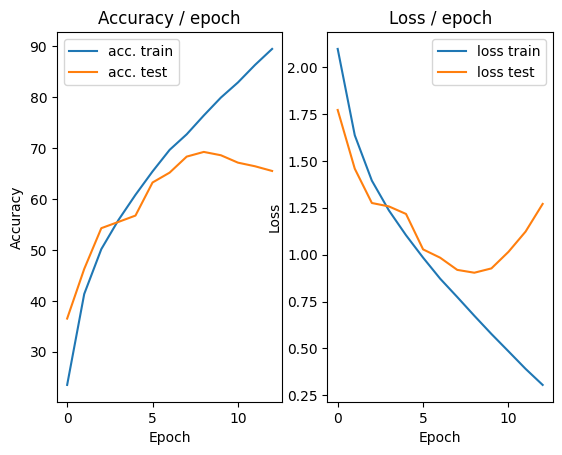

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.151s (0.151s)	Loss 0.3131 (0.3131)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


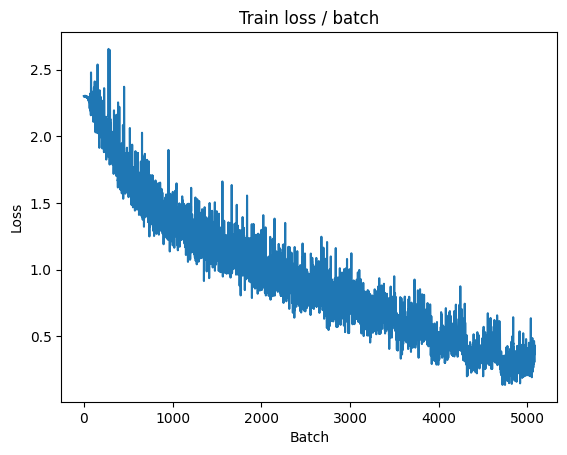

[TRAIN Batch 200/391]	Time 0.029s (0.025s)	Loss 0.2928 (0.2111)	Prec@1  92.2 ( 93.0)	Prec@5 100.0 ( 99.9)


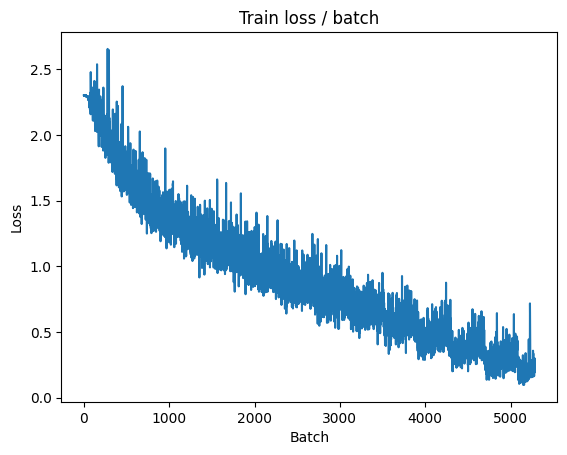


===============> Total time 8s	Avg loss 0.2288	Avg Prec@1 92.24 %	Avg Prec@5 99.91 %

[EVAL Batch 000/079]	Time 0.113s (0.113s)	Loss 1.1333 (1.1333)	Prec@1  72.7 ( 72.7)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.1710	Avg Prec@1 69.09 %	Avg Prec@5 97.11 %



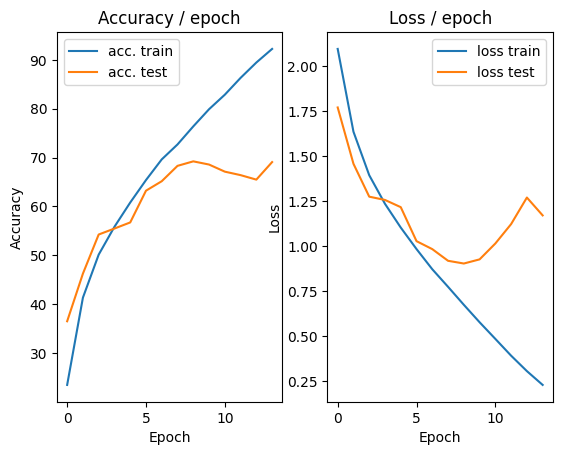

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.148s (0.148s)	Loss 0.1832 (0.1832)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


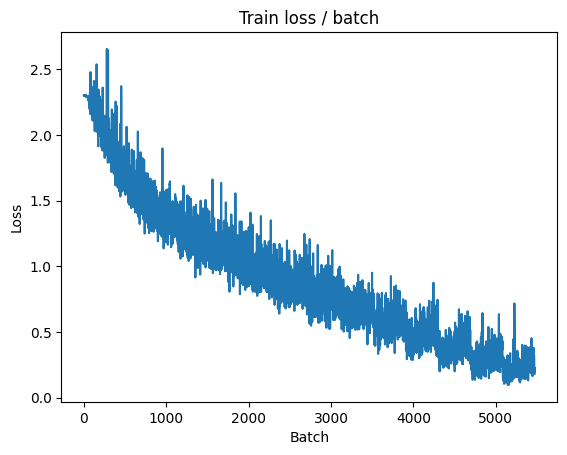

[TRAIN Batch 200/391]	Time 0.044s (0.026s)	Loss 0.1644 (0.1339)	Prec@1  94.5 ( 95.5)	Prec@5 100.0 (100.0)


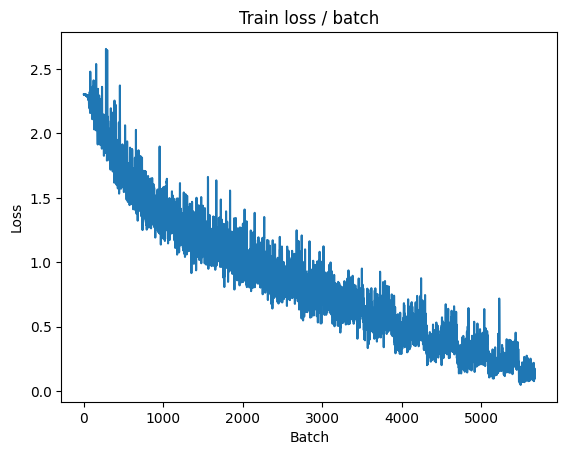


===============> Total time 8s	Avg loss 0.1639	Avg Prec@1 94.40 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.113s (0.113s)	Loss 1.4594 (1.4594)	Prec@1  67.2 ( 67.2)	Prec@5  94.5 ( 94.5)

===============> Total time 1s	Avg loss 1.2933	Avg Prec@1 68.87 %	Avg Prec@5 97.08 %



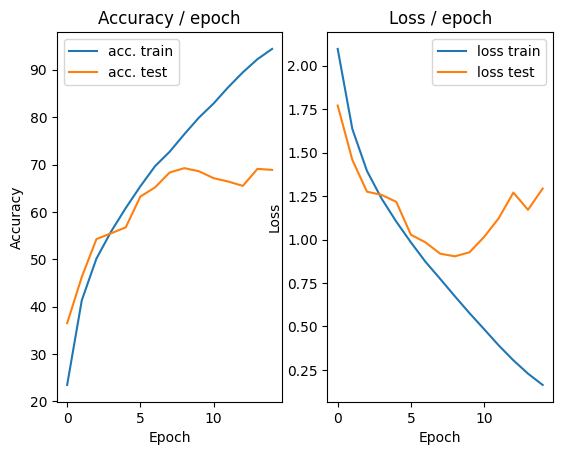

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.141s (0.141s)	Loss 0.0857 (0.0857)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


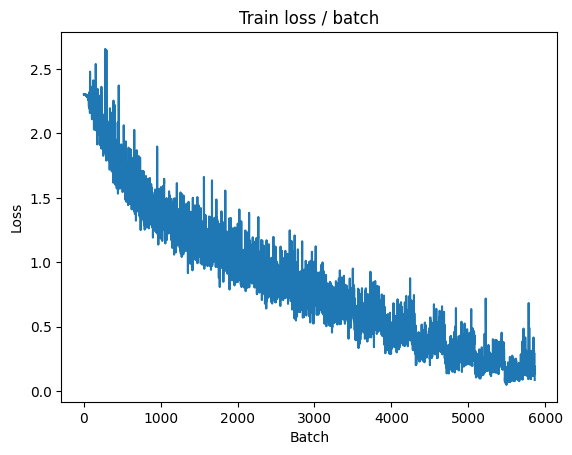

[TRAIN Batch 200/391]	Time 0.008s (0.020s)	Loss 0.1459 (0.1117)	Prec@1  96.1 ( 96.3)	Prec@5 100.0 (100.0)


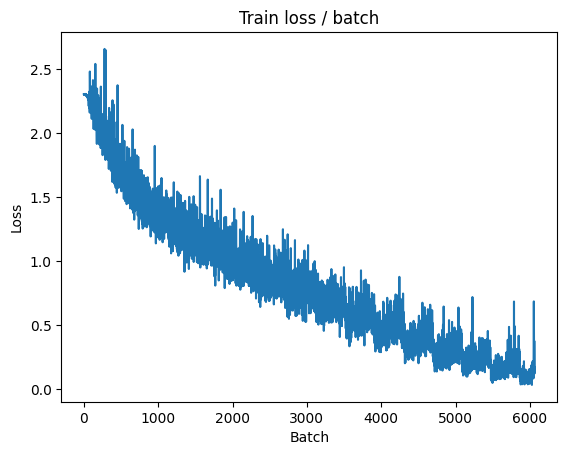


===============> Total time 8s	Avg loss 0.1322	Avg Prec@1 95.71 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.119s (0.119s)	Loss 1.3834 (1.3834)	Prec@1  70.3 ( 70.3)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.3303	Avg Prec@1 69.85 %	Avg Prec@5 97.14 %



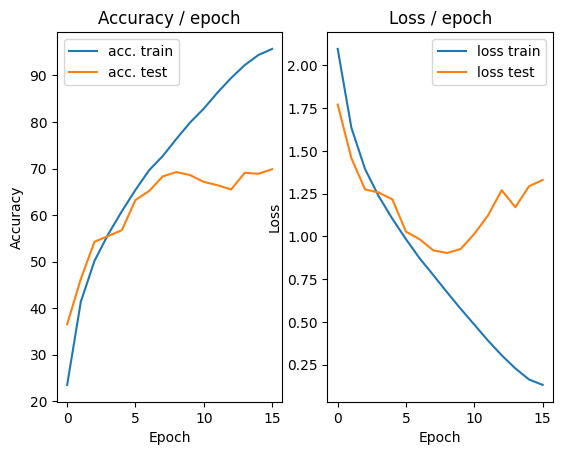

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.151s (0.151s)	Loss 0.0486 (0.0486)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


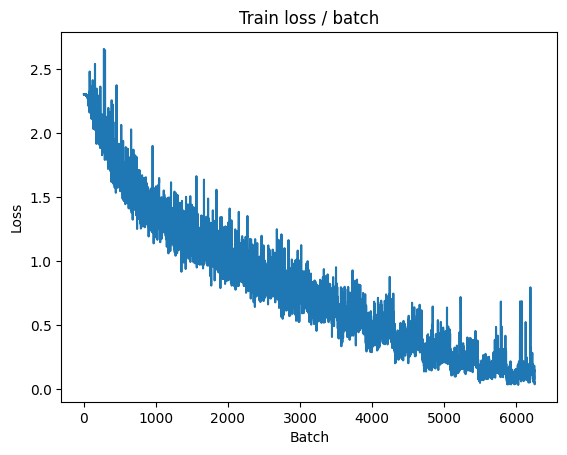

[TRAIN Batch 200/391]	Time 0.018s (0.022s)	Loss 0.0601 (0.0627)	Prec@1  98.4 ( 98.3)	Prec@5 100.0 (100.0)


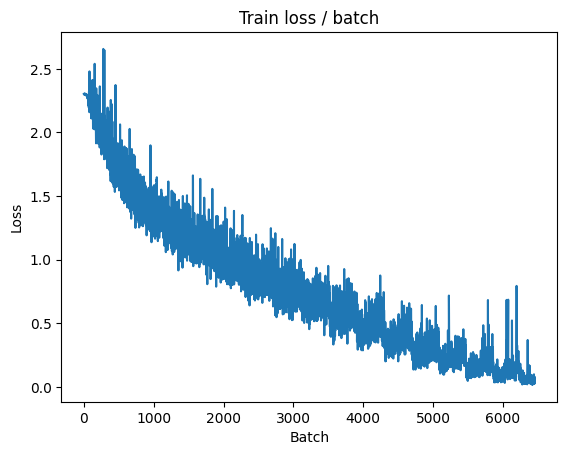


===============> Total time 8s	Avg loss 0.0886	Avg Prec@1 97.18 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.212s (0.212s)	Loss 1.4373 (1.4373)	Prec@1  68.0 ( 68.0)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.4372	Avg Prec@1 69.82 %	Avg Prec@5 97.15 %



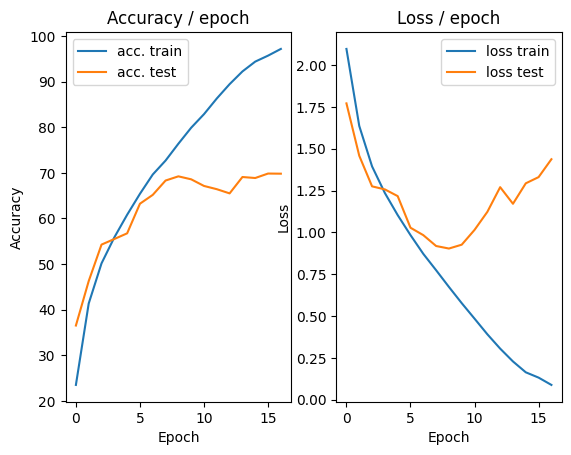

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.153s (0.153s)	Loss 0.0449 (0.0449)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


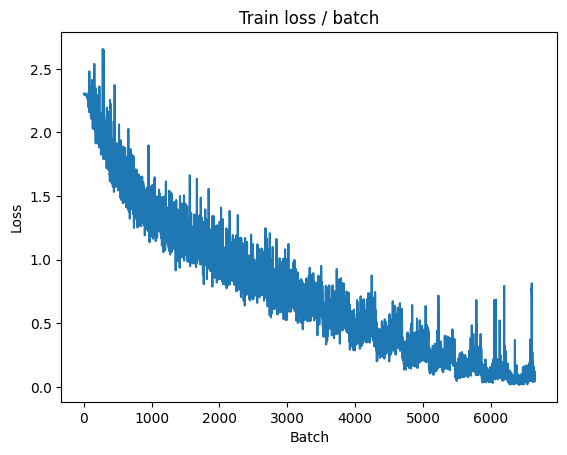

[TRAIN Batch 200/391]	Time 0.028s (0.020s)	Loss 0.0460 (0.0417)	Prec@1  99.2 ( 98.9)	Prec@5 100.0 (100.0)


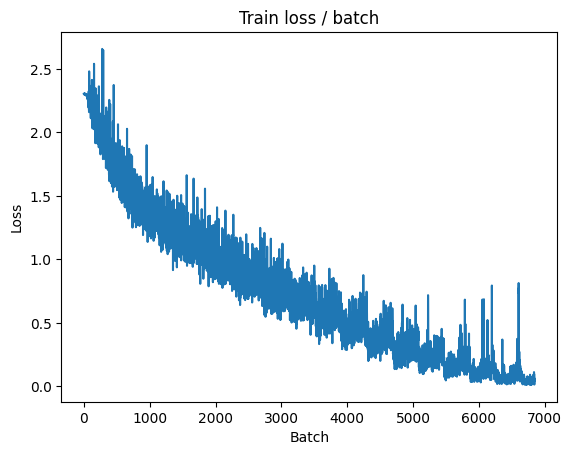


===============> Total time 7s	Avg loss 0.0545	Avg Prec@1 98.32 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.115s (0.115s)	Loss 1.8223 (1.8223)	Prec@1  70.3 ( 70.3)	Prec@5  94.5 ( 94.5)

===============> Total time 1s	Avg loss 1.5603	Avg Prec@1 69.75 %	Avg Prec@5 97.09 %



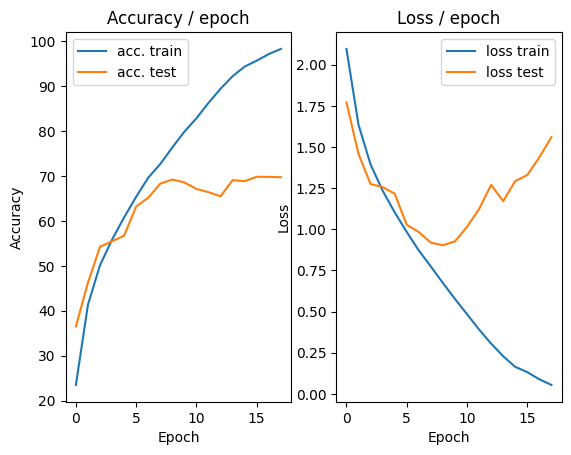

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.308s (0.308s)	Loss 0.0882 (0.0882)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


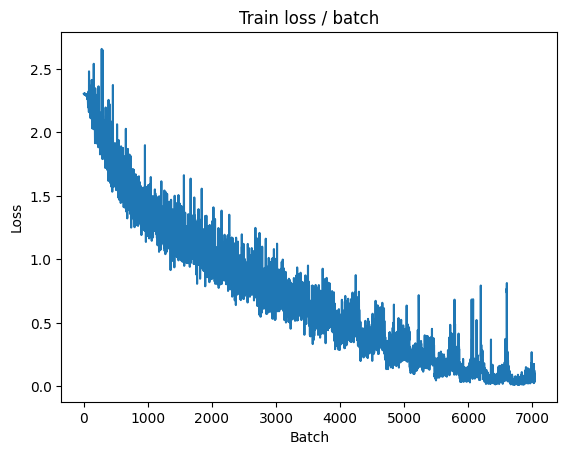

[TRAIN Batch 200/391]	Time 0.023s (0.026s)	Loss 0.0192 (0.0345)	Prec@1 100.0 ( 99.1)	Prec@5 100.0 (100.0)


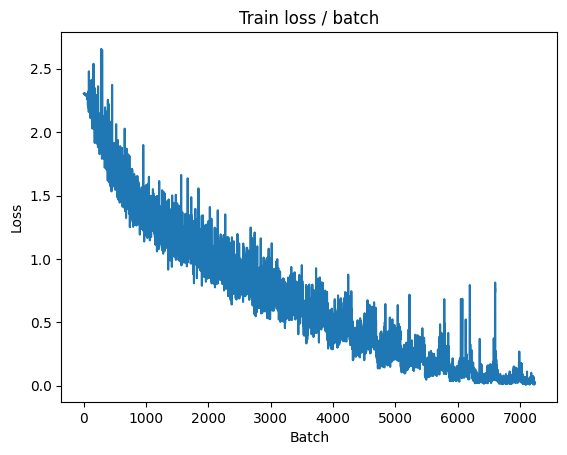


===============> Total time 9s	Avg loss 0.0931	Avg Prec@1 97.61 %	Avg Prec@5 99.87 %

[EVAL Batch 000/079]	Time 0.127s (0.127s)	Loss 1.4689 (1.4689)	Prec@1  69.5 ( 69.5)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 1.4048	Avg Prec@1 70.00 %	Avg Prec@5 97.25 %



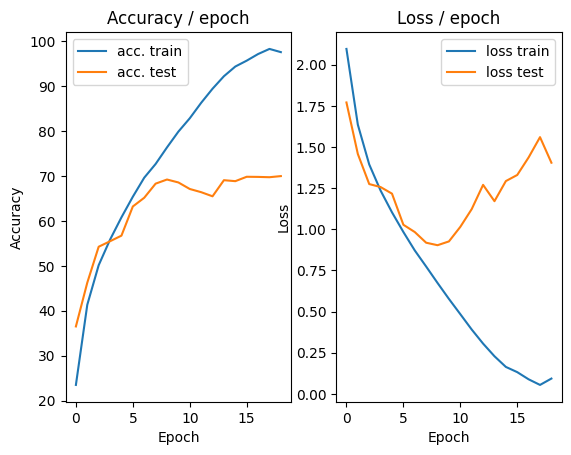

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.158s (0.158s)	Loss 0.0687 (0.0687)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


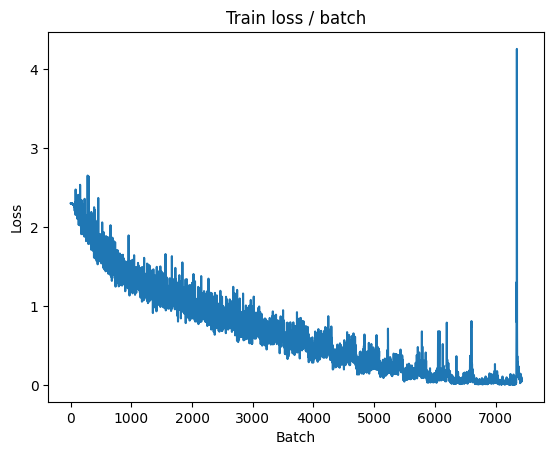

[TRAIN Batch 200/391]	Time 0.024s (0.025s)	Loss 0.0217 (0.0318)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


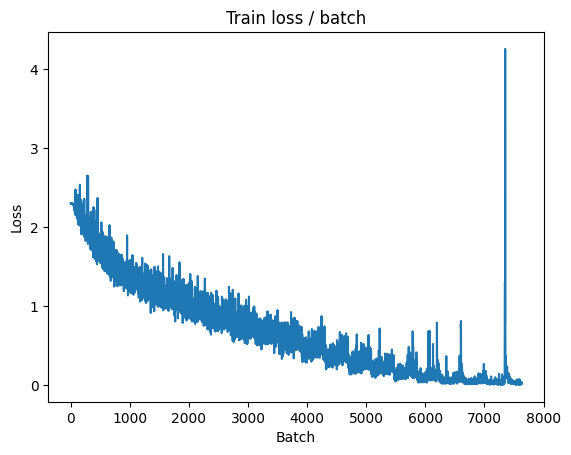


===============> Total time 8s	Avg loss 0.0371	Avg Prec@1 98.97 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.117s (0.117s)	Loss 1.6985 (1.6985)	Prec@1  72.7 ( 72.7)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.6564	Avg Prec@1 70.36 %	Avg Prec@5 97.22 %



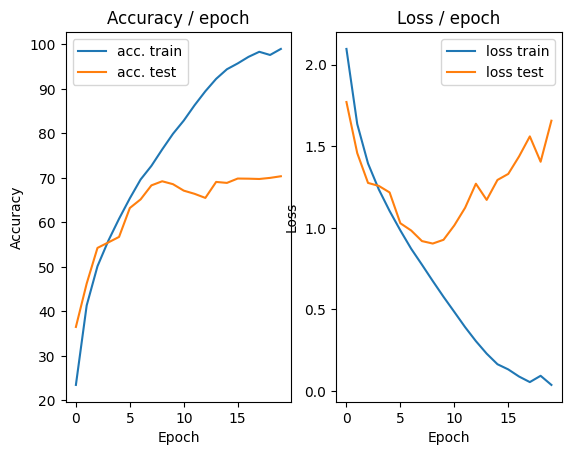

In [24]:
main_cifar(batch_size=128, epochs=20, cuda=True,)

### B = 32

=== EPOCH 1 =====

[TRAIN Batch 000/1563]	Time 0.097s (0.097s)	Loss 2.3027 (2.3027)	Prec@1   9.4 (  9.4)	Prec@5  46.9 ( 46.9)


<Figure size 640x480 with 0 Axes>

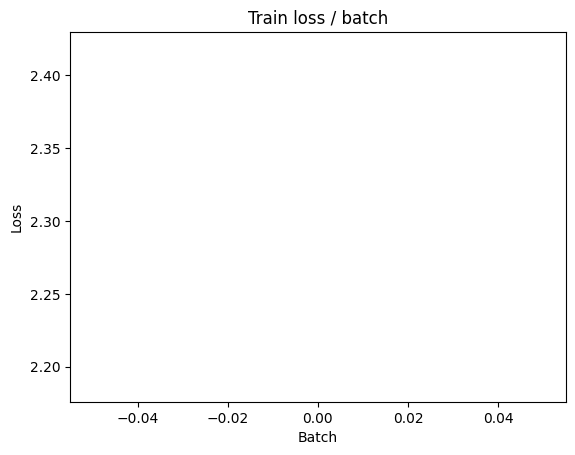

[TRAIN Batch 200/1563]	Time 0.007s (0.008s)	Loss 2.0961 (2.2614)	Prec@1  21.9 ( 14.6)	Prec@5  71.9 ( 60.3)


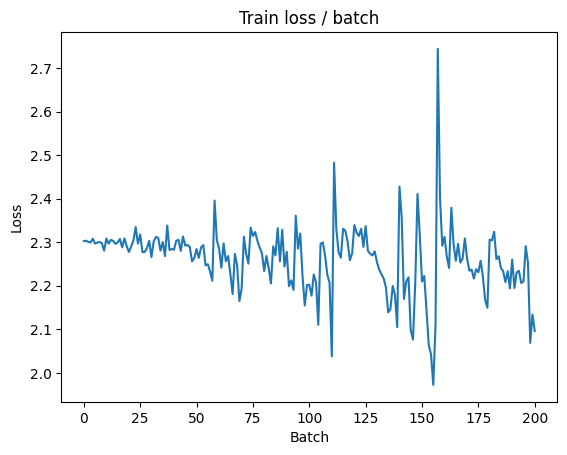

[TRAIN Batch 400/1563]	Time 0.012s (0.008s)	Loss 1.9282 (2.2098)	Prec@1  34.4 ( 17.8)	Prec@5  87.5 ( 65.4)


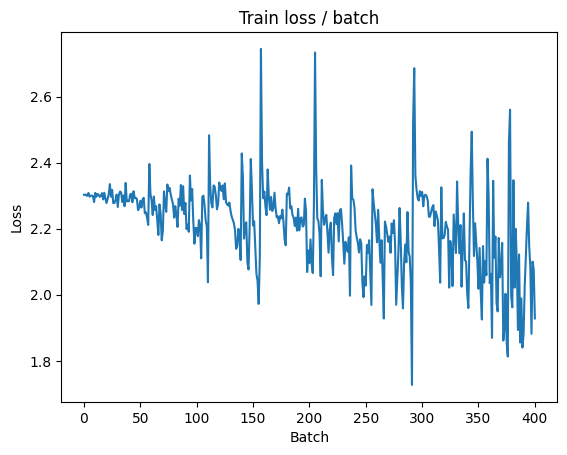

[TRAIN Batch 600/1563]	Time 0.013s (0.008s)	Loss 1.8111 (2.1227)	Prec@1  21.9 ( 21.5)	Prec@5  93.8 ( 70.6)


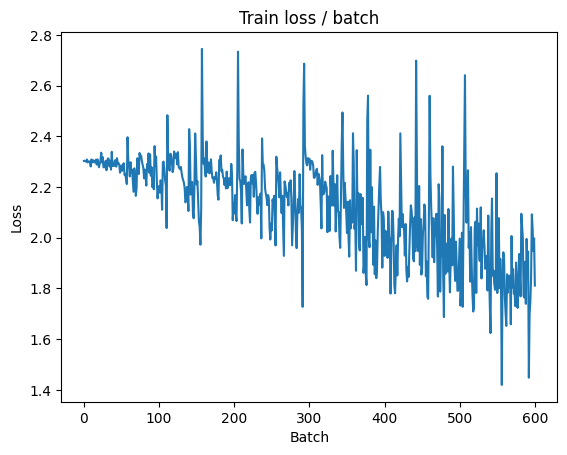

[TRAIN Batch 800/1563]	Time 0.013s (0.009s)	Loss 1.6368 (2.0350)	Prec@1  40.6 ( 24.7)	Prec@5  96.9 ( 74.7)


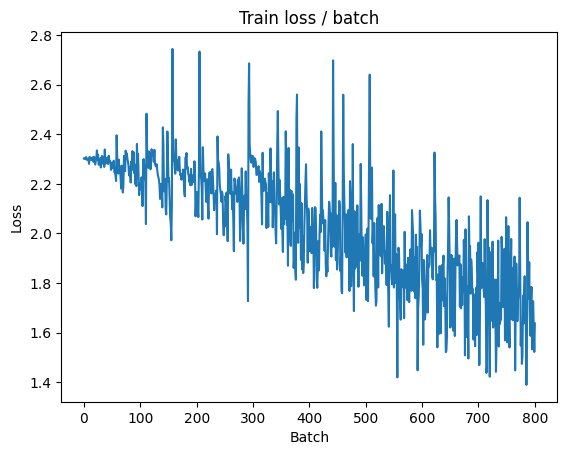

[TRAIN Batch 1000/1563]	Time 0.009s (0.009s)	Loss 1.6627 (1.9609)	Prec@1  43.8 ( 27.7)	Prec@5  87.5 ( 77.5)


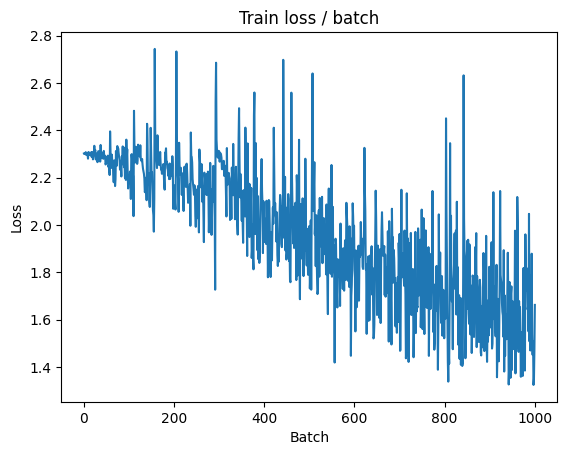

[TRAIN Batch 1200/1563]	Time 0.016s (0.009s)	Loss 1.2708 (1.8935)	Prec@1  56.2 ( 30.3)	Prec@5  93.8 ( 79.8)


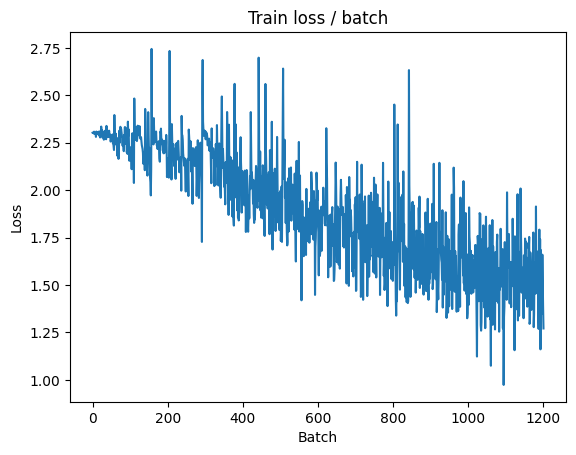

[TRAIN Batch 1400/1563]	Time 0.006s (0.009s)	Loss 1.5408 (1.8376)	Prec@1  43.8 ( 32.4)	Prec@5  90.6 ( 81.5)


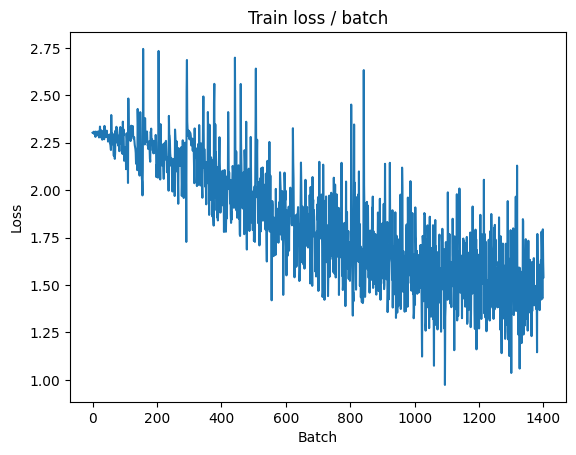


===============> Total time 13s	Avg loss 1.7998	Avg Prec@1 33.80 %	Avg Prec@5 82.62 %

[EVAL Batch 000/313]	Time 0.085s (0.085s)	Loss 1.2758 (1.2758)	Prec@1  53.1 ( 53.1)	Prec@5 100.0 (100.0)
[EVAL Batch 200/313]	Time 0.003s (0.007s)	Loss 1.3900 (1.3859)	Prec@1  43.8 ( 50.0)	Prec@5 100.0 ( 93.7)

===============> Total time 2s	Avg loss 1.3969	Avg Prec@1 49.49 %	Avg Prec@5 93.22 %



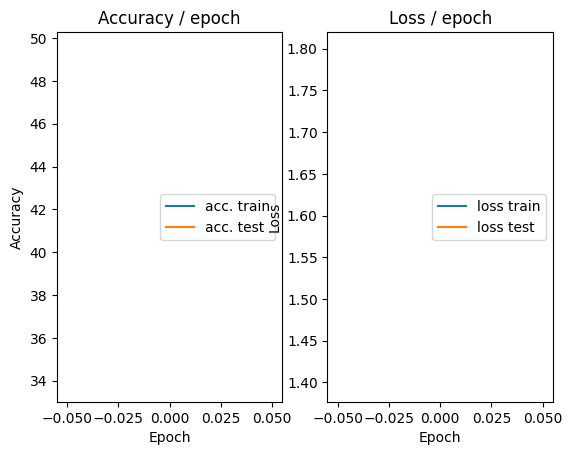

=== EPOCH 2 =====

[TRAIN Batch 000/1563]	Time 0.098s (0.098s)	Loss 1.4104 (1.4104)	Prec@1  53.1 ( 53.1)	Prec@5  90.6 ( 90.6)


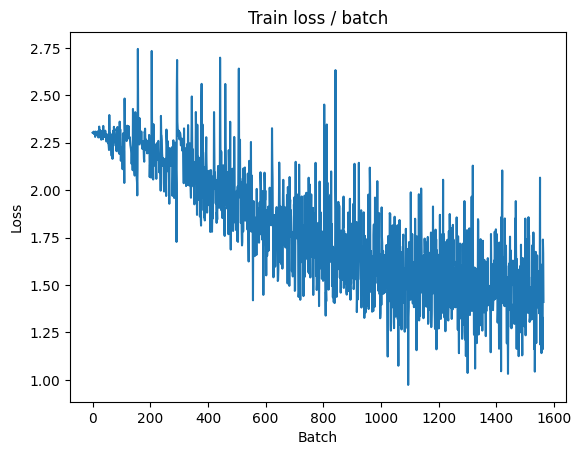

[TRAIN Batch 200/1563]	Time 0.008s (0.010s)	Loss 1.3679 (1.3784)	Prec@1  50.0 ( 50.5)	Prec@5  96.9 ( 93.4)


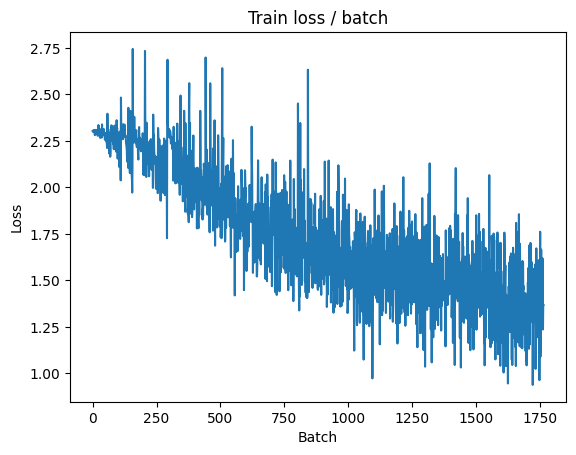

[TRAIN Batch 400/1563]	Time 0.004s (0.011s)	Loss 1.4812 (1.3724)	Prec@1  50.0 ( 50.7)	Prec@5  90.6 ( 93.5)


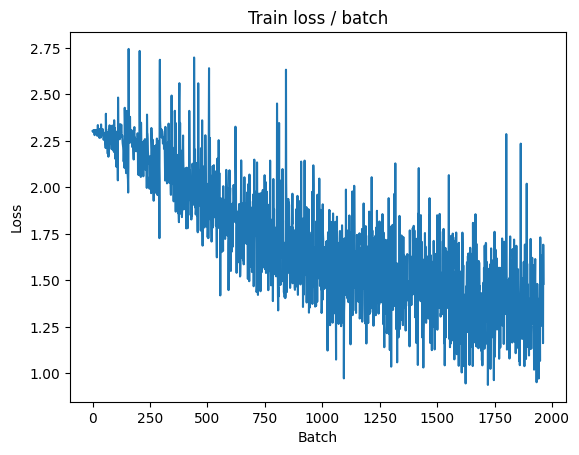

[TRAIN Batch 600/1563]	Time 0.015s (0.010s)	Loss 1.0028 (1.3483)	Prec@1  68.8 ( 52.0)	Prec@5  96.9 ( 93.7)


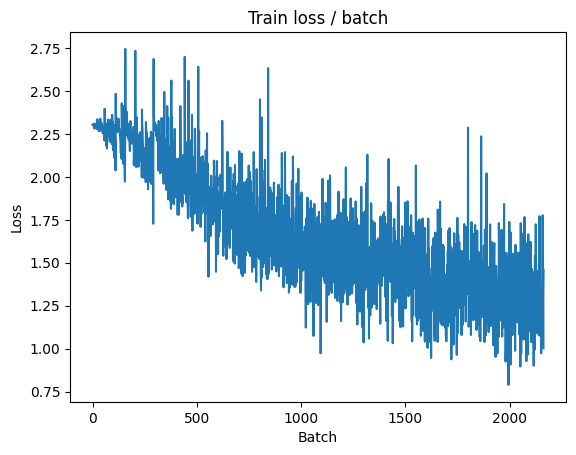

[TRAIN Batch 800/1563]	Time 0.008s (0.009s)	Loss 1.3599 (1.3327)	Prec@1  46.9 ( 52.5)	Prec@5  90.6 ( 93.9)


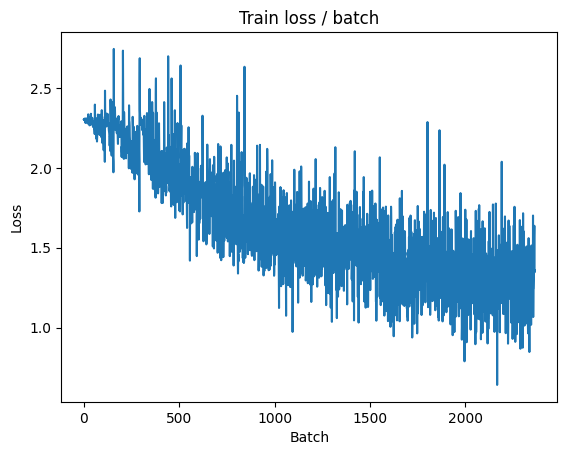

[TRAIN Batch 1000/1563]	Time 0.008s (0.009s)	Loss 1.2838 (1.3175)	Prec@1  56.2 ( 52.9)	Prec@5  96.9 ( 94.1)


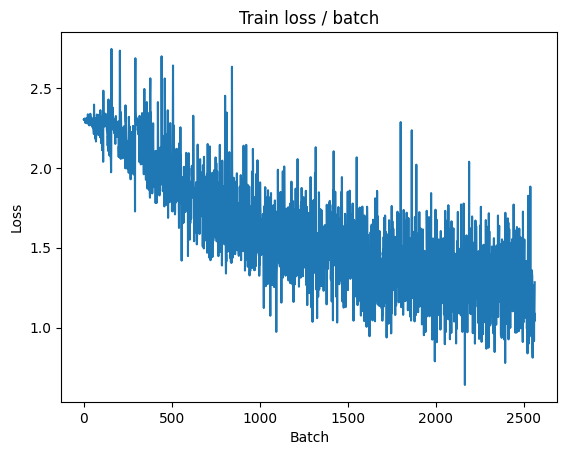

[TRAIN Batch 1200/1563]	Time 0.005s (0.009s)	Loss 1.1180 (1.2995)	Prec@1  62.5 ( 53.7)	Prec@5 100.0 ( 94.3)


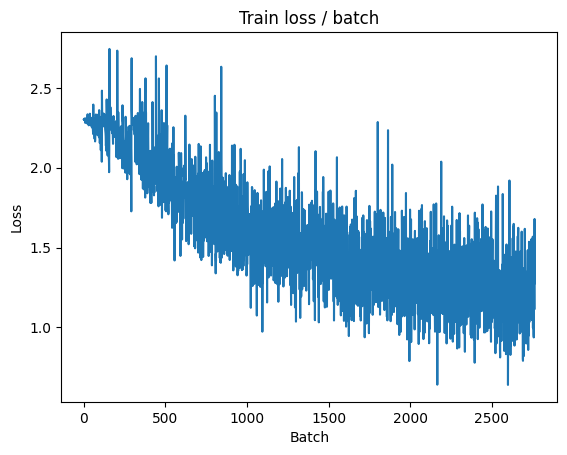

[TRAIN Batch 1400/1563]	Time 0.007s (0.009s)	Loss 1.2742 (1.2809)	Prec@1  50.0 ( 54.4)	Prec@5  93.8 ( 94.5)


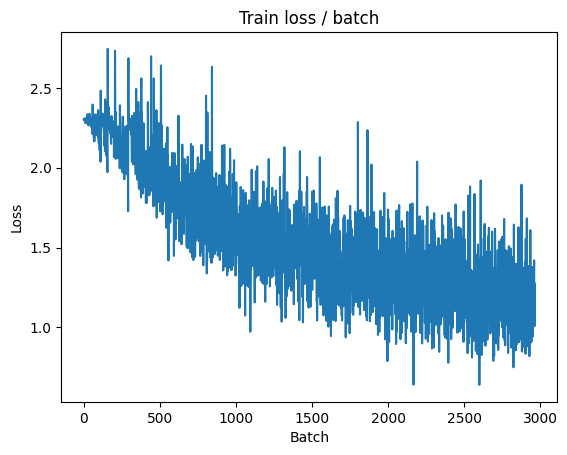


===============> Total time 13s	Avg loss 1.2646	Avg Prec@1 55.07 %	Avg Prec@5 94.64 %

[EVAL Batch 000/313]	Time 0.087s (0.087s)	Loss 1.0140 (1.0140)	Prec@1  62.5 ( 62.5)	Prec@5 100.0 (100.0)
[EVAL Batch 200/313]	Time 0.014s (0.010s)	Loss 1.4415 (1.2262)	Prec@1  34.4 ( 55.5)	Prec@5 100.0 ( 95.8)

===============> Total time 2s	Avg loss 1.2443	Avg Prec@1 55.25 %	Avg Prec@5 95.39 %



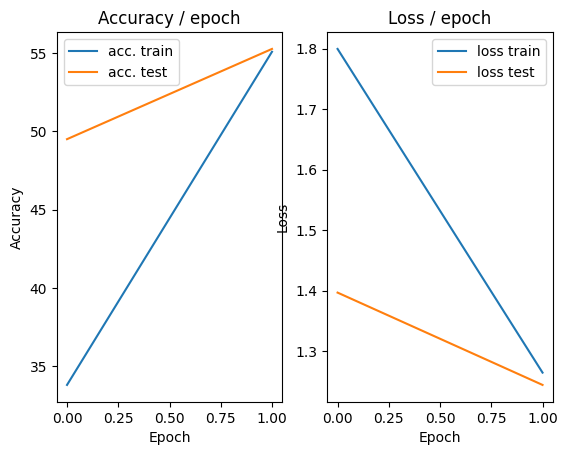

=== EPOCH 3 =====

[TRAIN Batch 000/1563]	Time 0.106s (0.106s)	Loss 1.5450 (1.5450)	Prec@1  56.2 ( 56.2)	Prec@5  90.6 ( 90.6)


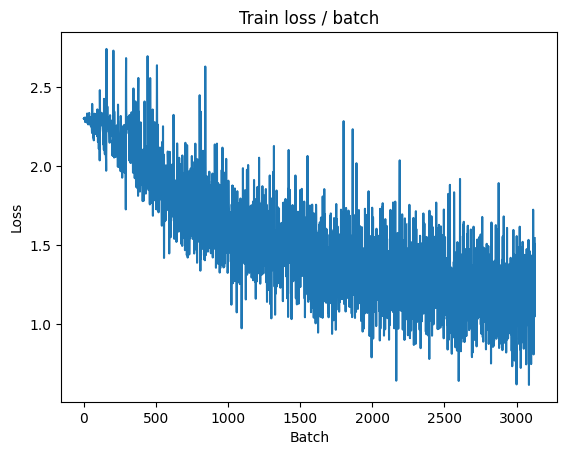

[TRAIN Batch 200/1563]	Time 0.009s (0.009s)	Loss 1.2211 (1.0648)	Prec@1  56.2 ( 62.6)	Prec@5  93.8 ( 96.4)


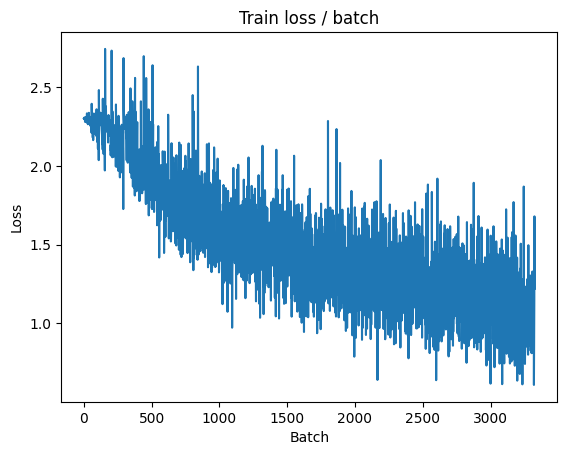

[TRAIN Batch 400/1563]	Time 0.005s (0.008s)	Loss 1.0569 (1.0601)	Prec@1  62.5 ( 62.4)	Prec@5  96.9 ( 96.4)


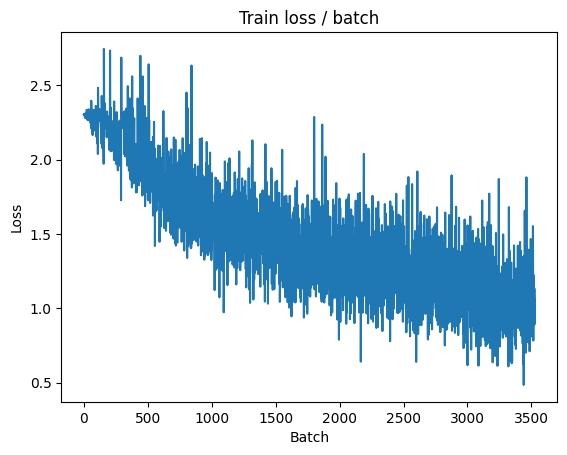

[TRAIN Batch 600/1563]	Time 0.009s (0.008s)	Loss 1.3781 (1.0425)	Prec@1  56.2 ( 63.2)	Prec@5  90.6 ( 96.4)


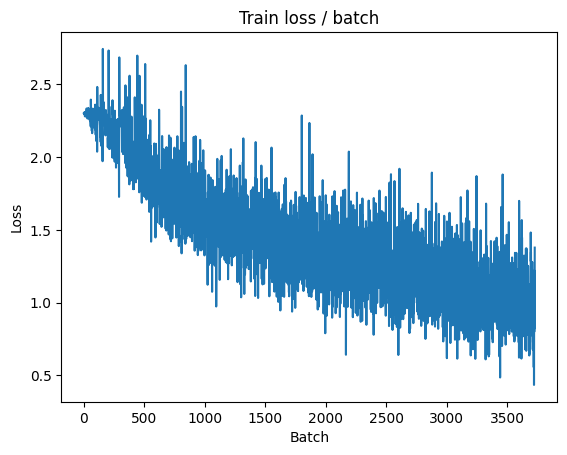

[TRAIN Batch 800/1563]	Time 0.005s (0.008s)	Loss 0.8381 (1.0361)	Prec@1  71.9 ( 63.4)	Prec@5  96.9 ( 96.4)


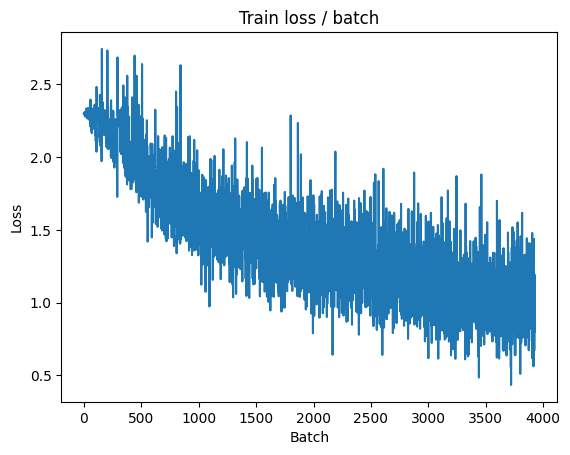

[TRAIN Batch 1000/1563]	Time 0.008s (0.008s)	Loss 1.1888 (1.0277)	Prec@1  53.1 ( 63.8)	Prec@5  96.9 ( 96.6)


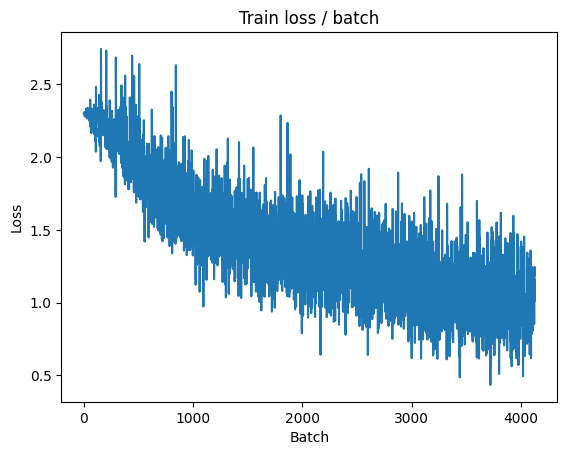

[TRAIN Batch 1200/1563]	Time 0.010s (0.009s)	Loss 0.9800 (1.0186)	Prec@1  62.5 ( 64.1)	Prec@5  96.9 ( 96.6)


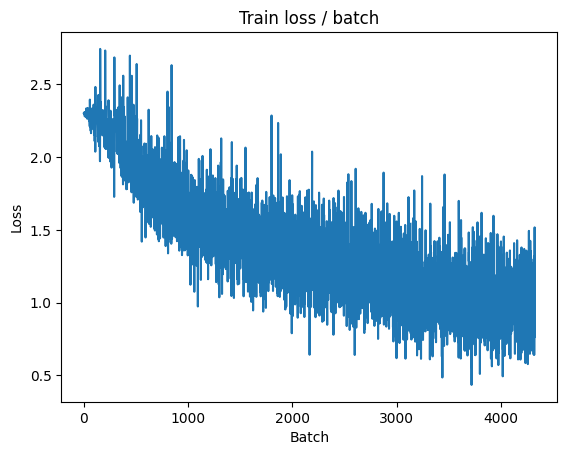

[TRAIN Batch 1400/1563]	Time 0.008s (0.009s)	Loss 0.9722 (1.0146)	Prec@1  71.9 ( 64.3)	Prec@5 100.0 ( 96.6)


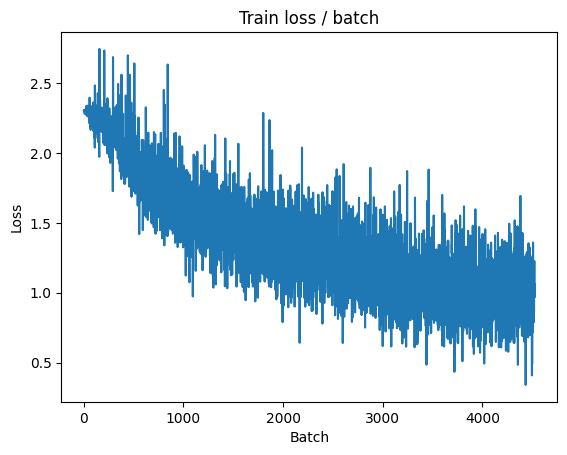


===============> Total time 13s	Avg loss 1.0089	Avg Prec@1 64.55 %	Avg Prec@5 96.68 %

[EVAL Batch 000/313]	Time 0.104s (0.104s)	Loss 0.8542 (0.8542)	Prec@1  75.0 ( 75.0)	Prec@5  96.9 ( 96.9)
[EVAL Batch 200/313]	Time 0.007s (0.007s)	Loss 1.2003 (1.1271)	Prec@1  68.8 ( 61.8)	Prec@5  96.9 ( 95.5)

===============> Total time 2s	Avg loss 1.1383	Avg Prec@1 61.03 %	Avg Prec@5 95.44 %



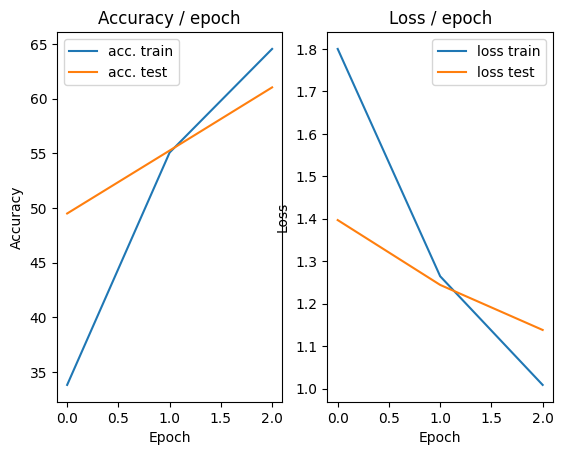

=== EPOCH 4 =====

[TRAIN Batch 000/1563]	Time 0.108s (0.108s)	Loss 0.7809 (0.7809)	Prec@1  71.9 ( 71.9)	Prec@5 100.0 (100.0)


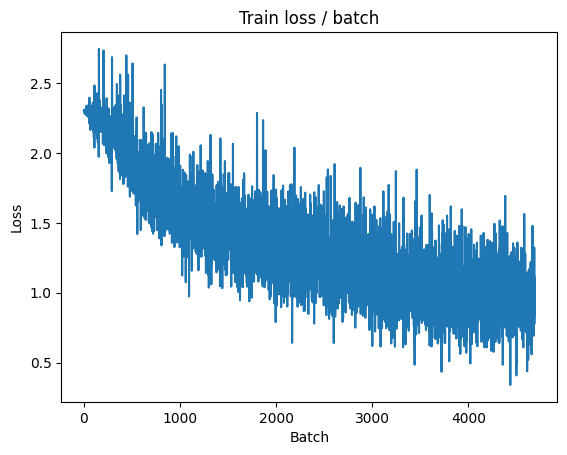

[TRAIN Batch 200/1563]	Time 0.004s (0.009s)	Loss 0.6311 (0.8189)	Prec@1  81.2 ( 71.3)	Prec@5 100.0 ( 98.1)


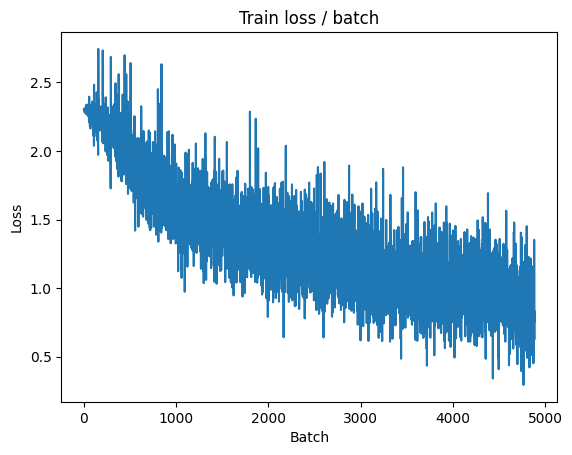

[TRAIN Batch 400/1563]	Time 0.005s (0.008s)	Loss 0.8015 (0.8265)	Prec@1  68.8 ( 71.2)	Prec@5 100.0 ( 98.0)


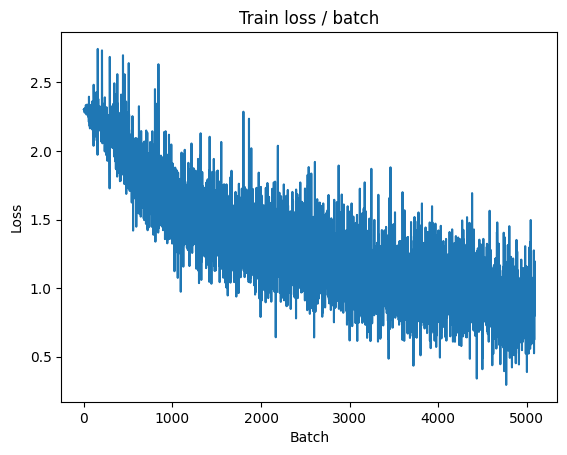

[TRAIN Batch 600/1563]	Time 0.006s (0.008s)	Loss 1.0786 (0.8300)	Prec@1  75.0 ( 70.9)	Prec@5  96.9 ( 97.9)


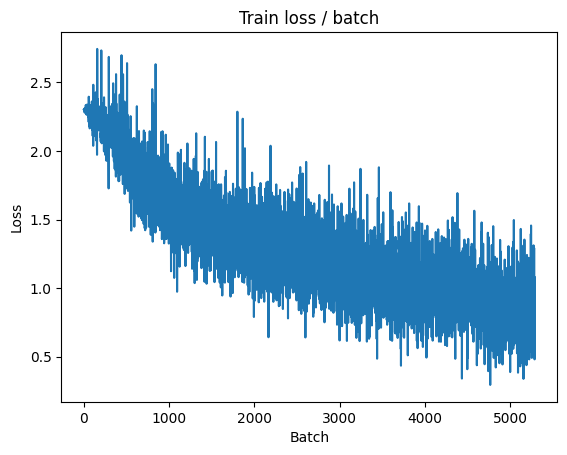

[TRAIN Batch 800/1563]	Time 0.009s (0.009s)	Loss 0.9963 (0.8269)	Prec@1  65.6 ( 70.9)	Prec@5 100.0 ( 97.9)


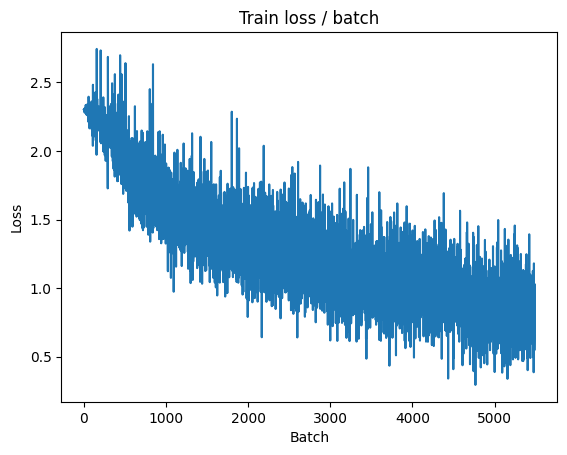

[TRAIN Batch 1000/1563]	Time 0.007s (0.009s)	Loss 0.8415 (0.8260)	Prec@1  65.6 ( 71.0)	Prec@5 100.0 ( 97.9)


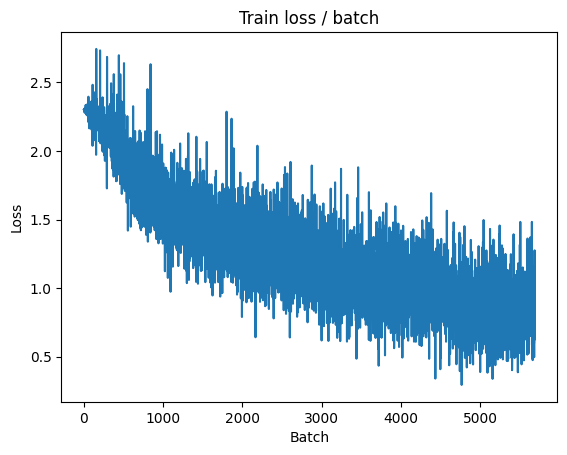

[TRAIN Batch 1200/1563]	Time 0.010s (0.009s)	Loss 1.1894 (0.8251)	Prec@1  65.6 ( 71.0)	Prec@5 100.0 ( 97.9)


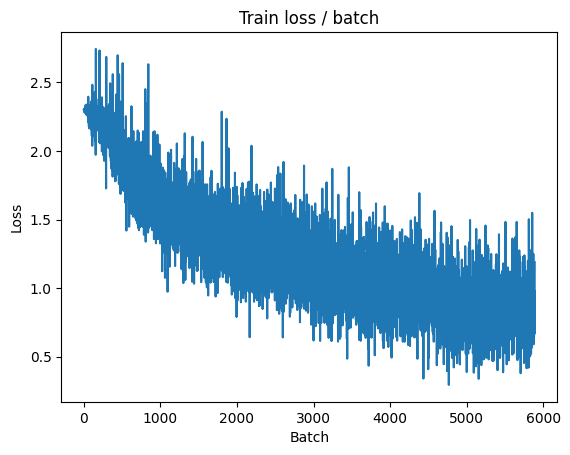

[TRAIN Batch 1400/1563]	Time 0.008s (0.009s)	Loss 0.9713 (0.8265)	Prec@1  62.5 ( 71.0)	Prec@5  96.9 ( 97.9)


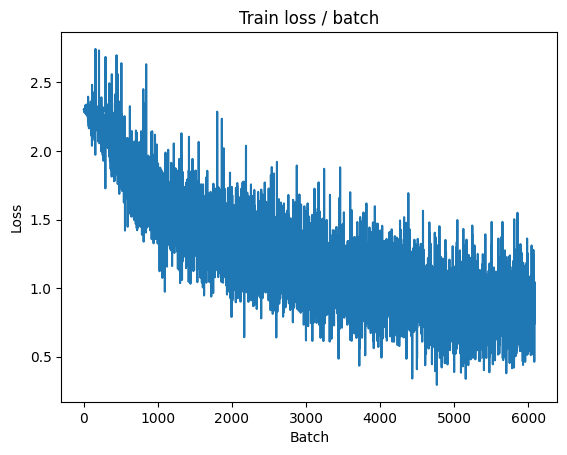


===============> Total time 13s	Avg loss 0.8252	Avg Prec@1 71.06 %	Avg Prec@5 97.79 %

[EVAL Batch 000/313]	Time 0.092s (0.092s)	Loss 0.9905 (0.9905)	Prec@1  62.5 ( 62.5)	Prec@5 100.0 (100.0)
[EVAL Batch 200/313]	Time 0.007s (0.007s)	Loss 0.8491 (0.9941)	Prec@1  71.9 ( 65.7)	Prec@5 100.0 ( 97.4)

===============> Total time 2s	Avg loss 1.0005	Avg Prec@1 65.39 %	Avg Prec@5 97.28 %



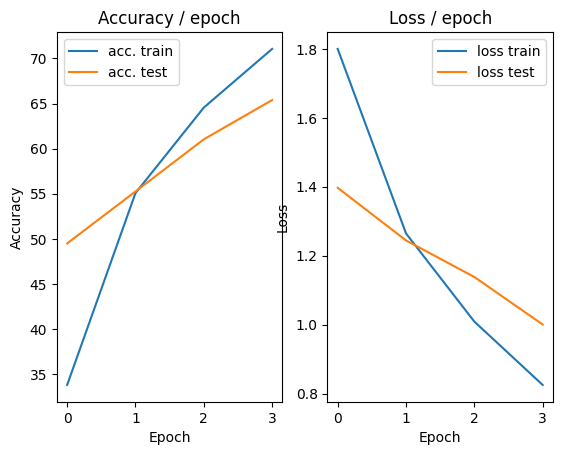

=== EPOCH 5 =====

[TRAIN Batch 000/1563]	Time 0.111s (0.111s)	Loss 0.9223 (0.9223)	Prec@1  62.5 ( 62.5)	Prec@5  96.9 ( 96.9)


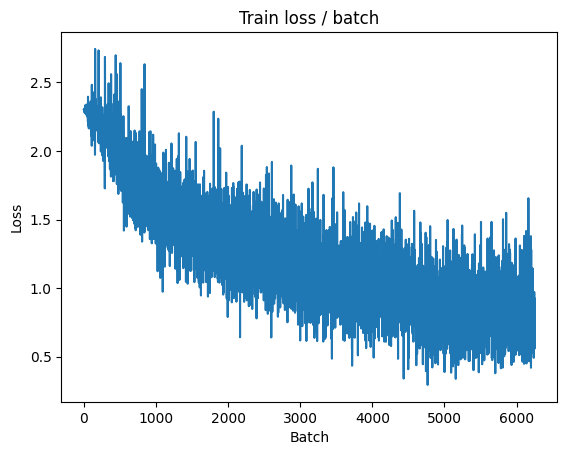

[TRAIN Batch 200/1563]	Time 0.005s (0.009s)	Loss 0.7010 (0.6566)	Prec@1  81.2 ( 76.8)	Prec@5  93.8 ( 98.7)


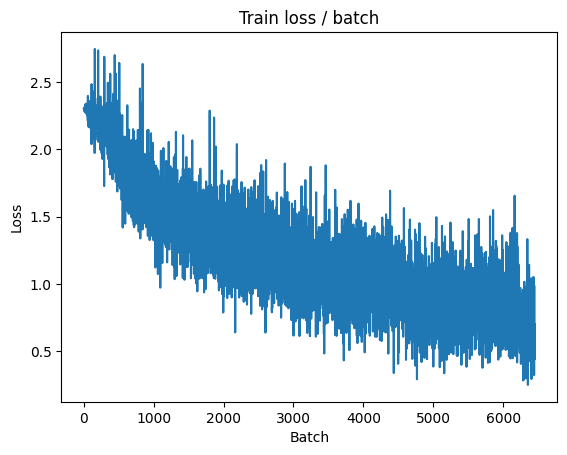

[TRAIN Batch 400/1563]	Time 0.009s (0.011s)	Loss 0.5569 (0.6549)	Prec@1  75.0 ( 76.8)	Prec@5 100.0 ( 98.8)


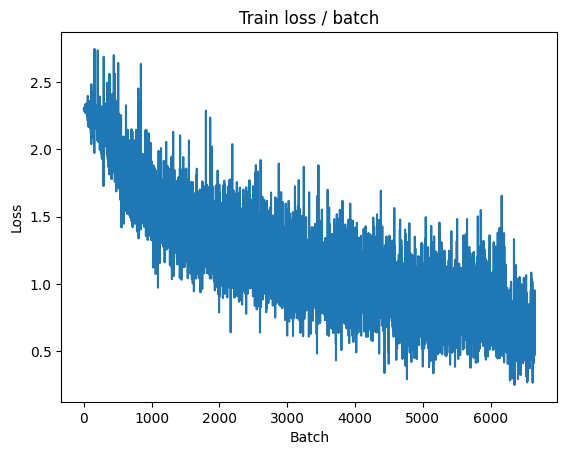

[TRAIN Batch 600/1563]	Time 0.012s (0.010s)	Loss 0.7639 (0.6590)	Prec@1  71.9 ( 76.5)	Prec@5 100.0 ( 98.8)


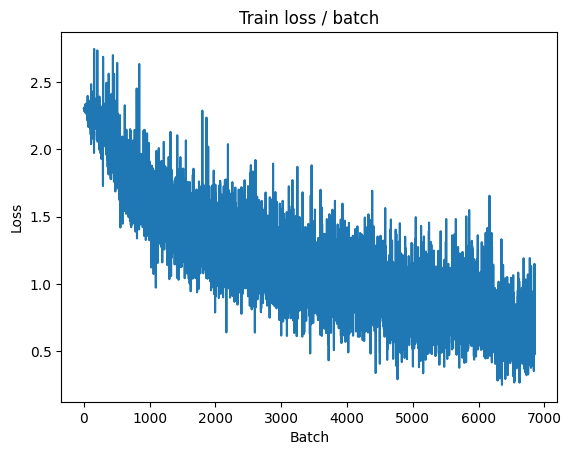

[TRAIN Batch 800/1563]	Time 0.009s (0.009s)	Loss 0.4585 (0.6602)	Prec@1  87.5 ( 76.5)	Prec@5 100.0 ( 98.9)


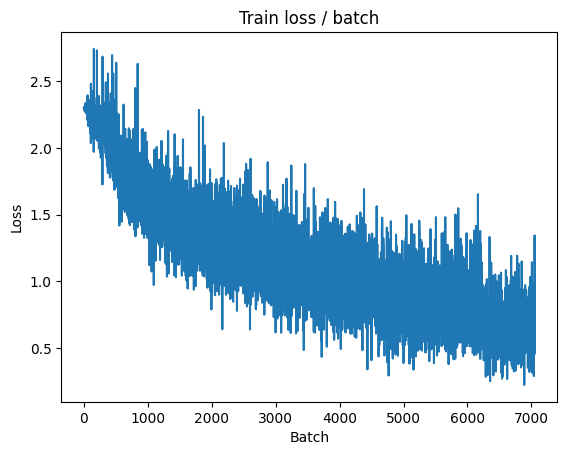

[TRAIN Batch 1000/1563]	Time 0.005s (0.009s)	Loss 0.8337 (0.6662)	Prec@1  62.5 ( 76.4)	Prec@5 100.0 ( 98.9)


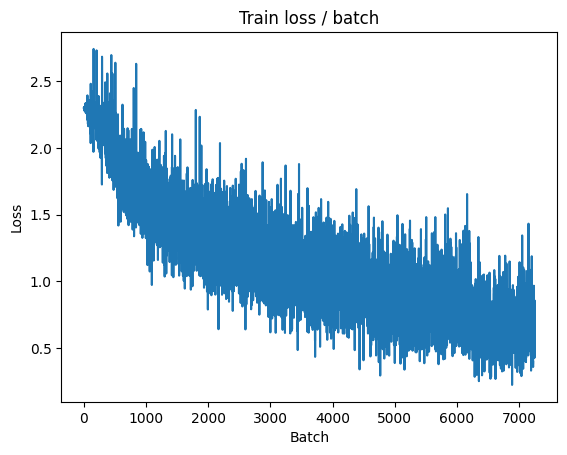

[TRAIN Batch 1200/1563]	Time 0.004s (0.009s)	Loss 0.6343 (0.6720)	Prec@1  68.8 ( 76.2)	Prec@5 100.0 ( 98.8)


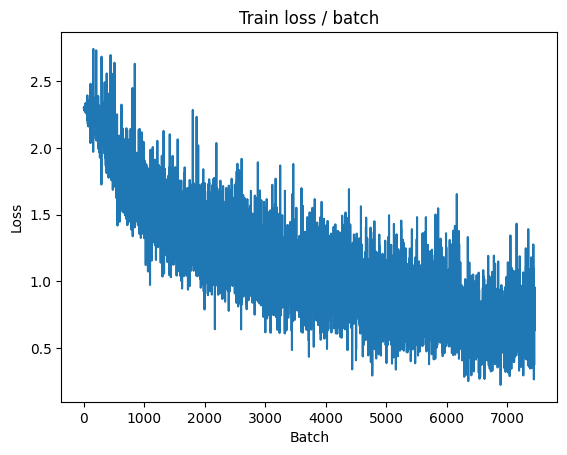

[TRAIN Batch 1400/1563]	Time 0.004s (0.009s)	Loss 1.0049 (0.6775)	Prec@1  68.8 ( 76.1)	Prec@5 100.0 ( 98.8)


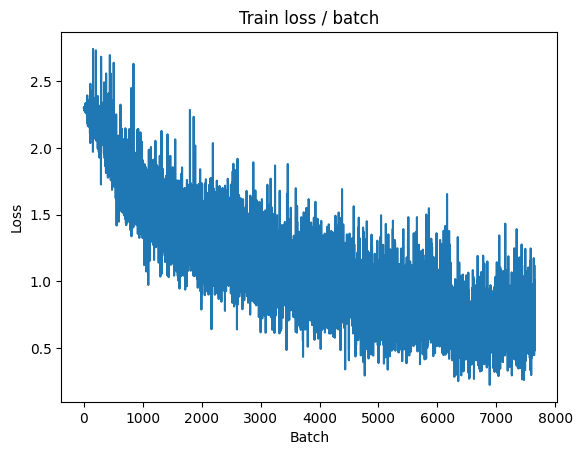


===============> Total time 13s	Avg loss 0.6806	Avg Prec@1 75.96 %	Avg Prec@5 98.79 %

[EVAL Batch 000/313]	Time 0.088s (0.088s)	Loss 0.6224 (0.6224)	Prec@1  81.2 ( 81.2)	Prec@5 100.0 (100.0)
[EVAL Batch 200/313]	Time 0.006s (0.009s)	Loss 1.2139 (0.9123)	Prec@1  68.8 ( 69.7)	Prec@5 100.0 ( 97.4)

===============> Total time 2s	Avg loss 0.9228	Avg Prec@1 69.43 %	Avg Prec@5 97.17 %



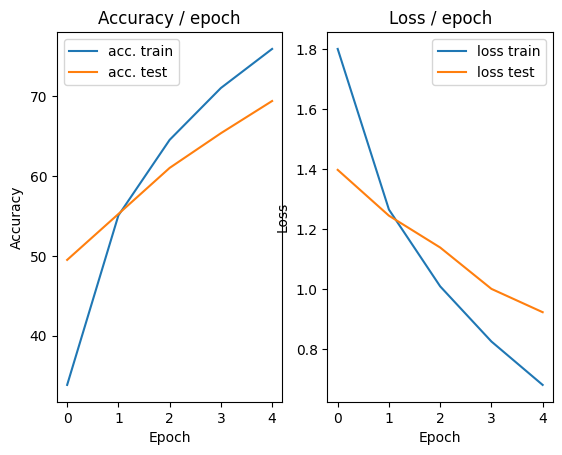

=== EPOCH 6 =====

[TRAIN Batch 000/1563]	Time 0.137s (0.137s)	Loss 0.4773 (0.4773)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)


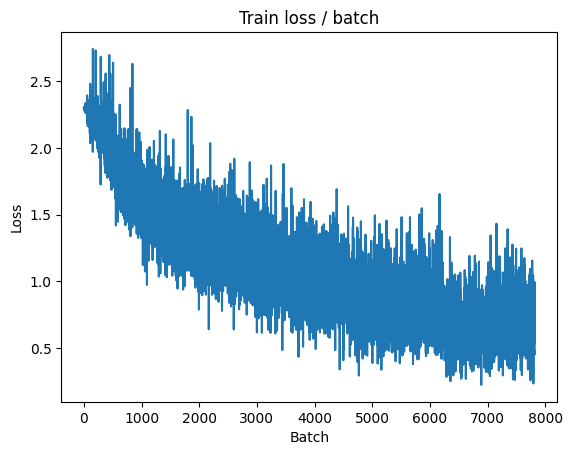

[TRAIN Batch 200/1563]	Time 0.008s (0.009s)	Loss 0.5401 (0.4830)	Prec@1  84.4 ( 83.2)	Prec@5 100.0 ( 99.4)


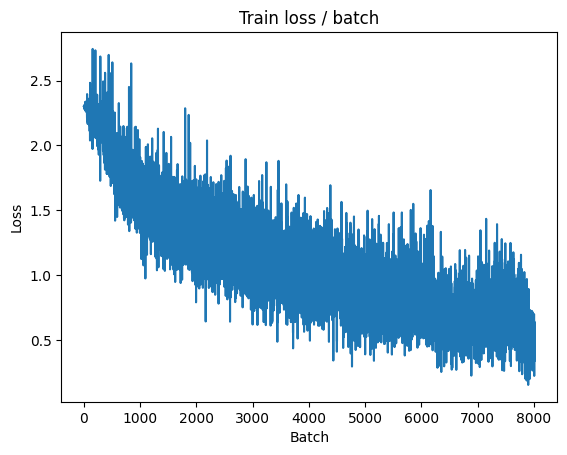

[TRAIN Batch 400/1563]	Time 0.004s (0.009s)	Loss 0.6193 (0.5181)	Prec@1  81.2 ( 81.8)	Prec@5 100.0 ( 99.4)


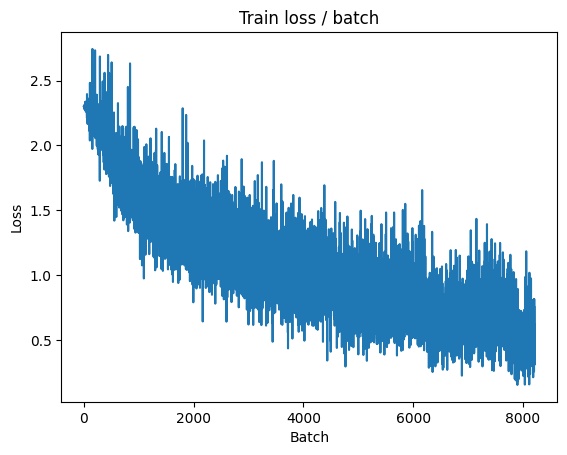

[TRAIN Batch 600/1563]	Time 0.007s (0.009s)	Loss 0.1549 (0.5212)	Prec@1  96.9 ( 81.8)	Prec@5 100.0 ( 99.3)


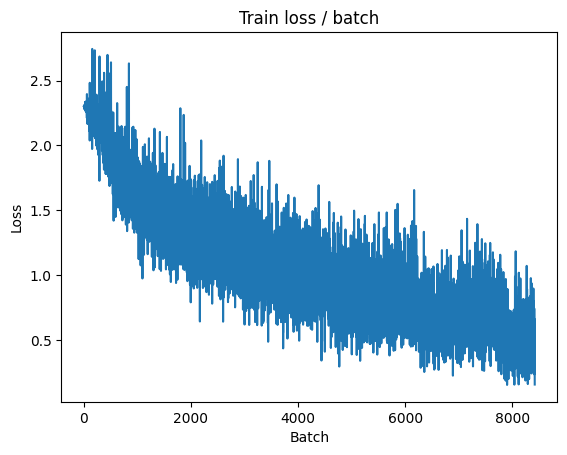

[TRAIN Batch 800/1563]	Time 0.009s (0.009s)	Loss 0.5511 (0.5254)	Prec@1  75.0 ( 81.6)	Prec@5 100.0 ( 99.3)


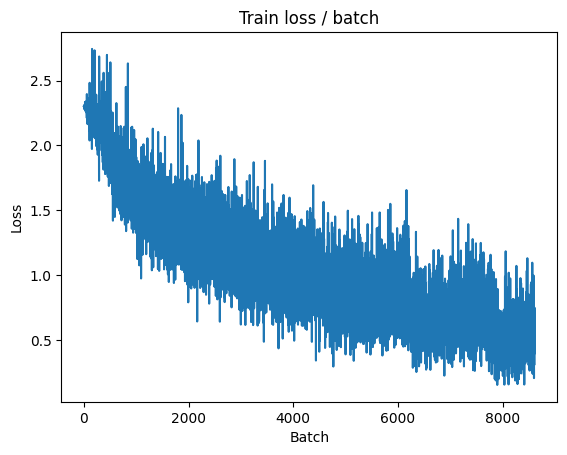

[TRAIN Batch 1000/1563]	Time 0.006s (0.009s)	Loss 0.5878 (0.5336)	Prec@1  71.9 ( 81.2)	Prec@5 100.0 ( 99.3)


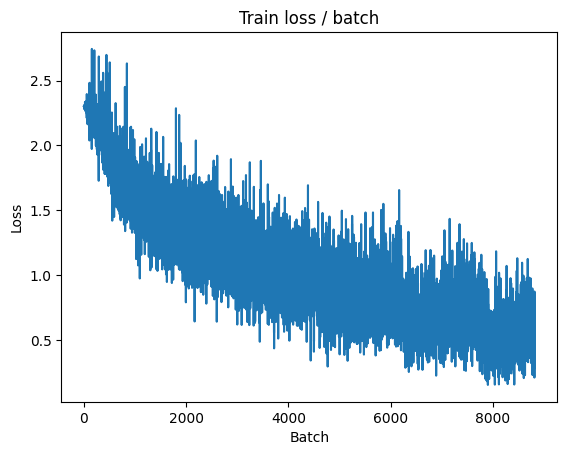

[TRAIN Batch 1200/1563]	Time 0.009s (0.009s)	Loss 0.5189 (0.5387)	Prec@1  81.2 ( 80.9)	Prec@5 100.0 ( 99.3)


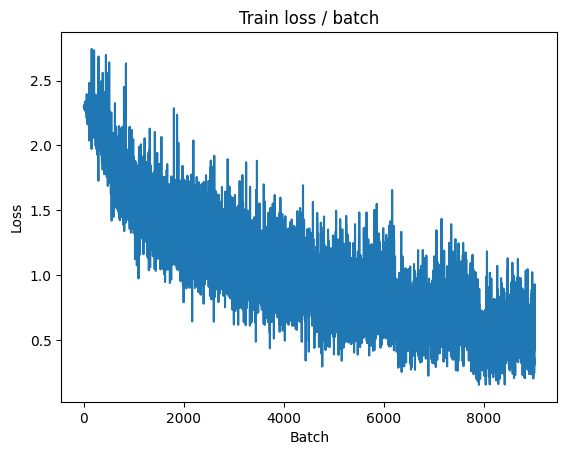

[TRAIN Batch 1400/1563]	Time 0.005s (0.009s)	Loss 0.6011 (0.5472)	Prec@1  81.2 ( 80.6)	Prec@5 100.0 ( 99.3)


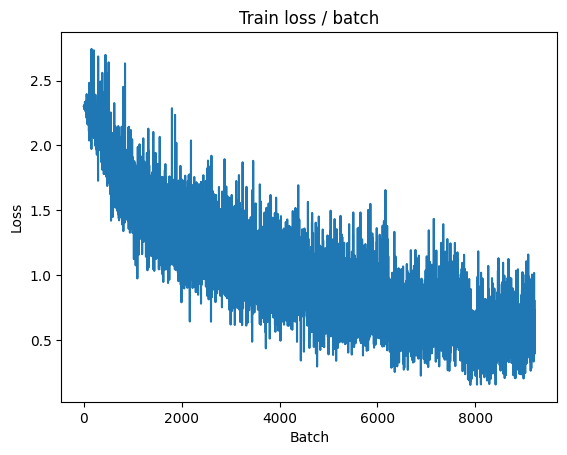


===============> Total time 14s	Avg loss 0.5509	Avg Prec@1 80.46 %	Avg Prec@5 99.31 %

[EVAL Batch 000/313]	Time 0.094s (0.094s)	Loss 0.6434 (0.6434)	Prec@1  68.8 ( 68.8)	Prec@5 100.0 (100.0)
[EVAL Batch 200/313]	Time 0.003s (0.007s)	Loss 0.9706 (0.9536)	Prec@1  75.0 ( 67.6)	Prec@5 100.0 ( 97.2)

===============> Total time 2s	Avg loss 0.9581	Avg Prec@1 67.77 %	Avg Prec@5 97.03 %



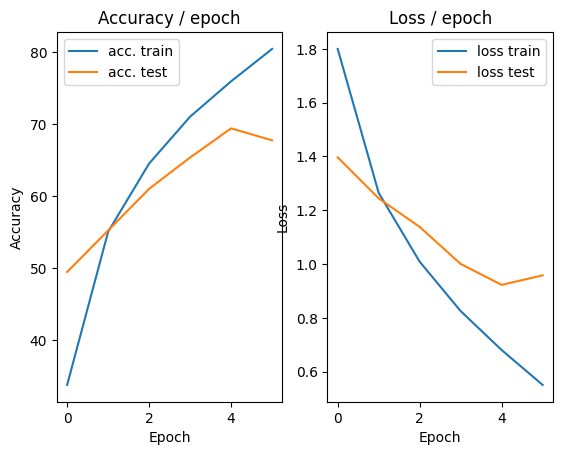

=== EPOCH 7 =====

[TRAIN Batch 000/1563]	Time 0.125s (0.125s)	Loss 0.4420 (0.4420)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


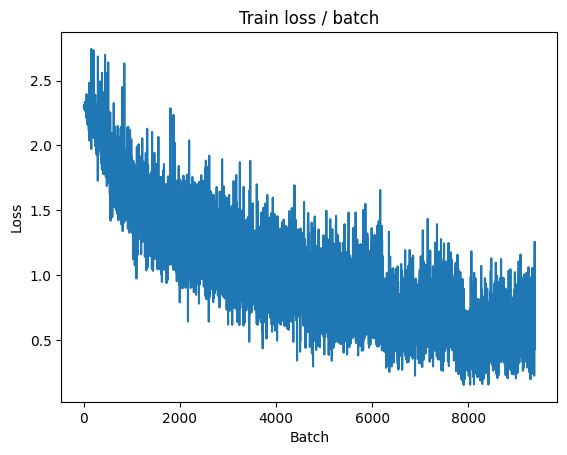

[TRAIN Batch 200/1563]	Time 0.004s (0.009s)	Loss 0.3512 (0.3821)	Prec@1  84.4 ( 86.4)	Prec@5 100.0 ( 99.7)


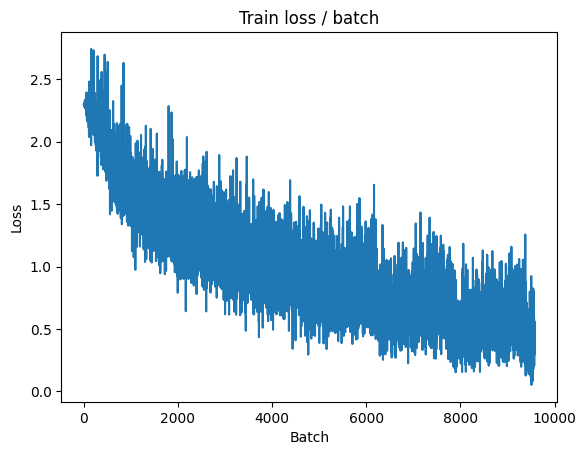

[TRAIN Batch 400/1563]	Time 0.007s (0.009s)	Loss 0.5359 (0.3912)	Prec@1  81.2 ( 86.1)	Prec@5 100.0 ( 99.6)


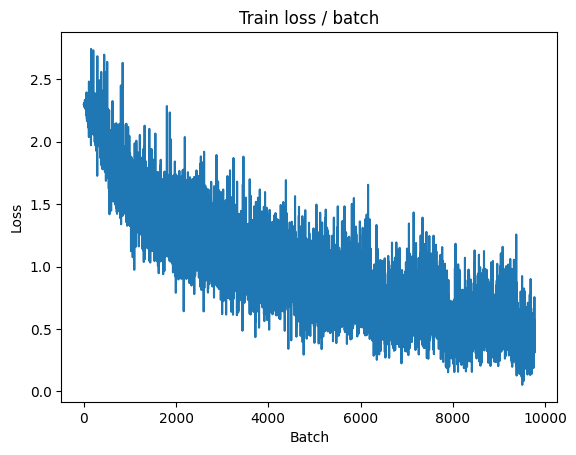

[TRAIN Batch 600/1563]	Time 0.012s (0.009s)	Loss 0.2740 (0.4033)	Prec@1  93.8 ( 85.8)	Prec@5 100.0 ( 99.6)


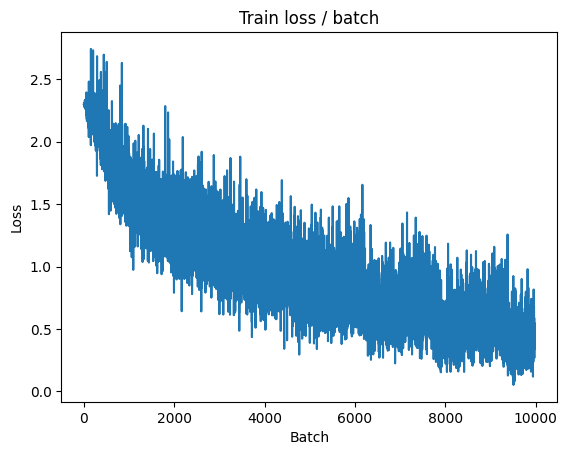

[TRAIN Batch 800/1563]	Time 0.009s (0.010s)	Loss 0.8639 (0.4179)	Prec@1  75.0 ( 85.2)	Prec@5 100.0 ( 99.6)


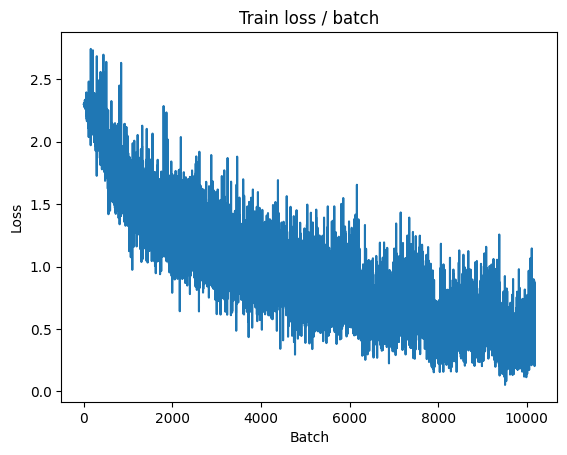

[TRAIN Batch 1000/1563]	Time 0.010s (0.009s)	Loss 0.5859 (0.4256)	Prec@1  78.1 ( 84.9)	Prec@5 100.0 ( 99.6)


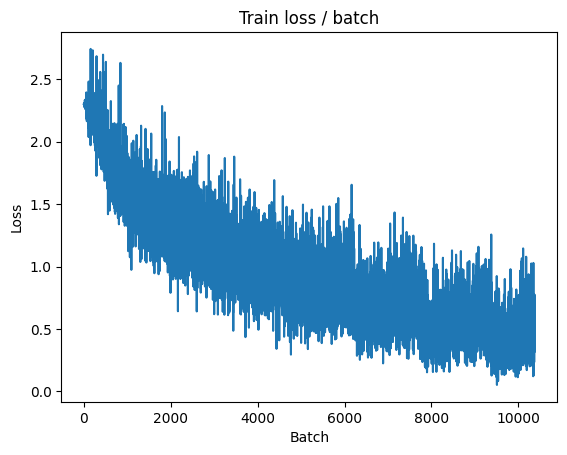

[TRAIN Batch 1200/1563]	Time 0.004s (0.009s)	Loss 0.6059 (0.4338)	Prec@1  75.0 ( 84.6)	Prec@5 100.0 ( 99.6)


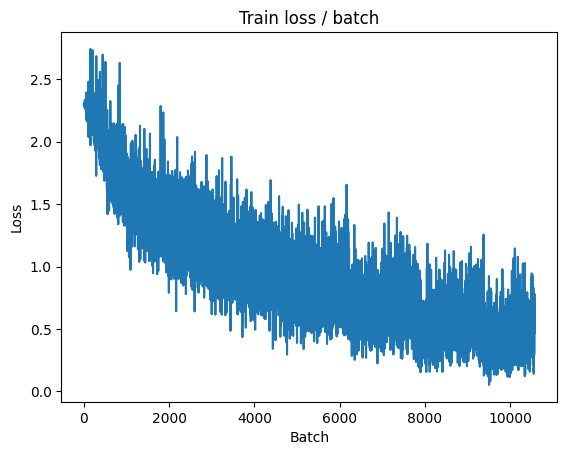

[TRAIN Batch 1400/1563]	Time 0.006s (0.009s)	Loss 0.3542 (0.4385)	Prec@1  87.5 ( 84.5)	Prec@5 100.0 ( 99.6)


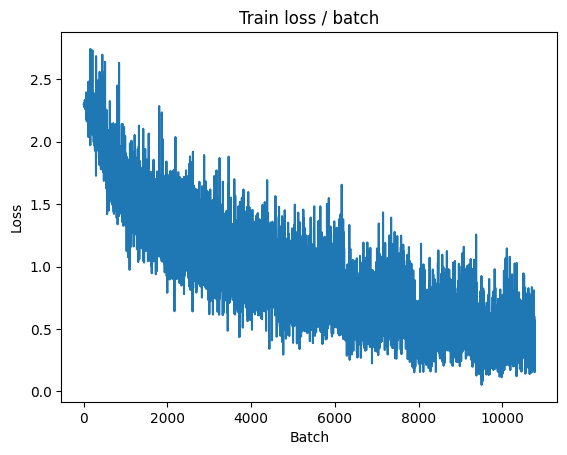


===============> Total time 14s	Avg loss 0.4474	Avg Prec@1 84.26 %	Avg Prec@5 99.56 %

[EVAL Batch 000/313]	Time 0.096s (0.096s)	Loss 1.0214 (1.0214)	Prec@1  62.5 ( 62.5)	Prec@5 100.0 (100.0)
[EVAL Batch 200/313]	Time 0.004s (0.007s)	Loss 1.0212 (0.9569)	Prec@1  75.0 ( 70.8)	Prec@5 100.0 ( 97.4)

===============> Total time 2s	Avg loss 0.9738	Avg Prec@1 70.57 %	Avg Prec@5 97.15 %



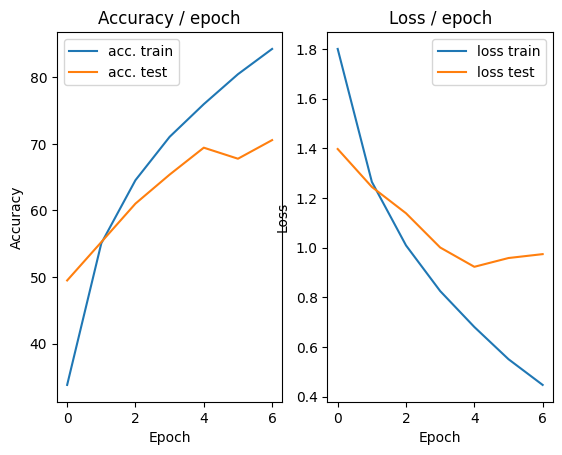

=== EPOCH 8 =====

[TRAIN Batch 000/1563]	Time 0.155s (0.155s)	Loss 0.2933 (0.2933)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


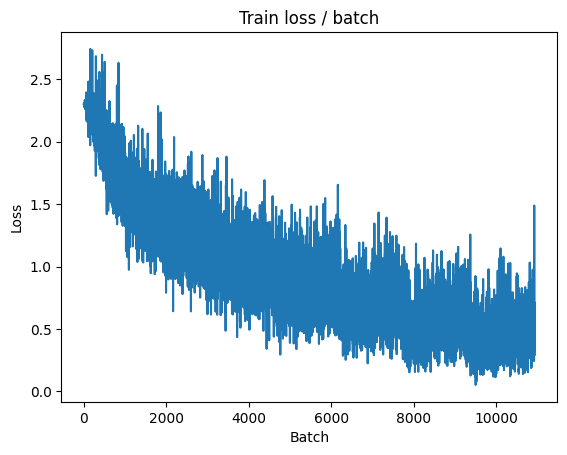

[TRAIN Batch 200/1563]	Time 0.009s (0.011s)	Loss 0.1827 (0.2679)	Prec@1  96.9 ( 90.4)	Prec@5 100.0 ( 99.9)


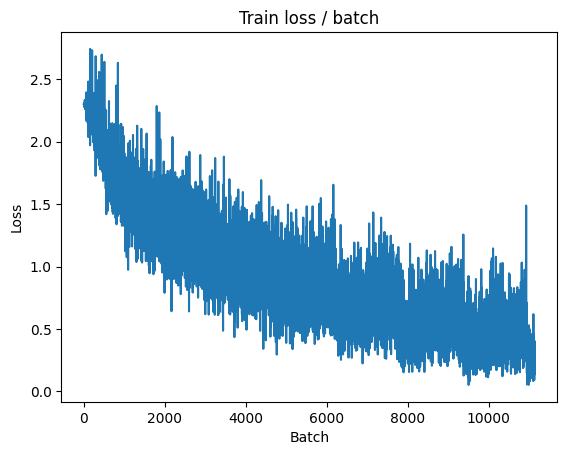

[TRAIN Batch 400/1563]	Time 0.011s (0.011s)	Loss 0.2924 (0.2871)	Prec@1  90.6 ( 89.7)	Prec@5 100.0 ( 99.9)


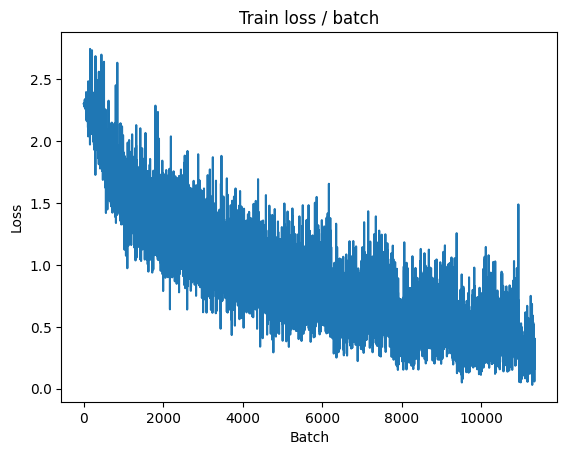

[TRAIN Batch 600/1563]	Time 0.005s (0.010s)	Loss 0.3024 (0.3063)	Prec@1  90.6 ( 89.1)	Prec@5 100.0 ( 99.9)


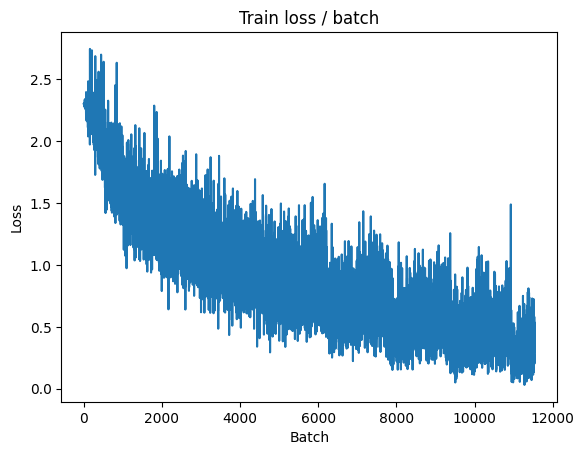

[TRAIN Batch 800/1563]	Time 0.005s (0.010s)	Loss 0.1111 (0.3246)	Prec@1  96.9 ( 88.5)	Prec@5 100.0 ( 99.8)


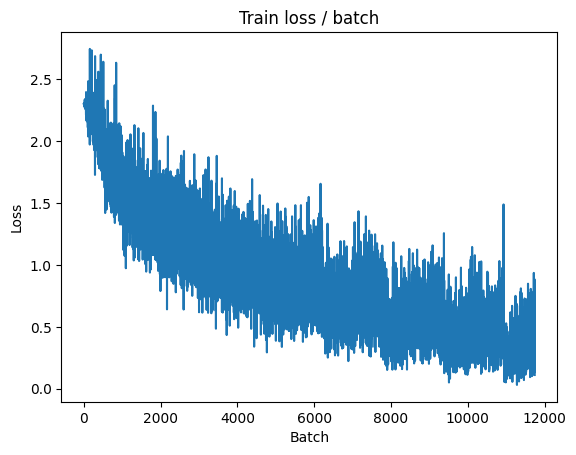

[TRAIN Batch 1000/1563]	Time 0.012s (0.009s)	Loss 0.7089 (0.3421)	Prec@1  75.0 ( 87.9)	Prec@5 100.0 ( 99.8)


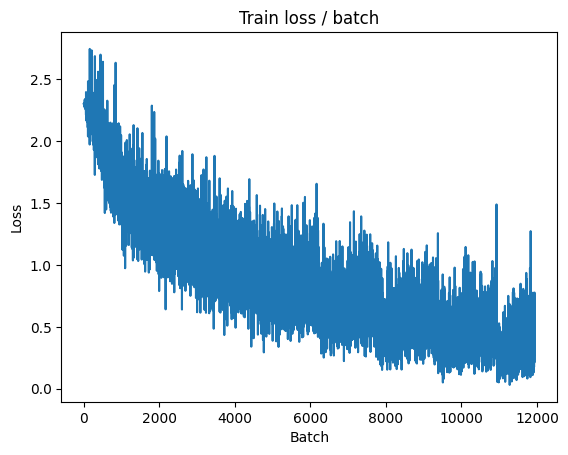

[TRAIN Batch 1200/1563]	Time 0.009s (0.009s)	Loss 0.2110 (0.3544)	Prec@1  90.6 ( 87.4)	Prec@5 100.0 ( 99.8)


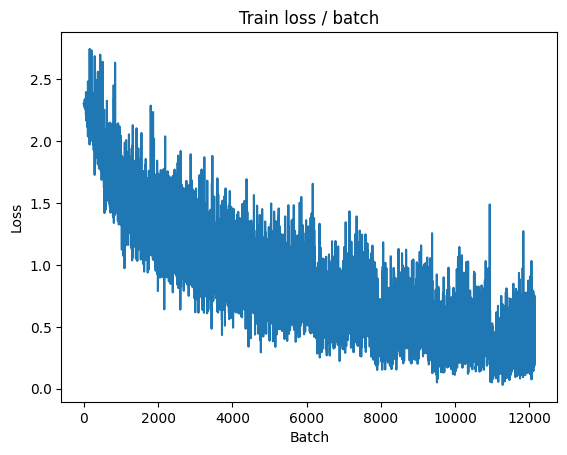

[TRAIN Batch 1400/1563]	Time 0.006s (0.009s)	Loss 0.4997 (0.3629)	Prec@1  81.2 ( 87.1)	Prec@5 100.0 ( 99.8)


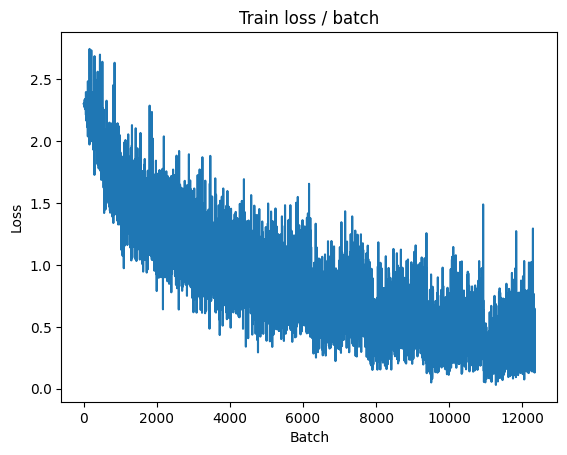


===============> Total time 14s	Avg loss 0.3733	Avg Prec@1 86.79 %	Avg Prec@5 99.76 %

[EVAL Batch 000/313]	Time 0.157s (0.157s)	Loss 0.8394 (0.8394)	Prec@1  81.2 ( 81.2)	Prec@5 100.0 (100.0)
[EVAL Batch 200/313]	Time 0.005s (0.009s)	Loss 1.0410 (1.0645)	Prec@1  75.0 ( 69.9)	Prec@5 100.0 ( 97.2)

===============> Total time 2s	Avg loss 1.0797	Avg Prec@1 69.72 %	Avg Prec@5 97.07 %



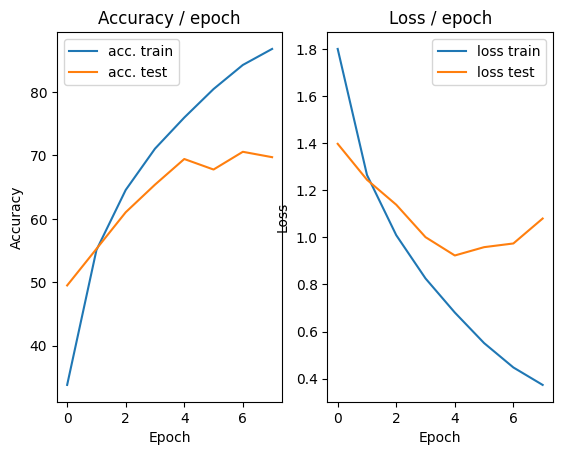

=== EPOCH 9 =====

[TRAIN Batch 000/1563]	Time 0.145s (0.145s)	Loss 0.1375 (0.1375)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


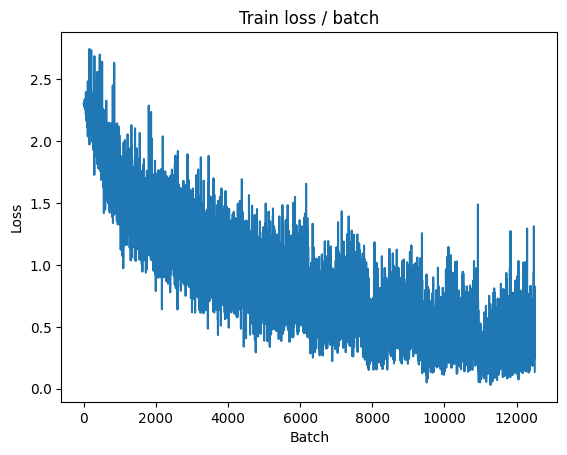

[TRAIN Batch 200/1563]	Time 0.007s (0.009s)	Loss 0.2135 (0.2232)	Prec@1  93.8 ( 92.3)	Prec@5 100.0 ( 99.9)


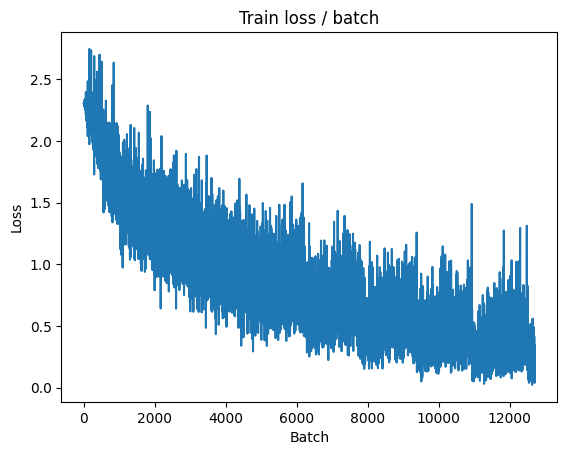

[TRAIN Batch 400/1563]	Time 0.008s (0.009s)	Loss 0.1671 (0.2415)	Prec@1  96.9 ( 91.6)	Prec@5 100.0 ( 99.9)


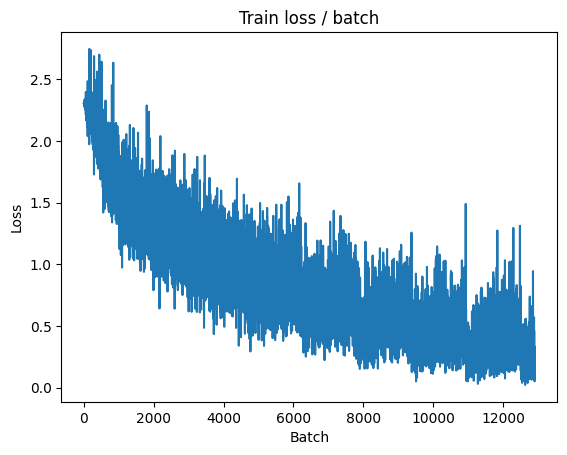

[TRAIN Batch 600/1563]	Time 0.004s (0.009s)	Loss 0.3049 (0.2679)	Prec@1  87.5 ( 90.7)	Prec@5 100.0 ( 99.9)


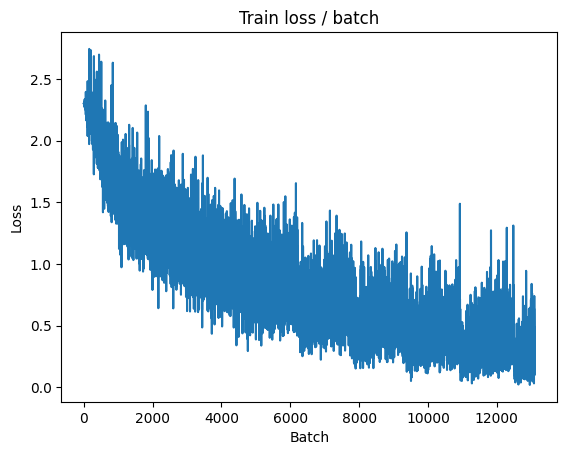

[TRAIN Batch 800/1563]	Time 0.013s (0.009s)	Loss 0.4369 (0.2754)	Prec@1  81.2 ( 90.3)	Prec@5 100.0 ( 99.9)


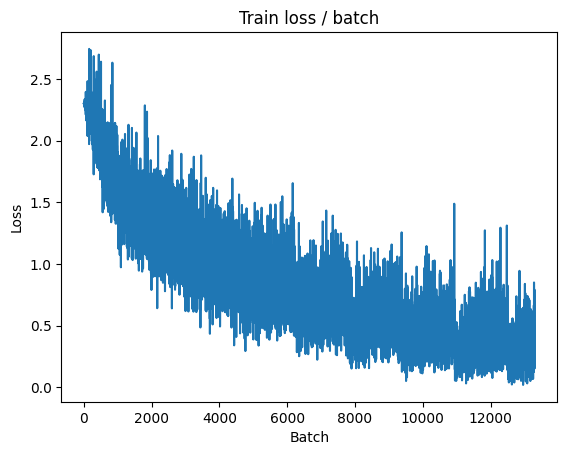

[TRAIN Batch 1000/1563]	Time 0.008s (0.008s)	Loss 0.1744 (0.2860)	Prec@1  93.8 ( 90.0)	Prec@5 100.0 ( 99.9)


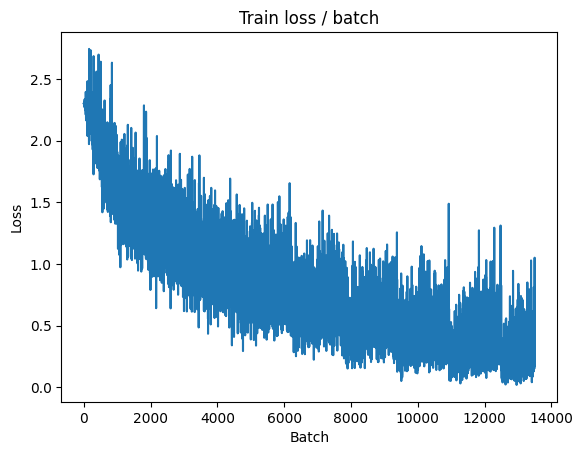

[TRAIN Batch 1200/1563]	Time 0.014s (0.009s)	Loss 0.3214 (0.2970)	Prec@1  87.5 ( 89.6)	Prec@5 100.0 ( 99.9)


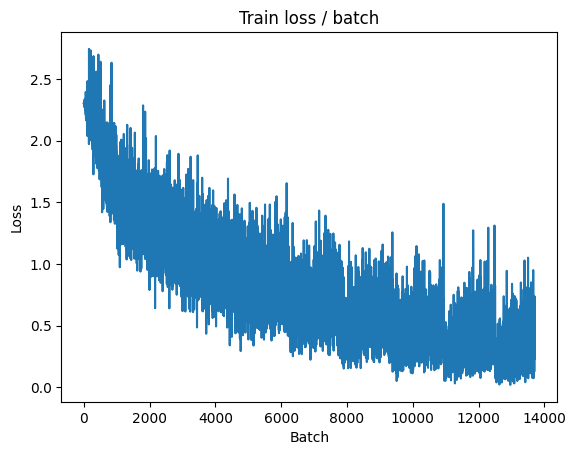

[TRAIN Batch 1400/1563]	Time 0.004s (0.009s)	Loss 0.3394 (0.3055)	Prec@1  87.5 ( 89.3)	Prec@5 100.0 ( 99.9)


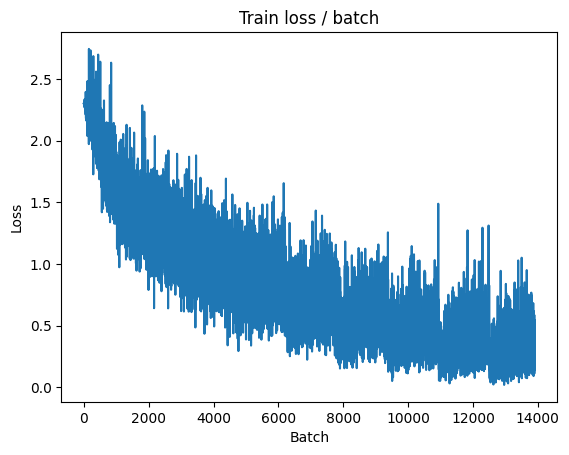


===============> Total time 14s	Avg loss 0.3147	Avg Prec@1 88.93 %	Avg Prec@5 99.86 %

[EVAL Batch 000/313]	Time 0.107s (0.107s)	Loss 0.6935 (0.6935)	Prec@1  78.1 ( 78.1)	Prec@5 100.0 (100.0)
[EVAL Batch 200/313]	Time 0.004s (0.007s)	Loss 1.7036 (1.1583)	Prec@1  62.5 ( 69.6)	Prec@5 100.0 ( 97.0)

===============> Total time 2s	Avg loss 1.1791	Avg Prec@1 69.38 %	Avg Prec@5 97.11 %



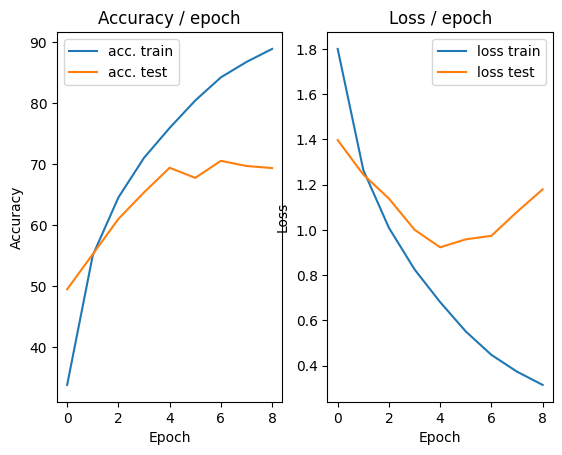

=== EPOCH 10 =====

[TRAIN Batch 000/1563]	Time 0.139s (0.139s)	Loss 0.1894 (0.1894)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


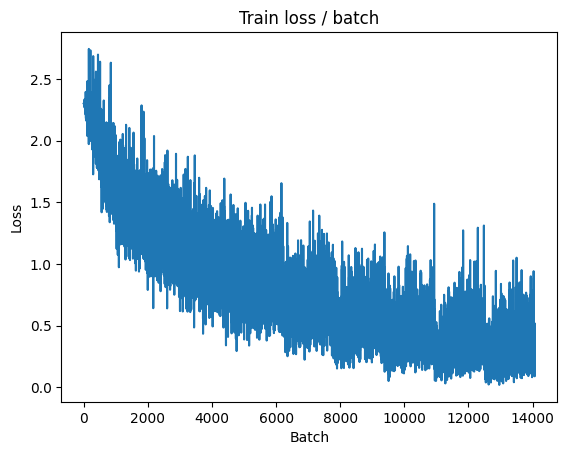

[TRAIN Batch 200/1563]	Time 0.005s (0.009s)	Loss 0.0942 (0.2091)	Prec@1 100.0 ( 92.8)	Prec@5 100.0 (100.0)


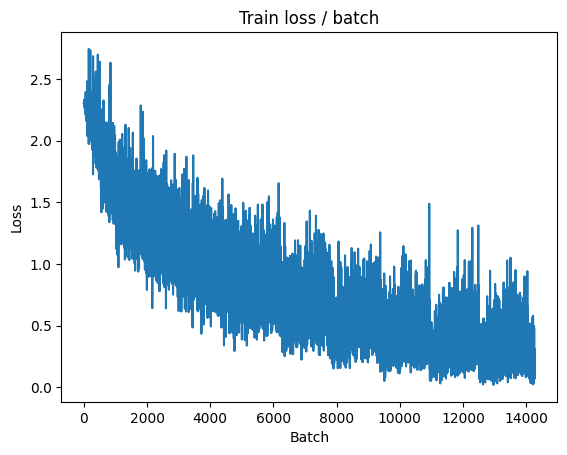

[TRAIN Batch 400/1563]	Time 0.007s (0.009s)	Loss 0.1119 (0.2250)	Prec@1  96.9 ( 92.3)	Prec@5 100.0 ( 99.9)


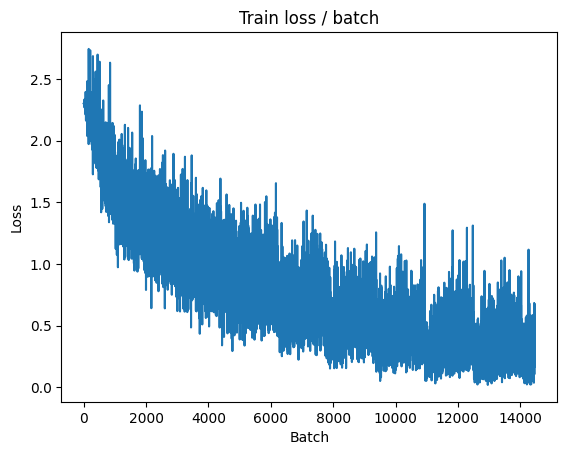

[TRAIN Batch 600/1563]	Time 0.012s (0.009s)	Loss 0.5408 (0.2428)	Prec@1  78.1 ( 91.6)	Prec@5 100.0 ( 99.9)


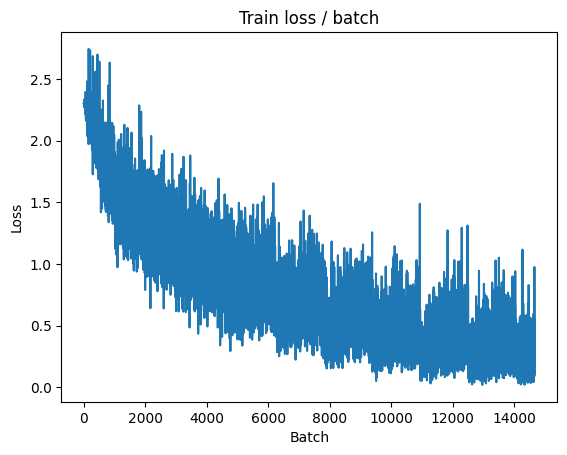

[TRAIN Batch 800/1563]	Time 0.004s (0.010s)	Loss 0.3204 (0.2523)	Prec@1  90.6 ( 91.3)	Prec@5 100.0 ( 99.9)


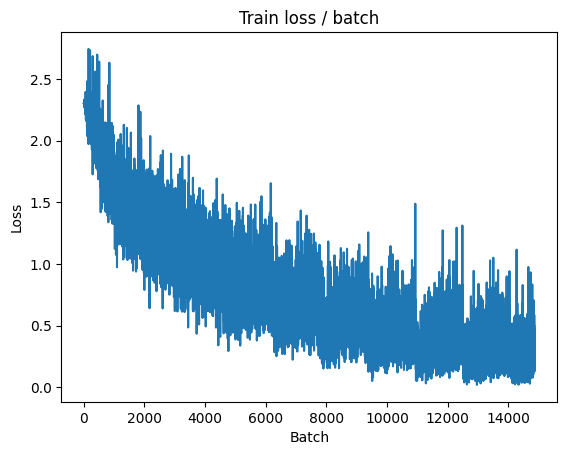

[TRAIN Batch 1000/1563]	Time 0.009s (0.009s)	Loss 0.1796 (0.2715)	Prec@1  90.6 ( 90.7)	Prec@5 100.0 ( 99.9)


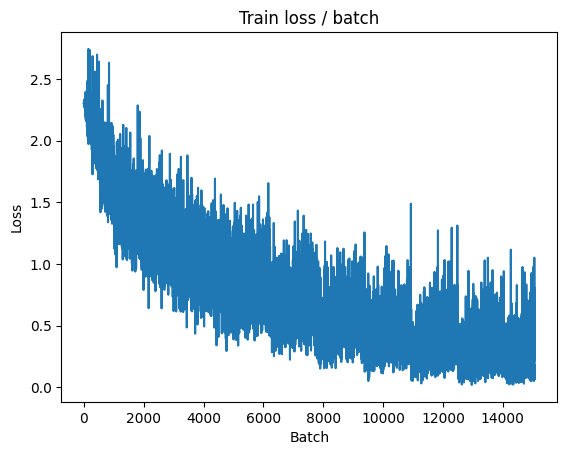

[TRAIN Batch 1200/1563]	Time 0.009s (0.009s)	Loss 0.0951 (0.2818)	Prec@1 100.0 ( 90.4)	Prec@5 100.0 ( 99.9)


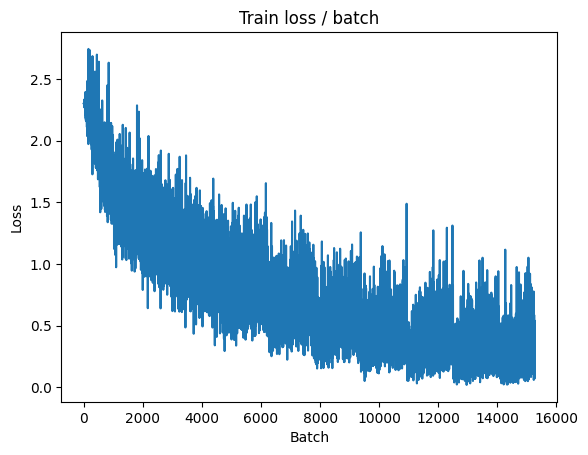

[TRAIN Batch 1400/1563]	Time 0.006s (0.009s)	Loss 0.1438 (0.2911)	Prec@1  96.9 ( 90.2)	Prec@5 100.0 ( 99.9)


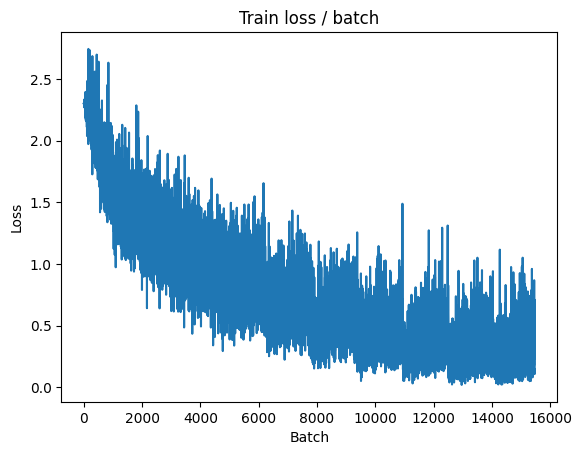


===============> Total time 14s	Avg loss 0.2978	Avg Prec@1 89.86 %	Avg Prec@5 99.88 %

[EVAL Batch 000/313]	Time 0.106s (0.106s)	Loss 0.5314 (0.5314)	Prec@1  75.0 ( 75.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/313]	Time 0.007s (0.007s)	Loss 2.0135 (1.3032)	Prec@1  65.6 ( 68.9)	Prec@5  90.6 ( 96.5)

===============> Total time 2s	Avg loss 1.3172	Avg Prec@1 68.92 %	Avg Prec@5 96.45 %



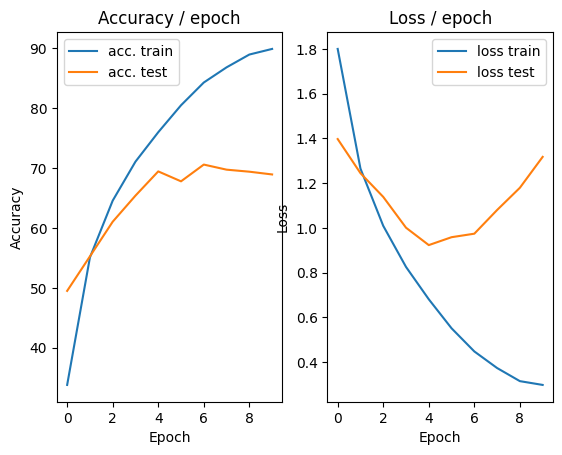

=== EPOCH 11 =====

[TRAIN Batch 000/1563]	Time 0.135s (0.135s)	Loss 0.0899 (0.0899)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


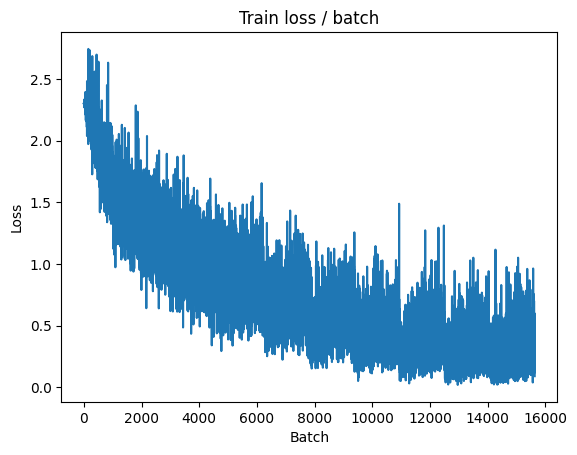

[TRAIN Batch 200/1563]	Time 0.004s (0.013s)	Loss 0.1878 (0.1958)	Prec@1  90.6 ( 93.0)	Prec@5 100.0 (100.0)


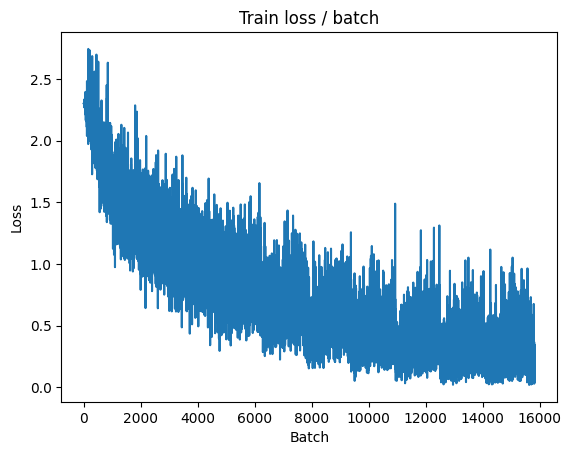

[TRAIN Batch 400/1563]	Time 0.005s (0.011s)	Loss 0.2730 (0.1976)	Prec@1  93.8 ( 93.1)	Prec@5 100.0 (100.0)


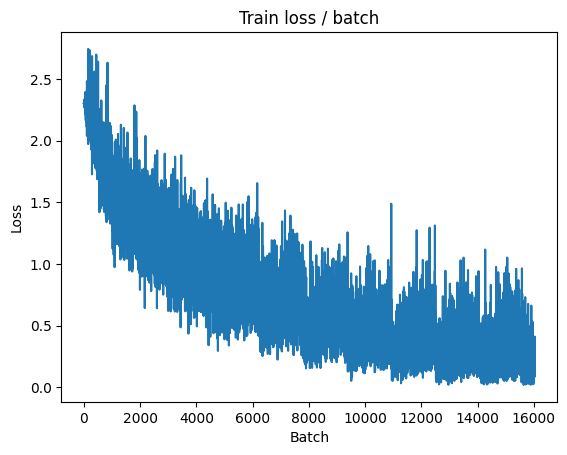

[TRAIN Batch 600/1563]	Time 0.011s (0.010s)	Loss 0.0534 (0.2083)	Prec@1 100.0 ( 92.9)	Prec@5 100.0 (100.0)


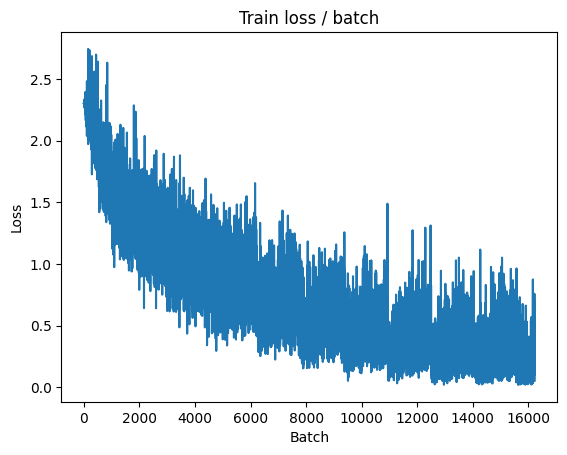

[TRAIN Batch 800/1563]	Time 0.004s (0.010s)	Loss 0.1329 (0.2151)	Prec@1  96.9 ( 92.7)	Prec@5 100.0 ( 99.9)


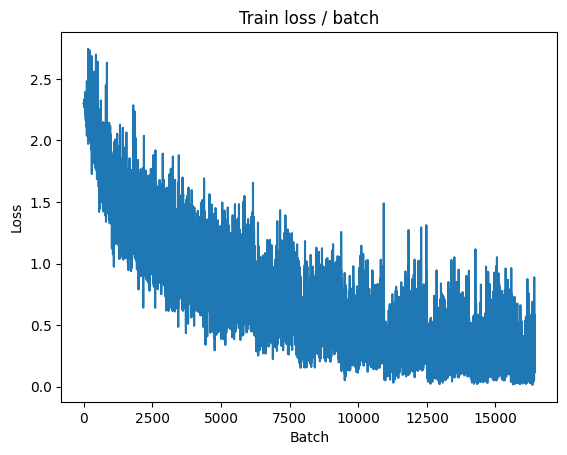

[TRAIN Batch 1000/1563]	Time 0.004s (0.010s)	Loss 0.0336 (0.2310)	Prec@1 100.0 ( 92.1)	Prec@5 100.0 ( 99.9)


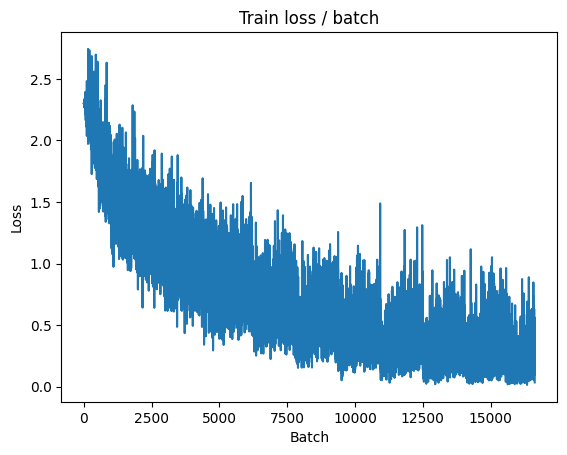

[TRAIN Batch 1200/1563]	Time 0.010s (0.009s)	Loss 0.4893 (0.2451)	Prec@1  84.4 ( 91.7)	Prec@5 100.0 ( 99.9)


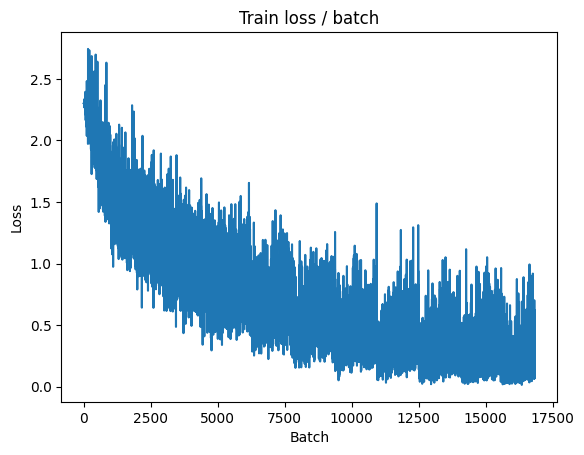

[TRAIN Batch 1400/1563]	Time 0.010s (0.009s)	Loss 0.5120 (0.2544)	Prec@1  84.4 ( 91.4)	Prec@5 100.0 ( 99.9)


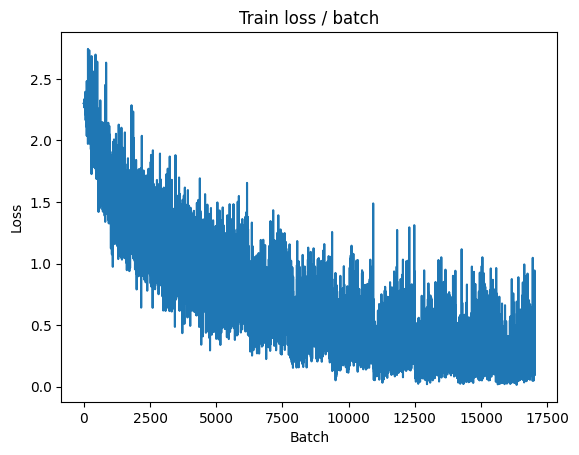


===============> Total time 15s	Avg loss 0.2624	Avg Prec@1 91.07 %	Avg Prec@5 99.91 %

[EVAL Batch 000/313]	Time 0.111s (0.111s)	Loss 1.4721 (1.4721)	Prec@1  59.4 ( 59.4)	Prec@5 100.0 (100.0)
[EVAL Batch 200/313]	Time 0.008s (0.007s)	Loss 1.8702 (1.5026)	Prec@1  62.5 ( 67.2)	Prec@5  96.9 ( 96.5)

===============> Total time 2s	Avg loss 1.5348	Avg Prec@1 67.08 %	Avg Prec@5 96.19 %



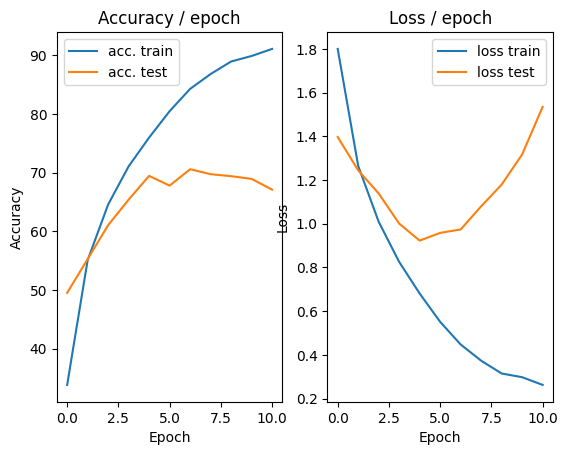

=== EPOCH 12 =====

[TRAIN Batch 000/1563]	Time 0.149s (0.149s)	Loss 0.2649 (0.2649)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


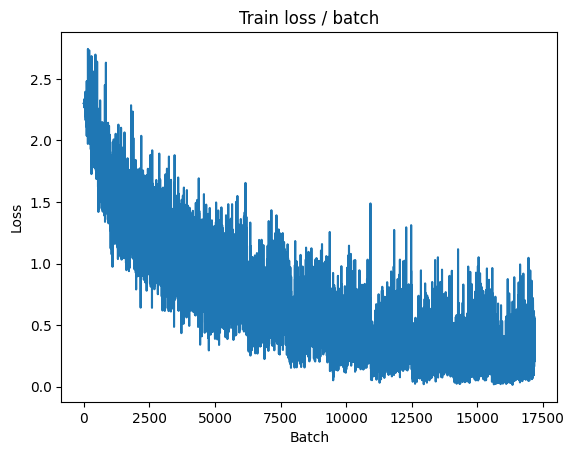

[TRAIN Batch 200/1563]	Time 0.004s (0.009s)	Loss 0.1857 (0.1846)	Prec@1  96.9 ( 93.8)	Prec@5 100.0 (100.0)


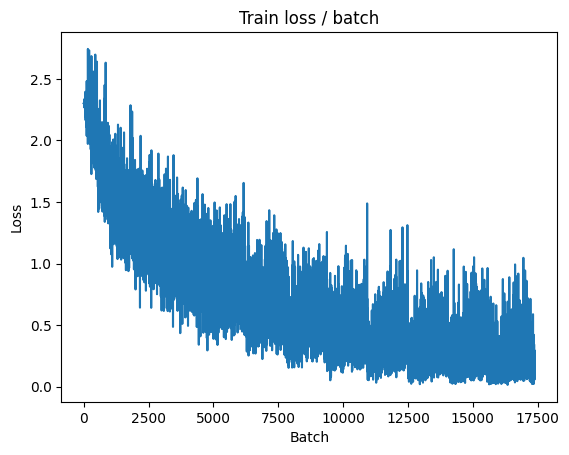

[TRAIN Batch 400/1563]	Time 0.005s (0.009s)	Loss 0.1552 (0.2015)	Prec@1  93.8 ( 93.2)	Prec@5 100.0 (100.0)


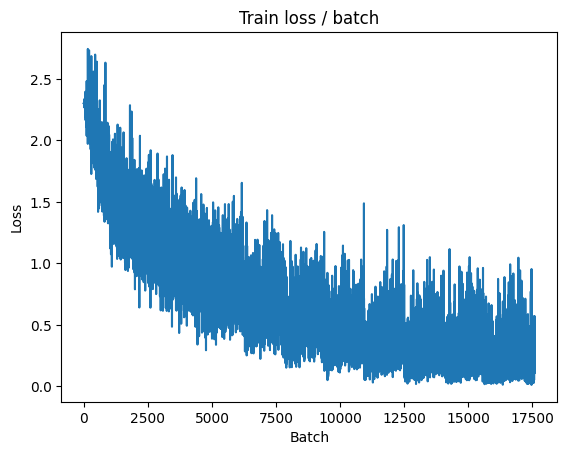

[TRAIN Batch 600/1563]	Time 0.005s (0.009s)	Loss 0.4503 (0.2195)	Prec@1  87.5 ( 92.6)	Prec@5 100.0 ( 99.9)


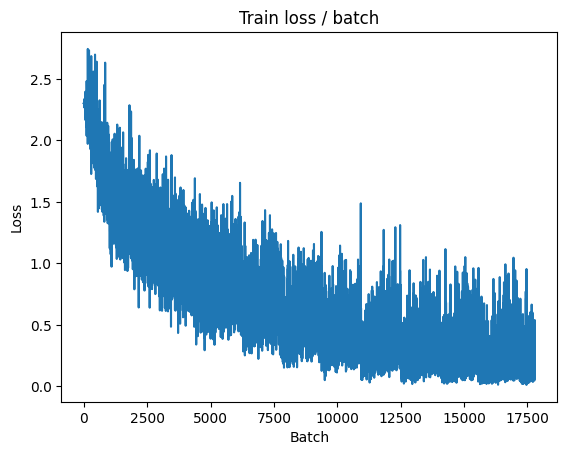

[TRAIN Batch 800/1563]	Time 0.006s (0.009s)	Loss 0.2826 (0.2378)	Prec@1  90.6 ( 92.0)	Prec@5 100.0 ( 99.9)


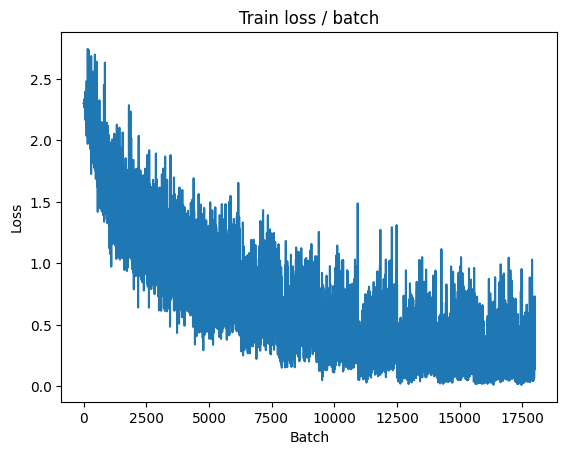

[TRAIN Batch 1000/1563]	Time 0.010s (0.009s)	Loss 0.4767 (0.2504)	Prec@1  90.6 ( 91.7)	Prec@5 100.0 ( 99.9)


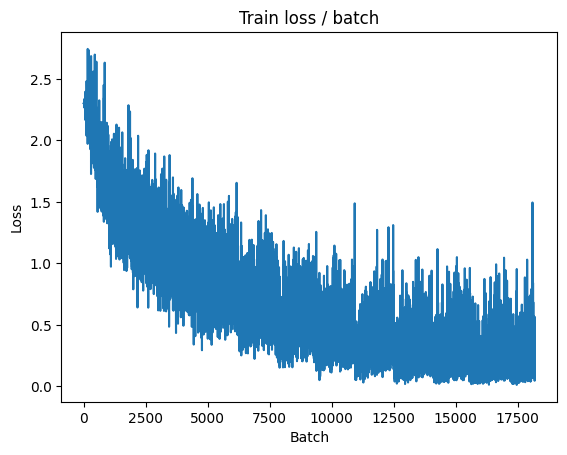

[TRAIN Batch 1200/1563]	Time 0.006s (0.009s)	Loss 0.3115 (0.2615)	Prec@1  93.8 ( 91.3)	Prec@5 100.0 ( 99.9)


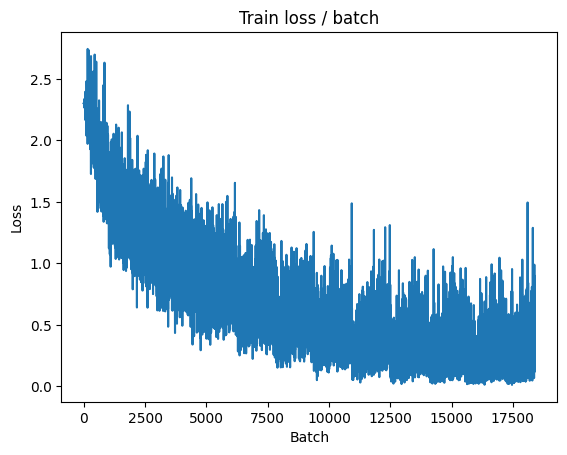

[TRAIN Batch 1400/1563]	Time 0.009s (0.009s)	Loss 0.5878 (0.2706)	Prec@1  78.1 ( 91.0)	Prec@5 100.0 ( 99.9)


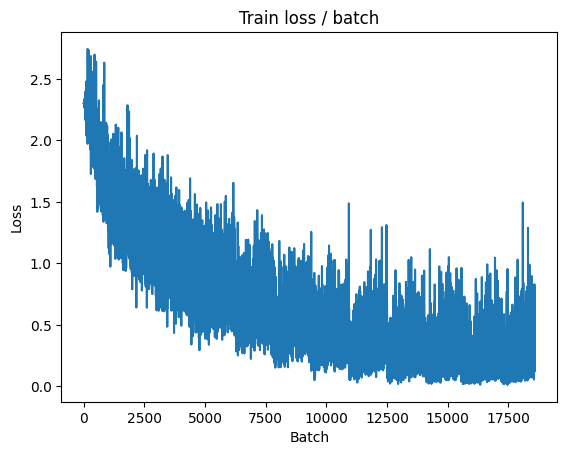


===============> Total time 14s	Avg loss 0.2768	Avg Prec@1 90.78 %	Avg Prec@5 99.90 %

[EVAL Batch 000/313]	Time 0.116s (0.116s)	Loss 1.4285 (1.4285)	Prec@1  59.4 ( 59.4)	Prec@5 100.0 (100.0)
[EVAL Batch 200/313]	Time 0.009s (0.007s)	Loss 1.1180 (1.4577)	Prec@1  75.0 ( 69.0)	Prec@5 100.0 ( 96.2)

===============> Total time 2s	Avg loss 1.4755	Avg Prec@1 68.81 %	Avg Prec@5 96.31 %



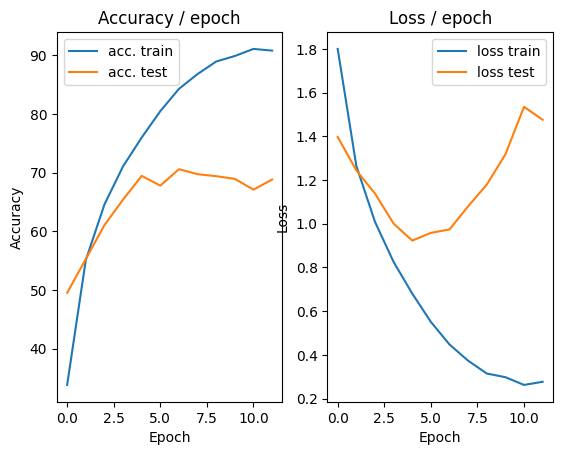

=== EPOCH 13 =====

[TRAIN Batch 000/1563]	Time 0.143s (0.143s)	Loss 0.1866 (0.1866)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


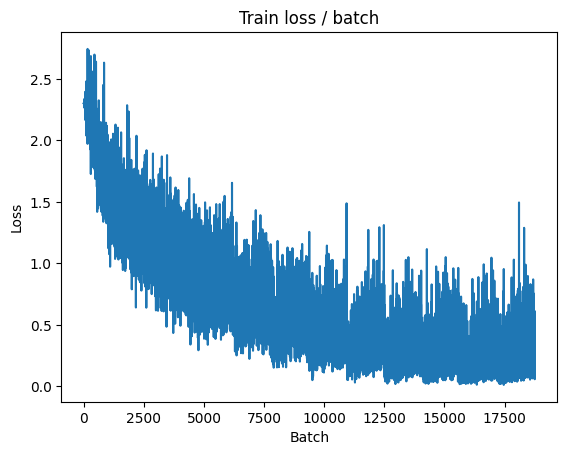

[TRAIN Batch 200/1563]	Time 0.010s (0.009s)	Loss 0.1064 (0.2157)	Prec@1  93.8 ( 93.1)	Prec@5 100.0 (100.0)


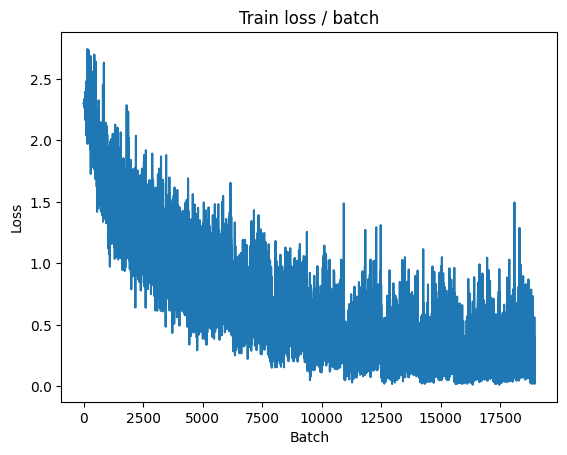

[TRAIN Batch 400/1563]	Time 0.007s (0.009s)	Loss 0.1719 (0.2123)	Prec@1  90.6 ( 93.2)	Prec@5 100.0 (100.0)


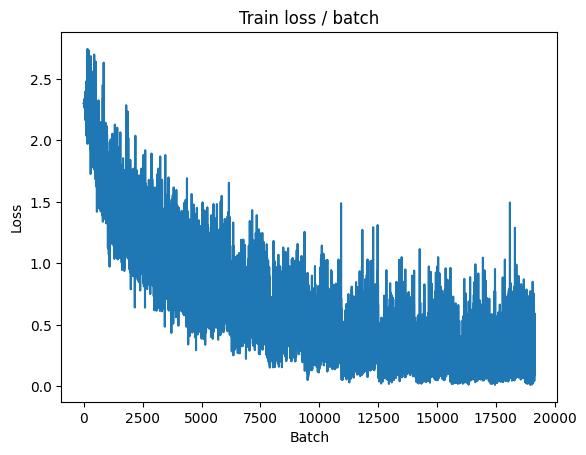

[TRAIN Batch 600/1563]	Time 0.004s (0.010s)	Loss 0.1427 (0.2225)	Prec@1  93.8 ( 92.7)	Prec@5 100.0 (100.0)


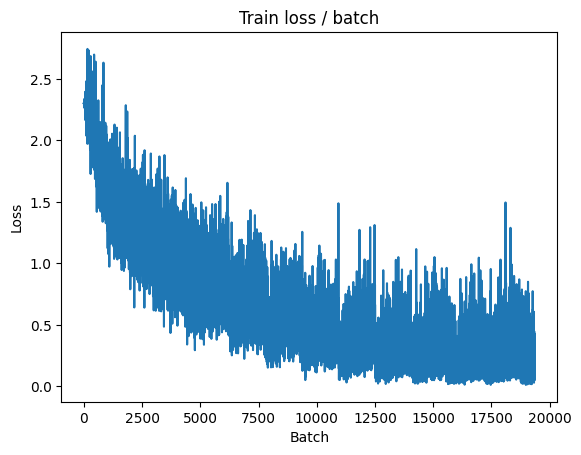

[TRAIN Batch 800/1563]	Time 0.007s (0.010s)	Loss 0.0551 (0.2329)	Prec@1 100.0 ( 92.3)	Prec@5 100.0 (100.0)


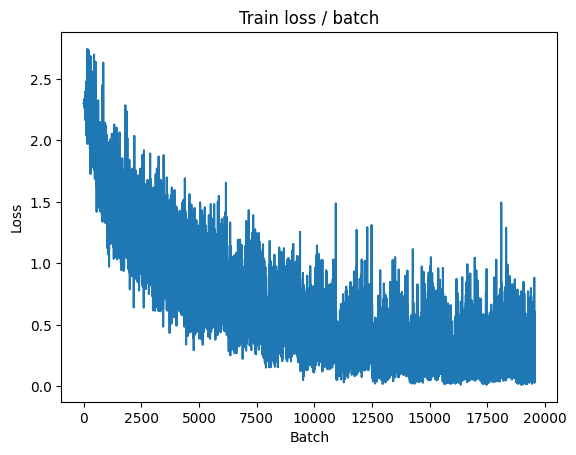

[TRAIN Batch 1000/1563]	Time 0.010s (0.009s)	Loss 0.3536 (0.2497)	Prec@1  87.5 ( 91.9)	Prec@5 100.0 ( 99.9)


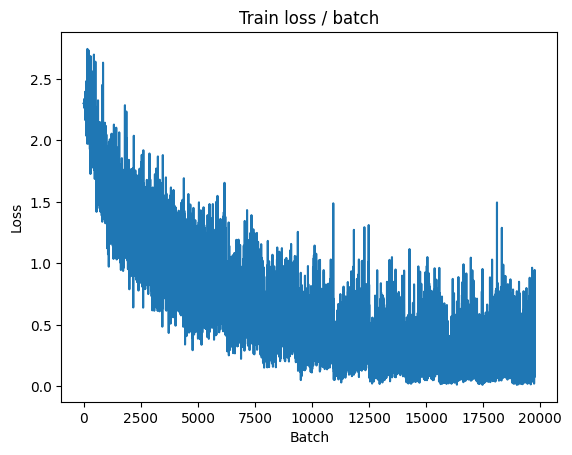

[TRAIN Batch 1200/1563]	Time 0.007s (0.009s)	Loss 0.1268 (0.2661)	Prec@1  93.8 ( 91.4)	Prec@5 100.0 ( 99.9)


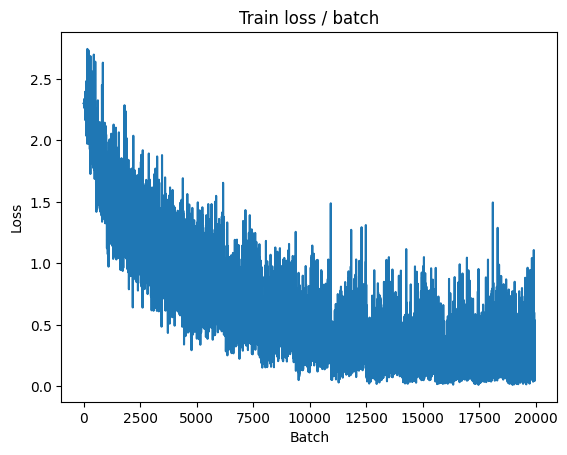

[TRAIN Batch 1400/1563]	Time 0.006s (0.009s)	Loss 0.1125 (0.2734)	Prec@1  96.9 ( 91.1)	Prec@5 100.0 ( 99.9)


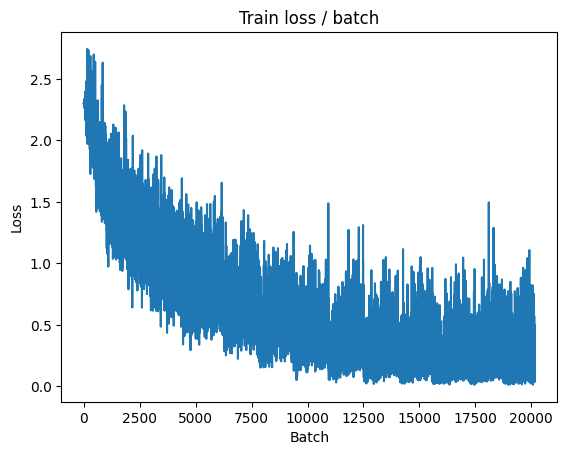


===============> Total time 14s	Avg loss 0.2773	Avg Prec@1 90.99 %	Avg Prec@5 99.91 %

[EVAL Batch 000/313]	Time 0.109s (0.109s)	Loss 0.5841 (0.5841)	Prec@1  81.2 ( 81.2)	Prec@5 100.0 (100.0)
[EVAL Batch 200/313]	Time 0.010s (0.007s)	Loss 1.9798 (1.4966)	Prec@1  62.5 ( 67.1)	Prec@5  96.9 ( 96.0)

===============> Total time 2s	Avg loss 1.5223	Avg Prec@1 67.31 %	Avg Prec@5 95.92 %



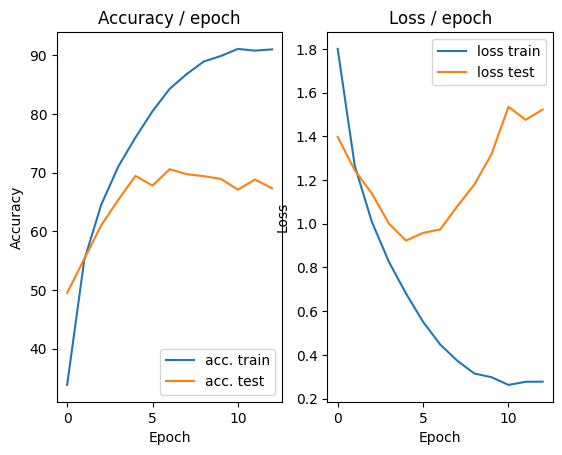

=== EPOCH 14 =====

[TRAIN Batch 000/1563]	Time 0.164s (0.164s)	Loss 0.5101 (0.5101)	Prec@1  81.2 ( 81.2)	Prec@5 100.0 (100.0)


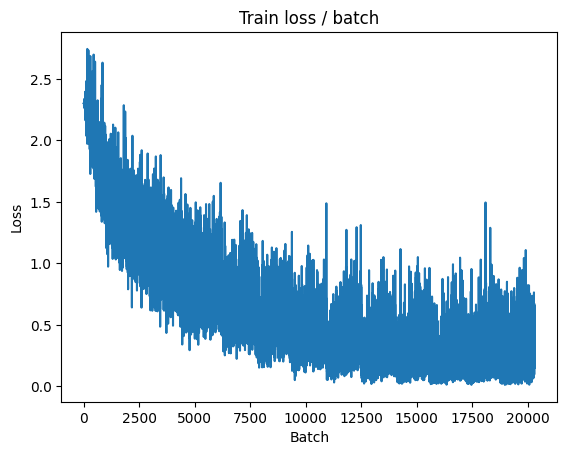

[TRAIN Batch 200/1563]	Time 0.008s (0.011s)	Loss 0.2673 (0.1865)	Prec@1  90.6 ( 93.8)	Prec@5 100.0 (100.0)


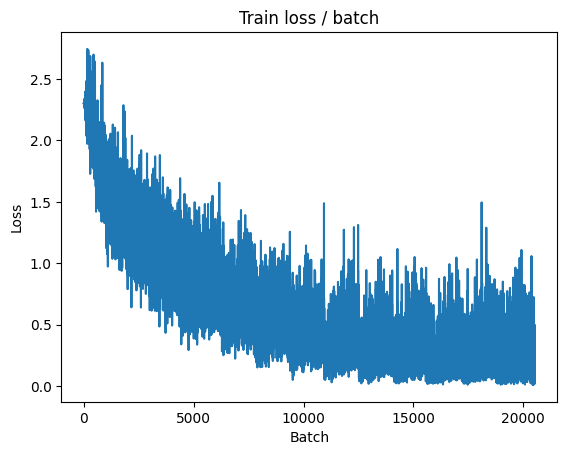

[TRAIN Batch 400/1563]	Time 0.008s (0.010s)	Loss 0.0906 (0.1969)	Prec@1 100.0 ( 93.7)	Prec@5 100.0 ( 99.9)


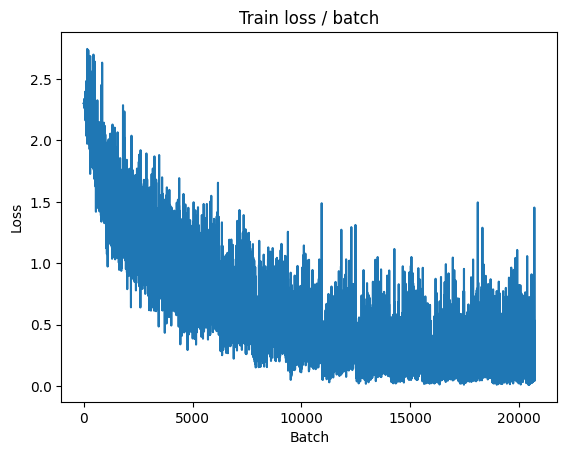

[TRAIN Batch 600/1563]	Time 0.006s (0.009s)	Loss 0.4524 (0.2003)	Prec@1  87.5 ( 93.7)	Prec@5  96.9 ( 99.9)


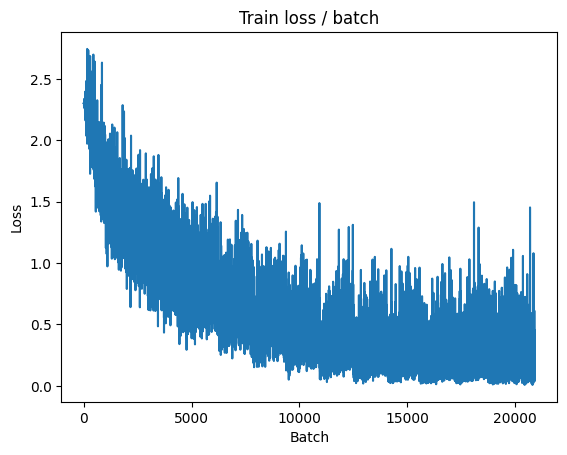

[TRAIN Batch 800/1563]	Time 0.004s (0.009s)	Loss 0.5808 (0.2114)	Prec@1  81.2 ( 93.3)	Prec@5 100.0 (100.0)


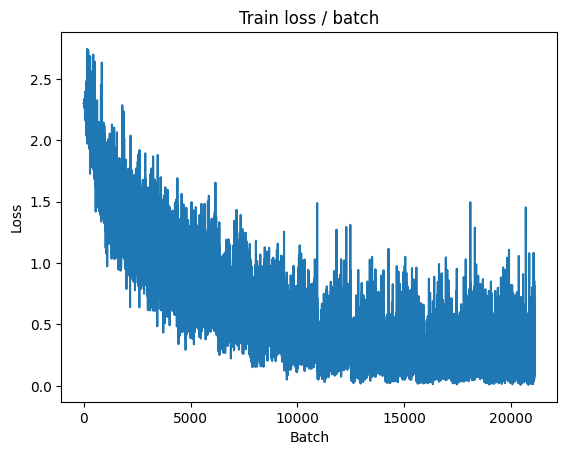

[TRAIN Batch 1000/1563]	Time 0.006s (0.009s)	Loss 0.3142 (0.2205)	Prec@1  87.5 ( 93.0)	Prec@5 100.0 ( 99.9)


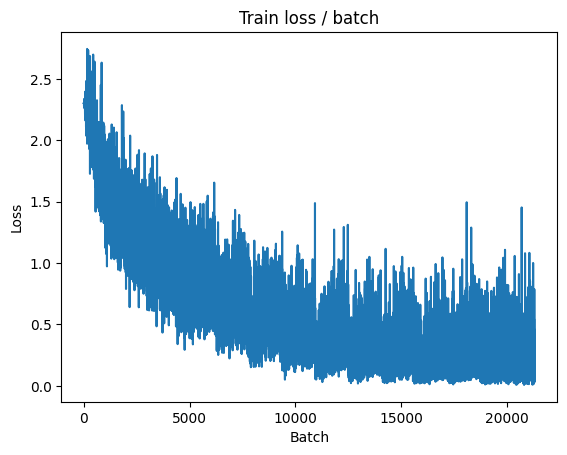

[TRAIN Batch 1200/1563]	Time 0.010s (0.009s)	Loss 0.5545 (0.2322)	Prec@1  93.8 ( 92.6)	Prec@5 100.0 ( 99.9)


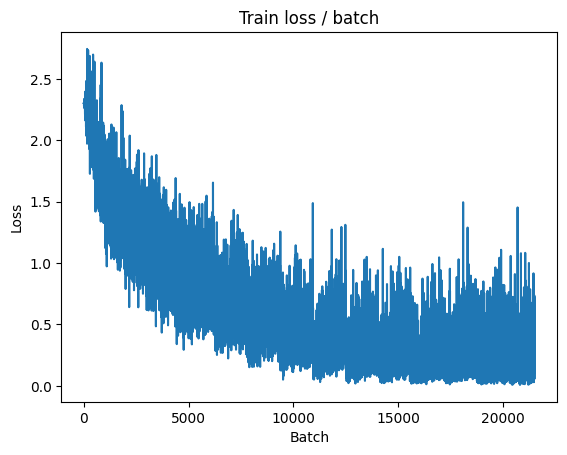

[TRAIN Batch 1400/1563]	Time 0.009s (0.009s)	Loss 0.1389 (0.2432)	Prec@1  93.8 ( 92.2)	Prec@5 100.0 ( 99.9)


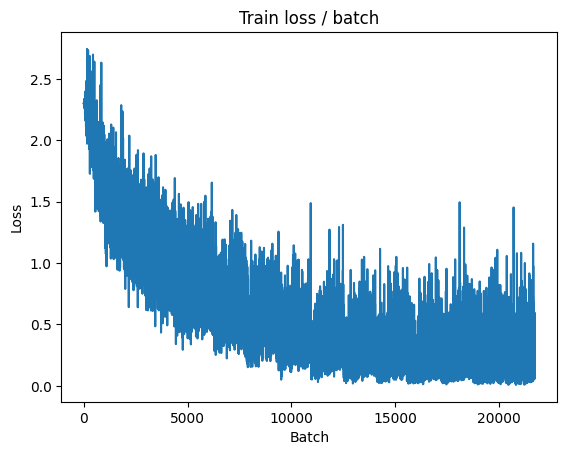


===============> Total time 14s	Avg loss 0.2505	Avg Prec@1 91.99 %	Avg Prec@5 99.90 %

[EVAL Batch 000/313]	Time 0.114s (0.114s)	Loss 1.6287 (1.6287)	Prec@1  68.8 ( 68.8)	Prec@5  96.9 ( 96.9)
[EVAL Batch 200/313]	Time 0.002s (0.007s)	Loss 2.5132 (1.9522)	Prec@1  71.9 ( 64.4)	Prec@5  96.9 ( 95.1)

===============> Total time 2s	Avg loss 1.9606	Avg Prec@1 64.62 %	Avg Prec@5 94.99 %



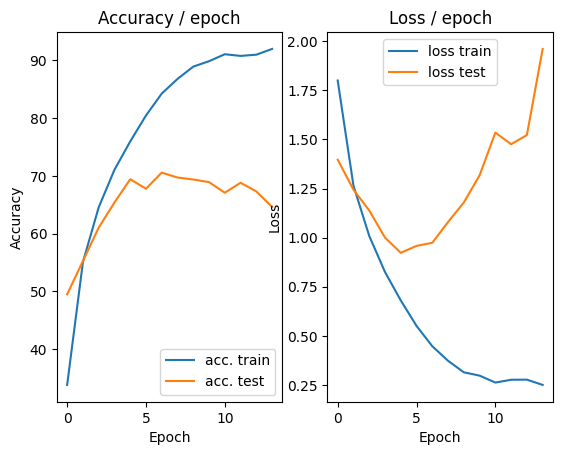

=== EPOCH 15 =====

[TRAIN Batch 000/1563]	Time 0.170s (0.170s)	Loss 0.8791 (0.8791)	Prec@1  81.2 ( 81.2)	Prec@5 100.0 (100.0)


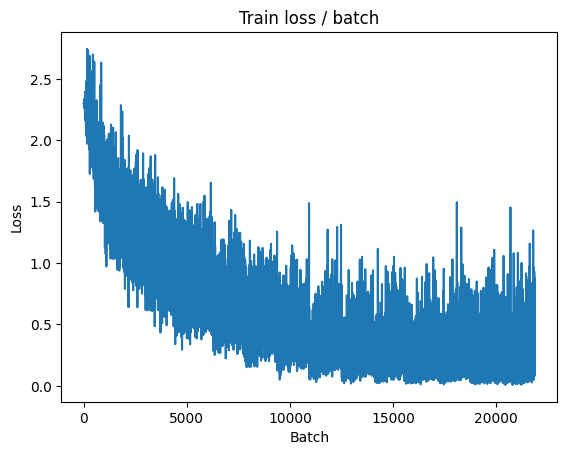

[TRAIN Batch 200/1563]	Time 0.008s (0.010s)	Loss 0.2707 (0.1766)	Prec@1  90.6 ( 94.2)	Prec@5 100.0 (100.0)


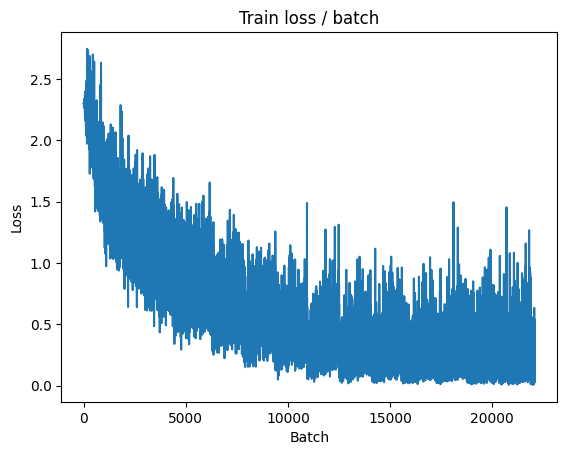

[TRAIN Batch 400/1563]	Time 0.006s (0.009s)	Loss 0.0726 (0.2148)	Prec@1  96.9 ( 93.4)	Prec@5 100.0 ( 99.9)


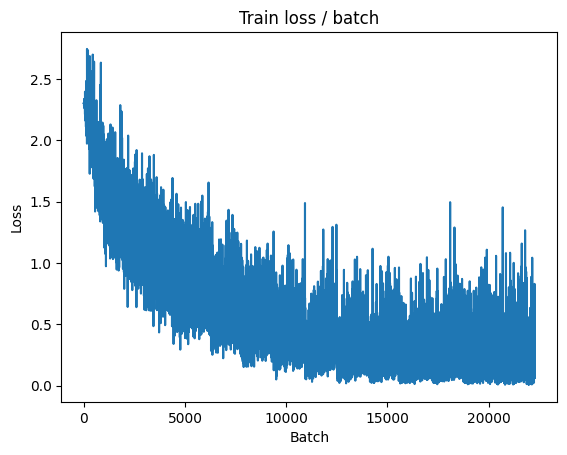

[TRAIN Batch 600/1563]	Time 0.010s (0.009s)	Loss 0.0614 (0.2365)	Prec@1  96.9 ( 92.7)	Prec@5 100.0 ( 99.9)


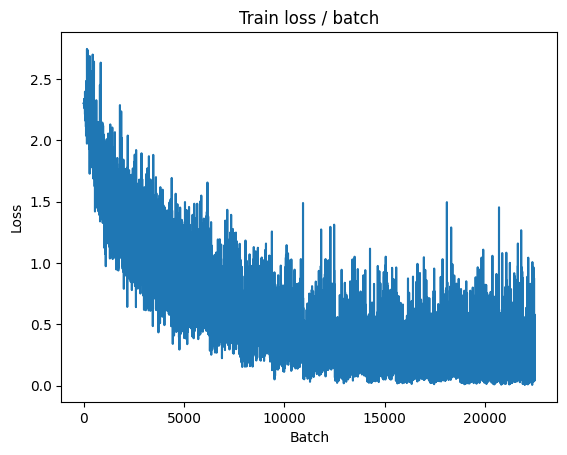

[TRAIN Batch 800/1563]	Time 0.010s (0.009s)	Loss 0.1244 (0.2535)	Prec@1  93.8 ( 92.2)	Prec@5 100.0 ( 99.9)


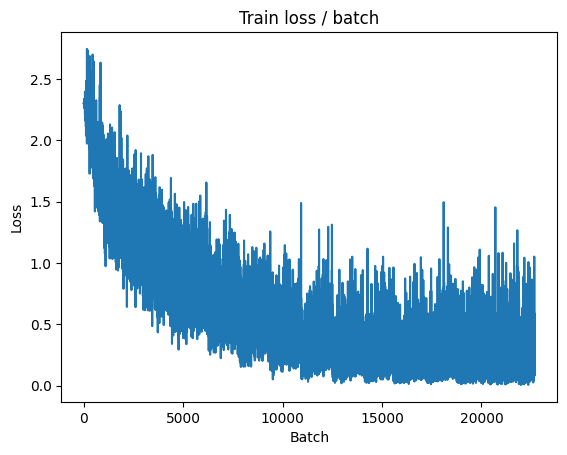

[TRAIN Batch 1000/1563]	Time 0.007s (0.010s)	Loss 0.4437 (0.2670)	Prec@1  81.2 ( 91.7)	Prec@5 100.0 ( 99.9)


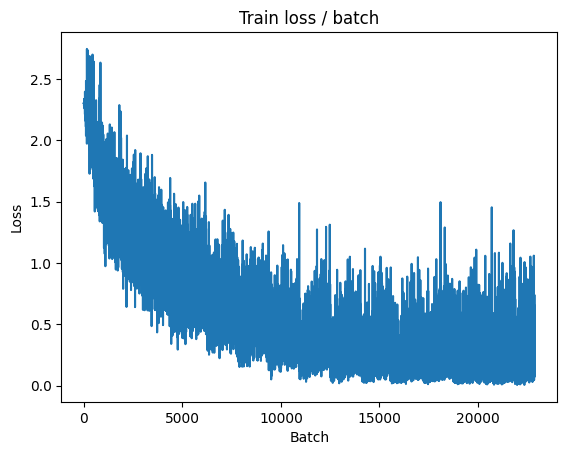

[TRAIN Batch 1200/1563]	Time 0.006s (0.009s)	Loss 0.3796 (0.2799)	Prec@1  90.6 ( 91.3)	Prec@5 100.0 ( 99.9)


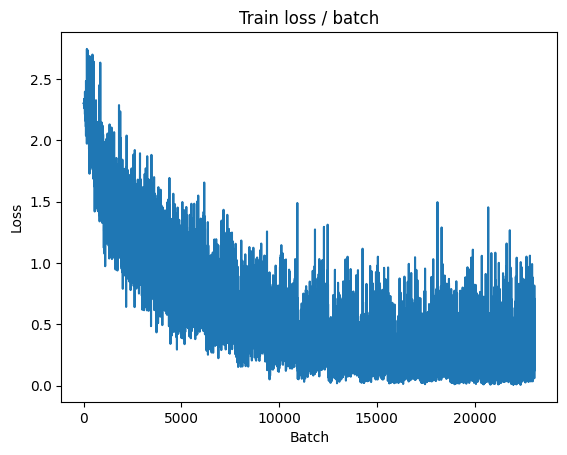

[TRAIN Batch 1400/1563]	Time 0.005s (0.009s)	Loss 0.2089 (0.2796)	Prec@1  90.6 ( 91.3)	Prec@5 100.0 ( 99.9)


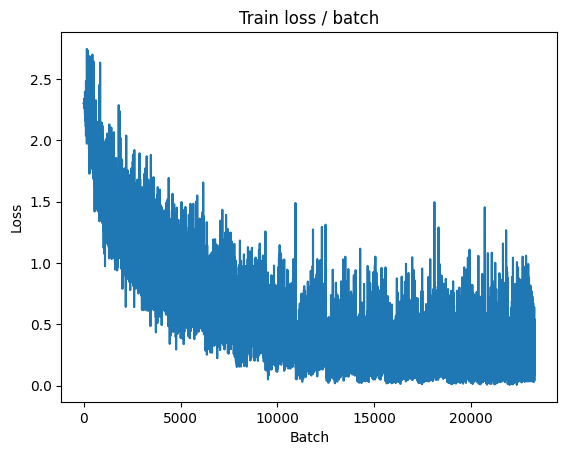


===============> Total time 14s	Avg loss 0.2835	Avg Prec@1 91.18 %	Avg Prec@5 99.90 %

[EVAL Batch 000/313]	Time 0.111s (0.111s)	Loss 1.3188 (1.3188)	Prec@1  71.9 ( 71.9)	Prec@5  96.9 ( 96.9)
[EVAL Batch 200/313]	Time 0.002s (0.007s)	Loss 1.9119 (1.7500)	Prec@1  75.0 ( 66.2)	Prec@5  96.9 ( 96.1)

===============> Total time 2s	Avg loss 1.7469	Avg Prec@1 66.27 %	Avg Prec@5 95.89 %



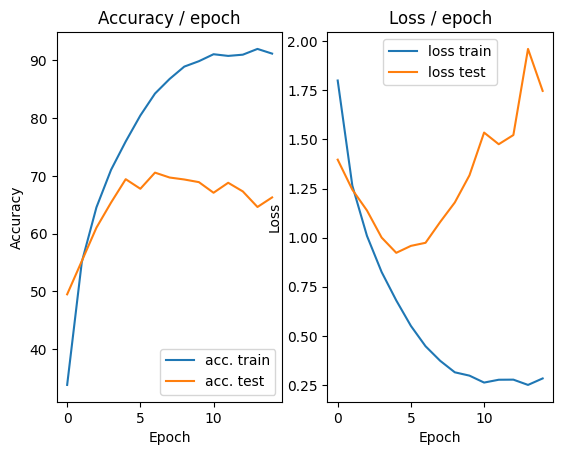

=== EPOCH 16 =====

[TRAIN Batch 000/1563]	Time 0.165s (0.165s)	Loss 0.1815 (0.1815)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


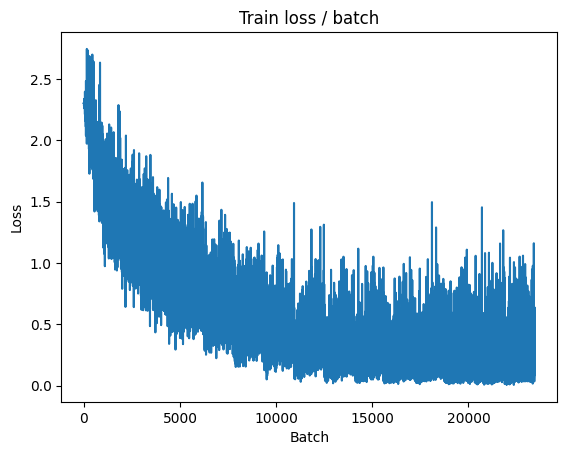

[TRAIN Batch 200/1563]	Time 0.021s (0.010s)	Loss 0.0802 (0.1585)	Prec@1  96.9 ( 94.7)	Prec@5 100.0 (100.0)


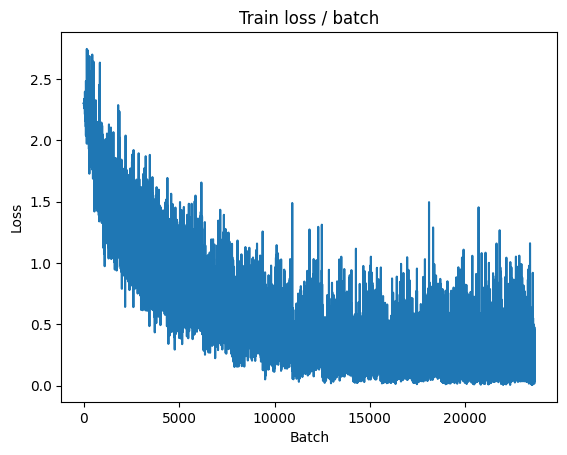

[TRAIN Batch 400/1563]	Time 0.013s (0.011s)	Loss 0.0521 (0.1844)	Prec@1  96.9 ( 94.1)	Prec@5 100.0 (100.0)


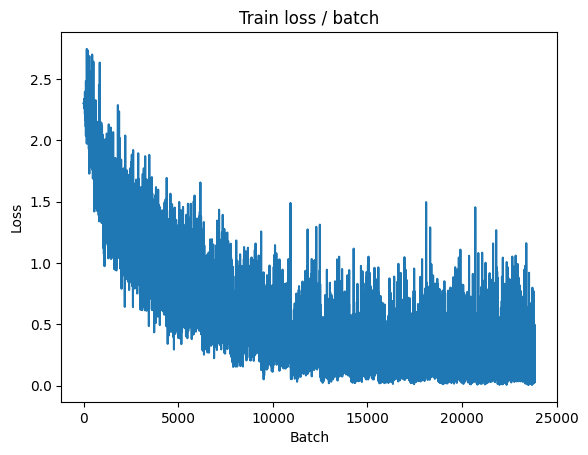

[TRAIN Batch 600/1563]	Time 0.005s (0.010s)	Loss 0.8234 (0.2150)	Prec@1  75.0 ( 93.3)	Prec@5 100.0 ( 99.9)


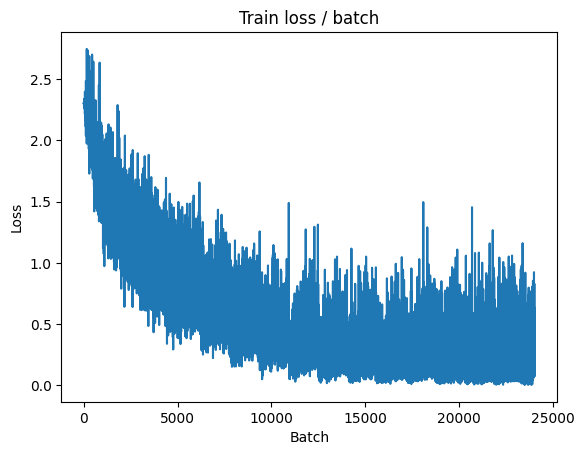

[TRAIN Batch 800/1563]	Time 0.008s (0.010s)	Loss 0.2834 (0.2272)	Prec@1  87.5 ( 92.9)	Prec@5 100.0 ( 99.9)


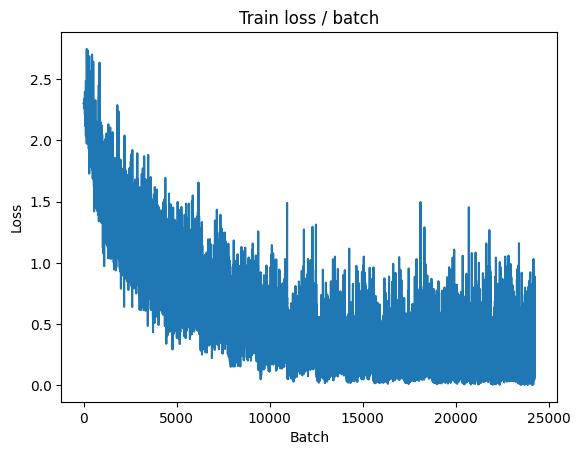

[TRAIN Batch 1000/1563]	Time 0.007s (0.010s)	Loss 0.1220 (0.2410)	Prec@1  96.9 ( 92.5)	Prec@5 100.0 ( 99.9)


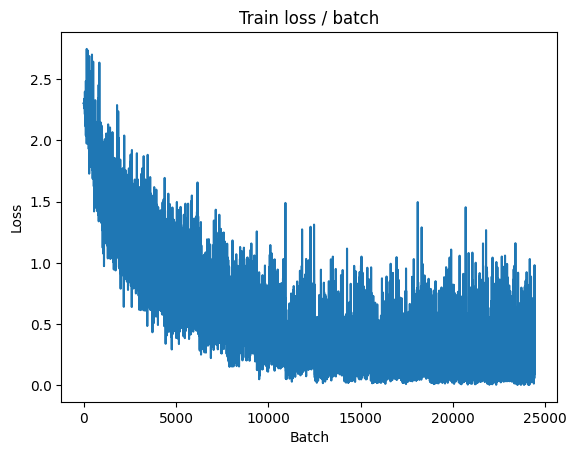

[TRAIN Batch 1200/1563]	Time 0.012s (0.009s)	Loss 0.2417 (0.2575)	Prec@1  90.6 ( 92.1)	Prec@5 100.0 ( 99.9)


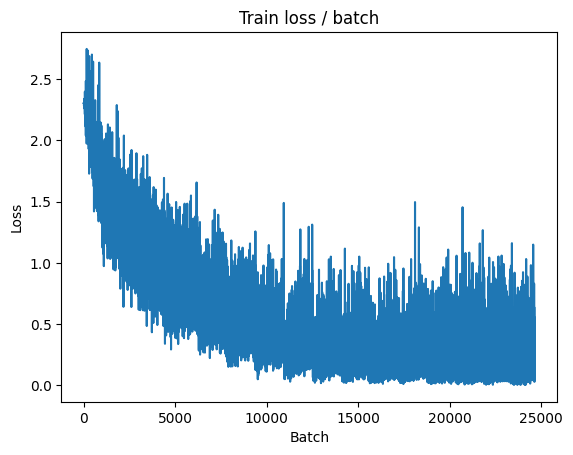

[TRAIN Batch 1400/1563]	Time 0.004s (0.009s)	Loss 0.1104 (0.2704)	Prec@1  96.9 ( 91.8)	Prec@5 100.0 ( 99.9)


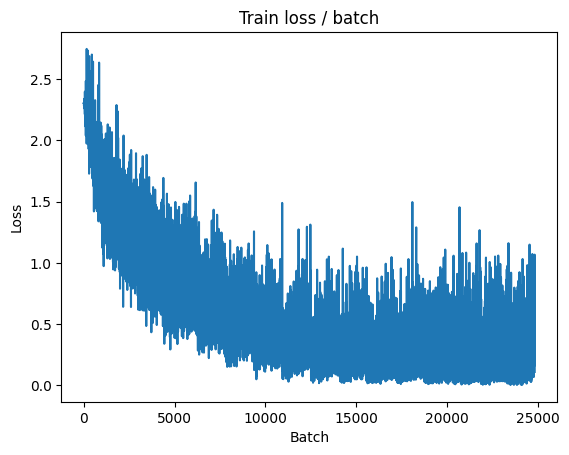


===============> Total time 14s	Avg loss 0.2752	Avg Prec@1 91.56 %	Avg Prec@5 99.87 %

[EVAL Batch 000/313]	Time 0.194s (0.194s)	Loss 2.0830 (2.0830)	Prec@1  71.9 ( 71.9)	Prec@5 100.0 (100.0)
[EVAL Batch 200/313]	Time 0.002s (0.010s)	Loss 1.4844 (1.9339)	Prec@1  65.6 ( 67.0)	Prec@5 100.0 ( 96.0)

===============> Total time 2s	Avg loss 1.9662	Avg Prec@1 67.28 %	Avg Prec@5 96.10 %



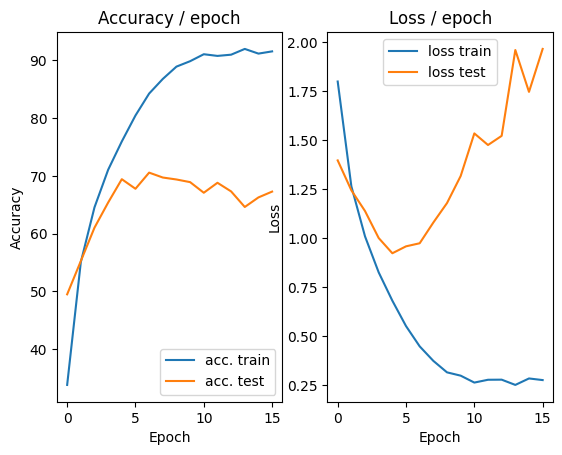

=== EPOCH 17 =====

[TRAIN Batch 000/1563]	Time 0.131s (0.131s)	Loss 0.3553 (0.3553)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


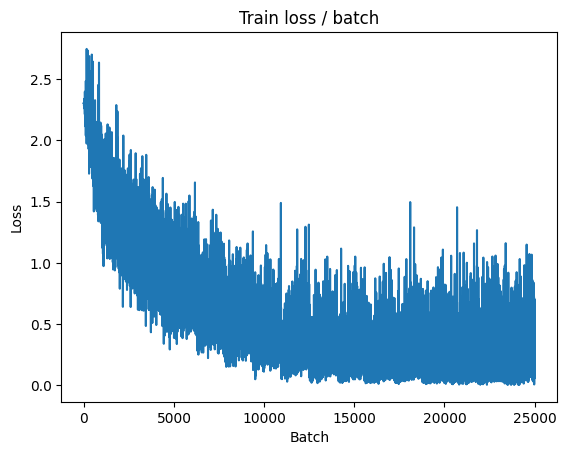

[TRAIN Batch 200/1563]	Time 0.009s (0.009s)	Loss 0.1276 (0.2171)	Prec@1  93.8 ( 93.5)	Prec@5 100.0 (100.0)


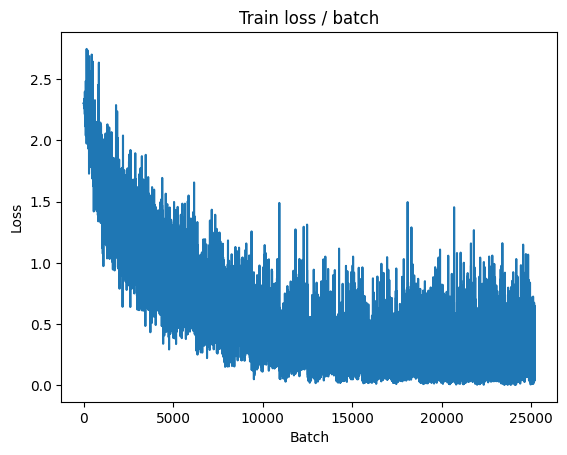

[TRAIN Batch 400/1563]	Time 0.008s (0.009s)	Loss 0.0987 (0.2203)	Prec@1  96.9 ( 93.3)	Prec@5 100.0 (100.0)


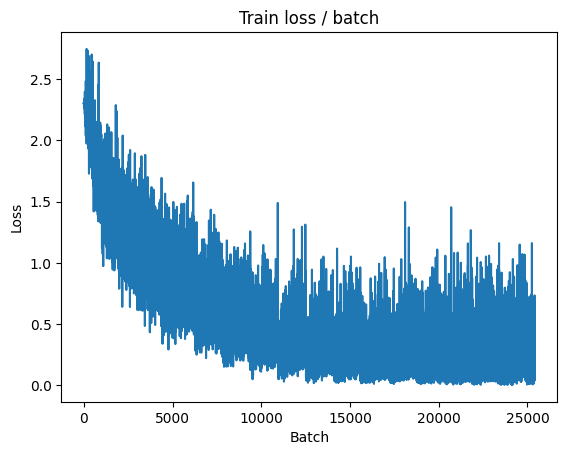

[TRAIN Batch 600/1563]	Time 0.009s (0.009s)	Loss 0.2413 (0.2307)	Prec@1  96.9 ( 93.2)	Prec@5 100.0 (100.0)


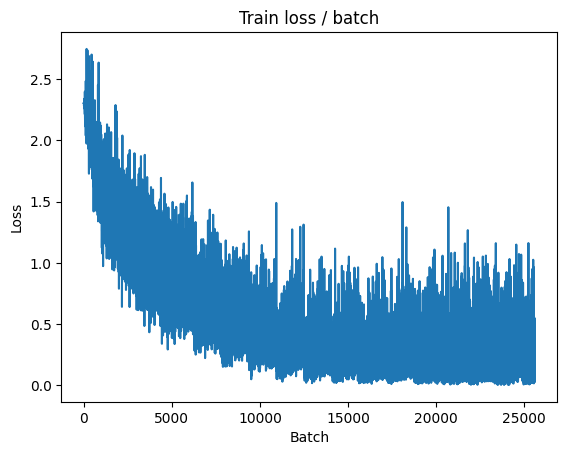

[TRAIN Batch 800/1563]	Time 0.005s (0.009s)	Loss 0.0720 (0.2402)	Prec@1  96.9 ( 92.8)	Prec@5 100.0 ( 99.9)


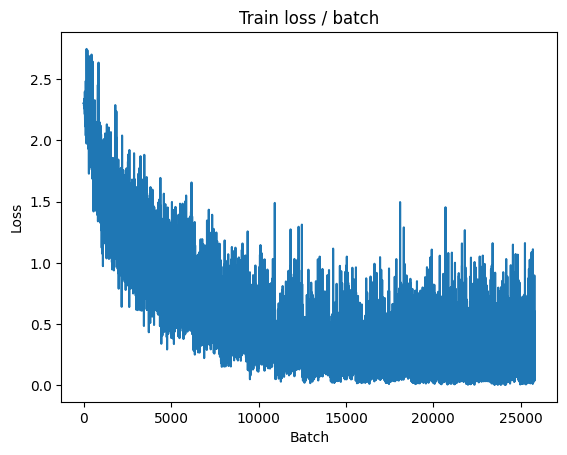

[TRAIN Batch 1000/1563]	Time 0.013s (0.009s)	Loss 0.8770 (0.2568)	Prec@1  81.2 ( 92.4)	Prec@5 100.0 ( 99.9)


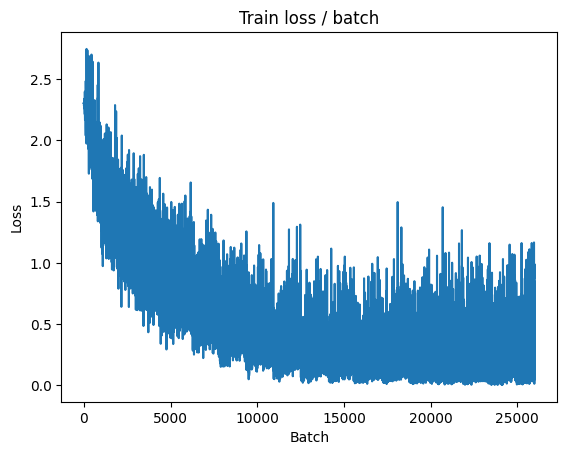

[TRAIN Batch 1200/1563]	Time 0.009s (0.009s)	Loss 0.2224 (0.2667)	Prec@1  93.8 ( 92.0)	Prec@5 100.0 ( 99.9)


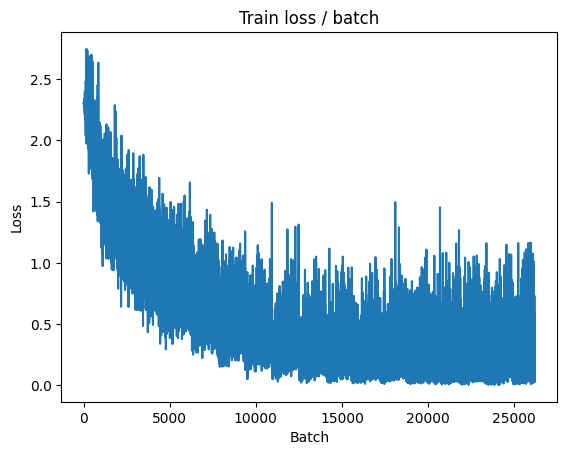

[TRAIN Batch 1400/1563]	Time 0.004s (0.009s)	Loss 0.5378 (0.2769)	Prec@1  84.4 ( 91.7)	Prec@5 100.0 ( 99.9)


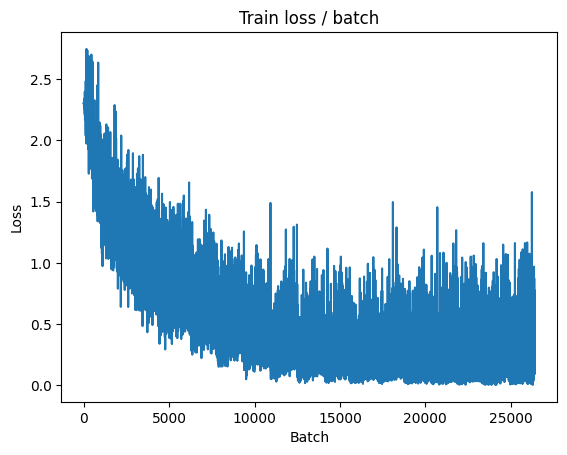


===============> Total time 14s	Avg loss 0.2882	Avg Prec@1 91.34 %	Avg Prec@5 99.88 %

[EVAL Batch 000/313]	Time 0.113s (0.113s)	Loss 1.4135 (1.4135)	Prec@1  46.9 ( 46.9)	Prec@5  96.9 ( 96.9)
[EVAL Batch 200/313]	Time 0.004s (0.007s)	Loss 2.1395 (1.8551)	Prec@1  62.5 ( 60.5)	Prec@5  93.8 ( 94.5)

===============> Total time 2s	Avg loss 1.8869	Avg Prec@1 60.40 %	Avg Prec@5 94.35 %



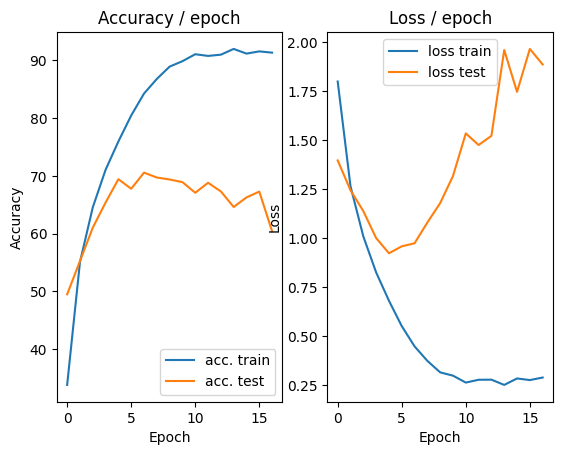

=== EPOCH 18 =====

[TRAIN Batch 000/1563]	Time 0.151s (0.151s)	Loss 0.5525 (0.5525)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


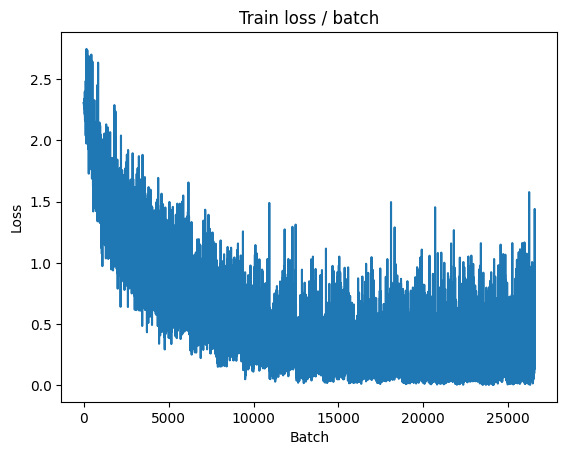

[TRAIN Batch 200/1563]	Time 0.006s (0.010s)	Loss 0.2060 (0.2330)	Prec@1  90.6 ( 92.8)	Prec@5 100.0 ( 99.9)


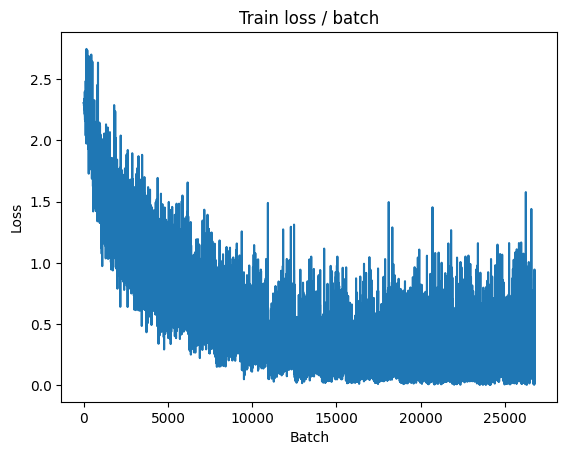

[TRAIN Batch 400/1563]	Time 0.012s (0.009s)	Loss 0.2789 (0.2355)	Prec@1  90.6 ( 92.7)	Prec@5 100.0 ( 99.9)


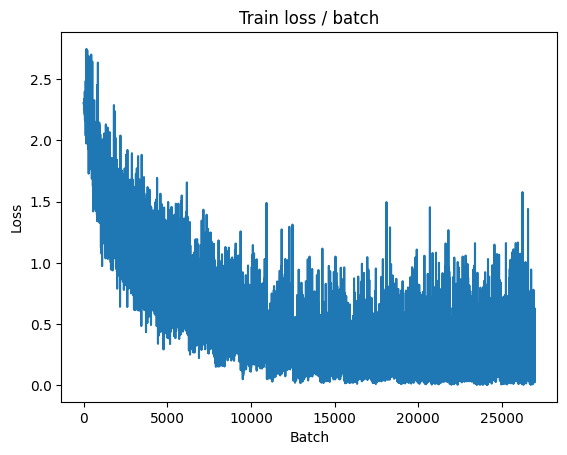

[TRAIN Batch 600/1563]	Time 0.006s (0.010s)	Loss 0.1197 (0.2545)	Prec@1  93.8 ( 92.4)	Prec@5 100.0 ( 99.9)


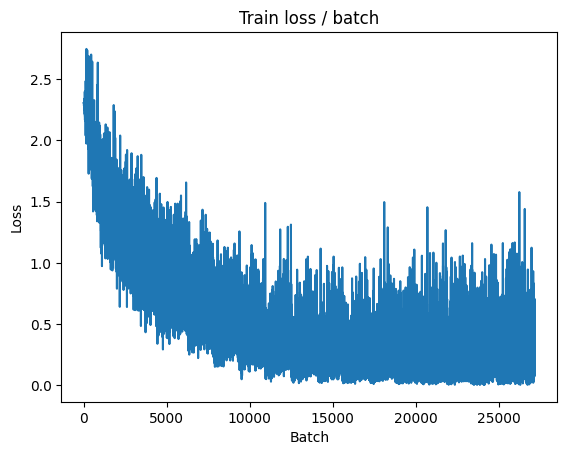

[TRAIN Batch 800/1563]	Time 0.009s (0.010s)	Loss 0.1257 (0.2615)	Prec@1  90.6 ( 92.1)	Prec@5 100.0 ( 99.9)


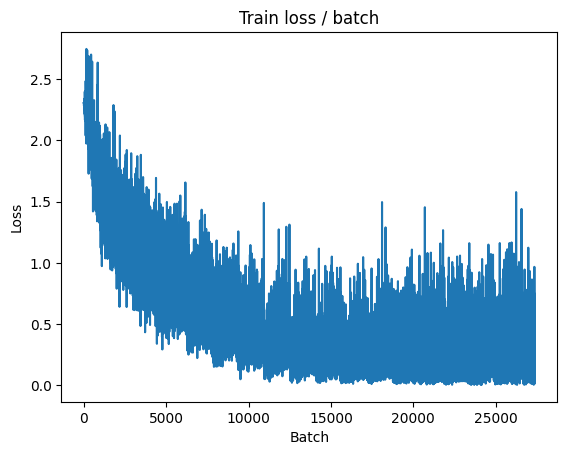

[TRAIN Batch 1000/1563]	Time 0.006s (0.010s)	Loss 0.5155 (0.2720)	Prec@1  93.8 ( 91.8)	Prec@5 100.0 ( 99.9)


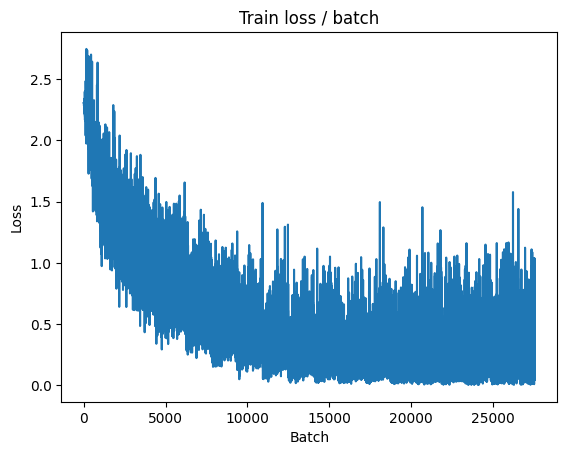

[TRAIN Batch 1200/1563]	Time 0.007s (0.009s)	Loss 0.2778 (0.2834)	Prec@1  93.8 ( 91.6)	Prec@5 100.0 ( 99.9)


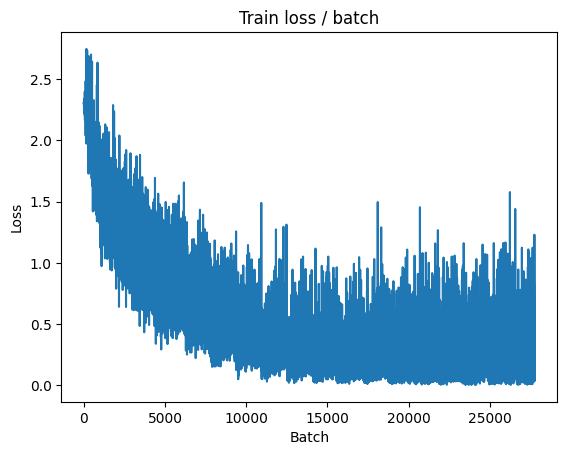

[TRAIN Batch 1400/1563]	Time 0.008s (0.009s)	Loss 0.6221 (0.2974)	Prec@1  84.4 ( 91.1)	Prec@5 100.0 ( 99.9)


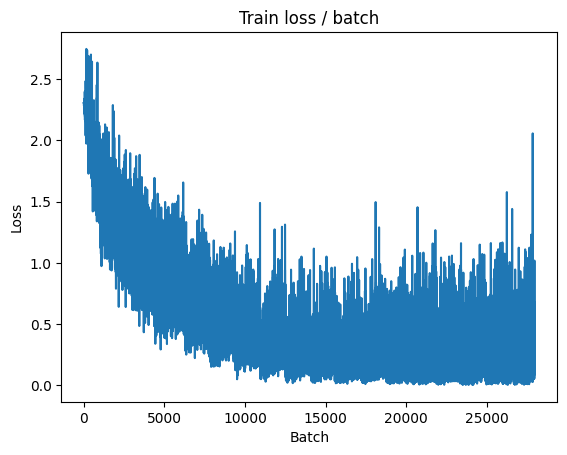


===============> Total time 14s	Avg loss 0.3000	Avg Prec@1 91.01 %	Avg Prec@5 99.86 %

[EVAL Batch 000/313]	Time 0.102s (0.102s)	Loss 1.7732 (1.7732)	Prec@1  75.0 ( 75.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/313]	Time 0.012s (0.007s)	Loss 1.6779 (1.8476)	Prec@1  75.0 ( 67.6)	Prec@5  93.8 ( 95.8)

===============> Total time 2s	Avg loss 1.8810	Avg Prec@1 67.54 %	Avg Prec@5 95.91 %



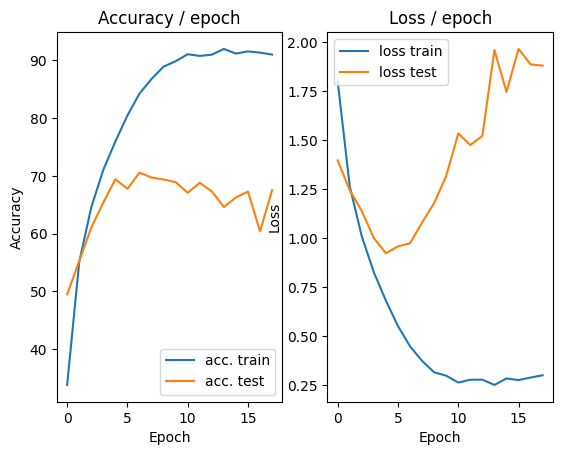

=== EPOCH 19 =====

[TRAIN Batch 000/1563]	Time 0.162s (0.162s)	Loss 0.2223 (0.2223)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


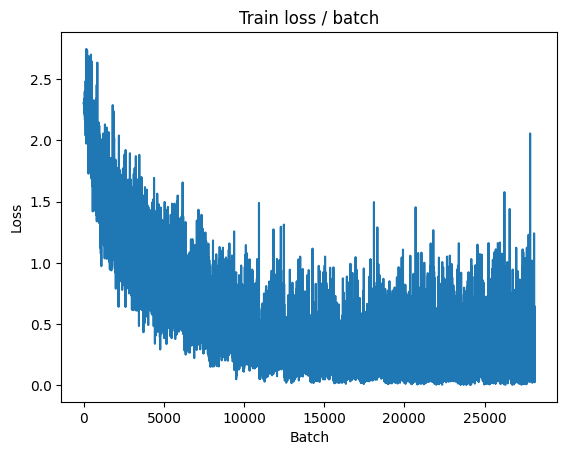

[TRAIN Batch 200/1563]	Time 0.008s (0.014s)	Loss 0.1318 (0.1941)	Prec@1  93.8 ( 93.9)	Prec@5 100.0 ( 99.9)


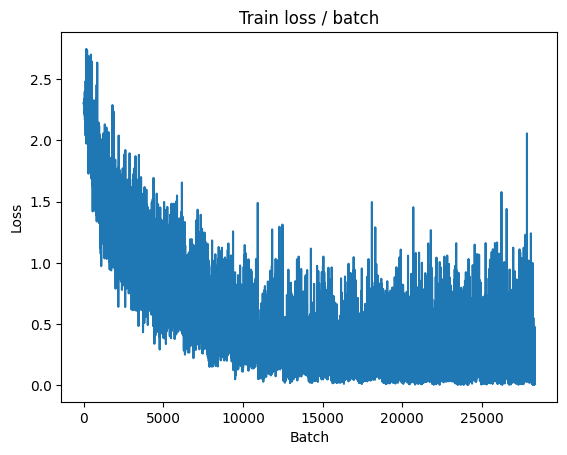

[TRAIN Batch 400/1563]	Time 0.010s (0.011s)	Loss 0.5413 (0.2152)	Prec@1  78.1 ( 93.5)	Prec@5 100.0 ( 99.9)


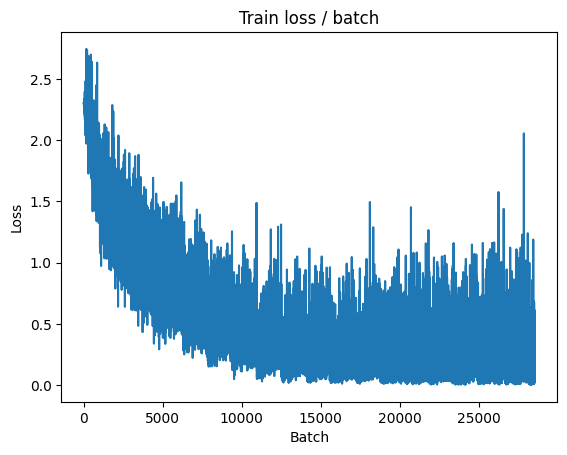

[TRAIN Batch 600/1563]	Time 0.009s (0.010s)	Loss 0.1475 (0.2379)	Prec@1  96.9 ( 92.8)	Prec@5 100.0 ( 99.9)


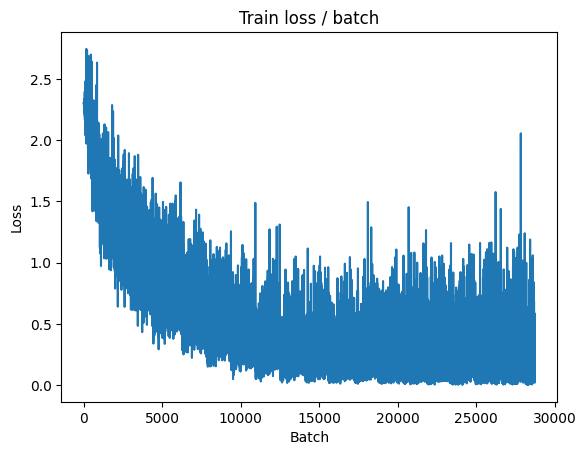

[TRAIN Batch 800/1563]	Time 0.008s (0.010s)	Loss 0.2399 (0.2658)	Prec@1  90.6 ( 92.1)	Prec@5 100.0 ( 99.9)


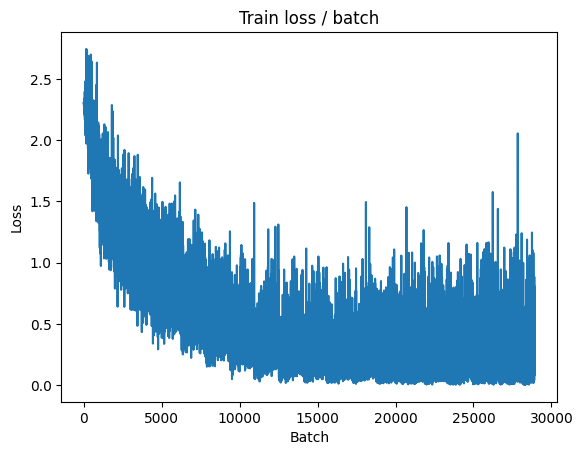

[TRAIN Batch 1000/1563]	Time 0.010s (0.010s)	Loss 0.5069 (0.2772)	Prec@1  87.5 ( 91.9)	Prec@5 100.0 ( 99.9)


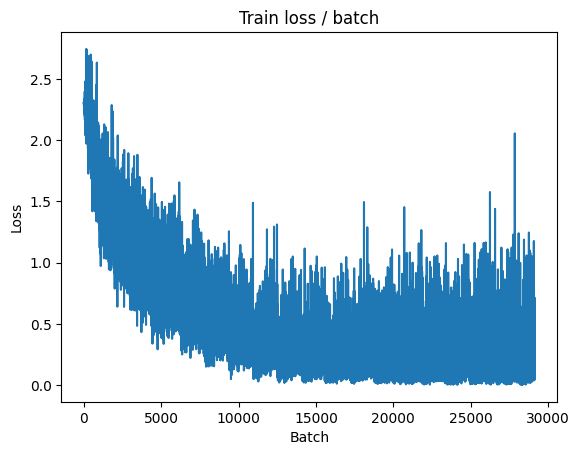

[TRAIN Batch 1200/1563]	Time 0.008s (0.010s)	Loss 0.4690 (0.2850)	Prec@1  84.4 ( 91.6)	Prec@5 100.0 ( 99.9)


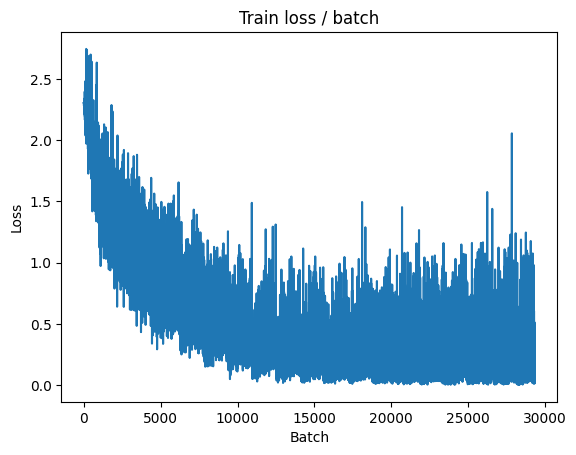

[TRAIN Batch 1400/1563]	Time 0.015s (0.010s)	Loss 0.2920 (0.3051)	Prec@1  87.5 ( 91.0)	Prec@5 100.0 ( 99.9)


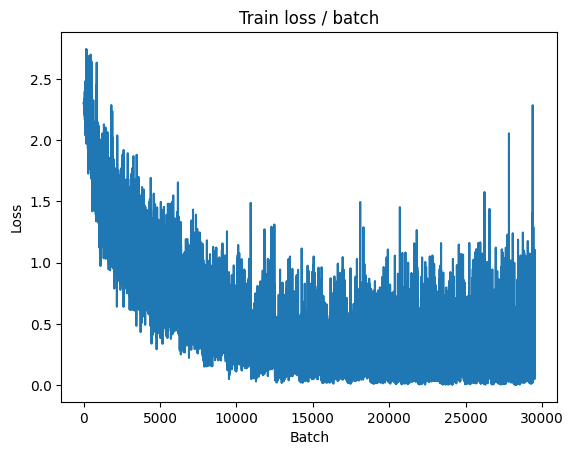


===============> Total time 15s	Avg loss 0.3109	Avg Prec@1 90.86 %	Avg Prec@5 99.86 %

[EVAL Batch 000/313]	Time 0.119s (0.119s)	Loss 1.6559 (1.6559)	Prec@1  65.6 ( 65.6)	Prec@5  96.9 ( 96.9)
[EVAL Batch 200/313]	Time 0.005s (0.007s)	Loss 2.6800 (2.0462)	Prec@1  62.5 ( 65.4)	Prec@5  93.8 ( 95.6)

===============> Total time 2s	Avg loss 2.0422	Avg Prec@1 65.39 %	Avg Prec@5 95.68 %



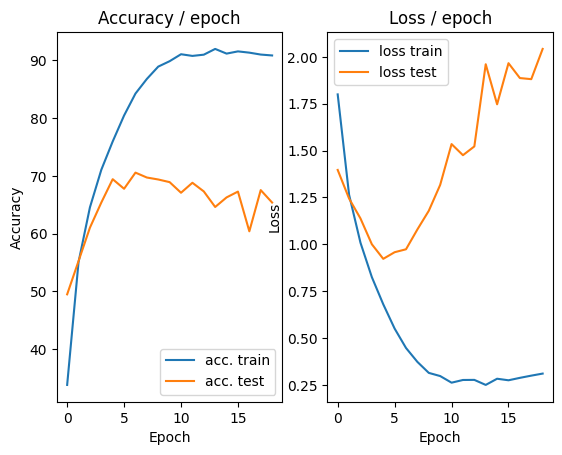

=== EPOCH 20 =====

[TRAIN Batch 000/1563]	Time 0.170s (0.170s)	Loss 0.1665 (0.1665)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


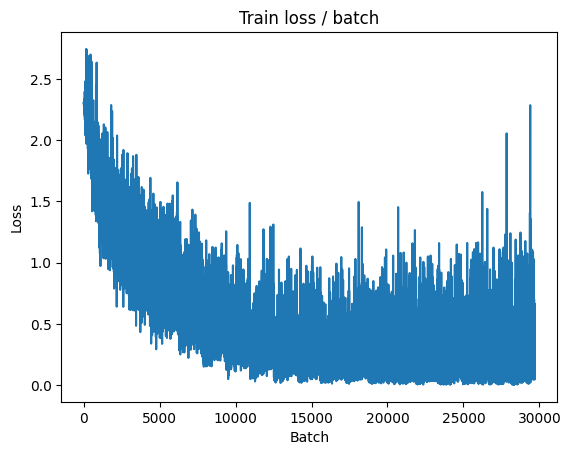

[TRAIN Batch 200/1563]	Time 0.013s (0.010s)	Loss 0.1327 (0.2292)	Prec@1  93.8 ( 93.2)	Prec@5 100.0 ( 99.9)


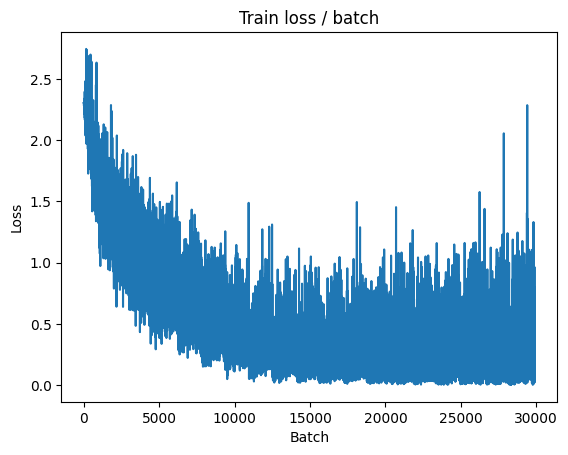

[TRAIN Batch 400/1563]	Time 0.004s (0.009s)	Loss 0.2114 (0.2425)	Prec@1  93.8 ( 92.8)	Prec@5 100.0 ( 99.9)


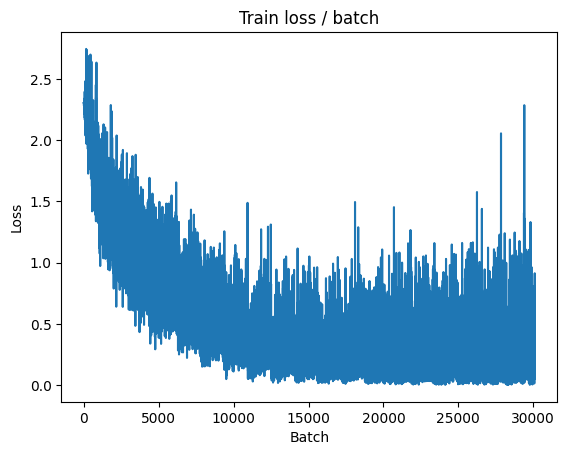

[TRAIN Batch 600/1563]	Time 0.006s (0.009s)	Loss 0.2401 (0.2494)	Prec@1  90.6 ( 92.7)	Prec@5 100.0 ( 99.9)


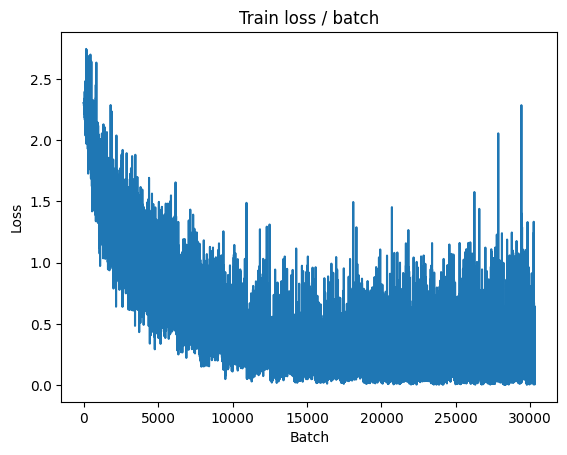

[TRAIN Batch 800/1563]	Time 0.010s (0.009s)	Loss 0.4209 (0.2559)	Prec@1  90.6 ( 92.6)	Prec@5 100.0 ( 99.9)


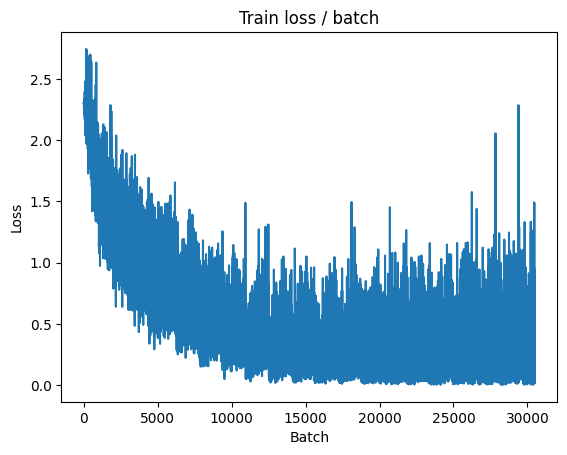

[TRAIN Batch 1000/1563]	Time 0.006s (0.010s)	Loss 0.3954 (0.2705)	Prec@1  87.5 ( 92.2)	Prec@5 100.0 ( 99.9)


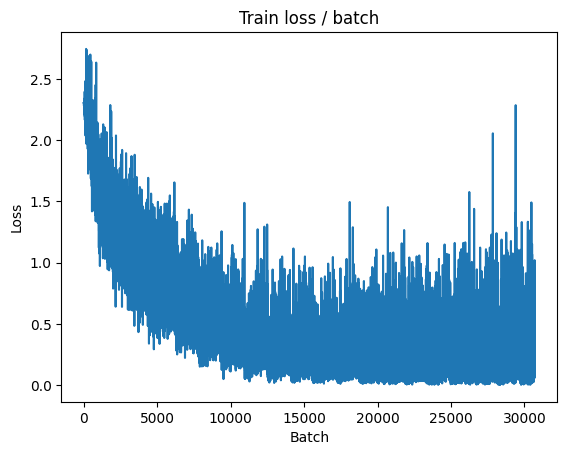

[TRAIN Batch 1200/1563]	Time 0.006s (0.010s)	Loss 0.1724 (0.2852)	Prec@1  93.8 ( 91.8)	Prec@5 100.0 ( 99.9)


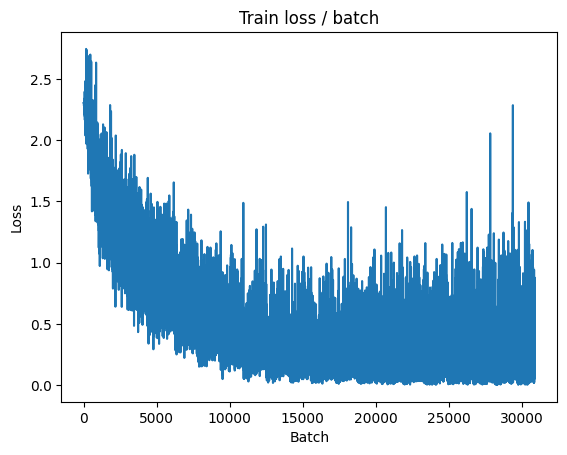

[TRAIN Batch 1400/1563]	Time 0.006s (0.009s)	Loss 0.2824 (0.2962)	Prec@1  90.6 ( 91.6)	Prec@5 100.0 ( 99.9)


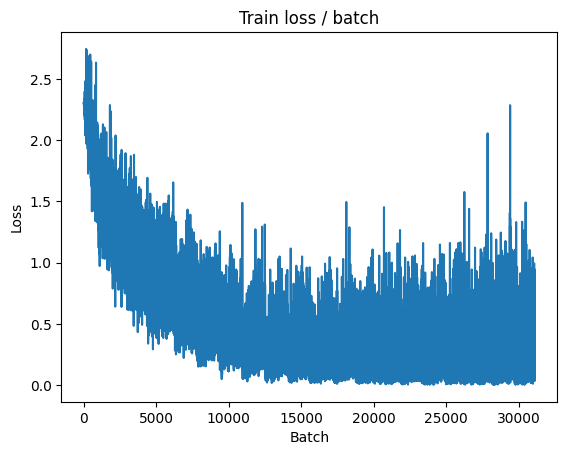


===============> Total time 14s	Avg loss 0.3047	Avg Prec@1 91.23 %	Avg Prec@5 99.86 %

[EVAL Batch 000/313]	Time 0.132s (0.132s)	Loss 1.3177 (1.3177)	Prec@1  75.0 ( 75.0)	Prec@5  96.9 ( 96.9)
[EVAL Batch 200/313]	Time 0.005s (0.007s)	Loss 2.0982 (2.1606)	Prec@1  68.8 ( 66.9)	Prec@5  96.9 ( 95.7)

===============> Total time 2s	Avg loss 2.1596	Avg Prec@1 67.10 %	Avg Prec@5 95.59 %



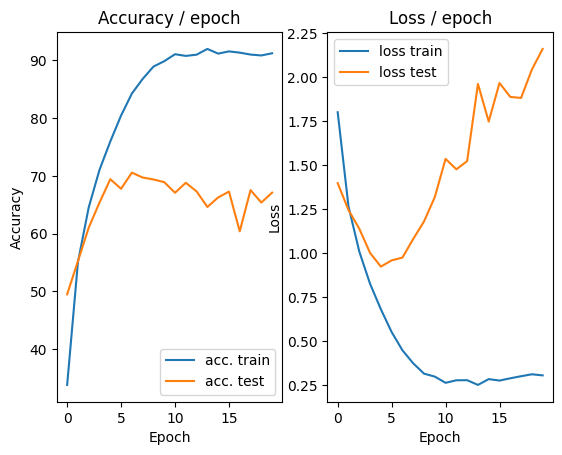

In [28]:
main_cifar(batch_size=32, epochs=20, cuda=True)

### $\eta = 0.01$

=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.176s (0.176s)	Loss 2.2988 (2.2988)	Prec@1  13.3 ( 13.3)	Prec@5  57.8 ( 57.8)


<Figure size 640x480 with 0 Axes>

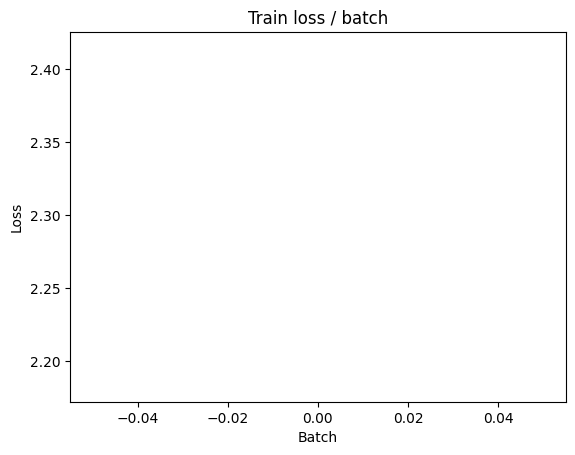

[TRAIN Batch 200/391]	Time 0.027s (0.024s)	Loss 2.2972 (2.3005)	Prec@1  21.9 ( 12.3)	Prec@5  53.1 ( 51.2)


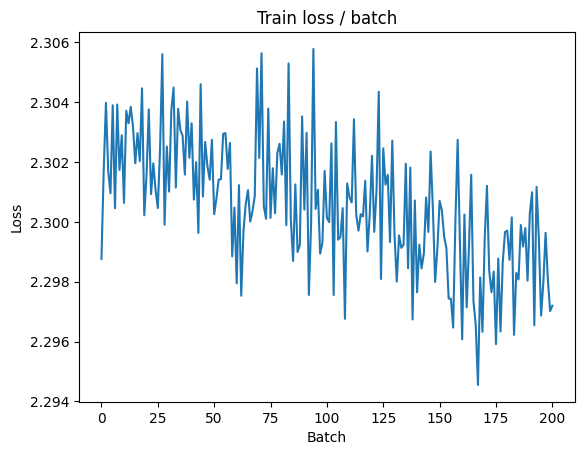


===============> Total time 8s	Avg loss 2.2971	Avg Prec@1 13.05 %	Avg Prec@5 51.82 %

[EVAL Batch 000/079]	Time 0.115s (0.115s)	Loss 2.2854 (2.2854)	Prec@1  11.7 ( 11.7)	Prec@5  48.4 ( 48.4)

===============> Total time 1s	Avg loss 2.2859	Avg Prec@1 12.84 %	Avg Prec@5 52.89 %



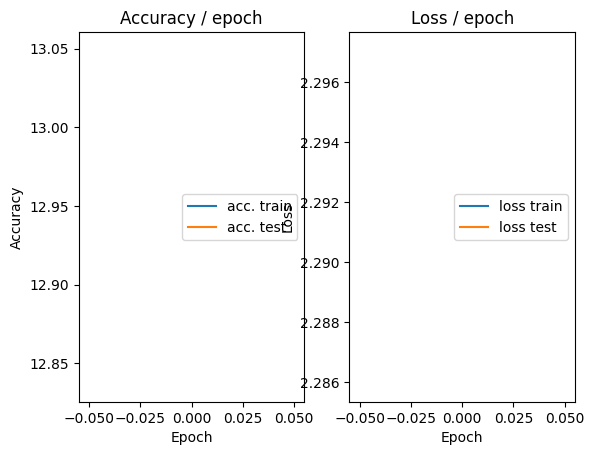

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.133s (0.133s)	Loss 2.2826 (2.2826)	Prec@1  12.5 ( 12.5)	Prec@5  53.9 ( 53.9)


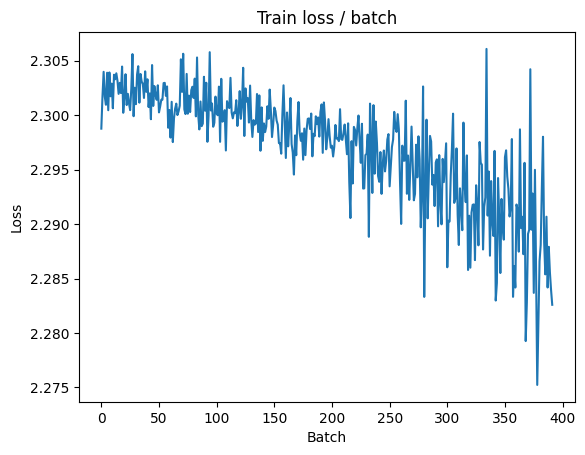

[TRAIN Batch 200/391]	Time 0.047s (0.023s)	Loss 2.2442 (2.2654)	Prec@1  18.8 ( 13.9)	Prec@5  61.7 ( 59.4)


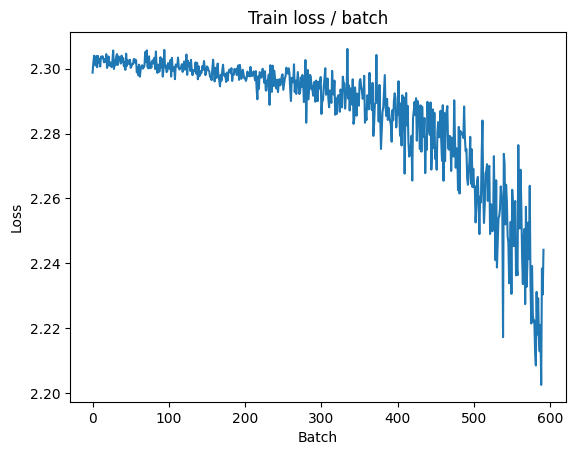


===============> Total time 8s	Avg loss 2.1972	Avg Prec@1 17.75 %	Avg Prec@5 66.79 %

[EVAL Batch 000/079]	Time 0.113s (0.113s)	Loss 2.0664 (2.0664)	Prec@1  27.3 ( 27.3)	Prec@5  75.8 ( 75.8)

===============> Total time 1s	Avg loss 2.0795	Avg Prec@1 22.94 %	Avg Prec@5 73.91 %



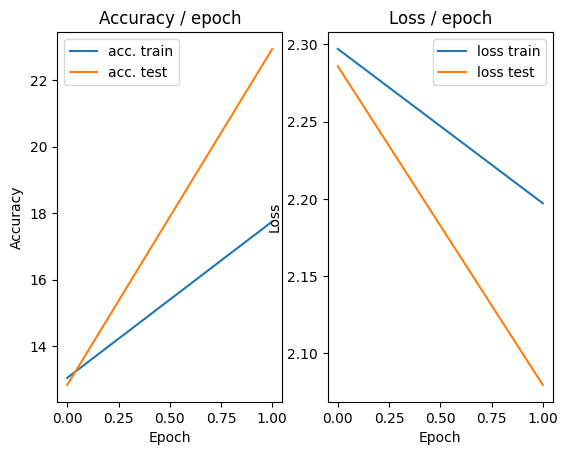

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.135s (0.135s)	Loss 2.0514 (2.0514)	Prec@1  18.8 ( 18.8)	Prec@5  73.4 ( 73.4)


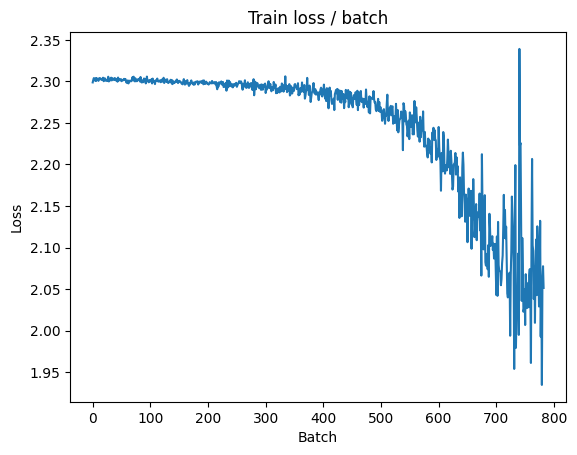

[TRAIN Batch 200/391]	Time 0.012s (0.019s)	Loss 1.9143 (2.0230)	Prec@1  35.9 ( 25.8)	Prec@5  82.0 ( 77.4)


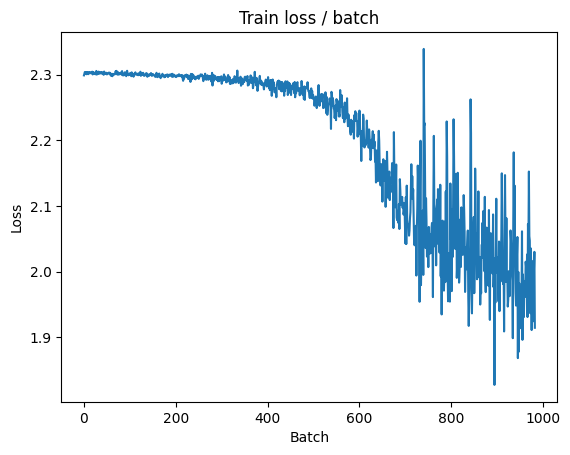


===============> Total time 8s	Avg loss 2.0015	Avg Prec@1 26.67 %	Avg Prec@5 78.26 %

[EVAL Batch 000/079]	Time 0.112s (0.112s)	Loss 1.9300 (1.9300)	Prec@1  35.9 ( 35.9)	Prec@5  83.6 ( 83.6)

===============> Total time 1s	Avg loss 1.9336	Avg Prec@1 29.92 %	Avg Prec@5 80.75 %



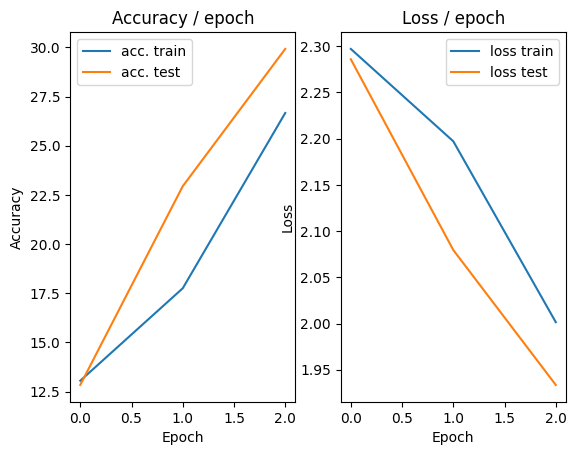

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.139s (0.139s)	Loss 1.9859 (1.9859)	Prec@1  25.0 ( 25.0)	Prec@5  78.9 ( 78.9)


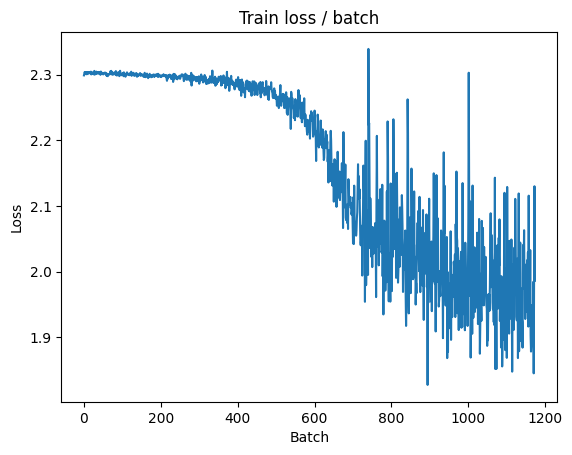

[TRAIN Batch 200/391]	Time 0.019s (0.019s)	Loss 1.9252 (1.9338)	Prec@1  26.6 ( 29.8)	Prec@5  85.2 ( 80.9)


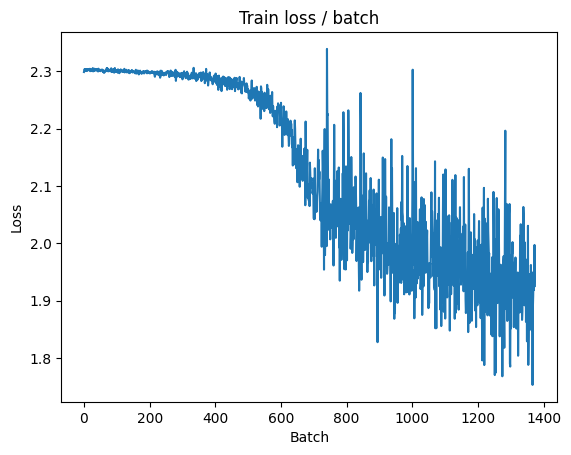


===============> Total time 7s	Avg loss 1.9247	Avg Prec@1 30.59 %	Avg Prec@5 81.00 %

[EVAL Batch 000/079]	Time 0.183s (0.183s)	Loss 1.8901 (1.8901)	Prec@1  26.6 ( 26.6)	Prec@5  85.2 ( 85.2)

===============> Total time 2s	Avg loss 1.8703	Avg Prec@1 32.70 %	Avg Prec@5 82.89 %



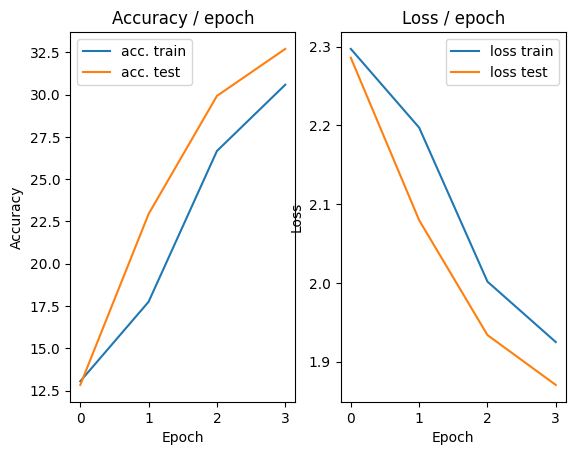

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.137s (0.137s)	Loss 1.9397 (1.9397)	Prec@1  27.3 ( 27.3)	Prec@5  83.6 ( 83.6)


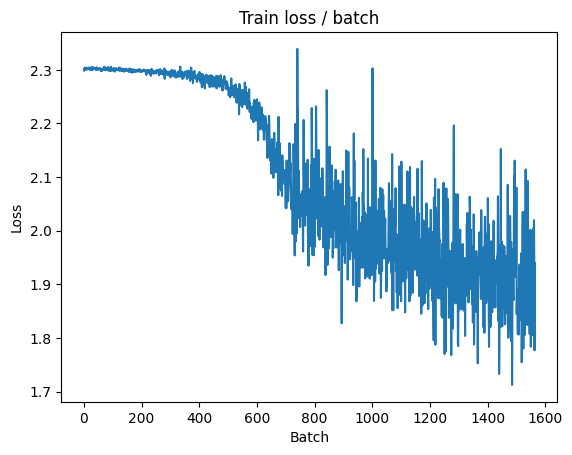

[TRAIN Batch 200/391]	Time 0.024s (0.020s)	Loss 1.8767 (1.8684)	Prec@1  36.7 ( 33.2)	Prec@5  85.9 ( 83.2)


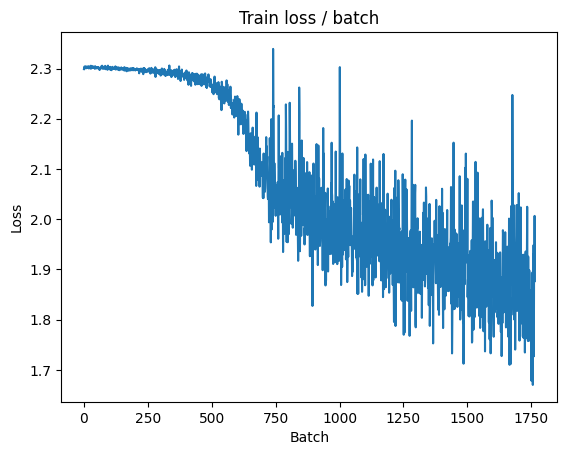


===============> Total time 7s	Avg loss 1.8471	Avg Prec@1 34.03 %	Avg Prec@5 83.84 %

[EVAL Batch 000/079]	Time 0.112s (0.112s)	Loss 1.7672 (1.7672)	Prec@1  39.8 ( 39.8)	Prec@5  87.5 ( 87.5)

===============> Total time 1s	Avg loss 1.7732	Avg Prec@1 37.51 %	Avg Prec@5 85.51 %



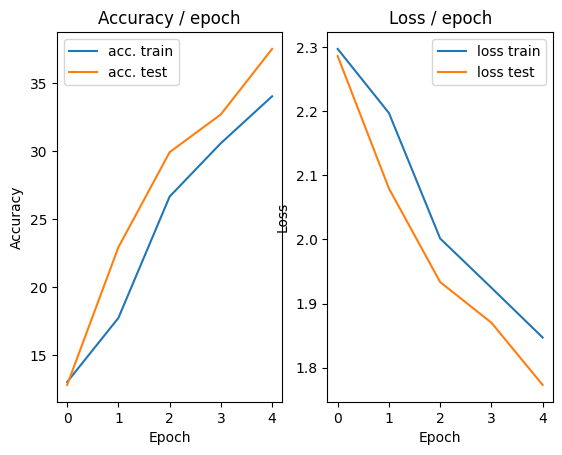

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.159s (0.159s)	Loss 1.7771 (1.7771)	Prec@1  38.3 ( 38.3)	Prec@5  89.8 ( 89.8)


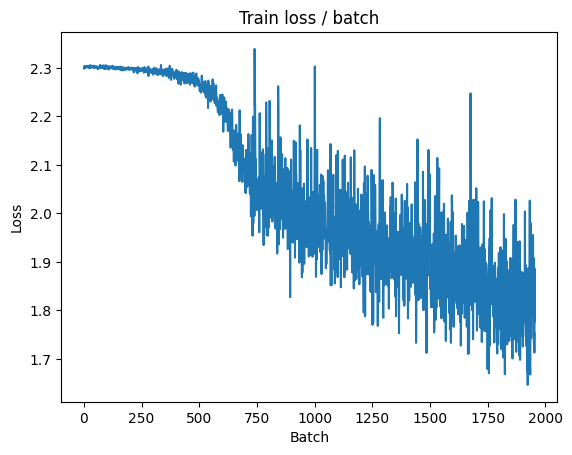

[TRAIN Batch 200/391]	Time 0.024s (0.024s)	Loss 1.5807 (1.7707)	Prec@1  43.8 ( 36.6)	Prec@5  92.2 ( 85.9)


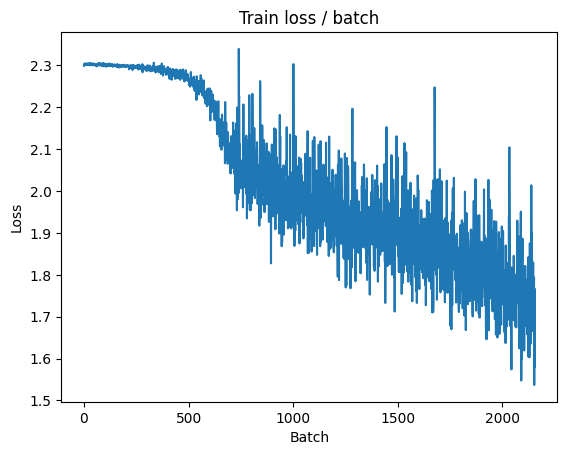


===============> Total time 8s	Avg loss 1.7548	Avg Prec@1 37.31 %	Avg Prec@5 86.11 %

[EVAL Batch 000/079]	Time 0.122s (0.122s)	Loss 1.7162 (1.7162)	Prec@1  40.6 ( 40.6)	Prec@5  87.5 ( 87.5)

===============> Total time 1s	Avg loss 1.7505	Avg Prec@1 37.76 %	Avg Prec@5 85.32 %



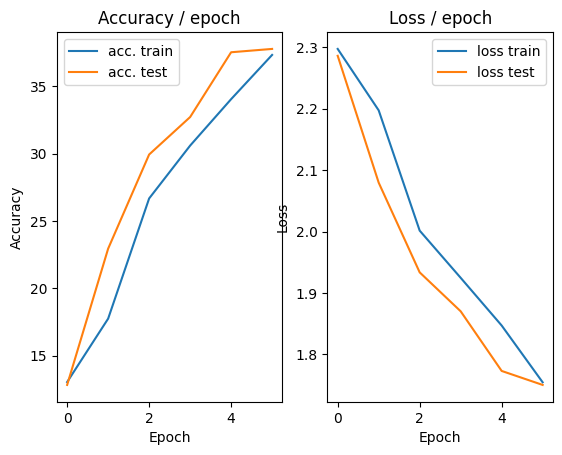

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.175s (0.175s)	Loss 1.7389 (1.7389)	Prec@1  39.8 ( 39.8)	Prec@5  82.8 ( 82.8)


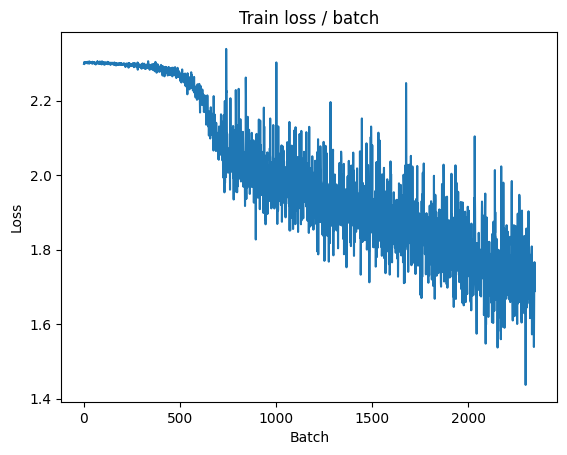

[TRAIN Batch 200/391]	Time 0.014s (0.023s)	Loss 1.6650 (1.6856)	Prec@1  34.4 ( 39.2)	Prec@5  91.4 ( 88.1)


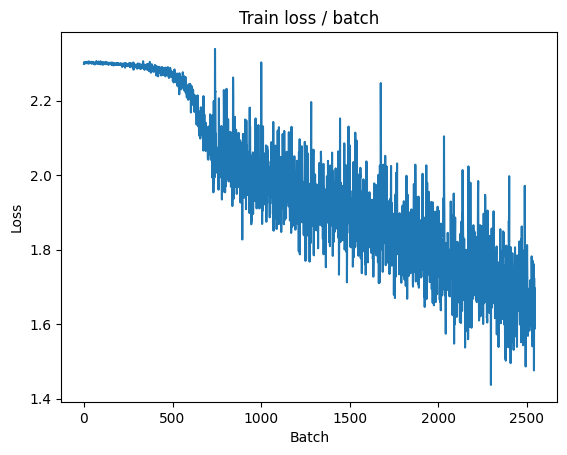


===============> Total time 8s	Avg loss 1.6772	Avg Prec@1 39.72 %	Avg Prec@5 88.17 %

[EVAL Batch 000/079]	Time 0.125s (0.125s)	Loss 1.5656 (1.5656)	Prec@1  39.1 ( 39.1)	Prec@5  90.6 ( 90.6)

===============> Total time 1s	Avg loss 1.6100	Avg Prec@1 41.23 %	Avg Prec@5 89.69 %



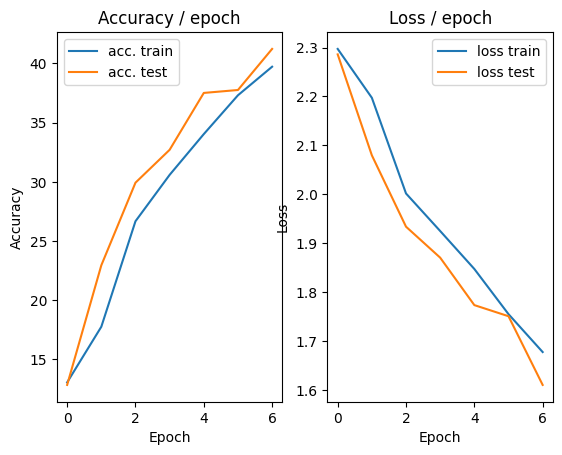

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.153s (0.153s)	Loss 1.5797 (1.5797)	Prec@1  35.2 ( 35.2)	Prec@5  89.8 ( 89.8)


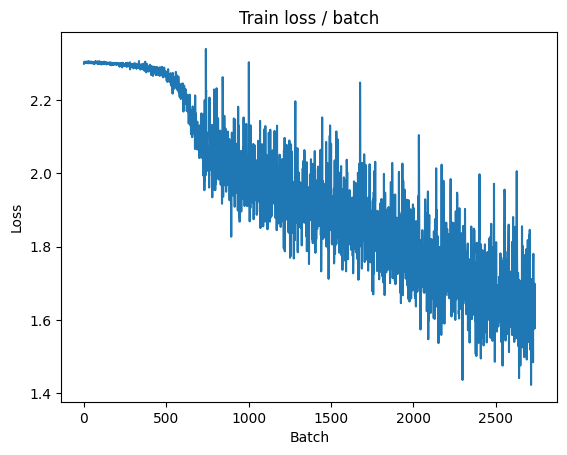

[TRAIN Batch 200/391]	Time 0.012s (0.020s)	Loss 1.6115 (1.6217)	Prec@1  38.3 ( 41.8)	Prec@5  95.3 ( 89.4)


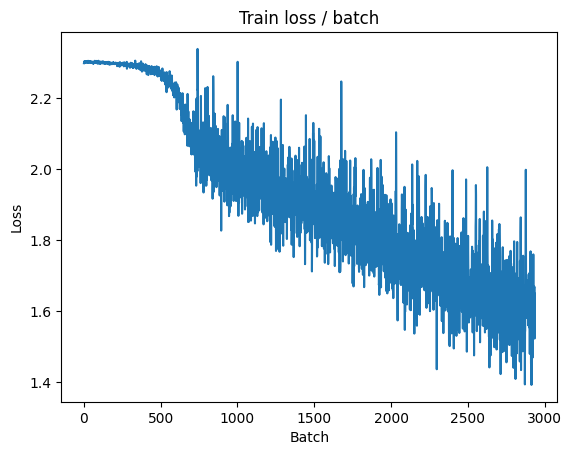


===============> Total time 8s	Avg loss 1.6088	Avg Prec@1 42.35 %	Avg Prec@5 89.61 %

[EVAL Batch 000/079]	Time 0.120s (0.120s)	Loss 1.4967 (1.4967)	Prec@1  50.0 ( 50.0)	Prec@5  90.6 ( 90.6)

===============> Total time 1s	Avg loss 1.5613	Avg Prec@1 44.13 %	Avg Prec@5 90.09 %



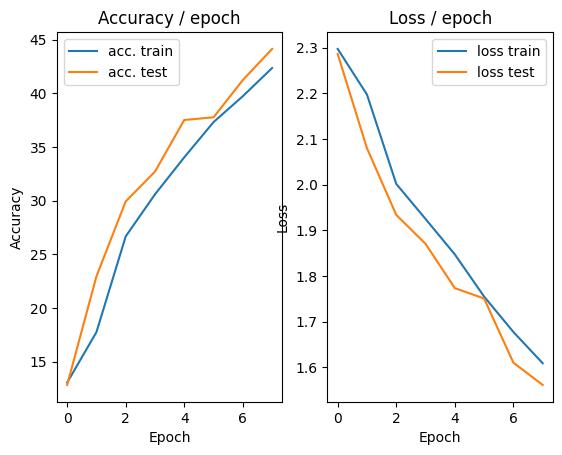

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.140s (0.140s)	Loss 1.5126 (1.5126)	Prec@1  36.7 ( 36.7)	Prec@5  95.3 ( 95.3)


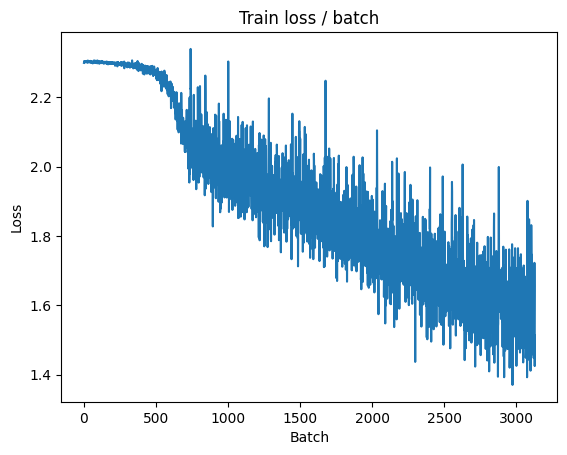

[TRAIN Batch 200/391]	Time 0.013s (0.020s)	Loss 1.4407 (1.5771)	Prec@1  47.7 ( 43.4)	Prec@5  91.4 ( 90.2)


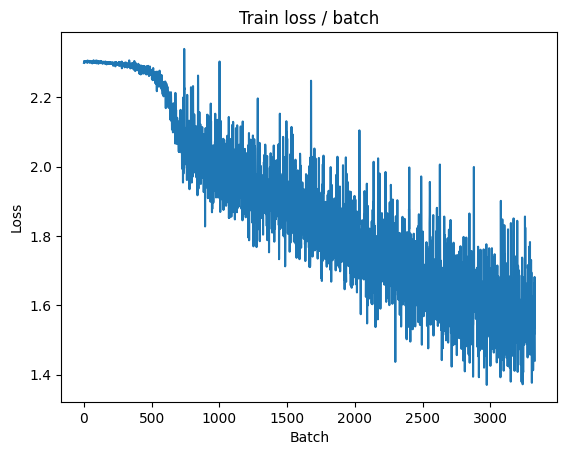


===============> Total time 7s	Avg loss 1.5507	Avg Prec@1 44.17 %	Avg Prec@5 90.65 %

[EVAL Batch 000/079]	Time 0.145s (0.145s)	Loss 1.4471 (1.4471)	Prec@1  50.8 ( 50.8)	Prec@5  90.6 ( 90.6)

===============> Total time 2s	Avg loss 1.4966	Avg Prec@1 46.10 %	Avg Prec@5 91.39 %



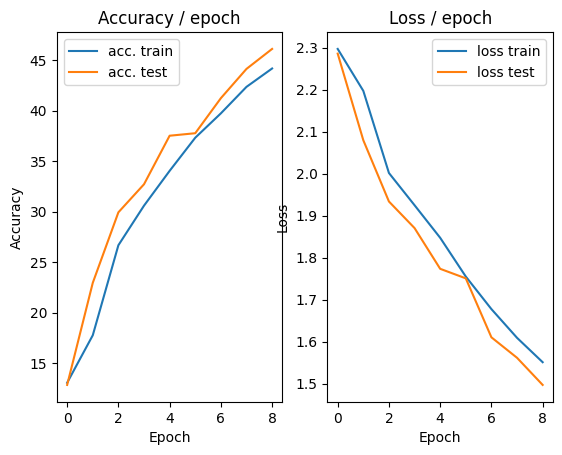

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.145s (0.145s)	Loss 1.5857 (1.5857)	Prec@1  46.1 ( 46.1)	Prec@5  85.9 ( 85.9)


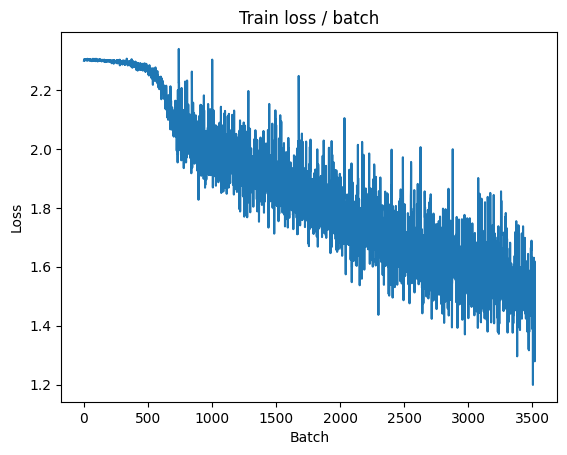

[TRAIN Batch 200/391]	Time 0.022s (0.020s)	Loss 1.5149 (1.5103)	Prec@1  47.7 ( 45.7)	Prec@5  87.5 ( 91.4)


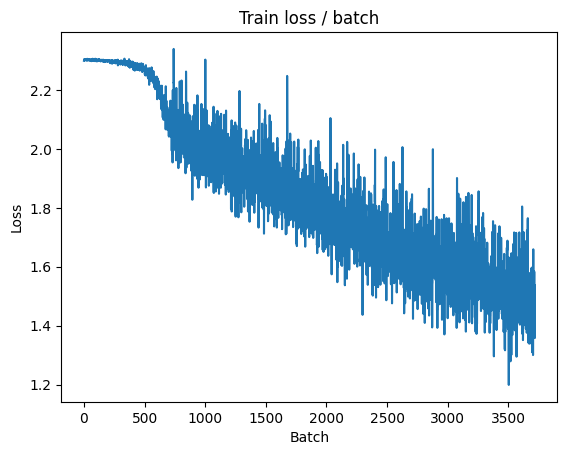


===============> Total time 7s	Avg loss 1.4978	Avg Prec@1 46.42 %	Avg Prec@5 91.49 %

[EVAL Batch 000/079]	Time 0.127s (0.127s)	Loss 1.4626 (1.4626)	Prec@1  43.8 ( 43.8)	Prec@5  93.0 ( 93.0)

===============> Total time 1s	Avg loss 1.5312	Avg Prec@1 44.18 %	Avg Prec@5 90.93 %



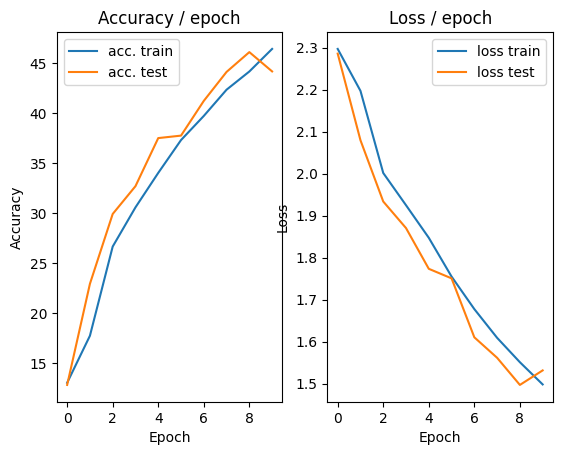

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.144s (0.144s)	Loss 1.3546 (1.3546)	Prec@1  53.9 ( 53.9)	Prec@5  93.0 ( 93.0)


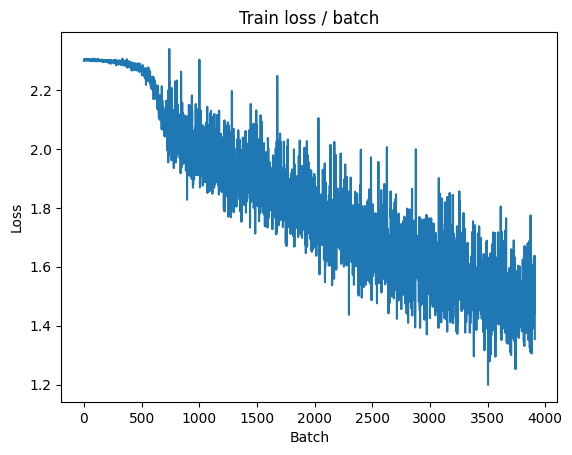

[TRAIN Batch 200/391]	Time 0.030s (0.025s)	Loss 1.3599 (1.4720)	Prec@1  52.3 ( 47.4)	Prec@5  92.2 ( 92.0)


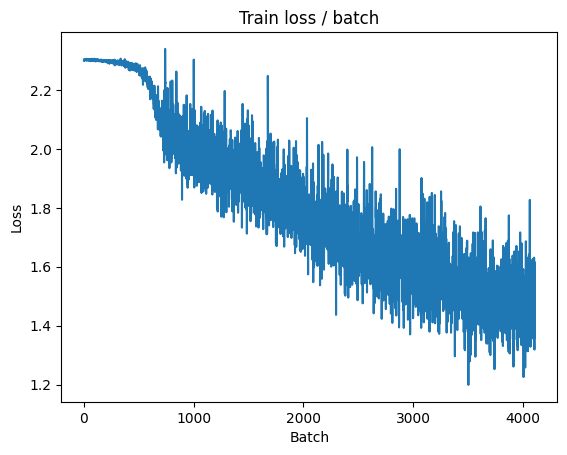


===============> Total time 8s	Avg loss 1.4594	Avg Prec@1 47.85 %	Avg Prec@5 92.13 %

[EVAL Batch 000/079]	Time 0.124s (0.124s)	Loss 1.3759 (1.3759)	Prec@1  53.1 ( 53.1)	Prec@5  91.4 ( 91.4)

===============> Total time 1s	Avg loss 1.4569	Avg Prec@1 46.74 %	Avg Prec@5 91.95 %



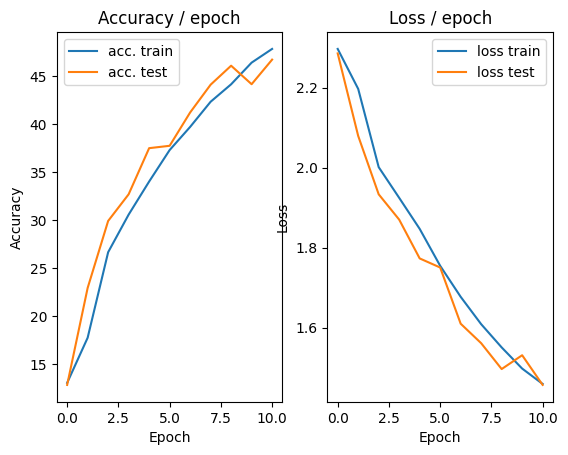

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.174s (0.174s)	Loss 1.5493 (1.5493)	Prec@1  50.8 ( 50.8)	Prec@5  90.6 ( 90.6)


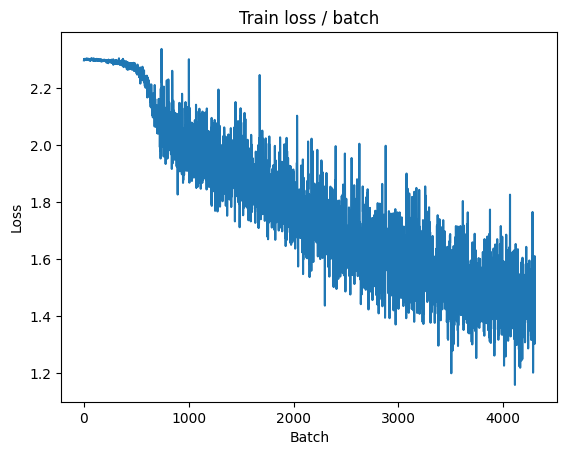

[TRAIN Batch 200/391]	Time 0.062s (0.025s)	Loss 1.3945 (1.4339)	Prec@1  48.4 ( 49.1)	Prec@5  91.4 ( 92.3)


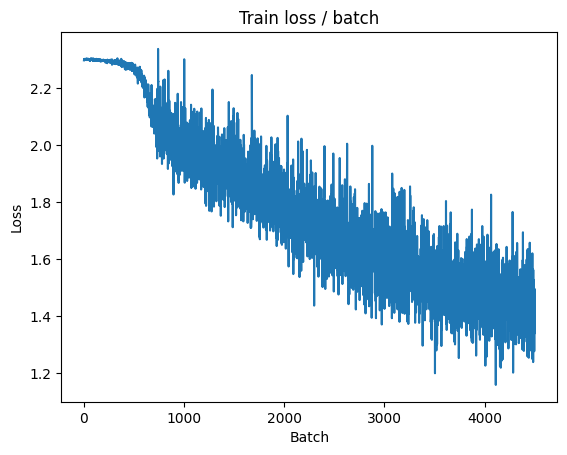


===============> Total time 8s	Avg loss 1.4243	Avg Prec@1 49.32 %	Avg Prec@5 92.49 %

[EVAL Batch 000/079]	Time 0.116s (0.116s)	Loss 1.3344 (1.3344)	Prec@1  57.0 ( 57.0)	Prec@5  91.4 ( 91.4)

===============> Total time 1s	Avg loss 1.3952	Avg Prec@1 49.89 %	Avg Prec@5 92.94 %



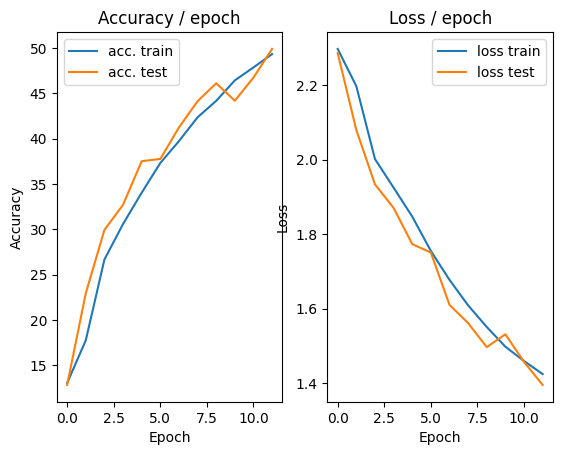

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.154s (0.154s)	Loss 1.4910 (1.4910)	Prec@1  48.4 ( 48.4)	Prec@5  89.8 ( 89.8)


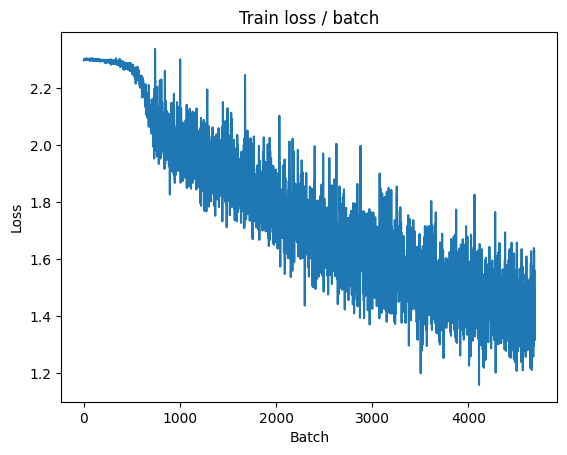

[TRAIN Batch 200/391]	Time 0.020s (0.019s)	Loss 1.4146 (1.4042)	Prec@1  47.7 ( 50.2)	Prec@5  93.0 ( 92.5)


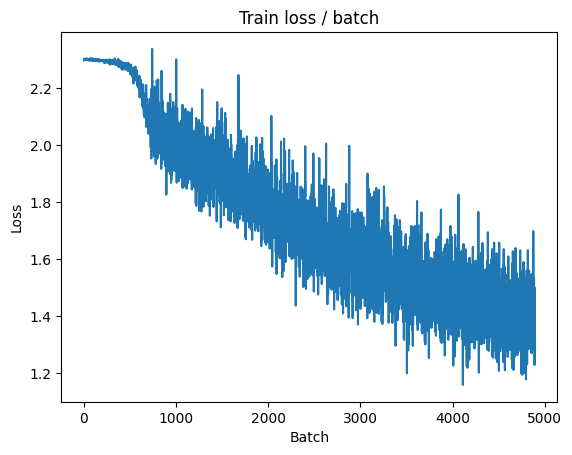


===============> Total time 8s	Avg loss 1.3923	Avg Prec@1 50.60 %	Avg Prec@5 92.76 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 1.3016 (1.3016)	Prec@1  58.6 ( 58.6)	Prec@5  92.2 ( 92.2)

===============> Total time 1s	Avg loss 1.3933	Avg Prec@1 49.30 %	Avg Prec@5 92.83 %



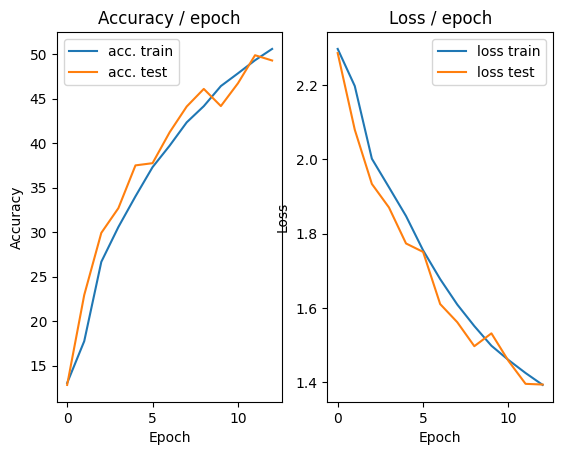

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.163s (0.163s)	Loss 1.3583 (1.3583)	Prec@1  56.2 ( 56.2)	Prec@5  92.2 ( 92.2)


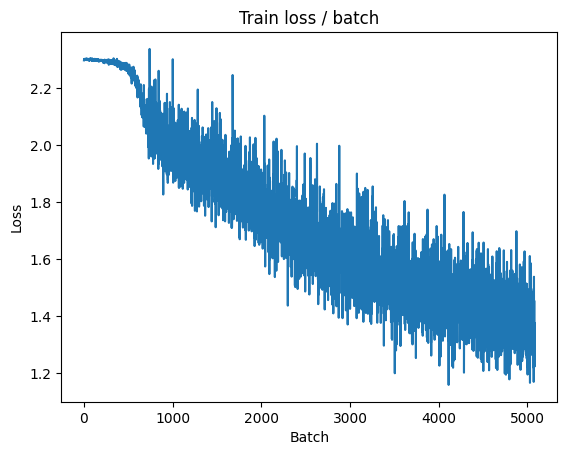

[TRAIN Batch 200/391]	Time 0.011s (0.020s)	Loss 1.4757 (1.3619)	Prec@1  46.9 ( 51.6)	Prec@5  93.0 ( 93.3)


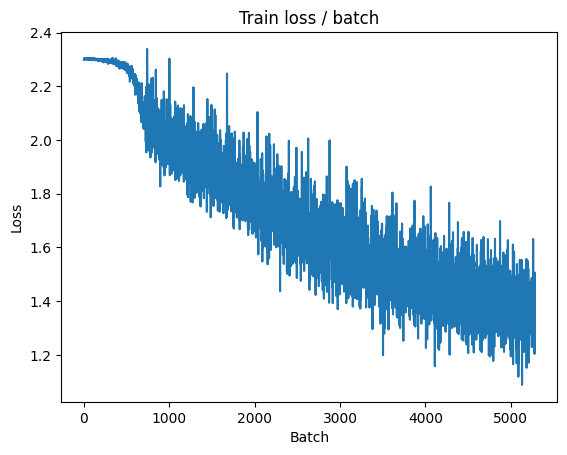


===============> Total time 7s	Avg loss 1.3607	Avg Prec@1 51.61 %	Avg Prec@5 93.30 %

[EVAL Batch 000/079]	Time 0.159s (0.159s)	Loss 1.2916 (1.2916)	Prec@1  54.7 ( 54.7)	Prec@5  93.0 ( 93.0)

===============> Total time 1s	Avg loss 1.3658	Avg Prec@1 50.66 %	Avg Prec@5 93.27 %



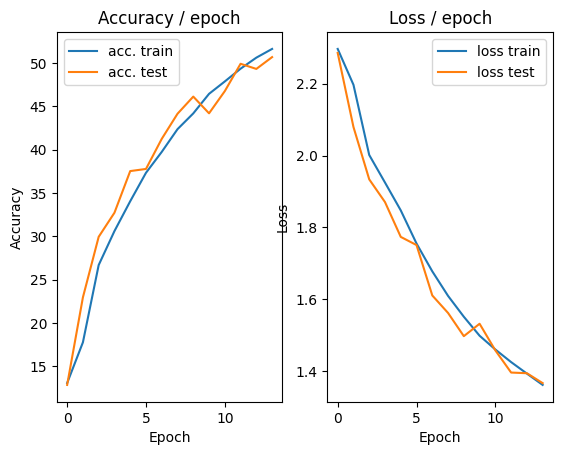

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.146s (0.146s)	Loss 1.2600 (1.2600)	Prec@1  57.8 ( 57.8)	Prec@5  93.8 ( 93.8)


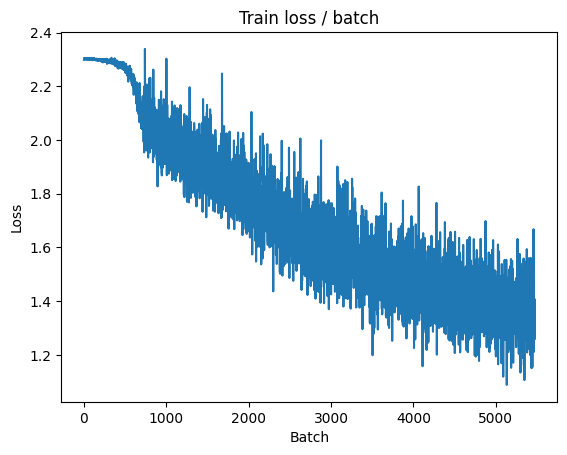

[TRAIN Batch 200/391]	Time 0.029s (0.020s)	Loss 1.3454 (1.3375)	Prec@1  53.1 ( 52.3)	Prec@5  90.6 ( 93.4)


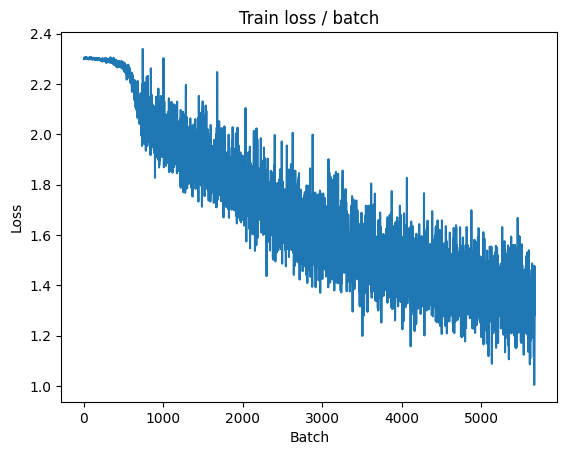


===============> Total time 7s	Avg loss 1.3308	Avg Prec@1 52.74 %	Avg Prec@5 93.61 %

[EVAL Batch 000/079]	Time 0.129s (0.129s)	Loss 1.3458 (1.3458)	Prec@1  49.2 ( 49.2)	Prec@5  92.2 ( 92.2)

===============> Total time 1s	Avg loss 1.3929	Avg Prec@1 49.55 %	Avg Prec@5 92.88 %



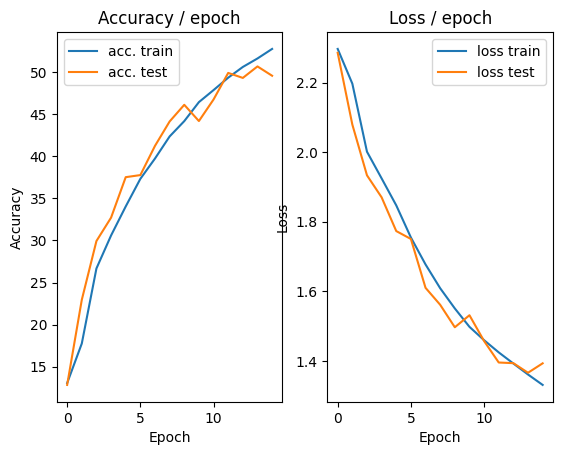

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.225s (0.225s)	Loss 1.4165 (1.4165)	Prec@1  48.4 ( 48.4)	Prec@5  93.0 ( 93.0)


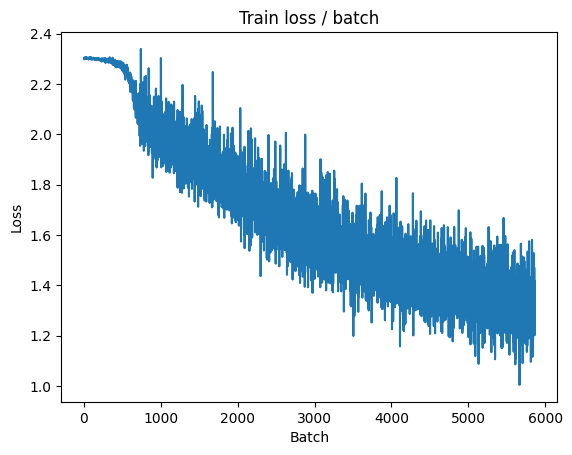

[TRAIN Batch 200/391]	Time 0.016s (0.025s)	Loss 1.4549 (1.3014)	Prec@1  52.3 ( 53.8)	Prec@5  91.4 ( 94.0)


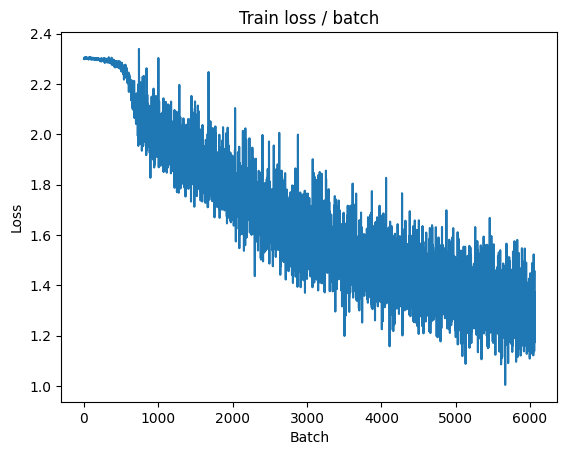


===============> Total time 8s	Avg loss 1.3036	Avg Prec@1 53.61 %	Avg Prec@5 93.93 %

[EVAL Batch 000/079]	Time 0.132s (0.132s)	Loss 1.2218 (1.2218)	Prec@1  60.2 ( 60.2)	Prec@5  93.0 ( 93.0)

===============> Total time 1s	Avg loss 1.3204	Avg Prec@1 53.24 %	Avg Prec@5 93.59 %



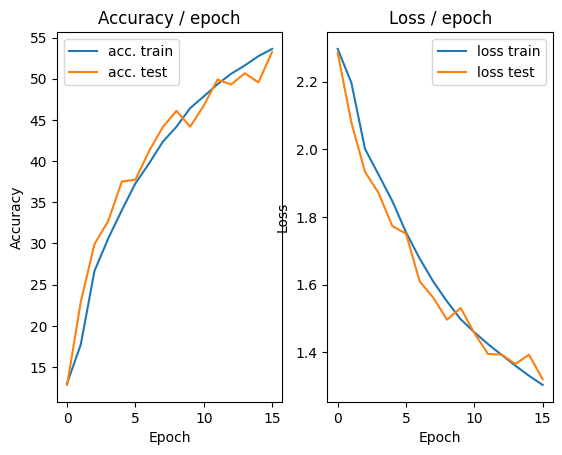

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.163s (0.163s)	Loss 1.2195 (1.2195)	Prec@1  60.2 ( 60.2)	Prec@5  89.8 ( 89.8)


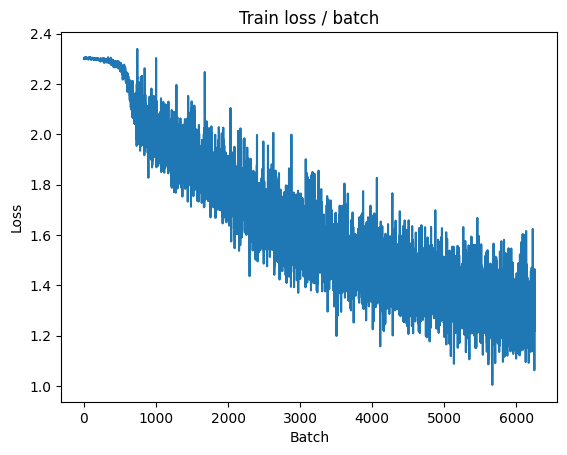

[TRAIN Batch 200/391]	Time 0.030s (0.025s)	Loss 1.4530 (1.2791)	Prec@1  43.8 ( 54.7)	Prec@5  89.8 ( 94.3)


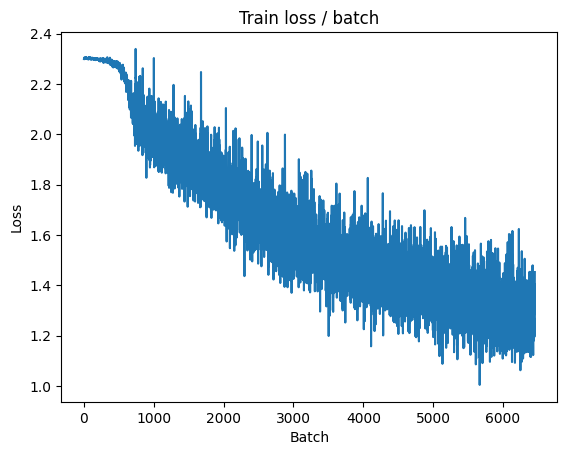


===============> Total time 8s	Avg loss 1.2752	Avg Prec@1 54.79 %	Avg Prec@5 94.27 %

[EVAL Batch 000/079]	Time 0.130s (0.130s)	Loss 1.1672 (1.1672)	Prec@1  60.9 ( 60.9)	Prec@5  94.5 ( 94.5)

===============> Total time 1s	Avg loss 1.2525	Avg Prec@1 55.22 %	Avg Prec@5 94.69 %



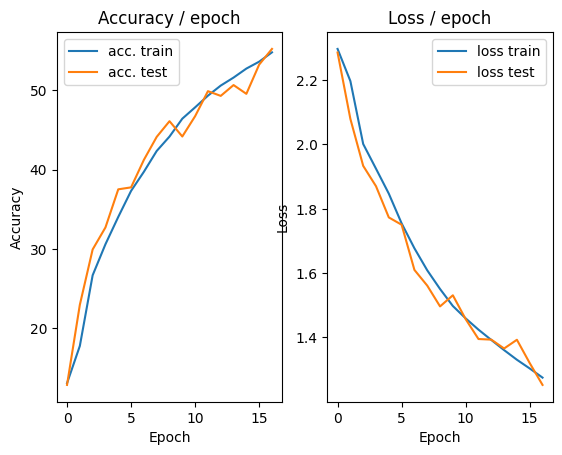

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.170s (0.170s)	Loss 1.2346 (1.2346)	Prec@1  55.5 ( 55.5)	Prec@5  96.1 ( 96.1)


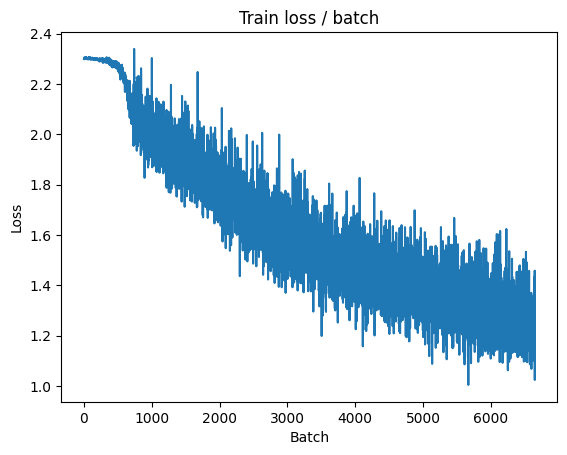

[TRAIN Batch 200/391]	Time 0.017s (0.021s)	Loss 1.2790 (1.2440)	Prec@1  57.8 ( 55.8)	Prec@5  91.4 ( 94.7)


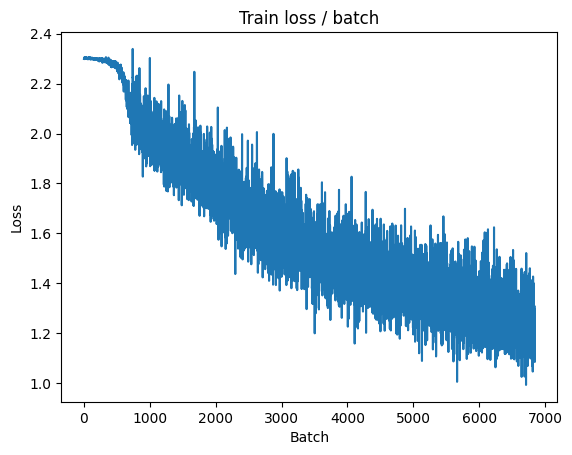


===============> Total time 8s	Avg loss 1.2450	Avg Prec@1 55.91 %	Avg Prec@5 94.60 %

[EVAL Batch 000/079]	Time 0.126s (0.126s)	Loss 1.1347 (1.1347)	Prec@1  67.2 ( 67.2)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.2391	Avg Prec@1 55.86 %	Avg Prec@5 94.80 %



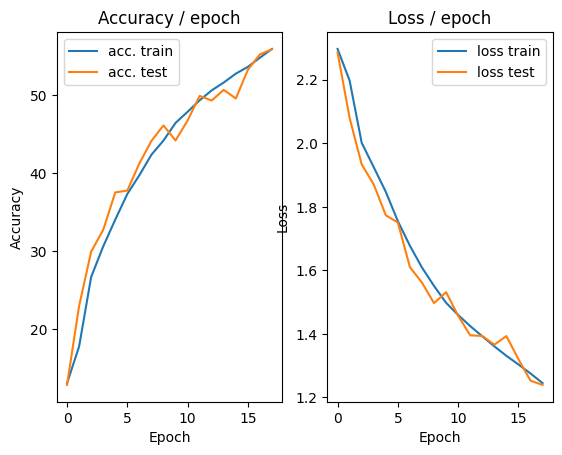

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.166s (0.166s)	Loss 1.1449 (1.1449)	Prec@1  60.2 ( 60.2)	Prec@5  95.3 ( 95.3)


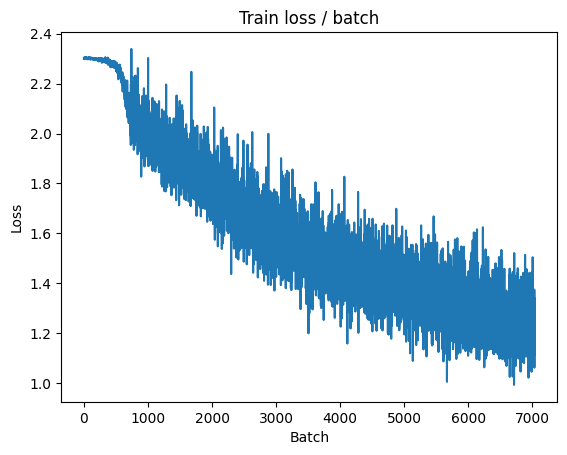

[TRAIN Batch 200/391]	Time 0.008s (0.020s)	Loss 1.3021 (1.2275)	Prec@1  52.3 ( 56.3)	Prec@5  92.2 ( 94.9)


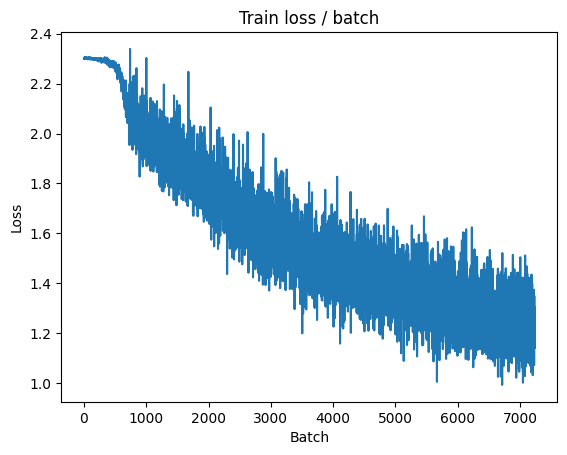


===============> Total time 8s	Avg loss 1.2255	Avg Prec@1 56.47 %	Avg Prec@5 94.90 %

[EVAL Batch 000/079]	Time 0.134s (0.134s)	Loss 1.1992 (1.1992)	Prec@1  59.4 ( 59.4)	Prec@5  91.4 ( 91.4)

===============> Total time 1s	Avg loss 1.2868	Avg Prec@1 53.59 %	Avg Prec@5 94.45 %



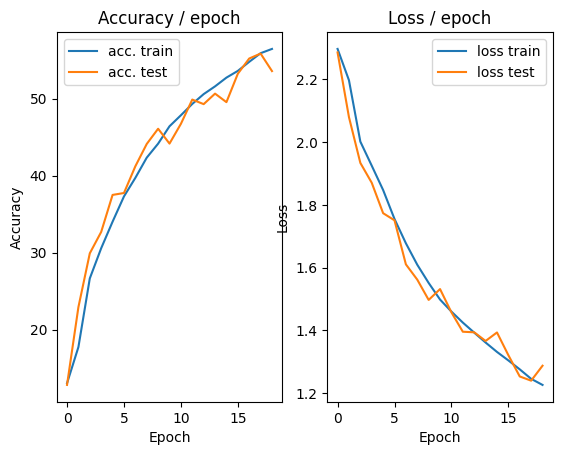

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.204s (0.204s)	Loss 1.2295 (1.2295)	Prec@1  57.8 ( 57.8)	Prec@5  95.3 ( 95.3)


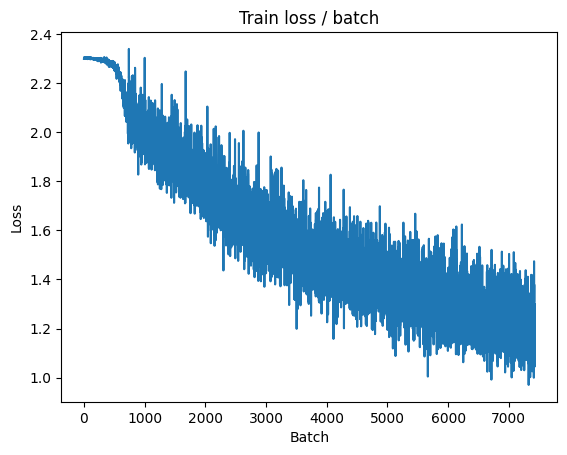

[TRAIN Batch 200/391]	Time 0.009s (0.021s)	Loss 0.9546 (1.1943)	Prec@1  66.4 ( 57.8)	Prec@5  96.9 ( 95.1)


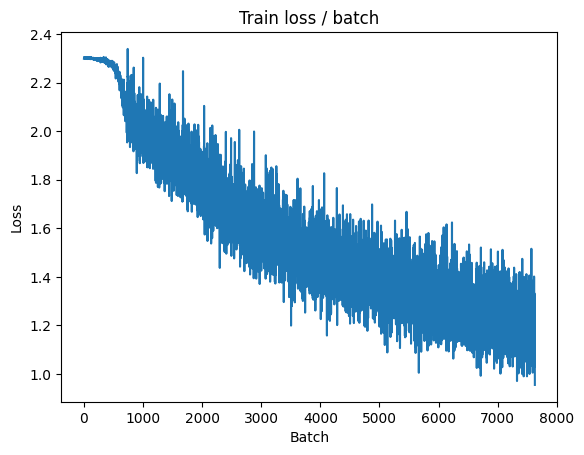


===============> Total time 7s	Avg loss 1.1934	Avg Prec@1 57.75 %	Avg Prec@5 95.06 %

[EVAL Batch 000/079]	Time 0.117s (0.117s)	Loss 1.0985 (1.0985)	Prec@1  65.6 ( 65.6)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.2076	Avg Prec@1 56.86 %	Avg Prec@5 95.23 %



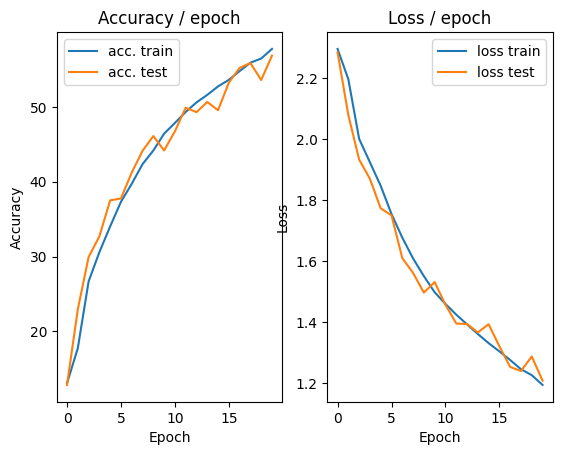

In [29]:
main_cifar(batch_size=128, lr=0.01, epochs=20, cuda=True)

## Standardization of examples


In [9]:
def get_cifar_dataset_standardized(batch_size, cuda=False):
    mean =[0.491, 0.482, 0.447]
    std = [0.202, 0.199, 0.201]
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize(mean, std)
        ]))
    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize(mean, std)
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader

=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.153s (0.153s)	Loss 2.3031 (2.3031)	Prec@1  10.9 ( 10.9)	Prec@5  50.0 ( 50.0)


<Figure size 640x480 with 0 Axes>

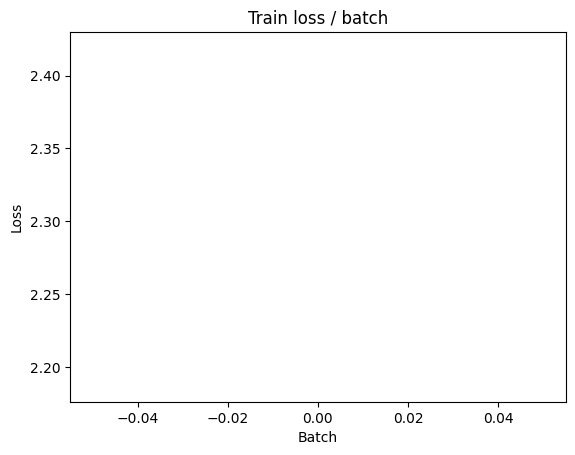

[TRAIN Batch 200/391]	Time 0.047s (0.035s)	Loss 1.5800 (1.9299)	Prec@1  42.2 ( 29.7)	Prec@5  90.6 ( 79.7)


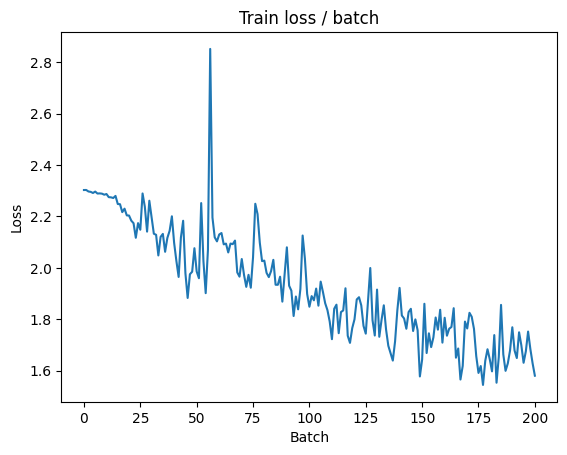


===============> Total time 12s	Avg loss 1.7389	Avg Prec@1 37.22 %	Avg Prec@5 85.23 %

[EVAL Batch 000/079]	Time 0.130s (0.130s)	Loss 1.4442 (1.4442)	Prec@1  51.6 ( 51.6)	Prec@5  93.0 ( 93.0)

===============> Total time 2s	Avg loss 1.4416	Avg Prec@1 48.49 %	Avg Prec@5 93.08 %



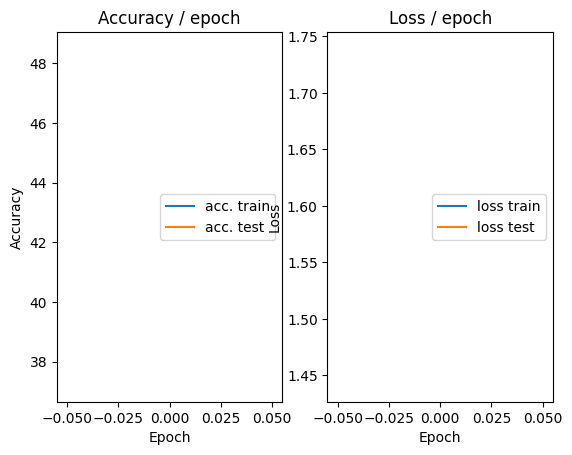

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.156s (0.156s)	Loss 1.2539 (1.2539)	Prec@1  55.5 ( 55.5)	Prec@5  98.4 ( 98.4)


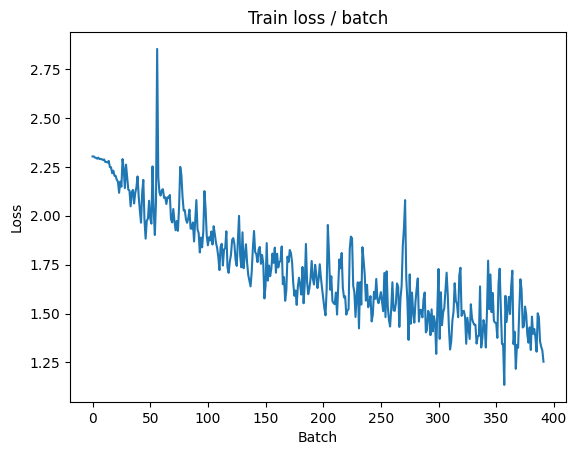

[TRAIN Batch 200/391]	Time 0.010s (0.030s)	Loss 1.3387 (1.3381)	Prec@1  50.0 ( 51.9)	Prec@5  91.4 ( 93.8)


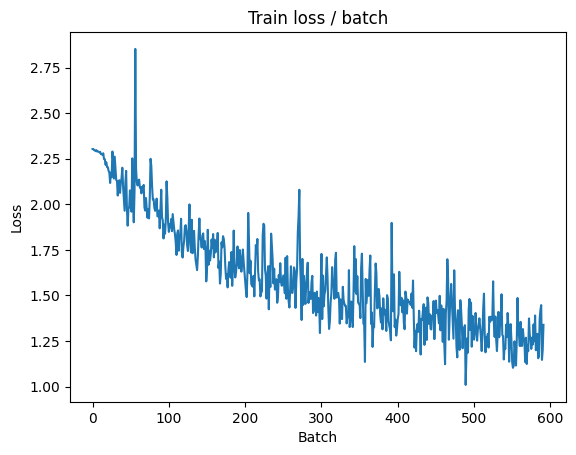


===============> Total time 12s	Avg loss 1.2779	Avg Prec@1 54.47 %	Avg Prec@5 94.49 %

[EVAL Batch 000/079]	Time 0.196s (0.196s)	Loss 1.3537 (1.3537)	Prec@1  50.8 ( 50.8)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 1.3273	Avg Prec@1 52.73 %	Avg Prec@5 94.20 %



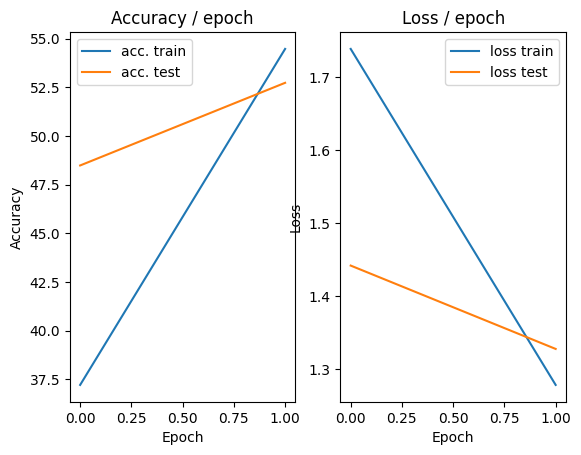

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.157s (0.157s)	Loss 1.3041 (1.3041)	Prec@1  53.9 ( 53.9)	Prec@5  95.3 ( 95.3)


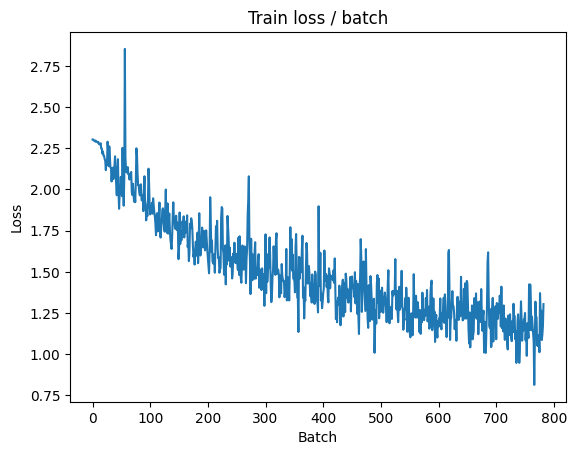

[TRAIN Batch 200/391]	Time 0.013s (0.031s)	Loss 0.9217 (1.0891)	Prec@1  70.3 ( 61.6)	Prec@5  96.1 ( 96.2)


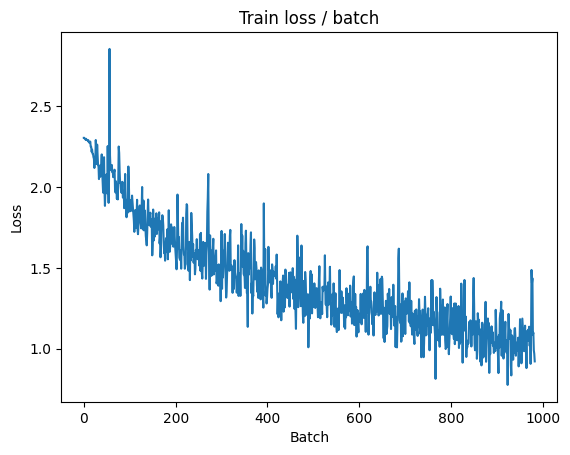


===============> Total time 12s	Avg loss 1.0494	Avg Prec@1 63.18 %	Avg Prec@5 96.43 %

[EVAL Batch 000/079]	Time 0.133s (0.133s)	Loss 0.8874 (0.8874)	Prec@1  68.8 ( 68.8)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.9778	Avg Prec@1 65.75 %	Avg Prec@5 96.88 %



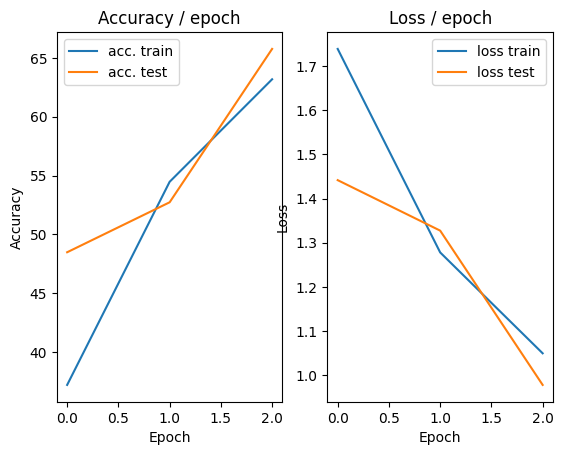

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.155s (0.155s)	Loss 0.9700 (0.9700)	Prec@1  67.2 ( 67.2)	Prec@5  97.7 ( 97.7)


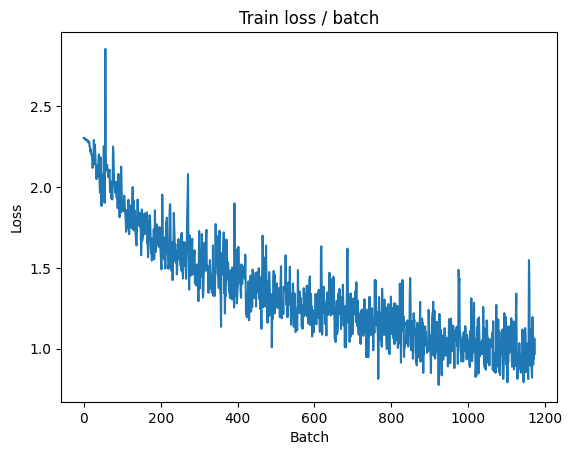

[TRAIN Batch 200/391]	Time 0.071s (0.033s)	Loss 0.8533 (0.8874)	Prec@1  69.5 ( 68.9)	Prec@5  99.2 ( 97.5)


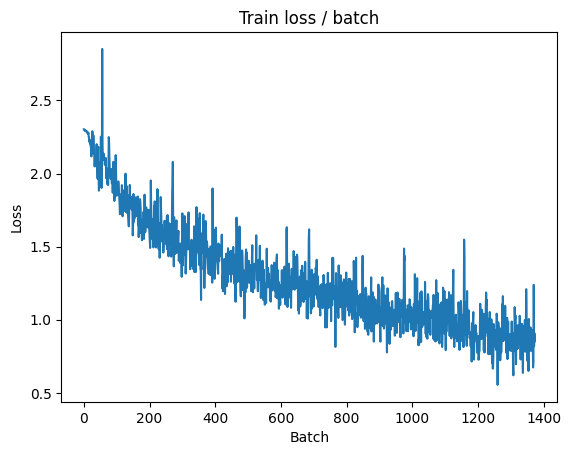


===============> Total time 14s	Avg loss 0.8661	Avg Prec@1 69.65 %	Avg Prec@5 97.66 %

[EVAL Batch 000/079]	Time 0.152s (0.152s)	Loss 0.7994 (0.7994)	Prec@1  74.2 ( 74.2)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9178	Avg Prec@1 68.54 %	Avg Prec@5 97.26 %



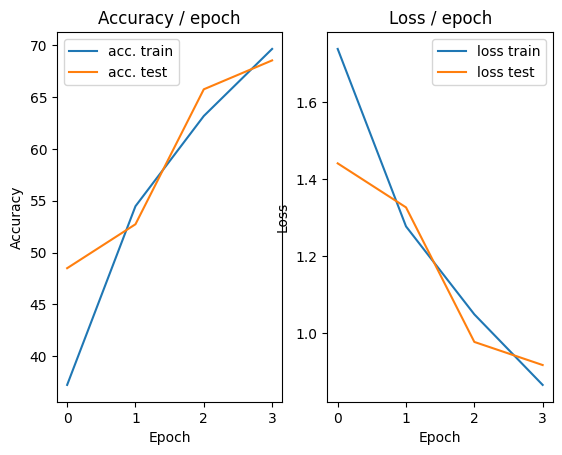

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.162s (0.162s)	Loss 0.7373 (0.7373)	Prec@1  72.7 ( 72.7)	Prec@5  99.2 ( 99.2)


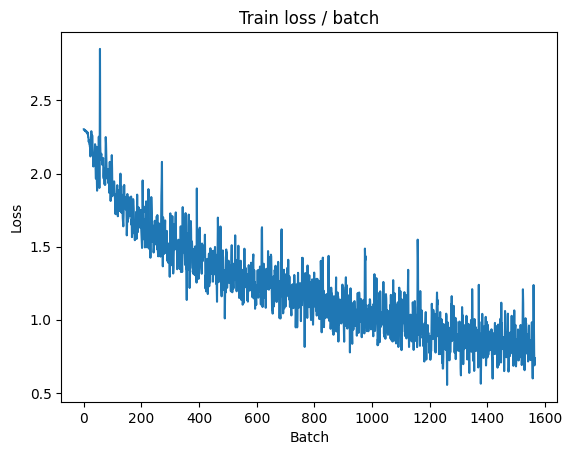

[TRAIN Batch 200/391]	Time 0.012s (0.035s)	Loss 0.7729 (0.7327)	Prec@1  77.3 ( 74.4)	Prec@5  99.2 ( 98.5)


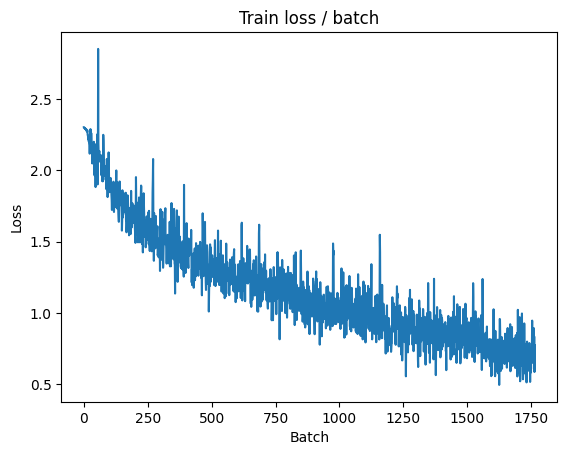


===============> Total time 12s	Avg loss 0.7309	Avg Prec@1 74.48 %	Avg Prec@5 98.48 %

[EVAL Batch 000/079]	Time 0.131s (0.131s)	Loss 0.7227 (0.7227)	Prec@1  74.2 ( 74.2)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.8334	Avg Prec@1 71.19 %	Avg Prec@5 97.75 %



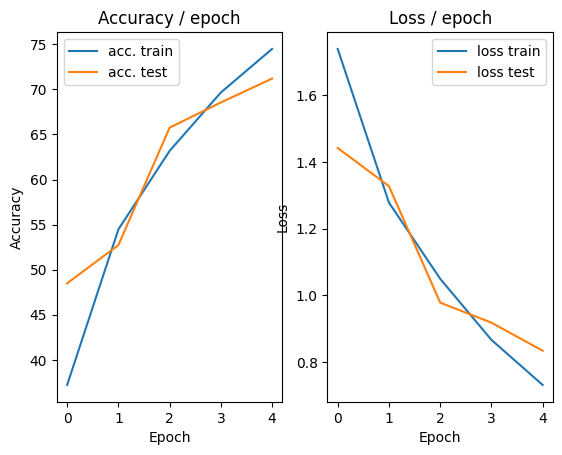

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.196s (0.196s)	Loss 0.6988 (0.6988)	Prec@1  75.0 ( 75.0)	Prec@5  99.2 ( 99.2)


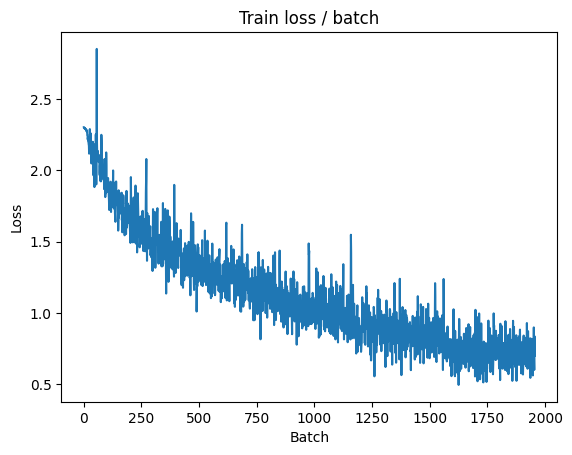

[TRAIN Batch 200/391]	Time 0.011s (0.032s)	Loss 0.5592 (0.6094)	Prec@1  77.3 ( 78.7)	Prec@5  99.2 ( 98.9)


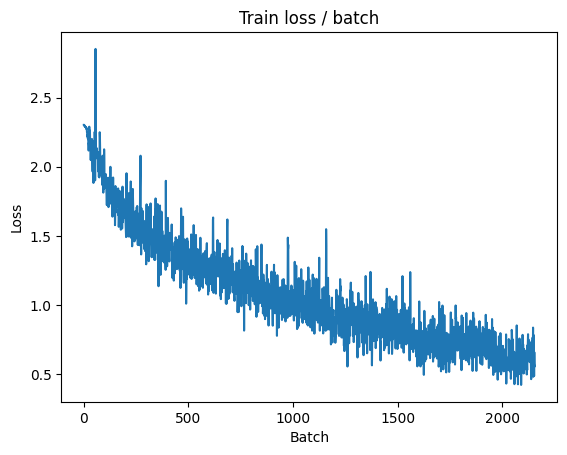


===============> Total time 12s	Avg loss 0.6072	Avg Prec@1 78.80 %	Avg Prec@5 98.96 %

[EVAL Batch 000/079]	Time 0.195s (0.195s)	Loss 0.8106 (0.8106)	Prec@1  70.3 ( 70.3)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.8499	Avg Prec@1 71.31 %	Avg Prec@5 97.38 %



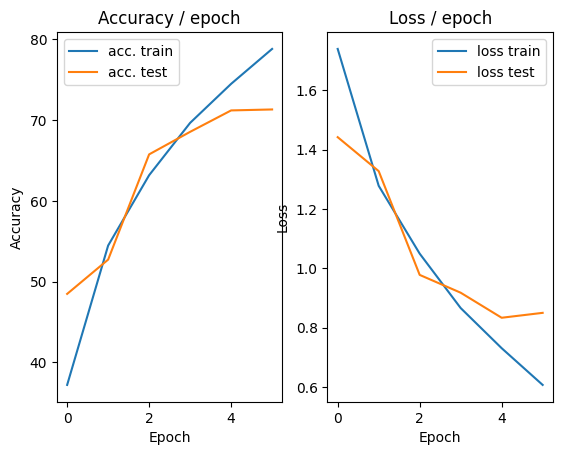

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.185s (0.185s)	Loss 0.5621 (0.5621)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)


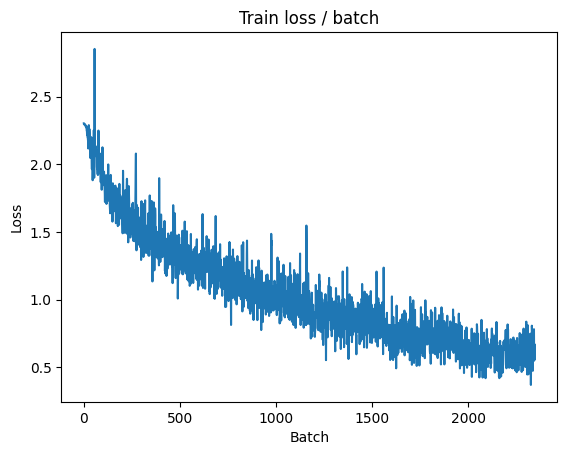

[TRAIN Batch 200/391]	Time 0.051s (0.031s)	Loss 0.4559 (0.4887)	Prec@1  82.0 ( 83.3)	Prec@5  99.2 ( 99.4)


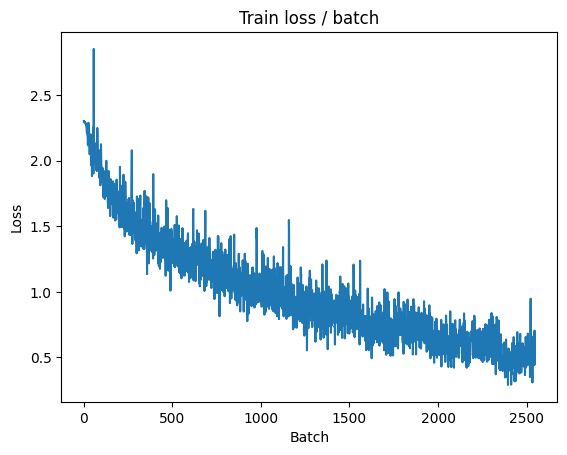


===============> Total time 12s	Avg loss 0.4980	Avg Prec@1 82.65 %	Avg Prec@5 99.38 %

[EVAL Batch 000/079]	Time 0.138s (0.138s)	Loss 0.7350 (0.7350)	Prec@1  75.8 ( 75.8)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.8100	Avg Prec@1 72.77 %	Avg Prec@5 97.84 %



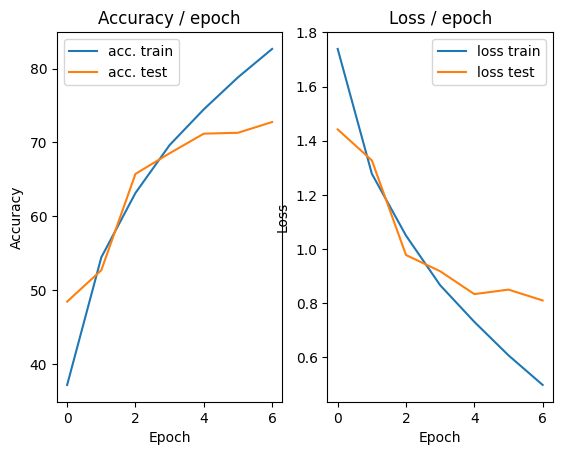

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.170s (0.170s)	Loss 0.3613 (0.3613)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)


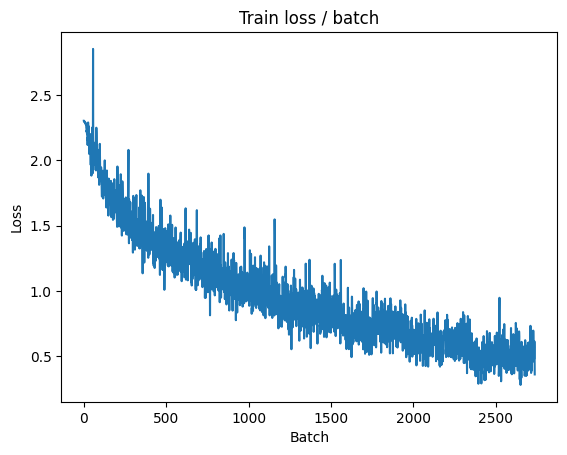

[TRAIN Batch 200/391]	Time 0.070s (0.034s)	Loss 0.3664 (0.3719)	Prec@1  89.8 ( 87.0)	Prec@5 100.0 ( 99.7)


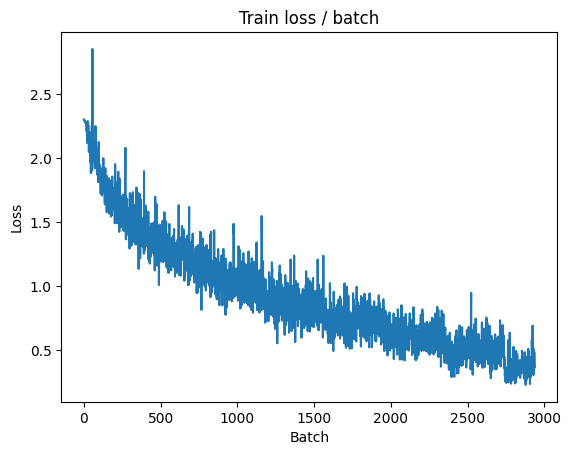


===============> Total time 12s	Avg loss 0.3894	Avg Prec@1 86.23 %	Avg Prec@5 99.67 %

[EVAL Batch 000/079]	Time 0.145s (0.145s)	Loss 0.9662 (0.9662)	Prec@1  72.7 ( 72.7)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9493	Avg Prec@1 71.45 %	Avg Prec@5 97.69 %



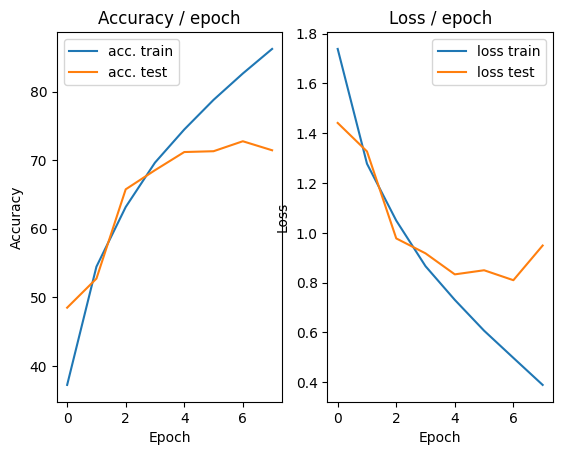

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.167s (0.167s)	Loss 0.2230 (0.2230)	Prec@1  94.5 ( 94.5)	Prec@5  99.2 ( 99.2)


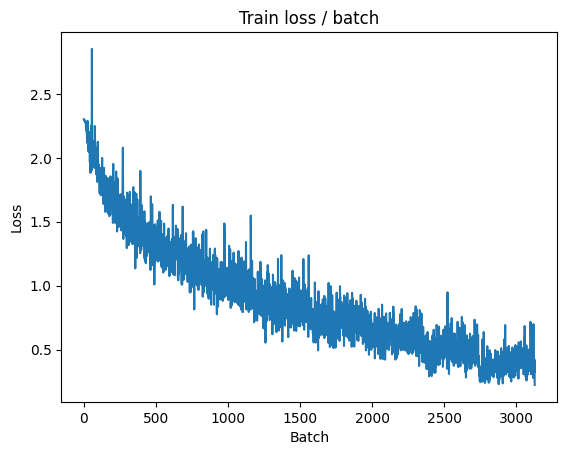

[TRAIN Batch 200/391]	Time 0.012s (0.036s)	Loss 0.2575 (0.2706)	Prec@1  89.8 ( 90.7)	Prec@5 100.0 ( 99.9)


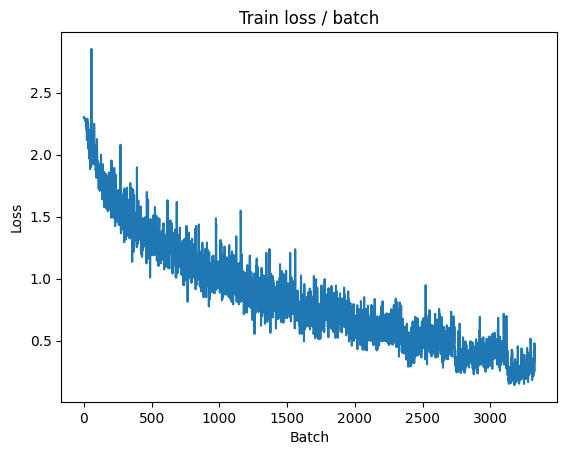


===============> Total time 12s	Avg loss 0.2888	Avg Prec@1 89.96 %	Avg Prec@5 99.85 %

[EVAL Batch 000/079]	Time 0.133s (0.133s)	Loss 1.0189 (1.0189)	Prec@1  75.0 ( 75.0)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.9866	Avg Prec@1 72.42 %	Avg Prec@5 97.71 %



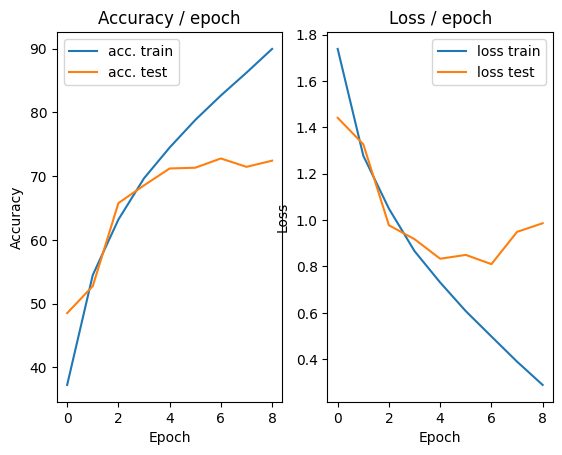

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.178s (0.178s)	Loss 0.1601 (0.1601)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


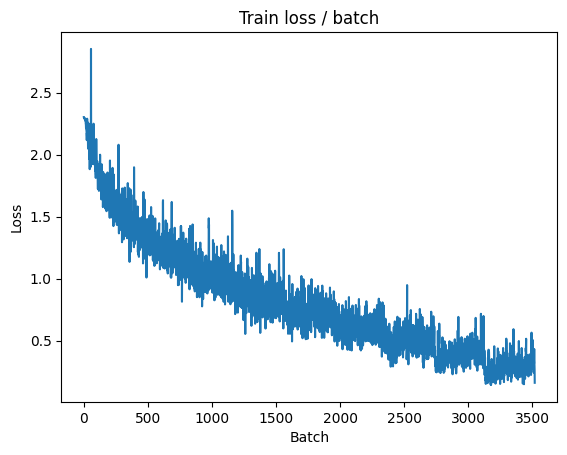

[TRAIN Batch 200/391]	Time 0.067s (0.035s)	Loss 0.2331 (0.1848)	Prec@1  92.2 ( 93.8)	Prec@5  99.2 ( 99.9)


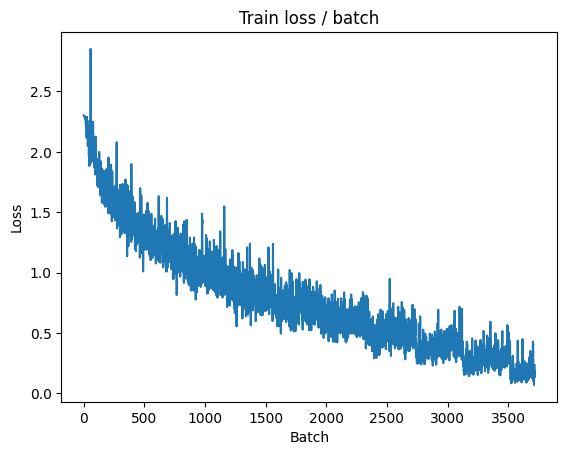


===============> Total time 12s	Avg loss 0.2129	Avg Prec@1 92.69 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.238s (0.238s)	Loss 1.2942 (1.2942)	Prec@1  71.9 ( 71.9)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 1.4723	Avg Prec@1 67.70 %	Avg Prec@5 96.67 %



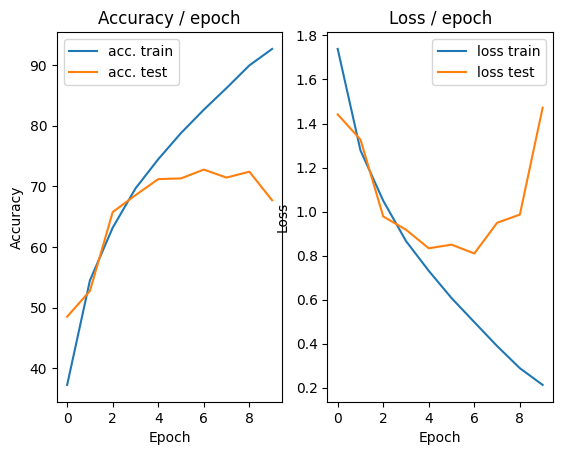

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.168s (0.168s)	Loss 0.3646 (0.3646)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


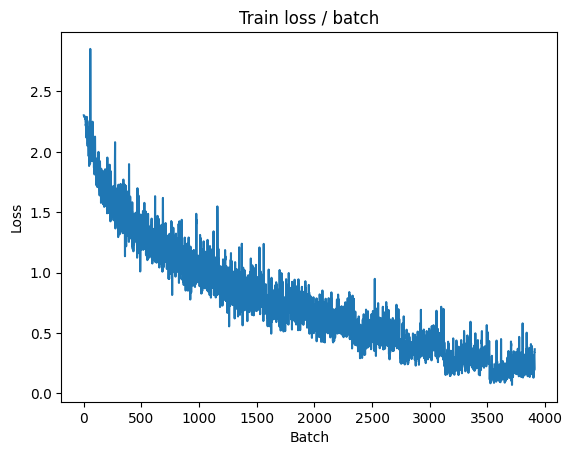

[TRAIN Batch 200/391]	Time 0.027s (0.031s)	Loss 0.2384 (0.1330)	Prec@1  90.6 ( 95.7)	Prec@5 100.0 (100.0)


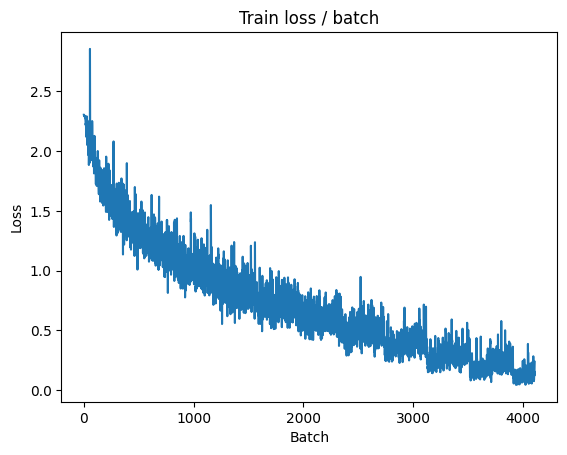


===============> Total time 12s	Avg loss 0.1656	Avg Prec@1 94.49 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.138s (0.138s)	Loss 0.9363 (0.9363)	Prec@1  74.2 ( 74.2)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.1423	Avg Prec@1 72.81 %	Avg Prec@5 97.41 %



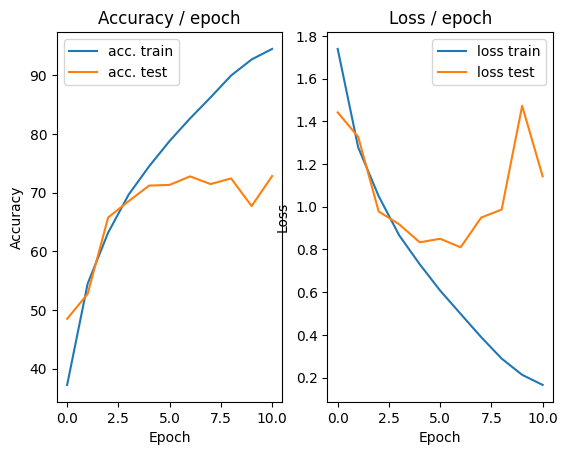

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.169s (0.169s)	Loss 0.0726 (0.0726)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


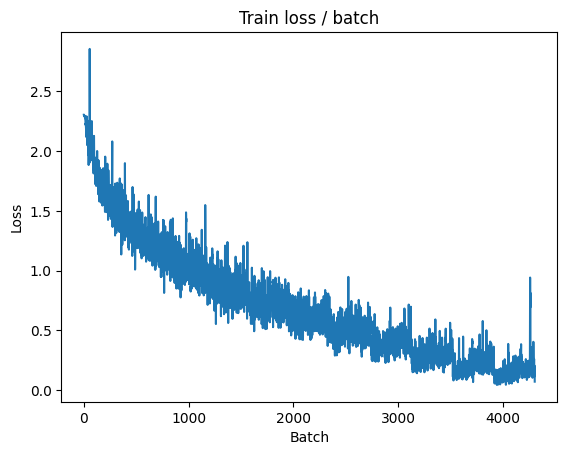

[TRAIN Batch 200/391]	Time 0.014s (0.030s)	Loss 0.1026 (0.0779)	Prec@1  97.7 ( 97.5)	Prec@5 100.0 (100.0)


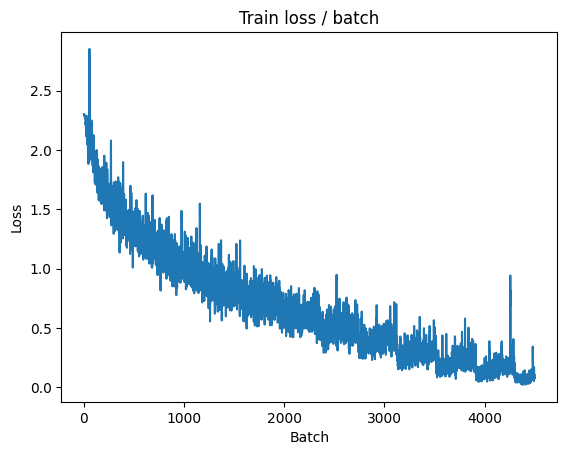


===============> Total time 12s	Avg loss 0.0897	Avg Prec@1 97.06 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.138s (0.138s)	Loss 1.5741 (1.5741)	Prec@1  71.1 ( 71.1)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.4809	Avg Prec@1 71.50 %	Avg Prec@5 96.97 %



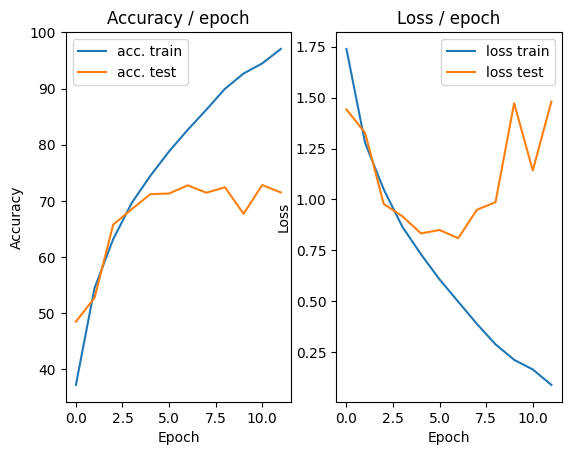

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.187s (0.187s)	Loss 0.0781 (0.0781)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


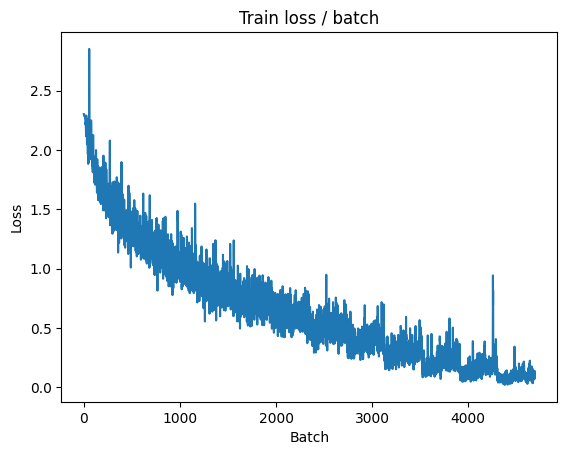

[TRAIN Batch 200/391]	Time 0.062s (0.036s)	Loss 0.1594 (0.0666)	Prec@1  94.5 ( 97.9)	Prec@5 100.0 (100.0)


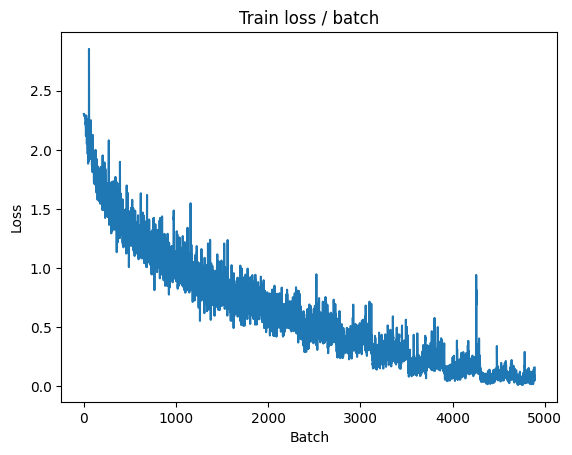


===============> Total time 12s	Avg loss 0.0826	Avg Prec@1 97.22 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.133s (0.133s)	Loss 1.3782 (1.3782)	Prec@1  71.9 ( 71.9)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.3054	Avg Prec@1 73.32 %	Avg Prec@5 97.50 %



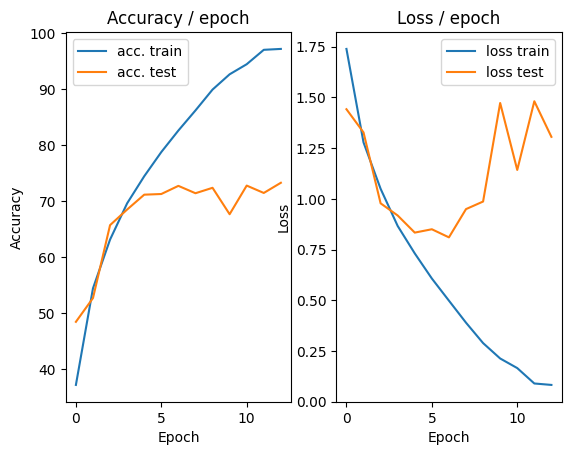

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.162s (0.162s)	Loss 0.0768 (0.0768)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


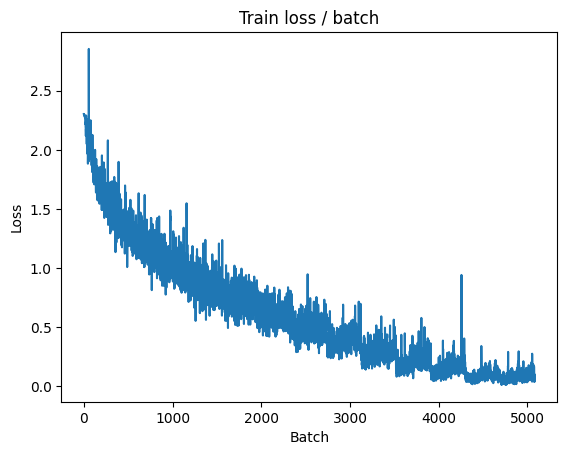

[TRAIN Batch 200/391]	Time 0.048s (0.036s)	Loss 0.0959 (0.0567)	Prec@1  96.9 ( 98.1)	Prec@5 100.0 (100.0)


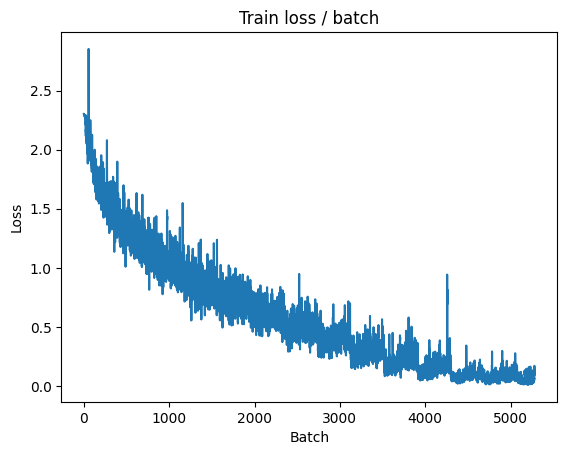


===============> Total time 12s	Avg loss 0.0784	Avg Prec@1 97.33 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.135s (0.135s)	Loss 1.7070 (1.7070)	Prec@1  71.9 ( 71.9)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.5936	Avg Prec@1 71.72 %	Avg Prec@5 97.44 %



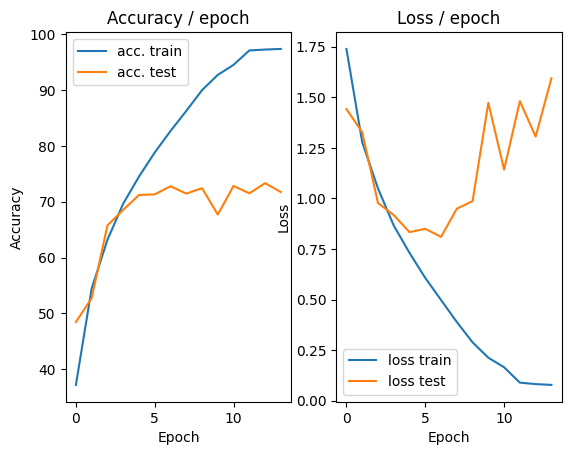

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.231s (0.231s)	Loss 0.1019 (0.1019)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


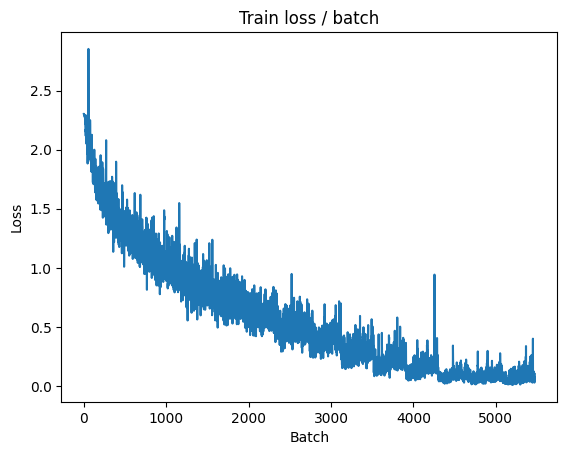

[TRAIN Batch 200/391]	Time 0.054s (0.033s)	Loss 0.1071 (0.0494)	Prec@1  96.9 ( 98.4)	Prec@5 100.0 (100.0)


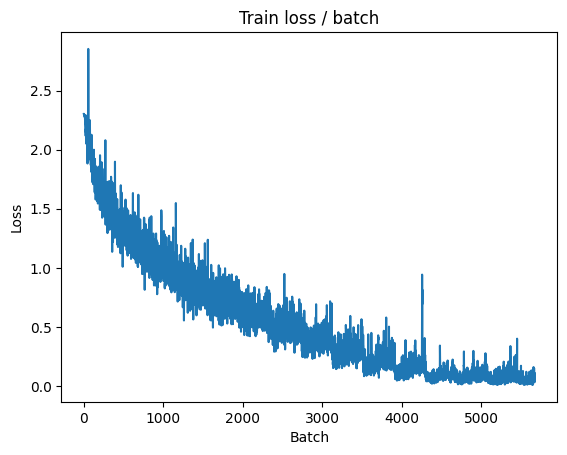


===============> Total time 13s	Avg loss 0.0663	Avg Prec@1 97.80 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.272s (0.272s)	Loss 1.5862 (1.5862)	Prec@1  72.7 ( 72.7)	Prec@5  94.5 ( 94.5)

===============> Total time 2s	Avg loss 1.5188	Avg Prec@1 73.16 %	Avg Prec@5 97.61 %



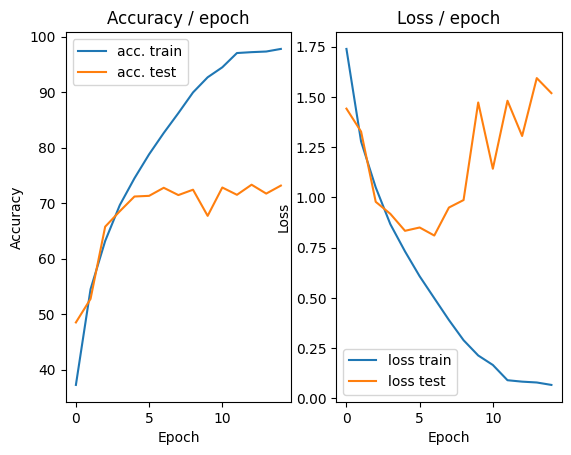

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.183s (0.183s)	Loss 0.0376 (0.0376)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


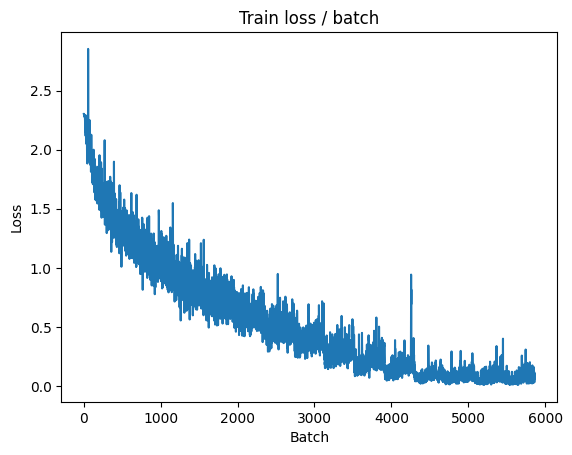

[TRAIN Batch 200/391]	Time 0.011s (0.031s)	Loss 0.0884 (0.0446)	Prec@1  97.7 ( 98.6)	Prec@5 100.0 (100.0)


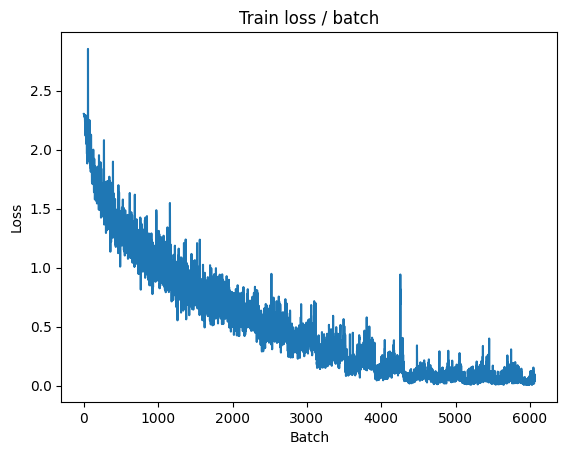


===============> Total time 13s	Avg loss 0.0597	Avg Prec@1 98.08 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.135s (0.135s)	Loss 1.3269 (1.3269)	Prec@1  78.1 ( 78.1)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.5669	Avg Prec@1 72.75 %	Avg Prec@5 97.43 %



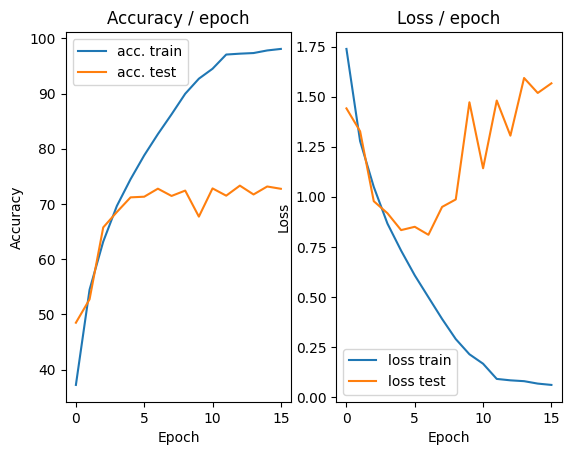

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.180s (0.180s)	Loss 0.0366 (0.0366)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


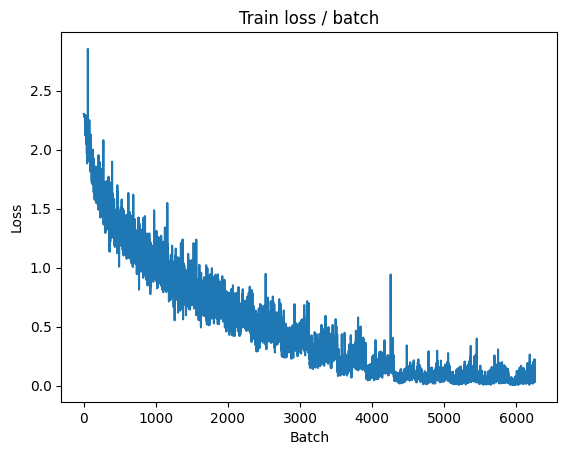

[TRAIN Batch 200/391]	Time 0.010s (0.040s)	Loss 0.0154 (0.0351)	Prec@1  99.2 ( 98.9)	Prec@5 100.0 (100.0)


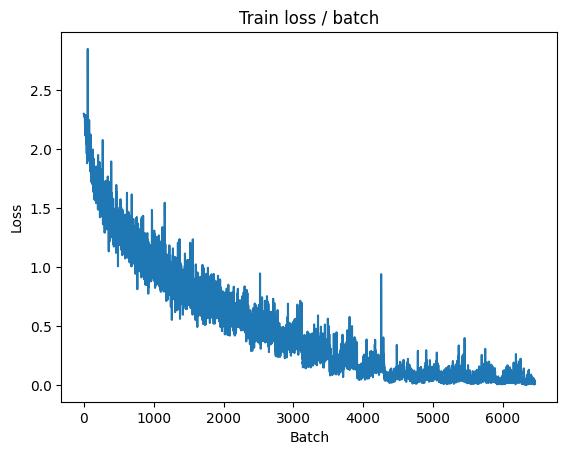


===============> Total time 13s	Avg loss 0.0429	Avg Prec@1 98.63 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 1.5259 (1.5259)	Prec@1  75.0 ( 75.0)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.7761	Avg Prec@1 71.95 %	Avg Prec@5 97.01 %



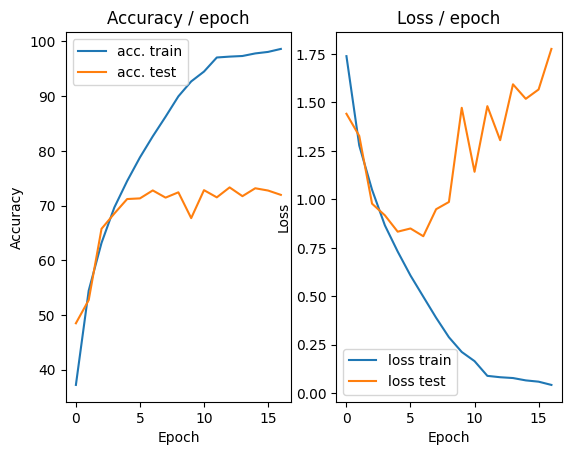

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.378s (0.378s)	Loss 0.1477 (0.1477)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


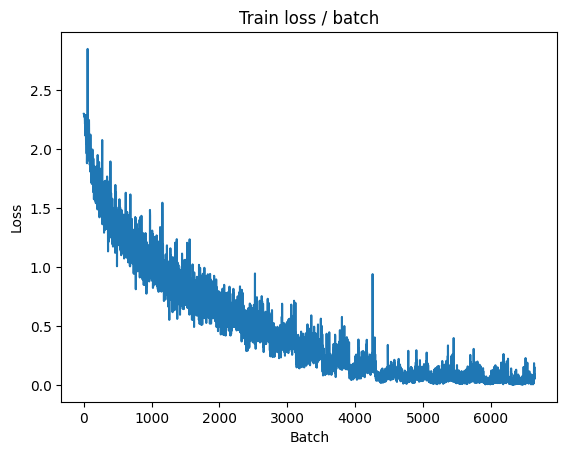

[TRAIN Batch 200/391]	Time 0.011s (0.036s)	Loss 0.0417 (0.0347)	Prec@1  98.4 ( 99.0)	Prec@5 100.0 (100.0)


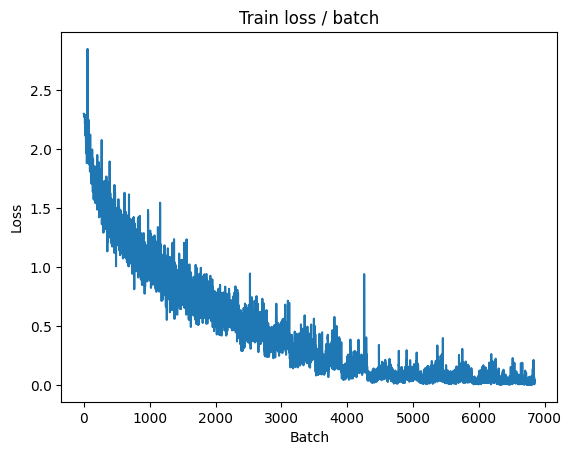


===============> Total time 13s	Avg loss 0.0453	Avg Prec@1 98.56 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.293s (0.293s)	Loss 1.8567 (1.8567)	Prec@1  72.7 ( 72.7)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 1.7394	Avg Prec@1 73.06 %	Avg Prec@5 97.32 %



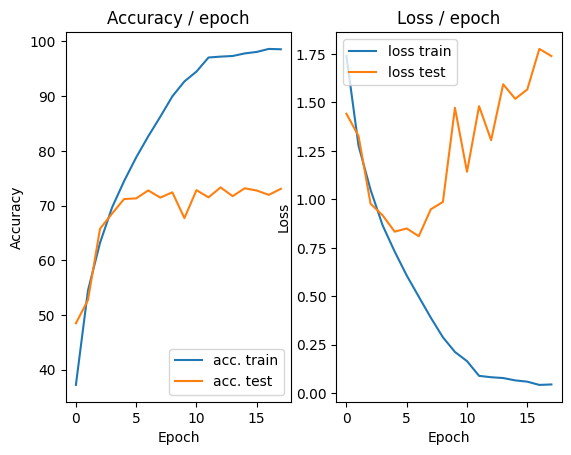

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.179s (0.179s)	Loss 0.0842 (0.0842)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


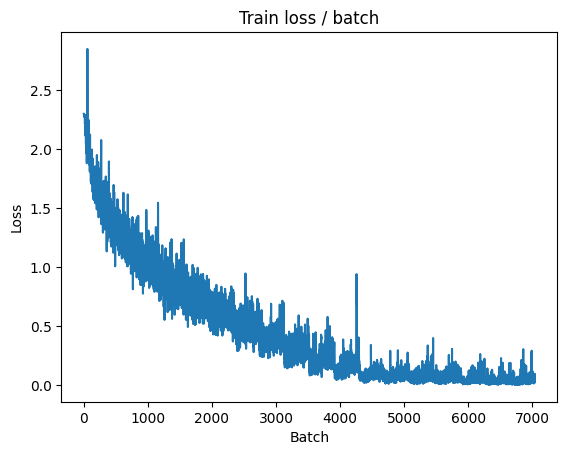

[TRAIN Batch 200/391]	Time 0.009s (0.031s)	Loss 0.0724 (0.0523)	Prec@1  96.9 ( 98.3)	Prec@5 100.0 (100.0)


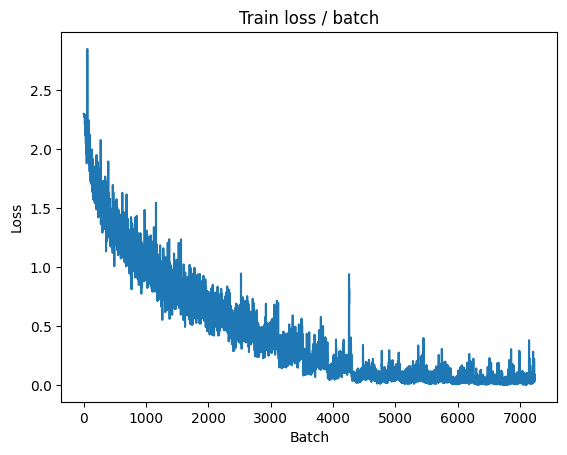


===============> Total time 12s	Avg loss 0.0514	Avg Prec@1 98.31 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 1.4754 (1.4754)	Prec@1  71.9 ( 71.9)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.7264	Avg Prec@1 73.81 %	Avg Prec@5 97.56 %



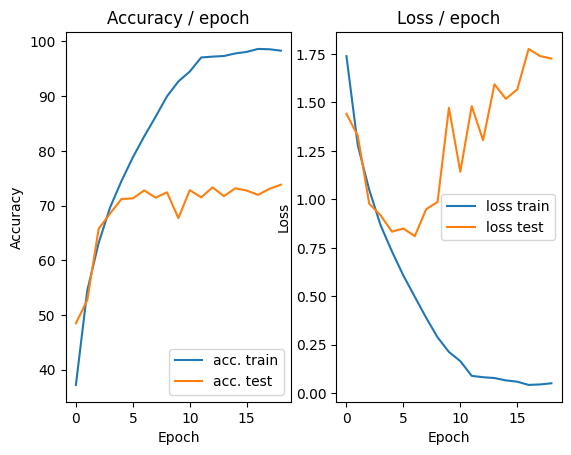

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.188s (0.188s)	Loss 0.0267 (0.0267)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


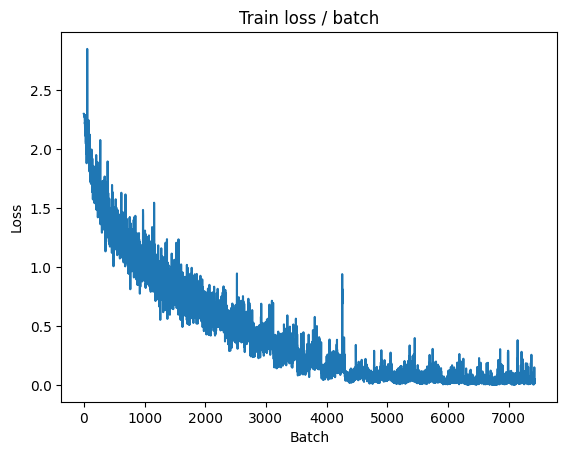

[TRAIN Batch 200/391]	Time 0.014s (0.030s)	Loss 0.0077 (0.0146)	Prec@1 100.0 ( 99.6)	Prec@5 100.0 (100.0)


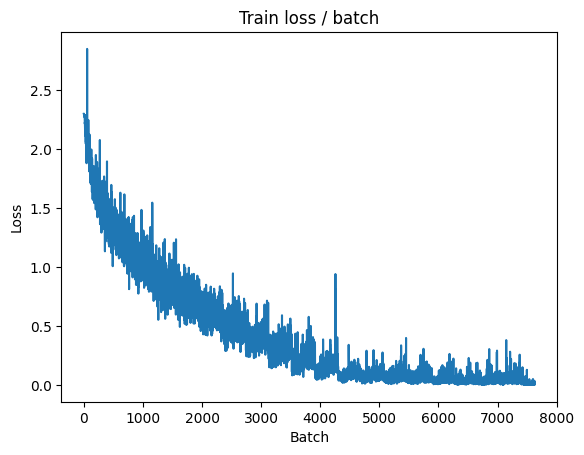


===============> Total time 12s	Avg loss 0.0405	Avg Prec@1 98.71 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.145s (0.145s)	Loss 1.3834 (1.3834)	Prec@1  74.2 ( 74.2)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.6789	Avg Prec@1 73.72 %	Avg Prec@5 97.50 %



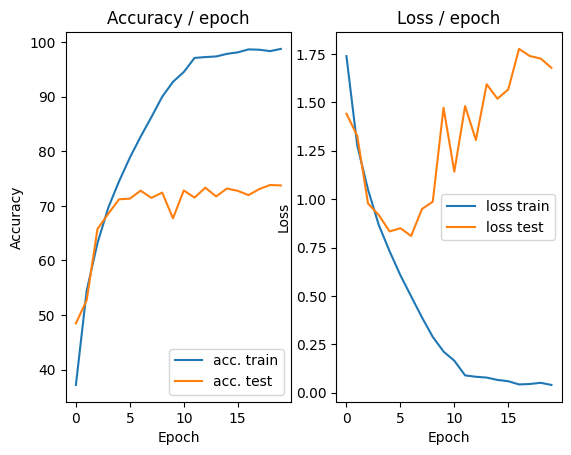

In [25]:
main_cifar(batch_size=128, epochs=20, cuda=True, get_dataset=get_cifar_dataset_standardized)

### ZCA Standardization

In [10]:
import torch
import torchvision.datasets as datasets
import torchvision.transforms as transforms

class ZCAWhitening(object):
    def __init__(self, epsilon=1e-5):
        self.epsilon = epsilon
        self.mean = None
        self.zca_matrix = None

    def fit(self, tensor_data):
        """
        Computes the ZCA matrix.
        Assumes tensor_data is a (N, C, H, W) tensor from ToTensor().
        """
        # Flatten to (N, C*H*W)
        flat_data = tensor_data.reshape(tensor_data.size(0), -1).float()

        # Calculate mean and center data
        self.mean = torch.mean(flat_data, dim=0)
        centered_data = flat_data - self.mean

        # Calculate Covariance Matrix: (X^T * X) / (N-1)
        # This is (features, N) @ (N, features) -> (features, features)
        cov = torch.mm(centered_data.T, centered_data) / (centered_data.size(0) - 1)

        # SVD (or Eigendecomposition since cov is symmetric)
        eigenvalues, eigenvectors = torch.linalg.eigh(cov)

        # ZCA matrix: W = U * (Lambda + epsilon)^-0.5 * U^T
        S_diag = torch.diag(1.0 / torch.sqrt(eigenvalues + self.epsilon))
        self.zca_matrix = torch.mm(torch.mm(eigenvectors, S_diag), eigenvectors.T)

    def __call__(self, img_tensor):
        """
        Applies the ZCA transform to a single image tensor (C, H, W).
        """

        # Flatten, center, transform, reshape
        img_flat = img_tensor.reshape(-1).float()
        centered_img = img_flat - self.mean

        # Apply ZCA: (F,) @ (F, F) -> (F,)
        transformed_img = torch.matmul(centered_img, self.zca_matrix)

        # Reshape back to (C, H, W)
        return transformed_img.reshape(img_tensor.shape)

def get_cifar_dataset_zca(batch_size, cuda=False):

    # --- ZCA Pre-computation ---
    train_data_for_zca = datasets.CIFAR10(PATH, train=True, download=True,
                                         transform=transforms.ToTensor())

    # 2. Stack all 50,000 images into one tensor.
    train_loader_for_zca = torch.utils.data.DataLoader(train_data_for_zca,
                                                       batch_size=50000,
                                                       shuffle=False)
    all_train_images = next(iter(train_loader_for_zca))[0]

    # 3. Fit the ZCA transform
    zca_transform = ZCAWhitening(epsilon=1e-5)
    zca_transform.fit(all_train_images)

    train_transform = transforms.Compose([
        transforms.ToTensor(),
        zca_transform
    ])

    val_transform = transforms.Compose([
        transforms.ToTensor(),
        zca_transform
    ])

    # Create the datasets using these new transforms
    train_dataset = datasets.CIFAR10(PATH, train=True, download=False,
                                     transform=train_transform)

    val_dataset = datasets.CIFAR10(PATH, train=False, download=False,
                                   transform=val_transform)

    train_loader = torch.utils.data.DataLoader(train_dataset,
                                               batch_size=batch_size, shuffle=True,
                                               pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                                             batch_size=batch_size, shuffle=False,
                                             pin_memory=cuda, num_workers=2)

    return train_loader, val_loader

100%|██████████| 170M/170M [00:10<00:00, 15.5MB/s]


=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 2.018s (2.018s)	Loss 2.2990 (2.2990)	Prec@1  15.6 ( 15.6)	Prec@5  48.4 ( 48.4)


<Figure size 640x480 with 0 Axes>

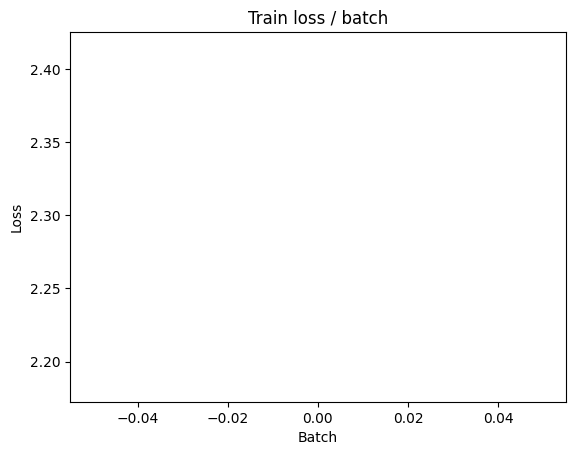

[TRAIN Batch 200/391]	Time 0.431s (0.497s)	Loss 1.8193 (2.0931)	Prec@1  39.1 ( 22.3)	Prec@5  82.0 ( 72.9)


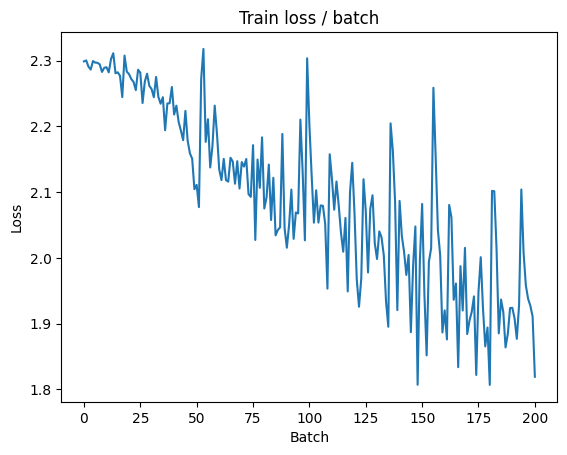


===============> Total time 191s	Avg loss 1.9264	Avg Prec@1 29.11 %	Avg Prec@5 79.55 %

[EVAL Batch 000/079]	Time 1.390s (1.390s)	Loss 1.5615 (1.5615)	Prec@1  45.3 ( 45.3)	Prec@5  85.9 ( 85.9)

===============> Total time 25s	Avg loss 1.5968	Avg Prec@1 43.30 %	Avg Prec@5 89.40 %



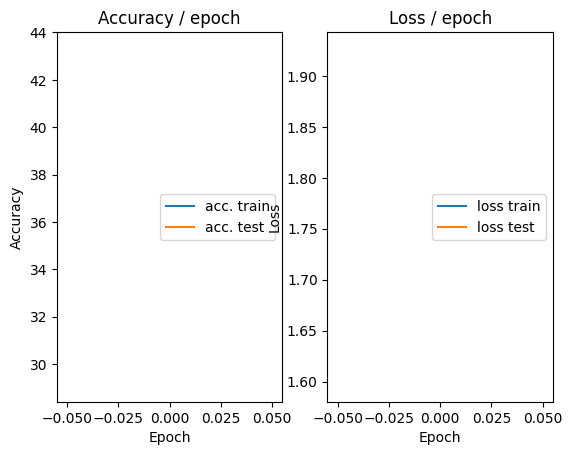

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 1.778s (1.778s)	Loss 1.7459 (1.7459)	Prec@1  37.5 ( 37.5)	Prec@5  87.5 ( 87.5)


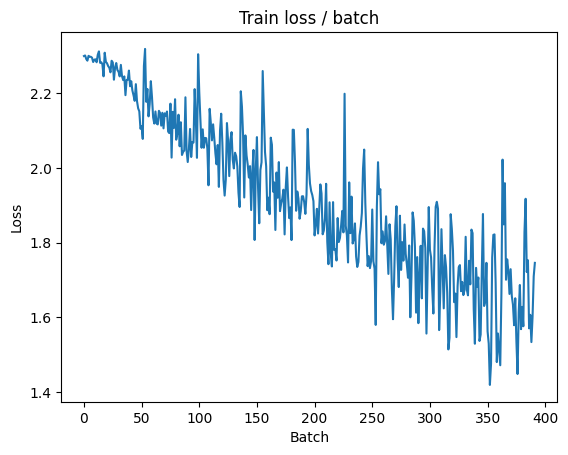

[TRAIN Batch 200/391]	Time 0.458s (0.496s)	Loss 1.4147 (1.4840)	Prec@1  52.3 ( 47.1)	Prec@5  90.6 ( 91.8)


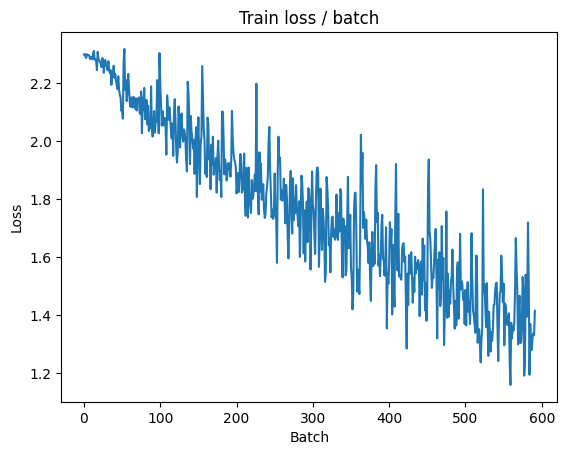


===============> Total time 193s	Avg loss 1.3562	Avg Prec@1 52.03 %	Avg Prec@5 93.29 %

[EVAL Batch 000/079]	Time 0.863s (0.863s)	Loss 1.3551 (1.3551)	Prec@1  52.3 ( 52.3)	Prec@5  92.2 ( 92.2)

===============> Total time 26s	Avg loss 1.4704	Avg Prec@1 50.37 %	Avg Prec@5 92.92 %



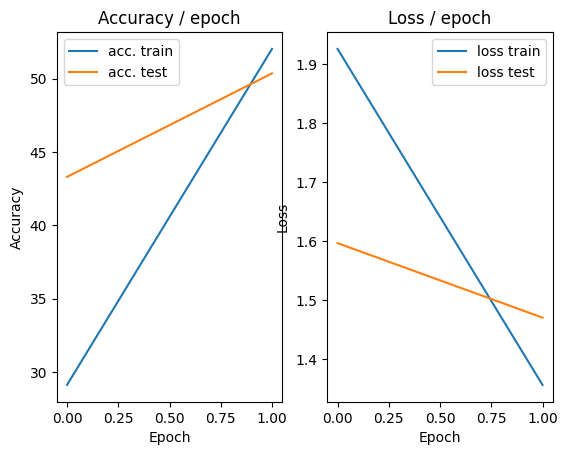

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 1.339s (1.339s)	Loss 1.6501 (1.6501)	Prec@1  44.5 ( 44.5)	Prec@5  92.2 ( 92.2)


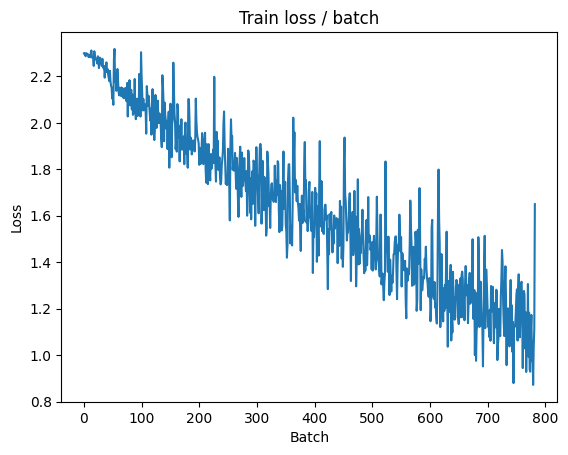

[TRAIN Batch 200/391]	Time 0.450s (0.508s)	Loss 1.1091 (1.0565)	Prec@1  61.7 ( 63.0)	Prec@5  95.3 ( 96.3)


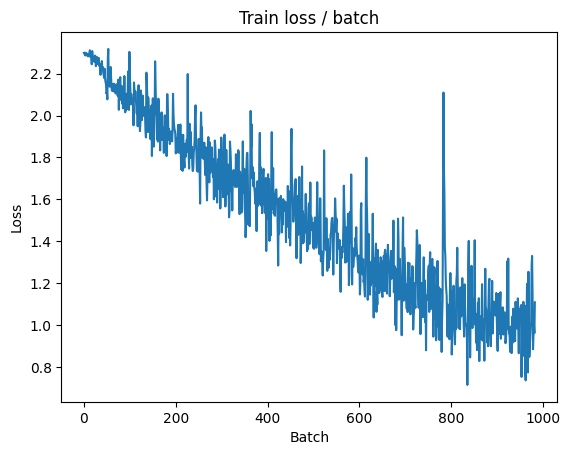


===============> Total time 194s	Avg loss 1.0053	Avg Prec@1 65.10 %	Avg Prec@5 96.61 %

[EVAL Batch 000/079]	Time 0.800s (0.800s)	Loss 1.1453 (1.1453)	Prec@1  63.3 ( 63.3)	Prec@5  96.1 ( 96.1)

===============> Total time 26s	Avg loss 1.1594	Avg Prec@1 60.04 %	Avg Prec@5 96.23 %



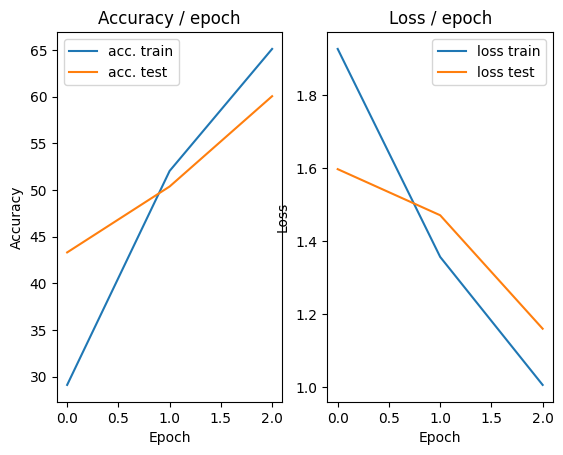

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 1.351s (1.351s)	Loss 1.1202 (1.1202)	Prec@1  62.5 ( 62.5)	Prec@5  96.9 ( 96.9)


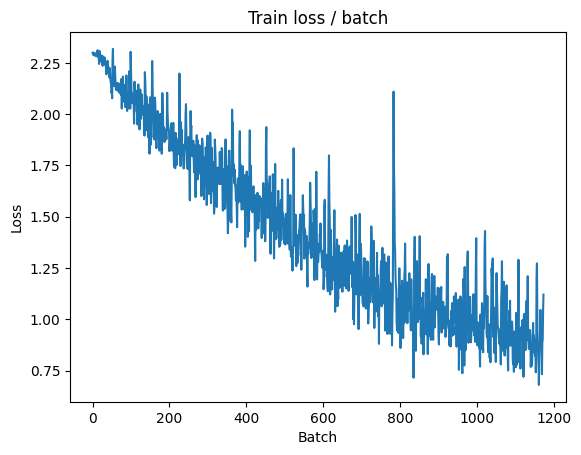

[TRAIN Batch 200/391]	Time 0.453s (0.500s)	Loss 0.7444 (0.8212)	Prec@1  72.7 ( 71.4)	Prec@5  98.4 ( 97.8)


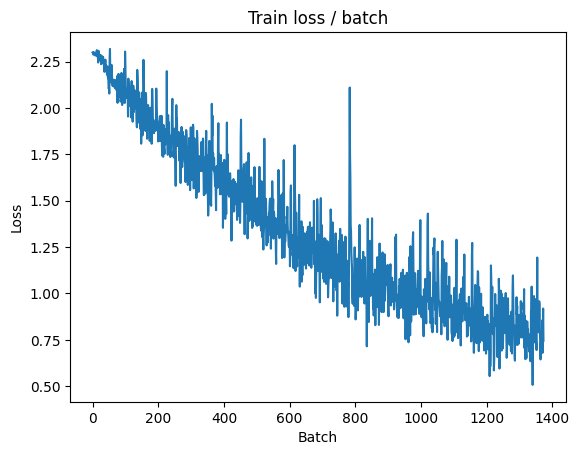


===============> Total time 192s	Avg loss 0.8019	Avg Prec@1 72.03 %	Avg Prec@5 97.99 %

[EVAL Batch 000/079]	Time 1.024s (1.024s)	Loss 0.7567 (0.7567)	Prec@1  70.3 ( 70.3)	Prec@5  97.7 ( 97.7)

===============> Total time 25s	Avg loss 0.8882	Avg Prec@1 69.76 %	Avg Prec@5 97.47 %



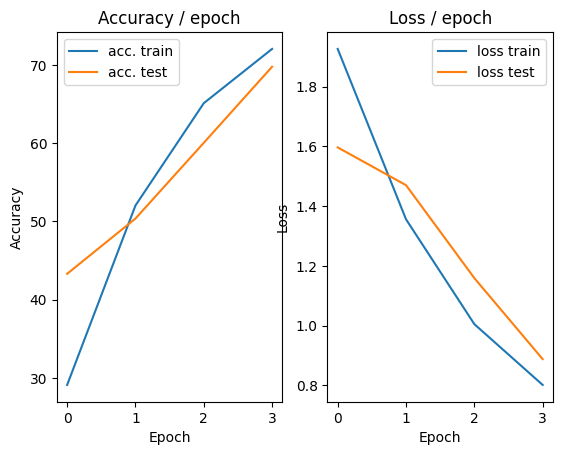

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 1.557s (1.557s)	Loss 0.7047 (0.7047)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)


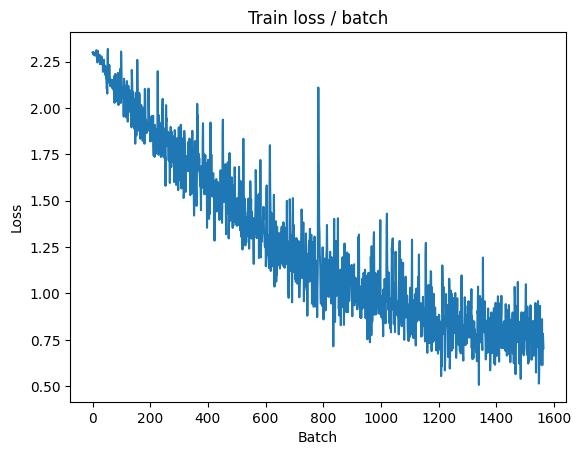

[TRAIN Batch 200/391]	Time 0.443s (0.502s)	Loss 0.7043 (0.6745)	Prec@1  71.1 ( 76.6)	Prec@5 100.0 ( 98.7)


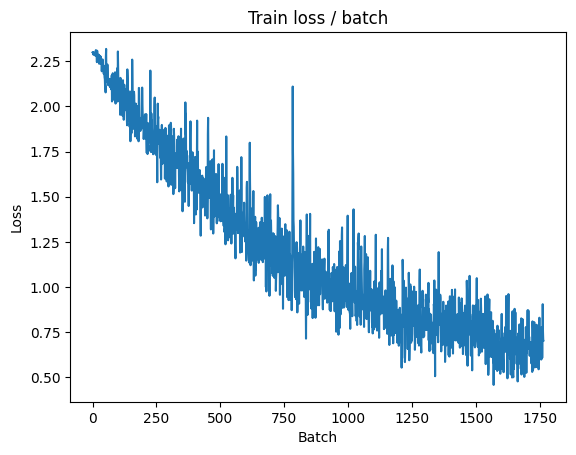


===============> Total time 194s	Avg loss 0.6594	Avg Prec@1 77.17 %	Avg Prec@5 98.71 %

[EVAL Batch 000/079]	Time 0.992s (0.992s)	Loss 0.7997 (0.7997)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 25s	Avg loss 0.8093	Avg Prec@1 72.07 %	Avg Prec@5 98.07 %



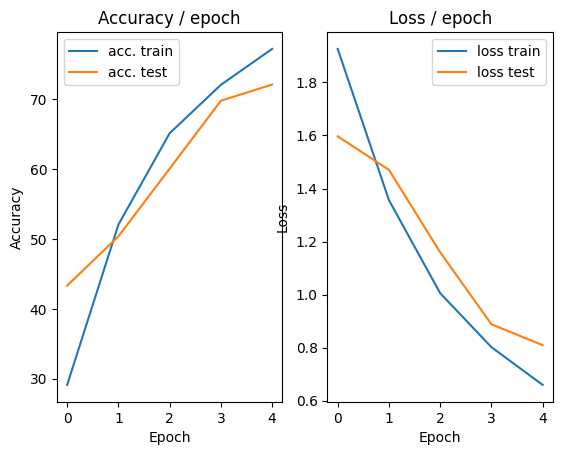

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 1.315s (1.315s)	Loss 0.5495 (0.5495)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)


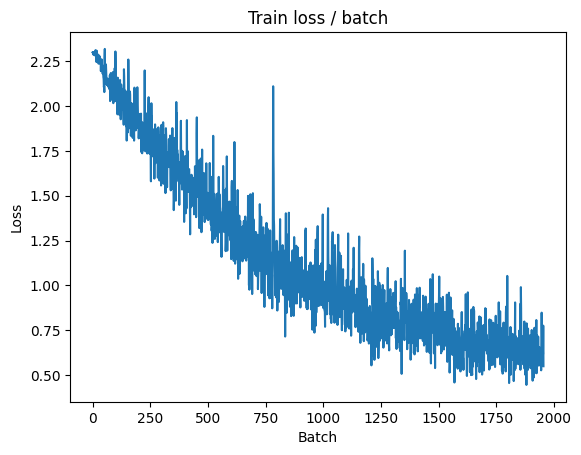

[TRAIN Batch 200/391]	Time 0.464s (0.500s)	Loss 0.5449 (0.5551)	Prec@1  80.5 ( 80.6)	Prec@5  99.2 ( 99.2)


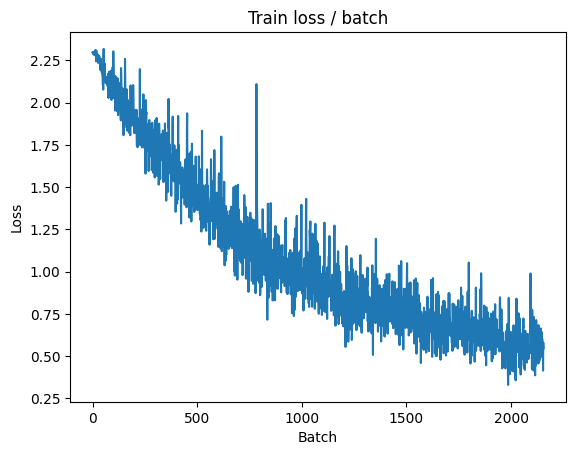


===============> Total time 193s	Avg loss 0.5572	Avg Prec@1 80.57 %	Avg Prec@5 99.14 %

[EVAL Batch 000/079]	Time 0.993s (0.993s)	Loss 0.7035 (0.7035)	Prec@1  75.8 ( 75.8)	Prec@5  99.2 ( 99.2)

===============> Total time 26s	Avg loss 0.8217	Avg Prec@1 72.88 %	Avg Prec@5 98.03 %



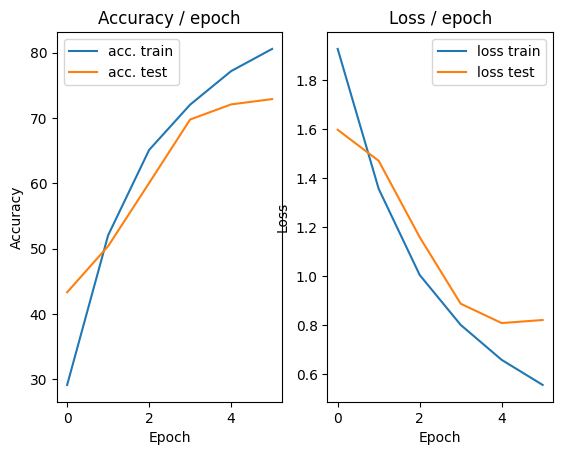

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 1.373s (1.373s)	Loss 0.5212 (0.5212)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)


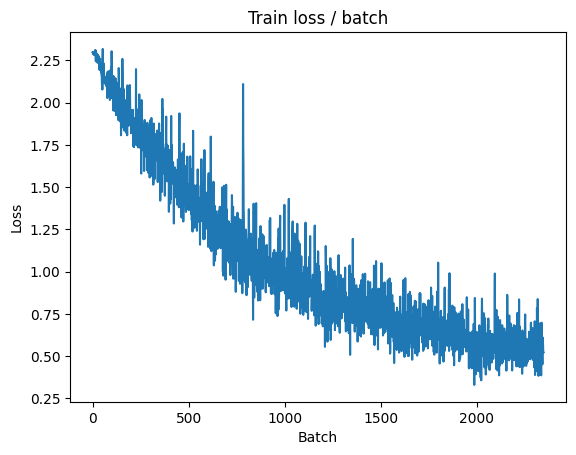

[TRAIN Batch 200/391]	Time 0.453s (0.510s)	Loss 0.4987 (0.4549)	Prec@1  82.0 ( 84.0)	Prec@5  99.2 ( 99.4)


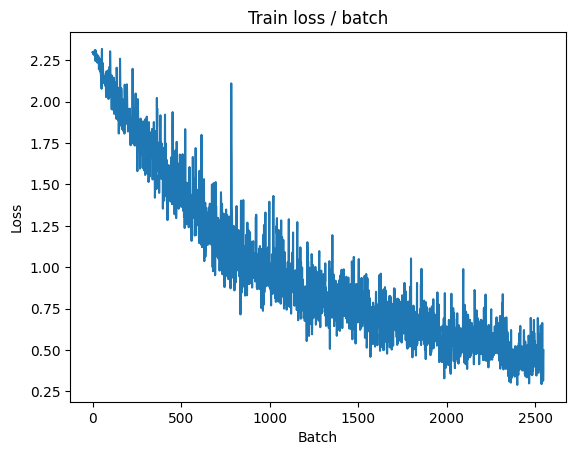


===============> Total time 198s	Avg loss 0.4565	Avg Prec@1 83.99 %	Avg Prec@5 99.44 %

[EVAL Batch 000/079]	Time 1.043s (1.043s)	Loss 0.9419 (0.9419)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 26s	Avg loss 0.9753	Avg Prec@1 70.07 %	Avg Prec@5 97.98 %



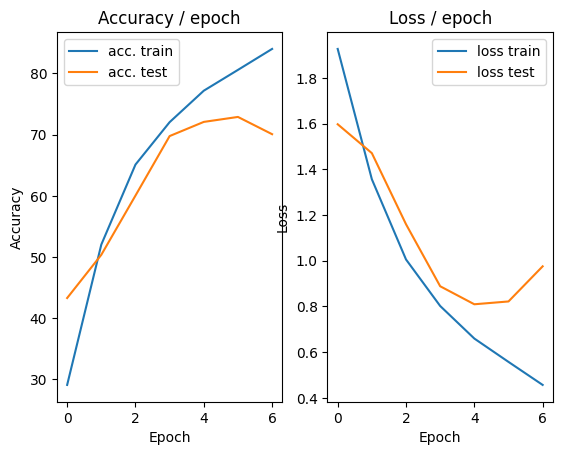

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 1.389s (1.389s)	Loss 0.4675 (0.4675)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)


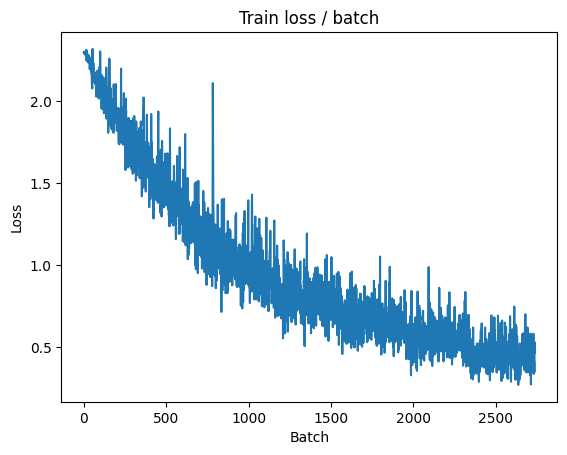

[TRAIN Batch 200/391]	Time 0.464s (0.516s)	Loss 0.3306 (0.3339)	Prec@1  87.5 ( 88.3)	Prec@5 100.0 ( 99.7)


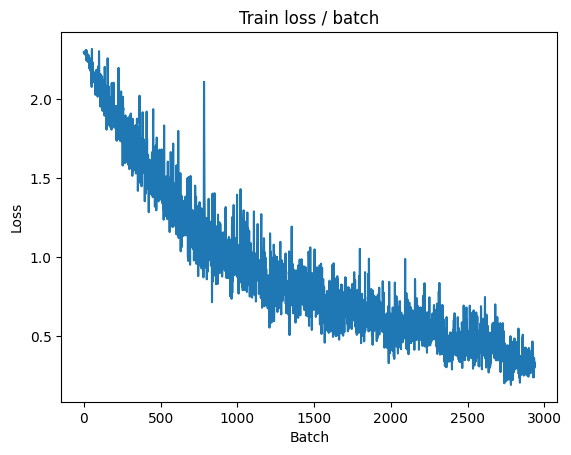


===============> Total time 198s	Avg loss 0.3546	Avg Prec@1 87.62 %	Avg Prec@5 99.72 %

[EVAL Batch 000/079]	Time 1.248s (1.248s)	Loss 0.8394 (0.8394)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 27s	Avg loss 0.8278	Avg Prec@1 74.38 %	Avg Prec@5 98.01 %



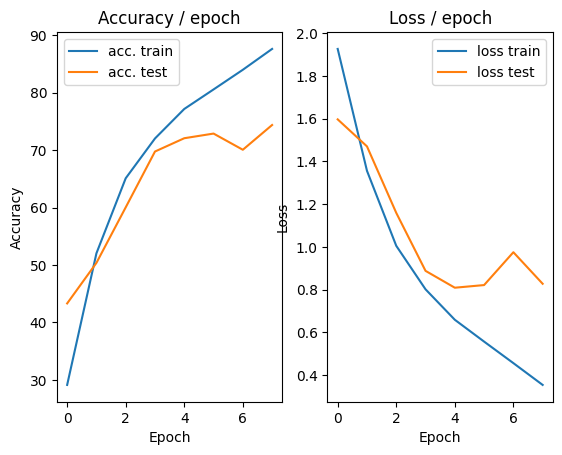

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 1.779s (1.779s)	Loss 0.3515 (0.3515)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


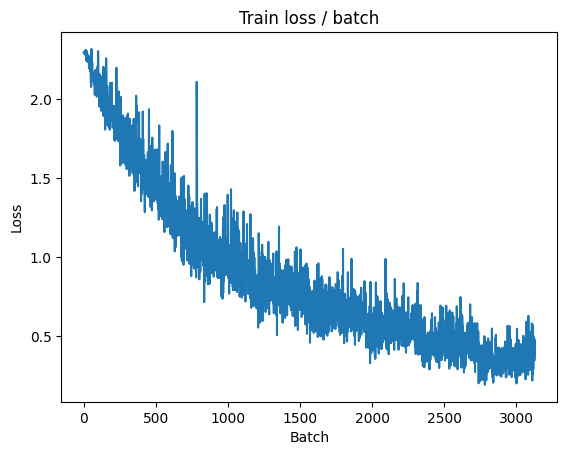

[TRAIN Batch 200/391]	Time 0.740s (0.503s)	Loss 0.3393 (0.2636)	Prec@1  89.1 ( 91.0)	Prec@5 100.0 ( 99.8)


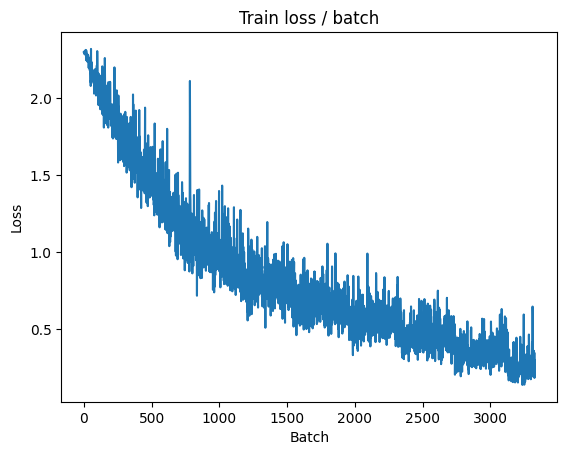


===============> Total time 193s	Avg loss 0.2762	Avg Prec@1 90.44 %	Avg Prec@5 99.81 %

[EVAL Batch 000/079]	Time 0.889s (0.889s)	Loss 1.0079 (1.0079)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 25s	Avg loss 1.0199	Avg Prec@1 72.83 %	Avg Prec@5 97.75 %



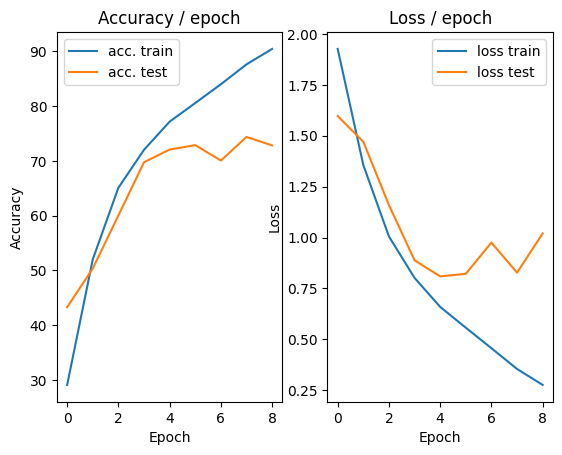

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 1.373s (1.373s)	Loss 0.4198 (0.4198)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)


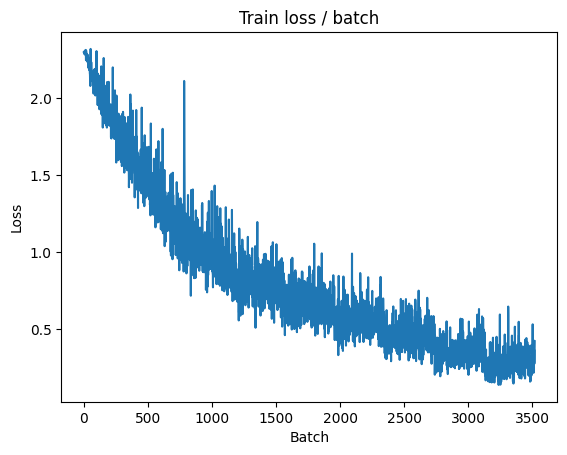

[TRAIN Batch 200/391]	Time 0.670s (0.491s)	Loss 0.1654 (0.1778)	Prec@1  93.8 ( 94.1)	Prec@5 100.0 (100.0)


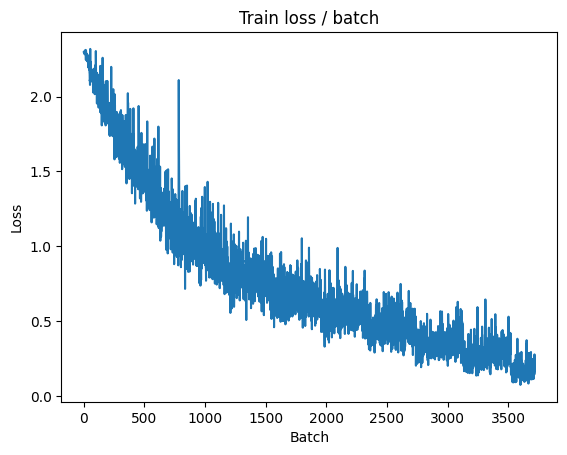


===============> Total time 190s	Avg loss 0.1950	Avg Prec@1 93.33 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.896s (0.896s)	Loss 0.7670 (0.7670)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 25s	Avg loss 0.8746	Avg Prec@1 76.51 %	Avg Prec@5 98.45 %



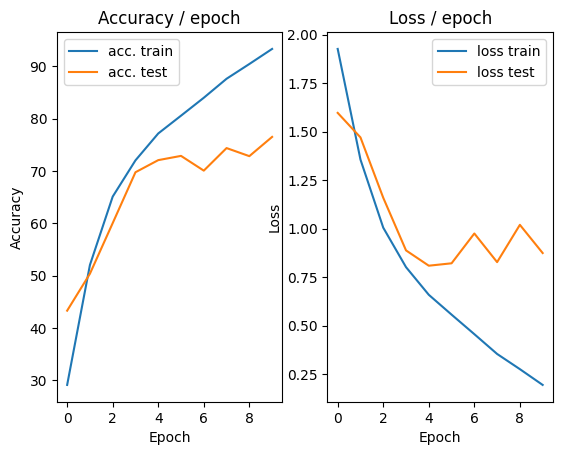

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 1.366s (1.366s)	Loss 0.1307 (0.1307)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


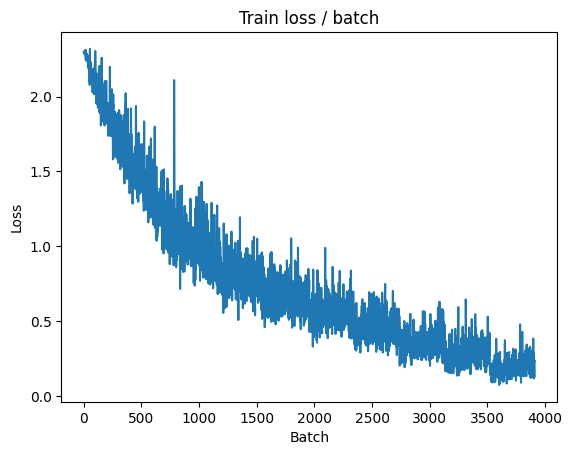

[TRAIN Batch 200/391]	Time 0.472s (0.499s)	Loss 0.0888 (0.1094)	Prec@1  96.9 ( 96.6)	Prec@5 100.0 (100.0)


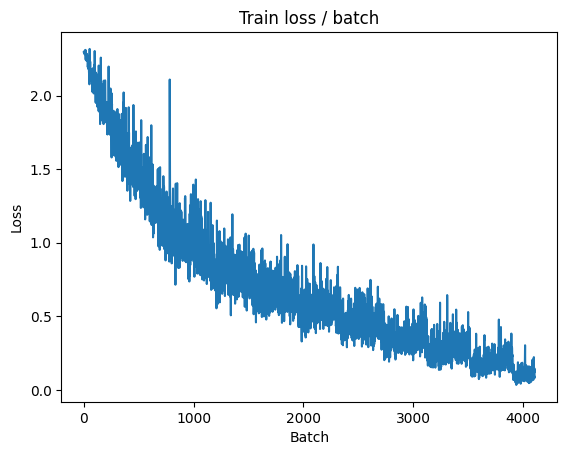


===============> Total time 192s	Avg loss 0.1286	Avg Prec@1 95.77 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.890s (0.890s)	Loss 0.9433 (0.9433)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 25s	Avg loss 0.9379	Avg Prec@1 76.67 %	Avg Prec@5 98.19 %



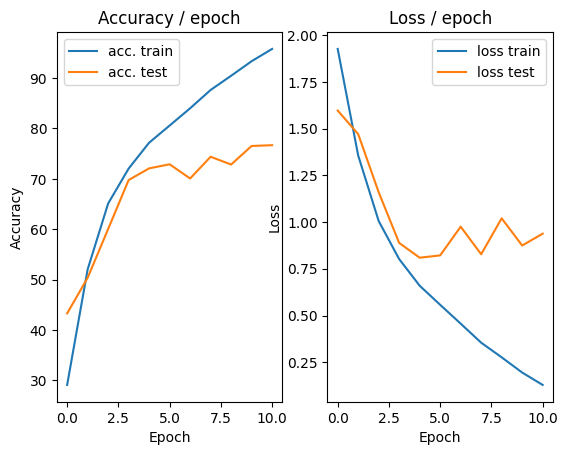

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 1.254s (1.254s)	Loss 0.0752 (0.0752)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


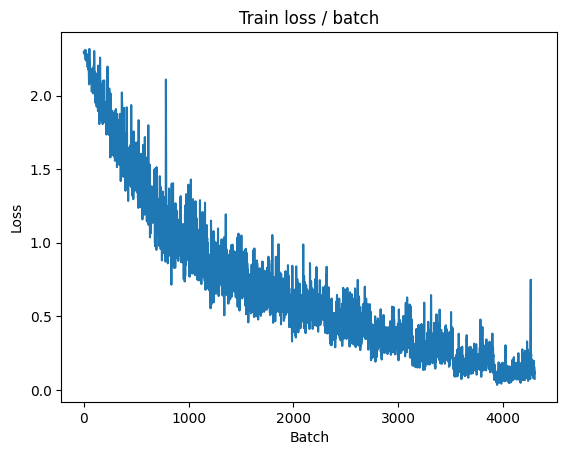

[TRAIN Batch 200/391]	Time 0.462s (0.497s)	Loss 0.1894 (0.0665)	Prec@1  90.6 ( 98.0)	Prec@5 100.0 (100.0)


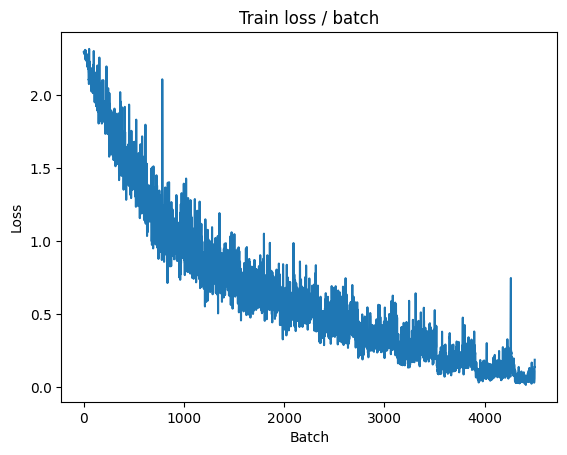


===============> Total time 192s	Avg loss 0.0765	Avg Prec@1 97.57 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.926s (0.926s)	Loss 1.0873 (1.0873)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 25s	Avg loss 1.0615	Avg Prec@1 76.59 %	Avg Prec@5 98.35 %



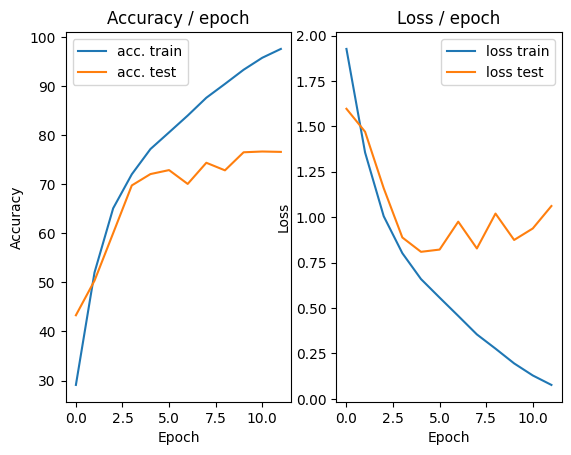

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 1.374s (1.374s)	Loss 0.0570 (0.0570)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


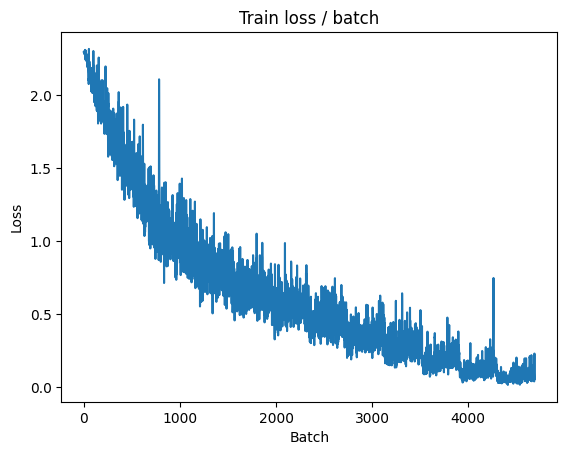

[TRAIN Batch 200/391]	Time 0.448s (0.493s)	Loss 0.0307 (0.0481)	Prec@1  99.2 ( 98.6)	Prec@5 100.0 (100.0)


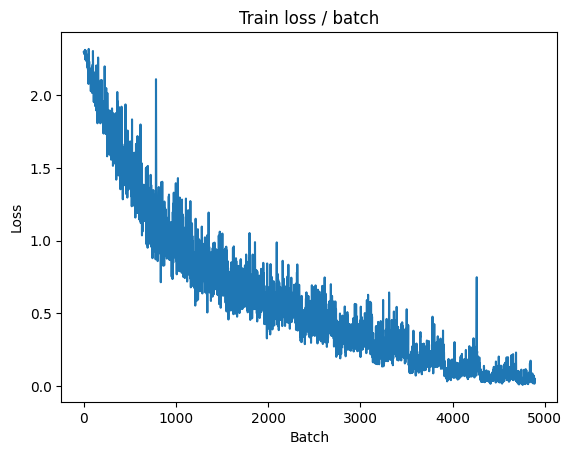


===============> Total time 191s	Avg loss 0.0631	Avg Prec@1 98.02 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.819s (0.819s)	Loss 1.0884 (1.0884)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 25s	Avg loss 1.2117	Avg Prec@1 76.44 %	Avg Prec@5 98.36 %



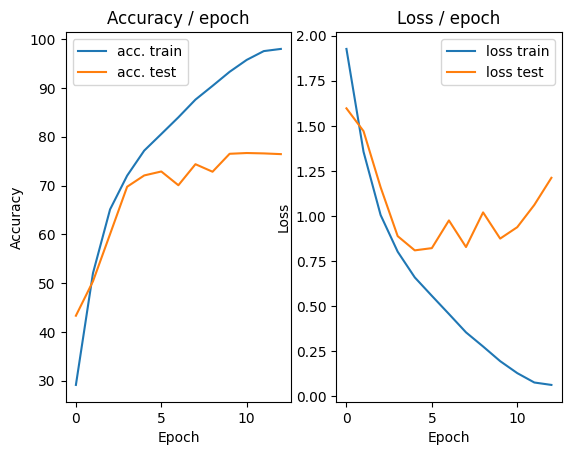

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 1.751s (1.751s)	Loss 0.3466 (0.3466)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


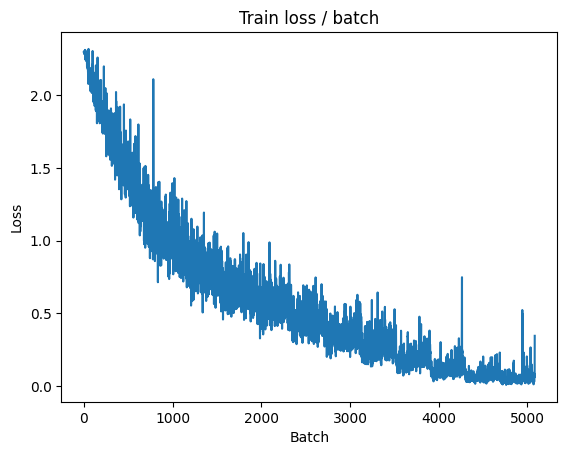

[TRAIN Batch 200/391]	Time 0.437s (0.497s)	Loss 0.1950 (0.0414)	Prec@1  94.5 ( 99.0)	Prec@5 100.0 (100.0)


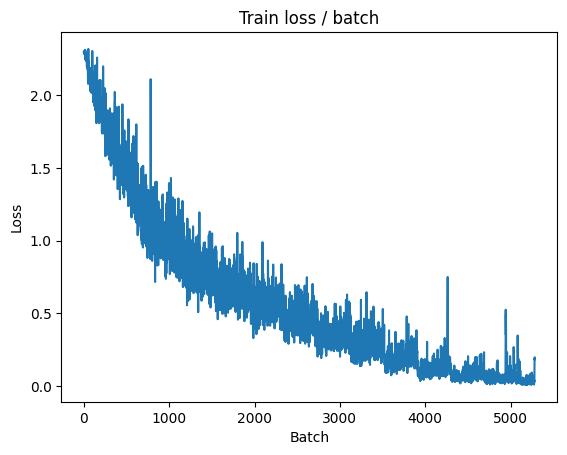


===============> Total time 196s	Avg loss 0.0447	Avg Prec@1 98.76 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.842s (0.842s)	Loss 1.1233 (1.1233)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 25s	Avg loss 1.1813	Avg Prec@1 77.16 %	Avg Prec@5 98.23 %



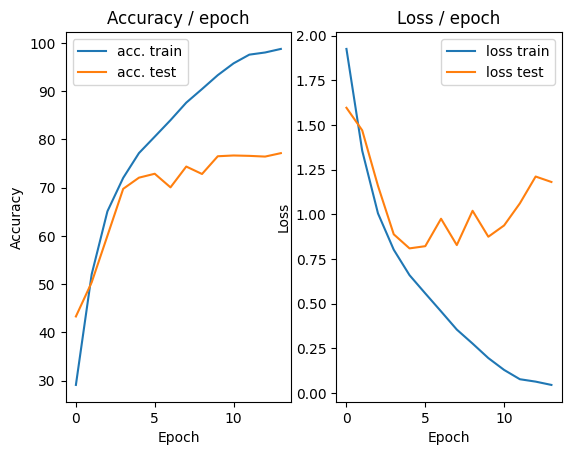

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 1.328s (1.328s)	Loss 0.0294 (0.0294)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


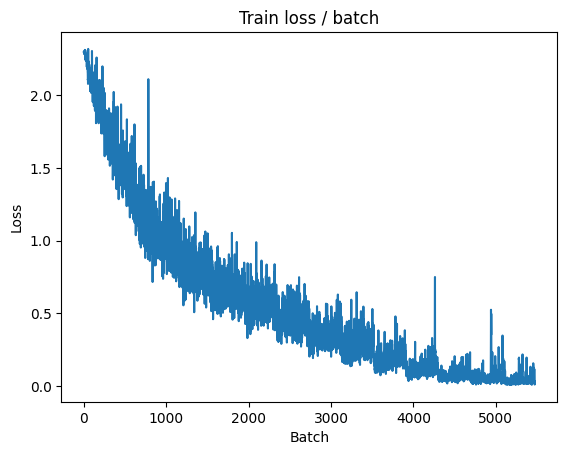

[TRAIN Batch 200/391]	Time 0.477s (0.504s)	Loss 0.0100 (0.0259)	Prec@1 100.0 ( 99.3)	Prec@5 100.0 (100.0)


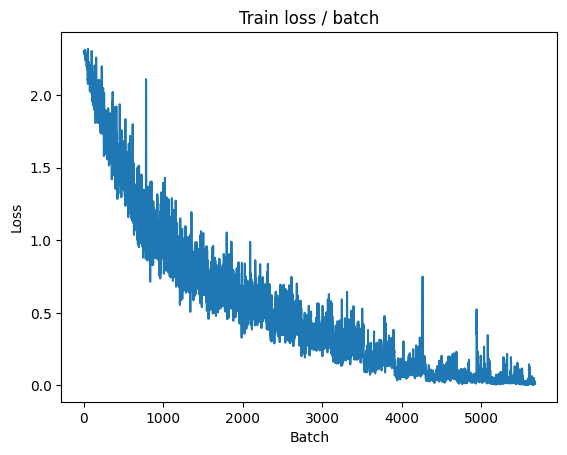


===============> Total time 194s	Avg loss 0.0425	Avg Prec@1 98.76 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 1.054s (1.054s)	Loss 1.0801 (1.0801)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 26s	Avg loss 1.2933	Avg Prec@1 76.56 %	Avg Prec@5 98.27 %



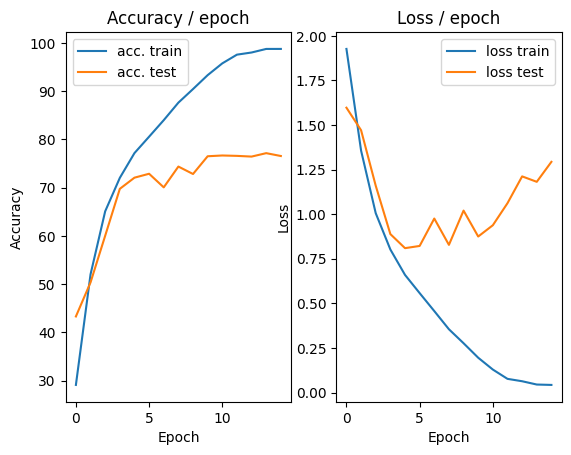

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 1.449s (1.449s)	Loss 0.0544 (0.0544)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


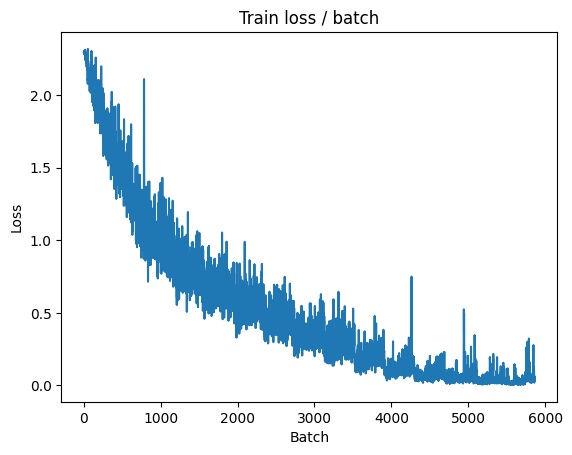

[TRAIN Batch 200/391]	Time 0.437s (0.495s)	Loss 0.0157 (0.0227)	Prec@1 100.0 ( 99.4)	Prec@5 100.0 (100.0)


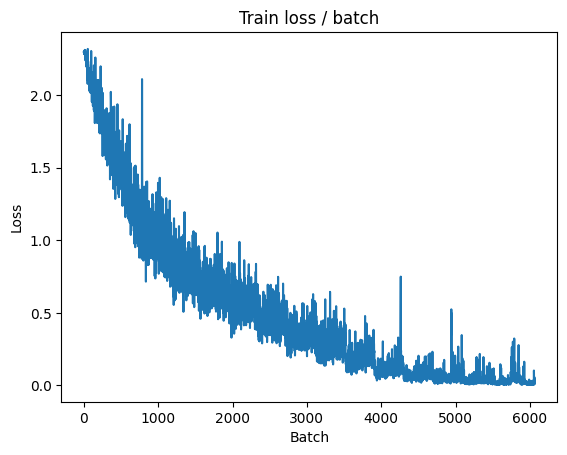


===============> Total time 194s	Avg loss 0.0235	Avg Prec@1 99.36 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.870s (0.870s)	Loss 1.1316 (1.1316)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 25s	Avg loss 1.3328	Avg Prec@1 77.82 %	Avg Prec@5 98.54 %



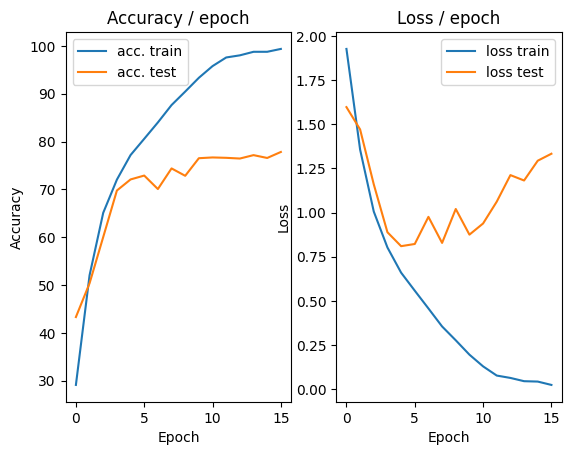

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 1.709s (1.709s)	Loss 0.0122 (0.0122)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


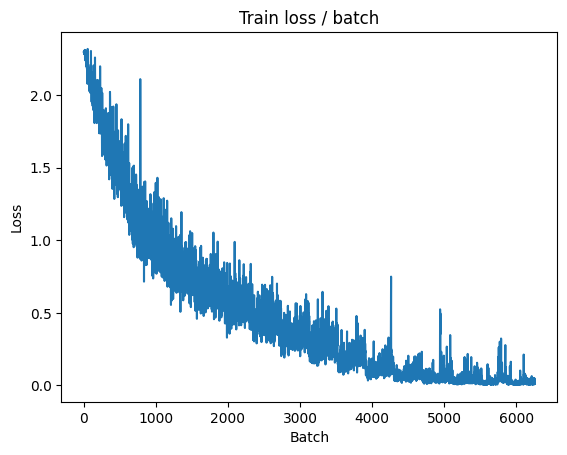

[TRAIN Batch 200/391]	Time 0.467s (0.499s)	Loss 0.0065 (0.0097)	Prec@1 100.0 ( 99.8)	Prec@5 100.0 (100.0)


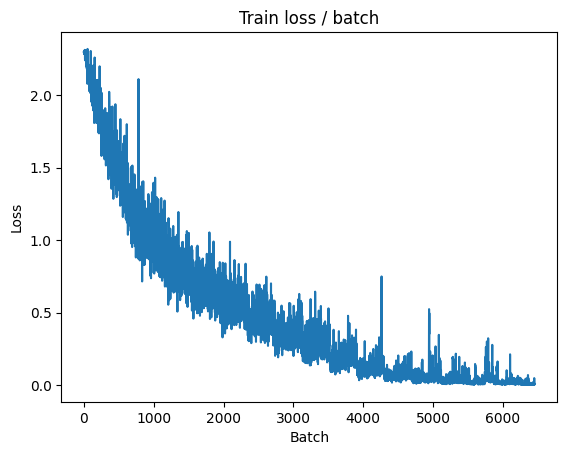


===============> Total time 194s	Avg loss 0.0089	Avg Prec@1 99.81 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 1.085s (1.085s)	Loss 1.1875 (1.1875)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 26s	Avg loss 1.3745	Avg Prec@1 78.12 %	Avg Prec@5 98.58 %



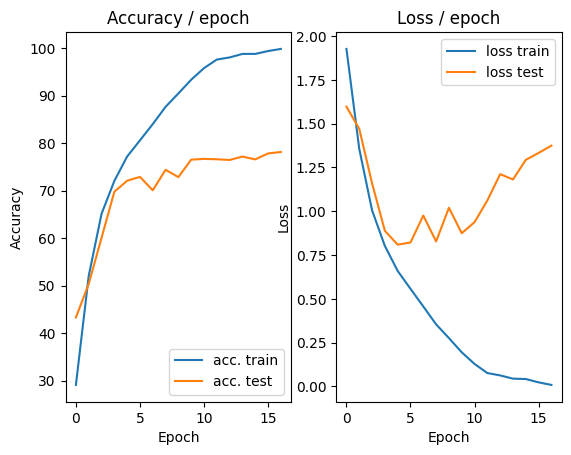

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 1.455s (1.455s)	Loss 0.0026 (0.0026)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


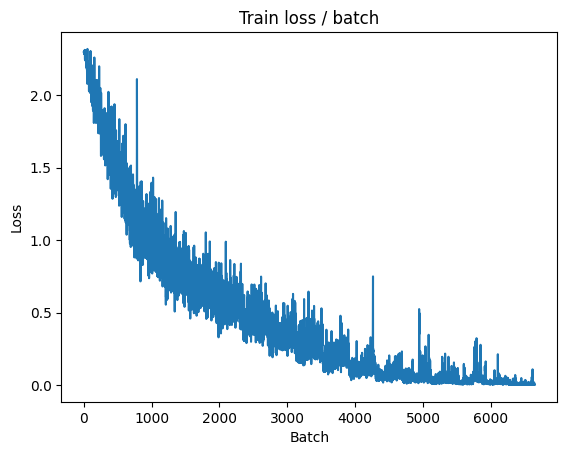

[TRAIN Batch 200/391]	Time 0.462s (0.505s)	Loss 0.0008 (0.0019)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


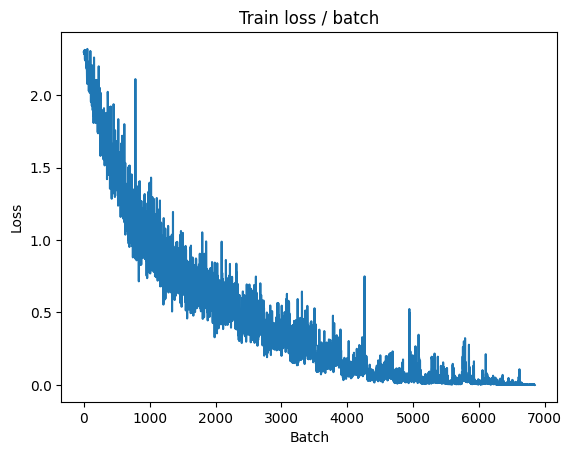

In [ ]:
main_cifar(epochs=20, get_dataset=get_cifar_dataset_zca)

## Data increase

In [26]:
def get_cifar_dataset_data_increase(batch_size, cuda=False):
    mean =[0.491, 0.482, 0.447]
    std = [0.202, 0.199, 0.201]
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.RandomCrop((28)),
            transforms.RandomHorizontalFlip(),
            transforms.Normalize(mean, std)
        ]))
    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.CenterCrop((28)),
            transforms.Normalize(mean, std)
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader

=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.444s (0.444s)	Loss 2.3005 (2.3005)	Prec@1  14.1 ( 14.1)	Prec@5  49.2 ( 49.2)


<Figure size 640x480 with 0 Axes>

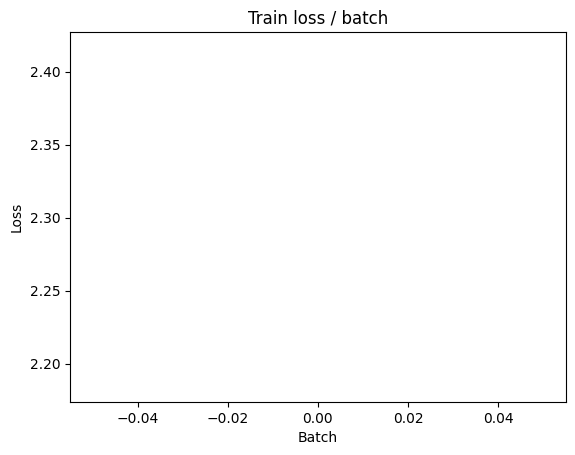

[TRAIN Batch 200/391]	Time 0.041s (0.046s)	Loss 1.6002 (1.9871)	Prec@1  40.6 ( 26.8)	Prec@5  90.6 ( 77.9)


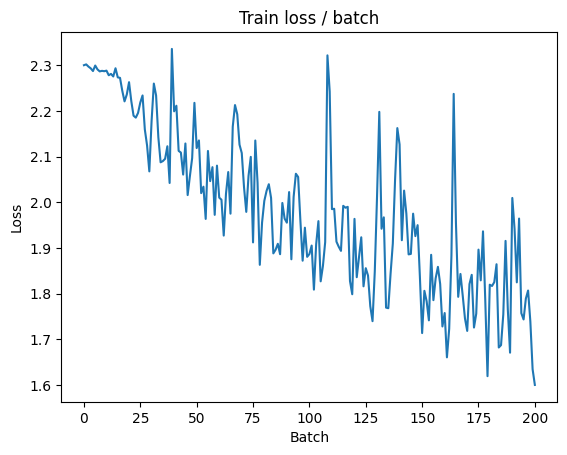


===============> Total time 18s	Avg loss 1.8238	Avg Prec@1 33.18 %	Avg Prec@5 83.36 %

[EVAL Batch 000/079]	Time 0.137s (0.137s)	Loss 1.5226 (1.5226)	Prec@1  50.0 ( 50.0)	Prec@5  91.4 ( 91.4)

===============> Total time 2s	Avg loss 1.5355	Avg Prec@1 44.68 %	Avg Prec@5 92.40 %



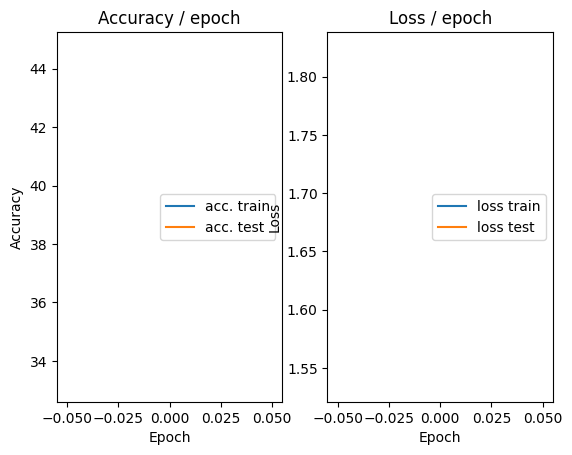

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.188s (0.188s)	Loss 1.4419 (1.4419)	Prec@1  50.0 ( 50.0)	Prec@5  90.6 ( 90.6)


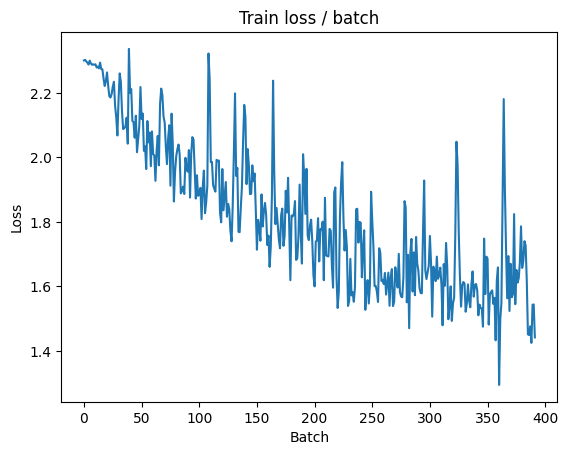

[TRAIN Batch 200/391]	Time 0.060s (0.046s)	Loss 1.4998 (1.4643)	Prec@1  38.3 ( 47.2)	Prec@5  91.4 ( 92.1)


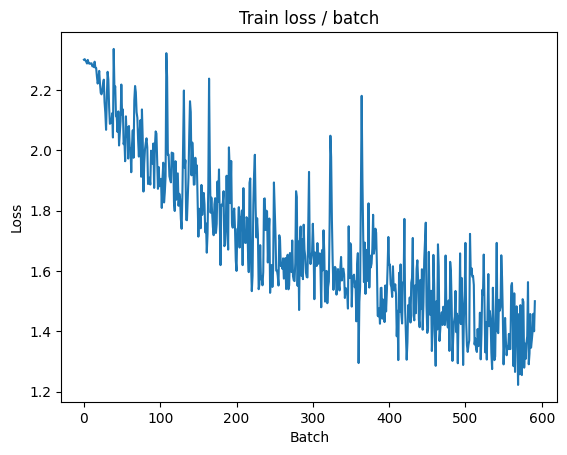


===============> Total time 16s	Avg loss 1.4089	Avg Prec@1 49.50 %	Avg Prec@5 92.80 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 1.2131 (1.2131)	Prec@1  57.8 ( 57.8)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 1.2417	Avg Prec@1 55.17 %	Avg Prec@5 94.77 %



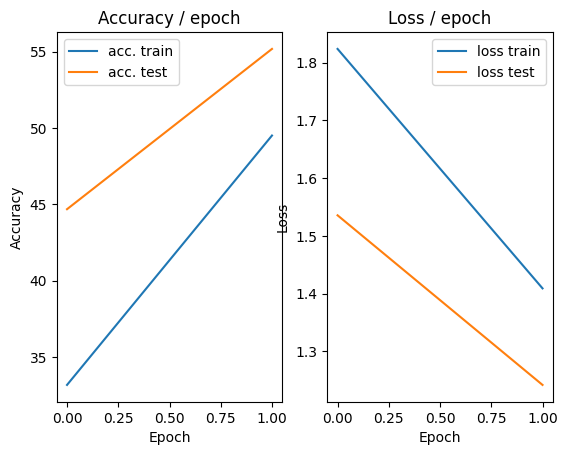

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.313s (0.313s)	Loss 1.2858 (1.2858)	Prec@1  59.4 ( 59.4)	Prec@5  92.2 ( 92.2)


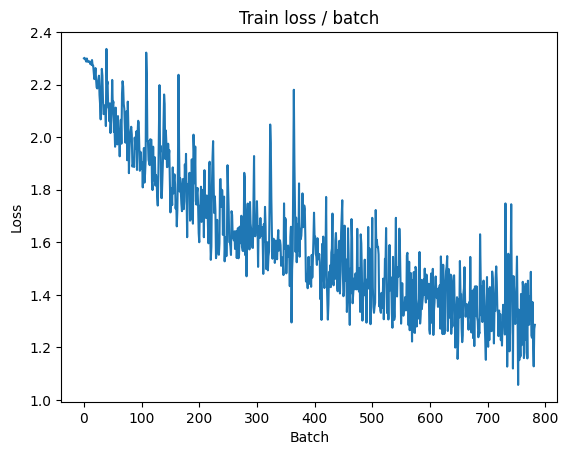

[TRAIN Batch 200/391]	Time 0.029s (0.045s)	Loss 1.1834 (1.2217)	Prec@1  60.2 ( 57.0)	Prec@5  96.9 ( 94.8)


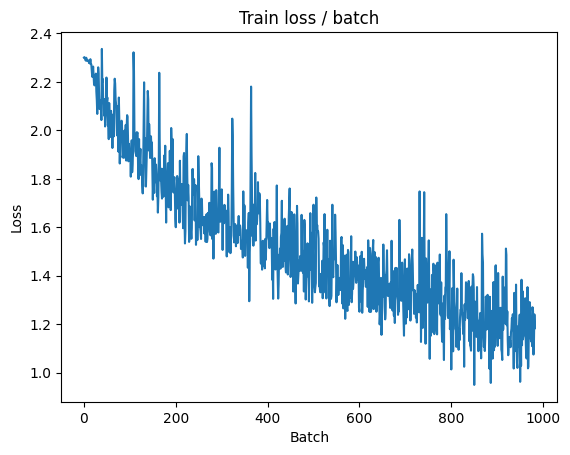


===============> Total time 19s	Avg loss 1.1806	Avg Prec@1 58.40 %	Avg Prec@5 95.21 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 1.2249 (1.2249)	Prec@1  57.0 ( 57.0)	Prec@5  94.5 ( 94.5)

===============> Total time 2s	Avg loss 1.3684	Avg Prec@1 52.29 %	Avg Prec@5 94.03 %



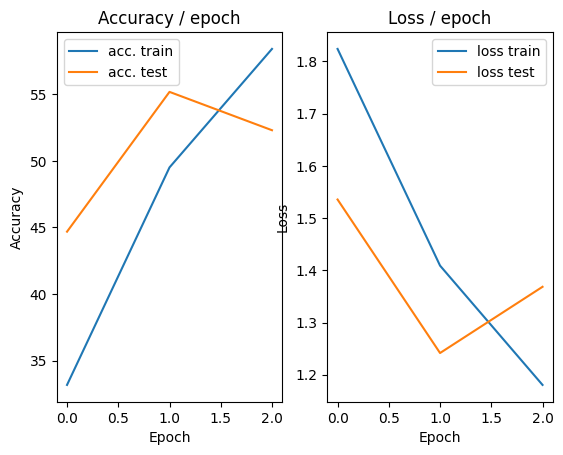

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.182s (0.182s)	Loss 1.4921 (1.4921)	Prec@1  50.0 ( 50.0)	Prec@5  93.0 ( 93.0)


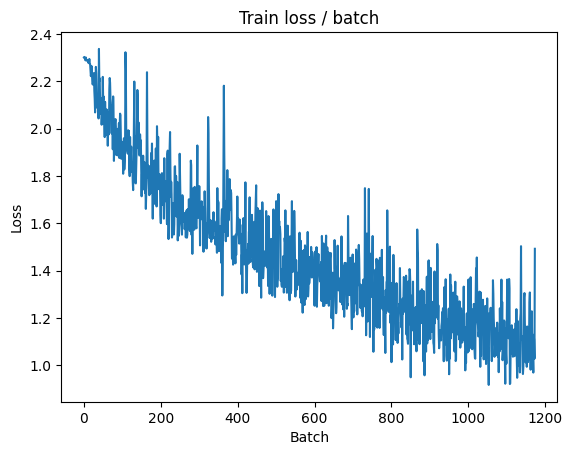

[TRAIN Batch 200/391]	Time 0.010s (0.051s)	Loss 1.1325 (1.0623)	Prec@1  60.2 ( 62.8)	Prec@5  96.1 ( 96.4)


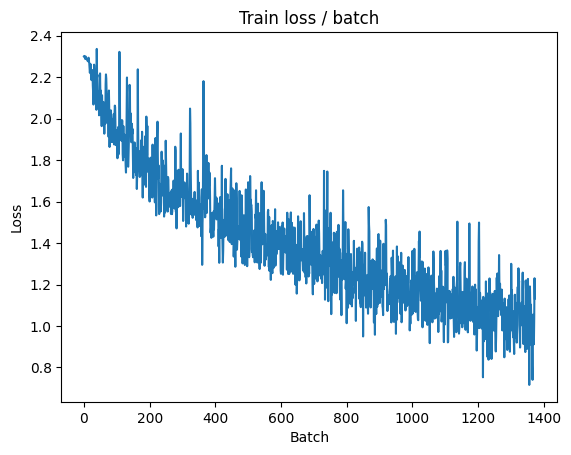


===============> Total time 19s	Avg loss 1.0295	Avg Prec@1 63.98 %	Avg Prec@5 96.54 %

[EVAL Batch 000/079]	Time 0.131s (0.131s)	Loss 0.8859 (0.8859)	Prec@1  68.8 ( 68.8)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.9791	Avg Prec@1 66.08 %	Avg Prec@5 96.62 %



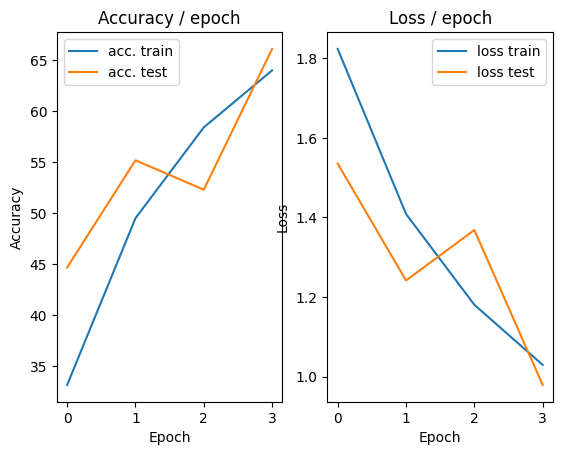

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.207s (0.207s)	Loss 0.8752 (0.8752)	Prec@1  67.2 ( 67.2)	Prec@5  96.9 ( 96.9)


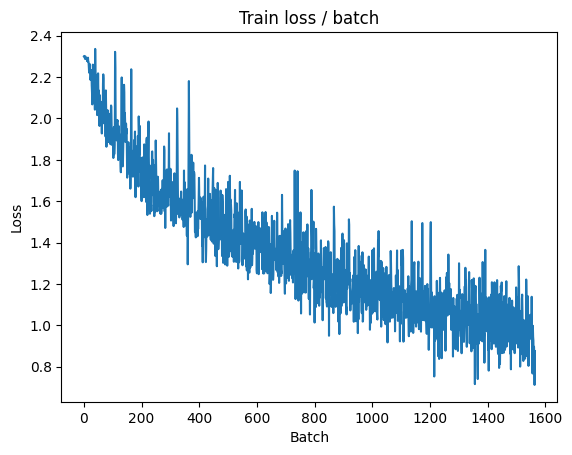

[TRAIN Batch 200/391]	Time 0.068s (0.050s)	Loss 0.9613 (0.9292)	Prec@1  68.8 ( 67.5)	Prec@5  96.9 ( 97.2)


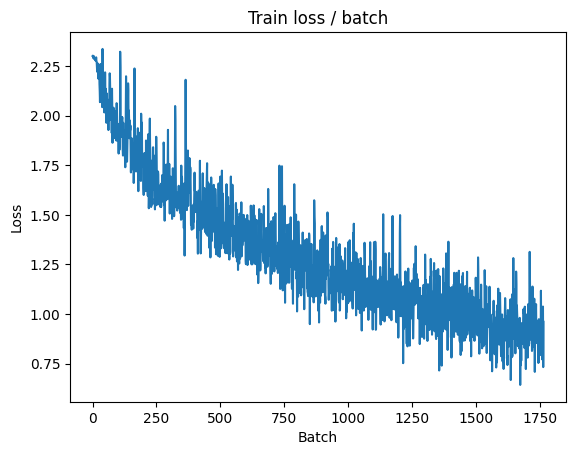


===============> Total time 18s	Avg loss 0.9117	Avg Prec@1 68.17 %	Avg Prec@5 97.25 %

[EVAL Batch 000/079]	Time 0.257s (0.257s)	Loss 0.7704 (0.7704)	Prec@1  70.3 ( 70.3)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.9020	Avg Prec@1 68.91 %	Avg Prec@5 96.64 %



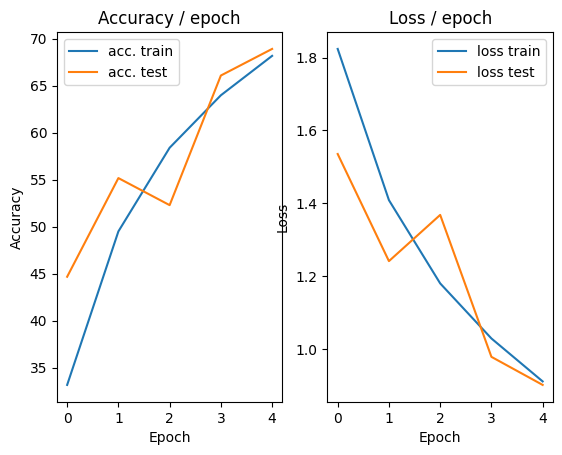

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.186s (0.186s)	Loss 0.9650 (0.9650)	Prec@1  66.4 ( 66.4)	Prec@5  95.3 ( 95.3)


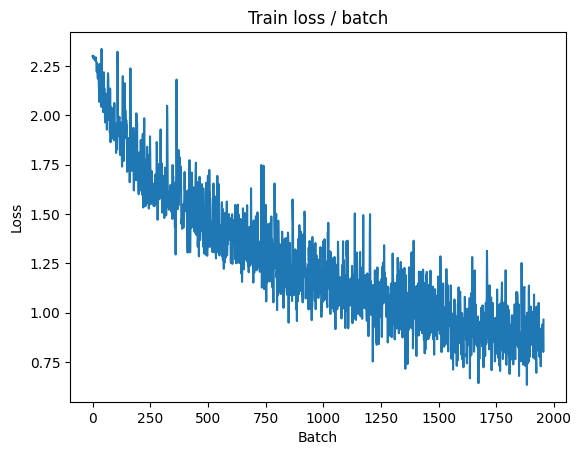

[TRAIN Batch 200/391]	Time 0.017s (0.047s)	Loss 0.7851 (0.8405)	Prec@1  75.8 ( 70.8)	Prec@5  98.4 ( 97.6)


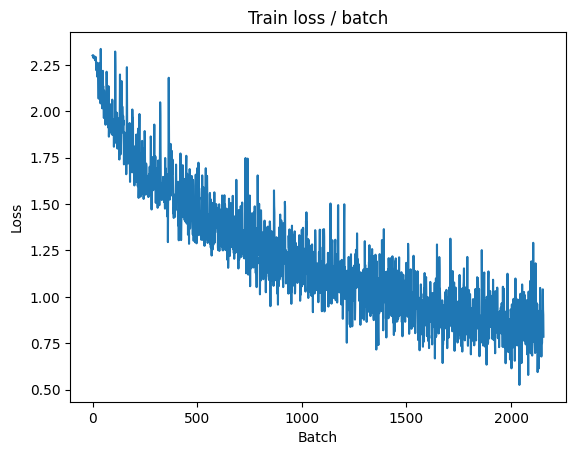


===============> Total time 20s	Avg loss 0.8324	Avg Prec@1 71.15 %	Avg Prec@5 97.63 %

[EVAL Batch 000/079]	Time 0.171s (0.171s)	Loss 0.6963 (0.6963)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.8225	Avg Prec@1 71.87 %	Avg Prec@5 97.77 %



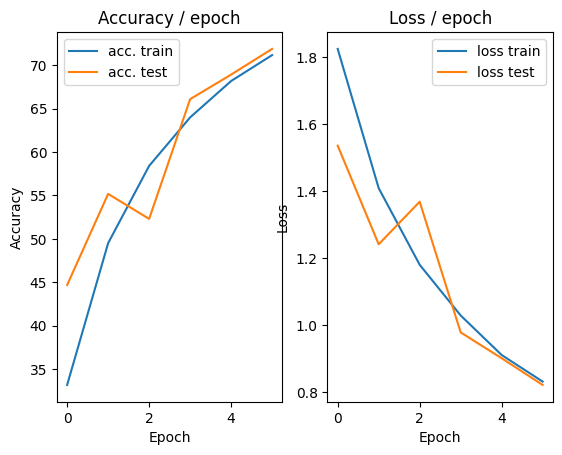

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.176s (0.176s)	Loss 0.7670 (0.7670)	Prec@1  71.9 ( 71.9)	Prec@5  96.1 ( 96.1)


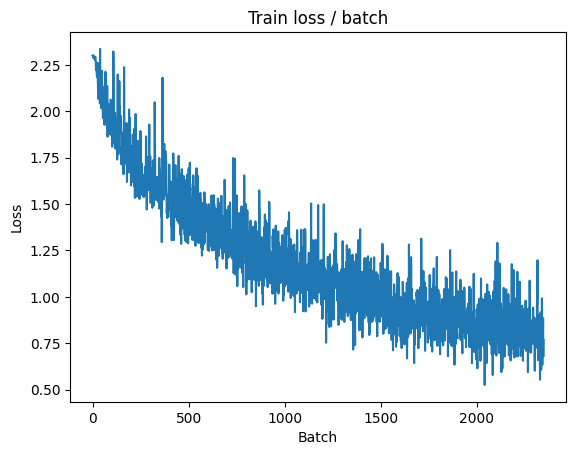

[TRAIN Batch 200/391]	Time 0.059s (0.041s)	Loss 0.7355 (0.7700)	Prec@1  74.2 ( 73.1)	Prec@5  98.4 ( 98.0)


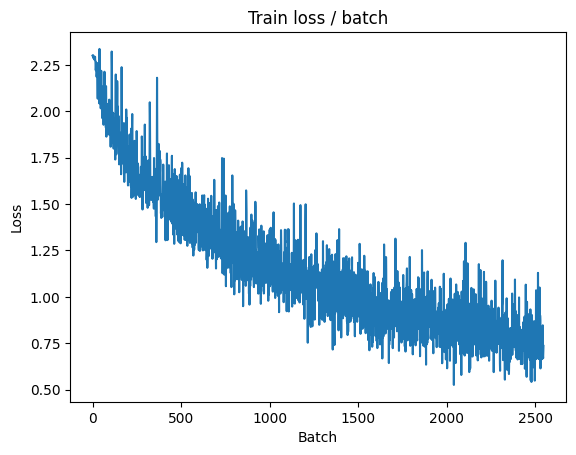


===============> Total time 16s	Avg loss 0.7655	Avg Prec@1 73.32 %	Avg Prec@5 98.08 %

[EVAL Batch 000/079]	Time 0.134s (0.134s)	Loss 0.7434 (0.7434)	Prec@1  73.4 ( 73.4)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.8365	Avg Prec@1 71.26 %	Avg Prec@5 97.83 %



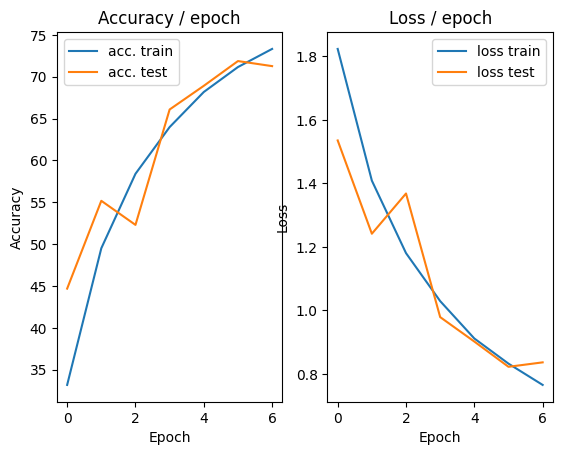

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.188s (0.188s)	Loss 0.8107 (0.8107)	Prec@1  71.1 ( 71.1)	Prec@5  98.4 ( 98.4)


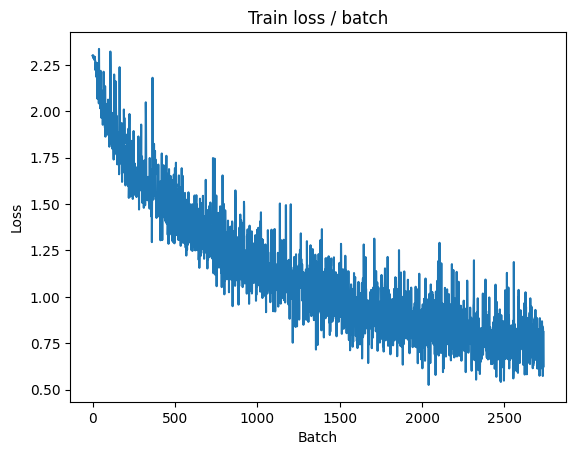

[TRAIN Batch 200/391]	Time 0.011s (0.046s)	Loss 0.6965 (0.7112)	Prec@1  76.6 ( 75.1)	Prec@5  96.9 ( 98.4)


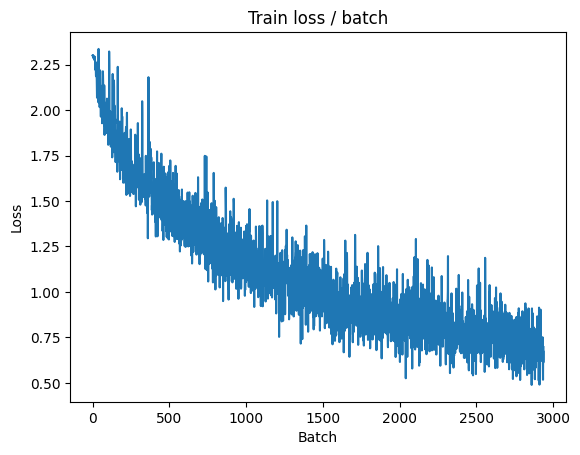


===============> Total time 18s	Avg loss 0.7096	Avg Prec@1 75.32 %	Avg Prec@5 98.35 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 0.6876 (0.6876)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.7076	Avg Prec@1 75.22 %	Avg Prec@5 98.30 %



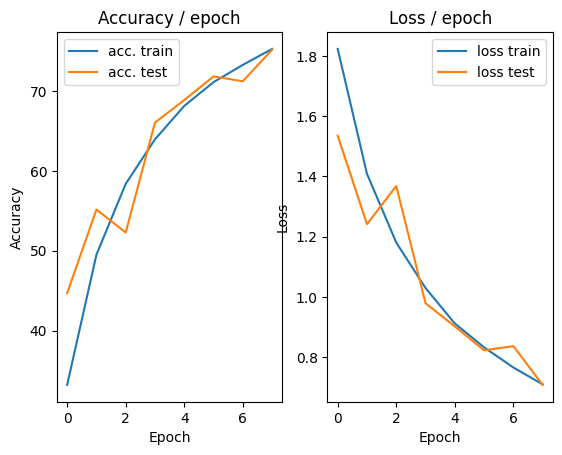

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.190s (0.190s)	Loss 0.8201 (0.8201)	Prec@1  70.3 ( 70.3)	Prec@5  98.4 ( 98.4)


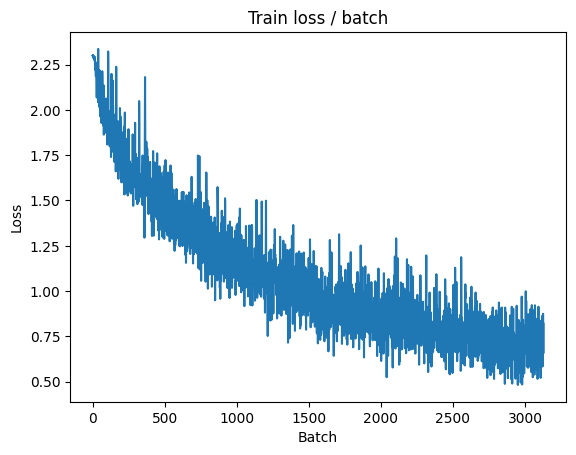

[TRAIN Batch 200/391]	Time 0.009s (0.046s)	Loss 0.5791 (0.6642)	Prec@1  77.3 ( 76.6)	Prec@5  99.2 ( 98.6)


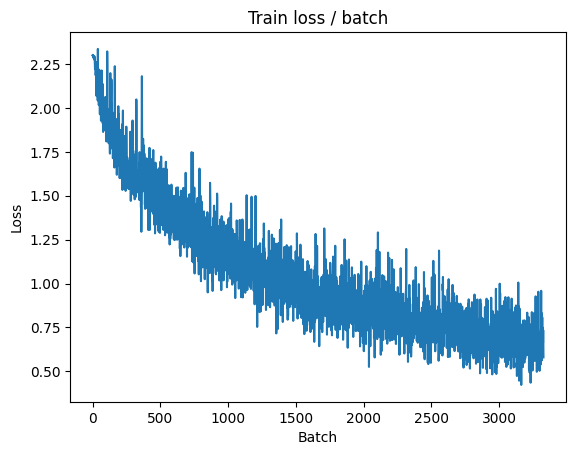


===============> Total time 17s	Avg loss 0.6632	Avg Prec@1 76.86 %	Avg Prec@5 98.57 %

[EVAL Batch 000/079]	Time 0.144s (0.144s)	Loss 0.6506 (0.6506)	Prec@1  76.6 ( 76.6)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6851	Avg Prec@1 76.23 %	Avg Prec@5 98.44 %



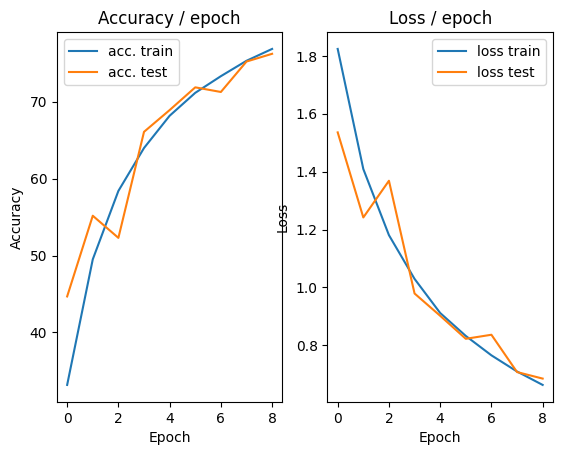

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.297s (0.297s)	Loss 0.5475 (0.5475)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)


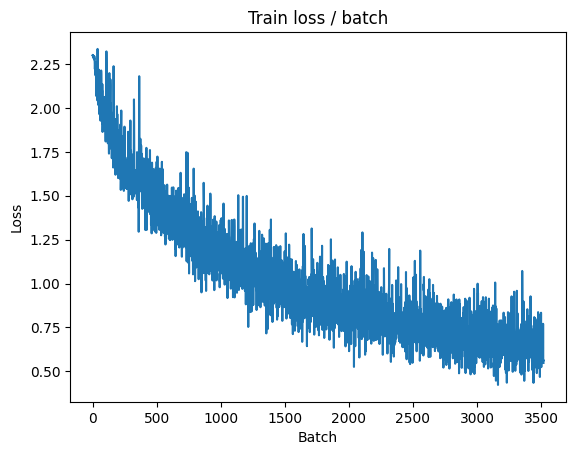

[TRAIN Batch 200/391]	Time 0.046s (0.046s)	Loss 0.5419 (0.6194)	Prec@1  84.4 ( 78.4)	Prec@5  98.4 ( 98.9)


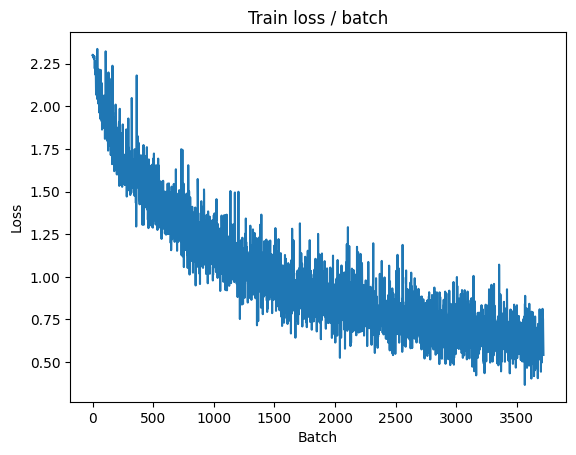


===============> Total time 17s	Avg loss 0.6222	Avg Prec@1 78.37 %	Avg Prec@5 98.83 %

[EVAL Batch 000/079]	Time 0.145s (0.145s)	Loss 0.6289 (0.6289)	Prec@1  80.5 ( 80.5)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.7037	Avg Prec@1 75.40 %	Avg Prec@5 98.48 %



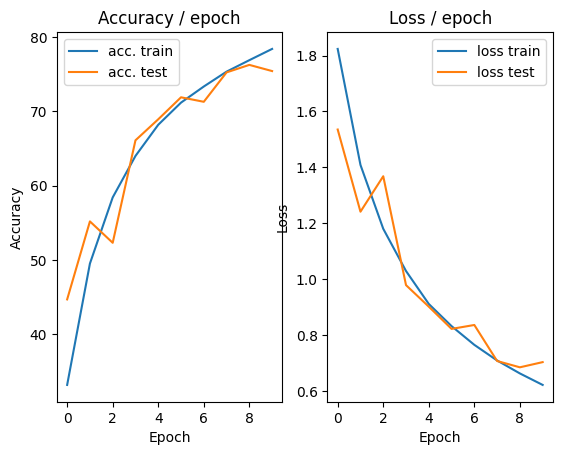

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.194s (0.194s)	Loss 0.4927 (0.4927)	Prec@1  78.1 ( 78.1)	Prec@5 100.0 (100.0)


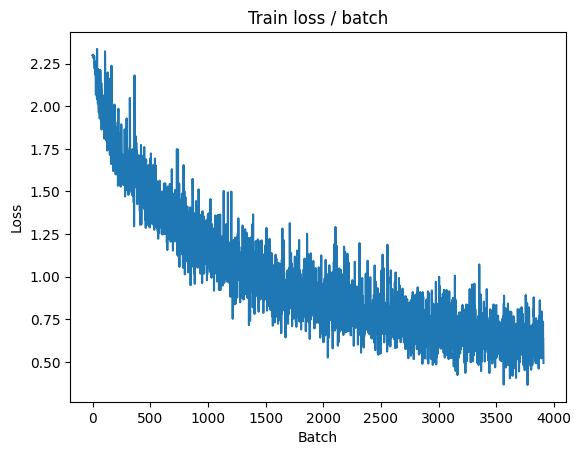

[TRAIN Batch 200/391]	Time 0.010s (0.046s)	Loss 0.5726 (0.5825)	Prec@1  78.1 ( 79.7)	Prec@5 100.0 ( 99.0)


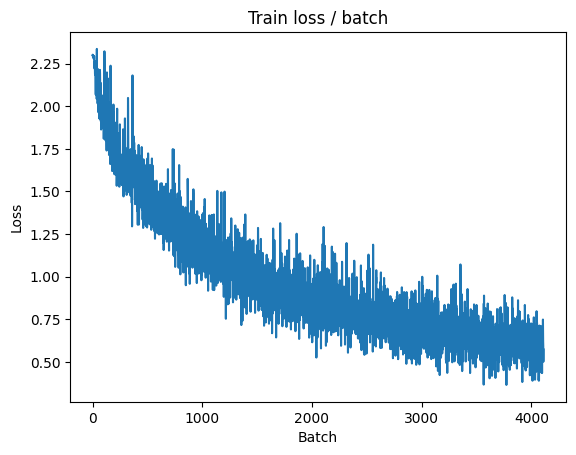


===============> Total time 17s	Avg loss 0.5877	Avg Prec@1 79.46 %	Avg Prec@5 98.91 %

[EVAL Batch 000/079]	Time 0.253s (0.253s)	Loss 0.5384 (0.5384)	Prec@1  84.4 ( 84.4)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.6531	Avg Prec@1 77.78 %	Avg Prec@5 98.33 %



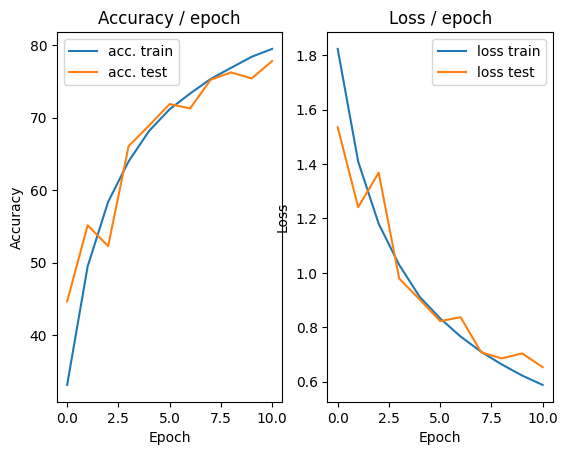

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.186s (0.186s)	Loss 0.4230 (0.4230)	Prec@1  90.6 ( 90.6)	Prec@5  99.2 ( 99.2)


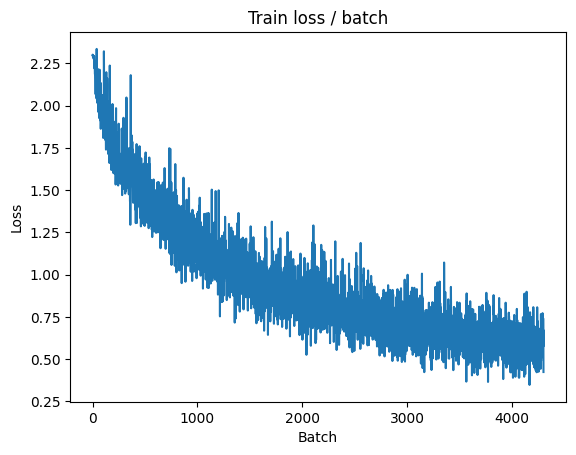

[TRAIN Batch 200/391]	Time 0.043s (0.043s)	Loss 0.6206 (0.5551)	Prec@1  82.0 ( 80.9)	Prec@5  96.9 ( 99.0)


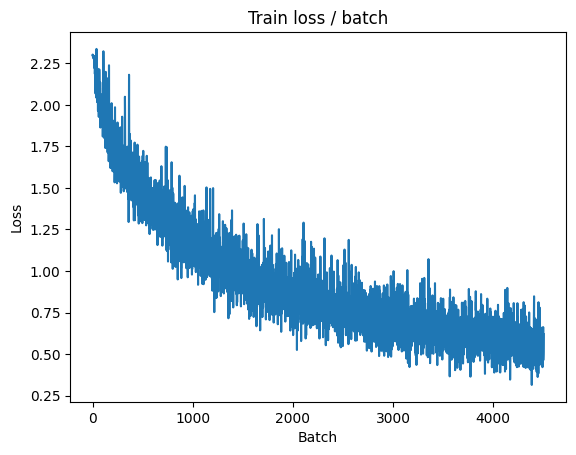


===============> Total time 16s	Avg loss 0.5586	Avg Prec@1 80.64 %	Avg Prec@5 99.00 %

[EVAL Batch 000/079]	Time 0.145s (0.145s)	Loss 0.5619 (0.5619)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6598	Avg Prec@1 78.01 %	Avg Prec@5 98.50 %



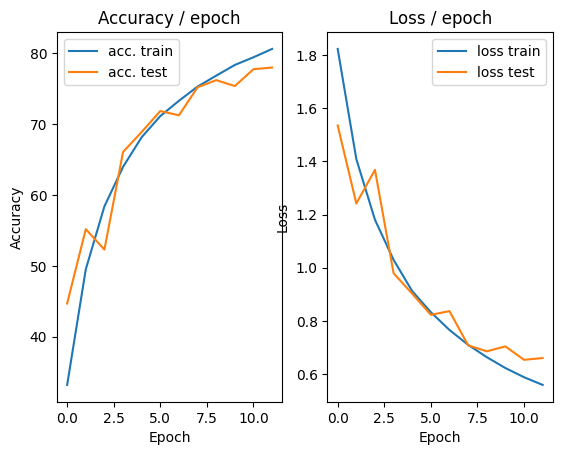

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.192s (0.192s)	Loss 0.3734 (0.3734)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)


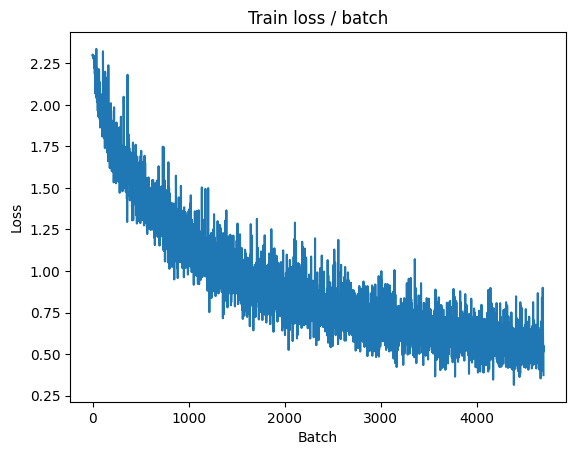

[TRAIN Batch 200/391]	Time 0.062s (0.045s)	Loss 0.6375 (0.5216)	Prec@1  78.9 ( 81.7)	Prec@5  98.4 ( 99.2)


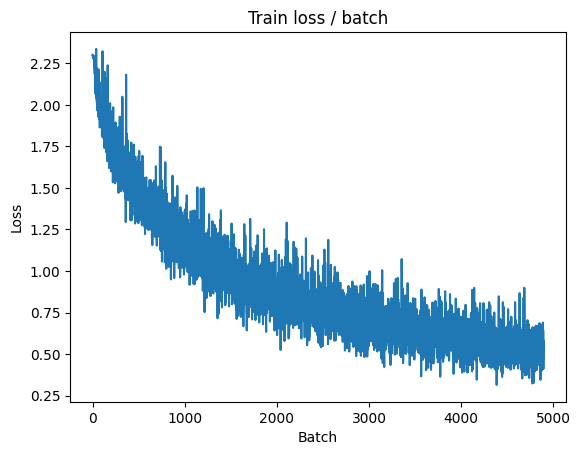


===============> Total time 17s	Avg loss 0.5260	Avg Prec@1 81.51 %	Avg Prec@5 99.16 %

[EVAL Batch 000/079]	Time 0.168s (0.168s)	Loss 0.6113 (0.6113)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6682	Avg Prec@1 77.88 %	Avg Prec@5 98.48 %



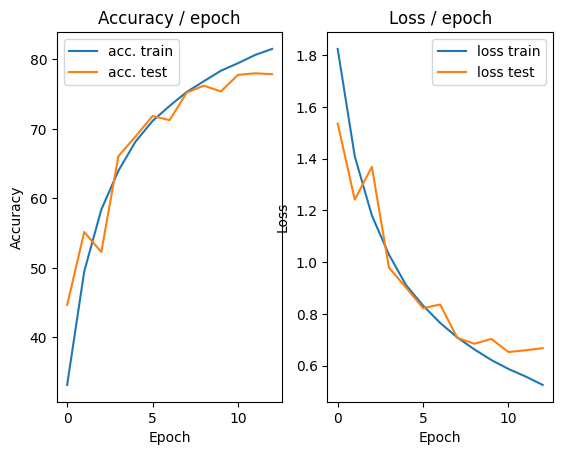

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.198s (0.198s)	Loss 0.4012 (0.4012)	Prec@1  82.0 ( 82.0)	Prec@5 100.0 (100.0)


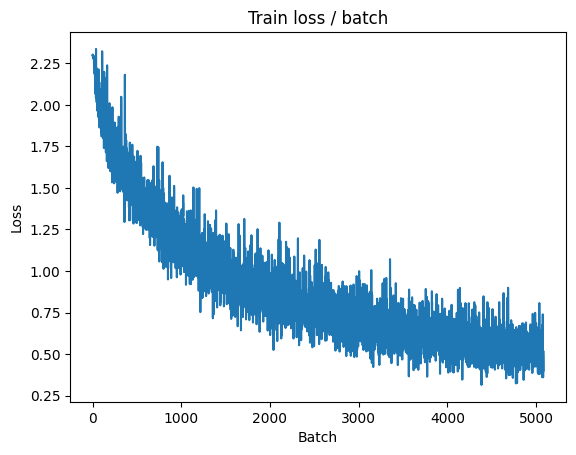

[TRAIN Batch 200/391]	Time 0.074s (0.045s)	Loss 0.4597 (0.4988)	Prec@1  83.6 ( 82.6)	Prec@5  99.2 ( 99.2)


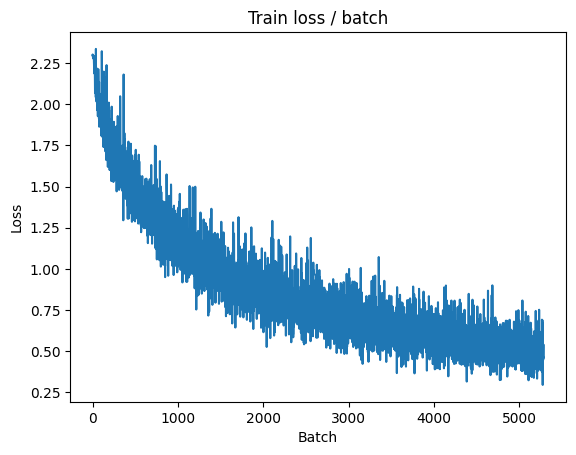


===============> Total time 16s	Avg loss 0.5072	Avg Prec@1 82.38 %	Avg Prec@5 99.23 %

[EVAL Batch 000/079]	Time 0.147s (0.147s)	Loss 0.5561 (0.5561)	Prec@1  78.9 ( 78.9)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6067	Avg Prec@1 79.74 %	Avg Prec@5 98.65 %



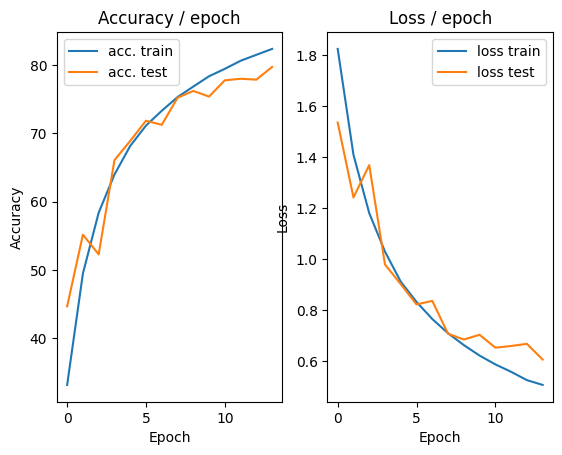

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.270s (0.270s)	Loss 0.4878 (0.4878)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)


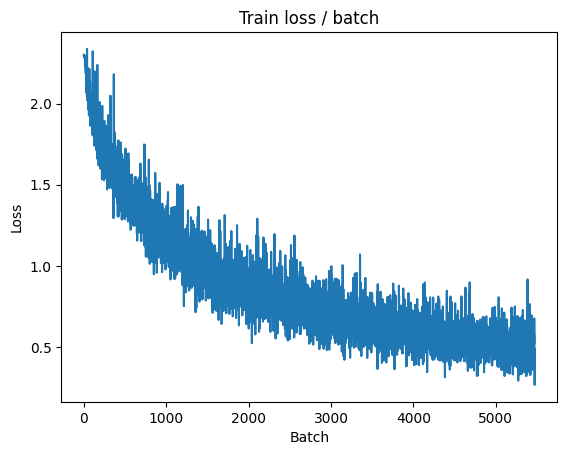

[TRAIN Batch 200/391]	Time 0.023s (0.044s)	Loss 0.4223 (0.4660)	Prec@1  87.5 ( 83.7)	Prec@5  99.2 ( 99.4)


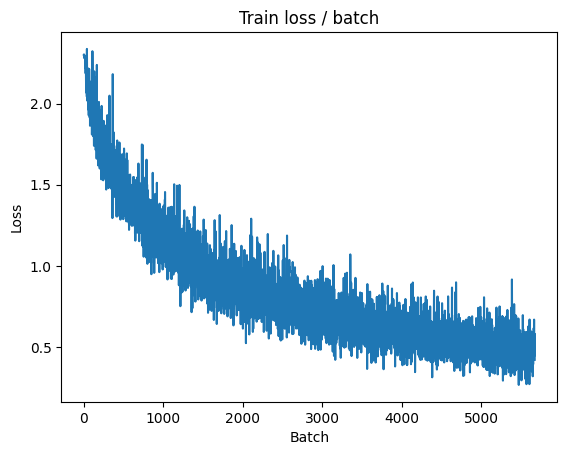


===============> Total time 17s	Avg loss 0.4746	Avg Prec@1 83.50 %	Avg Prec@5 99.36 %

[EVAL Batch 000/079]	Time 0.147s (0.147s)	Loss 0.8489 (0.8489)	Prec@1  70.3 ( 70.3)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7786	Avg Prec@1 75.09 %	Avg Prec@5 98.59 %



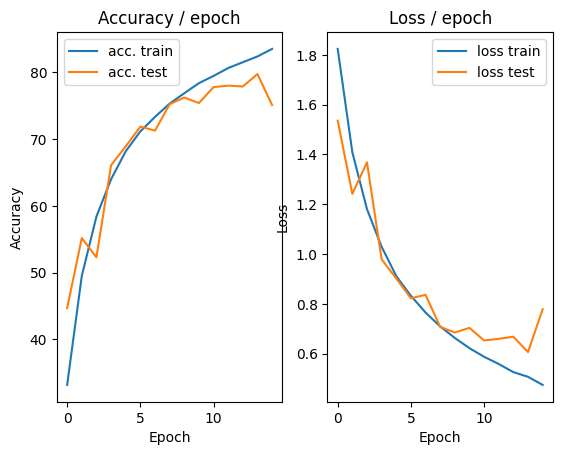

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.207s (0.207s)	Loss 0.4272 (0.4272)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)


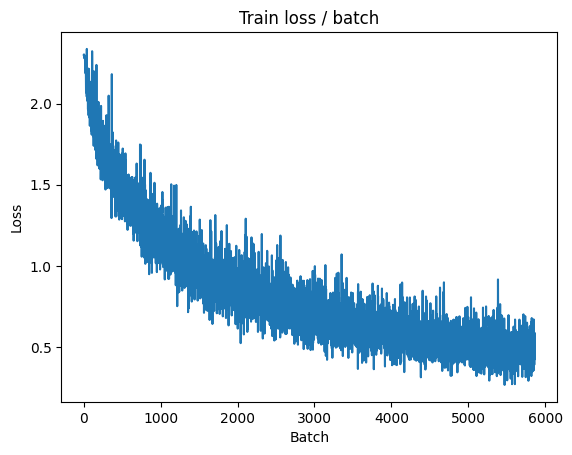

[TRAIN Batch 200/391]	Time 0.018s (0.044s)	Loss 0.3908 (0.4498)	Prec@1  86.7 ( 84.5)	Prec@5 100.0 ( 99.4)


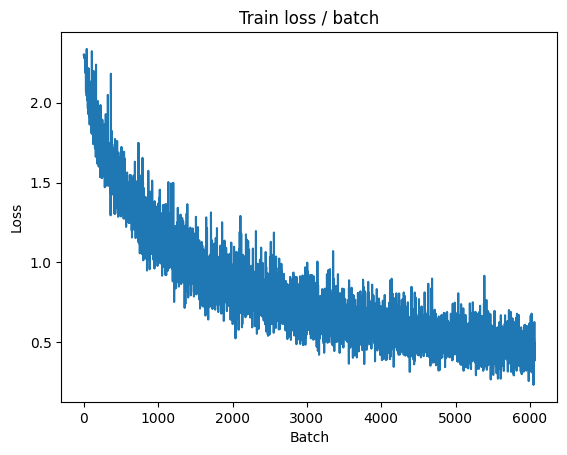


===============> Total time 16s	Avg loss 0.4524	Avg Prec@1 84.29 %	Avg Prec@5 99.44 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 0.6513 (0.6513)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.6201	Avg Prec@1 79.72 %	Avg Prec@5 98.78 %



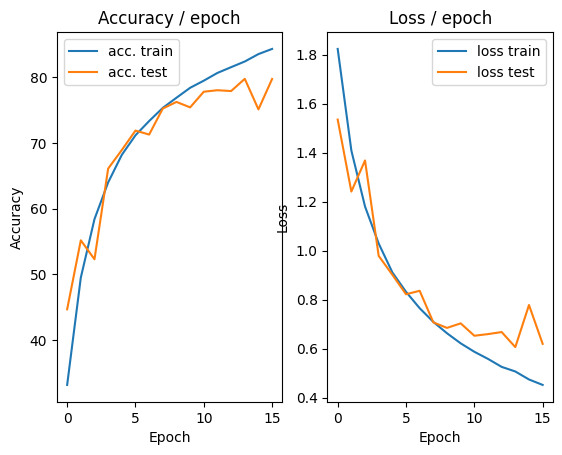

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.193s (0.193s)	Loss 0.4664 (0.4664)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)


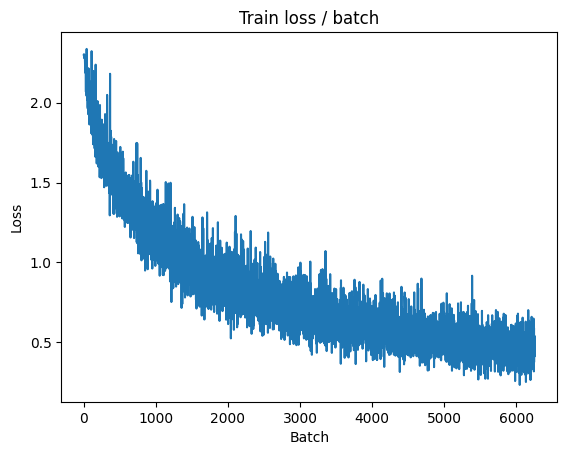

[TRAIN Batch 200/391]	Time 0.061s (0.040s)	Loss 0.4529 (0.4266)	Prec@1  84.4 ( 85.2)	Prec@5  99.2 ( 99.5)


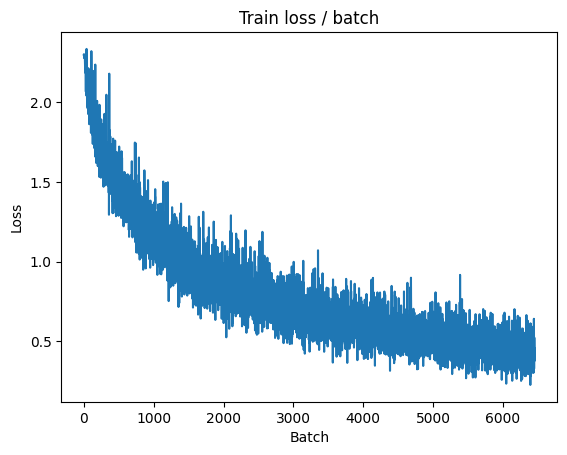


===============> Total time 16s	Avg loss 0.4351	Avg Prec@1 84.91 %	Avg Prec@5 99.46 %

[EVAL Batch 000/079]	Time 0.167s (0.167s)	Loss 0.5720 (0.5720)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6558	Avg Prec@1 79.31 %	Avg Prec@5 98.63 %



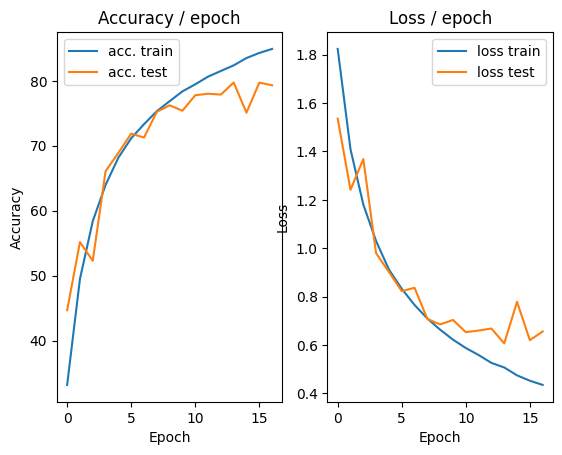

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.213s (0.213s)	Loss 0.4186 (0.4186)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)


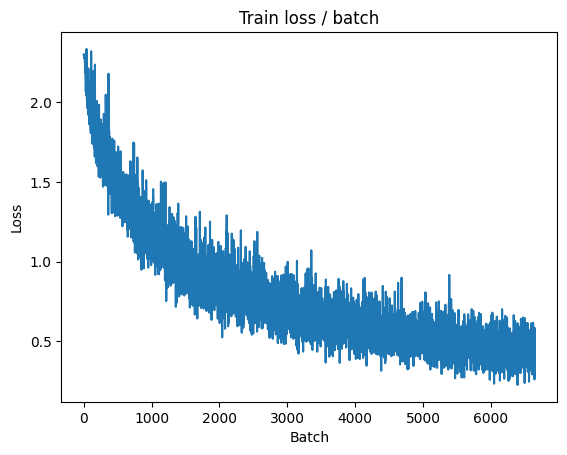

[TRAIN Batch 200/391]	Time 0.067s (0.046s)	Loss 0.4568 (0.4128)	Prec@1  83.6 ( 85.6)	Prec@5 100.0 ( 99.6)


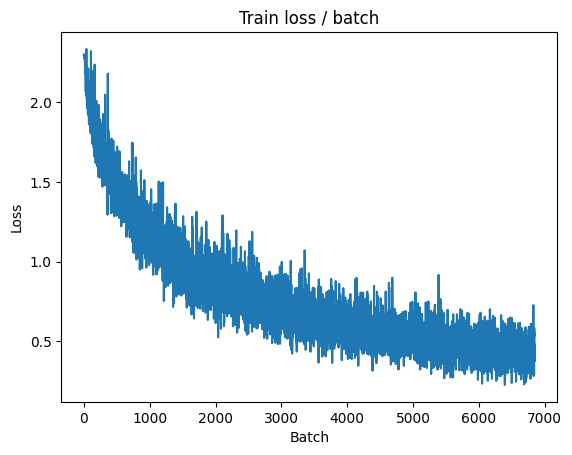


===============> Total time 16s	Avg loss 0.4178	Avg Prec@1 85.36 %	Avg Prec@5 99.60 %

[EVAL Batch 000/079]	Time 0.254s (0.254s)	Loss 0.5880 (0.5880)	Prec@1  79.7 ( 79.7)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.6420	Avg Prec@1 79.16 %	Avg Prec@5 98.26 %



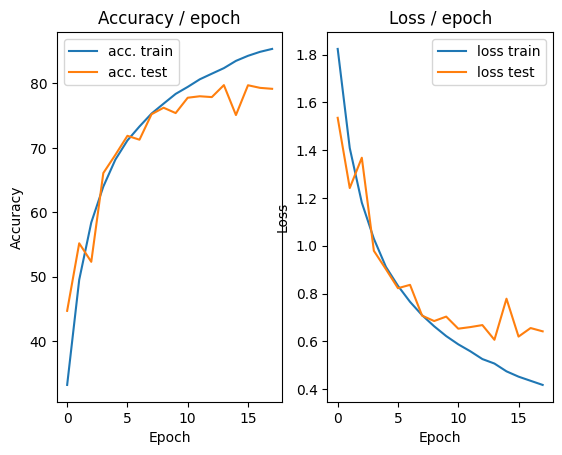

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.244s (0.244s)	Loss 0.4024 (0.4024)	Prec@1  87.5 ( 87.5)	Prec@5  99.2 ( 99.2)


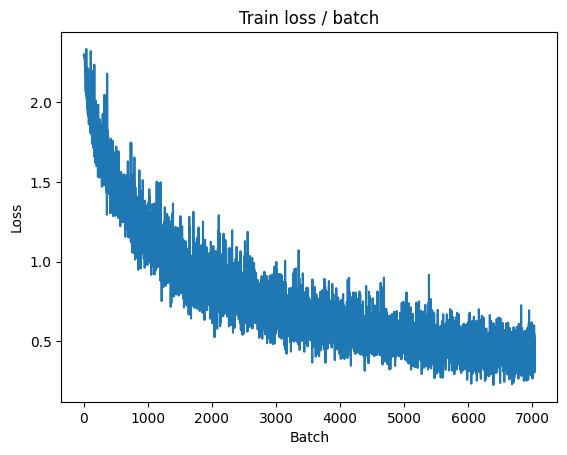

[TRAIN Batch 200/391]	Time 0.051s (0.040s)	Loss 0.3174 (0.3838)	Prec@1  92.2 ( 86.8)	Prec@5 100.0 ( 99.6)


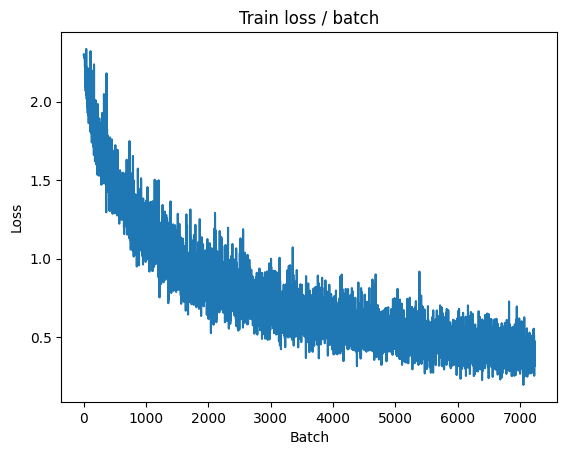


===============> Total time 16s	Avg loss 0.3949	Avg Prec@1 86.42 %	Avg Prec@5 99.57 %

[EVAL Batch 000/079]	Time 0.147s (0.147s)	Loss 0.6113 (0.6113)	Prec@1  82.8 ( 82.8)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.6475	Avg Prec@1 79.75 %	Avg Prec@5 98.62 %



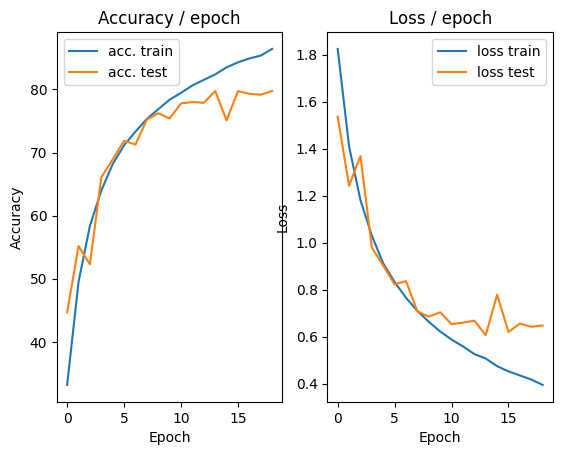

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.229s (0.229s)	Loss 0.4403 (0.4403)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)


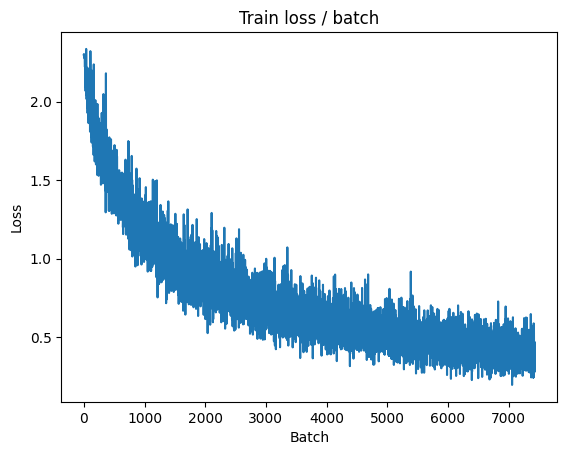

[TRAIN Batch 200/391]	Time 0.022s (0.044s)	Loss 0.4013 (0.3709)	Prec@1  85.9 ( 86.9)	Prec@5 100.0 ( 99.6)


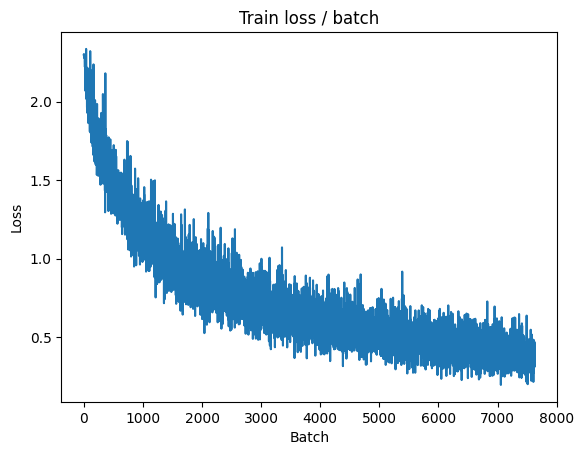


===============> Total time 17s	Avg loss 0.3794	Avg Prec@1 86.77 %	Avg Prec@5 99.61 %

[EVAL Batch 000/079]	Time 0.152s (0.152s)	Loss 0.6048 (0.6048)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.6356	Avg Prec@1 79.72 %	Avg Prec@5 98.71 %



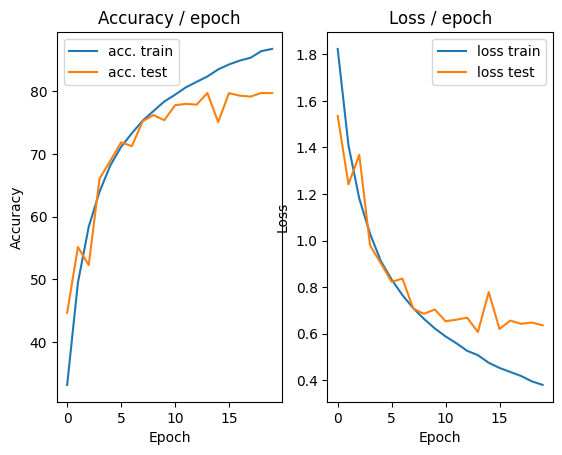

In [27]:
main_cifar(batch_size=128, epochs=20, cuda=True, get_dataset=get_cifar_dataset_data_increase)

## Data increase (bonus)

In [30]:
def get_cifar_dataset_data_increase_bonus(batch_size, cuda=False):
    mean =[0.491, 0.482, 0.447]
    std = [0.202, 0.199, 0.201]
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.RandomCrop((28)),
            transforms.RandomAffine(degrees=10, translate=(0.1, 0.1), scale=(0.9, 1.1)),
            transforms.Normalize(mean, std)
        ]))
    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.CenterCrop((28)),
            transforms.Normalize(mean, std)
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader

=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.291s (0.291s)	Loss 2.3052 (2.3052)	Prec@1   9.4 (  9.4)	Prec@5  50.8 ( 50.8)


<Figure size 640x480 with 0 Axes>

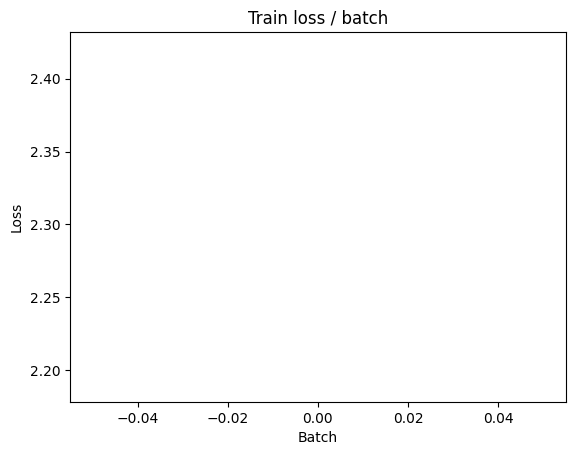

[TRAIN Batch 200/391]	Time 0.021s (0.087s)	Loss 1.9430 (2.0315)	Prec@1  27.3 ( 25.3)	Prec@5  81.2 ( 76.4)


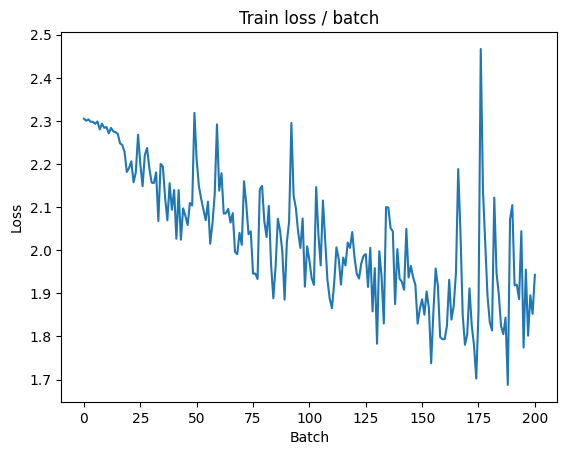


===============> Total time 35s	Avg loss 1.9023	Avg Prec@1 30.35 %	Avg Prec@5 81.38 %

[EVAL Batch 000/079]	Time 0.144s (0.144s)	Loss 1.7783 (1.7783)	Prec@1  40.6 ( 40.6)	Prec@5  87.5 ( 87.5)

===============> Total time 2s	Avg loss 1.7510	Avg Prec@1 36.70 %	Avg Prec@5 88.48 %



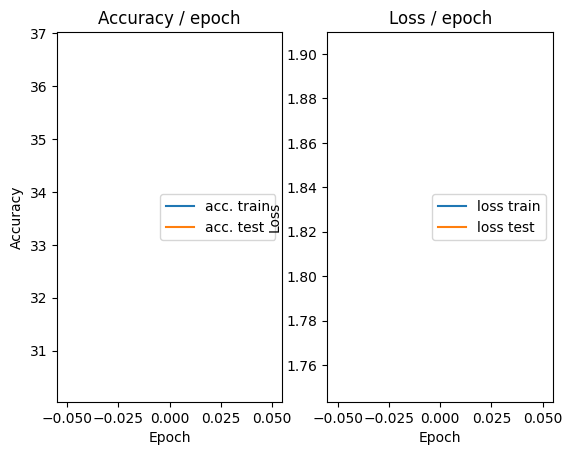

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.279s (0.279s)	Loss 1.8031 (1.8031)	Prec@1  33.6 ( 33.6)	Prec@5  89.8 ( 89.8)


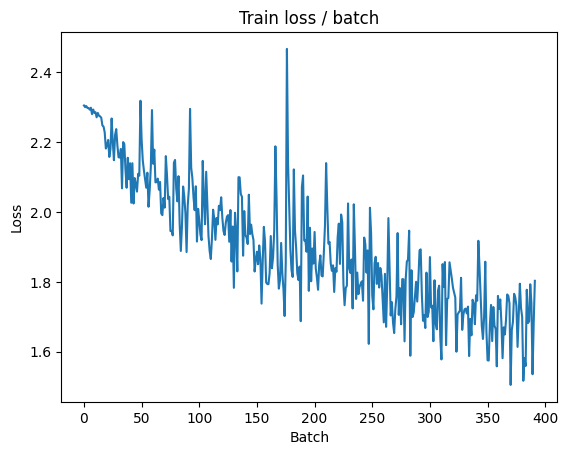

[TRAIN Batch 200/391]	Time 0.026s (0.088s)	Loss 1.9125 (1.6065)	Prec@1  35.2 ( 42.3)	Prec@5  89.8 ( 90.1)


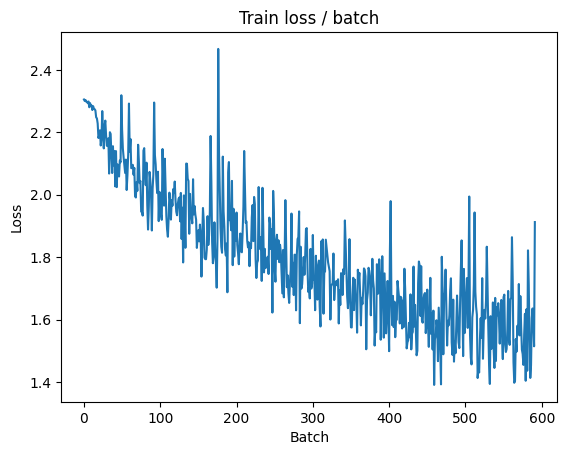


===============> Total time 35s	Avg loss 1.5534	Avg Prec@1 43.99 %	Avg Prec@5 90.93 %

[EVAL Batch 000/079]	Time 0.147s (0.147s)	Loss 1.2893 (1.2893)	Prec@1  60.9 ( 60.9)	Prec@5  92.2 ( 92.2)

===============> Total time 2s	Avg loss 1.3715	Avg Prec@1 51.06 %	Avg Prec@5 92.62 %



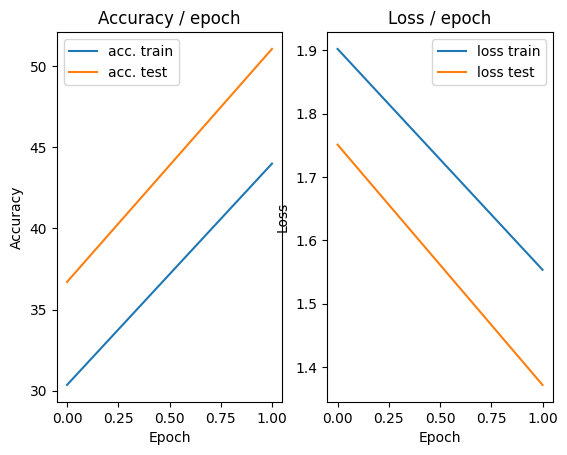

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.293s (0.293s)	Loss 1.4214 (1.4214)	Prec@1  43.8 ( 43.8)	Prec@5  93.0 ( 93.0)


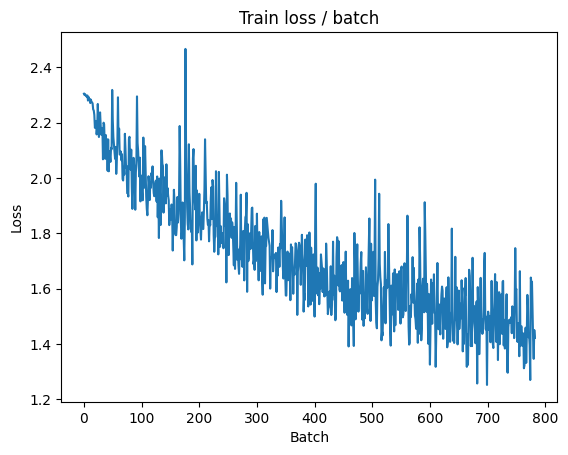

[TRAIN Batch 200/391]	Time 0.009s (0.089s)	Loss 1.5882 (1.4114)	Prec@1  41.4 ( 49.6)	Prec@5  88.3 ( 92.7)


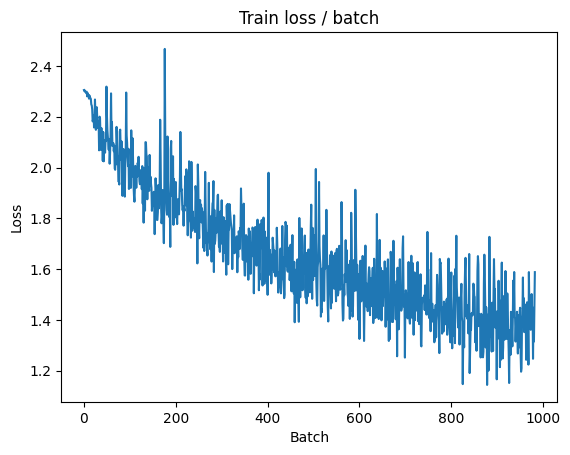


===============> Total time 35s	Avg loss 1.3793	Avg Prec@1 50.98 %	Avg Prec@5 93.06 %

[EVAL Batch 000/079]	Time 0.255s (0.255s)	Loss 1.1010 (1.1010)	Prec@1  60.2 ( 60.2)	Prec@5  93.0 ( 93.0)

===============> Total time 2s	Avg loss 1.2049	Avg Prec@1 56.99 %	Avg Prec@5 95.14 %



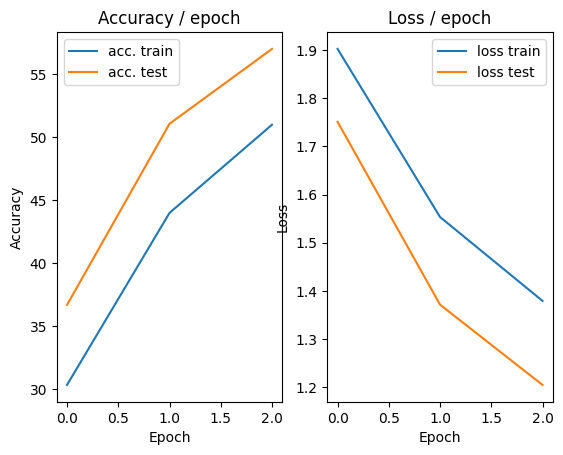

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.256s (0.256s)	Loss 1.3963 (1.3963)	Prec@1  51.6 ( 51.6)	Prec@5  96.9 ( 96.9)


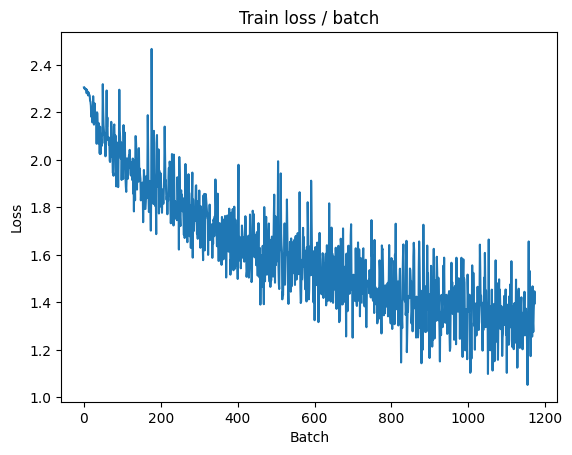

[TRAIN Batch 200/391]	Time 0.011s (0.089s)	Loss 1.3629 (1.2696)	Prec@1  53.1 ( 54.7)	Prec@5  95.3 ( 94.4)


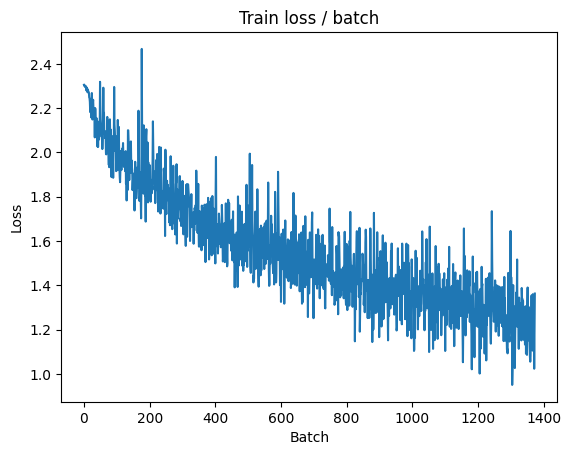


===============> Total time 34s	Avg loss 1.2486	Avg Prec@1 55.74 %	Avg Prec@5 94.66 %

[EVAL Batch 000/079]	Time 0.179s (0.179s)	Loss 1.1190 (1.1190)	Prec@1  64.8 ( 64.8)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 1.1980	Avg Prec@1 58.52 %	Avg Prec@5 94.63 %



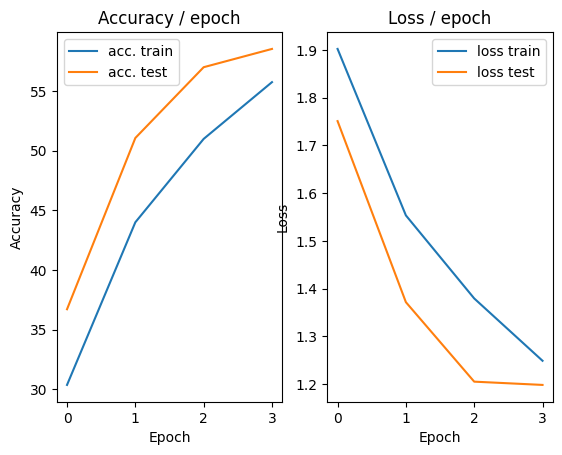

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.261s (0.261s)	Loss 1.3193 (1.3193)	Prec@1  53.9 ( 53.9)	Prec@5  92.2 ( 92.2)


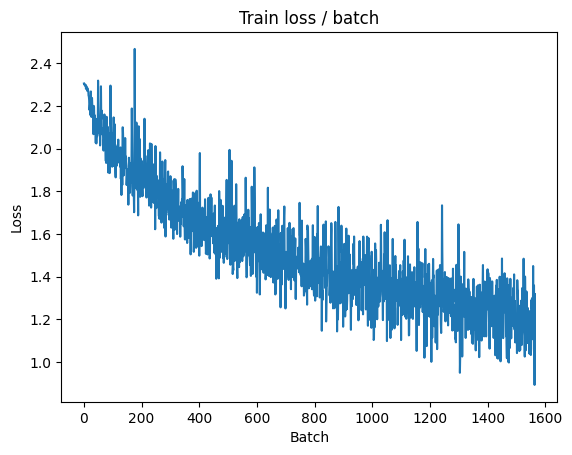

[TRAIN Batch 200/391]	Time 0.013s (0.090s)	Loss 1.0556 (1.1573)	Prec@1  57.0 ( 59.1)	Prec@5  97.7 ( 95.3)


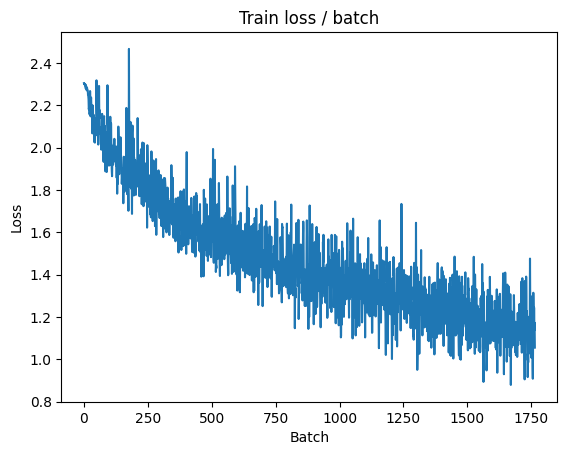


===============> Total time 35s	Avg loss 1.1361	Avg Prec@1 59.80 %	Avg Prec@5 95.61 %

[EVAL Batch 000/079]	Time 0.207s (0.207s)	Loss 0.8686 (0.8686)	Prec@1  70.3 ( 70.3)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.9675	Avg Prec@1 65.98 %	Avg Prec@5 96.88 %



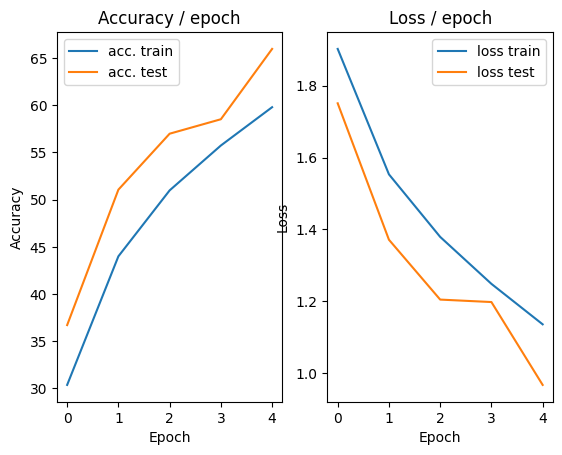

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.272s (0.272s)	Loss 1.1177 (1.1177)	Prec@1  60.2 ( 60.2)	Prec@5  95.3 ( 95.3)


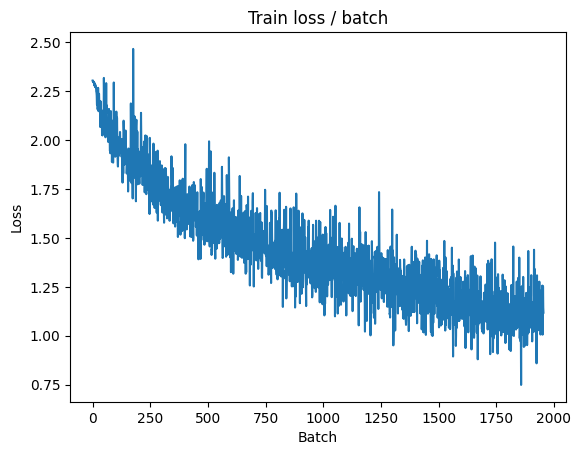

[TRAIN Batch 200/391]	Time 0.012s (0.090s)	Loss 0.9777 (1.0650)	Prec@1  69.5 ( 62.4)	Prec@5  95.3 ( 96.2)


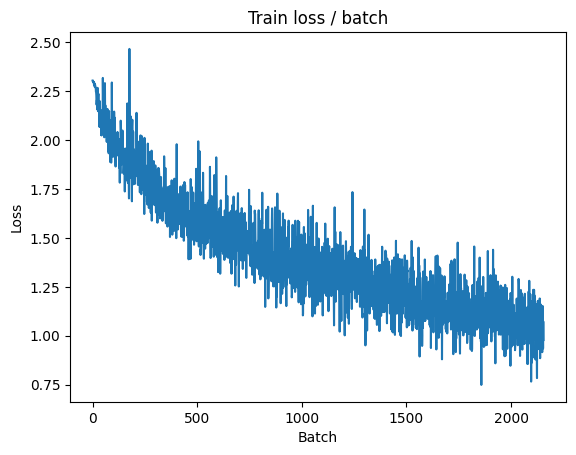


===============> Total time 35s	Avg loss 1.0545	Avg Prec@1 62.91 %	Avg Prec@5 96.33 %

[EVAL Batch 000/079]	Time 0.288s (0.288s)	Loss 0.9394 (0.9394)	Prec@1  73.4 ( 73.4)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.9434	Avg Prec@1 67.15 %	Avg Prec@5 97.05 %



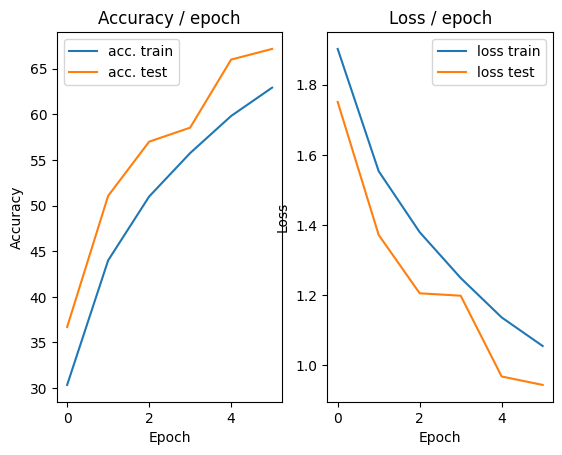

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.285s (0.285s)	Loss 1.1735 (1.1735)	Prec@1  54.7 ( 54.7)	Prec@5  96.9 ( 96.9)


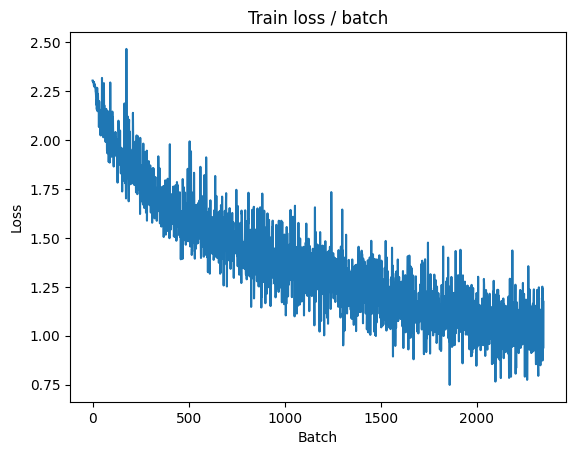

[TRAIN Batch 200/391]	Time 0.012s (0.094s)	Loss 0.8893 (0.9923)	Prec@1  68.8 ( 65.3)	Prec@5  95.3 ( 96.7)


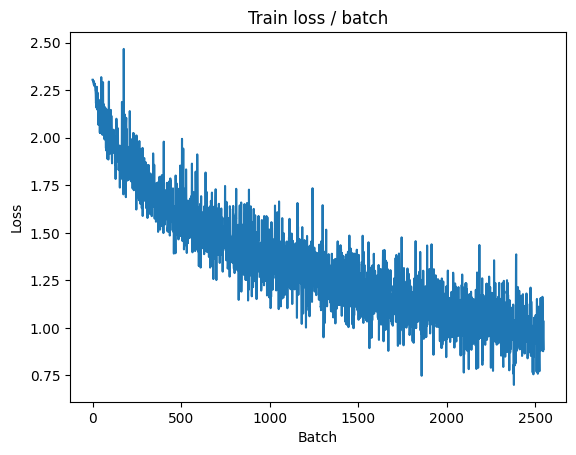


===============> Total time 37s	Avg loss 0.9831	Avg Prec@1 65.72 %	Avg Prec@5 96.79 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 0.8341 (0.8341)	Prec@1  69.5 ( 69.5)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9127	Avg Prec@1 68.55 %	Avg Prec@5 97.08 %



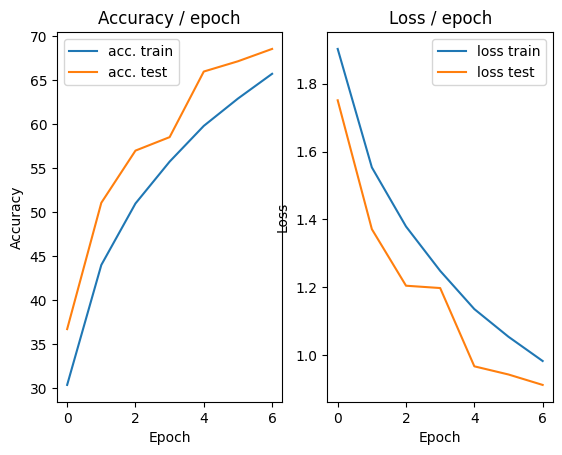

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.277s (0.277s)	Loss 0.8360 (0.8360)	Prec@1  71.9 ( 71.9)	Prec@5  96.1 ( 96.1)


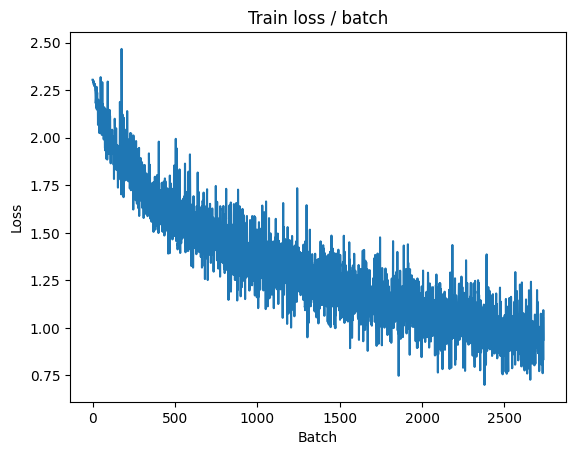

[TRAIN Batch 200/391]	Time 0.012s (0.089s)	Loss 0.8008 (0.9419)	Prec@1  72.7 ( 67.0)	Prec@5  97.7 ( 97.1)


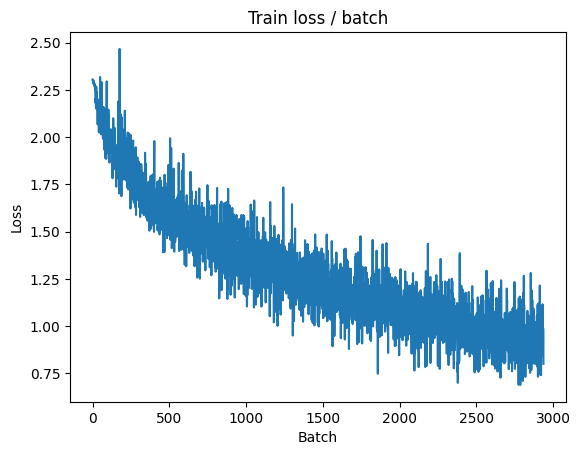


===============> Total time 35s	Avg loss 0.9266	Avg Prec@1 67.44 %	Avg Prec@5 97.19 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 0.8515 (0.8515)	Prec@1  74.2 ( 74.2)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.8802	Avg Prec@1 69.53 %	Avg Prec@5 97.54 %



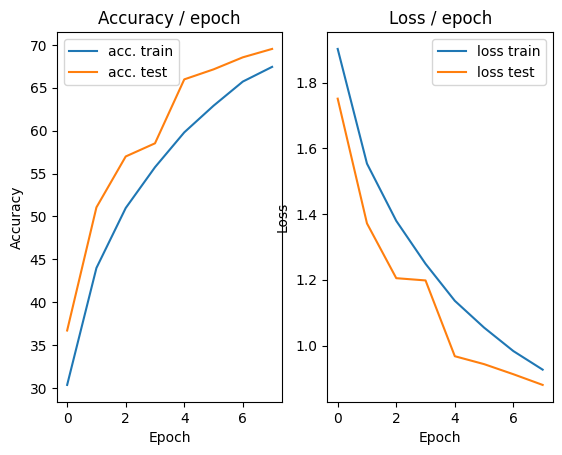

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.283s (0.283s)	Loss 0.8407 (0.8407)	Prec@1  68.8 ( 68.8)	Prec@5  97.7 ( 97.7)


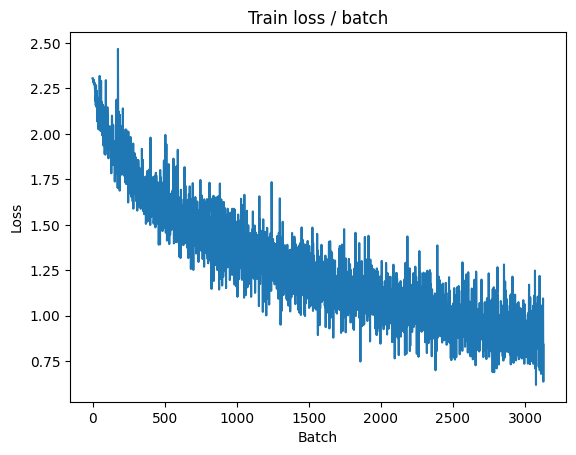

[TRAIN Batch 200/391]	Time 0.154s (0.089s)	Loss 0.7874 (0.8721)	Prec@1  72.7 ( 69.0)	Prec@5  96.1 ( 97.6)


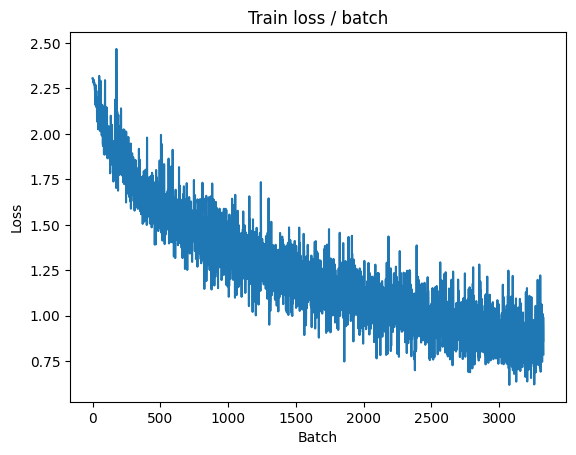


===============> Total time 35s	Avg loss 0.8781	Avg Prec@1 69.00 %	Avg Prec@5 97.49 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 0.7277 (0.7277)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.8051	Avg Prec@1 72.23 %	Avg Prec@5 97.87 %



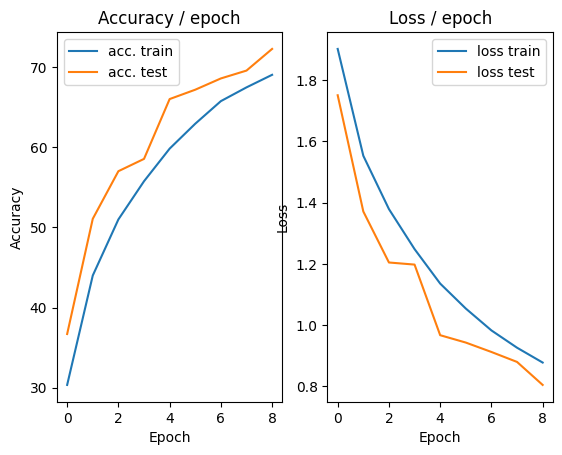

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.279s (0.279s)	Loss 0.9860 (0.9860)	Prec@1  64.8 ( 64.8)	Prec@5  96.1 ( 96.1)


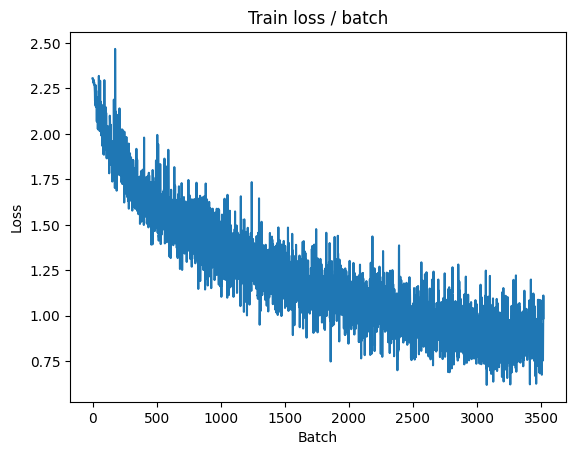

[TRAIN Batch 200/391]	Time 0.047s (0.089s)	Loss 0.6980 (0.8467)	Prec@1  78.1 ( 70.5)	Prec@5  98.4 ( 97.5)


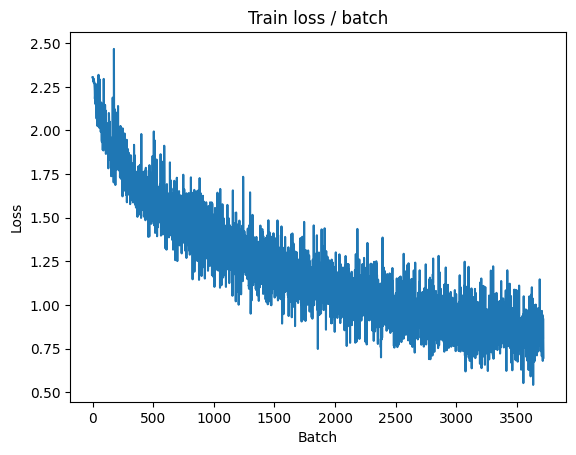


===============> Total time 35s	Avg loss 0.8392	Avg Prec@1 70.68 %	Avg Prec@5 97.65 %

[EVAL Batch 000/079]	Time 0.142s (0.142s)	Loss 0.8524 (0.8524)	Prec@1  73.4 ( 73.4)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.9289	Avg Prec@1 68.87 %	Avg Prec@5 97.63 %



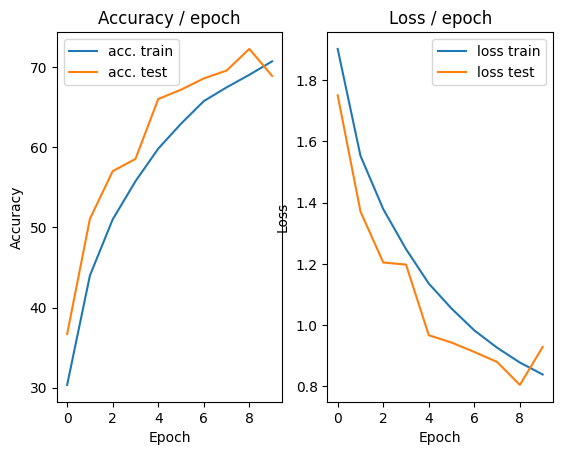

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.267s (0.267s)	Loss 1.0126 (1.0126)	Prec@1  69.5 ( 69.5)	Prec@5  98.4 ( 98.4)


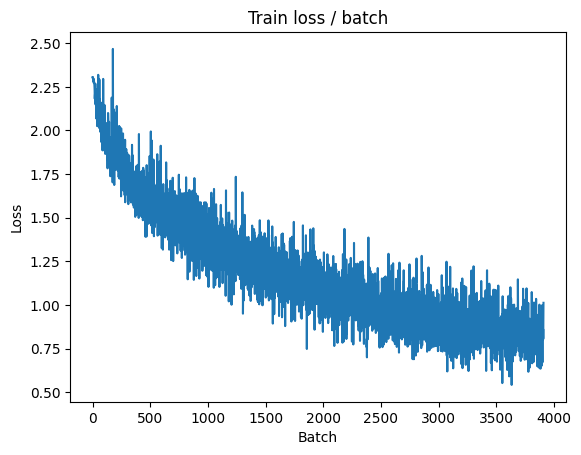

[TRAIN Batch 200/391]	Time 0.146s (0.089s)	Loss 0.8198 (0.8026)	Prec@1  71.1 ( 72.2)	Prec@5  98.4 ( 98.0)


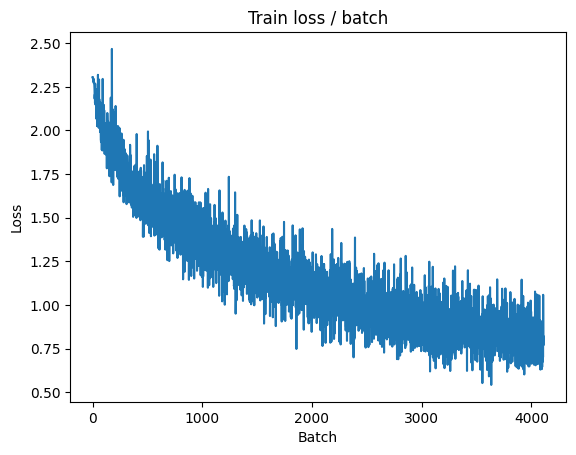


===============> Total time 35s	Avg loss 0.8018	Avg Prec@1 72.18 %	Avg Prec@5 97.94 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 0.8086 (0.8086)	Prec@1  67.2 ( 67.2)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.8192	Avg Prec@1 72.63 %	Avg Prec@5 97.82 %



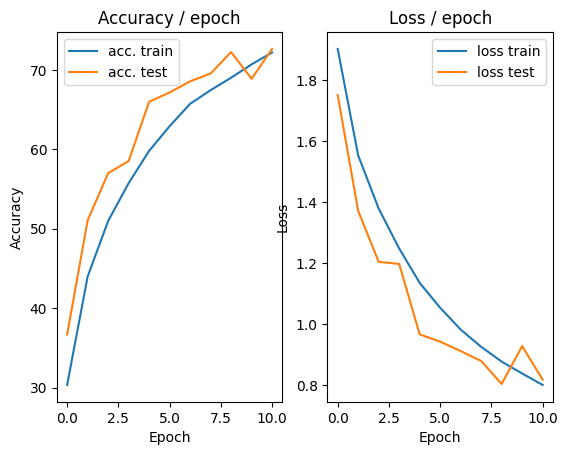

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.311s (0.311s)	Loss 0.7327 (0.7327)	Prec@1  74.2 ( 74.2)	Prec@5  97.7 ( 97.7)


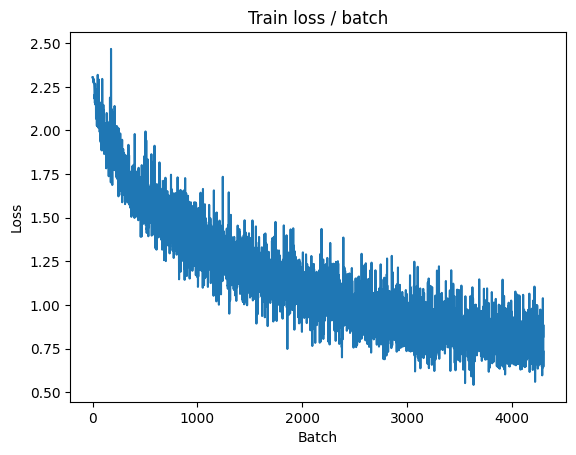

[TRAIN Batch 200/391]	Time 0.012s (0.088s)	Loss 0.7312 (0.7672)	Prec@1  75.8 ( 73.2)	Prec@5  99.2 ( 98.2)


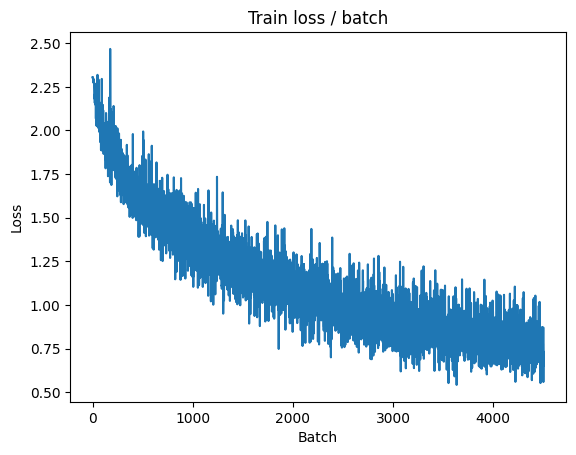


===============> Total time 35s	Avg loss 0.7686	Avg Prec@1 73.08 %	Avg Prec@5 98.16 %

[EVAL Batch 000/079]	Time 0.166s (0.166s)	Loss 0.7498 (0.7498)	Prec@1  76.6 ( 76.6)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.7634	Avg Prec@1 73.74 %	Avg Prec@5 98.00 %



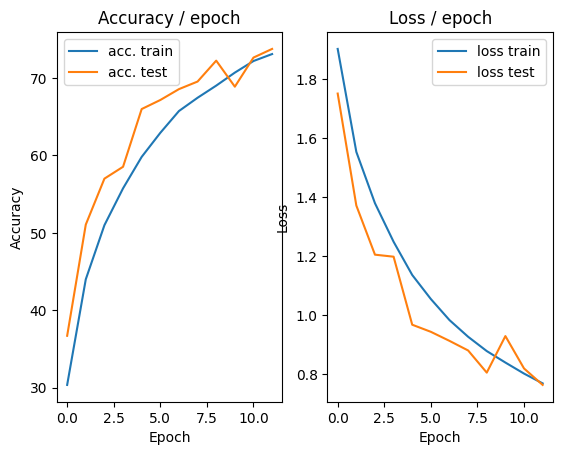

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.275s (0.275s)	Loss 0.7669 (0.7669)	Prec@1  70.3 ( 70.3)	Prec@5  99.2 ( 99.2)


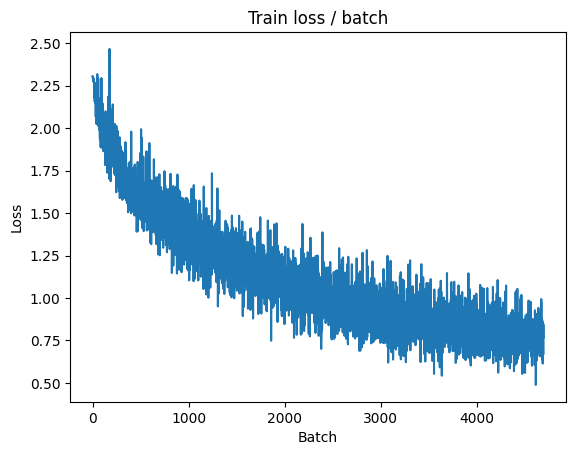

[TRAIN Batch 200/391]	Time 0.009s (0.087s)	Loss 0.7013 (0.7361)	Prec@1  73.4 ( 74.1)	Prec@5 100.0 ( 98.3)


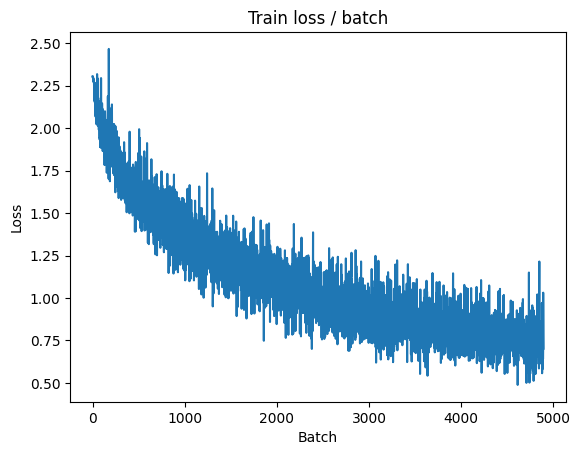


===============> Total time 35s	Avg loss 0.7357	Avg Prec@1 74.08 %	Avg Prec@5 98.37 %

[EVAL Batch 000/079]	Time 0.197s (0.197s)	Loss 0.6764 (0.6764)	Prec@1  75.0 ( 75.0)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.7194	Avg Prec@1 75.30 %	Avg Prec@5 98.23 %



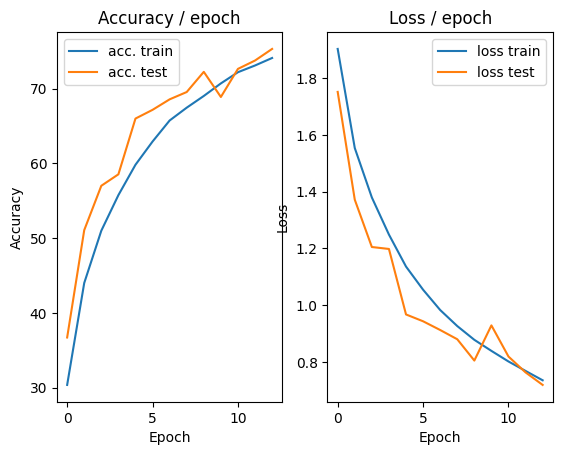

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.280s (0.280s)	Loss 0.6971 (0.6971)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)


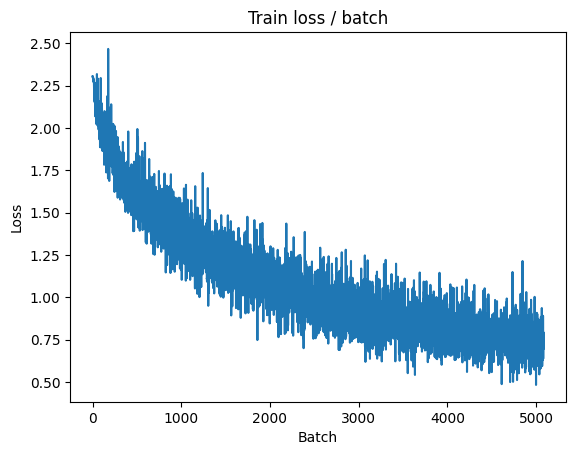

[TRAIN Batch 200/391]	Time 0.010s (0.088s)	Loss 0.6635 (0.7072)	Prec@1  75.8 ( 75.2)	Prec@5  97.7 ( 98.5)


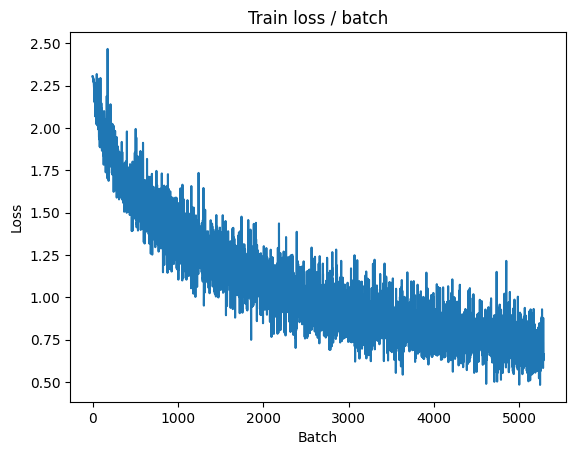


===============> Total time 35s	Avg loss 0.7131	Avg Prec@1 74.97 %	Avg Prec@5 98.43 %

[EVAL Batch 000/079]	Time 0.215s (0.215s)	Loss 0.6852 (0.6852)	Prec@1  74.2 ( 74.2)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.6823	Avg Prec@1 76.80 %	Avg Prec@5 98.34 %



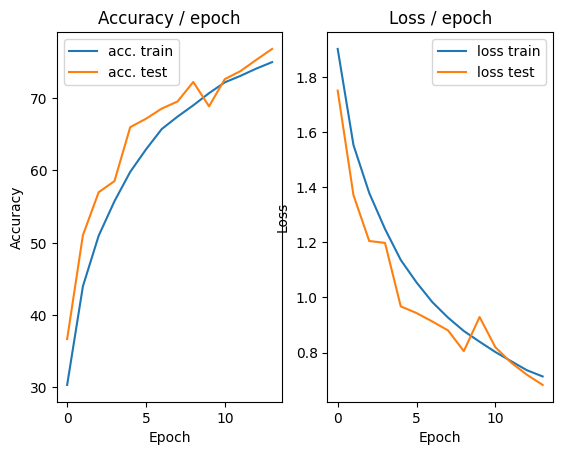

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.304s (0.304s)	Loss 0.7389 (0.7389)	Prec@1  73.4 ( 73.4)	Prec@5  98.4 ( 98.4)


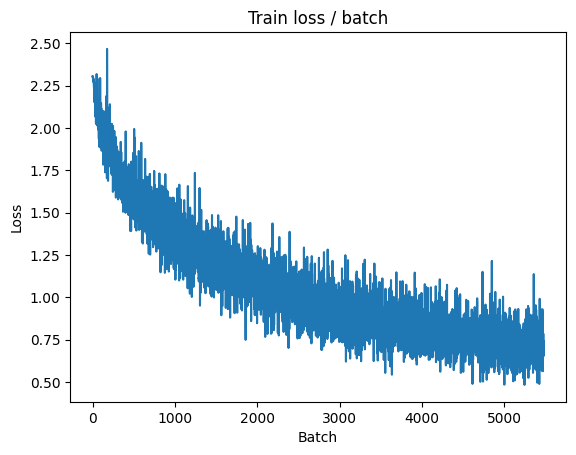

[TRAIN Batch 200/391]	Time 0.075s (0.090s)	Loss 0.6971 (0.6876)	Prec@1  71.9 ( 76.2)	Prec@5  99.2 ( 98.6)


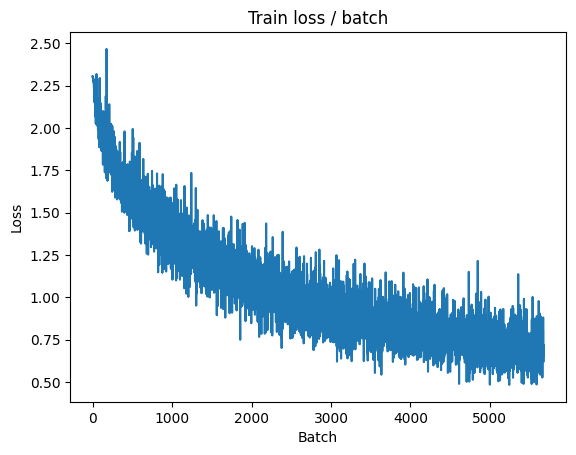


===============> Total time 35s	Avg loss 0.6894	Avg Prec@1 75.76 %	Avg Prec@5 98.59 %

[EVAL Batch 000/079]	Time 0.252s (0.252s)	Loss 0.7541 (0.7541)	Prec@1  75.0 ( 75.0)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.7700	Avg Prec@1 74.19 %	Avg Prec@5 98.21 %



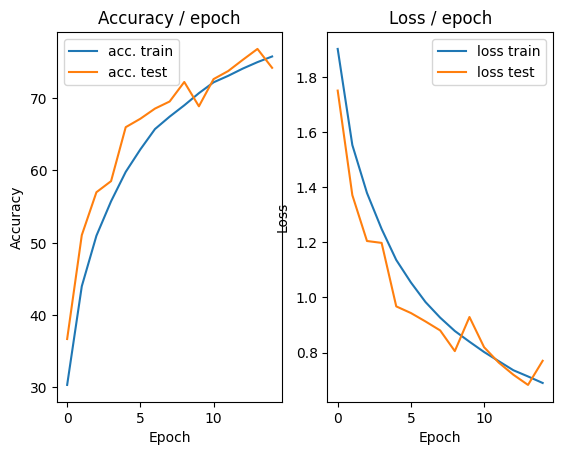

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.290s (0.290s)	Loss 0.4725 (0.4725)	Prec@1  87.5 ( 87.5)	Prec@5  99.2 ( 99.2)


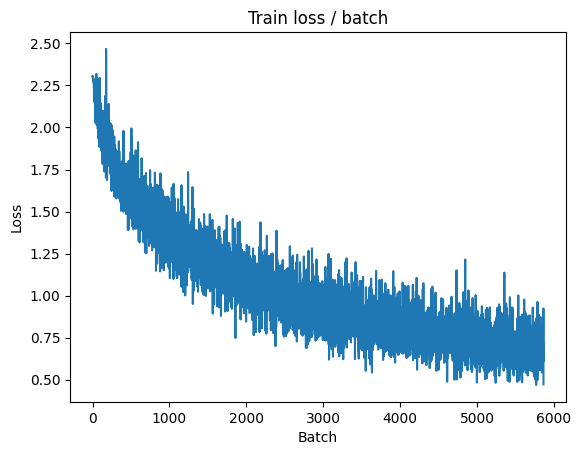

[TRAIN Batch 200/391]	Time 0.009s (0.089s)	Loss 0.9004 (0.6540)	Prec@1  71.9 ( 77.3)	Prec@5  96.9 ( 98.7)


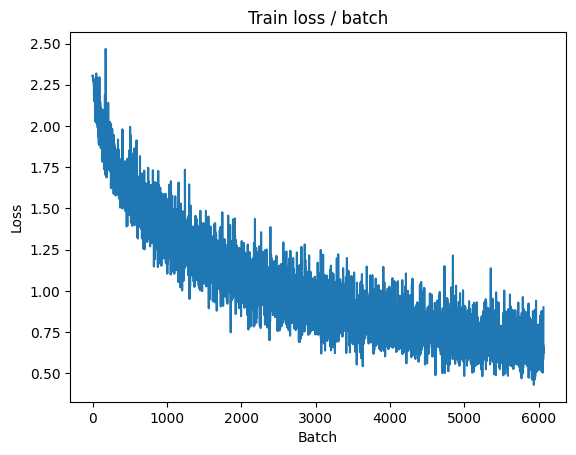


===============> Total time 35s	Avg loss 0.6599	Avg Prec@1 77.18 %	Avg Prec@5 98.70 %

[EVAL Batch 000/079]	Time 0.189s (0.189s)	Loss 0.6407 (0.6407)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.7178	Avg Prec@1 76.07 %	Avg Prec@5 98.22 %



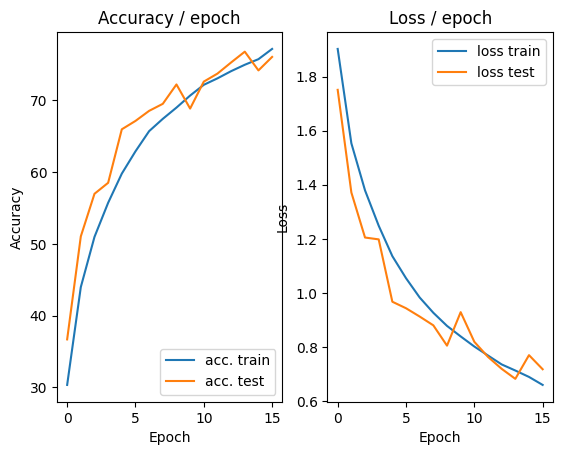

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.285s (0.285s)	Loss 0.5583 (0.5583)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.2)


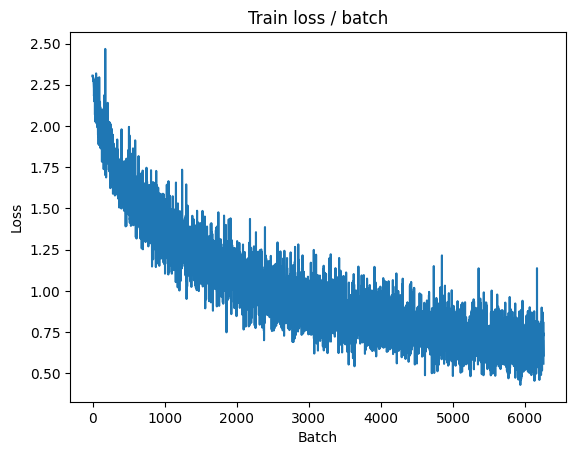

[TRAIN Batch 200/391]	Time 0.010s (0.090s)	Loss 0.6807 (0.6273)	Prec@1  80.5 ( 78.1)	Prec@5  99.2 ( 98.9)


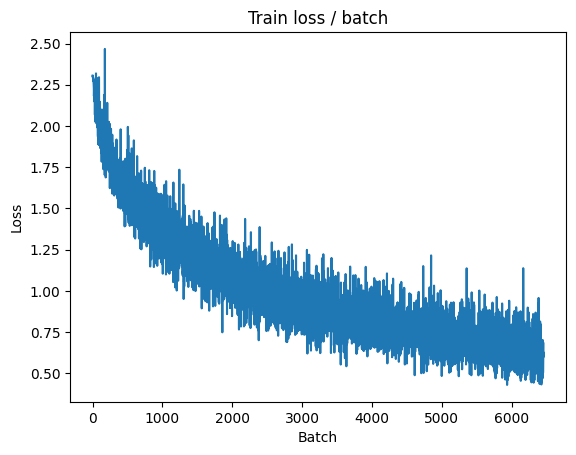


===============> Total time 35s	Avg loss 0.6359	Avg Prec@1 77.84 %	Avg Prec@5 98.83 %

[EVAL Batch 000/079]	Time 0.227s (0.227s)	Loss 0.6031 (0.6031)	Prec@1  80.5 ( 80.5)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6618	Avg Prec@1 77.62 %	Avg Prec@5 98.61 %



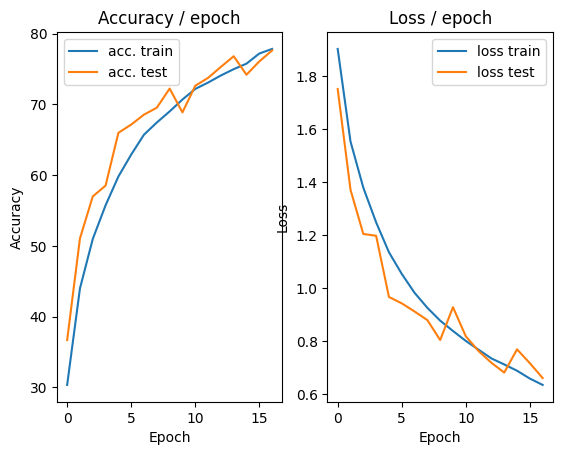

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.290s (0.290s)	Loss 0.5652 (0.5652)	Prec@1  73.4 ( 73.4)	Prec@5 100.0 (100.0)


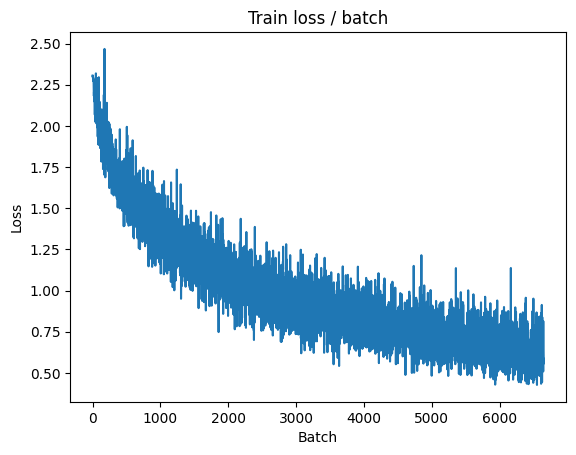

[TRAIN Batch 200/391]	Time 0.008s (0.089s)	Loss 0.5029 (0.6099)	Prec@1  85.9 ( 78.8)	Prec@5 100.0 ( 98.9)


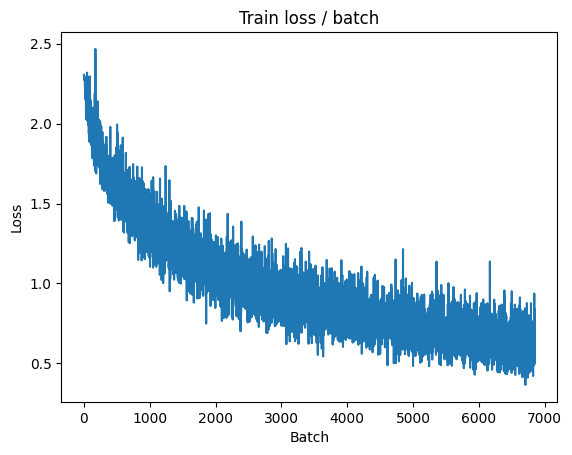


===============> Total time 35s	Avg loss 0.6174	Avg Prec@1 78.44 %	Avg Prec@5 98.85 %

[EVAL Batch 000/079]	Time 0.200s (0.200s)	Loss 0.6289 (0.6289)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6905	Avg Prec@1 76.75 %	Avg Prec@5 98.30 %



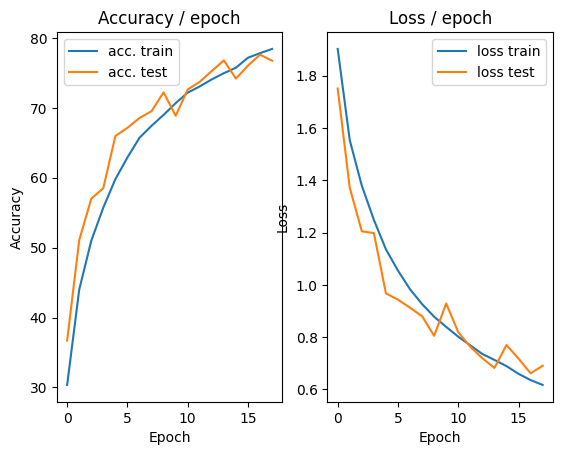

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.316s (0.316s)	Loss 0.5114 (0.5114)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)


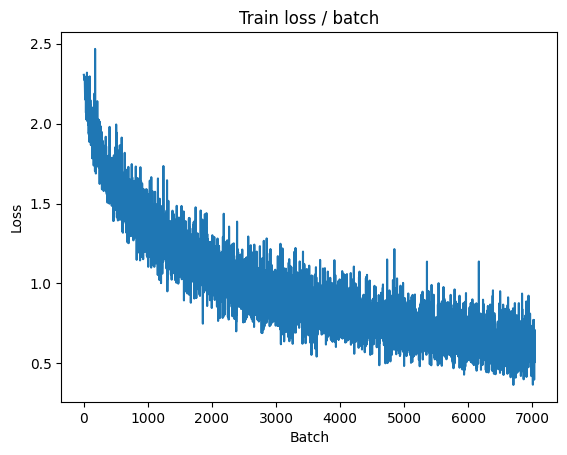

[TRAIN Batch 200/391]	Time 0.112s (0.088s)	Loss 0.7220 (0.5877)	Prec@1  78.1 ( 79.6)	Prec@5  99.2 ( 99.0)


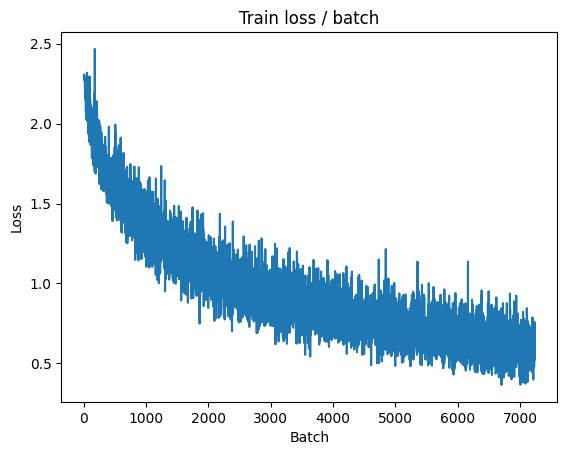


===============> Total time 34s	Avg loss 0.5999	Avg Prec@1 78.99 %	Avg Prec@5 98.99 %

[EVAL Batch 000/079]	Time 0.226s (0.226s)	Loss 0.7490 (0.7490)	Prec@1  75.8 ( 75.8)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.7153	Avg Prec@1 76.68 %	Avg Prec@5 98.51 %



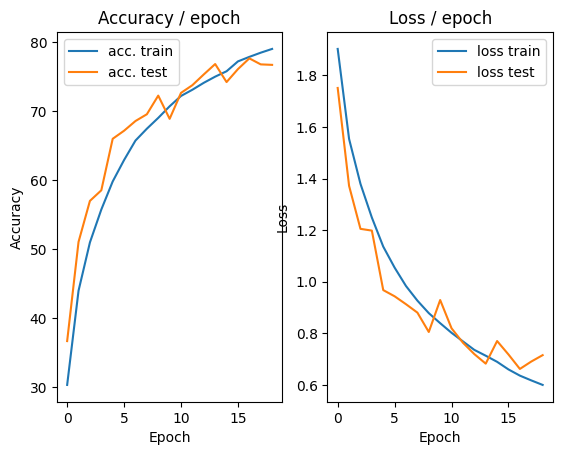

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.301s (0.301s)	Loss 0.7076 (0.7076)	Prec@1  71.9 ( 71.9)	Prec@5  99.2 ( 99.2)


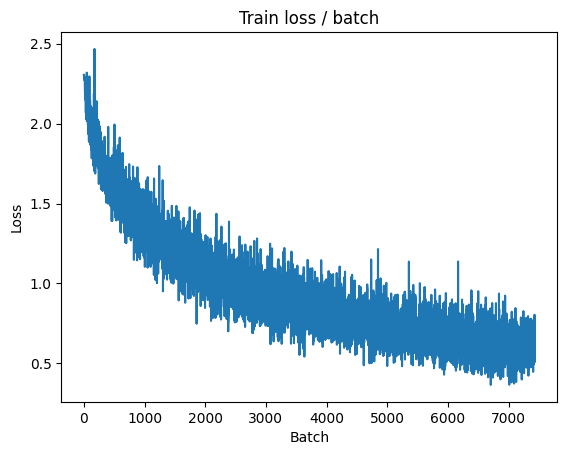

[TRAIN Batch 200/391]	Time 0.150s (0.089s)	Loss 0.6309 (0.5803)	Prec@1  82.8 ( 79.6)	Prec@5  96.9 ( 99.1)


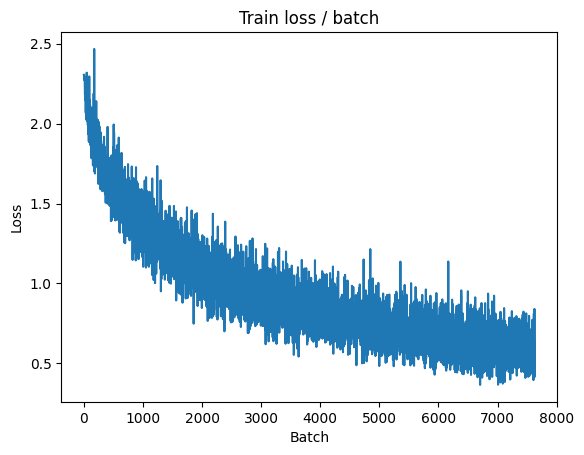


===============> Total time 34s	Avg loss 0.5841	Avg Prec@1 79.49 %	Avg Prec@5 99.06 %

[EVAL Batch 000/079]	Time 0.240s (0.240s)	Loss 0.7116 (0.7116)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.7091	Avg Prec@1 76.53 %	Avg Prec@5 98.48 %



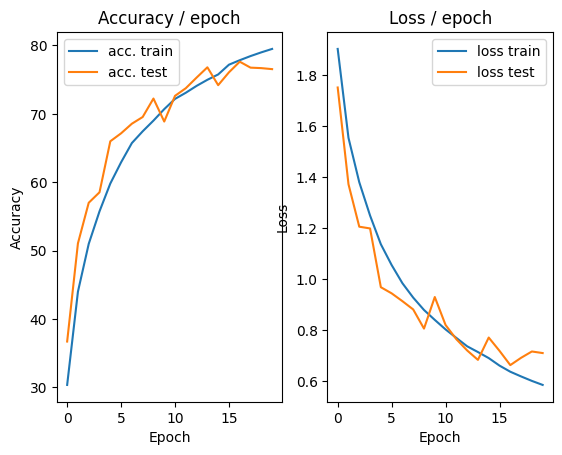

In [31]:
main_cifar(batch_size=128, epochs=20, cuda=True, get_dataset=get_cifar_dataset_data_increase_bonus)

## Variants on the optimization

In [32]:
import torch.optim.lr_scheduler

def main_cifar_optim(batch_size=128, lr=0.1, epochs=5, cuda=False, get_dataset=get_cifar_dataset,
                     opt='SGD', lr_sched='exp', dropout=False, batch_norm=False):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = CifarConvNet(dropout=dropout, batch_norm=batch_norm)
    criterion = nn.CrossEntropyLoss()
    if opt == 'SGD':
        optimizer = torch.optim.SGD(model.parameters(), lr)
        if lr_sched == 'exp':
            lr_sched = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.95)
        elif lr_sched == 'step':
            lr_sched = torch.optim.lr_scheduler.StepLR(optimizer, step_size=5, gamma=0.95)
    elif opt == 'Adam':
        optimizer = torch.optim.Adam(model.parameters(), lr)
        lr_sched = None

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        if lr_sched is not None:
            lr_sched.step()
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)

=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.190s (0.190s)	Loss 2.2985 (2.2985)	Prec@1  12.5 ( 12.5)	Prec@5  61.7 ( 61.7)


<Figure size 640x480 with 0 Axes>

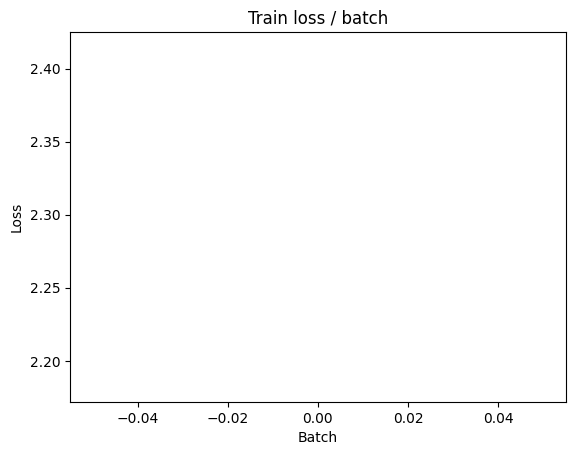

[TRAIN Batch 200/391]	Time 0.113s (0.050s)	Loss 1.8156 (1.9663)	Prec@1  33.6 ( 27.8)	Prec@5  80.5 ( 78.8)


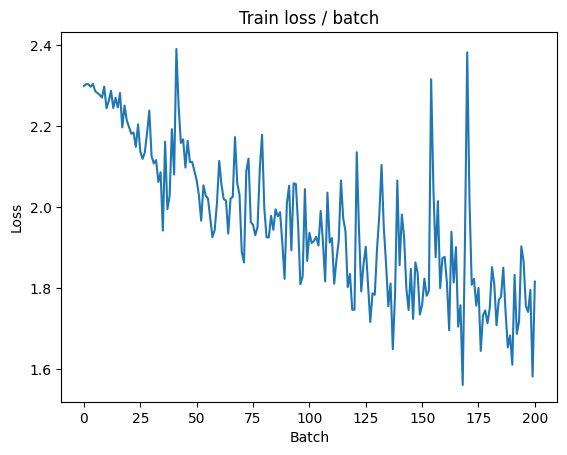


===============> Total time 18s	Avg loss 1.7997	Avg Prec@1 34.26 %	Avg Prec@5 84.11 %

[EVAL Batch 000/079]	Time 0.263s (0.263s)	Loss 1.5271 (1.5271)	Prec@1  48.4 ( 48.4)	Prec@5  88.3 ( 88.3)

===============> Total time 3s	Avg loss 1.5570	Avg Prec@1 43.88 %	Avg Prec@5 90.98 %



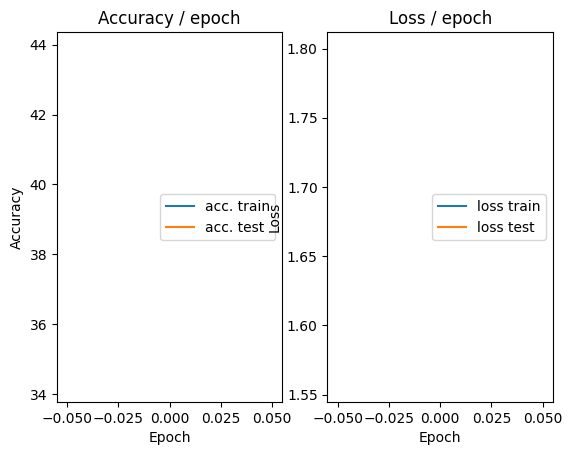

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.313s (0.313s)	Loss 1.5966 (1.5966)	Prec@1  38.3 ( 38.3)	Prec@5  91.4 ( 91.4)


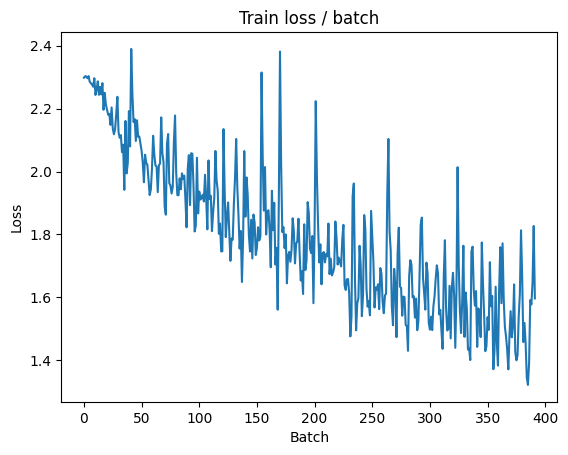

[TRAIN Batch 200/391]	Time 0.065s (0.042s)	Loss 1.4240 (1.4306)	Prec@1  46.9 ( 48.2)	Prec@5  95.3 ( 92.8)


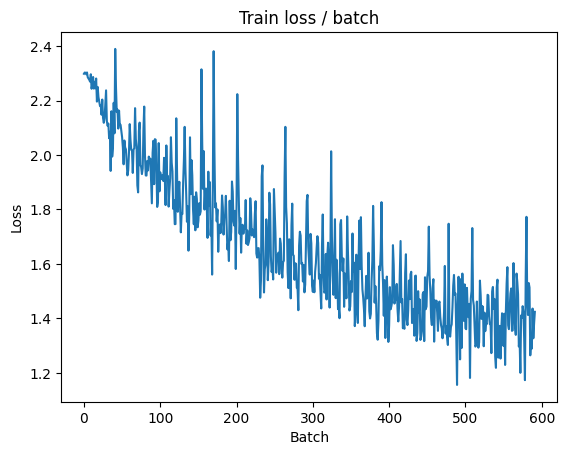


===============> Total time 16s	Avg loss 1.3790	Avg Prec@1 50.58 %	Avg Prec@5 93.35 %

[EVAL Batch 000/079]	Time 0.143s (0.143s)	Loss 1.3153 (1.3153)	Prec@1  56.2 ( 56.2)	Prec@5  93.8 ( 93.8)

===============> Total time 2s	Avg loss 1.3368	Avg Prec@1 53.16 %	Avg Prec@5 92.87 %



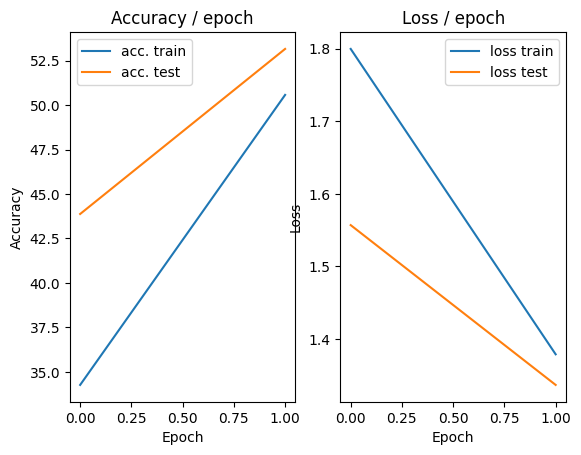

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.181s (0.181s)	Loss 1.3634 (1.3634)	Prec@1  49.2 ( 49.2)	Prec@5  96.1 ( 96.1)


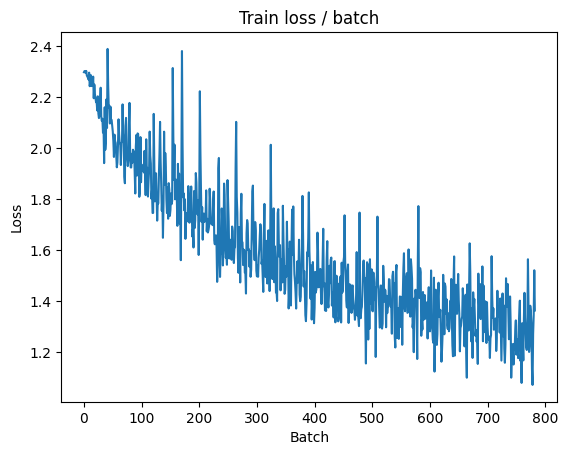

[TRAIN Batch 200/391]	Time 0.010s (0.046s)	Loss 1.1006 (1.2069)	Prec@1  62.5 ( 57.2)	Prec@5  96.1 ( 95.4)


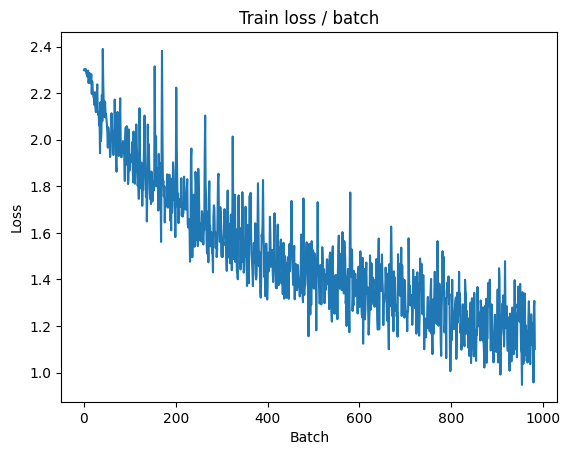


===============> Total time 16s	Avg loss 1.1672	Avg Prec@1 58.84 %	Avg Prec@5 95.62 %

[EVAL Batch 000/079]	Time 0.245s (0.245s)	Loss 1.0845 (1.0845)	Prec@1  63.3 ( 63.3)	Prec@5  95.3 ( 95.3)

===============> Total time 3s	Avg loss 1.0761	Avg Prec@1 62.27 %	Avg Prec@5 96.11 %



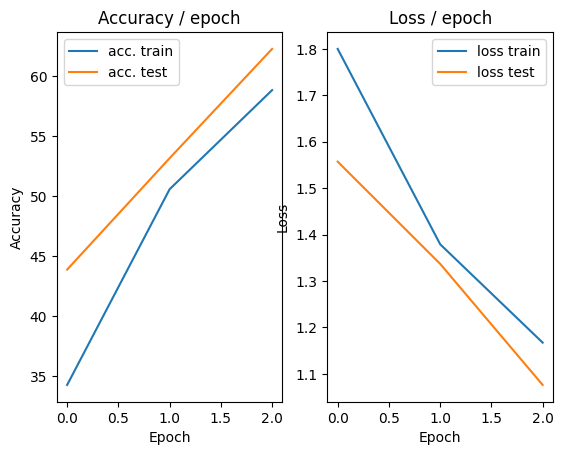

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.188s (0.188s)	Loss 1.0020 (1.0020)	Prec@1  64.1 ( 64.1)	Prec@5  99.2 ( 99.2)


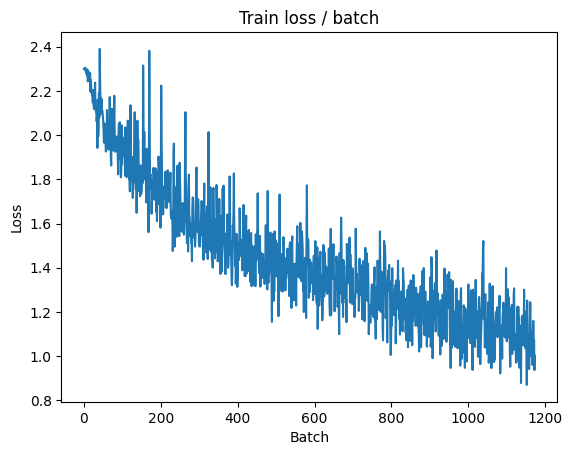

[TRAIN Batch 200/391]	Time 0.015s (0.041s)	Loss 0.8396 (1.0368)	Prec@1  70.3 ( 63.5)	Prec@5  97.7 ( 96.5)


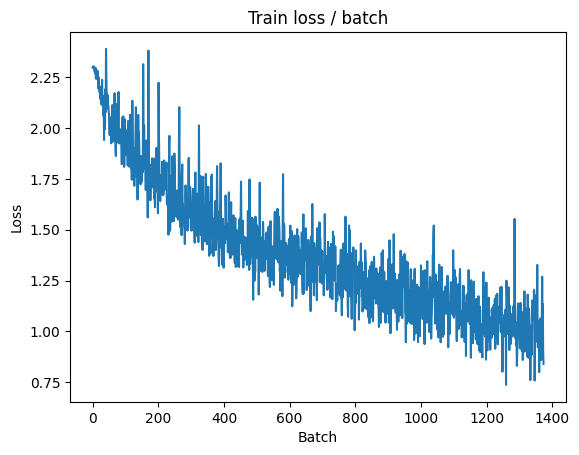


===============> Total time 16s	Avg loss 1.0082	Avg Prec@1 64.80 %	Avg Prec@5 96.70 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 1.2012 (1.2012)	Prec@1  64.8 ( 64.8)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 1.2727	Avg Prec@1 58.79 %	Avg Prec@5 95.45 %



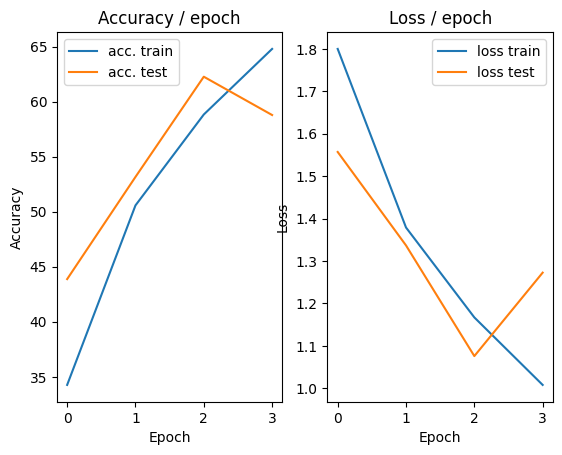

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.183s (0.183s)	Loss 1.2806 (1.2806)	Prec@1  57.0 ( 57.0)	Prec@5  96.9 ( 96.9)


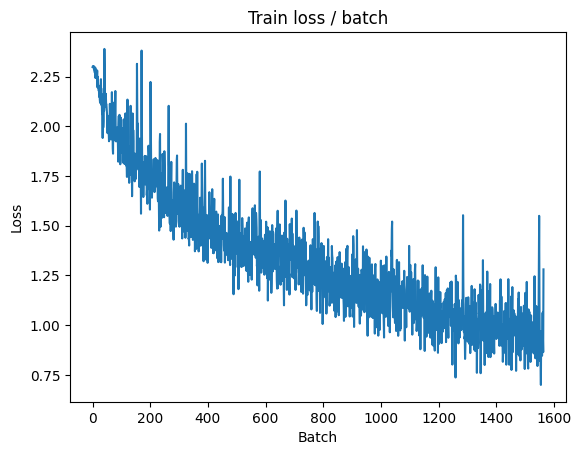

[TRAIN Batch 200/391]	Time 0.070s (0.045s)	Loss 0.9503 (0.9162)	Prec@1  62.5 ( 67.9)	Prec@5  99.2 ( 97.2)


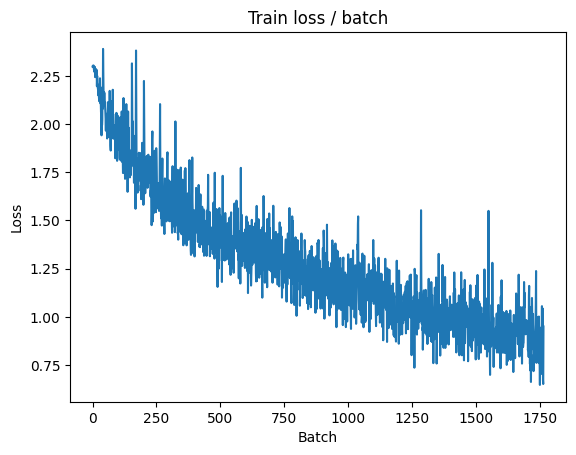


===============> Total time 17s	Avg loss 0.8982	Avg Prec@1 68.53 %	Avg Prec@5 97.28 %

[EVAL Batch 000/079]	Time 0.214s (0.214s)	Loss 0.8146 (0.8146)	Prec@1  71.1 ( 71.1)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.8367	Avg Prec@1 70.16 %	Avg Prec@5 97.90 %



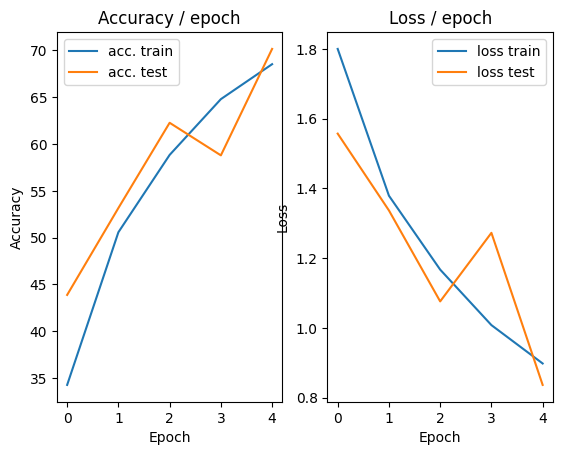

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.199s (0.199s)	Loss 0.6148 (0.6148)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)


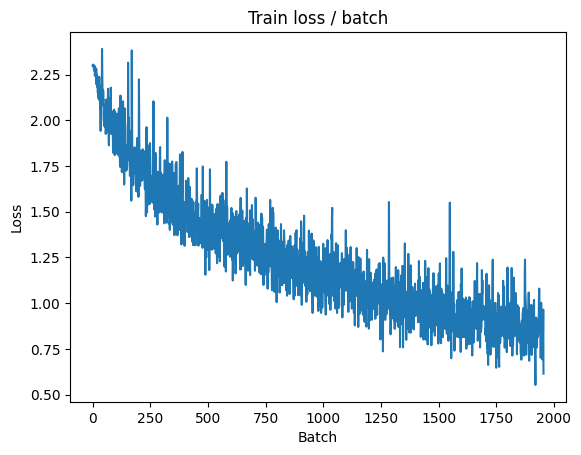

[TRAIN Batch 200/391]	Time 0.094s (0.042s)	Loss 0.7485 (0.8214)	Prec@1  73.4 ( 71.4)	Prec@5  97.7 ( 97.7)


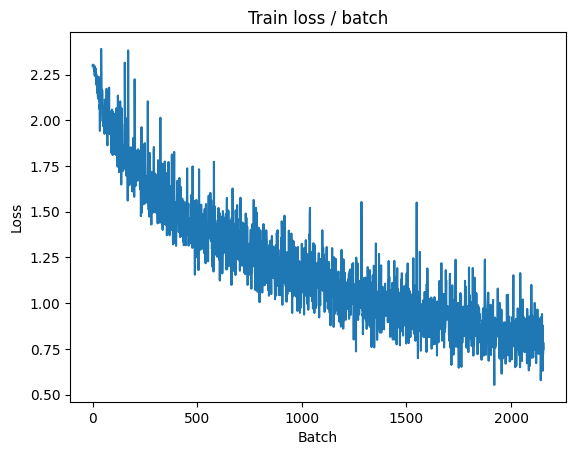


===============> Total time 16s	Avg loss 0.8156	Avg Prec@1 71.53 %	Avg Prec@5 97.83 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 0.9336 (0.9336)	Prec@1  66.4 ( 66.4)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.8952	Avg Prec@1 68.49 %	Avg Prec@5 97.78 %



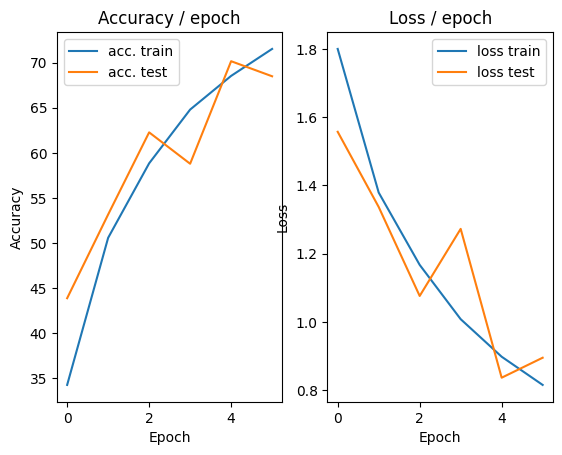

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.177s (0.177s)	Loss 0.9512 (0.9512)	Prec@1  65.6 ( 65.6)	Prec@5  97.7 ( 97.7)


Traceback (most recent call last):
  File "/usr/lib/python3.12/multiprocessing/queues.py", line 259, in _feed
    reader_close()
  File "/usr/lib/python3.12/multiprocessing/connection.py", line 178, in close
    self._close()
  File "/usr/lib/python3.12/multiprocessing/connection.py", line 377, in _close
    _close(self._handle)
OSError: [Errno 9] Bad file descriptor


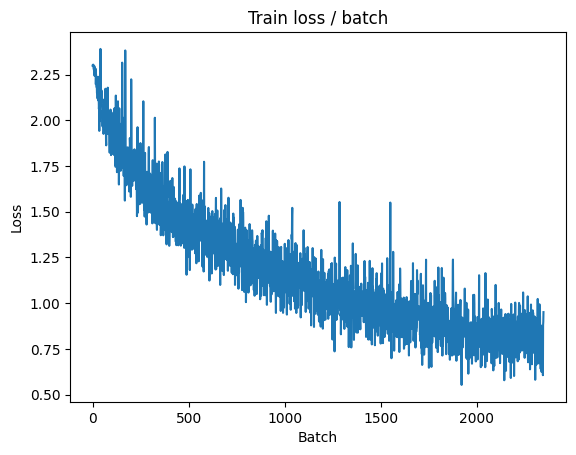

[TRAIN Batch 200/391]	Time 0.062s (0.047s)	Loss 0.6484 (0.7535)	Prec@1  78.9 ( 73.7)	Prec@5  96.9 ( 98.2)


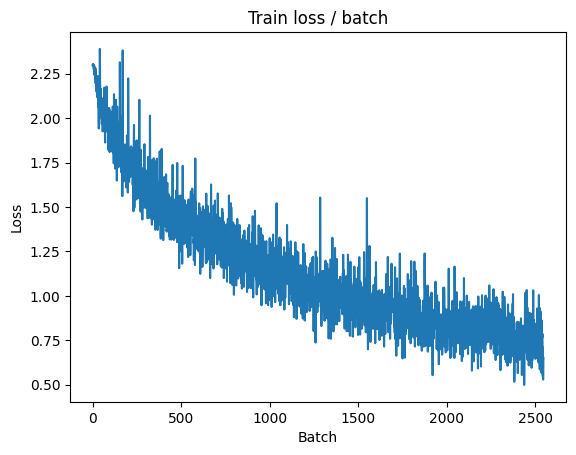


===============> Total time 17s	Avg loss 0.7506	Avg Prec@1 73.68 %	Avg Prec@5 98.14 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 0.6796 (0.6796)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7500	Avg Prec@1 74.25 %	Avg Prec@5 98.10 %



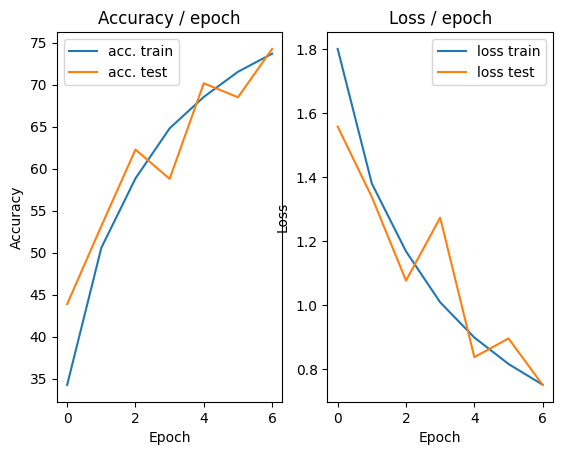

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.203s (0.203s)	Loss 0.8116 (0.8116)	Prec@1  68.0 ( 68.0)	Prec@5  97.7 ( 97.7)


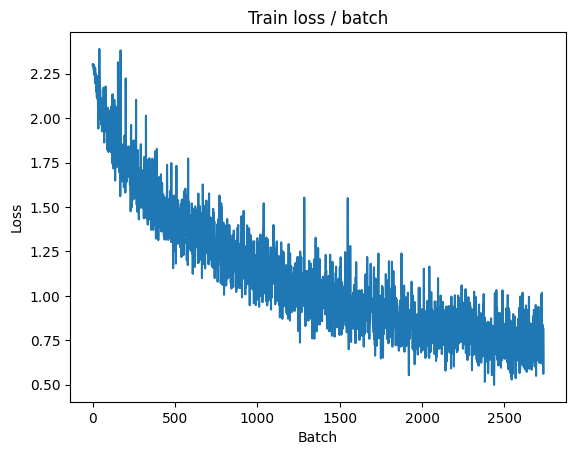

[TRAIN Batch 200/391]	Time 0.043s (0.046s)	Loss 0.7236 (0.6980)	Prec@1  76.6 ( 75.2)	Prec@5  97.7 ( 98.4)


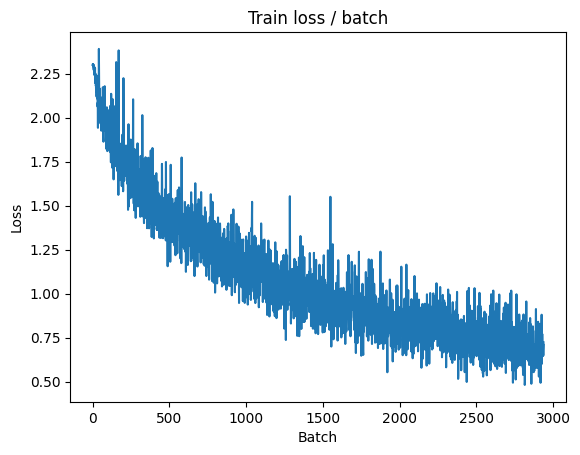


===============> Total time 16s	Avg loss 0.6988	Avg Prec@1 75.52 %	Avg Prec@5 98.47 %

[EVAL Batch 000/079]	Time 0.160s (0.160s)	Loss 0.5891 (0.5891)	Prec@1  80.5 ( 80.5)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.7124	Avg Prec@1 75.23 %	Avg Prec@5 98.41 %



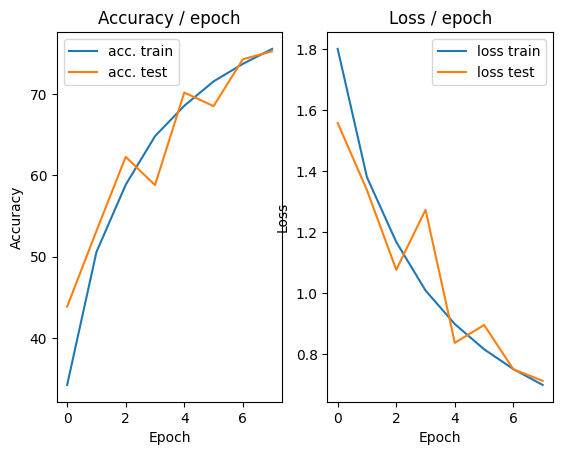

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.245s (0.245s)	Loss 0.6311 (0.6311)	Prec@1  75.0 ( 75.0)	Prec@5 100.0 (100.0)


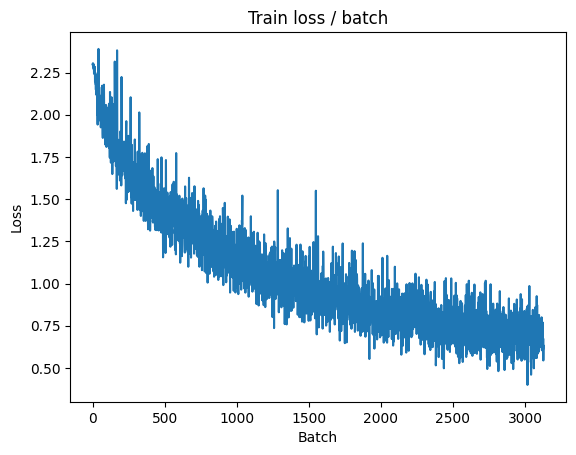

[TRAIN Batch 200/391]	Time 0.010s (0.042s)	Loss 0.8100 (0.6654)	Prec@1  70.3 ( 76.8)	Prec@5  98.4 ( 98.6)


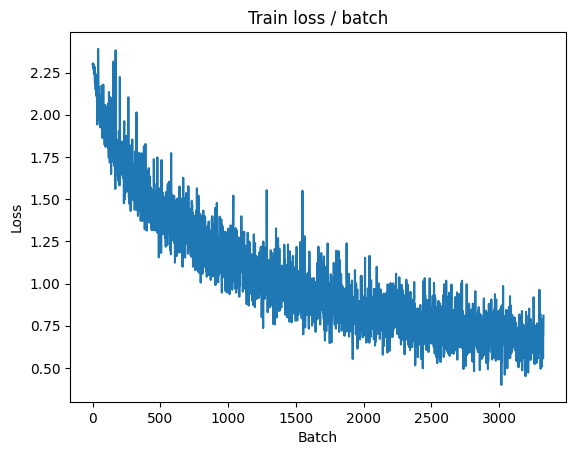


===============> Total time 17s	Avg loss 0.6531	Avg Prec@1 77.12 %	Avg Prec@5 98.71 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 0.5821 (0.5821)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7082	Avg Prec@1 76.00 %	Avg Prec@5 98.43 %



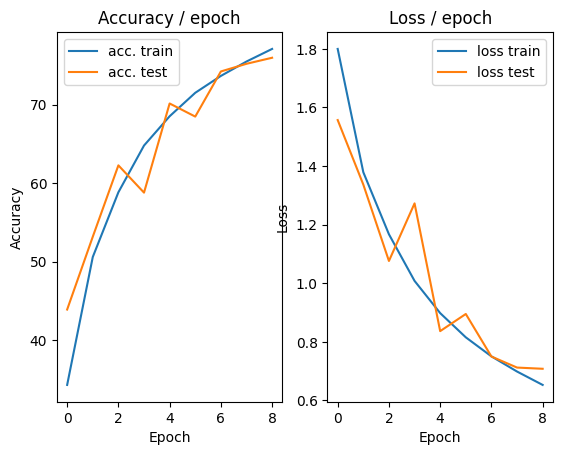

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.201s (0.201s)	Loss 0.6702 (0.6702)	Prec@1  75.8 ( 75.8)	Prec@5  97.7 ( 97.7)


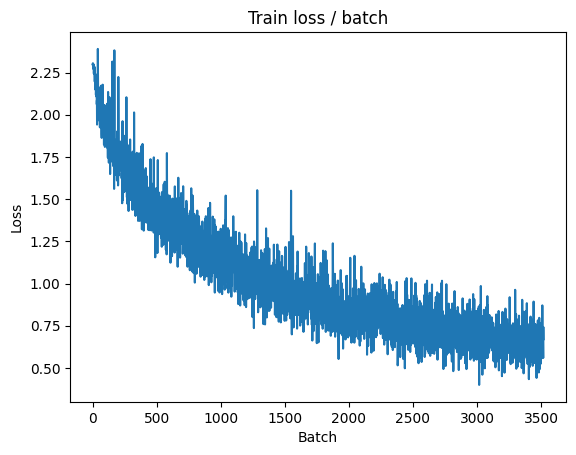

[TRAIN Batch 200/391]	Time 0.010s (0.045s)	Loss 0.5968 (0.6149)	Prec@1  79.7 ( 78.3)	Prec@5  98.4 ( 98.9)


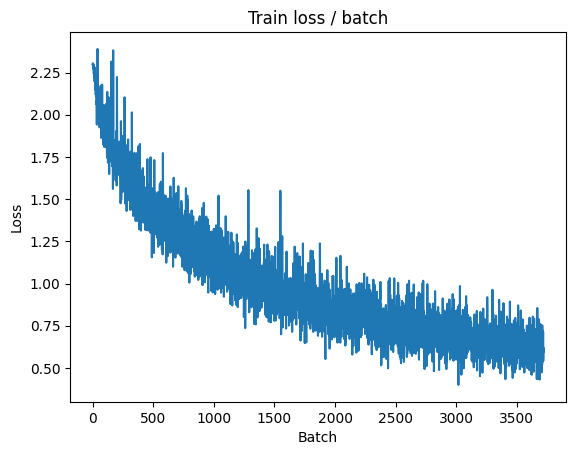


===============> Total time 16s	Avg loss 0.6170	Avg Prec@1 78.39 %	Avg Prec@5 98.81 %

[EVAL Batch 000/079]	Time 0.239s (0.239s)	Loss 0.5664 (0.5664)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.6901	Avg Prec@1 76.57 %	Avg Prec@5 98.46 %



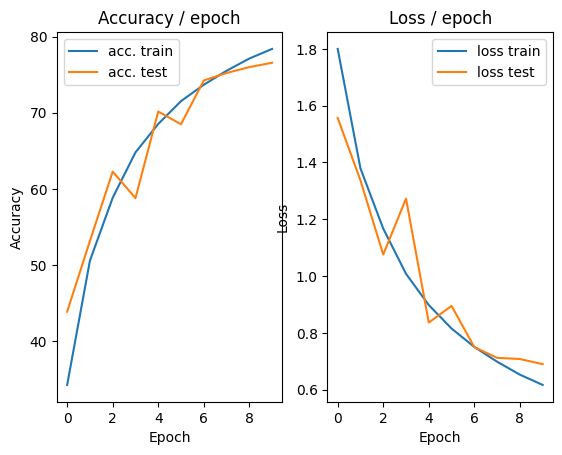

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.200s (0.200s)	Loss 0.6984 (0.6984)	Prec@1  76.6 ( 76.6)	Prec@5 100.0 (100.0)


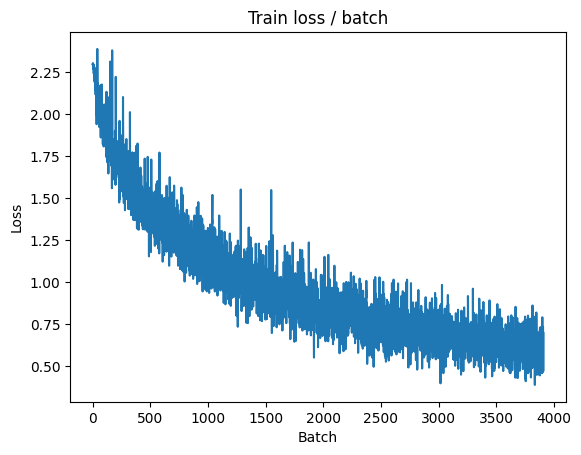

[TRAIN Batch 200/391]	Time 0.010s (0.040s)	Loss 0.5586 (0.5748)	Prec@1  85.9 ( 79.9)	Prec@5  99.2 ( 99.0)


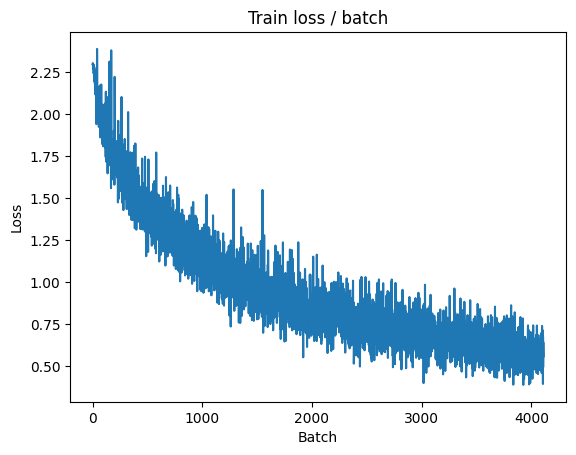


===============> Total time 16s	Avg loss 0.5767	Avg Prec@1 79.89 %	Avg Prec@5 98.94 %

[EVAL Batch 000/079]	Time 0.145s (0.145s)	Loss 0.6748 (0.6748)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.8025	Avg Prec@1 74.21 %	Avg Prec@5 98.32 %



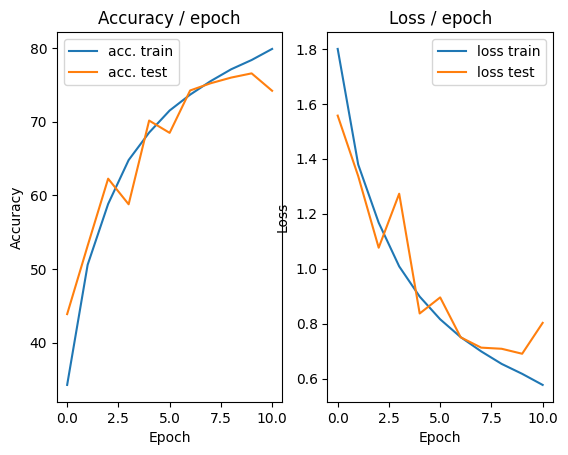

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.188s (0.188s)	Loss 0.8029 (0.8029)	Prec@1  71.9 ( 71.9)	Prec@5  98.4 ( 98.4)


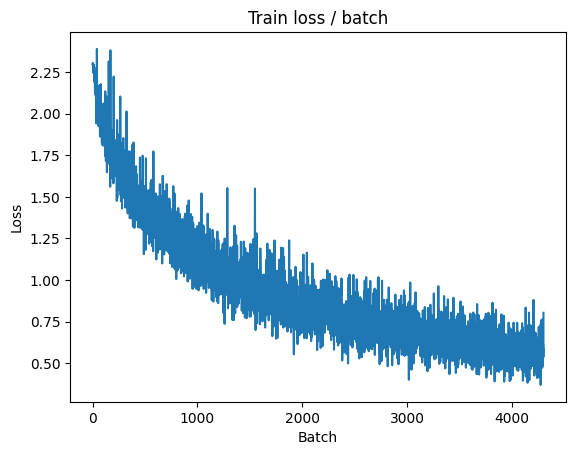

[TRAIN Batch 200/391]	Time 0.009s (0.045s)	Loss 0.6438 (0.5398)	Prec@1  78.1 ( 81.2)	Prec@5  99.2 ( 99.1)


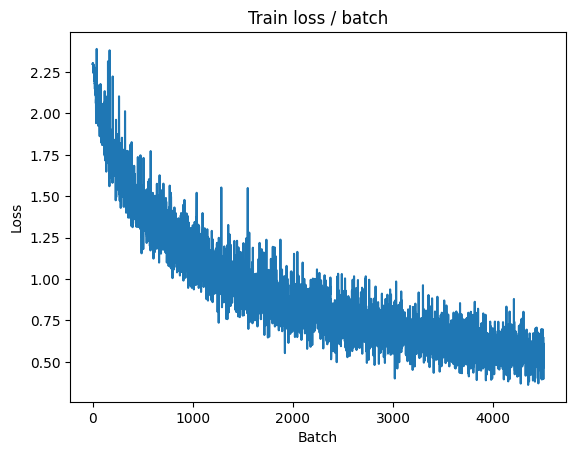


===============> Total time 17s	Avg loss 0.5430	Avg Prec@1 80.91 %	Avg Prec@5 99.12 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 0.5983 (0.5983)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.6838	Avg Prec@1 76.98 %	Avg Prec@5 98.32 %



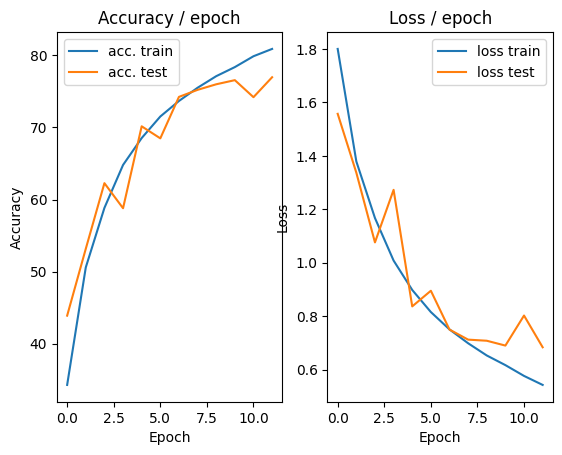

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.202s (0.202s)	Loss 0.5938 (0.5938)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)


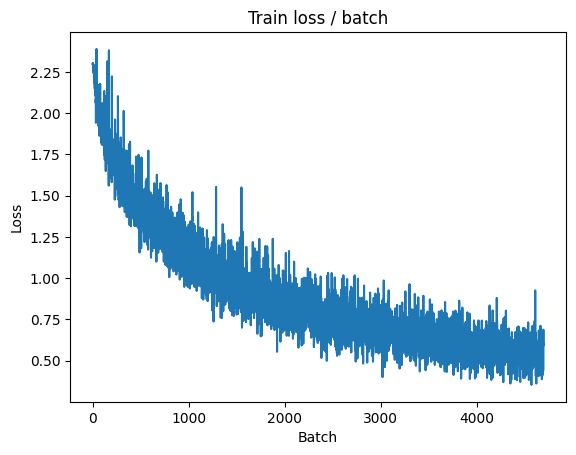

[TRAIN Batch 200/391]	Time 0.113s (0.044s)	Loss 0.3883 (0.5126)	Prec@1  86.7 ( 82.4)	Prec@5 100.0 ( 99.2)


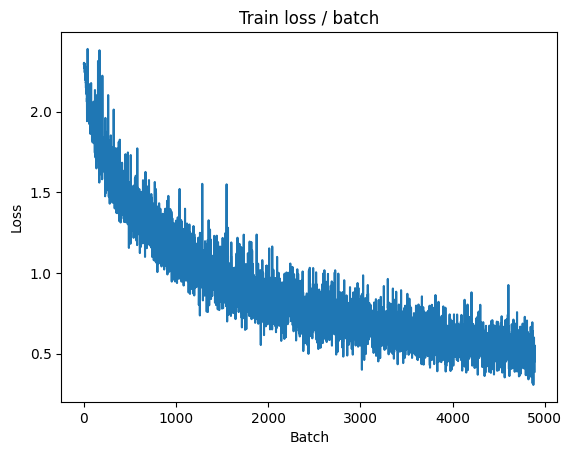


===============> Total time 16s	Avg loss 0.5186	Avg Prec@1 81.99 %	Avg Prec@5 99.19 %

[EVAL Batch 000/079]	Time 0.164s (0.164s)	Loss 0.6153 (0.6153)	Prec@1  78.9 ( 78.9)	Prec@5 100.0 (100.0)

===============> Total time 2s	Avg loss 0.6549	Avg Prec@1 77.71 %	Avg Prec@5 98.74 %



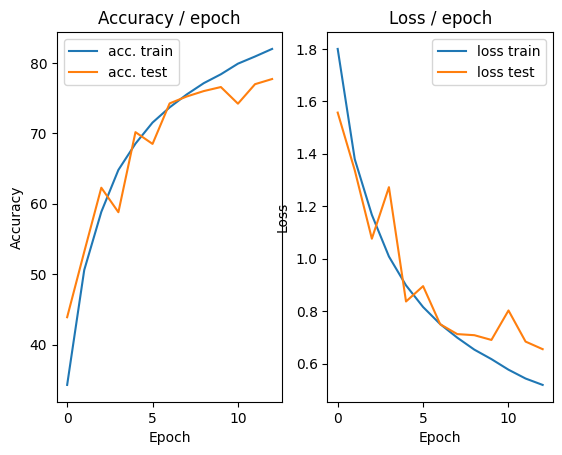

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.201s (0.201s)	Loss 0.5778 (0.5778)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)


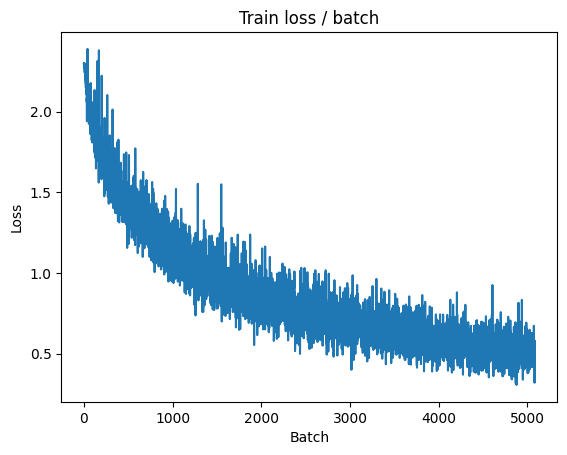

[TRAIN Batch 200/391]	Time 0.070s (0.046s)	Loss 0.4664 (0.4881)	Prec@1  83.6 ( 82.9)	Prec@5  99.2 ( 99.3)


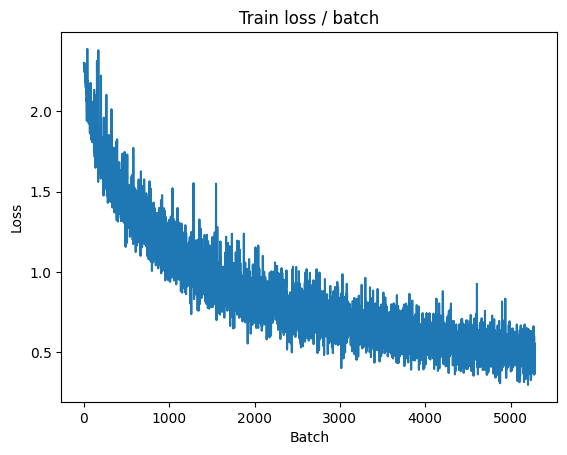


===============> Total time 17s	Avg loss 0.4881	Avg Prec@1 82.99 %	Avg Prec@5 99.32 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 0.4926 (0.4926)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.6126	Avg Prec@1 79.26 %	Avg Prec@5 98.85 %



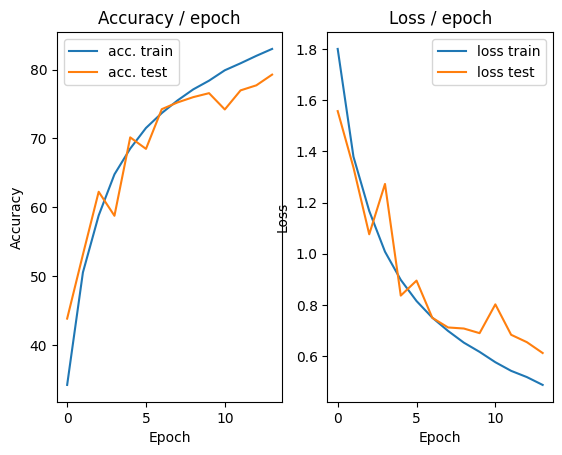

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.232s (0.232s)	Loss 0.4896 (0.4896)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)


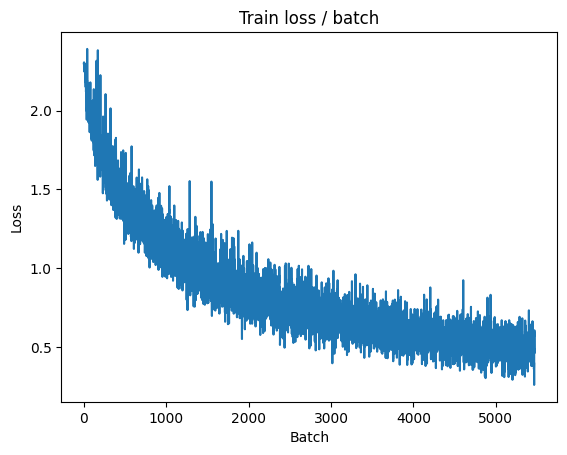

[TRAIN Batch 200/391]	Time 0.059s (0.046s)	Loss 0.5841 (0.4624)	Prec@1  79.7 ( 83.9)	Prec@5  98.4 ( 99.3)


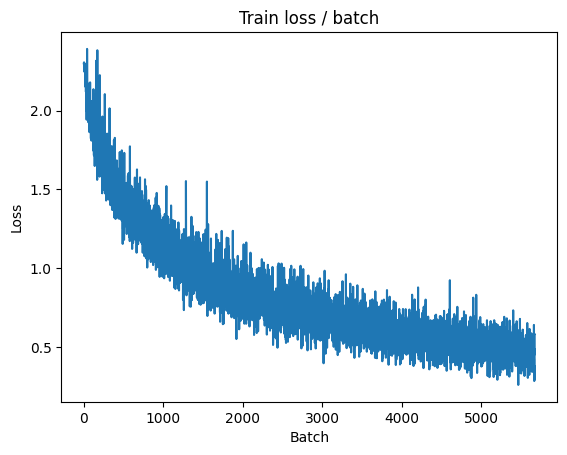


===============> Total time 16s	Avg loss 0.4649	Avg Prec@1 83.73 %	Avg Prec@5 99.34 %

[EVAL Batch 000/079]	Time 0.160s (0.160s)	Loss 0.5274 (0.5274)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.6597	Avg Prec@1 77.27 %	Avg Prec@5 98.65 %



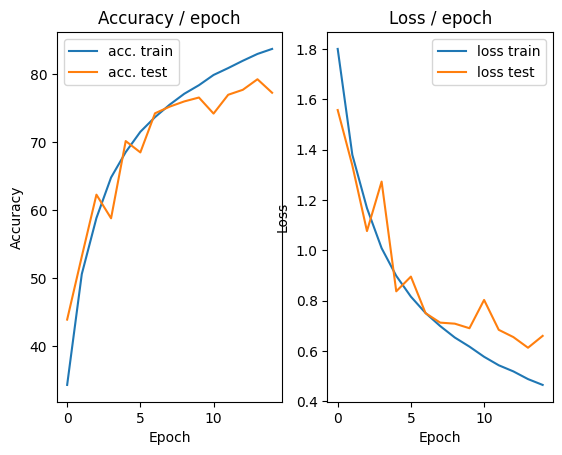

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 1.199s (1.199s)	Loss 0.3970 (0.3970)	Prec@1  86.7 ( 86.7)	Prec@5 100.0 (100.0)


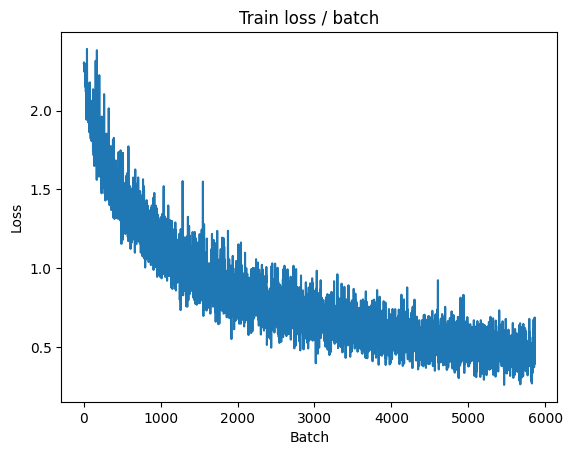

[TRAIN Batch 200/391]	Time 0.011s (0.046s)	Loss 0.4936 (0.4360)	Prec@1  78.9 ( 84.6)	Prec@5 100.0 ( 99.5)


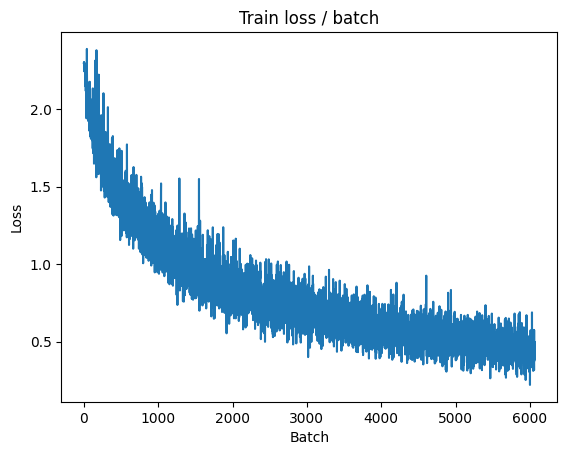


===============> Total time 17s	Avg loss 0.4397	Avg Prec@1 84.51 %	Avg Prec@5 99.48 %

[EVAL Batch 000/079]	Time 0.171s (0.171s)	Loss 0.5110 (0.5110)	Prec@1  80.5 ( 80.5)	Prec@5 100.0 (100.0)

===============> Total time 2s	Avg loss 0.6049	Avg Prec@1 80.06 %	Avg Prec@5 98.71 %



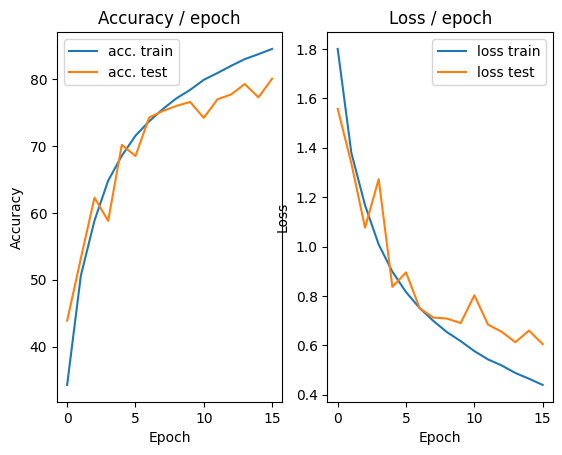

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.221s (0.221s)	Loss 0.5354 (0.5354)	Prec@1  78.9 ( 78.9)	Prec@5 100.0 (100.0)


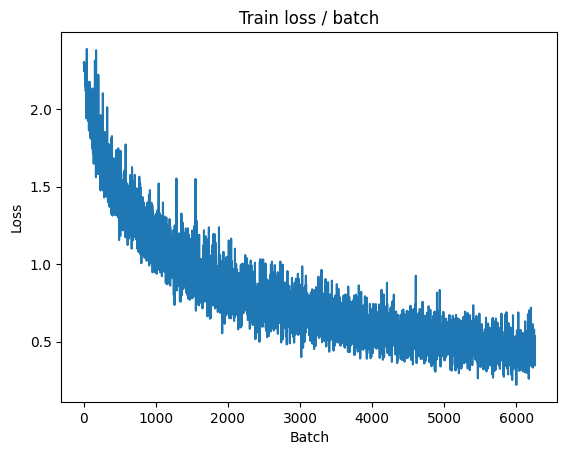

[TRAIN Batch 200/391]	Time 0.012s (0.047s)	Loss 0.3465 (0.4099)	Prec@1  84.4 ( 85.5)	Prec@5  99.2 ( 99.6)


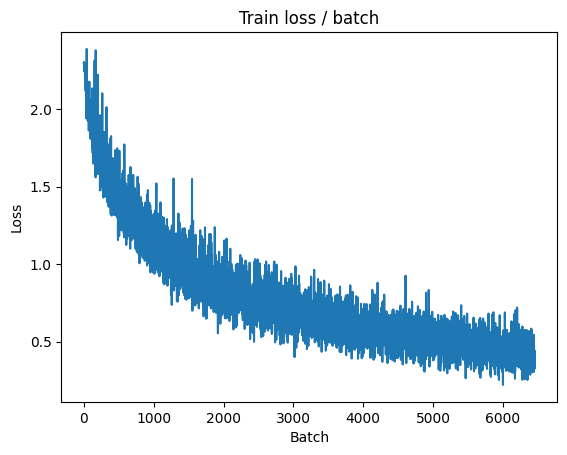


===============> Total time 17s	Avg loss 0.4188	Avg Prec@1 85.29 %	Avg Prec@5 99.55 %

[EVAL Batch 000/079]	Time 0.210s (0.210s)	Loss 0.5237 (0.5237)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.6097	Avg Prec@1 79.59 %	Avg Prec@5 98.74 %



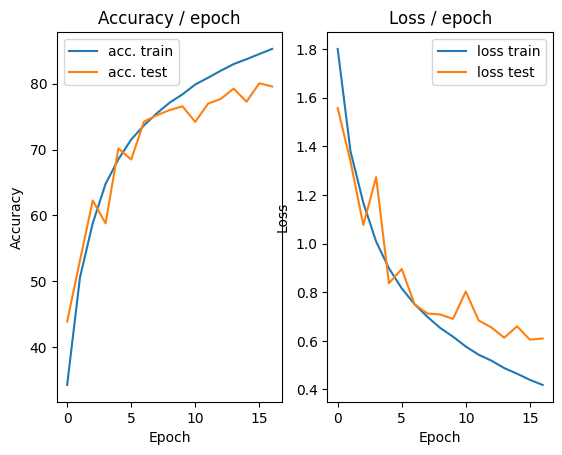

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.201s (0.201s)	Loss 0.4485 (0.4485)	Prec@1  86.7 ( 86.7)	Prec@5  98.4 ( 98.4)


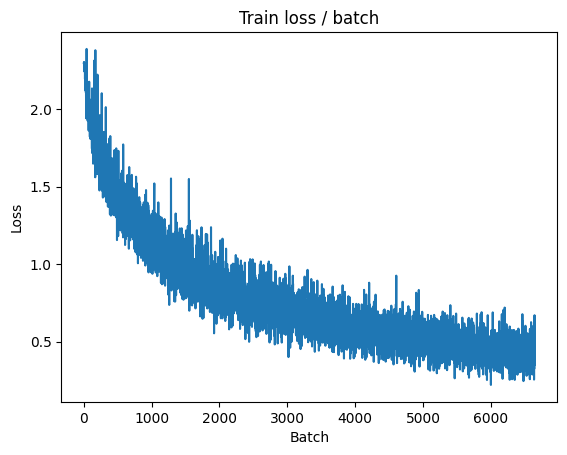

[TRAIN Batch 200/391]	Time 0.077s (0.043s)	Loss 0.4358 (0.3929)	Prec@1  87.5 ( 86.2)	Prec@5  99.2 ( 99.6)


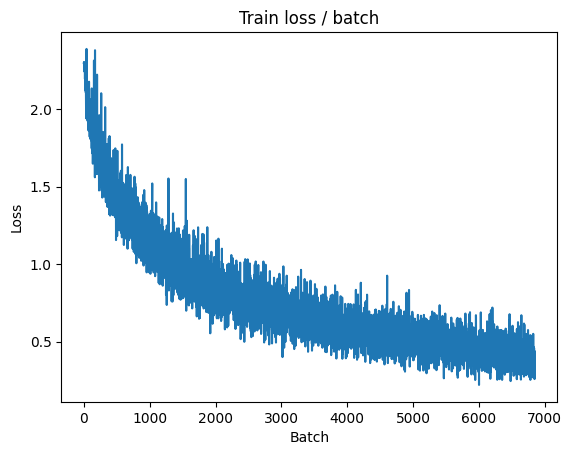


===============> Total time 16s	Avg loss 0.3980	Avg Prec@1 86.00 %	Avg Prec@5 99.58 %

[EVAL Batch 000/079]	Time 0.162s (0.162s)	Loss 0.4622 (0.4622)	Prec@1  85.9 ( 85.9)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6065	Avg Prec@1 80.09 %	Avg Prec@5 98.73 %



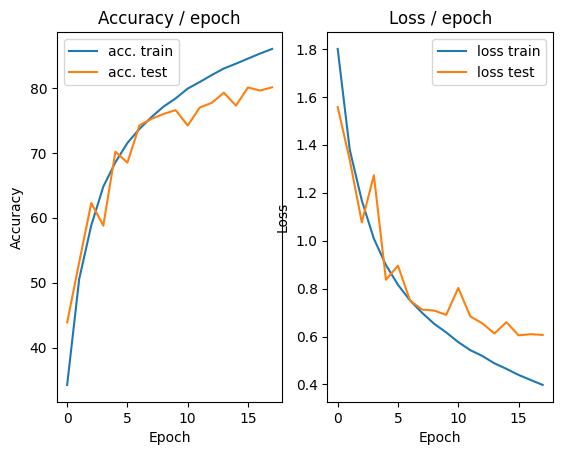

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.233s (0.233s)	Loss 0.3589 (0.3589)	Prec@1  89.8 ( 89.8)	Prec@5  99.2 ( 99.2)


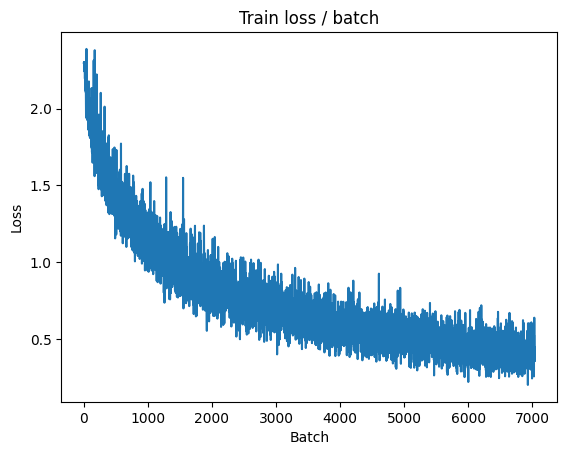

[TRAIN Batch 200/391]	Time 0.075s (0.047s)	Loss 0.4962 (0.3734)	Prec@1  83.6 ( 86.9)	Prec@5  99.2 ( 99.6)


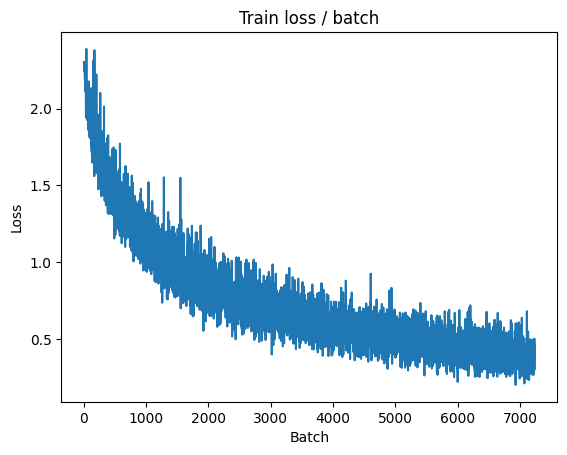


===============> Total time 18s	Avg loss 0.3801	Avg Prec@1 86.63 %	Avg Prec@5 99.62 %

[EVAL Batch 000/079]	Time 0.169s (0.169s)	Loss 0.4509 (0.4509)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)

===============> Total time 2s	Avg loss 0.5847	Avg Prec@1 80.59 %	Avg Prec@5 98.93 %



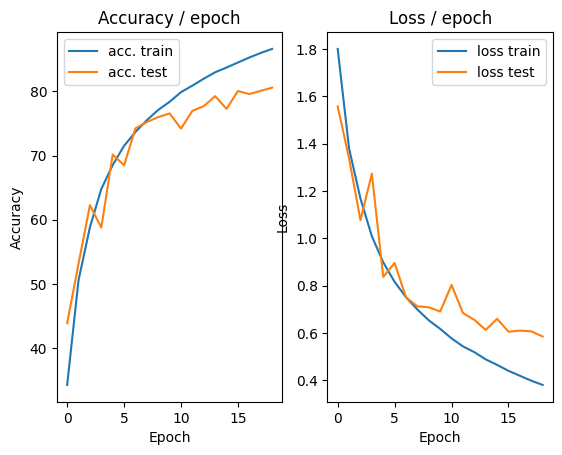

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.217s (0.217s)	Loss 0.3529 (0.3529)	Prec@1  87.5 ( 87.5)	Prec@5  99.2 ( 99.2)


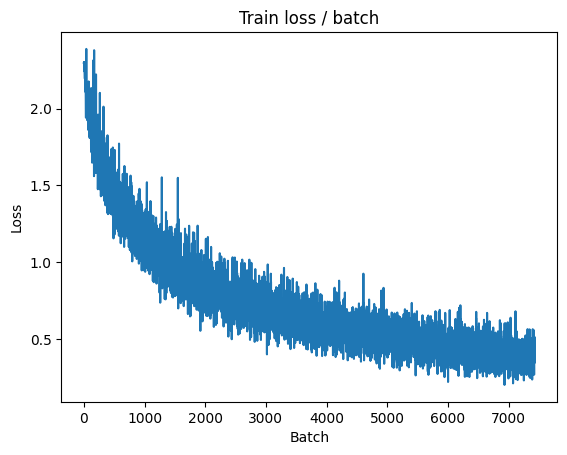

[TRAIN Batch 200/391]	Time 0.061s (0.045s)	Loss 0.2975 (0.3501)	Prec@1  89.1 ( 87.8)	Prec@5 100.0 ( 99.6)


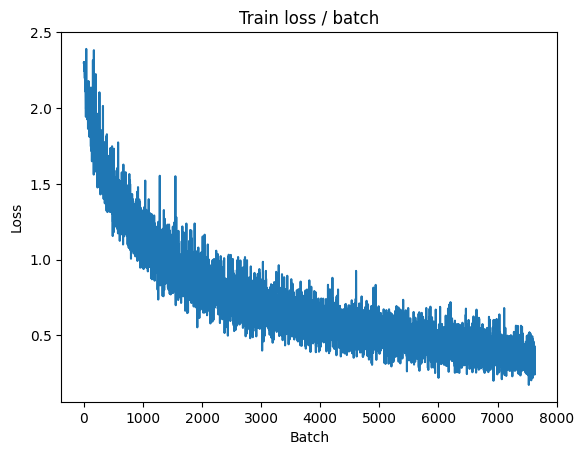


===============> Total time 16s	Avg loss 0.3562	Avg Prec@1 87.60 %	Avg Prec@5 99.65 %

[EVAL Batch 000/079]	Time 0.158s (0.158s)	Loss 0.4753 (0.4753)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.5972	Avg Prec@1 80.68 %	Avg Prec@5 98.87 %



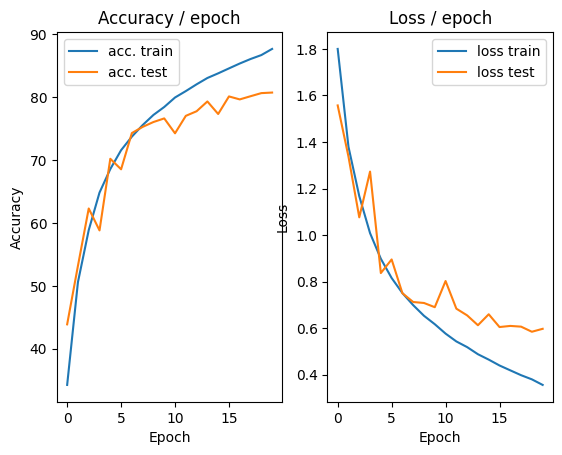

In [35]:
main_cifar_optim(batch_size=128, epochs=20, cuda=True, get_dataset=get_cifar_dataset_data_increase)

## Variants on the optimization (bonus)

=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.176s (0.176s)	Loss 2.3022 (2.3022)	Prec@1  12.5 ( 12.5)	Prec@5  52.3 ( 52.3)


<Figure size 640x480 with 0 Axes>

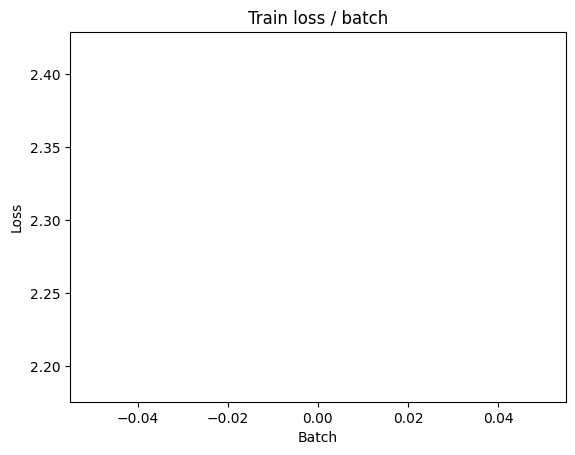

[TRAIN Batch 200/391]	Time 0.037s (0.041s)	Loss 1.2710 (1.6504)	Prec@1  57.0 ( 39.2)	Prec@5  97.7 ( 87.6)


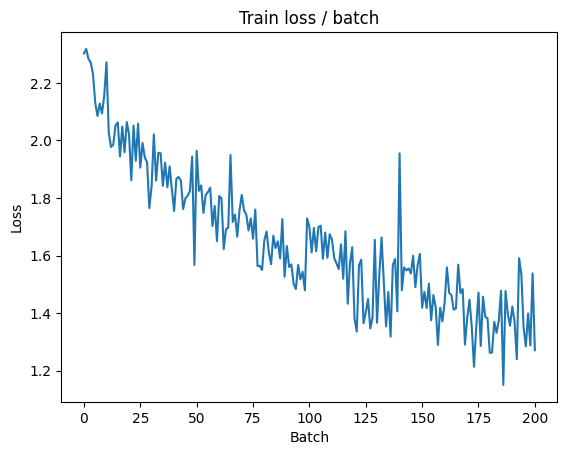


===============> Total time 16s	Avg loss 1.4685	Avg Prec@1 46.29 %	Avg Prec@5 90.89 %

[EVAL Batch 000/079]	Time 0.147s (0.147s)	Loss 1.1315 (1.1315)	Prec@1  62.5 ( 62.5)	Prec@5  93.8 ( 93.8)

===============> Total time 2s	Avg loss 1.1018	Avg Prec@1 60.60 %	Avg Prec@5 96.29 %



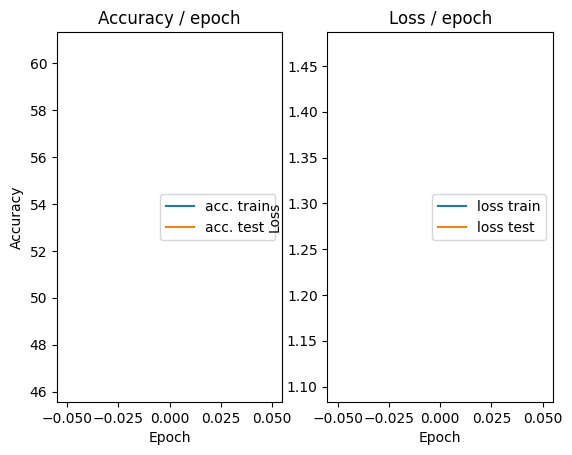

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.178s (0.178s)	Loss 1.0564 (1.0564)	Prec@1  64.8 ( 64.8)	Prec@5  96.1 ( 96.1)


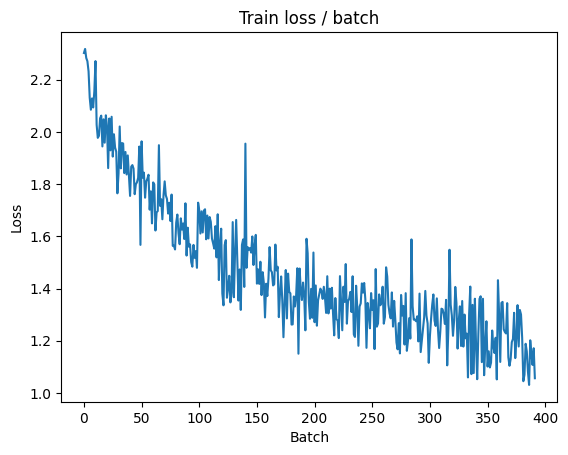

[TRAIN Batch 200/391]	Time 0.012s (0.045s)	Loss 1.1422 (1.0912)	Prec@1  57.8 ( 61.0)	Prec@5  96.1 ( 96.2)


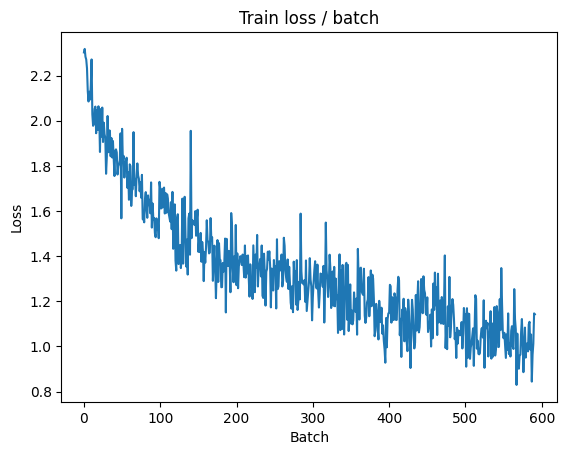


===============> Total time 17s	Avg loss 1.0554	Avg Prec@1 62.56 %	Avg Prec@5 96.40 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 0.9223 (0.9223)	Prec@1  66.4 ( 66.4)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 0.9533	Avg Prec@1 66.30 %	Avg Prec@5 97.21 %



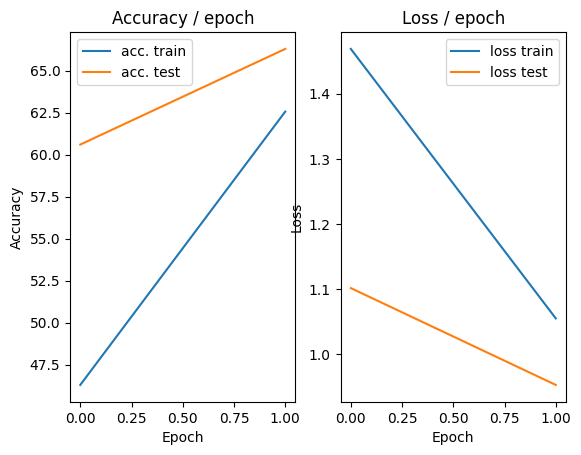

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.203s (0.203s)	Loss 1.0130 (1.0130)	Prec@1  66.4 ( 66.4)	Prec@5  97.7 ( 97.7)


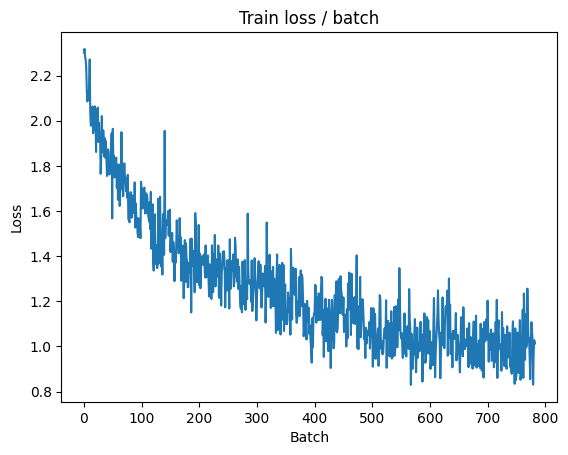

[TRAIN Batch 200/391]	Time 0.013s (0.043s)	Loss 1.0196 (0.9244)	Prec@1  64.1 ( 67.5)	Prec@5  96.9 ( 97.2)


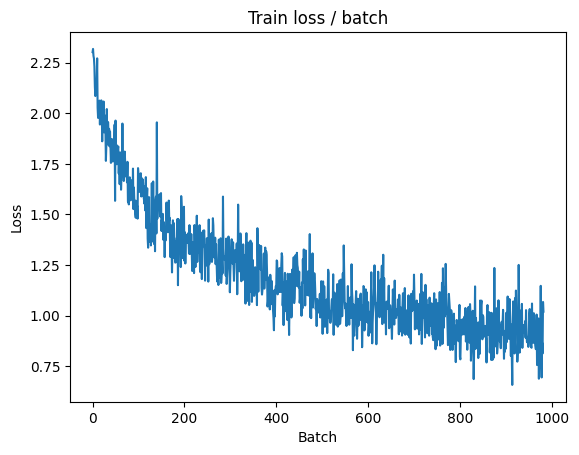


===============> Total time 16s	Avg loss 0.9062	Avg Prec@1 67.90 %	Avg Prec@5 97.35 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 0.8608 (0.8608)	Prec@1  69.5 ( 69.5)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.8474	Avg Prec@1 70.38 %	Avg Prec@5 97.58 %



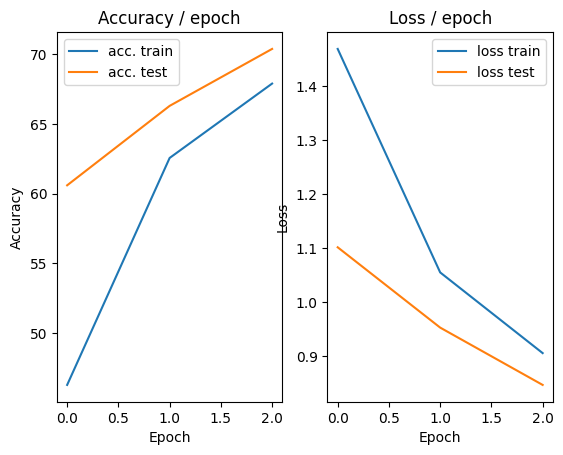

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.185s (0.185s)	Loss 0.8914 (0.8914)	Prec@1  68.8 ( 68.8)	Prec@5  96.9 ( 96.9)


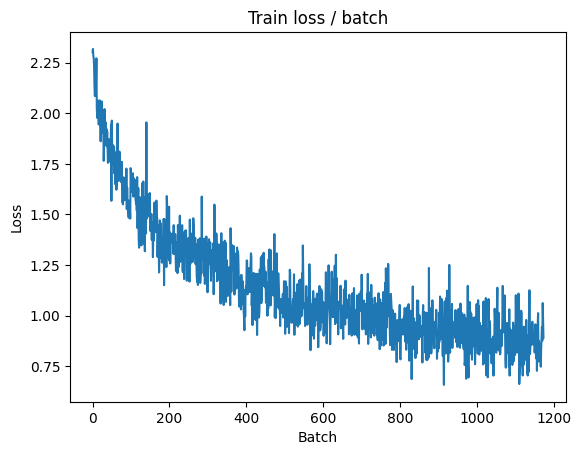

[TRAIN Batch 200/391]	Time 0.010s (0.045s)	Loss 0.8841 (0.8059)	Prec@1  69.5 ( 71.7)	Prec@5  96.9 ( 97.9)


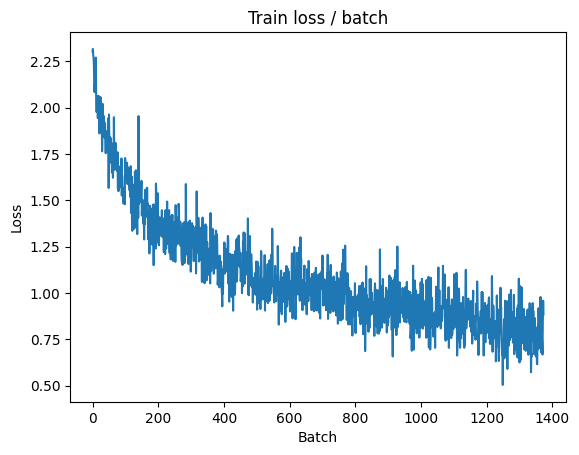


===============> Total time 17s	Avg loss 0.7960	Avg Prec@1 72.09 %	Avg Prec@5 97.93 %

[EVAL Batch 000/079]	Time 0.145s (0.145s)	Loss 0.7658 (0.7658)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.7828	Avg Prec@1 73.76 %	Avg Prec@5 97.91 %



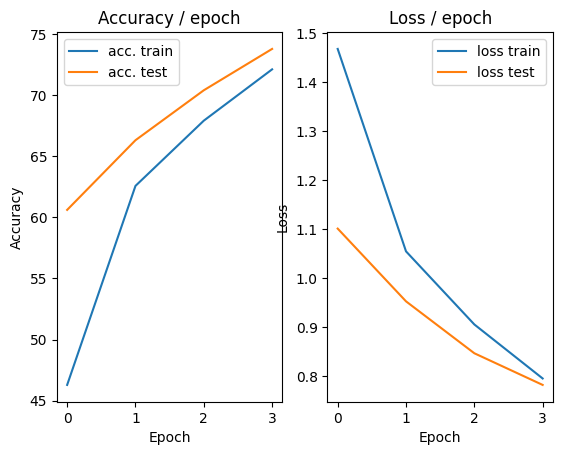

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.186s (0.186s)	Loss 0.8039 (0.8039)	Prec@1  72.7 ( 72.7)	Prec@5  97.7 ( 97.7)


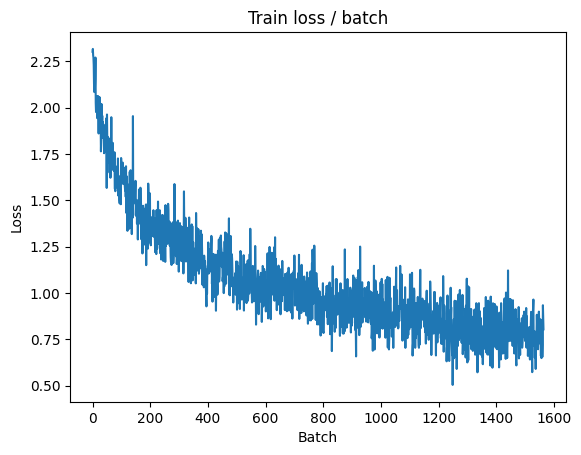

[TRAIN Batch 200/391]	Time 0.061s (0.046s)	Loss 0.8821 (0.7435)	Prec@1  71.9 ( 73.9)	Prec@5  96.9 ( 98.3)


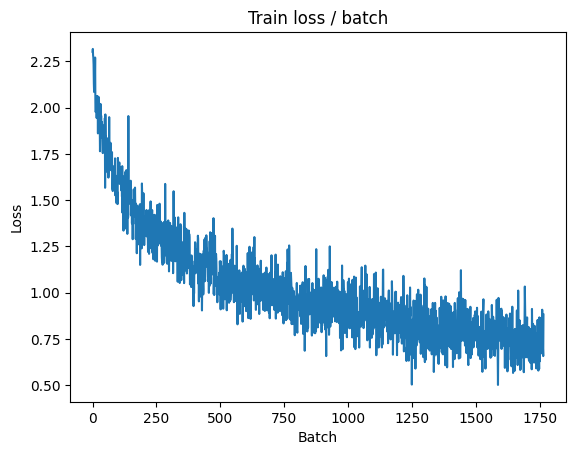


===============> Total time 16s	Avg loss 0.7319	Avg Prec@1 74.46 %	Avg Prec@5 98.27 %

[EVAL Batch 000/079]	Time 0.159s (0.159s)	Loss 0.6745 (0.6745)	Prec@1  78.9 ( 78.9)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.7595	Avg Prec@1 74.51 %	Avg Prec@5 98.04 %



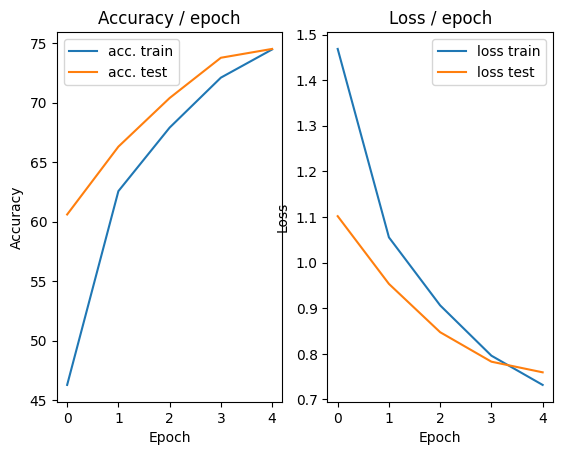

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.226s (0.226s)	Loss 0.6441 (0.6441)	Prec@1  78.1 ( 78.1)	Prec@5  99.2 ( 99.2)


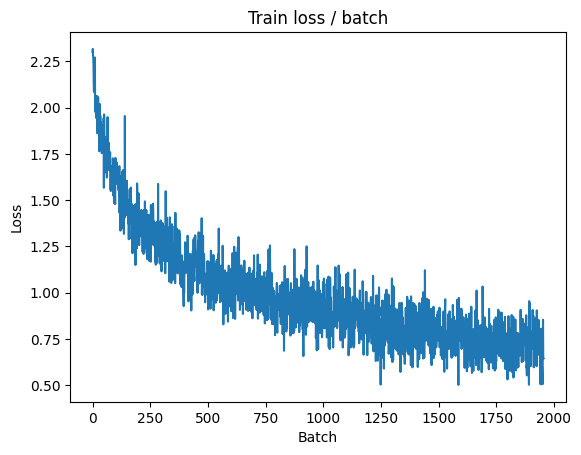

[TRAIN Batch 200/391]	Time 0.011s (0.041s)	Loss 0.6843 (0.6876)	Prec@1  76.6 ( 75.9)	Prec@5  99.2 ( 98.6)


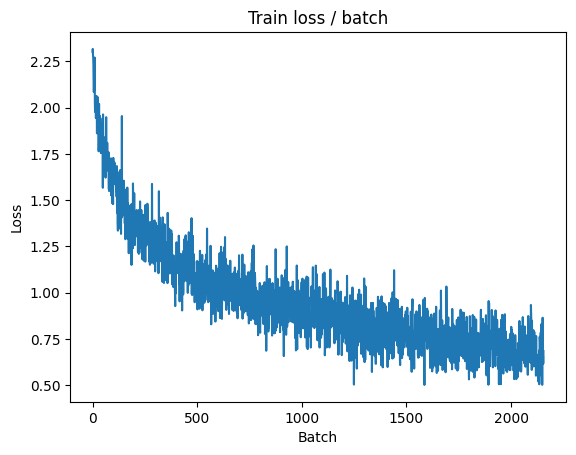


===============> Total time 16s	Avg loss 0.6829	Avg Prec@1 76.11 %	Avg Prec@5 98.54 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 0.7309 (0.7309)	Prec@1  74.2 ( 74.2)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7041	Avg Prec@1 76.28 %	Avg Prec@5 98.14 %



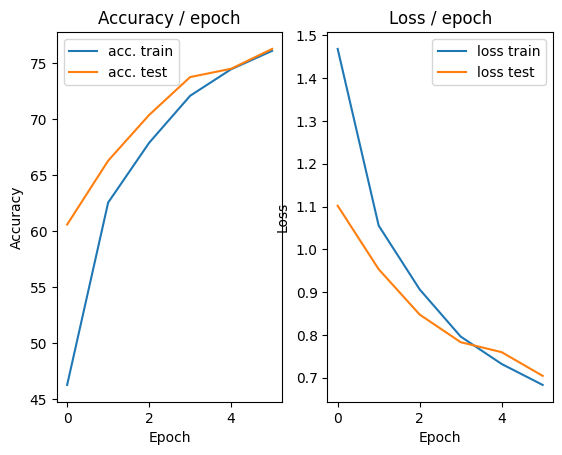

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.196s (0.196s)	Loss 0.5395 (0.5395)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)


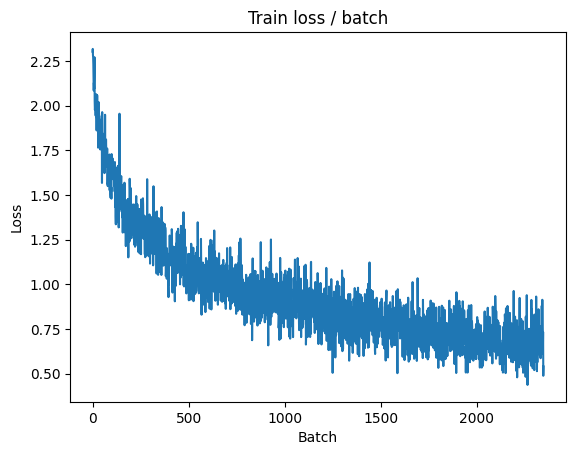

[TRAIN Batch 200/391]	Time 0.023s (0.046s)	Loss 0.6276 (0.6374)	Prec@1  77.3 ( 77.9)	Prec@5  97.7 ( 98.6)


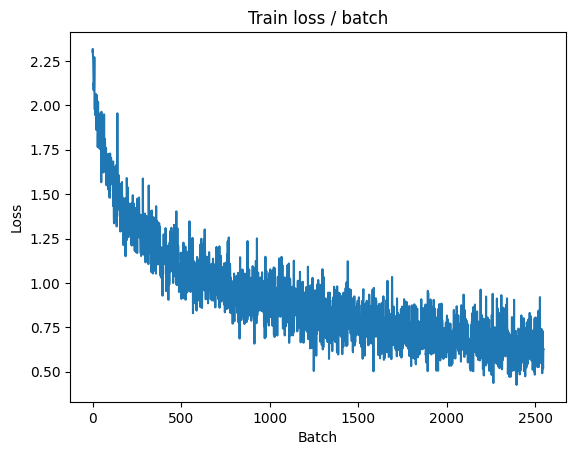


===============> Total time 17s	Avg loss 0.6386	Avg Prec@1 77.74 %	Avg Prec@5 98.65 %

[EVAL Batch 000/079]	Time 0.257s (0.257s)	Loss 0.6086 (0.6086)	Prec@1  84.4 ( 84.4)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.6829	Avg Prec@1 76.60 %	Avg Prec@5 98.59 %



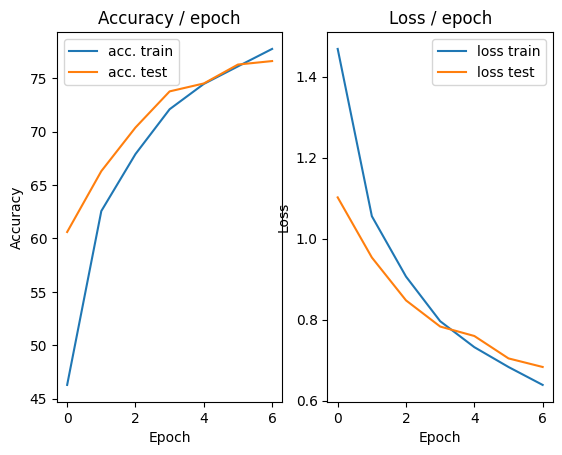

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.204s (0.204s)	Loss 0.5243 (0.5243)	Prec@1  79.7 ( 79.7)	Prec@5 100.0 (100.0)


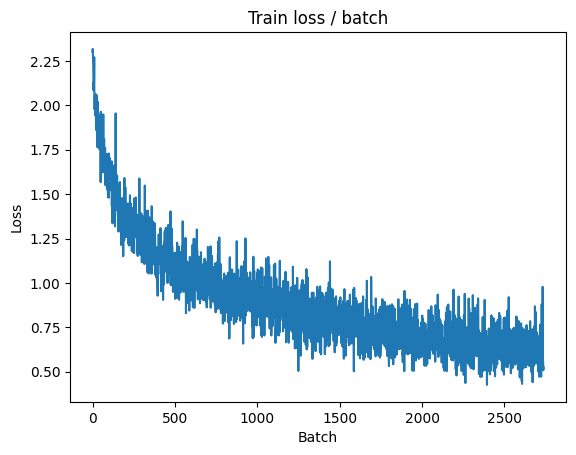

[TRAIN Batch 200/391]	Time 0.065s (0.040s)	Loss 0.5853 (0.6011)	Prec@1  82.8 ( 79.3)	Prec@5  99.2 ( 98.8)


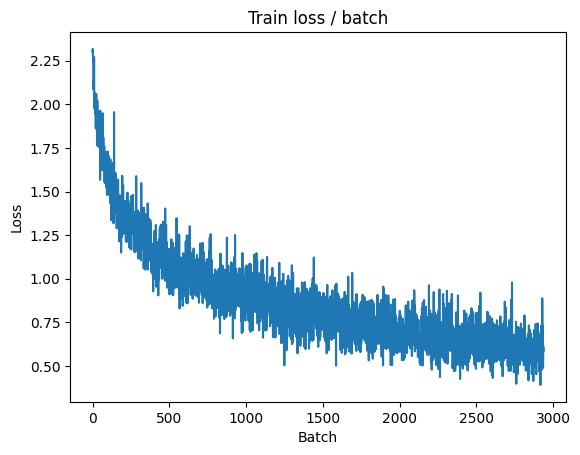


===============> Total time 16s	Avg loss 0.6023	Avg Prec@1 79.10 %	Avg Prec@5 98.82 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 0.6460 (0.6460)	Prec@1  81.2 ( 81.2)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.6646	Avg Prec@1 77.22 %	Avg Prec@5 98.53 %



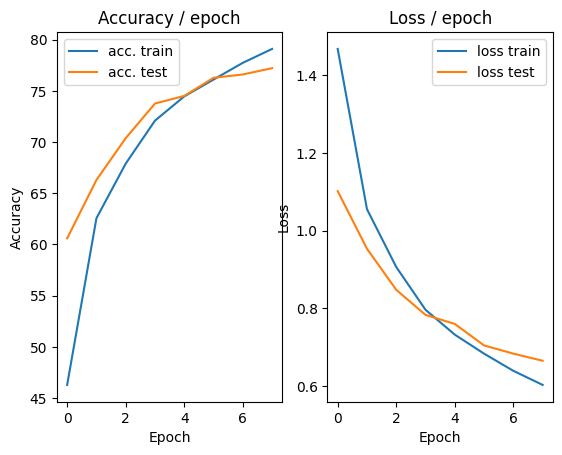

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.224s (0.224s)	Loss 0.5139 (0.5139)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)


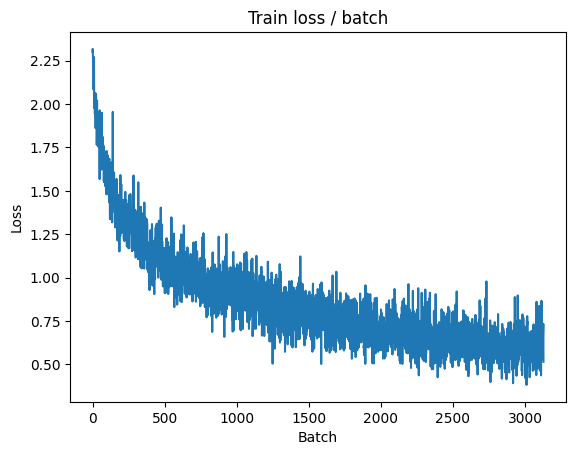

[TRAIN Batch 200/391]	Time 0.023s (0.045s)	Loss 0.5550 (0.5538)	Prec@1  83.6 ( 80.2)	Prec@5  98.4 ( 99.1)


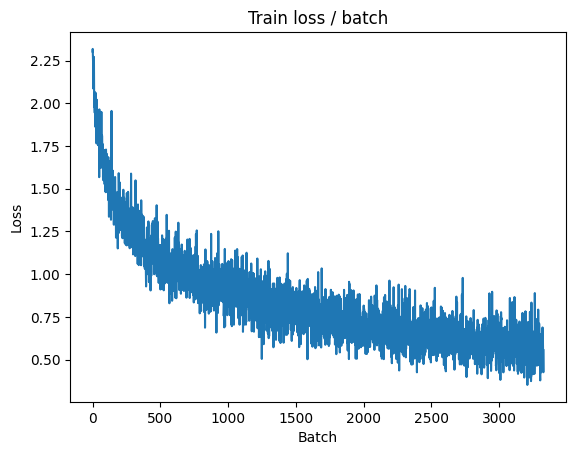


===============> Total time 17s	Avg loss 0.5691	Avg Prec@1 79.86 %	Avg Prec@5 98.97 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 0.7059 (0.7059)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6851	Avg Prec@1 77.15 %	Avg Prec@5 98.49 %



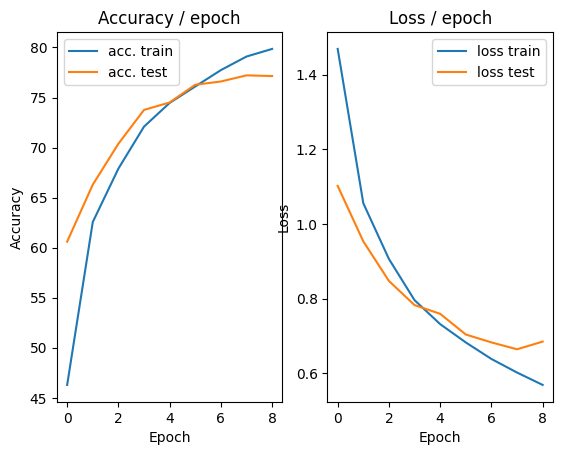

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.199s (0.199s)	Loss 0.6682 (0.6682)	Prec@1  78.1 ( 78.1)	Prec@5 100.0 (100.0)


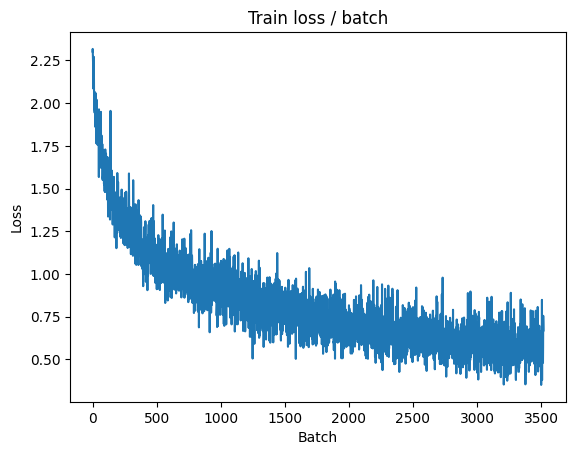

[TRAIN Batch 200/391]	Time 0.080s (0.044s)	Loss 0.4083 (0.5267)	Prec@1  88.3 ( 81.5)	Prec@5  99.2 ( 99.2)


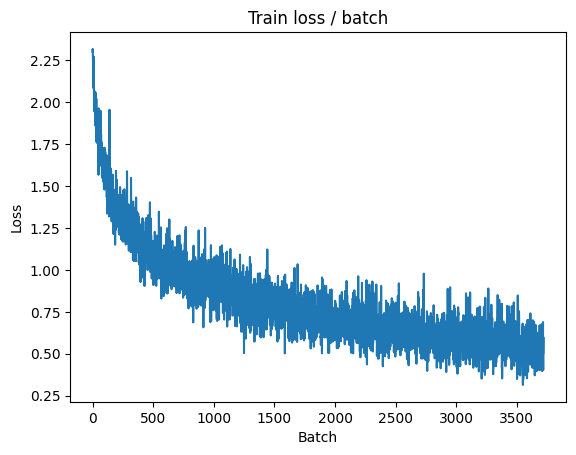


===============> Total time 16s	Avg loss 0.5423	Avg Prec@1 81.02 %	Avg Prec@5 99.12 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 0.6150 (0.6150)	Prec@1  82.0 ( 82.0)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6365	Avg Prec@1 78.85 %	Avg Prec@5 98.62 %



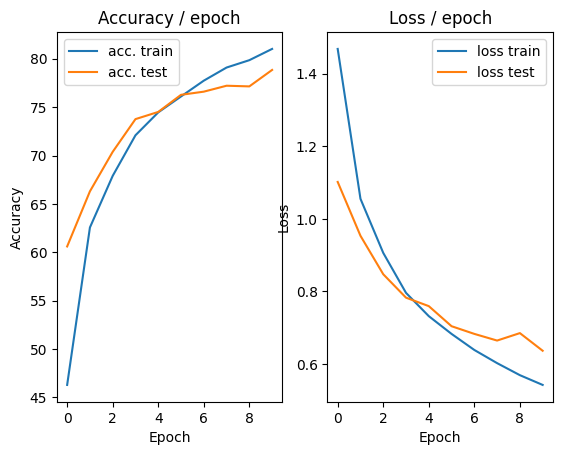

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.196s (0.196s)	Loss 0.5872 (0.5872)	Prec@1  76.6 ( 76.6)	Prec@5 100.0 (100.0)


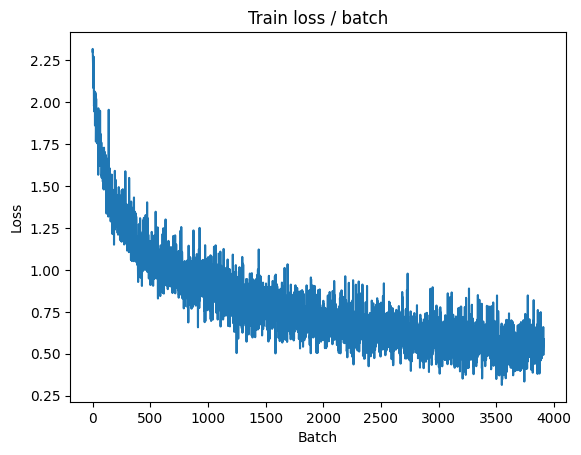

[TRAIN Batch 200/391]	Time 0.056s (0.045s)	Loss 0.5104 (0.5029)	Prec@1  80.5 ( 82.2)	Prec@5  99.2 ( 99.2)


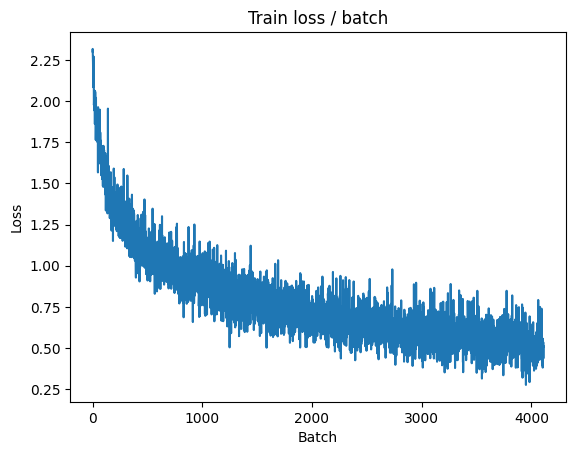


===============> Total time 17s	Avg loss 0.5082	Avg Prec@1 82.16 %	Avg Prec@5 99.25 %

[EVAL Batch 000/079]	Time 0.147s (0.147s)	Loss 0.7062 (0.7062)	Prec@1  78.9 ( 78.9)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.6397	Avg Prec@1 78.09 %	Avg Prec@5 98.89 %



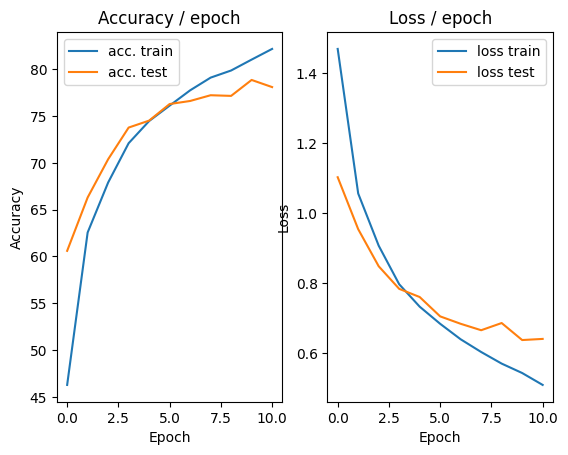

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.195s (0.195s)	Loss 0.4162 (0.4162)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)


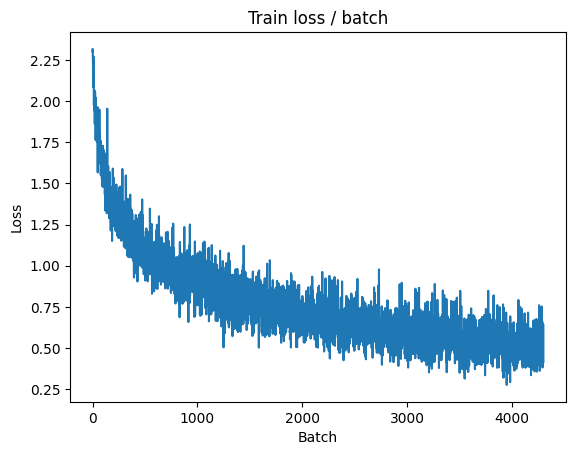

[TRAIN Batch 200/391]	Time 0.034s (0.045s)	Loss 0.4378 (0.4829)	Prec@1  85.2 ( 82.9)	Prec@5  99.2 ( 99.4)


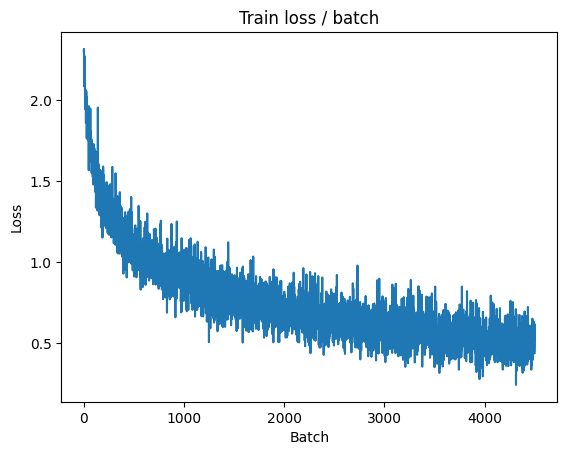


===============> Total time 16s	Avg loss 0.4876	Avg Prec@1 82.88 %	Avg Prec@5 99.28 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 0.6639 (0.6639)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.6220	Avg Prec@1 79.11 %	Avg Prec@5 98.80 %



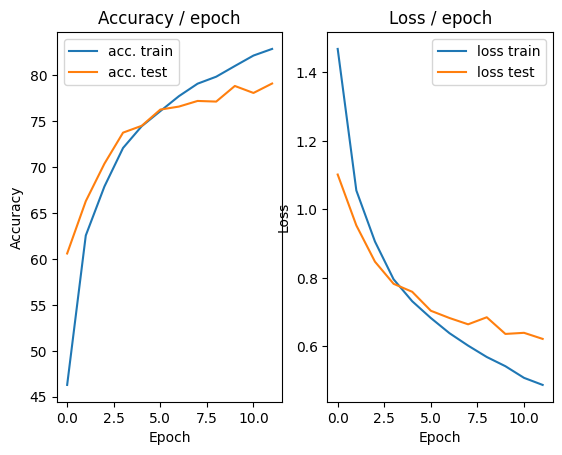

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.349s (0.349s)	Loss 0.3438 (0.3438)	Prec@1  89.8 ( 89.8)	Prec@5  99.2 ( 99.2)


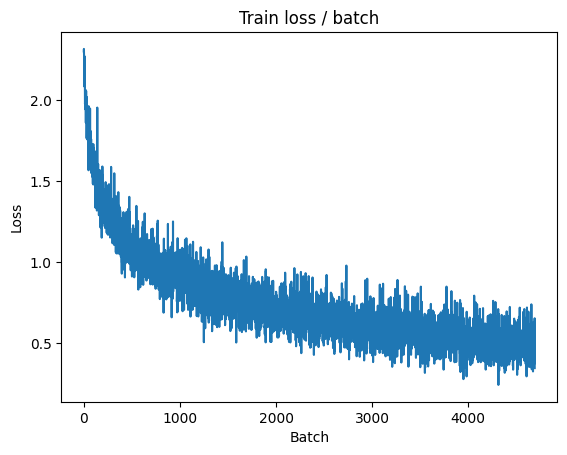

[TRAIN Batch 200/391]	Time 0.016s (0.042s)	Loss 0.4362 (0.4643)	Prec@1  85.9 ( 83.5)	Prec@5  98.4 ( 99.4)


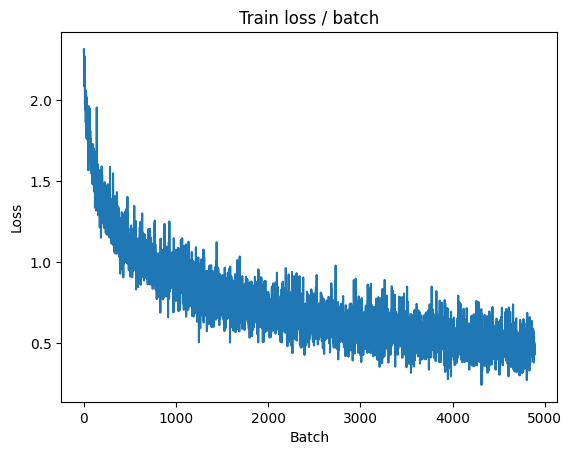


===============> Total time 16s	Avg loss 0.4678	Avg Prec@1 83.60 %	Avg Prec@5 99.37 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 0.6636 (0.6636)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6076	Avg Prec@1 79.89 %	Avg Prec@5 98.77 %



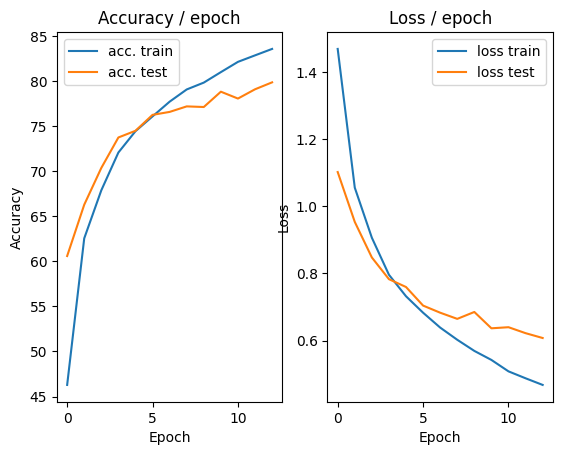

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.208s (0.208s)	Loss 0.5369 (0.5369)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)


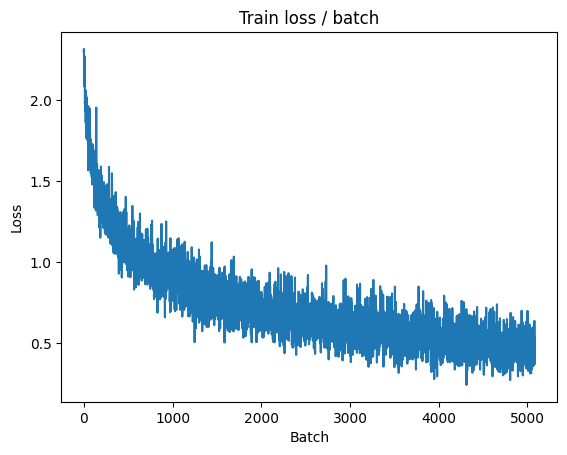

[TRAIN Batch 200/391]	Time 0.013s (0.045s)	Loss 0.4582 (0.4490)	Prec@1  82.0 ( 84.2)	Prec@5 100.0 ( 99.4)


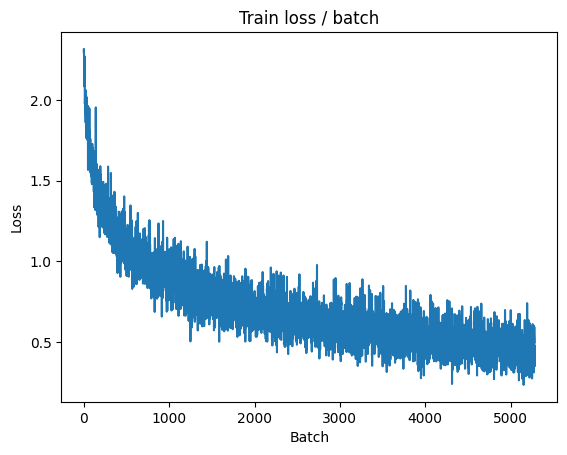


===============> Total time 17s	Avg loss 0.4532	Avg Prec@1 84.05 %	Avg Prec@5 99.43 %

[EVAL Batch 000/079]	Time 0.225s (0.225s)	Loss 0.6400 (0.6400)	Prec@1  81.2 ( 81.2)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.6329	Avg Prec@1 79.04 %	Avg Prec@5 98.87 %



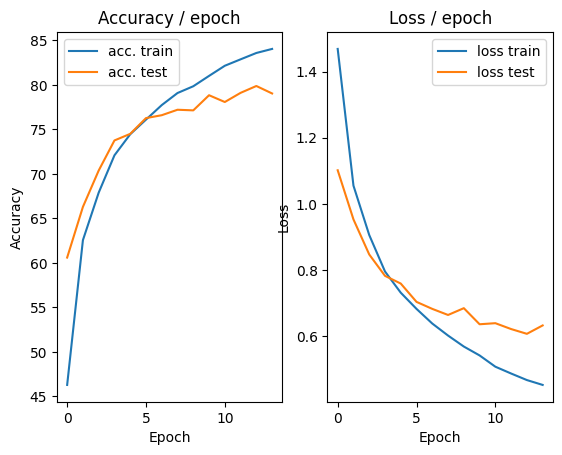

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.209s (0.209s)	Loss 0.3790 (0.3790)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)


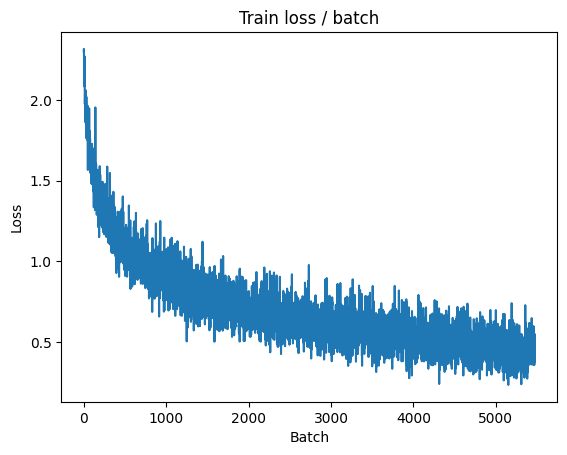

[TRAIN Batch 200/391]	Time 0.015s (0.042s)	Loss 0.6174 (0.4217)	Prec@1  79.7 ( 84.9)	Prec@5 100.0 ( 99.6)


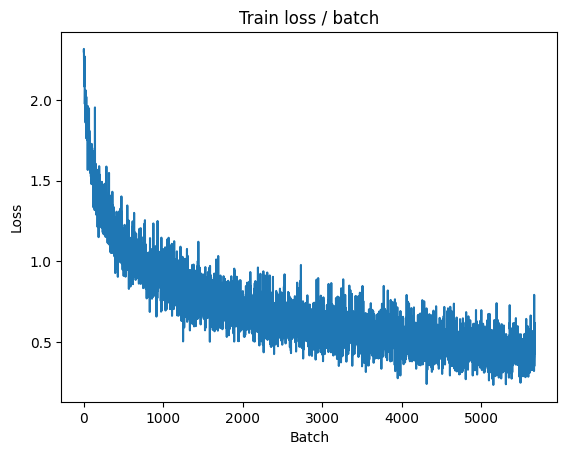


===============> Total time 16s	Avg loss 0.4321	Avg Prec@1 84.79 %	Avg Prec@5 99.52 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 0.7192 (0.7192)	Prec@1  82.8 ( 82.8)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.6547	Avg Prec@1 78.84 %	Avg Prec@5 98.71 %



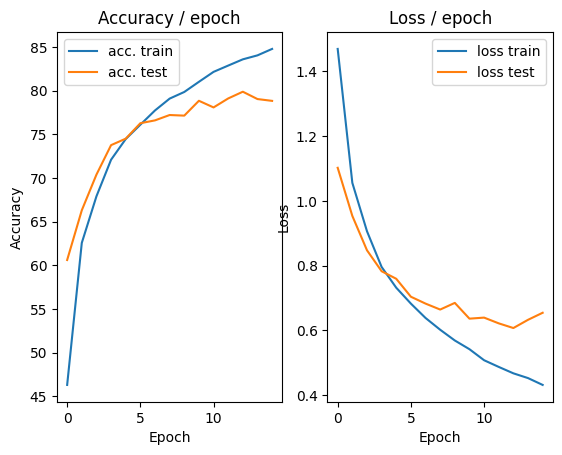

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.198s (0.198s)	Loss 0.4780 (0.4780)	Prec@1  81.2 ( 81.2)	Prec@5 100.0 (100.0)


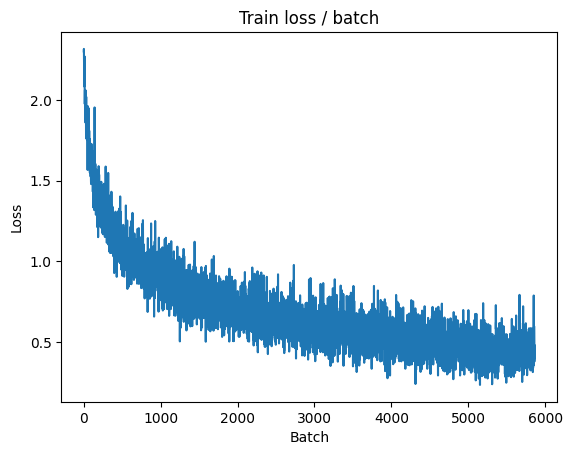

[TRAIN Batch 200/391]	Time 0.080s (0.046s)	Loss 0.5774 (0.4049)	Prec@1  82.0 ( 85.9)	Prec@5  96.9 ( 99.5)


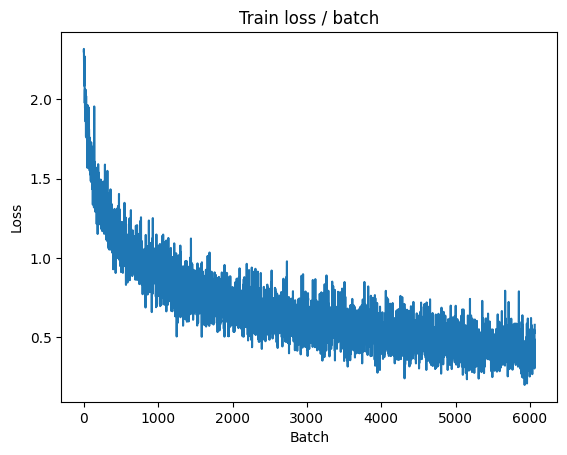


===============> Total time 17s	Avg loss 0.4135	Avg Prec@1 85.60 %	Avg Prec@5 99.49 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 0.7071 (0.7071)	Prec@1  80.5 ( 80.5)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6534	Avg Prec@1 78.75 %	Avg Prec@5 98.47 %



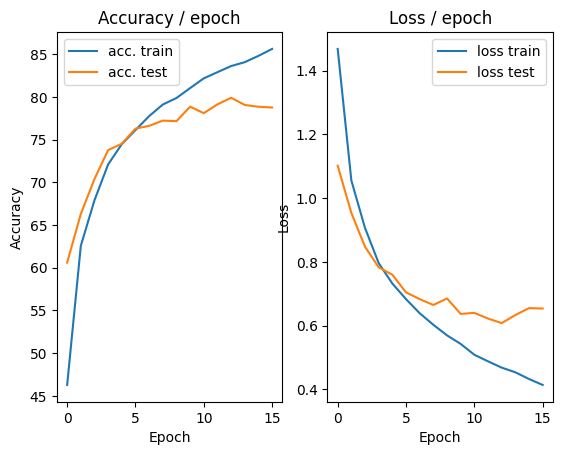

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.209s (0.209s)	Loss 0.3219 (0.3219)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


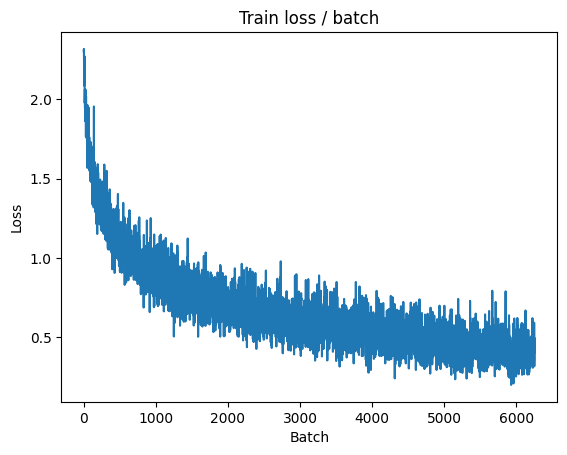

[TRAIN Batch 200/391]	Time 0.011s (0.045s)	Loss 0.4477 (0.3970)	Prec@1  84.4 ( 86.1)	Prec@5  98.4 ( 99.5)


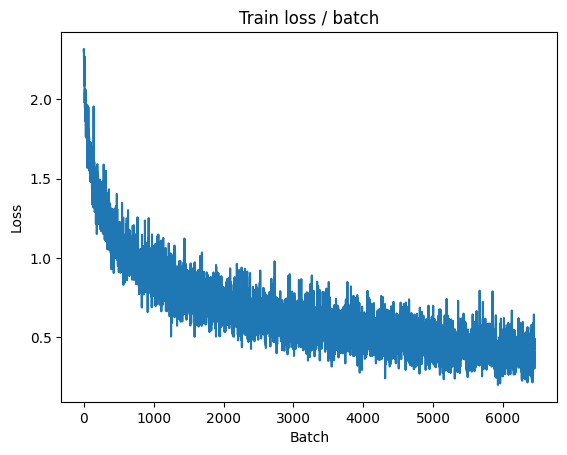


===============> Total time 16s	Avg loss 0.4004	Avg Prec@1 86.08 %	Avg Prec@5 99.54 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 0.7654 (0.7654)	Prec@1  82.0 ( 82.0)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.6457	Avg Prec@1 79.54 %	Avg Prec@5 98.71 %



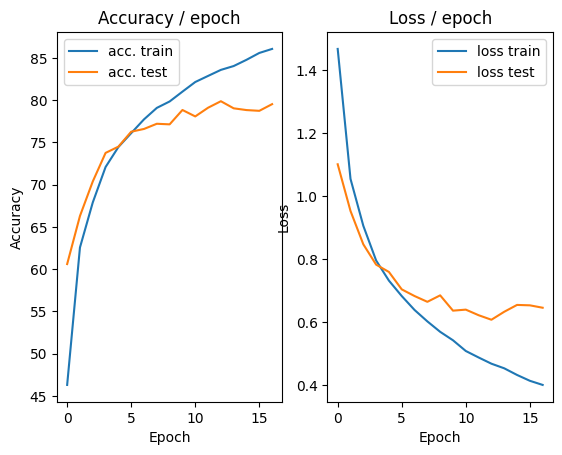

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.320s (0.320s)	Loss 0.4116 (0.4116)	Prec@1  86.7 ( 86.7)	Prec@5 100.0 (100.0)


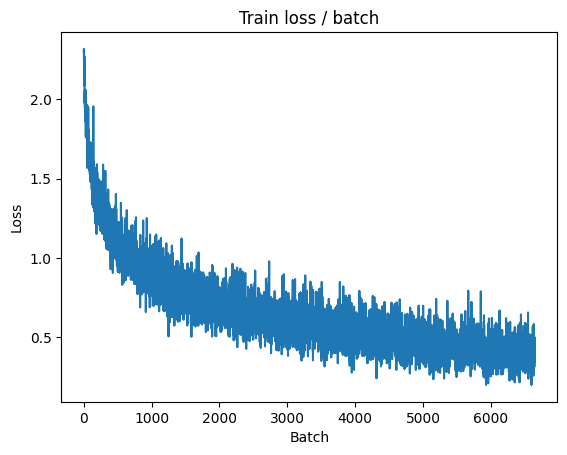

[TRAIN Batch 200/391]	Time 0.015s (0.043s)	Loss 0.3090 (0.3647)	Prec@1  88.3 ( 87.3)	Prec@5 100.0 ( 99.7)


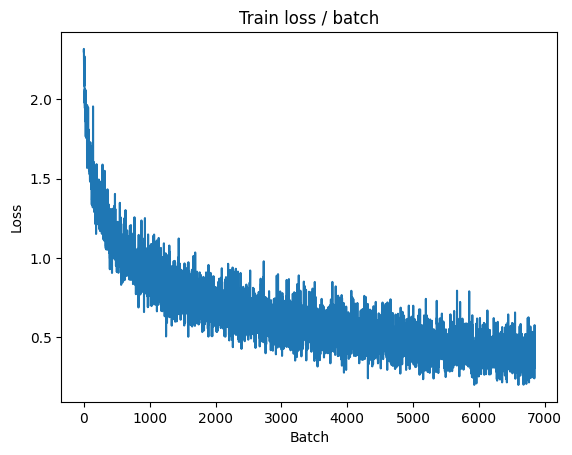


===============> Total time 17s	Avg loss 0.3797	Avg Prec@1 86.73 %	Avg Prec@5 99.65 %

[EVAL Batch 000/079]	Time 0.152s (0.152s)	Loss 0.6619 (0.6619)	Prec@1  82.8 ( 82.8)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.6440	Avg Prec@1 79.97 %	Avg Prec@5 98.87 %



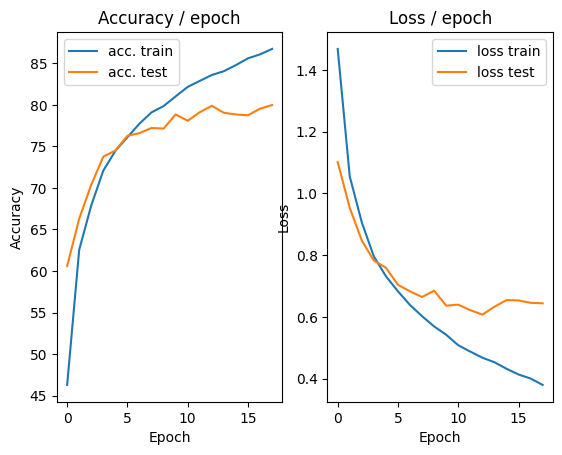

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.202s (0.202s)	Loss 0.2781 (0.2781)	Prec@1  88.3 ( 88.3)	Prec@5  99.2 ( 99.2)


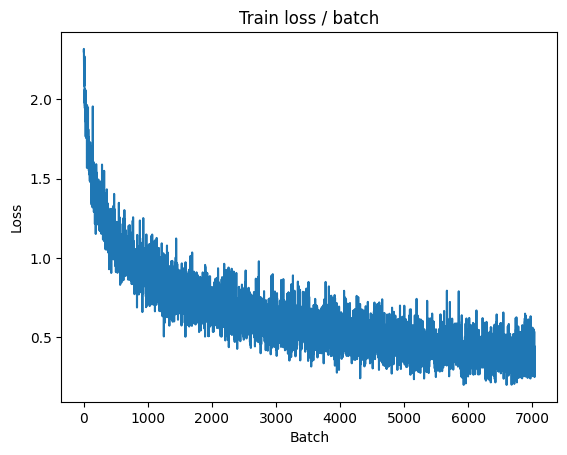

[TRAIN Batch 200/391]	Time 0.005s (0.046s)	Loss 0.4472 (0.3603)	Prec@1  87.5 ( 87.3)	Prec@5 100.0 ( 99.6)


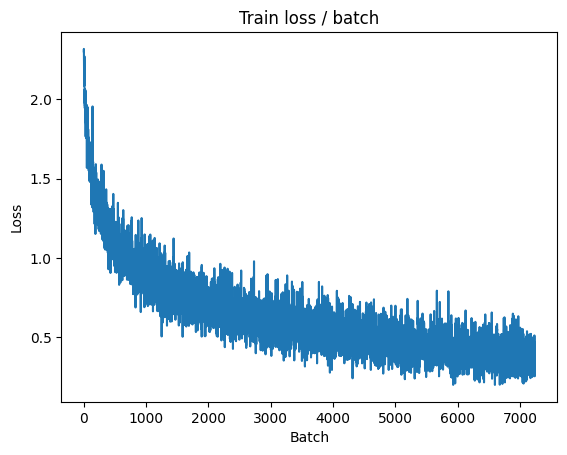


===============> Total time 16s	Avg loss 0.3724	Avg Prec@1 86.96 %	Avg Prec@5 99.63 %

[EVAL Batch 000/079]	Time 0.248s (0.248s)	Loss 0.7045 (0.7045)	Prec@1  84.4 ( 84.4)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 0.6756	Avg Prec@1 80.06 %	Avg Prec@5 98.55 %



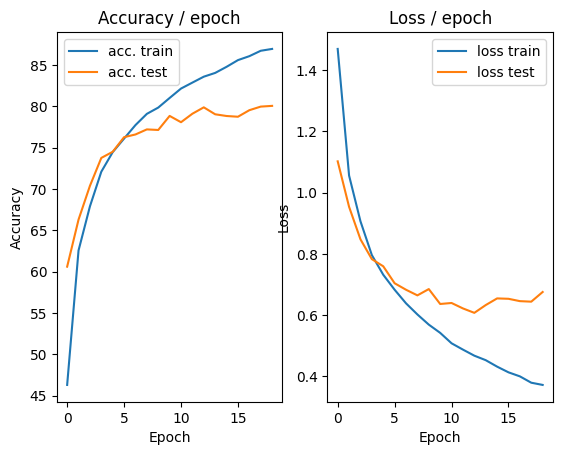

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.213s (0.213s)	Loss 0.2734 (0.2734)	Prec@1  89.8 ( 89.8)	Prec@5  99.2 ( 99.2)


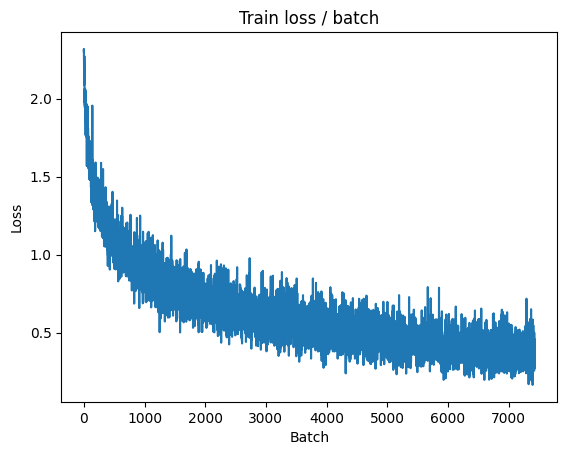

[TRAIN Batch 200/391]	Time 0.038s (0.041s)	Loss 0.3842 (0.3525)	Prec@1  83.6 ( 87.5)	Prec@5 100.0 ( 99.7)


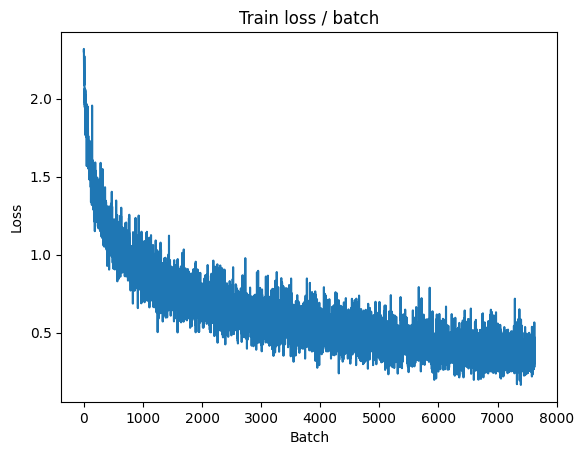


===============> Total time 16s	Avg loss 0.3626	Avg Prec@1 87.20 %	Avg Prec@5 99.66 %

[EVAL Batch 000/079]	Time 0.168s (0.168s)	Loss 0.8746 (0.8746)	Prec@1  77.3 ( 77.3)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.6406	Avg Prec@1 80.74 %	Avg Prec@5 98.68 %



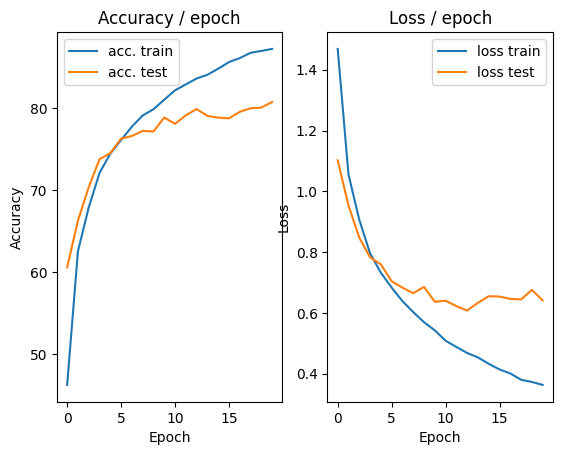

In [36]:
# Adam GD
main_cifar_optim(batch_size=128, lr=1e-3, epochs=20, cuda=True, opt='Adam', get_dataset=get_cifar_dataset_data_increase)

=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.175s (0.175s)	Loss 2.3008 (2.3008)	Prec@1  11.7 ( 11.7)	Prec@5  50.8 ( 50.8)


<Figure size 640x480 with 0 Axes>

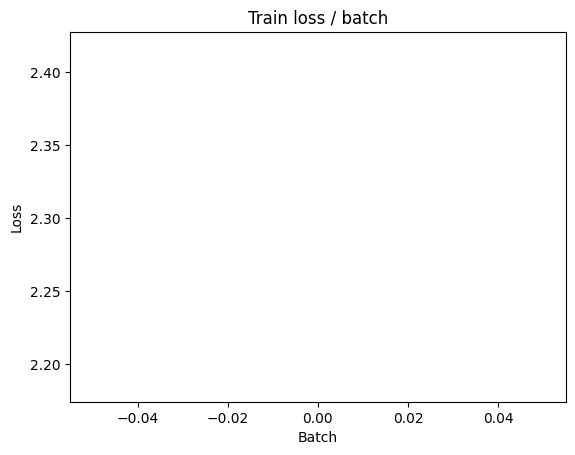

[TRAIN Batch 200/391]	Time 0.040s (0.045s)	Loss 1.8982 (1.9715)	Prec@1  32.0 ( 27.6)	Prec@5  85.9 ( 78.3)


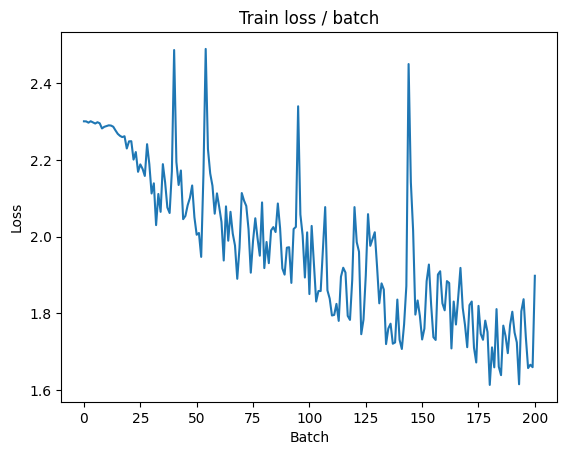


===============> Total time 17s	Avg loss 1.8104	Avg Prec@1 33.90 %	Avg Prec@5 83.67 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 1.4275 (1.4275)	Prec@1  53.1 ( 53.1)	Prec@5  94.5 ( 94.5)

===============> Total time 2s	Avg loss 1.4603	Avg Prec@1 47.32 %	Avg Prec@5 92.39 %



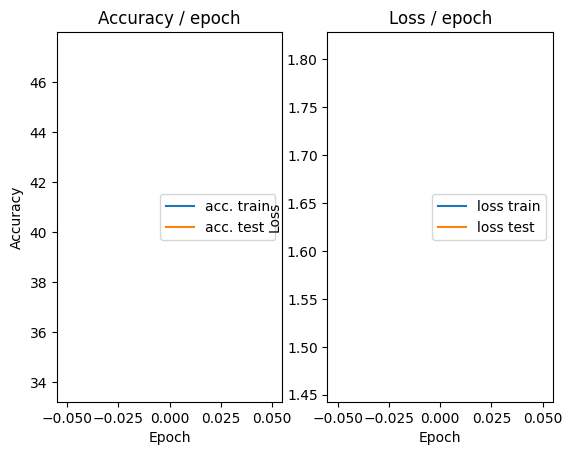

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.190s (0.190s)	Loss 1.4461 (1.4461)	Prec@1  48.4 ( 48.4)	Prec@5  92.2 ( 92.2)


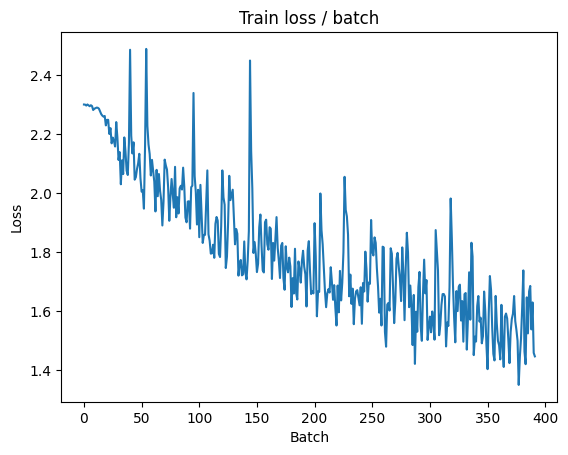

[TRAIN Batch 200/391]	Time 0.058s (0.046s)	Loss 1.4470 (1.4686)	Prec@1  45.3 ( 47.2)	Prec@5  92.2 ( 92.2)


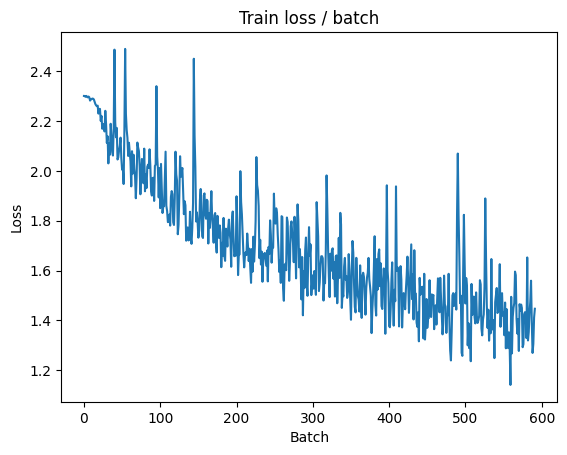


===============> Total time 16s	Avg loss 1.4080	Avg Prec@1 49.54 %	Avg Prec@5 92.93 %

[EVAL Batch 000/079]	Time 0.143s (0.143s)	Loss 1.2320 (1.2320)	Prec@1  54.7 ( 54.7)	Prec@5  94.5 ( 94.5)

===============> Total time 2s	Avg loss 1.2569	Avg Prec@1 54.64 %	Avg Prec@5 94.47 %



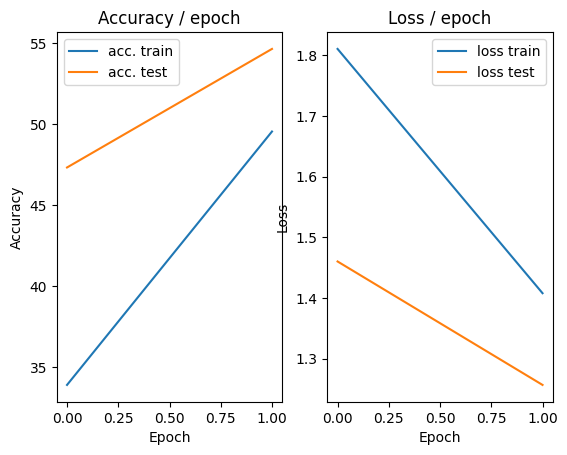

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.288s (0.288s)	Loss 1.3264 (1.3264)	Prec@1  53.1 ( 53.1)	Prec@5  94.5 ( 94.5)


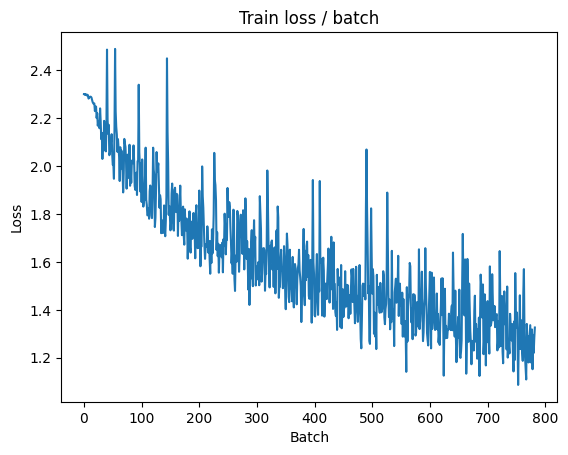

[TRAIN Batch 200/391]	Time 0.057s (0.042s)	Loss 1.0281 (1.2319)	Prec@1  68.8 ( 56.3)	Prec@5  97.7 ( 94.9)


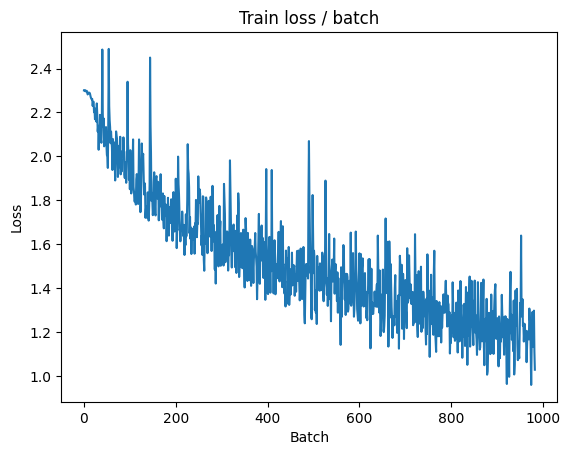


===============> Total time 16s	Avg loss 1.1975	Avg Prec@1 57.67 %	Avg Prec@5 95.18 %

[EVAL Batch 000/079]	Time 0.144s (0.144s)	Loss 1.1280 (1.1280)	Prec@1  62.5 ( 62.5)	Prec@5  94.5 ( 94.5)

===============> Total time 2s	Avg loss 1.1025	Avg Prec@1 61.34 %	Avg Prec@5 96.23 %



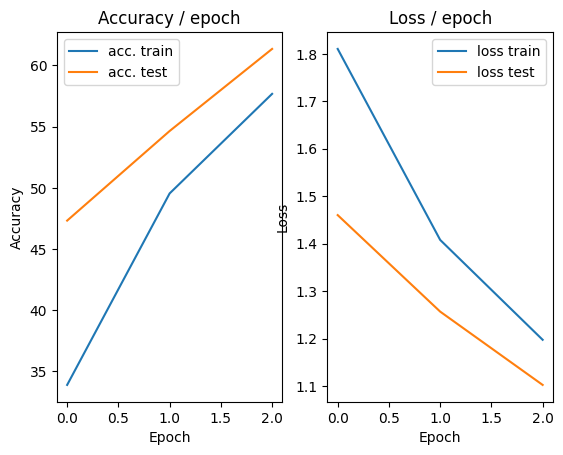

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.192s (0.192s)	Loss 1.1702 (1.1702)	Prec@1  55.5 ( 55.5)	Prec@5  97.7 ( 97.7)


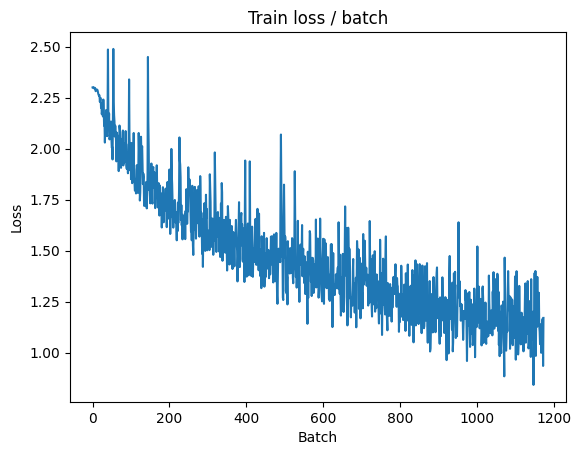

[TRAIN Batch 200/391]	Time 0.010s (0.045s)	Loss 0.8683 (1.0663)	Prec@1  67.2 ( 62.8)	Prec@5  97.7 ( 96.2)


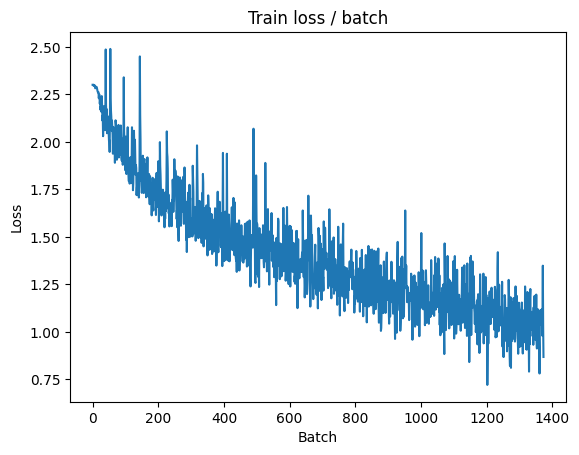


===============> Total time 16s	Avg loss 1.0351	Avg Prec@1 63.97 %	Avg Prec@5 96.44 %

[EVAL Batch 000/079]	Time 0.173s (0.173s)	Loss 1.1457 (1.1457)	Prec@1  62.5 ( 62.5)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 1.0645	Avg Prec@1 63.16 %	Avg Prec@5 96.42 %



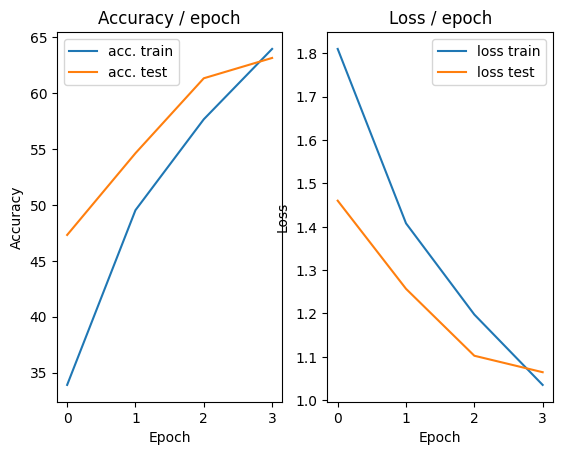

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.196s (0.196s)	Loss 1.0332 (1.0332)	Prec@1  62.5 ( 62.5)	Prec@5  98.4 ( 98.4)


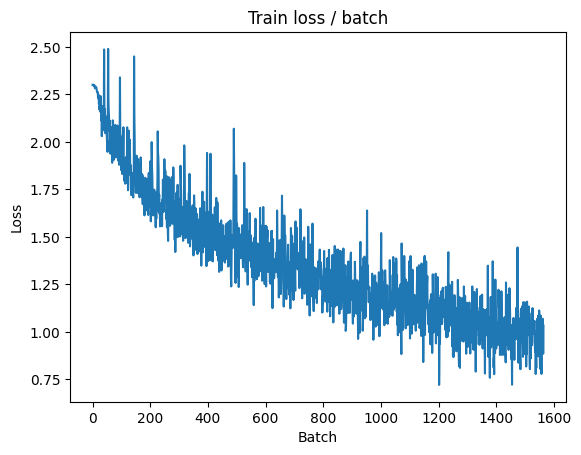

[TRAIN Batch 200/391]	Time 0.012s (0.043s)	Loss 1.0068 (0.9400)	Prec@1  59.4 ( 67.1)	Prec@5  96.9 ( 97.1)


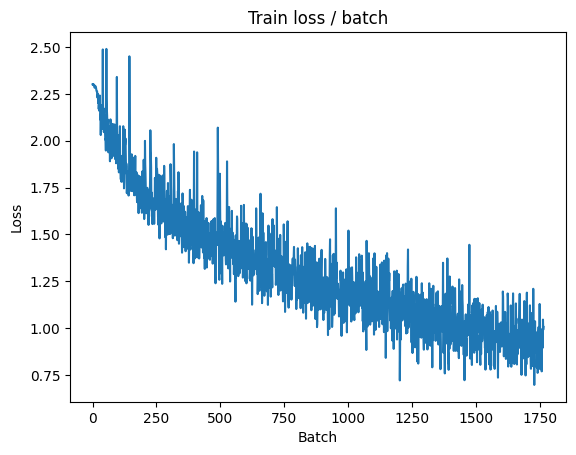


===============> Total time 17s	Avg loss 0.9188	Avg Prec@1 68.06 %	Avg Prec@5 97.21 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 0.8777 (0.8777)	Prec@1  69.5 ( 69.5)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.8604	Avg Prec@1 69.84 %	Avg Prec@5 97.78 %



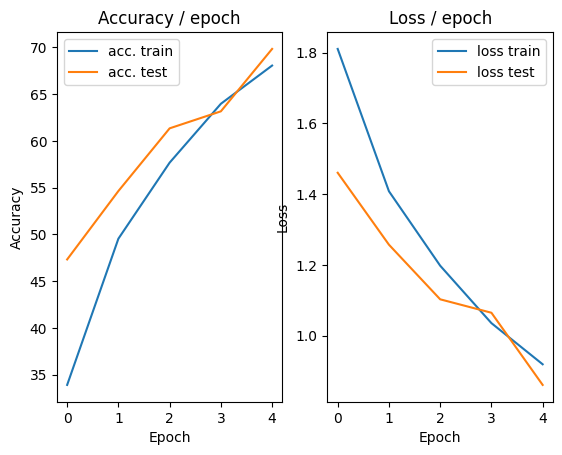

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.206s (0.206s)	Loss 0.8607 (0.8607)	Prec@1  69.5 ( 69.5)	Prec@5  97.7 ( 97.7)


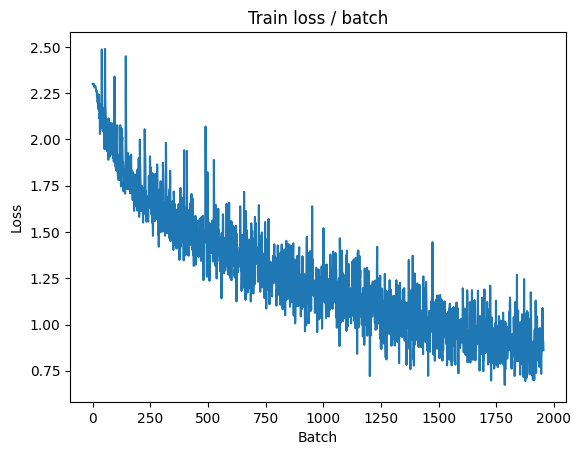

[TRAIN Batch 200/391]	Time 0.073s (0.046s)	Loss 0.8262 (0.8300)	Prec@1  71.9 ( 70.9)	Prec@5  98.4 ( 97.9)


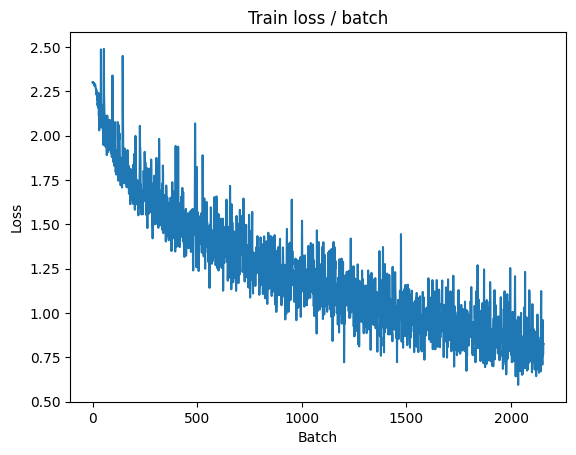


===============> Total time 18s	Avg loss 0.8246	Avg Prec@1 71.22 %	Avg Prec@5 97.74 %

[EVAL Batch 000/079]	Time 0.167s (0.167s)	Loss 0.8417 (0.8417)	Prec@1  71.1 ( 71.1)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.8240	Avg Prec@1 71.24 %	Avg Prec@5 97.73 %



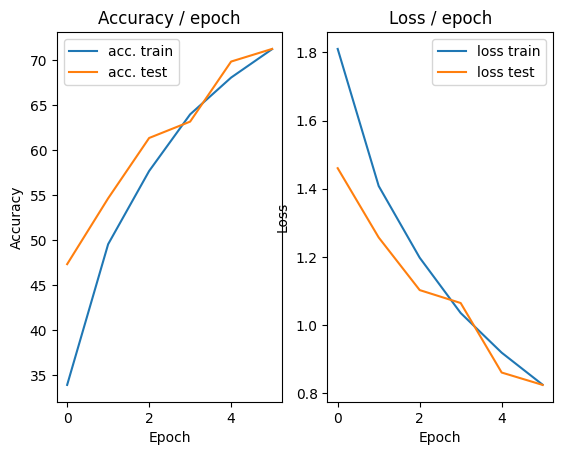

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.190s (0.190s)	Loss 0.7927 (0.7927)	Prec@1  75.0 ( 75.0)	Prec@5  95.3 ( 95.3)


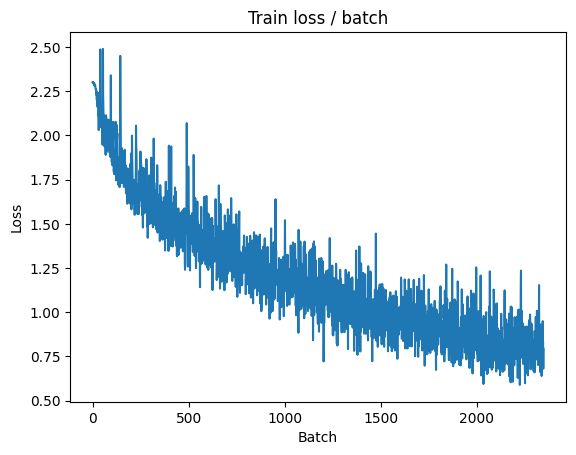

[TRAIN Batch 200/391]	Time 0.066s (0.046s)	Loss 0.8970 (0.7645)	Prec@1  69.5 ( 73.2)	Prec@5  96.1 ( 98.0)


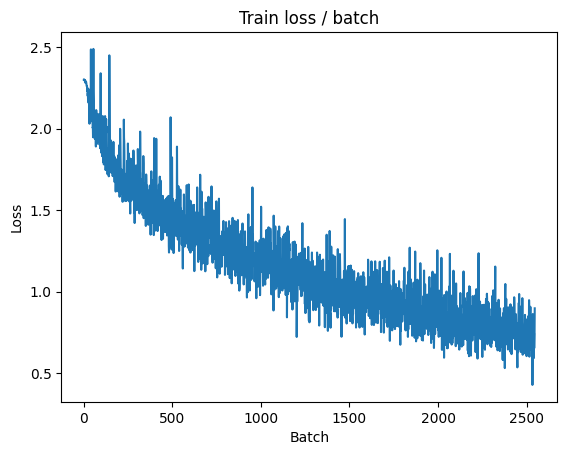


===============> Total time 16s	Avg loss 0.7576	Avg Prec@1 73.53 %	Avg Prec@5 98.11 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 0.8427 (0.8427)	Prec@1  71.9 ( 71.9)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 0.8087	Avg Prec@1 71.88 %	Avg Prec@5 97.93 %



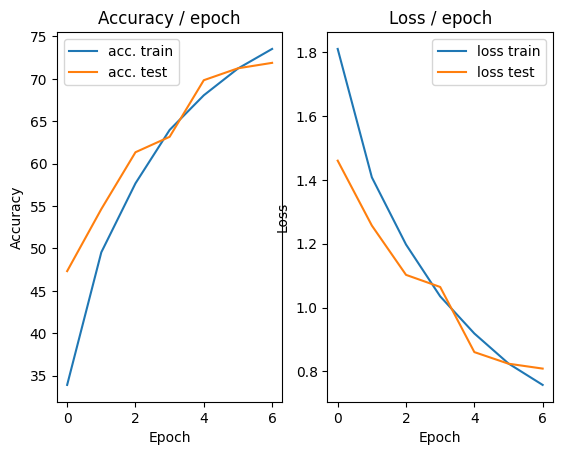

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.235s (0.235s)	Loss 0.9250 (0.9250)	Prec@1  68.8 ( 68.8)	Prec@5  98.4 ( 98.4)


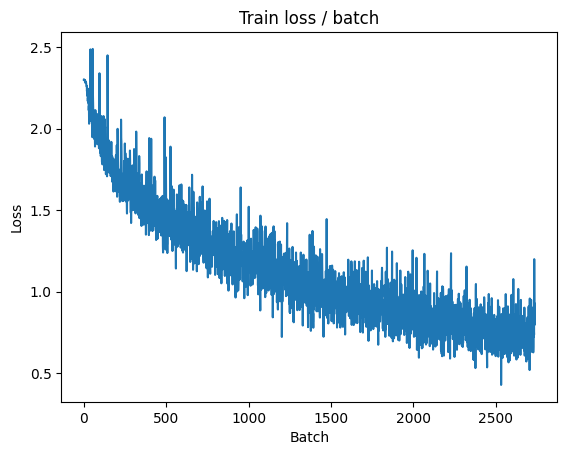

[TRAIN Batch 200/391]	Time 0.061s (0.041s)	Loss 0.6482 (0.7039)	Prec@1  79.7 ( 75.3)	Prec@5 100.0 ( 98.4)


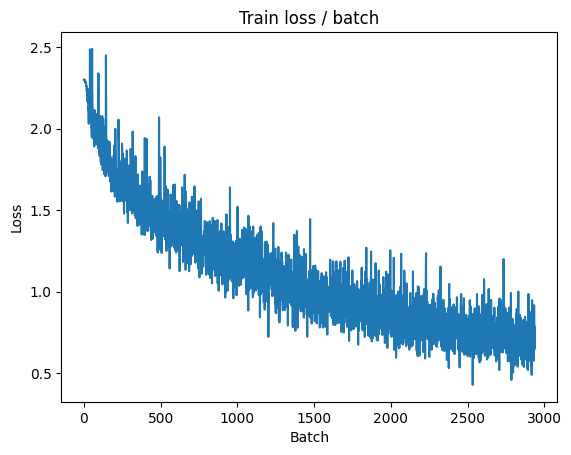


===============> Total time 16s	Avg loss 0.7058	Avg Prec@1 75.34 %	Avg Prec@5 98.43 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 0.7473 (0.7473)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.7668	Avg Prec@1 73.88 %	Avg Prec@5 97.84 %



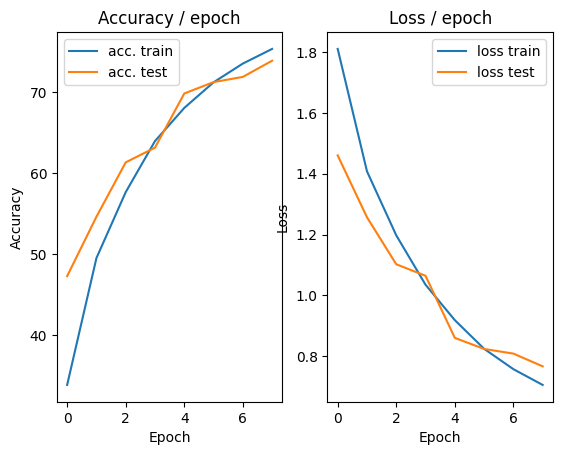

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.228s (0.228s)	Loss 0.5725 (0.5725)	Prec@1  82.8 ( 82.8)	Prec@5  97.7 ( 97.7)


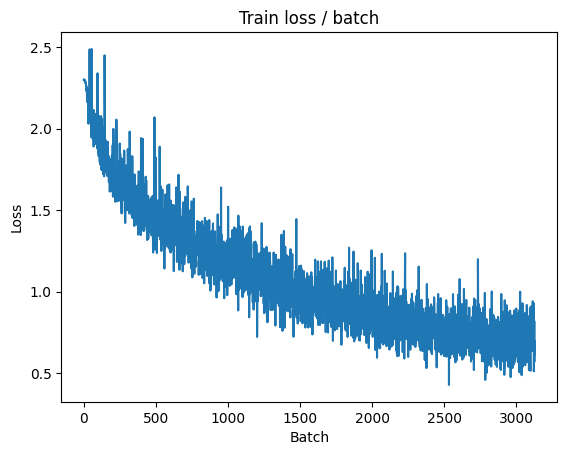

[TRAIN Batch 200/391]	Time 0.015s (0.046s)	Loss 0.7065 (0.6632)	Prec@1  71.9 ( 76.9)	Prec@5 100.0 ( 98.6)


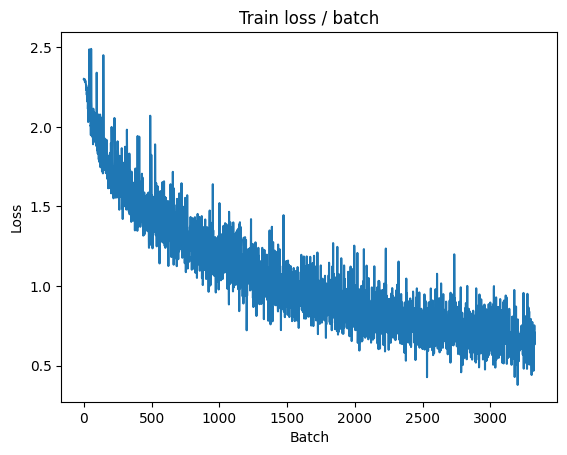


===============> Total time 17s	Avg loss 0.6636	Avg Prec@1 77.14 %	Avg Prec@5 98.61 %

[EVAL Batch 000/079]	Time 0.185s (0.185s)	Loss 0.6256 (0.6256)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6753	Avg Prec@1 77.36 %	Avg Prec@5 98.39 %



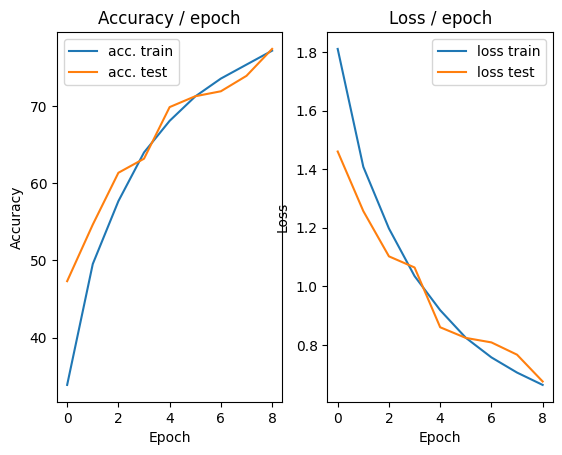

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.191s (0.191s)	Loss 0.5215 (0.5215)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)


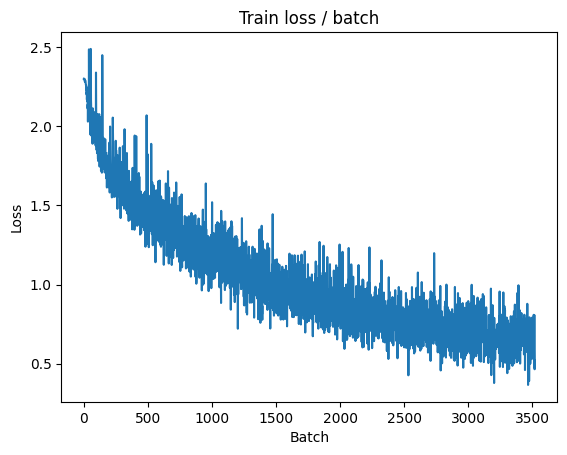

[TRAIN Batch 200/391]	Time 0.029s (0.043s)	Loss 0.6471 (0.6207)	Prec@1  77.3 ( 78.2)	Prec@5  97.7 ( 98.8)


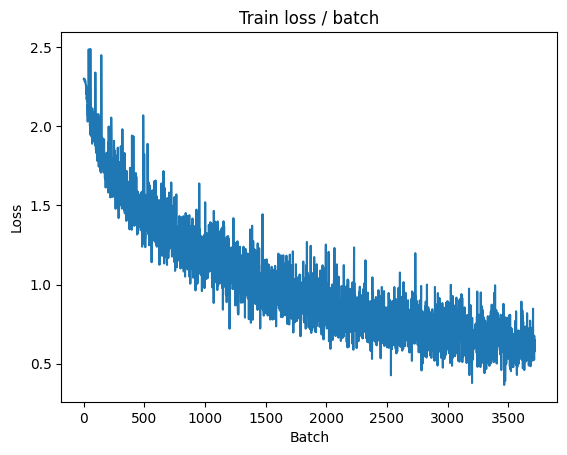


===============> Total time 16s	Avg loss 0.6193	Avg Prec@1 78.27 %	Avg Prec@5 98.79 %

[EVAL Batch 000/079]	Time 0.156s (0.156s)	Loss 0.6441 (0.6441)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6698	Avg Prec@1 76.93 %	Avg Prec@5 98.55 %



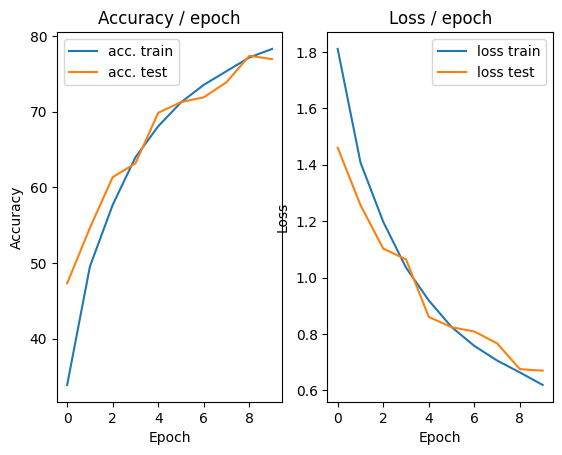

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.201s (0.201s)	Loss 0.4679 (0.4679)	Prec@1  82.0 ( 82.0)	Prec@5 100.0 (100.0)


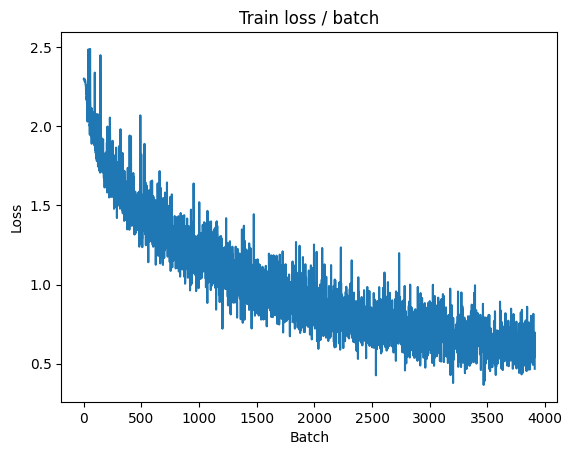

[TRAIN Batch 200/391]	Time 0.078s (0.047s)	Loss 0.5941 (0.5764)	Prec@1  79.7 ( 80.0)	Prec@5  99.2 ( 99.0)


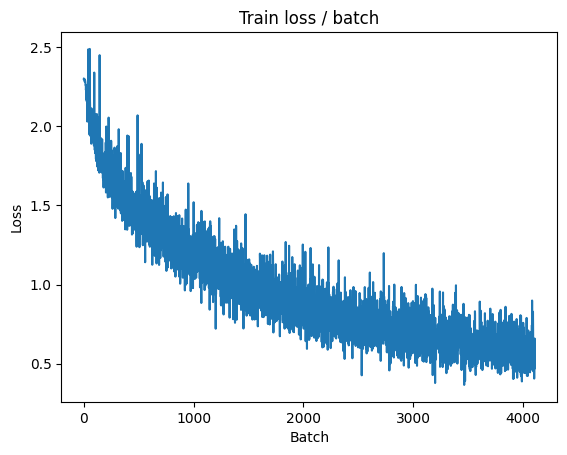


===============> Total time 17s	Avg loss 0.5804	Avg Prec@1 79.86 %	Avg Prec@5 98.96 %

[EVAL Batch 000/079]	Time 0.156s (0.156s)	Loss 0.7153 (0.7153)	Prec@1  75.8 ( 75.8)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7426	Avg Prec@1 74.18 %	Avg Prec@5 98.16 %



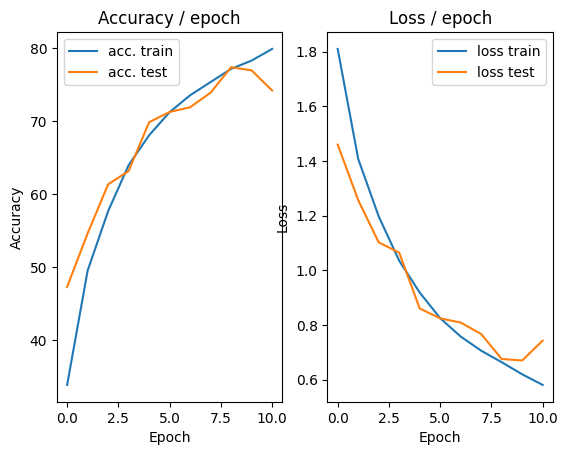

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.203s (0.203s)	Loss 0.6624 (0.6624)	Prec@1  70.3 ( 70.3)	Prec@5  98.4 ( 98.4)


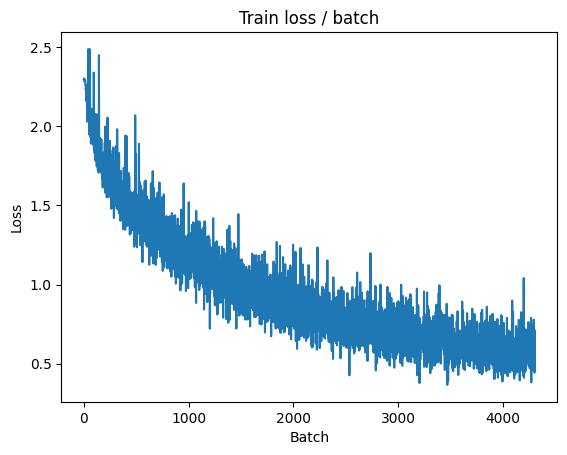

[TRAIN Batch 200/391]	Time 0.012s (0.046s)	Loss 0.4666 (0.5450)	Prec@1  83.6 ( 80.8)	Prec@5  99.2 ( 99.2)


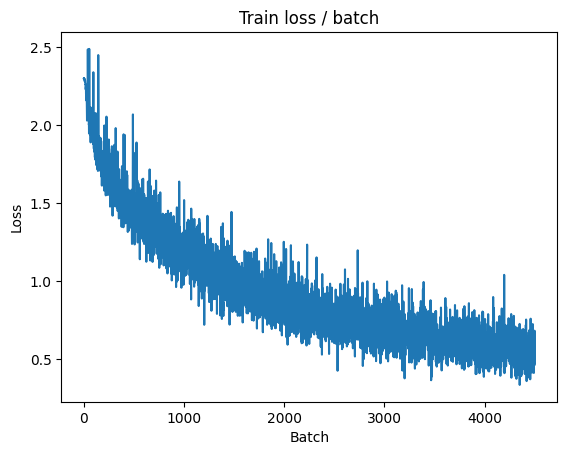


===============> Total time 16s	Avg loss 0.5468	Avg Prec@1 80.92 %	Avg Prec@5 99.14 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 0.5889 (0.5889)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6731	Avg Prec@1 77.28 %	Avg Prec@5 98.58 %



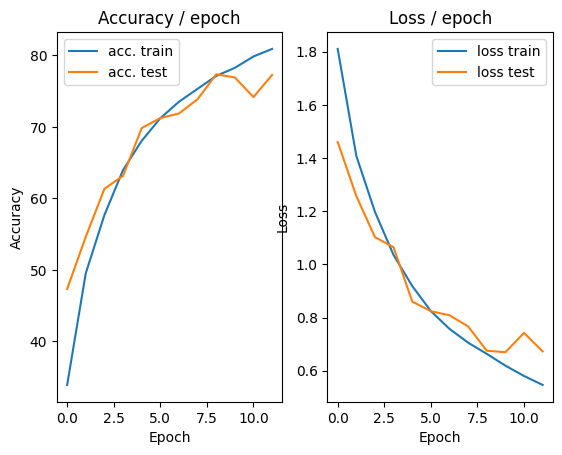

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.203s (0.203s)	Loss 0.4650 (0.4650)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)


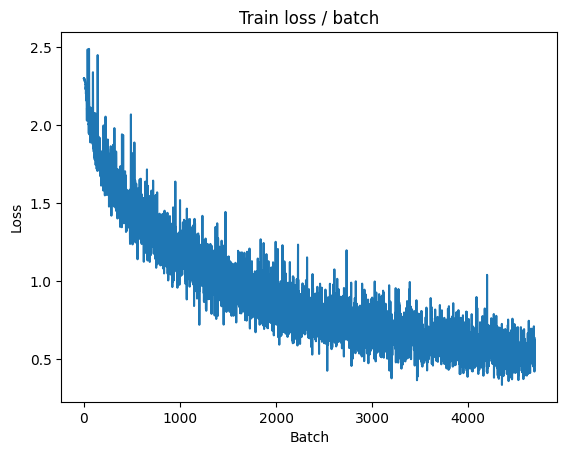

[TRAIN Batch 200/391]	Time 0.055s (0.041s)	Loss 0.4530 (0.5152)	Prec@1  85.2 ( 82.2)	Prec@5 100.0 ( 99.3)


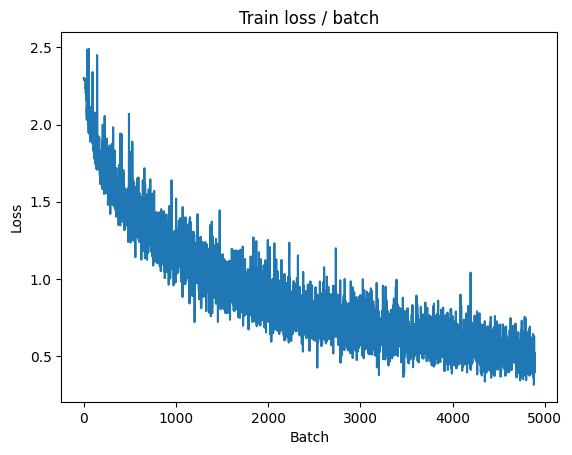


===============> Total time 16s	Avg loss 0.5185	Avg Prec@1 81.97 %	Avg Prec@5 99.21 %

[EVAL Batch 000/079]	Time 0.156s (0.156s)	Loss 0.6579 (0.6579)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6949	Avg Prec@1 76.90 %	Avg Prec@5 98.47 %



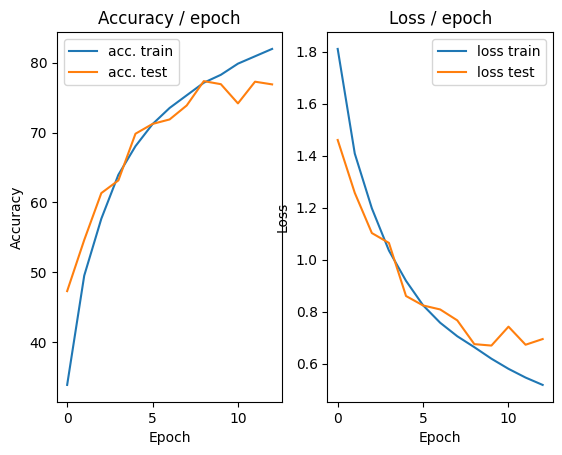

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.212s (0.212s)	Loss 0.4938 (0.4938)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)


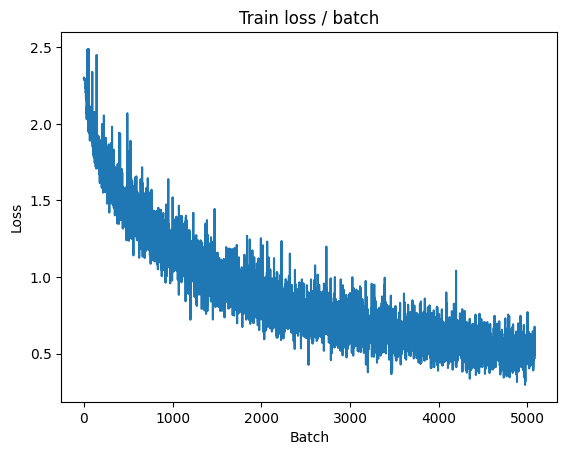

[TRAIN Batch 200/391]	Time 0.008s (0.046s)	Loss 0.5133 (0.4964)	Prec@1  78.1 ( 82.5)	Prec@5  99.2 ( 99.3)


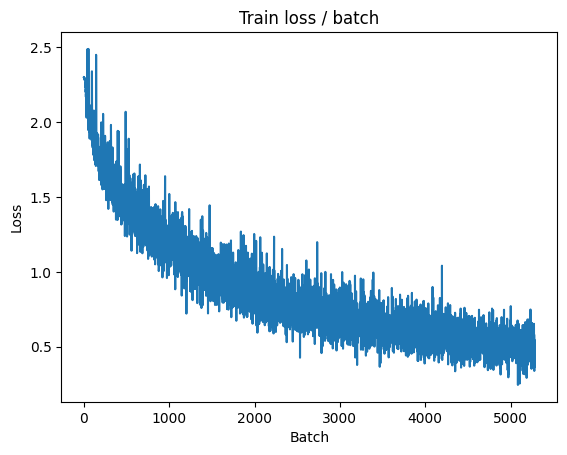


===============> Total time 17s	Avg loss 0.4944	Avg Prec@1 82.73 %	Avg Prec@5 99.30 %

[EVAL Batch 000/079]	Time 0.192s (0.192s)	Loss 0.6276 (0.6276)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6345	Avg Prec@1 79.45 %	Avg Prec@5 98.52 %



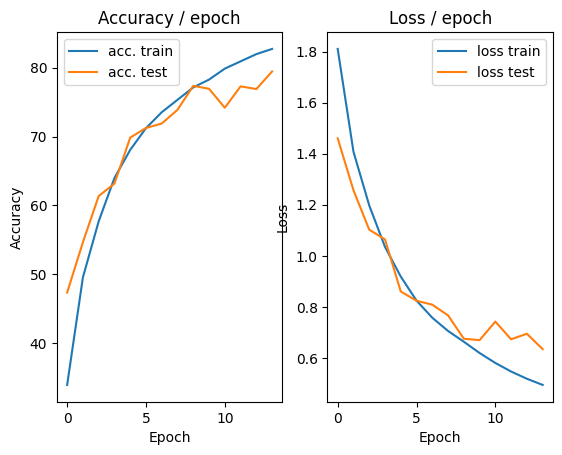

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.215s (0.215s)	Loss 0.3708 (0.3708)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)


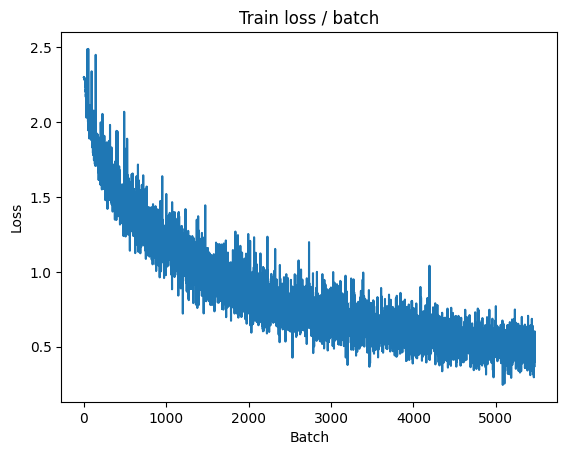

[TRAIN Batch 200/391]	Time 0.080s (0.045s)	Loss 0.5231 (0.4523)	Prec@1  84.4 ( 84.3)	Prec@5  99.2 ( 99.5)


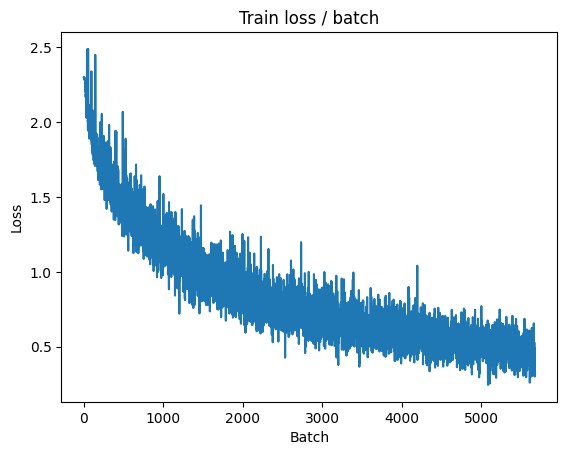


===============> Total time 17s	Avg loss 0.4699	Avg Prec@1 83.71 %	Avg Prec@5 99.38 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 0.6132 (0.6132)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.6138	Avg Prec@1 79.74 %	Avg Prec@5 98.66 %



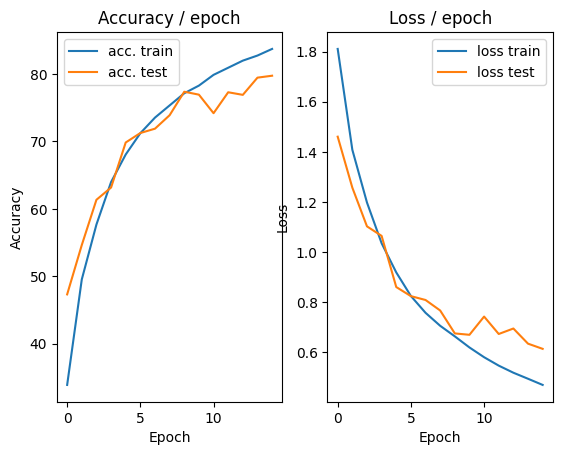

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.379s (0.379s)	Loss 0.4042 (0.4042)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)


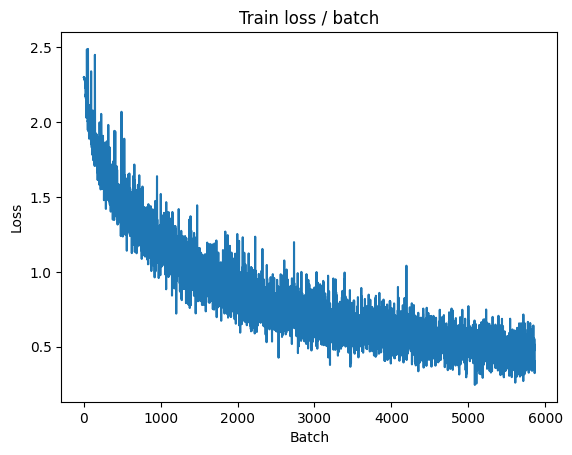

[TRAIN Batch 200/391]	Time 0.056s (0.046s)	Loss 0.5622 (0.4385)	Prec@1  79.7 ( 84.7)	Prec@5  99.2 ( 99.5)


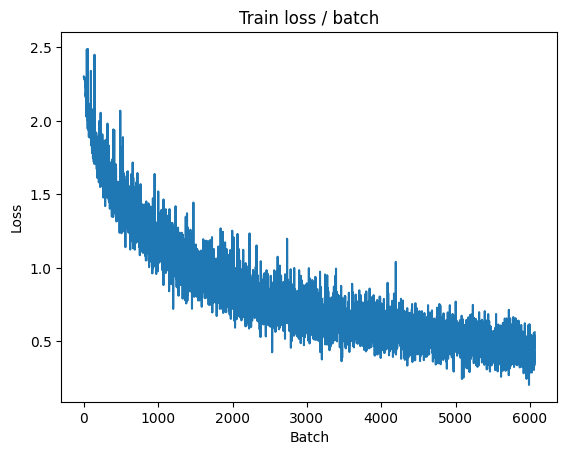


===============> Total time 17s	Avg loss 0.4474	Avg Prec@1 84.43 %	Avg Prec@5 99.48 %

[EVAL Batch 000/079]	Time 0.161s (0.161s)	Loss 0.6681 (0.6681)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6933	Avg Prec@1 77.70 %	Avg Prec@5 98.53 %



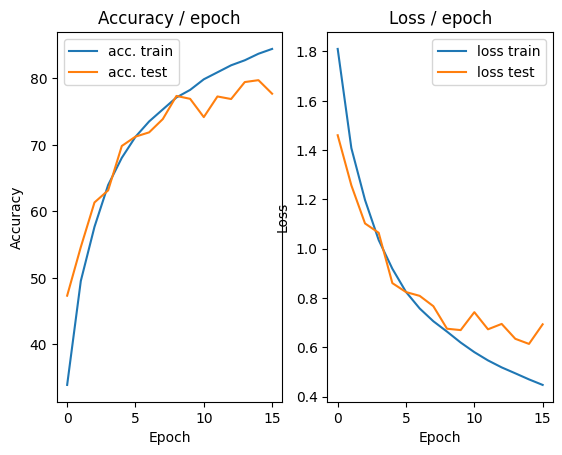

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.222s (0.222s)	Loss 0.4670 (0.4670)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)


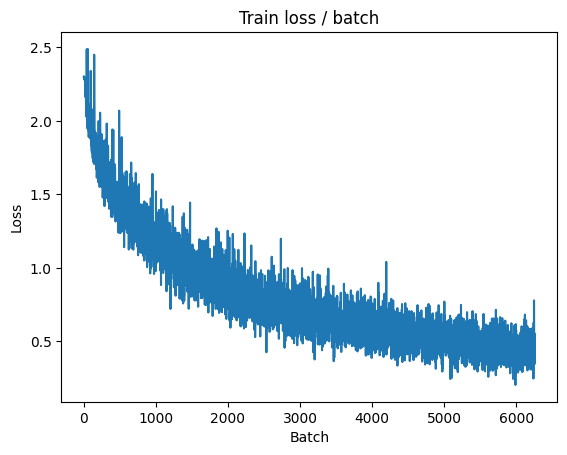

[TRAIN Batch 200/391]	Time 0.013s (0.046s)	Loss 0.4888 (0.4095)	Prec@1  81.2 ( 85.8)	Prec@5  99.2 ( 99.5)


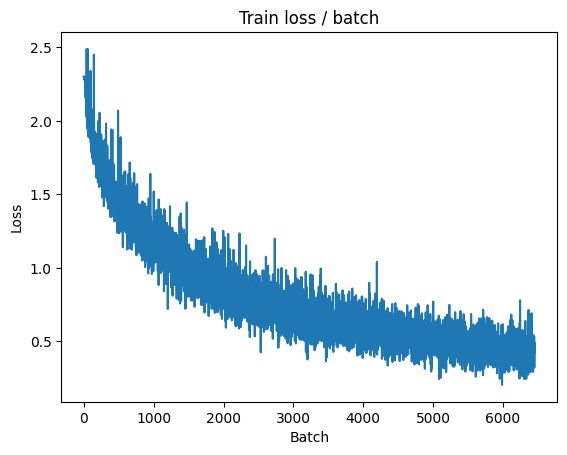


===============> Total time 16s	Avg loss 0.4172	Avg Prec@1 85.52 %	Avg Prec@5 99.50 %

[EVAL Batch 000/079]	Time 0.156s (0.156s)	Loss 0.6218 (0.6218)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6389	Avg Prec@1 78.61 %	Avg Prec@5 98.70 %



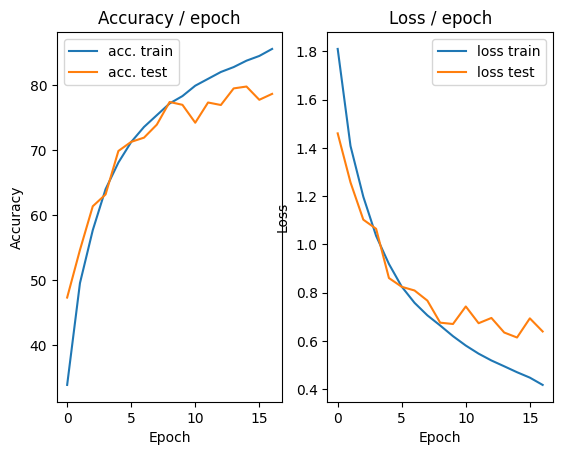

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.226s (0.226s)	Loss 0.6638 (0.6638)	Prec@1  74.2 ( 74.2)	Prec@5 100.0 (100.0)


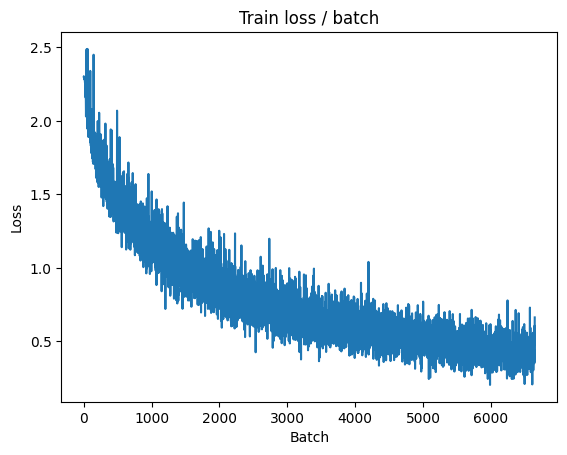

[TRAIN Batch 200/391]	Time 0.012s (0.041s)	Loss 0.3736 (0.3985)	Prec@1  86.7 ( 86.2)	Prec@5  99.2 ( 99.6)


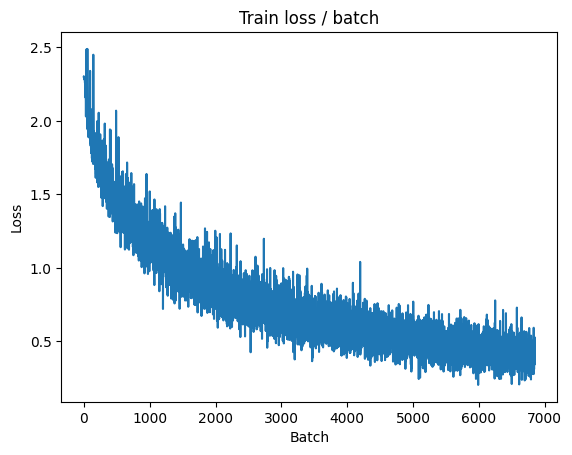


===============> Total time 16s	Avg loss 0.4009	Avg Prec@1 86.03 %	Avg Prec@5 99.59 %

[EVAL Batch 000/079]	Time 0.172s (0.172s)	Loss 0.7122 (0.7122)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.7531	Avg Prec@1 75.84 %	Avg Prec@5 98.33 %



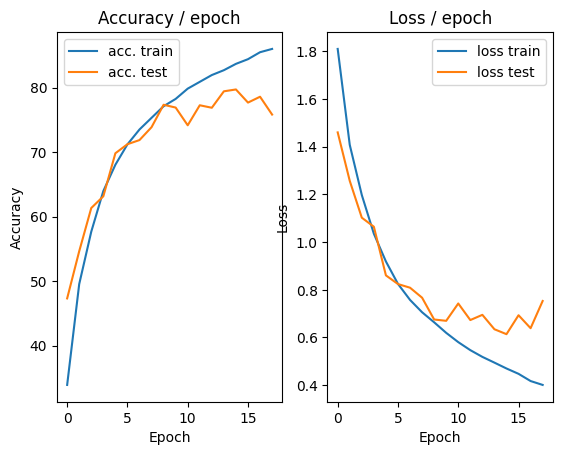

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.208s (0.208s)	Loss 0.5302 (0.5302)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)


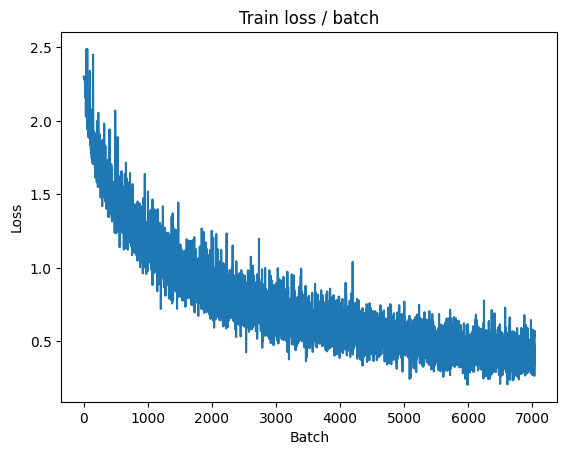

[TRAIN Batch 200/391]	Time 0.055s (0.046s)	Loss 0.4521 (0.3822)	Prec@1  85.2 ( 86.9)	Prec@5  97.7 ( 99.6)


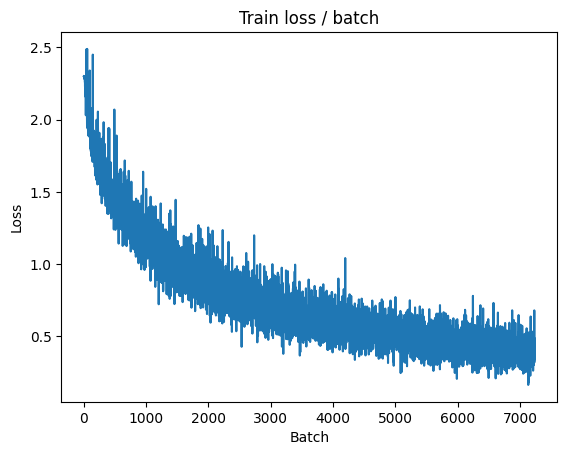


===============> Total time 17s	Avg loss 0.3913	Avg Prec@1 86.46 %	Avg Prec@5 99.59 %

[EVAL Batch 000/079]	Time 0.300s (0.300s)	Loss 0.5185 (0.5185)	Prec@1  87.5 ( 87.5)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6509	Avg Prec@1 79.47 %	Avg Prec@5 98.81 %



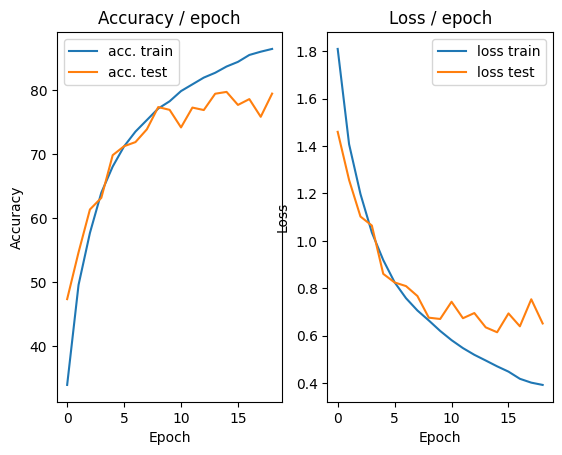

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.235s (0.235s)	Loss 0.5096 (0.5096)	Prec@1  87.5 ( 87.5)	Prec@5  97.7 ( 97.7)


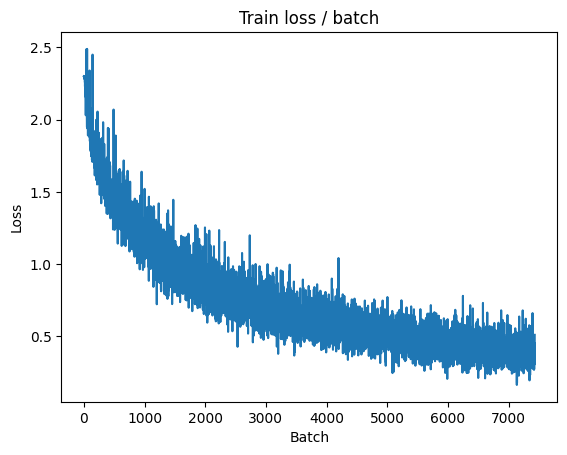

[TRAIN Batch 200/391]	Time 0.131s (0.043s)	Loss 0.3413 (0.3537)	Prec@1  88.3 ( 87.6)	Prec@5 100.0 ( 99.7)


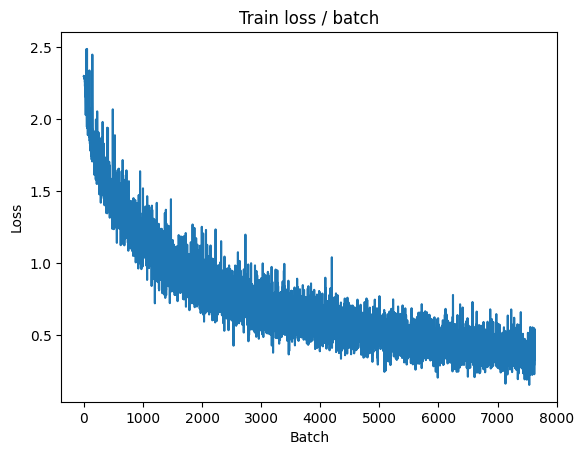


===============> Total time 16s	Avg loss 0.3635	Avg Prec@1 87.38 %	Avg Prec@5 99.65 %

[EVAL Batch 000/079]	Time 0.164s (0.164s)	Loss 0.5653 (0.5653)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6219	Avg Prec@1 80.57 %	Avg Prec@5 98.85 %



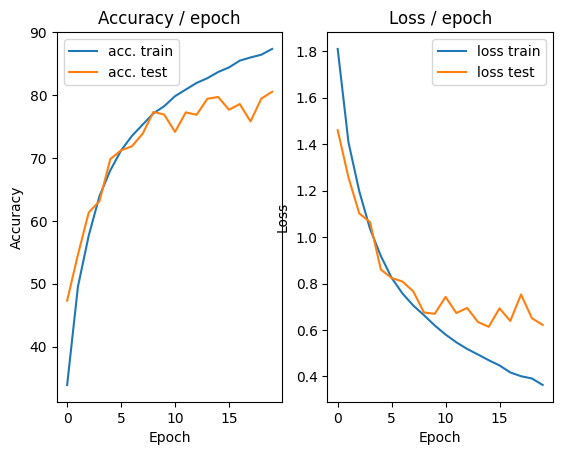

In [37]:
# step lr_sched
main_cifar_optim(batch_size=128, epochs=20, cuda=True, lr_sched='step', get_dataset=get_cifar_dataset_data_increase)

## Dropout

=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.330s (0.330s)	Loss 2.2968 (2.2968)	Prec@1  14.1 ( 14.1)	Prec@5  50.8 ( 50.8)


<Figure size 640x480 with 0 Axes>

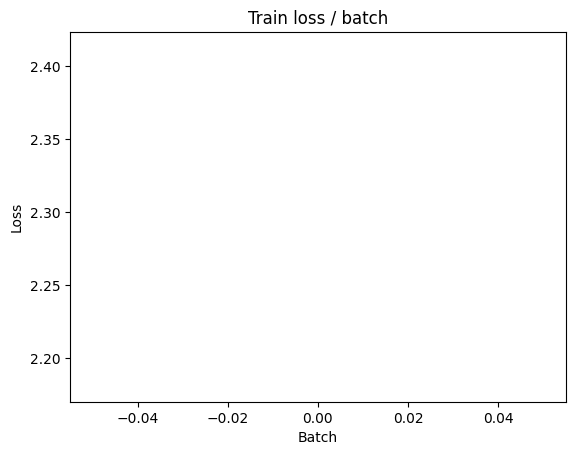

[TRAIN Batch 200/391]	Time 0.063s (0.044s)	Loss 1.7348 (1.9970)	Prec@1  30.5 ( 26.3)	Prec@5  90.6 ( 77.2)


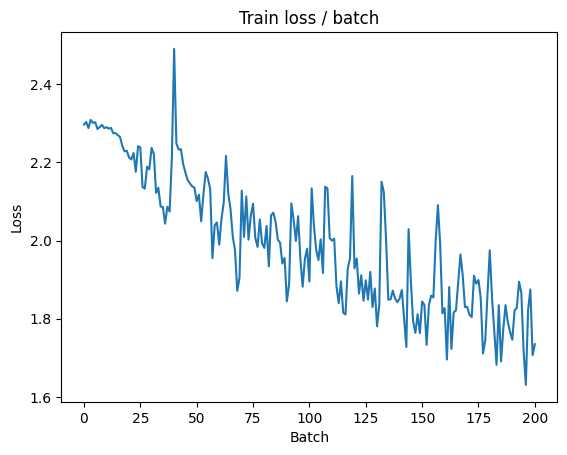


===============> Total time 17s	Avg loss 1.8318	Avg Prec@1 32.98 %	Avg Prec@5 83.02 %

[EVAL Batch 000/079]	Time 0.145s (0.145s)	Loss 1.4609 (1.4609)	Prec@1  56.2 ( 56.2)	Prec@5  91.4 ( 91.4)

===============> Total time 2s	Avg loss 1.4422	Avg Prec@1 49.43 %	Avg Prec@5 92.95 %



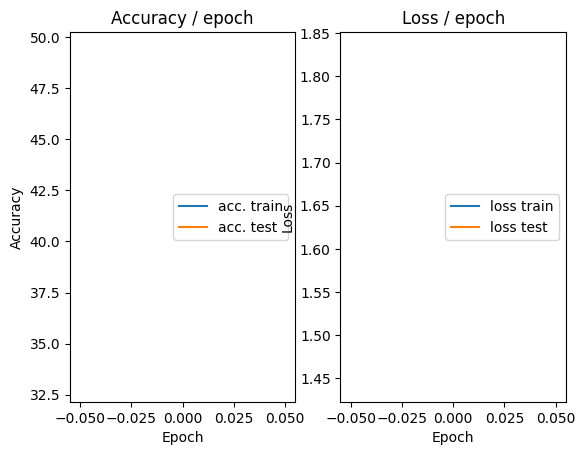

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.197s (0.197s)	Loss 1.6013 (1.6013)	Prec@1  40.6 ( 40.6)	Prec@5  89.8 ( 89.8)


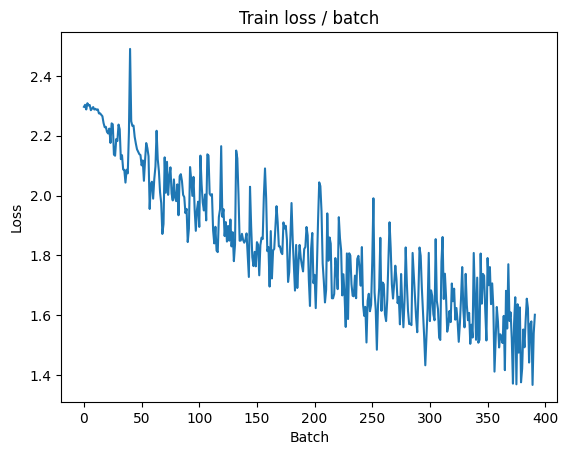

[TRAIN Batch 200/391]	Time 0.011s (0.046s)	Loss 1.5876 (1.4850)	Prec@1  41.4 ( 46.5)	Prec@5  89.1 ( 91.9)


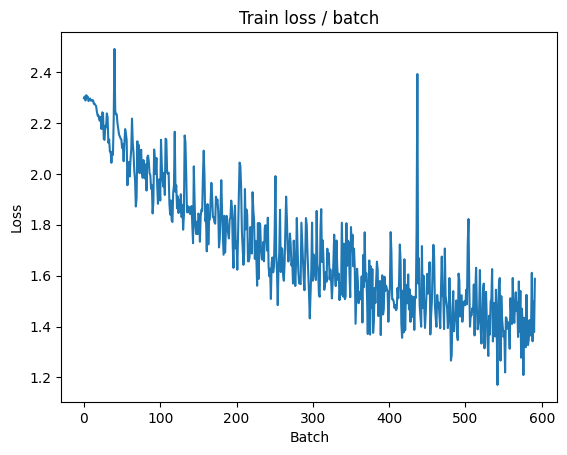


===============> Total time 16s	Avg loss 1.4299	Avg Prec@1 48.68 %	Avg Prec@5 92.63 %

[EVAL Batch 000/079]	Time 0.241s (0.241s)	Loss 1.2049 (1.2049)	Prec@1  62.5 ( 62.5)	Prec@5  96.1 ( 96.1)

===============> Total time 3s	Avg loss 1.2161	Avg Prec@1 56.61 %	Avg Prec@5 94.71 %



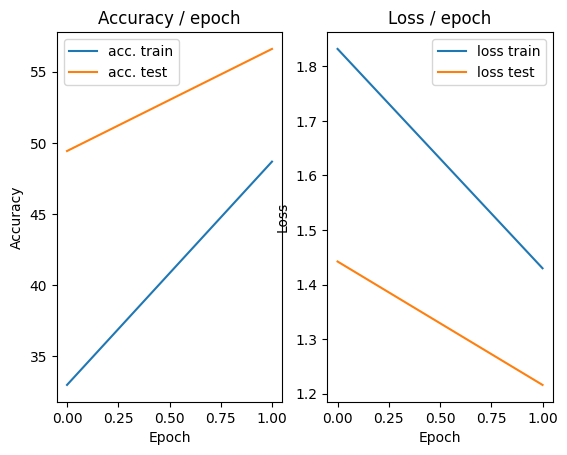

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.197s (0.197s)	Loss 1.1867 (1.1867)	Prec@1  54.7 ( 54.7)	Prec@5  95.3 ( 95.3)


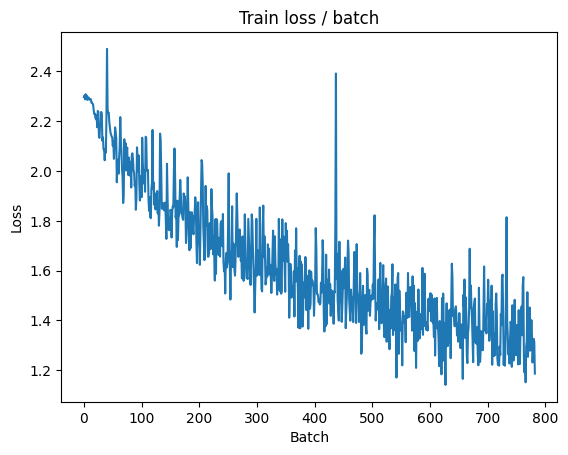

[TRAIN Batch 200/391]	Time 0.012s (0.042s)	Loss 1.3108 (1.2558)	Prec@1  57.0 ( 55.7)	Prec@5  93.8 ( 94.6)


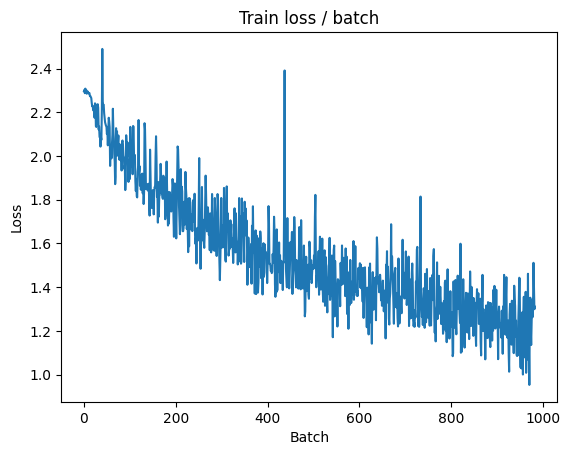


===============> Total time 17s	Avg loss 1.2159	Avg Prec@1 56.99 %	Avg Prec@5 95.00 %

[EVAL Batch 000/079]	Time 0.163s (0.163s)	Loss 1.0893 (1.0893)	Prec@1  58.6 ( 58.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.1067	Avg Prec@1 61.00 %	Avg Prec@5 95.66 %



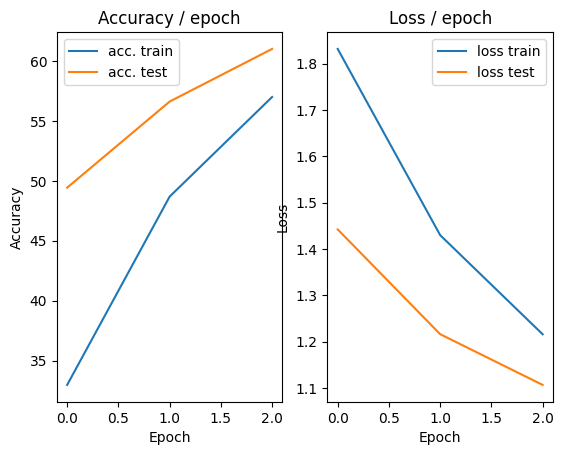

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.203s (0.203s)	Loss 1.1217 (1.1217)	Prec@1  63.3 ( 63.3)	Prec@5  97.7 ( 97.7)


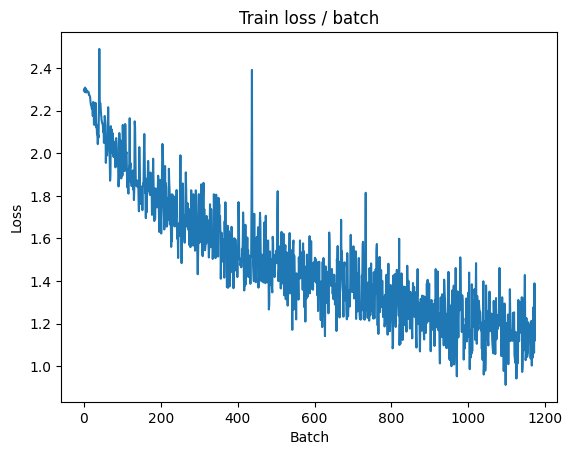

[TRAIN Batch 200/391]	Time 0.072s (0.046s)	Loss 1.0589 (1.0895)	Prec@1  60.9 ( 61.9)	Prec@5  94.5 ( 95.9)


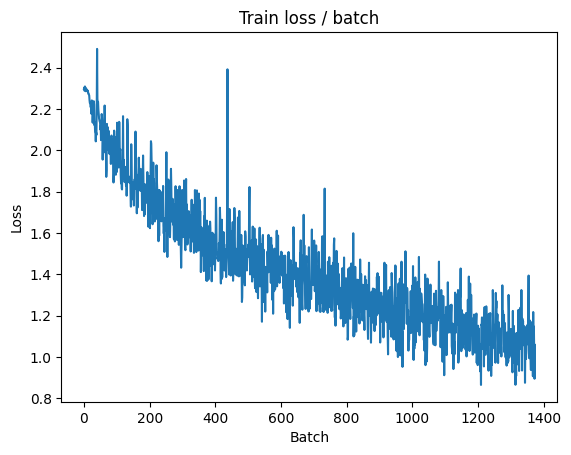


===============> Total time 18s	Avg loss 1.0631	Avg Prec@1 62.71 %	Avg Prec@5 96.22 %

[EVAL Batch 000/079]	Time 0.169s (0.169s)	Loss 0.9778 (0.9778)	Prec@1  69.5 ( 69.5)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.9590	Avg Prec@1 66.31 %	Avg Prec@5 97.12 %



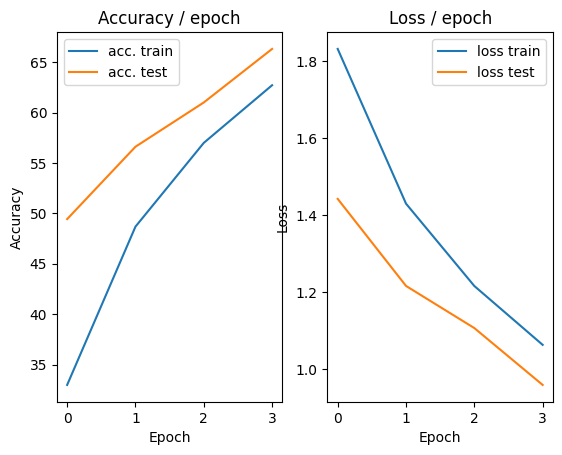

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.187s (0.187s)	Loss 1.0017 (1.0017)	Prec@1  63.3 ( 63.3)	Prec@5  96.9 ( 96.9)


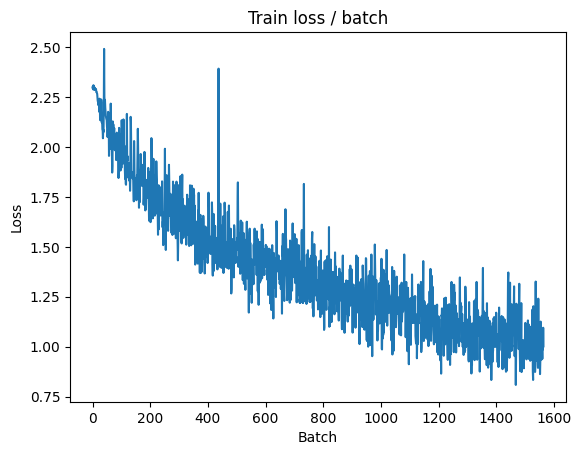

[TRAIN Batch 200/391]	Time 0.059s (0.047s)	Loss 0.8137 (0.9798)	Prec@1  75.8 ( 65.6)	Prec@5  96.9 ( 96.7)


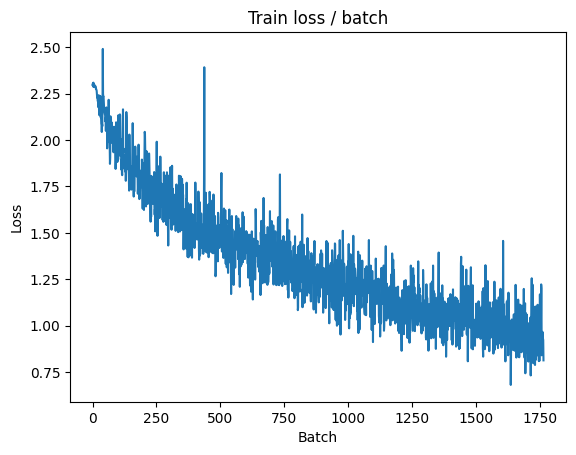


===============> Total time 17s	Avg loss 0.9566	Avg Prec@1 66.63 %	Avg Prec@5 96.98 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 0.7799 (0.7799)	Prec@1  73.4 ( 73.4)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.8454	Avg Prec@1 70.43 %	Avg Prec@5 97.30 %



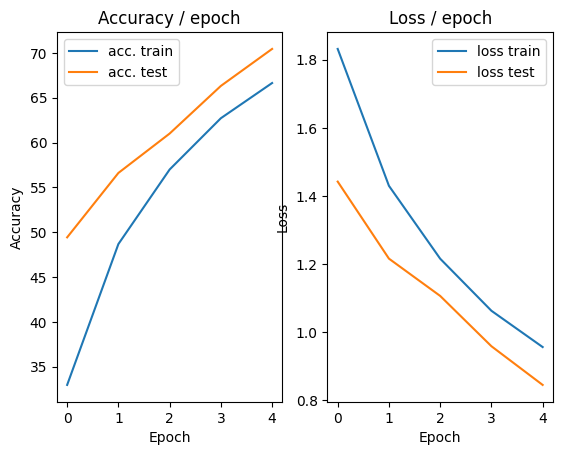

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.269s (0.269s)	Loss 0.9655 (0.9655)	Prec@1  69.5 ( 69.5)	Prec@5  95.3 ( 95.3)


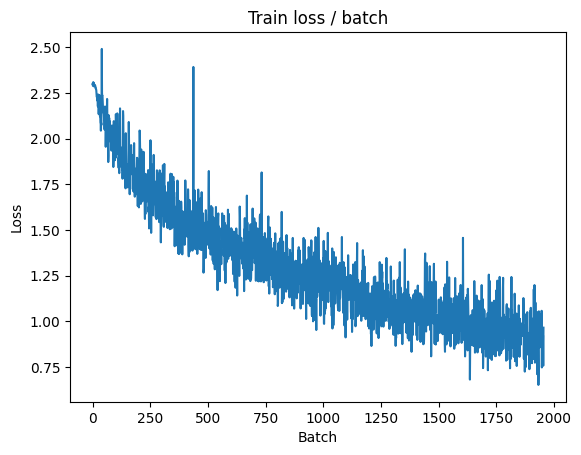

[TRAIN Batch 200/391]	Time 0.060s (0.042s)	Loss 0.9071 (0.8785)	Prec@1  74.2 ( 69.8)	Prec@5  95.3 ( 97.4)


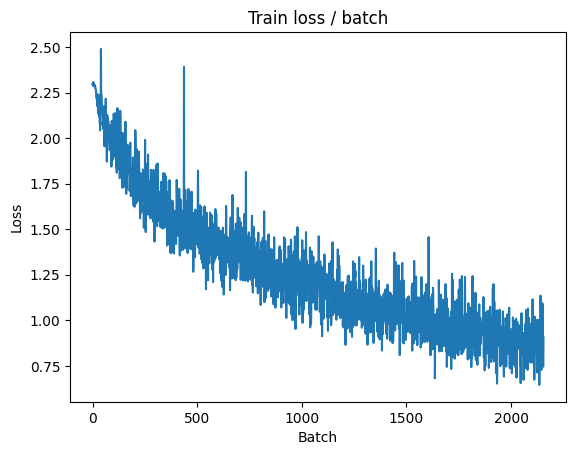


===============> Total time 16s	Avg loss 0.8708	Avg Prec@1 69.86 %	Avg Prec@5 97.55 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 0.8835 (0.8835)	Prec@1  70.3 ( 70.3)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.8661	Avg Prec@1 69.77 %	Avg Prec@5 97.74 %



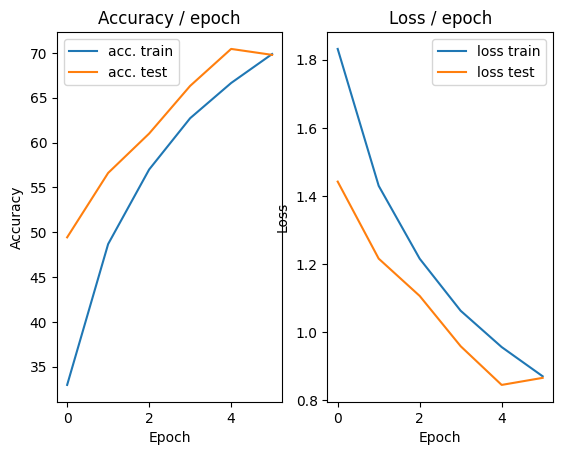

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.196s (0.196s)	Loss 0.8355 (0.8355)	Prec@1  72.7 ( 72.7)	Prec@5  97.7 ( 97.7)


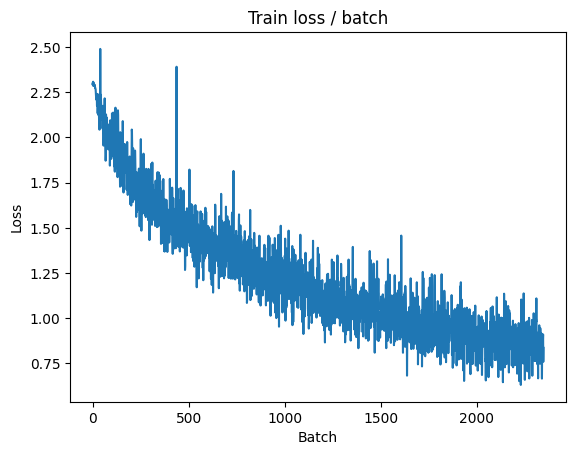

[TRAIN Batch 200/391]	Time 0.012s (0.046s)	Loss 0.7258 (0.8178)	Prec@1  71.9 ( 71.4)	Prec@5  98.4 ( 97.9)


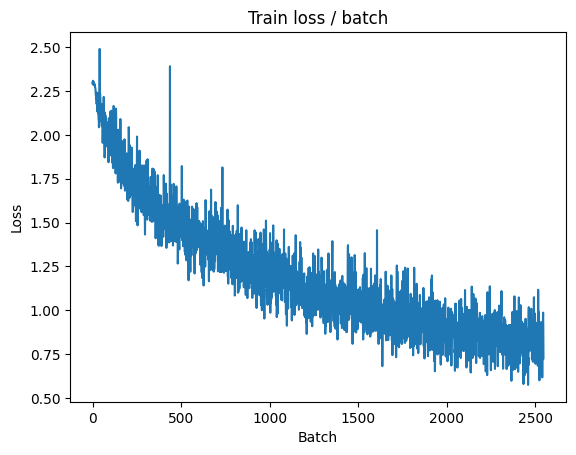


===============> Total time 17s	Avg loss 0.8135	Avg Prec@1 71.47 %	Avg Prec@5 97.84 %

[EVAL Batch 000/079]	Time 0.167s (0.167s)	Loss 0.8166 (0.8166)	Prec@1  71.9 ( 71.9)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.8081	Avg Prec@1 71.77 %	Avg Prec@5 97.75 %



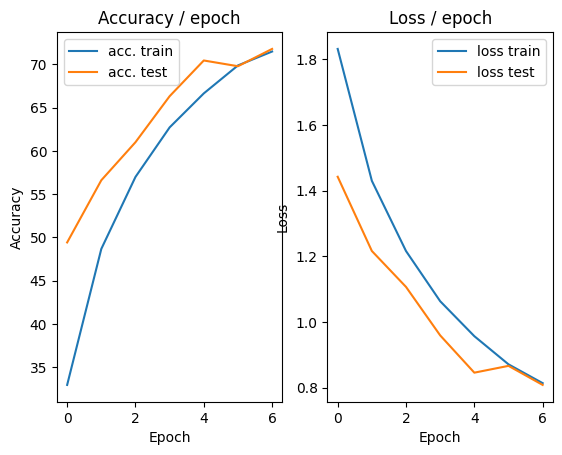

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.193s (0.193s)	Loss 0.8214 (0.8214)	Prec@1  72.7 ( 72.7)	Prec@5  97.7 ( 97.7)


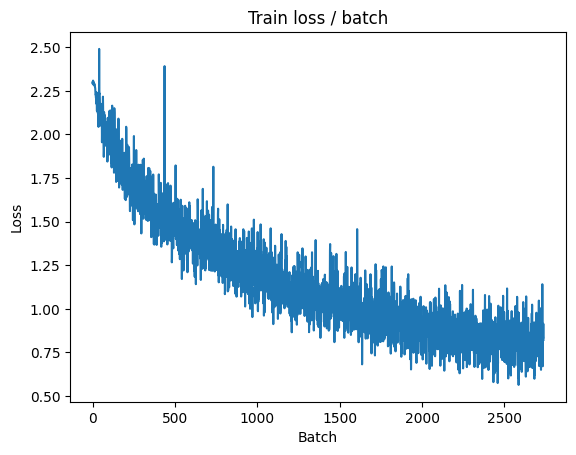

[TRAIN Batch 200/391]	Time 0.021s (0.041s)	Loss 0.8354 (0.7766)	Prec@1  70.3 ( 73.1)	Prec@5  98.4 ( 98.0)


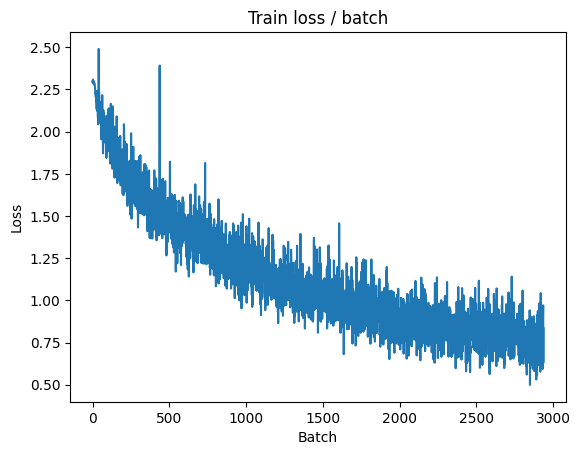


===============> Total time 16s	Avg loss 0.7700	Avg Prec@1 73.18 %	Avg Prec@5 98.05 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 0.7116 (0.7116)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.7297	Avg Prec@1 75.04 %	Avg Prec@5 98.10 %



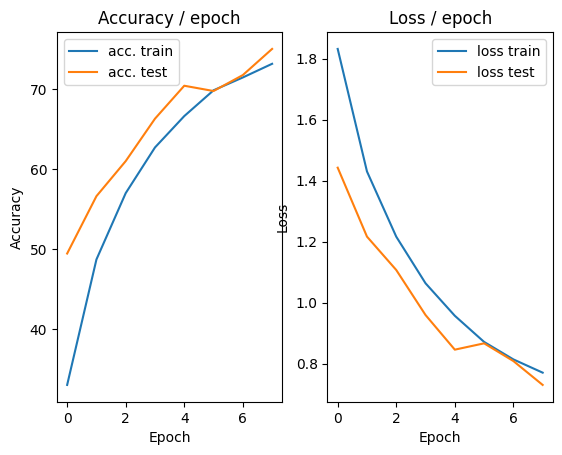

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.192s (0.192s)	Loss 0.7938 (0.7938)	Prec@1  70.3 ( 70.3)	Prec@5  96.9 ( 96.9)


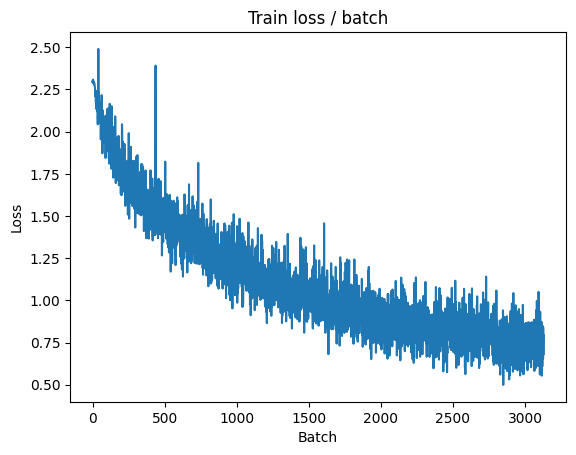

[TRAIN Batch 200/391]	Time 0.064s (0.046s)	Loss 0.7686 (0.7231)	Prec@1  71.1 ( 74.8)	Prec@5  98.4 ( 98.2)


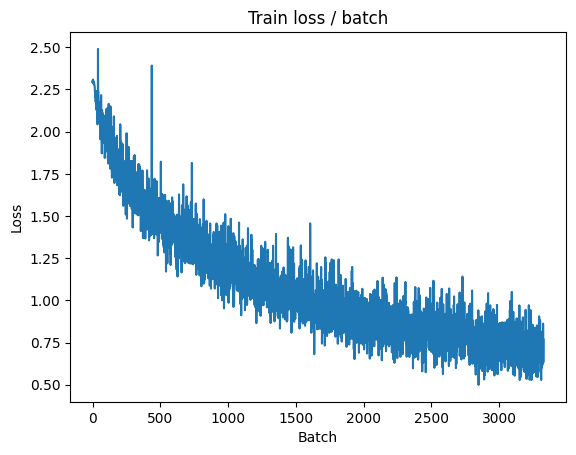


===============> Total time 17s	Avg loss 0.7216	Avg Prec@1 74.88 %	Avg Prec@5 98.26 %

[EVAL Batch 000/079]	Time 0.158s (0.158s)	Loss 0.6119 (0.6119)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6806	Avg Prec@1 76.04 %	Avg Prec@5 98.42 %



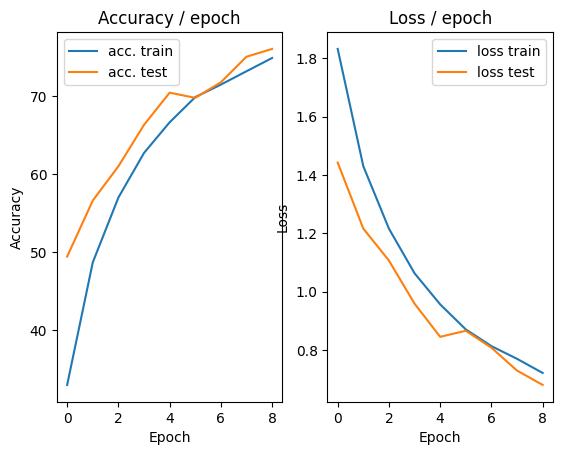

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.199s (0.199s)	Loss 0.7591 (0.7591)	Prec@1  72.7 ( 72.7)	Prec@5  97.7 ( 97.7)


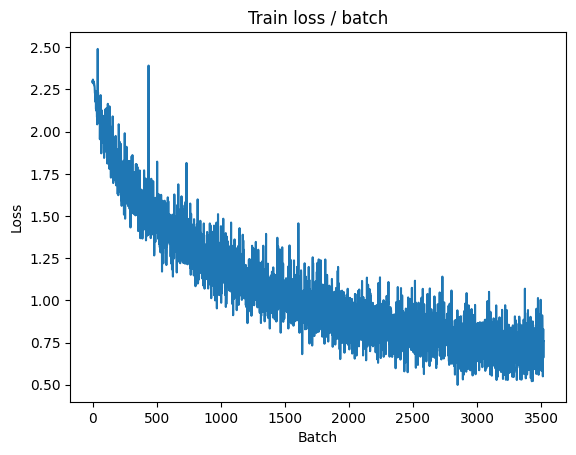

[TRAIN Batch 200/391]	Time 0.046s (0.046s)	Loss 0.7143 (0.6902)	Prec@1  75.0 ( 76.0)	Prec@5  98.4 ( 98.4)


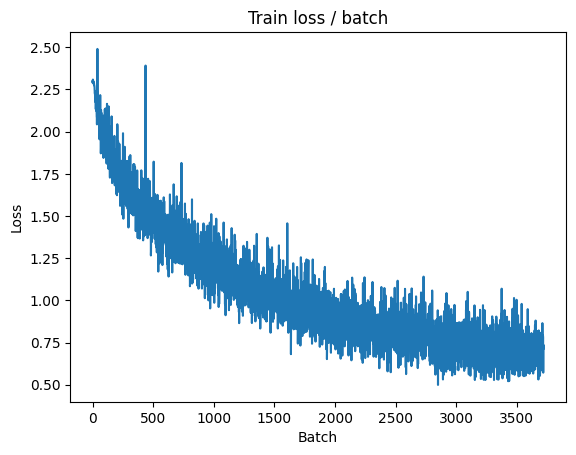


===============> Total time 16s	Avg loss 0.6868	Avg Prec@1 76.19 %	Avg Prec@5 98.41 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 0.5834 (0.5834)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6696	Avg Prec@1 76.57 %	Avg Prec@5 98.43 %



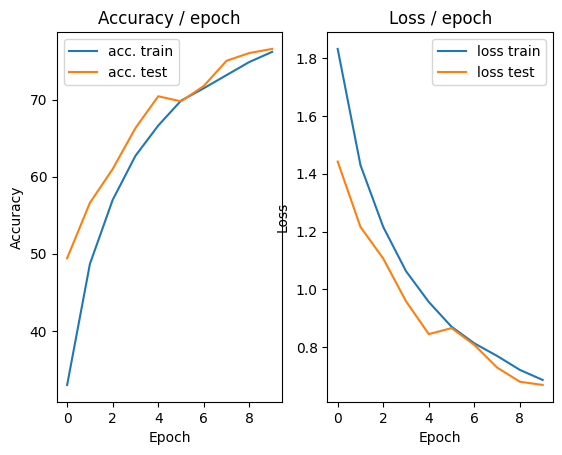

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.262s (0.262s)	Loss 0.7395 (0.7395)	Prec@1  78.1 ( 78.1)	Prec@5  96.1 ( 96.1)


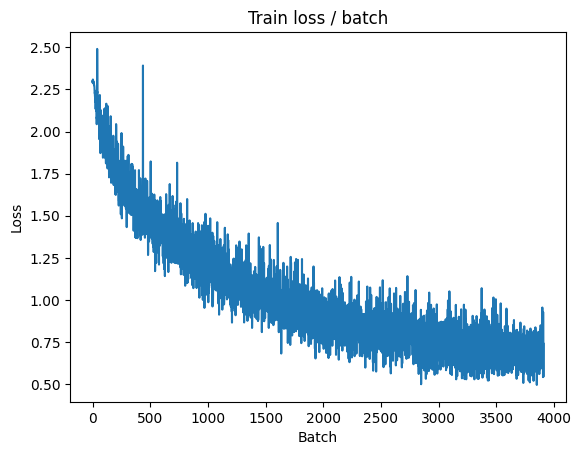

[TRAIN Batch 200/391]	Time 0.014s (0.043s)	Loss 0.6940 (0.6562)	Prec@1  78.9 ( 77.2)	Prec@5 100.0 ( 98.8)


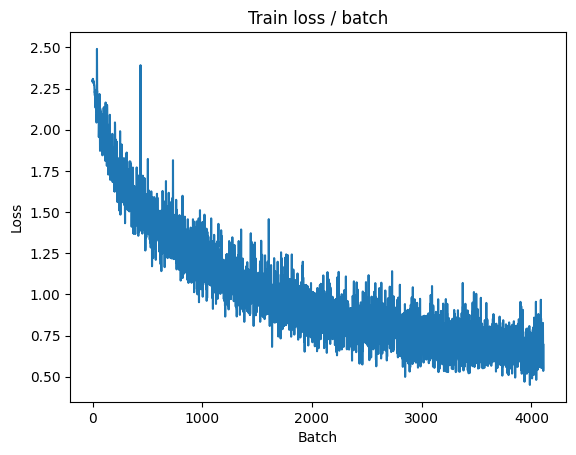


===============> Total time 17s	Avg loss 0.6521	Avg Prec@1 77.28 %	Avg Prec@5 98.70 %

[EVAL Batch 000/079]	Time 0.164s (0.164s)	Loss 0.6485 (0.6485)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7117	Avg Prec@1 75.62 %	Avg Prec@5 98.57 %



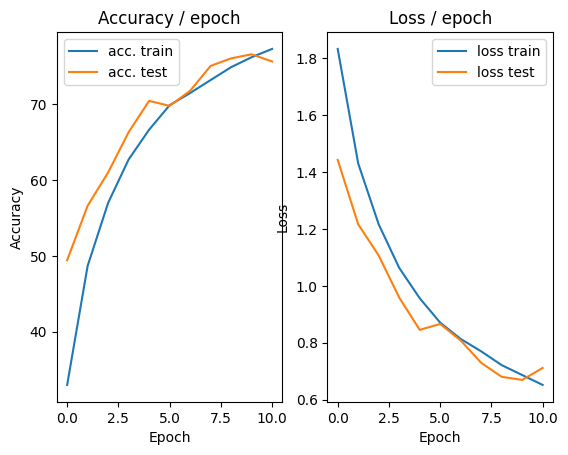

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.205s (0.205s)	Loss 0.6951 (0.6951)	Prec@1  74.2 ( 74.2)	Prec@5  98.4 ( 98.4)


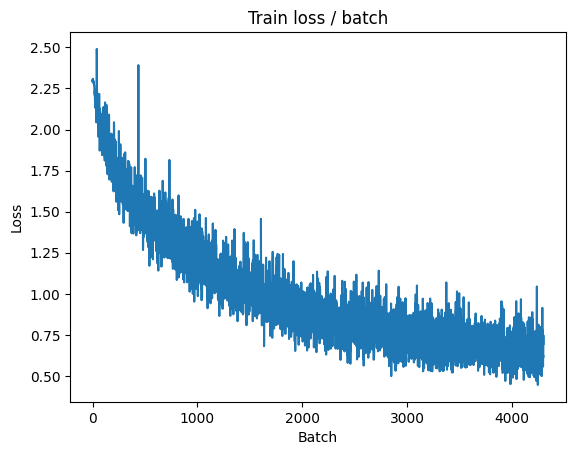

[TRAIN Batch 200/391]	Time 0.013s (0.047s)	Loss 0.5116 (0.6238)	Prec@1  82.8 ( 78.3)	Prec@5  99.2 ( 98.8)


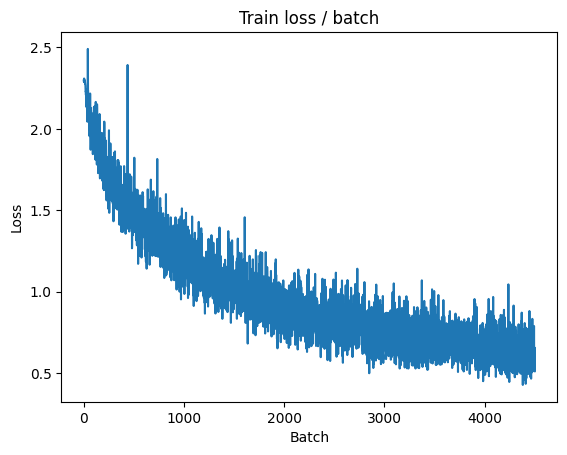


===============> Total time 17s	Avg loss 0.6331	Avg Prec@1 78.02 %	Avg Prec@5 98.75 %

[EVAL Batch 000/079]	Time 0.226s (0.226s)	Loss 0.5813 (0.5813)	Prec@1  82.0 ( 82.0)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6737	Avg Prec@1 76.71 %	Avg Prec@5 98.53 %



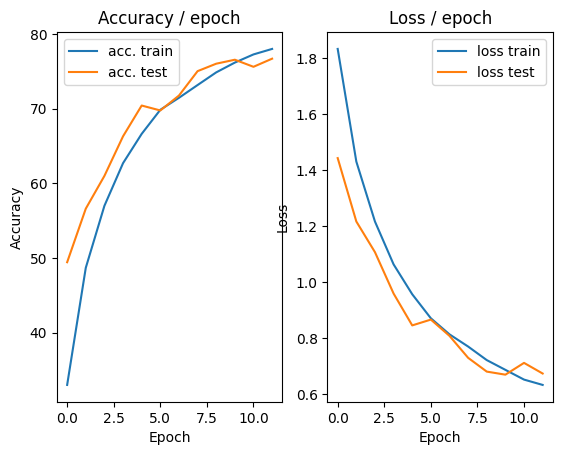

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.204s (0.204s)	Loss 0.6774 (0.6774)	Prec@1  74.2 ( 74.2)	Prec@5  99.2 ( 99.2)


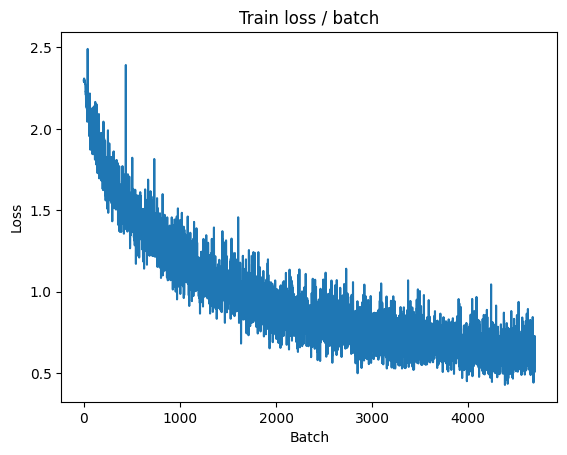

[TRAIN Batch 200/391]	Time 0.095s (0.043s)	Loss 0.5284 (0.5934)	Prec@1  82.8 ( 79.3)	Prec@5 100.0 ( 98.9)


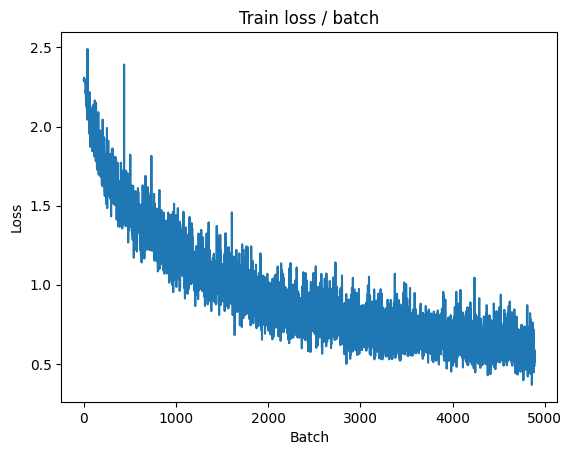


===============> Total time 16s	Avg loss 0.6012	Avg Prec@1 79.20 %	Avg Prec@5 98.80 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 0.5120 (0.5120)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6448	Avg Prec@1 77.77 %	Avg Prec@5 98.49 %



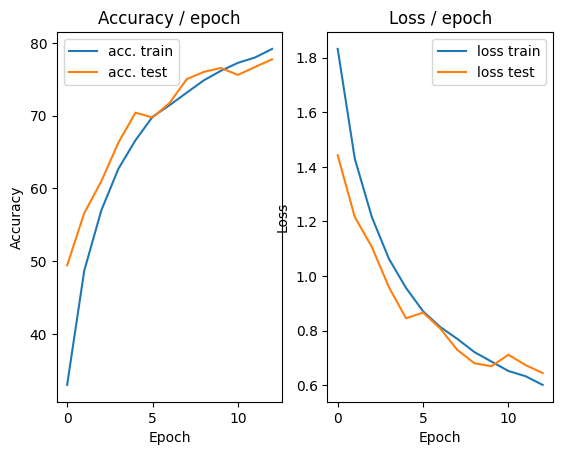

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.210s (0.210s)	Loss 0.6366 (0.6366)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)


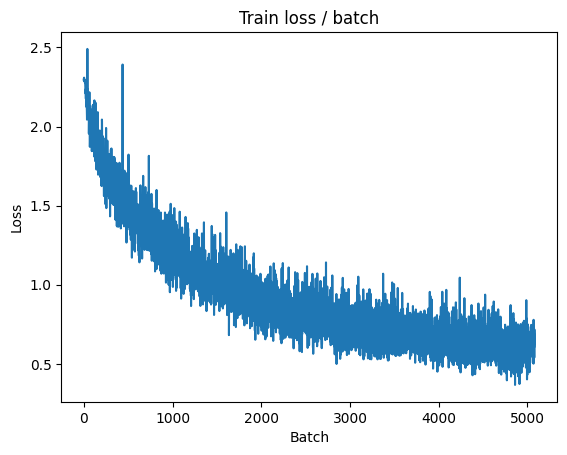

[TRAIN Batch 200/391]	Time 0.054s (0.045s)	Loss 0.7226 (0.5747)	Prec@1  72.7 ( 80.2)	Prec@5  96.1 ( 98.9)


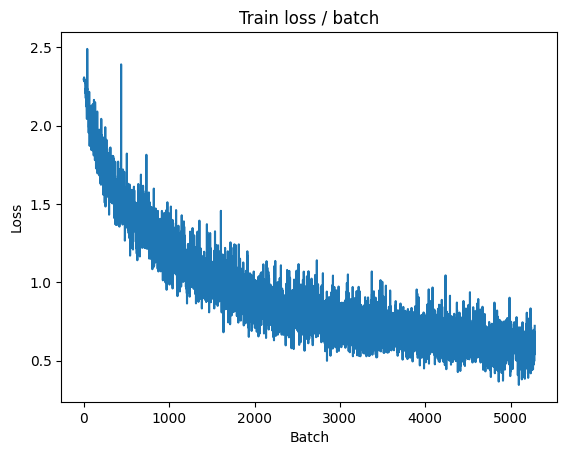


===============> Total time 17s	Avg loss 0.5791	Avg Prec@1 79.86 %	Avg Prec@5 98.98 %

[EVAL Batch 000/079]	Time 0.163s (0.163s)	Loss 0.4676 (0.4676)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.6107	Avg Prec@1 79.27 %	Avg Prec@5 98.67 %



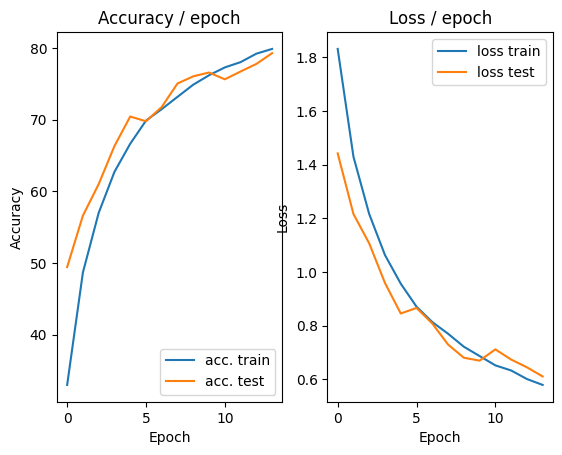

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.212s (0.212s)	Loss 0.6189 (0.6189)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)


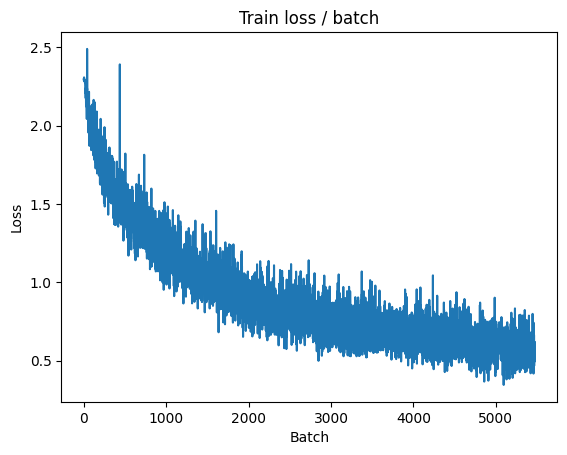

[TRAIN Batch 200/391]	Time 0.084s (0.046s)	Loss 0.5947 (0.5619)	Prec@1  81.2 ( 80.5)	Prec@5 100.0 ( 99.1)


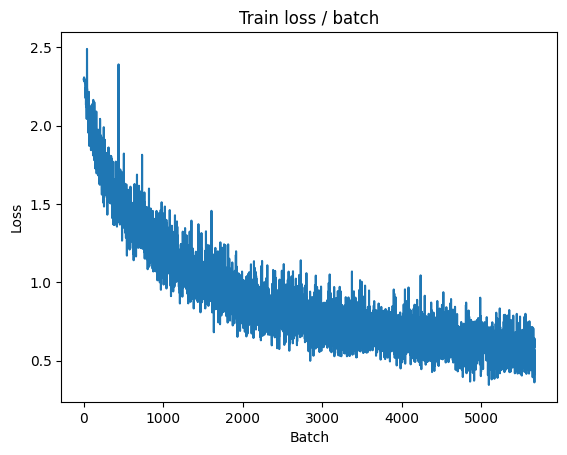


===============> Total time 16s	Avg loss 0.5611	Avg Prec@1 80.51 %	Avg Prec@5 99.05 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 0.5552 (0.5552)	Prec@1  82.0 ( 82.0)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6376	Avg Prec@1 78.17 %	Avg Prec@5 98.50 %



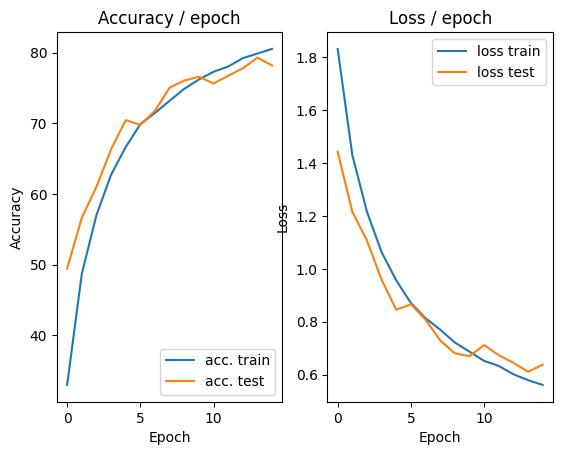

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.280s (0.280s)	Loss 0.7775 (0.7775)	Prec@1  70.3 ( 70.3)	Prec@5  99.2 ( 99.2)


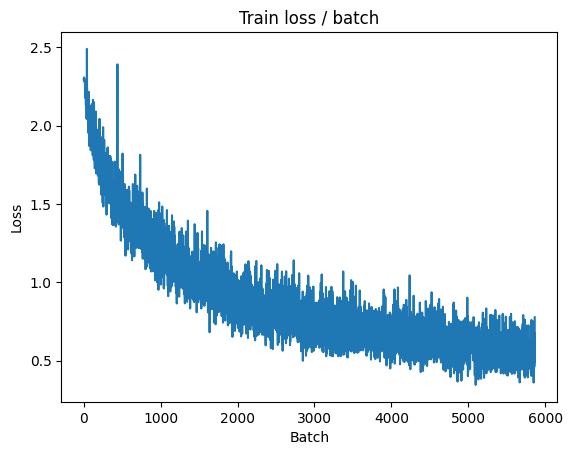

[TRAIN Batch 200/391]	Time 0.008s (0.043s)	Loss 0.5481 (0.5443)	Prec@1  80.5 ( 80.6)	Prec@5  99.2 ( 99.3)


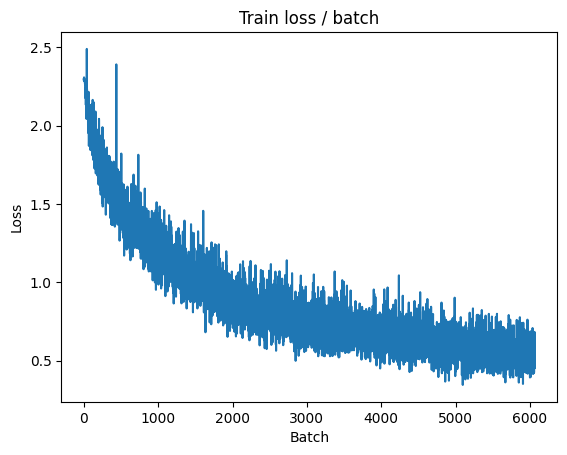


===============> Total time 17s	Avg loss 0.5453	Avg Prec@1 80.79 %	Avg Prec@5 99.14 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 0.4963 (0.4963)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.5805	Avg Prec@1 79.95 %	Avg Prec@5 98.90 %



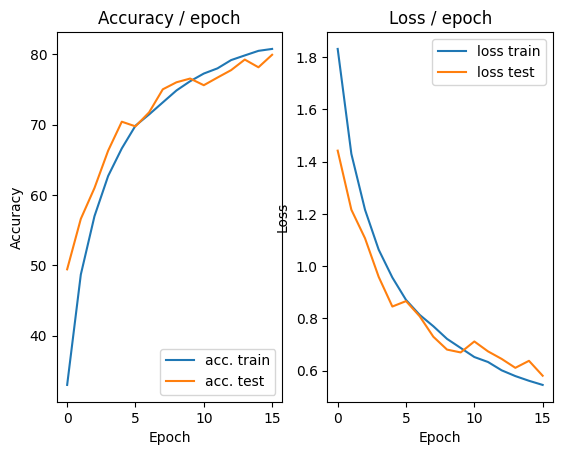

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.209s (0.209s)	Loss 0.5579 (0.5579)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)


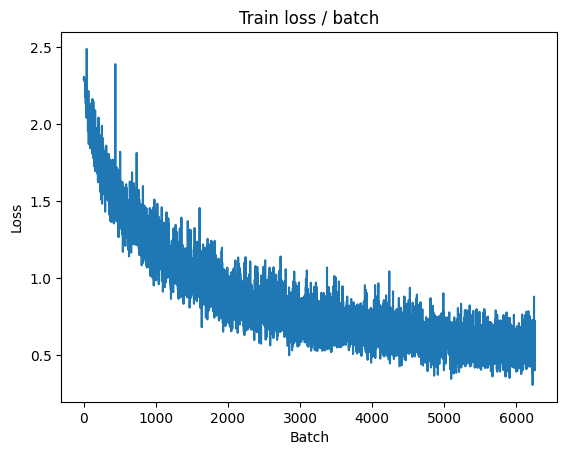

[TRAIN Batch 200/391]	Time 0.011s (0.045s)	Loss 0.4042 (0.5184)	Prec@1  87.5 ( 82.2)	Prec@5 100.0 ( 99.1)


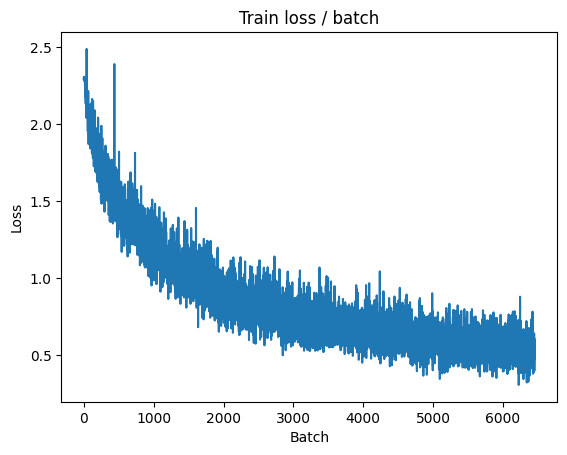


===============> Total time 16s	Avg loss 0.5260	Avg Prec@1 81.85 %	Avg Prec@5 99.06 %

[EVAL Batch 000/079]	Time 0.266s (0.266s)	Loss 0.4731 (0.4731)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.5777	Avg Prec@1 80.09 %	Avg Prec@5 98.74 %



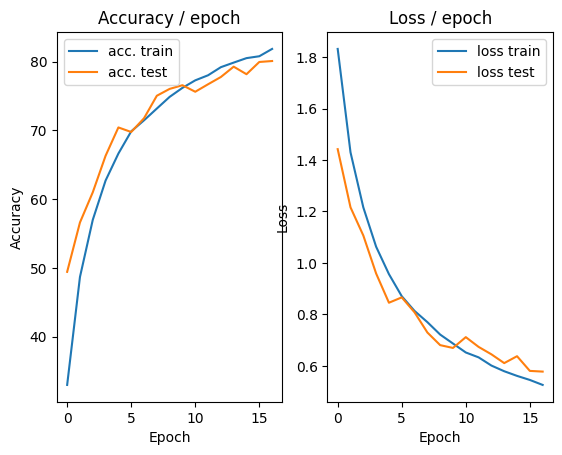

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.215s (0.215s)	Loss 0.5709 (0.5709)	Prec@1  75.0 ( 75.0)	Prec@5  98.4 ( 98.4)


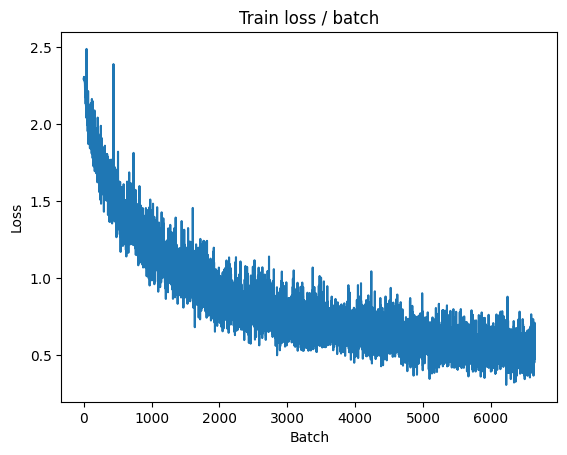

[TRAIN Batch 200/391]	Time 0.012s (0.041s)	Loss 0.3209 (0.5084)	Prec@1  89.8 ( 82.7)	Prec@5 100.0 ( 99.2)


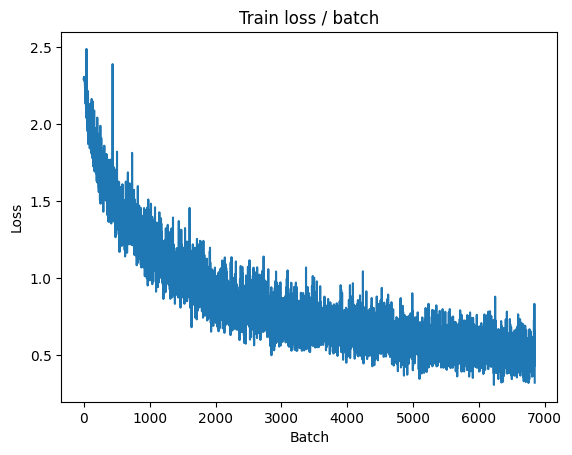


===============> Total time 16s	Avg loss 0.5129	Avg Prec@1 82.38 %	Avg Prec@5 99.17 %

[EVAL Batch 000/079]	Time 0.160s (0.160s)	Loss 0.4386 (0.4386)	Prec@1  89.8 ( 89.8)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.5829	Avg Prec@1 80.53 %	Avg Prec@5 98.79 %



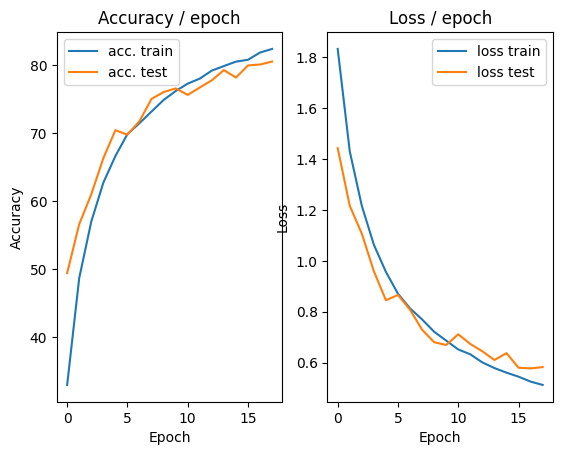

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.220s (0.220s)	Loss 0.3537 (0.3537)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


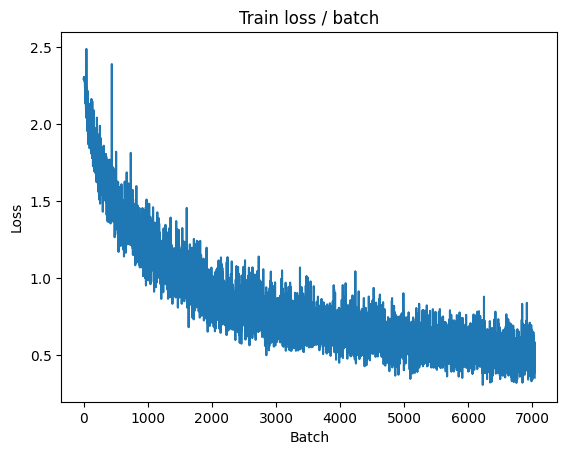

[TRAIN Batch 200/391]	Time 0.059s (0.046s)	Loss 0.4704 (0.4901)	Prec@1  86.7 ( 83.2)	Prec@5  99.2 ( 99.2)


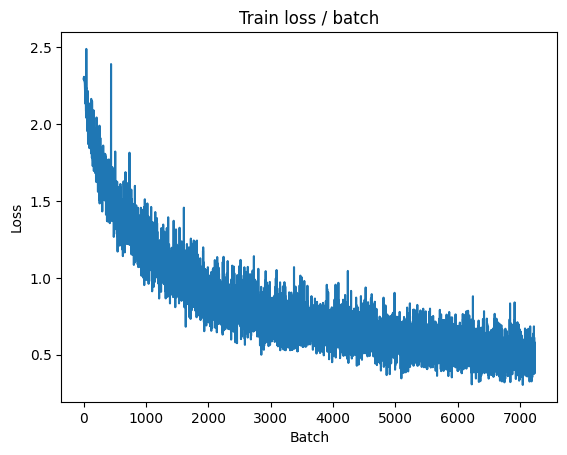


===============> Total time 17s	Avg loss 0.4968	Avg Prec@1 82.79 %	Avg Prec@5 99.26 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 0.4824 (0.4824)	Prec@1  87.5 ( 87.5)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.5626	Avg Prec@1 81.05 %	Avg Prec@5 98.88 %



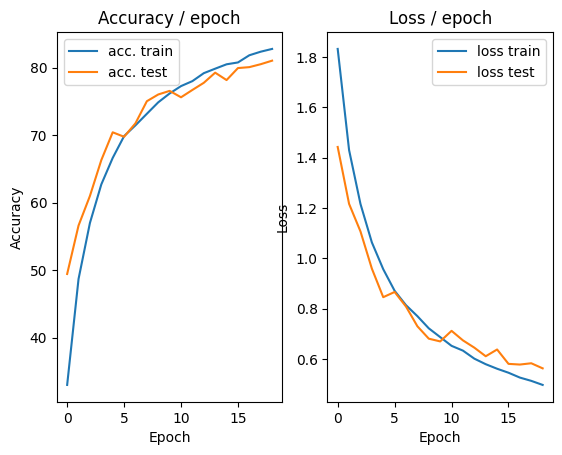

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.233s (0.233s)	Loss 0.3855 (0.3855)	Prec@1  85.9 ( 85.9)	Prec@5  98.4 ( 98.4)


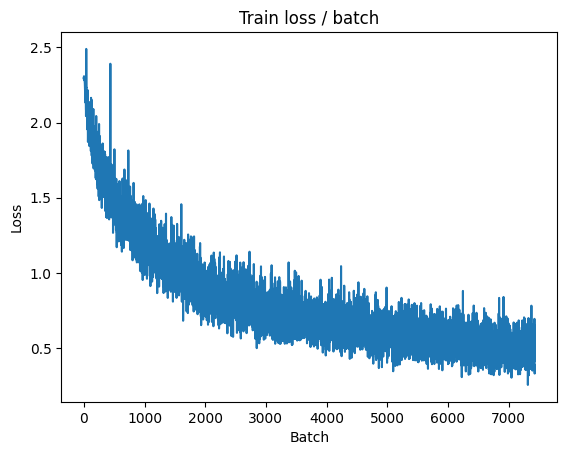

[TRAIN Batch 200/391]	Time 0.093s (0.044s)	Loss 0.4976 (0.4782)	Prec@1  82.8 ( 83.4)	Prec@5  98.4 ( 99.2)


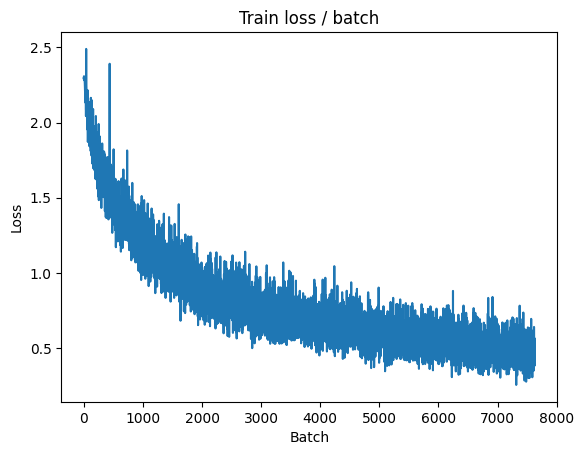


===============> Total time 16s	Avg loss 0.4849	Avg Prec@1 82.95 %	Avg Prec@5 99.26 %

[EVAL Batch 000/079]	Time 0.182s (0.182s)	Loss 0.4634 (0.4634)	Prec@1  85.9 ( 85.9)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.5964	Avg Prec@1 79.84 %	Avg Prec@5 98.78 %



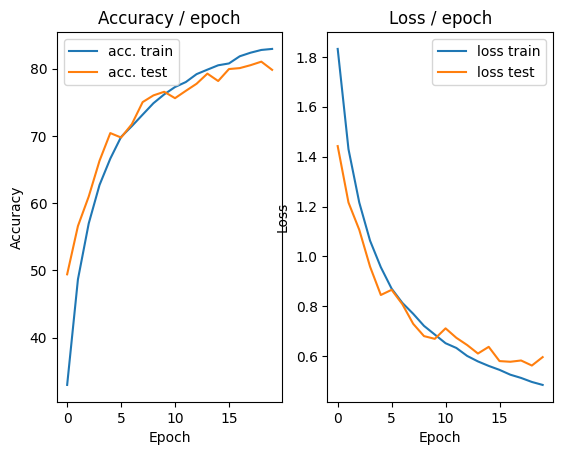

In [38]:
main_cifar_optim(batch_size=128, epochs=20, dropout=True, cuda=True, get_dataset=get_cifar_dataset_data_increase)

## Batch normalization

=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.641s (0.641s)	Loss 2.3793 (2.3793)	Prec@1   8.6 (  8.6)	Prec@5  45.3 ( 45.3)


<Figure size 640x480 with 0 Axes>

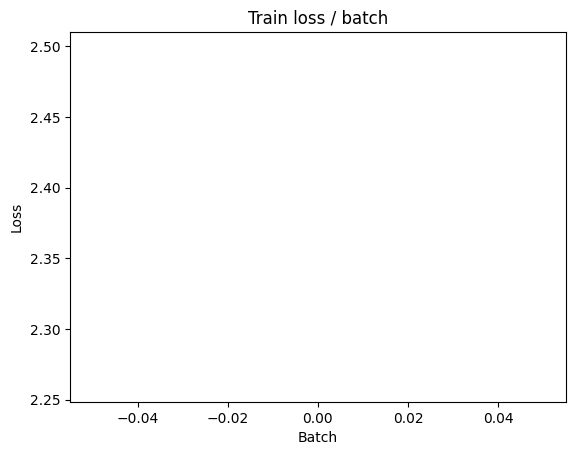

[TRAIN Batch 200/391]	Time 0.210s (0.232s)	Loss 1.4937 (1.6701)	Prec@1  36.7 ( 38.0)	Prec@5  90.6 ( 88.3)


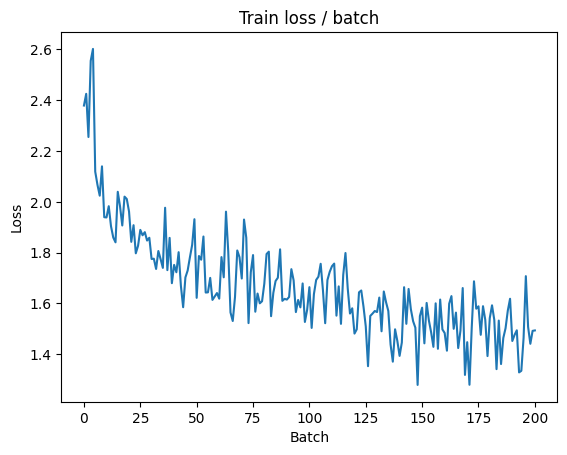


===============> Total time 90s	Avg loss 1.5234	Avg Prec@1 44.11 %	Avg Prec@5 90.79 %

[EVAL Batch 000/079]	Time 0.366s (0.366s)	Loss 1.4838 (1.4838)	Prec@1  48.4 ( 48.4)	Prec@5  91.4 ( 91.4)

===============> Total time 8s	Avg loss 1.4528	Avg Prec@1 48.57 %	Avg Prec@5 93.01 %



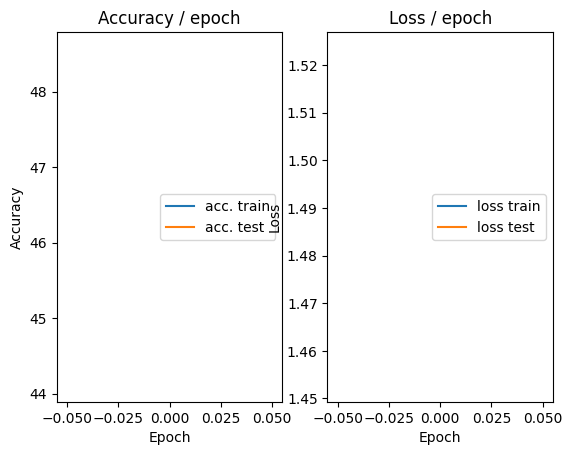

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.781s (0.781s)	Loss 1.2428 (1.2428)	Prec@1  60.9 ( 60.9)	Prec@5  94.5 ( 94.5)


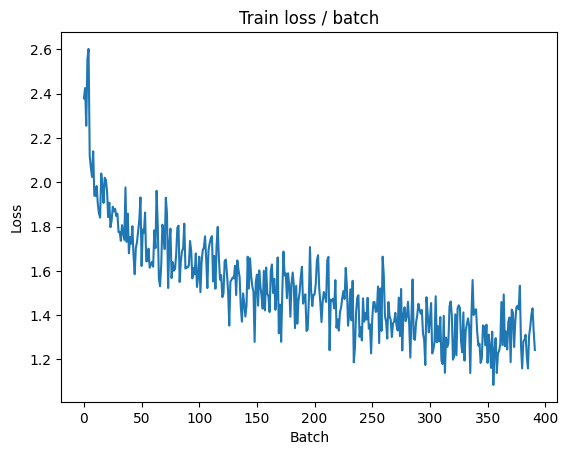

[TRAIN Batch 200/391]	Time 0.207s (0.228s)	Loss 1.1969 (1.1917)	Prec@1  57.0 ( 57.0)	Prec@5  95.3 ( 95.6)


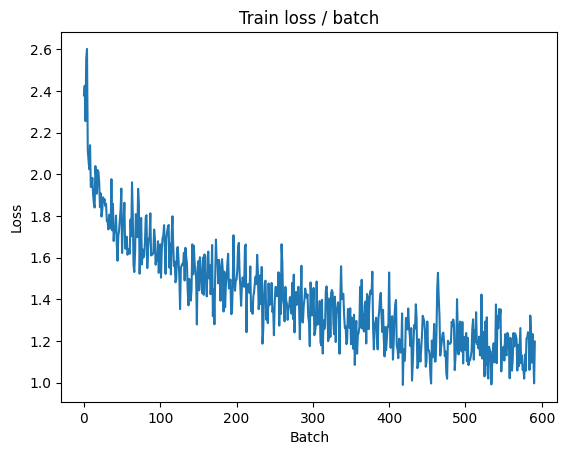


===============> Total time 89s	Avg loss 1.1505	Avg Prec@1 58.75 %	Avg Prec@5 95.72 %

[EVAL Batch 000/079]	Time 0.340s (0.340s)	Loss 1.1736 (1.1736)	Prec@1  57.0 ( 57.0)	Prec@5  97.7 ( 97.7)

===============> Total time 8s	Avg loss 1.1593	Avg Prec@1 58.93 %	Avg Prec@5 95.82 %



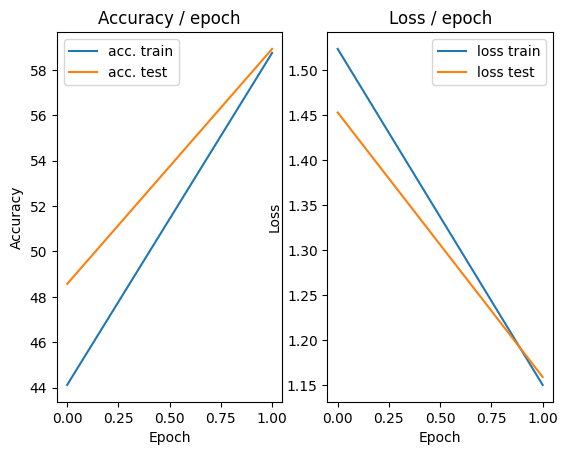

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.548s (0.548s)	Loss 1.5167 (1.5167)	Prec@1  44.5 ( 44.5)	Prec@5  96.9 ( 96.9)


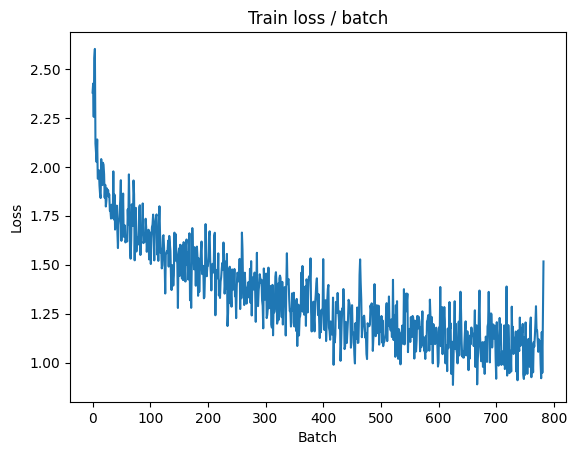

[TRAIN Batch 200/391]	Time 0.222s (0.234s)	Loss 1.0177 (1.0098)	Prec@1  62.5 ( 64.0)	Prec@5  97.7 ( 96.9)


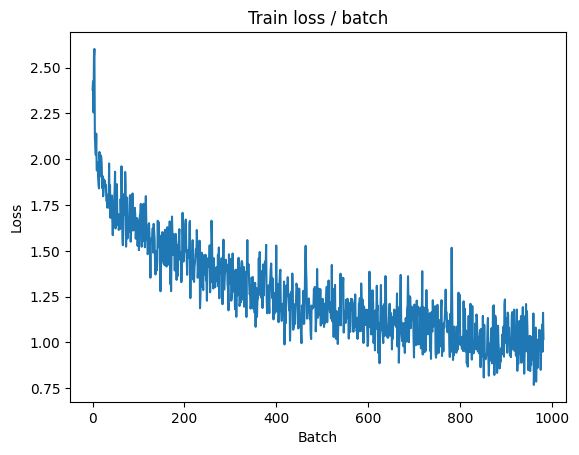


===============> Total time 90s	Avg loss 0.9843	Avg Prec@1 64.97 %	Avg Prec@5 96.90 %

[EVAL Batch 000/079]	Time 0.615s (0.615s)	Loss 0.7863 (0.7863)	Prec@1  74.2 ( 74.2)	Prec@5  97.7 ( 97.7)

===============> Total time 8s	Avg loss 0.8781	Avg Prec@1 69.22 %	Avg Prec@5 97.53 %



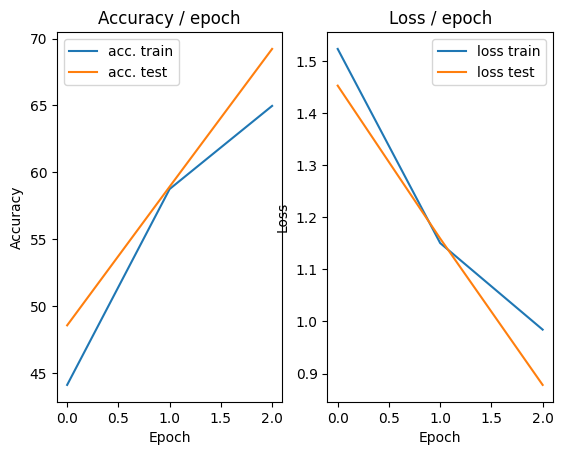

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.566s (0.566s)	Loss 0.9087 (0.9087)	Prec@1  68.0 ( 68.0)	Prec@5  98.4 ( 98.4)


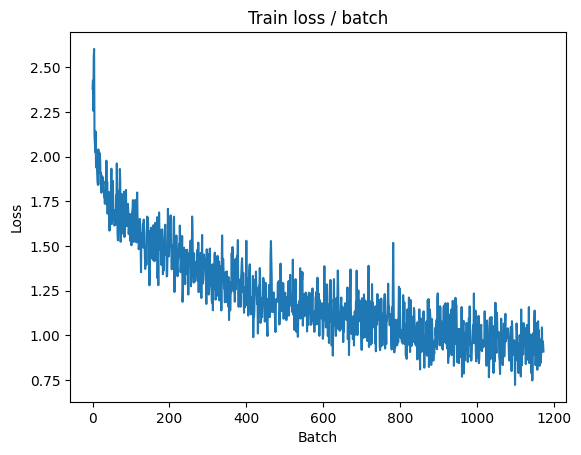

[TRAIN Batch 200/391]	Time 0.213s (0.235s)	Loss 0.8009 (0.8873)	Prec@1  72.7 ( 68.5)	Prec@5  98.4 ( 97.5)


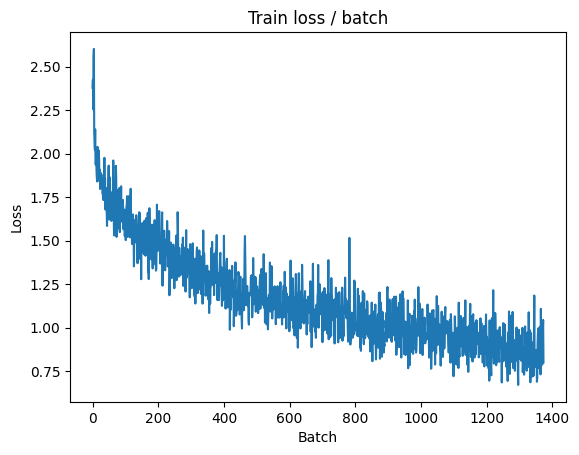


===============> Total time 90s	Avg loss 0.8773	Avg Prec@1 68.94 %	Avg Prec@5 97.45 %

[EVAL Batch 000/079]	Time 0.352s (0.352s)	Loss 0.8795 (0.8795)	Prec@1  70.3 ( 70.3)	Prec@5  96.1 ( 96.1)

===============> Total time 8s	Avg loss 0.8644	Avg Prec@1 69.62 %	Avg Prec@5 97.21 %



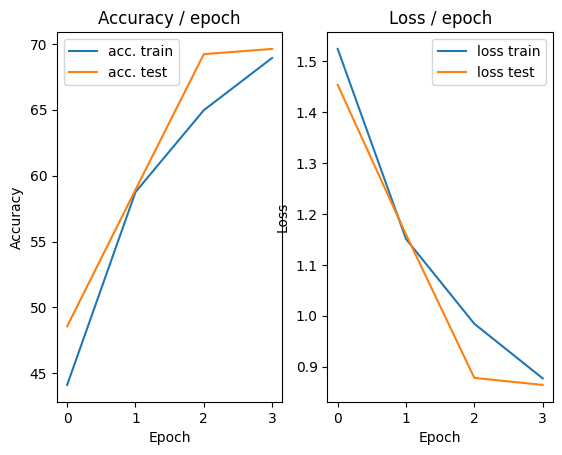

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.562s (0.562s)	Loss 0.7566 (0.7566)	Prec@1  75.0 ( 75.0)	Prec@5  98.4 ( 98.4)


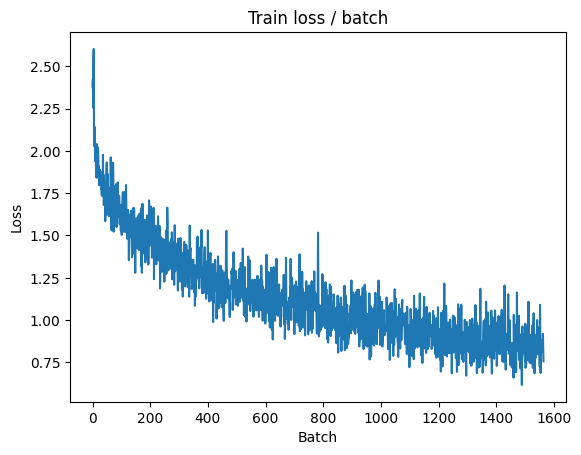

[TRAIN Batch 200/391]	Time 0.213s (0.235s)	Loss 0.7732 (0.8100)	Prec@1  75.0 ( 71.4)	Prec@5  99.2 ( 97.9)


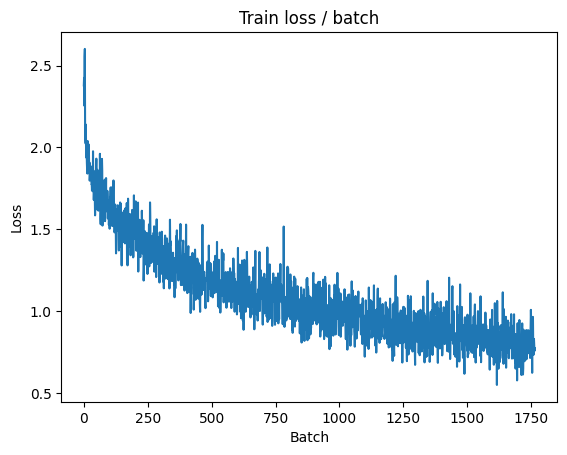


===============> Total time 90s	Avg loss 0.8017	Avg Prec@1 71.85 %	Avg Prec@5 97.91 %

[EVAL Batch 000/079]	Time 0.358s (0.358s)	Loss 0.8453 (0.8453)	Prec@1  68.8 ( 68.8)	Prec@5  96.9 ( 96.9)

===============> Total time 8s	Avg loss 0.8161	Avg Prec@1 71.86 %	Avg Prec@5 97.45 %



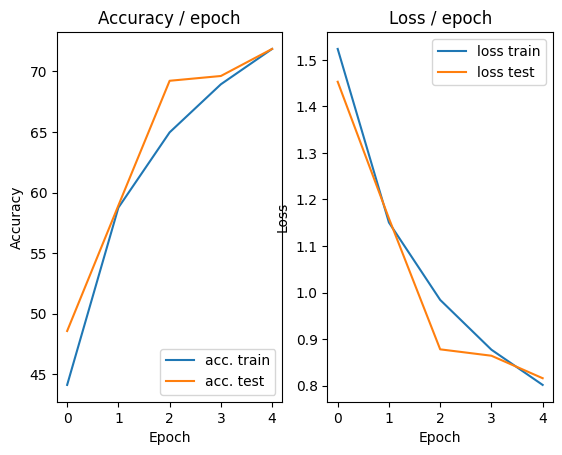

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.590s (0.590s)	Loss 0.9406 (0.9406)	Prec@1  68.8 ( 68.8)	Prec@5  96.9 ( 96.9)


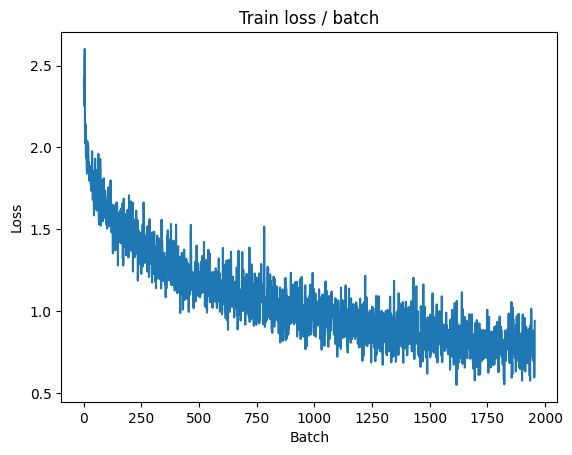

[TRAIN Batch 200/391]	Time 0.319s (0.234s)	Loss 0.6421 (0.7566)	Prec@1  77.3 ( 73.6)	Prec@5  99.2 ( 98.2)


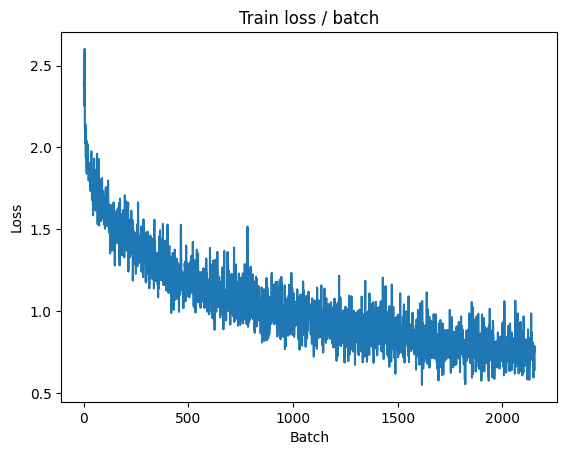


===============> Total time 89s	Avg loss 0.7519	Avg Prec@1 73.64 %	Avg Prec@5 98.19 %

[EVAL Batch 000/079]	Time 0.357s (0.357s)	Loss 0.9069 (0.9069)	Prec@1  67.2 ( 67.2)	Prec@5  98.4 ( 98.4)

===============> Total time 9s	Avg loss 0.9291	Avg Prec@1 66.86 %	Avg Prec@5 97.43 %



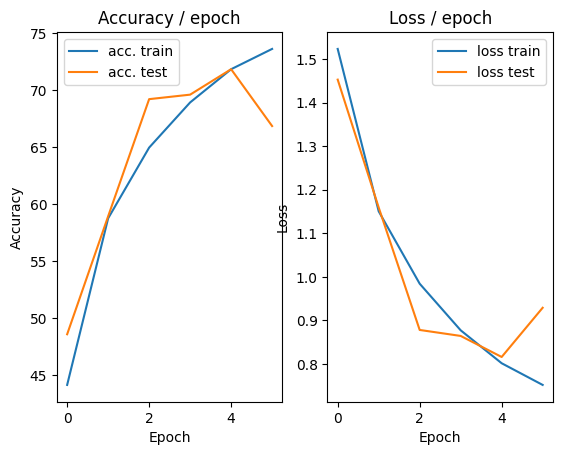

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.584s (0.584s)	Loss 0.7154 (0.7154)	Prec@1  72.7 ( 72.7)	Prec@5  98.4 ( 98.4)


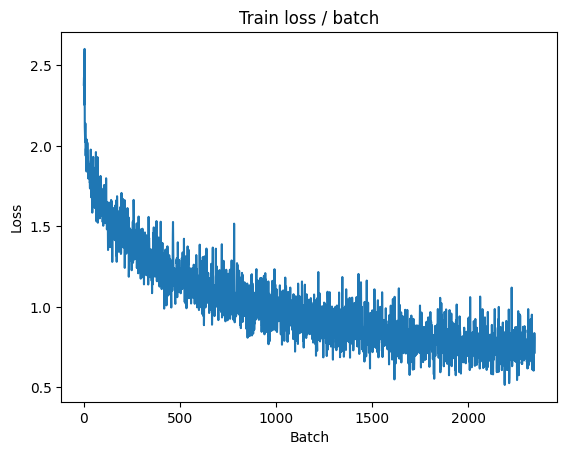

[TRAIN Batch 200/391]	Time 0.330s (0.233s)	Loss 0.7945 (0.7108)	Prec@1  75.0 ( 74.9)	Prec@5  98.4 ( 98.4)


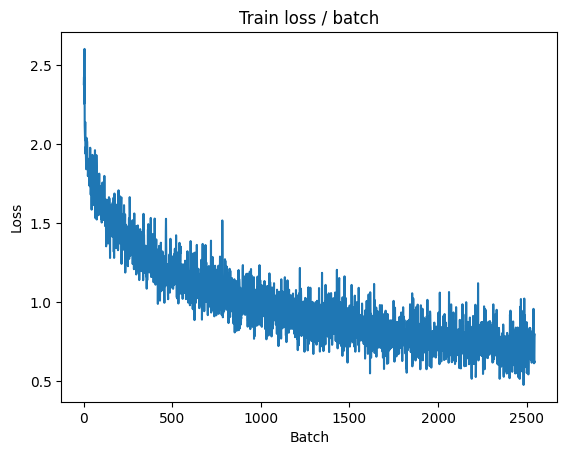


===============> Total time 91s	Avg loss 0.7049	Avg Prec@1 75.13 %	Avg Prec@5 98.41 %

[EVAL Batch 000/079]	Time 0.350s (0.350s)	Loss 0.7506 (0.7506)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 9s	Avg loss 0.8149	Avg Prec@1 71.62 %	Avg Prec@5 97.91 %



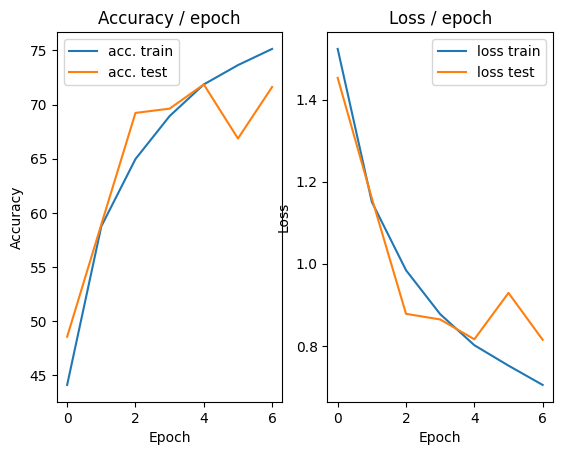

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.582s (0.582s)	Loss 0.6075 (0.6075)	Prec@1  78.1 ( 78.1)	Prec@5 100.0 (100.0)


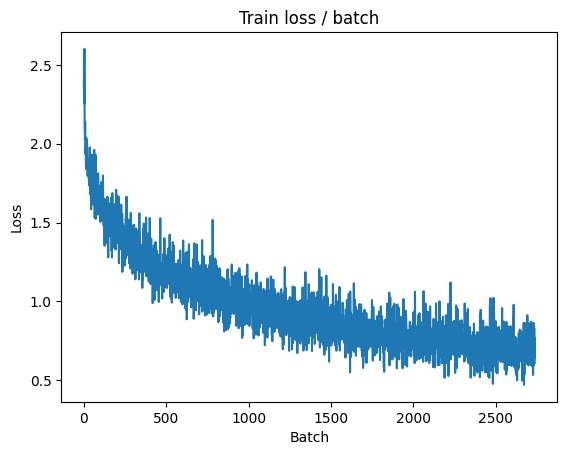

[TRAIN Batch 200/391]	Time 0.276s (0.234s)	Loss 0.5355 (0.6711)	Prec@1  79.7 ( 76.4)	Prec@5  99.2 ( 98.6)


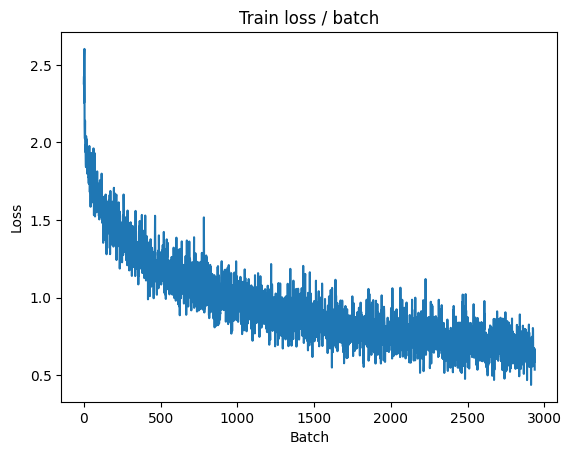


===============> Total time 91s	Avg loss 0.6680	Avg Prec@1 76.61 %	Avg Prec@5 98.60 %

[EVAL Batch 000/079]	Time 0.365s (0.365s)	Loss 0.7633 (0.7633)	Prec@1  72.7 ( 72.7)	Prec@5  97.7 ( 97.7)

===============> Total time 9s	Avg loss 0.7759	Avg Prec@1 73.32 %	Avg Prec@5 98.31 %



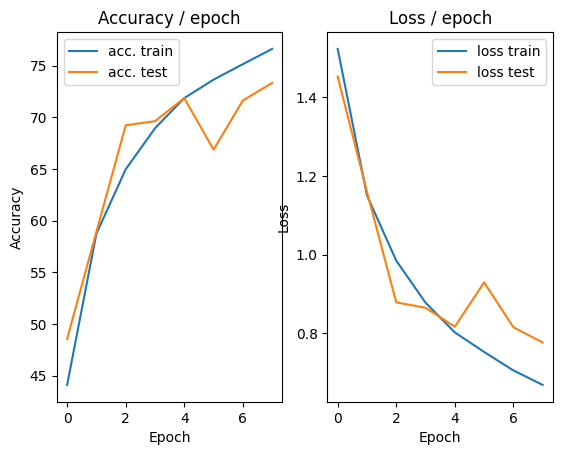

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.565s (0.565s)	Loss 0.7229 (0.7229)	Prec@1  73.4 ( 73.4)	Prec@5  99.2 ( 99.2)


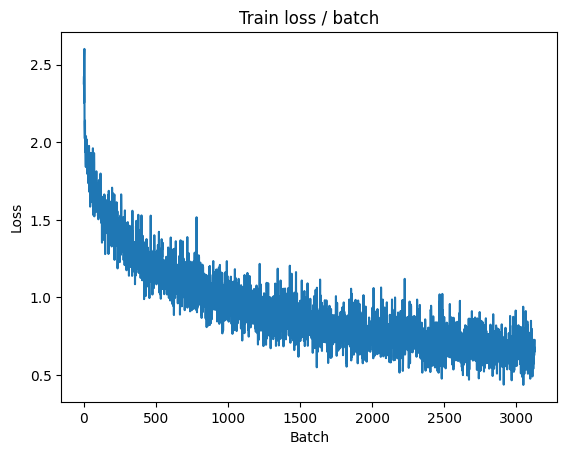

[TRAIN Batch 200/391]	Time 0.301s (0.235s)	Loss 0.6044 (0.6331)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.7)


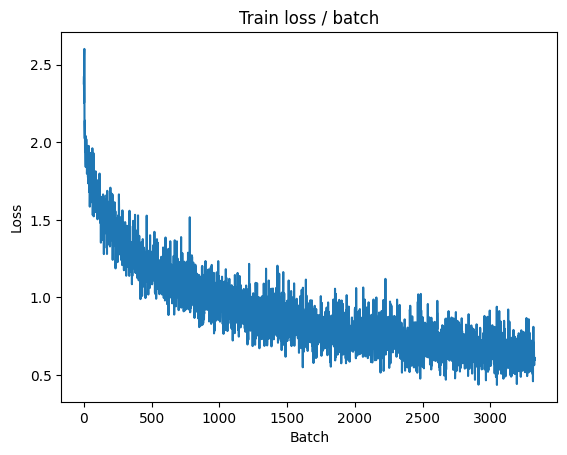


===============> Total time 92s	Avg loss 0.6362	Avg Prec@1 77.79 %	Avg Prec@5 98.73 %

[EVAL Batch 000/079]	Time 0.359s (0.359s)	Loss 0.7459 (0.7459)	Prec@1  75.0 ( 75.0)	Prec@5  99.2 ( 99.2)

===============> Total time 9s	Avg loss 0.8864	Avg Prec@1 70.12 %	Avg Prec@5 97.96 %



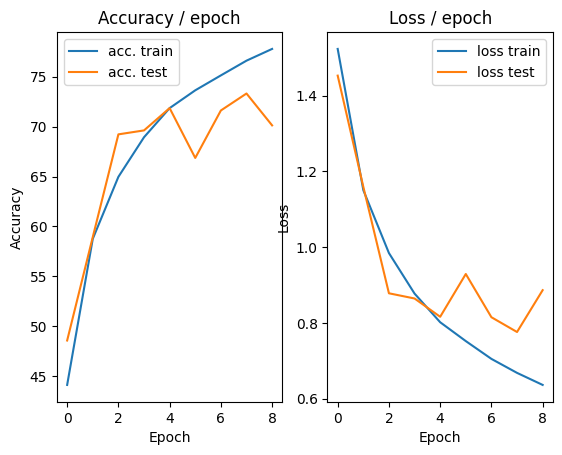

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.603s (0.603s)	Loss 0.5012 (0.5012)	Prec@1  75.8 ( 75.8)	Prec@5 100.0 (100.0)


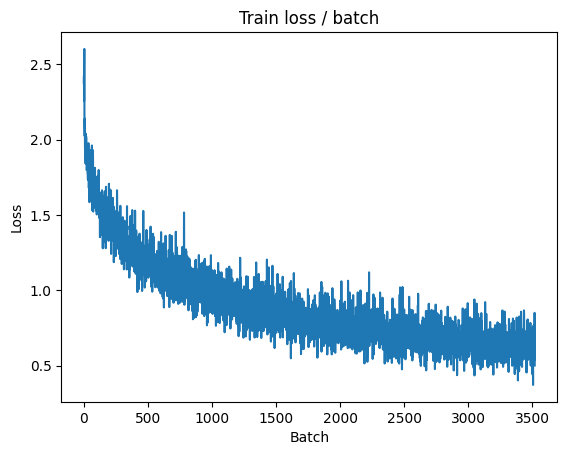

[TRAIN Batch 200/391]	Time 0.335s (0.239s)	Loss 0.7092 (0.6102)	Prec@1  77.3 ( 78.7)	Prec@5  97.7 ( 98.8)


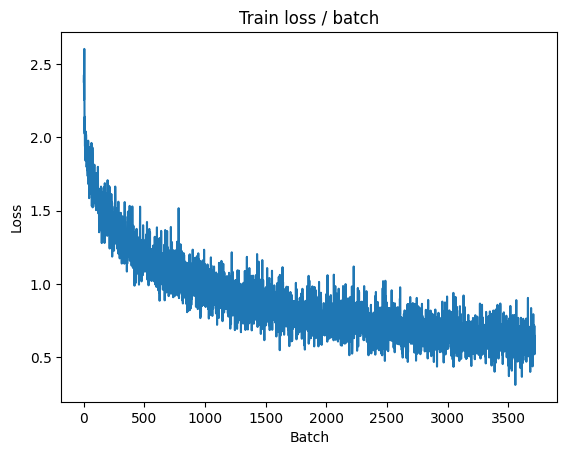


===============> Total time 93s	Avg loss 0.6060	Avg Prec@1 78.89 %	Avg Prec@5 98.80 %

[EVAL Batch 000/079]	Time 0.358s (0.358s)	Loss 0.8500 (0.8500)	Prec@1  74.2 ( 74.2)	Prec@5  98.4 ( 98.4)

===============> Total time 9s	Avg loss 0.8781	Avg Prec@1 70.83 %	Avg Prec@5 97.48 %



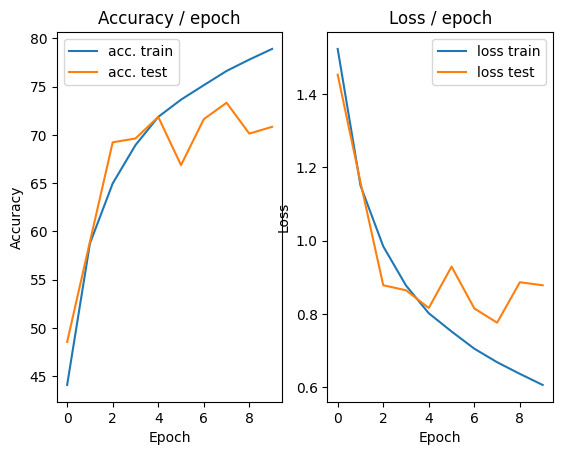

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.588s (0.588s)	Loss 0.5888 (0.5888)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)


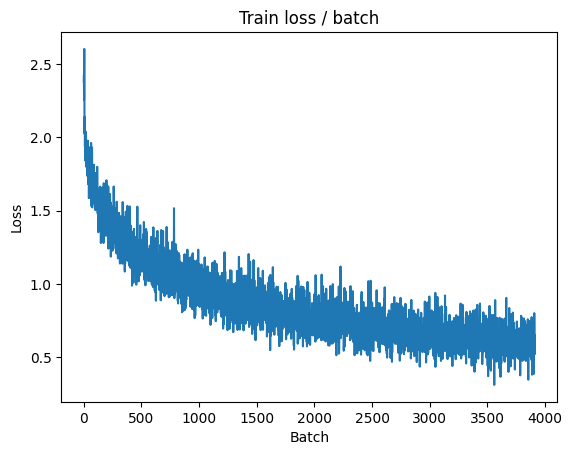

[TRAIN Batch 200/391]	Time 0.351s (0.238s)	Loss 0.4850 (0.5840)	Prec@1  87.5 ( 79.6)	Prec@5 100.0 ( 98.9)


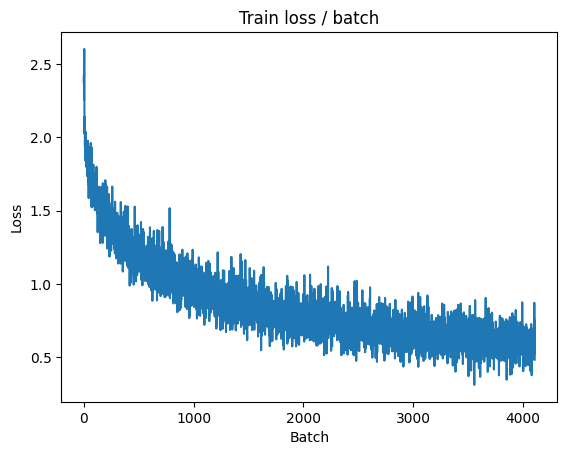


===============> Total time 91s	Avg loss 0.5854	Avg Prec@1 79.60 %	Avg Prec@5 98.88 %

[EVAL Batch 000/079]	Time 0.375s (0.375s)	Loss 0.5551 (0.5551)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.2)

===============> Total time 9s	Avg loss 0.6053	Avg Prec@1 78.92 %	Avg Prec@5 98.66 %



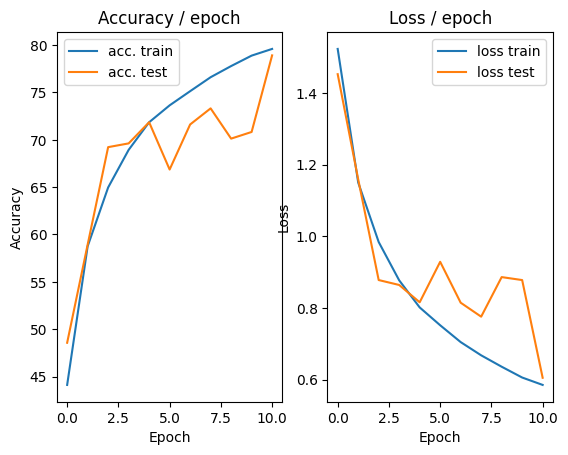

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.571s (0.571s)	Loss 0.5801 (0.5801)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)


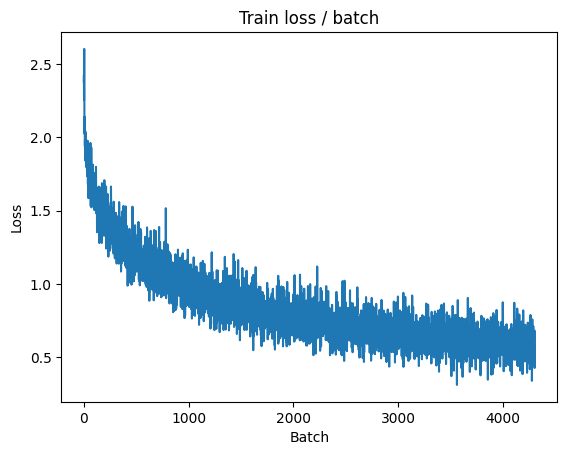

[TRAIN Batch 200/391]	Time 0.215s (0.240s)	Loss 0.5949 (0.5640)	Prec@1  78.9 ( 80.6)	Prec@5  98.4 ( 99.0)


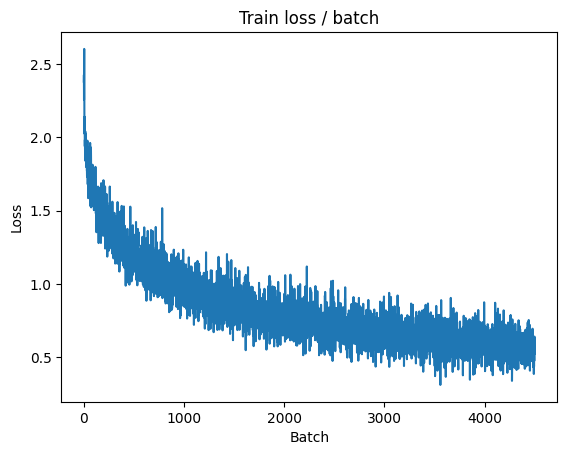


===============> Total time 92s	Avg loss 0.5651	Avg Prec@1 80.45 %	Avg Prec@5 98.97 %

[EVAL Batch 000/079]	Time 0.386s (0.386s)	Loss 0.5833 (0.5833)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 9s	Avg loss 0.6382	Avg Prec@1 77.80 %	Avg Prec@5 98.65 %



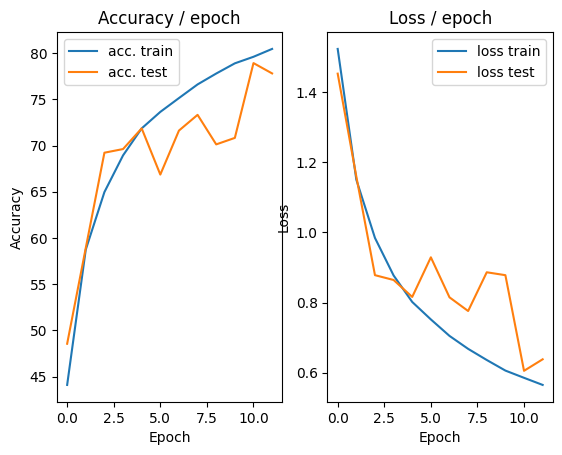

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.609s (0.609s)	Loss 0.4859 (0.4859)	Prec@1  82.0 ( 82.0)	Prec@5 100.0 (100.0)


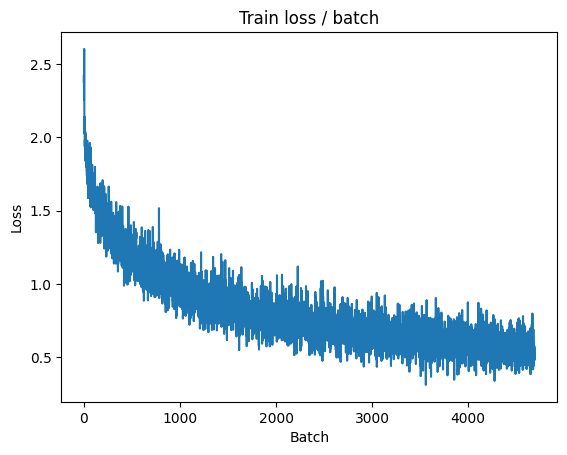

[TRAIN Batch 200/391]	Time 0.215s (0.239s)	Loss 0.5170 (0.5460)	Prec@1  80.5 ( 80.7)	Prec@5 100.0 ( 99.1)


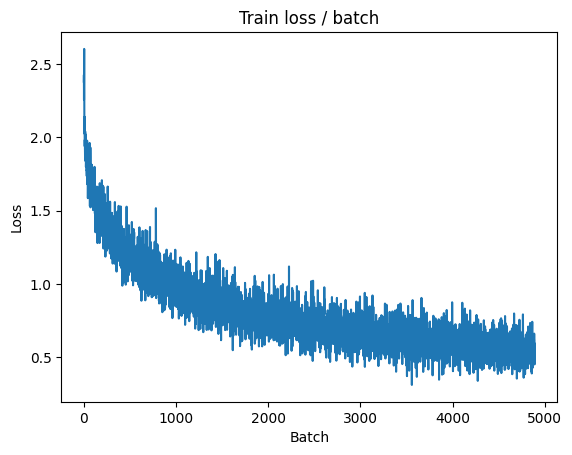


===============> Total time 92s	Avg loss 0.5431	Avg Prec@1 80.96 %	Avg Prec@5 99.10 %

[EVAL Batch 000/079]	Time 0.372s (0.372s)	Loss 0.6091 (0.6091)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)

===============> Total time 9s	Avg loss 0.6242	Avg Prec@1 78.65 %	Avg Prec@5 98.69 %



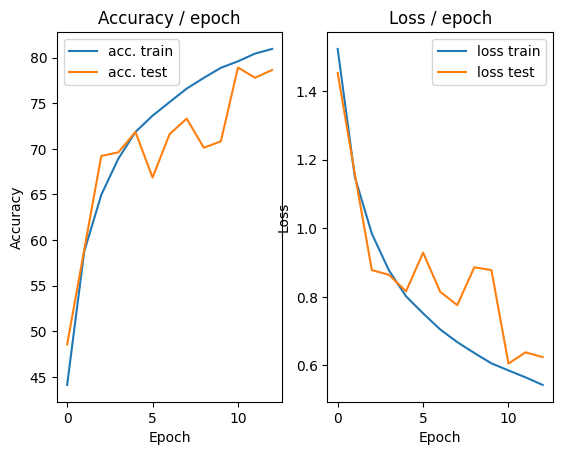

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.560s (0.560s)	Loss 0.4627 (0.4627)	Prec@1  88.3 ( 88.3)	Prec@5  98.4 ( 98.4)


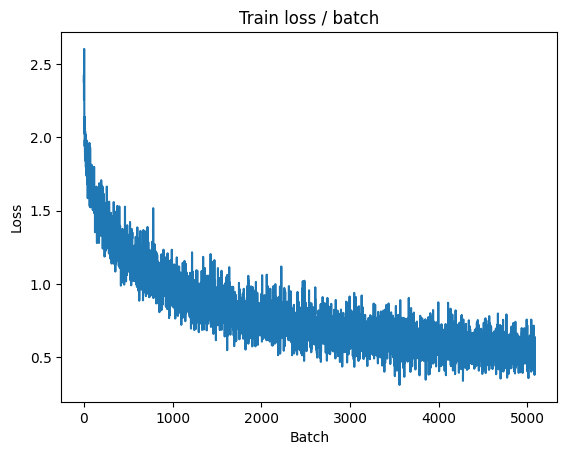

[TRAIN Batch 200/391]	Time 0.212s (0.236s)	Loss 0.6159 (0.5329)	Prec@1  78.9 ( 81.3)	Prec@5  98.4 ( 99.1)


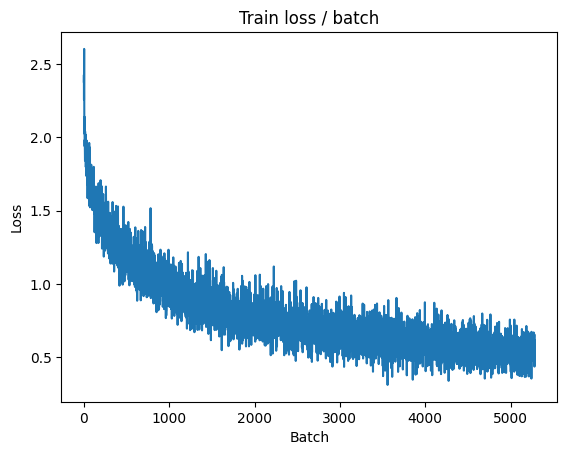


===============> Total time 90s	Avg loss 0.5272	Avg Prec@1 81.46 %	Avg Prec@5 99.12 %

[EVAL Batch 000/079]	Time 0.364s (0.364s)	Loss 0.5179 (0.5179)	Prec@1  80.5 ( 80.5)	Prec@5  97.7 ( 97.7)

===============> Total time 9s	Avg loss 0.5984	Avg Prec@1 79.71 %	Avg Prec@5 98.76 %



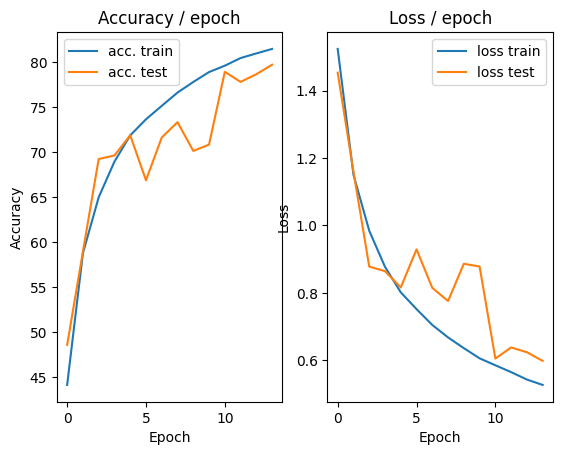

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.577s (0.577s)	Loss 0.4593 (0.4593)	Prec@1  87.5 ( 87.5)	Prec@5  99.2 ( 99.2)


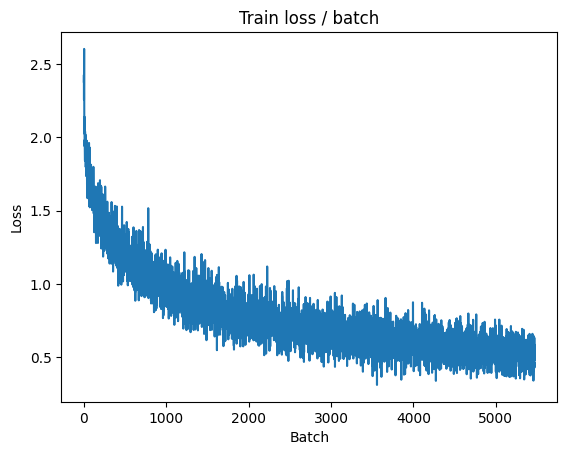

[TRAIN Batch 200/391]	Time 0.321s (0.232s)	Loss 0.5606 (0.5049)	Prec@1  82.0 ( 82.2)	Prec@5  99.2 ( 99.2)


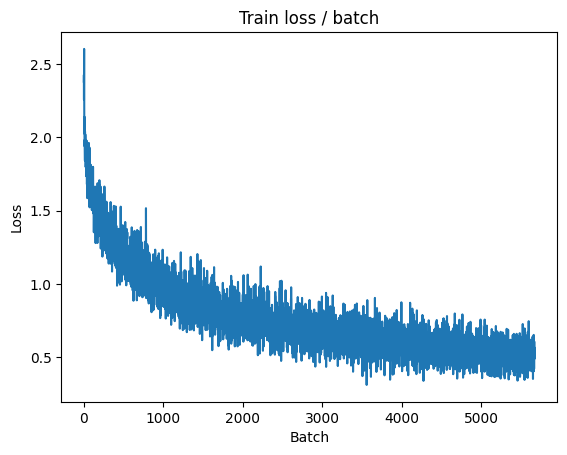


===============> Total time 90s	Avg loss 0.5096	Avg Prec@1 82.16 %	Avg Prec@5 99.18 %

[EVAL Batch 000/079]	Time 0.361s (0.361s)	Loss 0.4989 (0.4989)	Prec@1  83.6 ( 83.6)	Prec@5  97.7 ( 97.7)

===============> Total time 9s	Avg loss 0.5354	Avg Prec@1 81.73 %	Avg Prec@5 99.03 %



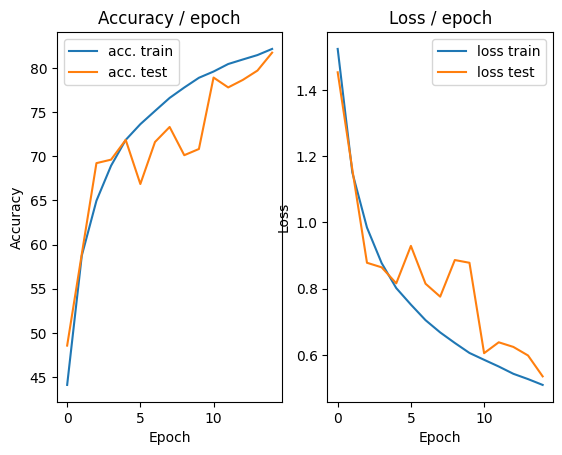

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.594s (0.594s)	Loss 0.5354 (0.5354)	Prec@1  78.1 ( 78.1)	Prec@5 100.0 (100.0)


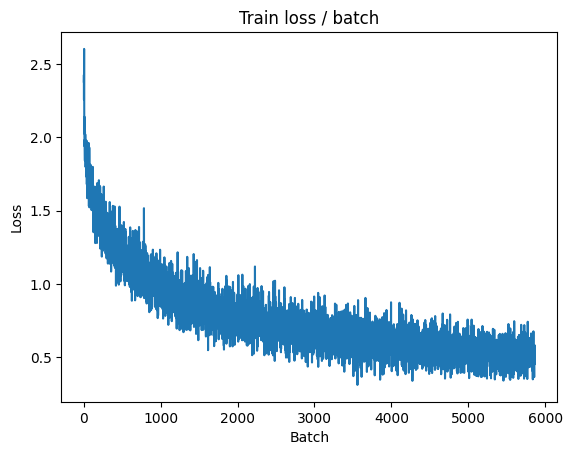

[TRAIN Batch 200/391]	Time 0.316s (0.237s)	Loss 0.4982 (0.4879)	Prec@1  85.2 ( 82.8)	Prec@5 100.0 ( 99.3)


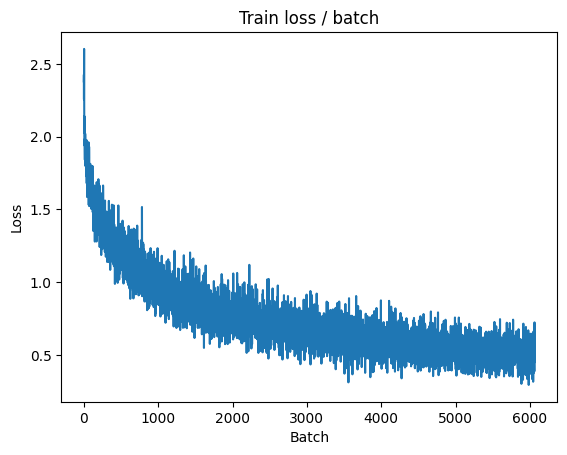


===============> Total time 91s	Avg loss 0.4914	Avg Prec@1 82.82 %	Avg Prec@5 99.25 %

[EVAL Batch 000/079]	Time 0.396s (0.396s)	Loss 0.4843 (0.4843)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 9s	Avg loss 0.5397	Avg Prec@1 81.39 %	Avg Prec@5 98.96 %



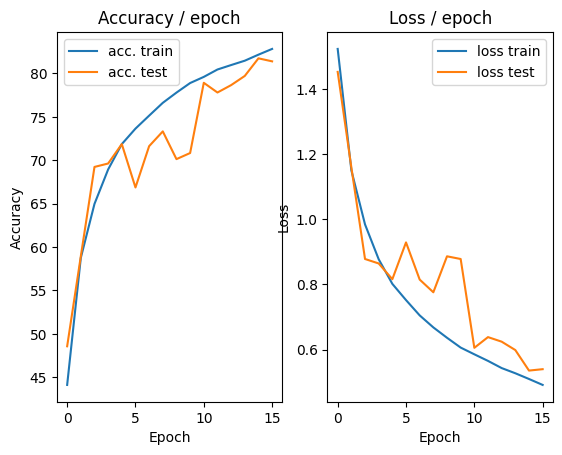

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.606s (0.606s)	Loss 0.5660 (0.5660)	Prec@1  78.1 ( 78.1)	Prec@5 100.0 (100.0)


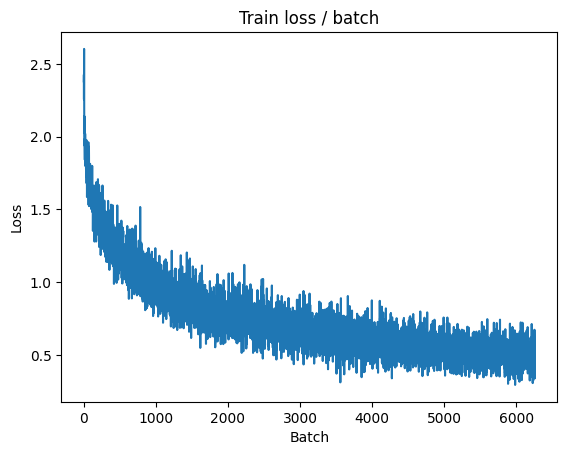

[TRAIN Batch 200/391]	Time 0.290s (0.235s)	Loss 0.5804 (0.4765)	Prec@1  79.7 ( 83.5)	Prec@5  97.7 ( 99.3)


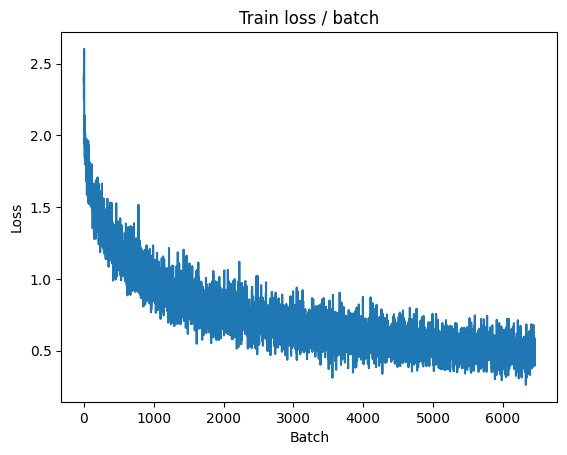


===============> Total time 91s	Avg loss 0.4782	Avg Prec@1 83.34 %	Avg Prec@5 99.22 %

[EVAL Batch 000/079]	Time 0.396s (0.396s)	Loss 0.4657 (0.4657)	Prec@1  87.5 ( 87.5)	Prec@5  98.4 ( 98.4)

===============> Total time 9s	Avg loss 0.5379	Avg Prec@1 81.70 %	Avg Prec@5 99.03 %



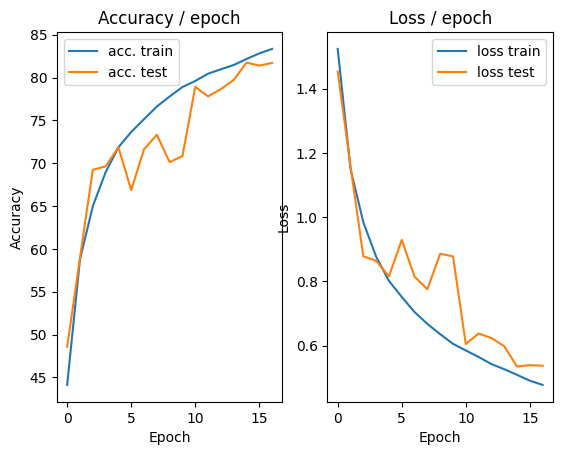

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.565s (0.565s)	Loss 0.4144 (0.4144)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)


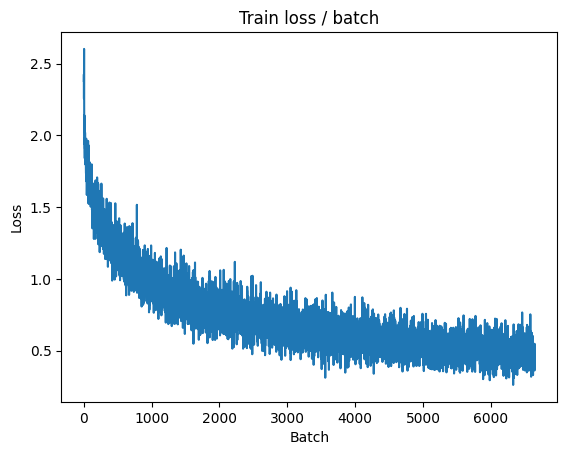

[TRAIN Batch 200/391]	Time 0.219s (0.234s)	Loss 0.4167 (0.4680)	Prec@1  88.3 ( 83.9)	Prec@5 100.0 ( 99.3)


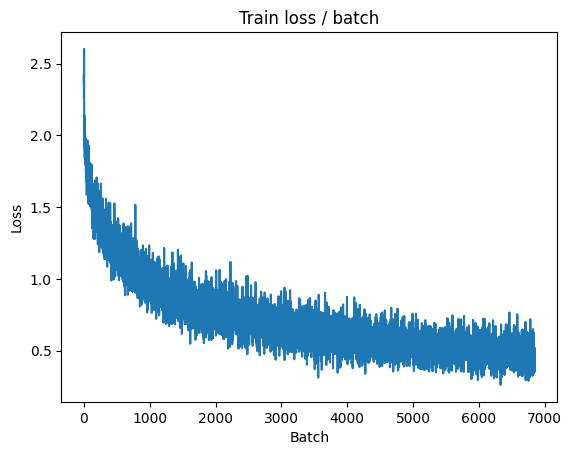


===============> Total time 91s	Avg loss 0.4673	Avg Prec@1 83.66 %	Avg Prec@5 99.37 %

[EVAL Batch 000/079]	Time 0.372s (0.372s)	Loss 0.4304 (0.4304)	Prec@1  86.7 ( 86.7)	Prec@5  98.4 ( 98.4)

===============> Total time 9s	Avg loss 0.5448	Avg Prec@1 81.20 %	Avg Prec@5 99.11 %



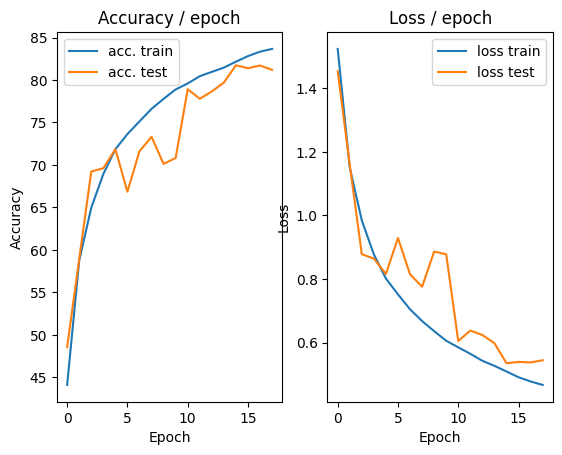

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.592s (0.592s)	Loss 0.4517 (0.4517)	Prec@1  80.5 ( 80.5)	Prec@5 100.0 (100.0)


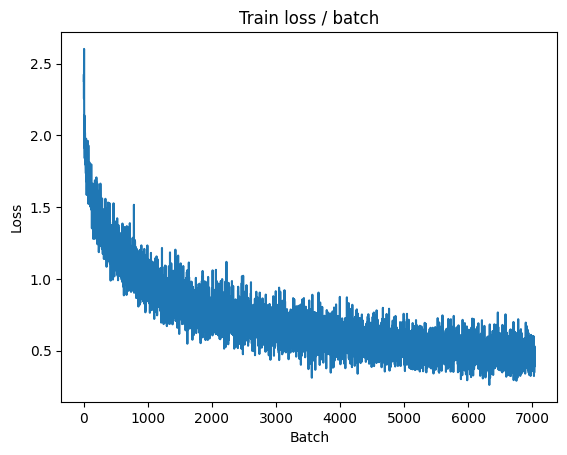

[TRAIN Batch 200/391]	Time 0.216s (0.235s)	Loss 0.4181 (0.4561)	Prec@1  87.5 ( 83.9)	Prec@5  99.2 ( 99.4)


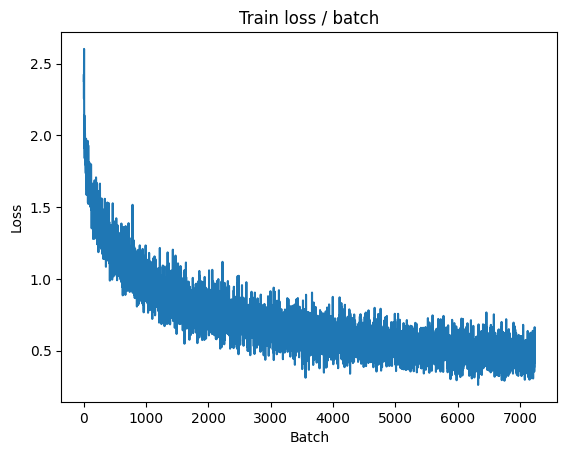


===============> Total time 92s	Avg loss 0.4540	Avg Prec@1 84.08 %	Avg Prec@5 99.35 %

[EVAL Batch 000/079]	Time 0.389s (0.389s)	Loss 0.5259 (0.5259)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)

===============> Total time 9s	Avg loss 0.5816	Avg Prec@1 80.46 %	Avg Prec@5 98.91 %



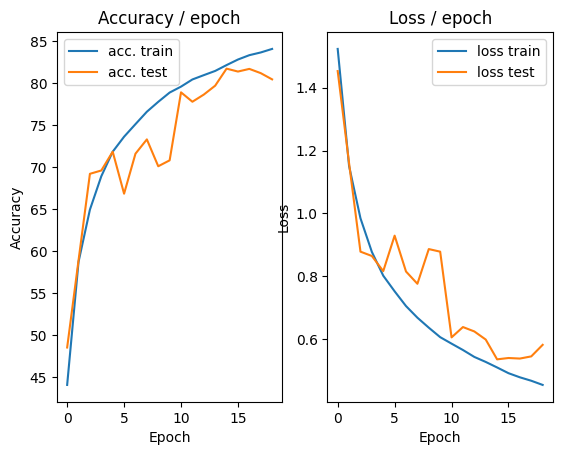

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.607s (0.607s)	Loss 0.3338 (0.3338)	Prec@1  89.8 ( 89.8)	Prec@5  98.4 ( 98.4)


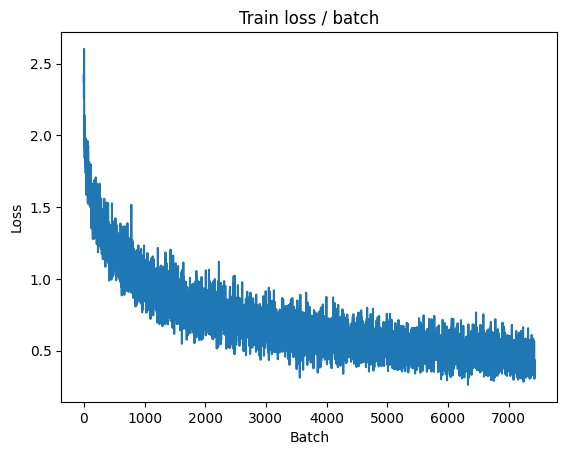

[TRAIN Batch 200/391]	Time 0.324s (0.242s)	Loss 0.3289 (0.4413)	Prec@1  89.1 ( 84.4)	Prec@5 100.0 ( 99.4)


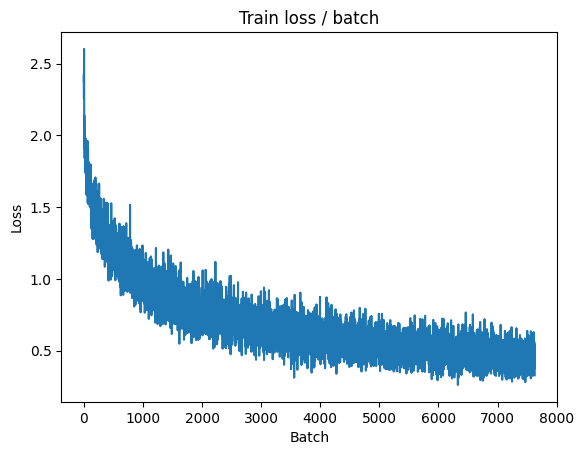


===============> Total time 93s	Avg loss 0.4446	Avg Prec@1 84.25 %	Avg Prec@5 99.39 %

[EVAL Batch 000/079]	Time 0.372s (0.372s)	Loss 0.4618 (0.4618)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 9s	Avg loss 0.5182	Avg Prec@1 82.35 %	Avg Prec@5 99.05 %



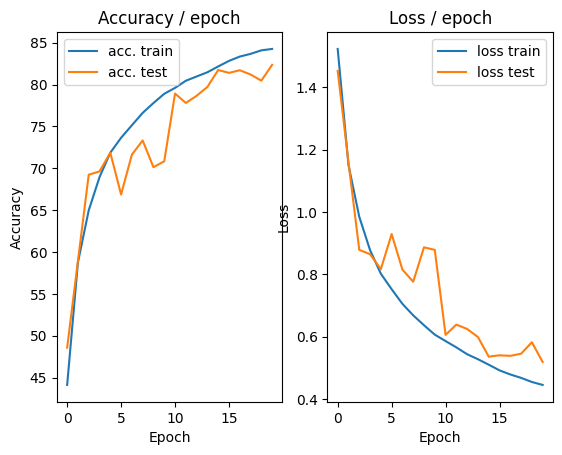

In [39]:
main_cifar_optim(batch_size=128, epochs=20, dropout=True, batch_norm=True, get_dataset=get_cifar_dataset_data_increase)